<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    
</head>
<body>
    <h1 style="text-align: center;">BIOREACTOR</h1>
    <div style="text-align: center;">
        <img src="Bioreactor.png" alt="Batch" width="700" height="700">
    </div>
</body>
</html>

**Objetivo General:** Desarrollar un soft sensor mediante un método de ensamble heterogéneo que permita predecir con precisión la producción de penicilina en un bioreactor industrial utilizando el conjunto de datos IndPenSim para el Centro de Investigación de Agricultura y Alimentación (INRAe) de Toulouse – Francia. 

**Objetivos Específicos:**
1. Seleccionar y procesar las variables on-line del conjunto de datos IndPenSim.
2. Verificar el rendimiento de cinco modelos: Lasso, KNN, ANN, XGBoost y SVR, en la predicción de penicilina utilizando el conjunto de datos IndPenSim seleccionado y procesado.
3. Desarrollar un soft sensor a partir de un ensamble heterogéneo utilizando los modelos verificados anteriormente.
4. Evaluar el rendimiento del soft sensor en comparación con los modelos individuales y con lo reportado en la literatura.


El experimento como tal consta de 100 lotes, estos se controlan utilizando diferentes estrategias de control en diferentes lotes, así, representando un proceso de fabricación biofarmacéutica típica de la siguiente manera:

    Lotes 1-30: Controlado por un enfoque basado en recetas.
    Lotes 31-60: Controlados por operarios.
    Lotes 61-90: Controlados por una solución de control avanzado de procesos (APC) mediante espectroscopia Raman.
    Lotes 91-100: Contienen fallos que provocan desviaciones del proceso.


### Importar librerias

In [3]:
#General 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
import pickle
import os
import time
import joblib 
import matplotlib.colors as mcolors
import matplotlib as mpl


# Metricas
from sklearn.metrics import mean_squared_error, mean_squared_error, r2_score, mean_absolute_error

# Ensamble
from sklearn.ensemble import VotingRegressor

# Lasso
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.pipeline import Pipeline

# Random Forest
from sklearn.ensemble import RandomForestRegressor

# XGBoost
import xgboost as xgb
from xgboost import XGBRegressor
#from keras.models import Sequential
#from tqdm import tqdm

#KNN
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from skopt import BayesSearchCV

#ANN
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.base import BaseEstimator, RegressorMixin
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler

# Optimización Bayesiana
from bayes_opt import BayesianOptimization


import ipywidgets as widgets
from IPython.display import display, Markdown

# Correlación de las variables
from statsmodels.stats.outliers_influence import variance_inflation_factor


# Warnings 
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings('ignore')

### Cargar datos

In [7]:
data = pd.read_csv(r'100_Batches_IndPenSim_V3.csv')
data

,Time (h),Aeration rate(Fg:L/h),Agitator RPM(RPM:RPM),Sugar feed rate(Fs:L/h),Acid flow rate(Fa:L/h),Base flow rate(Fb:L/h),Heating/cooling water flow rate(Fc:L/h),Heating water flow rate(Fh:L/h),Water for injection/dilution(Fw:L/h),Air head pressure(pressure:bar),...,210,209,208,207,206,205,204,203,202,201
0,0.2,30,100,8,0.0000,30.1180,9.8335,0.00010,0,0.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
1,0.4,30,100,8,0.0000,51.2210,18.1550,0.00010,0,0.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
2,0.6,30,100,8,0.0000,54.3020,9.5982,0.00010,0,0.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
3,0.8,30,100,8,0.0000,37.8160,4.3395,0.00010,0,0.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
4,1.0,30,100,8,0.5181,18.9080,1.1045,0.00010,0,0.6,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113930,229.2,65,100,80,0.0000,12.9000,33.5860,5.93590,250,0.9,...,816050.0,823390.0,830160.0,835530.0,839140.0,840570.0,840160.0,838580.0,NaN,NaN
113931,229.4,65,100,80,0.0000,10.0470,10.0760,98.83400,250,0.9,...,773520.0,780840.0,787470.0,792750.0,796220.0,797610.0,797270.0,796020.0,NaN,NaN
113932,229.6,65,100,80,0.0000,7.3609,69.3450,9.88340,250,0.9,...,788240.0,795550.0,802190.0,807420.0,810590.0,811660.0,811210.0,809960.0,NaN,NaN
113933,229.8,65,100,80,0.0000,6.2794,38.6100,0.98834,250,0.9,...,781180.0,788420.0,794950.0,800140.0,803610.0,804900.0,804490.0,803410.0,NaN,NaN


# **Entendimiento y Preparación de Datos**

Con data.info se puede evidencicar que en el dataset existen variables tipo float e int. 

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 113935 entries, 0 to 113934
Columns: 2239 entries, Time (h) to 201
dtypes: float64(2225), int64(14)
memory usage: 1.9 GB


Con el data.describe podemos ver de forma general los datos. Se evidencia que las columnas 202 y 201 tienen datos nulos. 

In [9]:
data.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Time (h),113935.0,1.147507e+02,66.990504,0.2,57.0,114.0,171.0,290.000
Aeration rate(Fg:L/h),113935.0,6.524636e+01,11.690215,20.0,60.0,65.0,75.0,75.000
Agitator RPM(RPM:RPM),113935.0,1.000000e+02,0.000000,100.0,100.0,100.0,100.0,100.000
Sugar feed rate(Fs:L/h),113935.0,7.666376e+01,25.680134,2.0,72.0,80.0,90.0,150.000
Acid flow rate(Fa:L/h),113935.0,7.320937e-02,0.552788,0.0,0.0,0.0,0.0,12.996
...,...,...,...,...,...,...,...,...
205,113935.0,1.441100e+06,659721.197945,0.0,862085.0,1448400.0,1994100.0,2936400.000
204,113935.0,1.441329e+06,660341.546970,0.0,861785.0,1448600.0,1994900.0,2938300.000
203,113935.0,1.440539e+06,660944.062181,0.0,860445.0,1447800.0,1994600.0,2939400.000
202,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Es necesario conocer todas las columnas del dataset. Se genera un archivo txt para tener la columnas en texto.

In [6]:
with open('columnas.txt', 'w') as file:
    for col in data.columns:
        file.write(col + '\n')

Con la revisión de las columnas se encontró las siguientes variables: 

0.	Time (h)
1.	Aeration rate(Fg:L/h)
2.	Agitator RPM(RPM:RPM)
3.	Sugar feed rate(Fs:L/h)
4.	Acid flow rate(Fa:L/h)
5.	Base flow rate(Fb:L/h)
6.	Heating/cooling water flow rate(Fc:L/h)
7.	Heating water flow rate(Fh:L/h)
8.	Water for injection/dilution(Fw:L/h)
9.	Air head pressure(pressure:bar)
10.	Dumped broth flow(Fremoved:L/h)
11.	Substrate concentration(S:g/L)
12.	Dissolved oxygen concentration(DO2:mg/L)
13.	Penicillin concentration(P:g/L)
14.	Vessel Volume(V:L)
15.	Vessel Weight(Wt:Kg)
16.	pH(pH:pH)
17.	Temperature(T:K)
18.	Generated heat(Q:kJ)
19.	carbon dioxide percent in off-gas(CO2outgas:%)
20.	PAA flow(Fpaa:PAA flow (L/h))
21.	PAA concentration offline(PAA_offline:PAA (g L^{-1}))
22.	Oil flow(Foil:L/hr)
23.	NH_3 concentration off-line(NH3_offline:NH3 (g L^{-1}))
24.	Oxygen Uptake Rate(OUR:(g min^{-1}))
25.	Oxygen in percent in off-gas(O2:O2  (%))
26.	Offline Penicillin concentration(P_offline:P(g L^{-1}))
27.	Offline Biomass concentratio(X_offline:X(g L^{-1}))
28.	Carbon evolution rate(CER:g/h)
29.	Ammonia shots(NH3_shots:kgs)
30.	Viscosity(Viscosity_offline:centPoise)
31.	Fault reference(Fault_ref:Fault ref)
32.	0 - Recipe driven 1 - Operator controlled(Control_ref:Control ref)
33.	1- No Raman spec
34.	1-Raman spec recorded
35.	2-PAT control(PAT_ref:PAT ref)
36.	Batch reference(Batch_ref:Batch ref)
37.	Batch ID
38.	Fault flag
39.	2400
40.	...
41.	201

Haciendo análisis univariado a las columnas del dataset se econtró que las variables Fault reference(Fault_ref:Fault ref), Batch reference(Batch_ref:Batch ref) y Batch reference(Batch_ref:Batch ref) son categóricas, que aunque tengan un valor numérico, evidencia es una categoria que refiere a la determinación de lotes con fallos, por esta razón, hay una estratégia de control con con estos datos seleccionados. Las demás variables son numéricas tipo int o float como se habia evidenciado en el data.info().  Con el siguiente código se puede evidenciar lo mencionado anteriormente. No haremos la transformación de la variables a tipo string debido a que según los objetivos del proyecto estas variables no van a ser considerdas más adelante. 

In [9]:
print (data['Fault reference(Fault_ref:Fault ref)'].value_counts())
print (data['Batch reference(Batch_ref:Batch ref)'].value_counts())
print (data['Batch reference(Batch_ref:Batch ref)'].value_counts())

Fault reference(Fault_ref:Fault ref)
0    112679
1      1256
Name: count, dtype: int64
Batch reference(Batch_ref:Batch ref)
0    102410
1     11525
Name: count, dtype: int64
Batch reference(Batch_ref:Batch ref)
0    102410
1     11525
Name: count, dtype: int64


Ahora se revisan las columnas de los espectros Raman. Desde la columna 39 el dataset toma valores con número de onda de 2400 cm-1 hasta valores de 201 cm-1. El paso es de 1 en el número de onda. Ahora, se revisan los espectros y se grafican. 

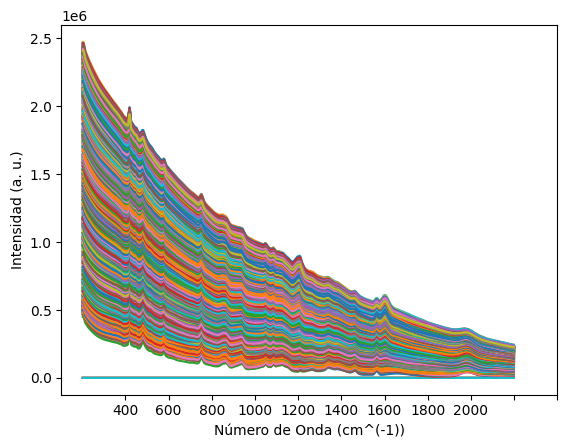

In [10]:
variable_raman_data = np.split(data, [data.columns.get_loc("2400")], axis=1) # dividimos nuestros datos en variables y espectros. 
variable_data = variable_raman_data[0] # asignación a la variable los datos anteriores a 2400 (columna 0 a la 39)

# Se encontró que hay dos columnas con nombres cruzados por lo tanto se intercambian nombres de las columnas
variable_data = variable_data.rename(columns={'2-PAT control(PAT_ref:PAT ref)': 'Batch reference(Batch_ref:Batch ref)','Batch reference(Batch_ref:Batch ref)':'2-PAT control(PAT_ref:PAT ref)'})

raman_spectra = variable_raman_data[1] # Separación de los espectros

# Gráfica espectros Raman

Intensity = raman_spectra.iloc[0:1129, 201:2600]
Temp = Intensity.transpose()

Temp_inverted = Temp.iloc[::-1]

Temp_inverted.index

x_values = np.array(Temp_inverted.index)

for column in Temp:
    # Convertir la serie de Pandas a un array de NumPy
    y_values = np.array(Temp_inverted[column])

    plt.plot(x_values, y_values, label=column)

x_ticks = range(199, 2399, 200)
plt.xticks(x_ticks) 
plt.ylabel('Intensidad (a. u.)')
plt.xlabel('Número de Onda (cm^(-1))')

plt.show()

Por último, se revisa la variable objetivo, es decir, la producción de Penicilina en función del tiempo para todos los lotes. 

Text(0, 0.5, 'Concentración Penicilina (P:g/L)')

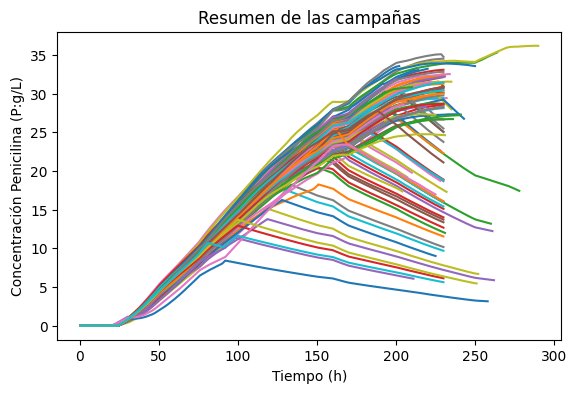

In [11]:
variable_list = variable_data.columns
variable_plot_selection = widgets.Dropdown(options=variable_list, value = 'Penicillin concentration(P:g/L)')
variable_plot_selection

fig, ax = plt.subplots(figsize=(6.5,4))
bp = variable_data.groupby('Batch reference(Batch_ref:Batch ref)').plot(x = 'Time (h)', y = variable_plot_selection.value,   ax=ax, legend = False, )
ax.set_title('Resumen de las campañas')
ax.set_xlabel('Tiempo (h)')
ax.set_ylabel('Concentración Penicilina (P:g/L)')

#### Para el **objetivo del proyecto** en el dataset definitivo **se tendrán en cuenta unas variables y lotes específicos** para cada estrategia de control tanto en train como en test, de la siguiente manera:

Variables seleccionadas: 

1.	Sugar feed rate(Fs:L/h)
2.	Agitator RPM(RPM:RPM)
3.	Temperature(T:K)
4.	pH(pH:pH)
5.	Dissolved oxygen concentration(DO2:mg/L)
6.	Vessel Volume(V:L)
7.	carbon dioxide percent in off-gas(CO2outgas:%)
8.	Oxygen in percent in off-gas(O2:O2  (%))

Hay que tener en cuenta variables como el ID del lote, el tiempo y la variable objetivo de concentración de Penicilina. Se procede a obtener el dataset seleccionado. 

In [12]:
data_select = data[['2-PAT control(PAT_ref:PAT ref)', 'Time (h)', 'Sugar feed rate(Fs:L/h)', 'Agitator RPM(RPM:RPM)', 'Temperature(T:K)',
                    'pH(pH:pH)', 'Dissolved oxygen concentration(DO2:mg/L)', 'Vessel Volume(V:L)', 'carbon dioxide percent in off-gas(CO2outgas:%)',
                    'Oxygen in percent in off-gas(O2:O2  (%))', 'Penicillin concentration(P:g/L)']]

# Renombramos la variable 2-PAT control(PAT_ref:PAT ref)': 'Batch en Batch para tener una mejor identificación. 
data_select = data_select.rename(columns={'2-PAT control(PAT_ref:PAT ref)': 'Batch'})
data_select

,Batch,Time (h),Sugar feed rate(Fs:L/h),Agitator RPM(RPM:RPM),Temperature(T:K),pH(pH:pH),Dissolved oxygen concentration(DO2:mg/L),Vessel Volume(V:L),carbon dioxide percent in off-gas(CO2outgas:%),Oxygen in percent in off-gas(O2:O2 (%)),Penicillin concentration(P:g/L)
0,1,0.2,8,100,298.22,6.4472,14.711,58479,0.089514,0.19595,1.017800e-25
1,1,0.4,8,100,298.17,6.4932,14.699,58487,0.101760,0.20390,1.000000e-03
2,1,0.6,8,100,298.14,6.5425,14.686,58495,0.105800,0.20575,9.993400e-04
3,1,0.8,8,100,298.11,6.5753,14.661,58499,0.108190,0.20602,9.987400e-04
4,1,1.0,8,100,298.09,6.5825,14.633,58501,0.110300,0.20589,9.982100e-04
...,...,...,...,...,...,...,...,...,...,...,...
113930,100,229.2,80,100,297.89,6.5085,13.385,74071,1.204400,0.19996,5.656700e+00
113931,100,229.4,80,100,298.07,6.5080,13.388,74133,1.204100,0.20002,5.649000e+00
113932,100,229.6,80,100,297.98,6.5040,13.390,74194,1.203800,0.20006,5.641400e+00
113933,100,229.8,80,100,297.88,6.4987,13.390,74255,1.203400,0.20006,5.633900e+00


In [13]:
data_select.describe(include="all").T

,count,mean,std,min,25%,50%,75%,max
Batch,113935.0,50.402466,28.862140,1.000000e+00,26.00000,50.00000,76.00000,100.00000
Time (h),113935.0,114.750656,66.990504,2.000000e-01,57.00000,114.00000,171.00000,290.00000
Sugar feed rate(Fs:L/h),113935.0,76.663764,25.680134,2.000000e+00,72.00000,80.00000,90.00000,150.00000
Agitator RPM(RPM:RPM),113935.0,100.000000,0.000000,1.000000e+02,100.00000,100.00000,100.00000,100.00000
Temperature(T:K),113935.0,298.026489,0.197513,2.968400e+02,297.95000,297.99000,298.04000,302.18000
pH(pH:pH),113935.0,6.496565,0.065676,5.395700e+00,6.49320,6.50090,6.50860,6.76640
Dissolved oxygen concentration(DO2:mg/L),113935.0,12.569647,1.498680,1.000000e+00,11.63900,12.63600,13.61400,16.50800
Vessel Volume(V:L),113935.0,73312.865441,8599.642160,5.654900e+04,65885.50000,75770.00000,79892.00000,95716.00000
carbon dioxide percent in off-gas(CO2outgas:%),113935.0,1.444042,0.498955,7.542500e-02,1.22590,1.59630,1.75730,7.12140
Oxygen in percent in off-gas(O2:O2 (%)),113935.0,0.191458,0.004718,1.295000e-01,0.18886,0.19118,0.19366,0.22751


### Análisis de missing values

In [14]:
# identificamos los datos nulos 
variables_con_nulos = data_select.columns[data_select.isnull().any()]
print("NULOS")
for variable in variables_con_nulos:
    nulos = data_select[variable].isnull().sum()
    porcentaje = (nulos / 113935) * 100  
    print(f"'{variable}' = {nulos} ----> {porcentaje:.4f}%")
total_nulos = data_select.isnull().sum().sum()
print(f"Total de valores nulos en el DataFrame: {total_nulos}")

NULOS
Total de valores nulos en el DataFrame: 0


Se explora como se comportan las variables en función del tiempo. 

# **Análisis Exploratorio de Datos** 

In [265]:
# Defino variables y nombres para este análisis
# Variables de interés
variables = [
    'Sugar feed rate(Fs:L/h)', 
    'Agitator RPM(RPM:RPM)', 
    'Temperature(T:K)', 
    'pH(pH:pH)', 
    'Dissolved oxygen concentration(DO2:mg/L)', 
    'Vessel Volume(V:L)', 
    'carbon dioxide percent in off-gas(CO2outgas:%)', 
    'Oxygen in percent in off-gas(O2:O2  (%))', 
    #'Penicillin concentration(P:g/L)'
]

# Diccionario para mapear nombres originales a nuevos nombres
variable_names = {
    'Sugar feed rate(Fs:L/h)': r'F$_\mathrm{S}$ (L/h)',
    'Agitator RPM(RPM:RPM)': r'Agitator (rpm)',
    'Temperature(T:K)': r'T (K)',
    'pH(pH:pH)': r'pH',
    'Dissolved oxygen concentration(DO2:mg/L)': r'DO$_2$ (mg/L)',
    'Vessel Volume(V:L)': r'V (L)',
    'carbon dioxide percent in off-gas(CO2outgas:%)': r'CO$_2$ (Off-Gas) (%)',
    'Oxygen in percent in off-gas(O2:O2  (%))': r'O$_2$ (Off-Gas) (%)',
    'Penicillin concentration(P:g/L)': r'Penicillin (g/L)'
}

### Análisis univariado 

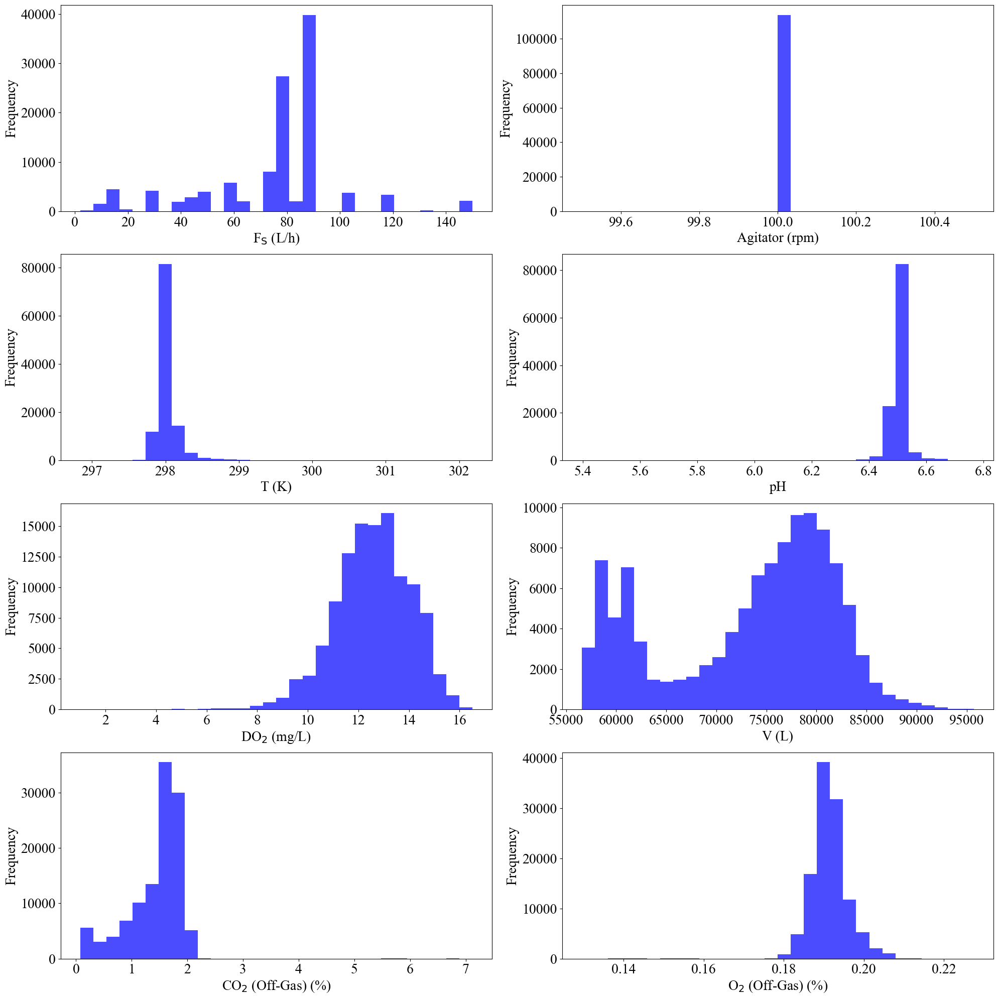

In [266]:
# Cambiar el tipo de letra
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman']

# Crear una figura con 4 filas y 2 columnas
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(20, 20))

# Iterar sobre las variables y los ejes
for ax, var in zip(axes.flatten(), variables):
    ax.hist(data_select[var], bins=30, color='blue', alpha=0.7)
    #ax.set_title(variable_names[var], fontsize=14)
    ax.set_xlabel(variable_names[var], fontsize=20)
    ax.set_ylabel('Frequency', fontsize=20)
    ax.tick_params(axis='x', labelsize=20)
    ax.tick_params(axis='y', labelsize=20)

# Ajustar el layout para que no se sobrepongan las etiquetas
plt.tight_layout()

# Mostrar el gráfico
plt.show()

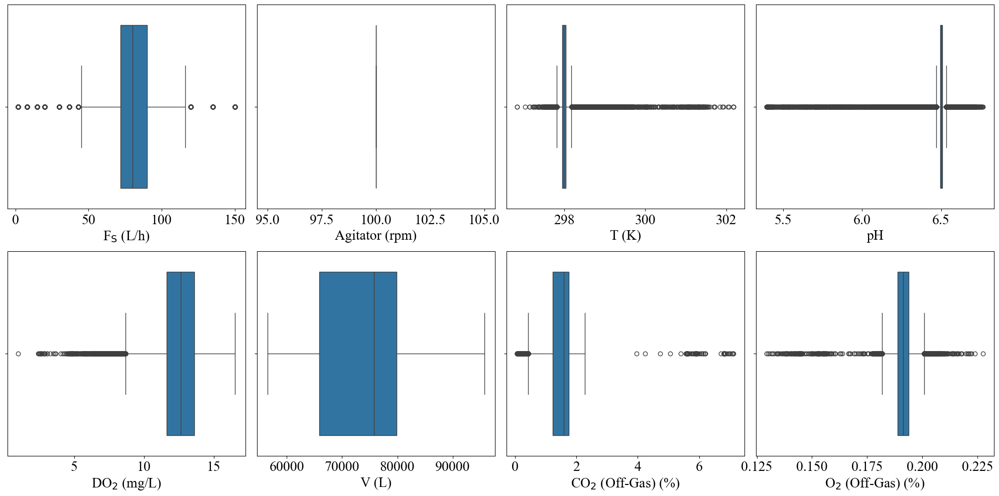

In [262]:
# Cambiar el tipo de letra
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman']

# Crear la matriz de figuras 
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(20, 10))
fig.tight_layout(pad=4.0)

# Iterar sobre las variables y los ejes
for ax, var in zip(axes.flatten(), variables):
    sns.boxplot(x=data_select[var], ax=ax)
    #ax.set_title(f'Boxplot of {variable_names[var]}', fontsize=12)
    ax.set_xlabel(variable_names[var], fontsize=20)  # Etiqueta del eje X con nombre formateado
    ax.tick_params(axis='x', labelsize=20)

# Ajustar el layout 
plt.tight_layout()

# Mostrar el gráfico
plt.show()

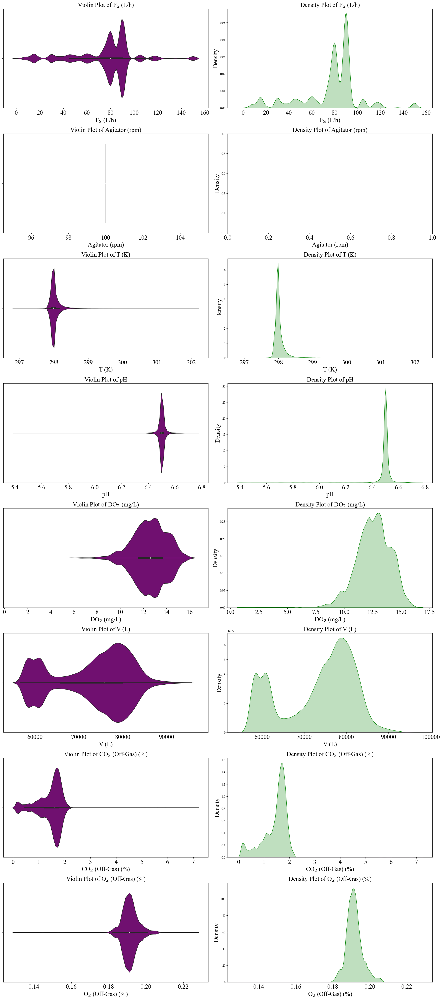

In [267]:
# Cambiar el tipo de letra
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman']

# Figura con violin plots y density plots
fig, axes = plt.subplots(nrows=8, ncols=2, figsize=(20, 45))
fig.tight_layout(pad=4.0)

# Iterar sobre las variables y los ejes
for i, var in enumerate(variables):
    # Violin plot
    sns.violinplot(x=data_select[var], ax=axes[i, 0], color='purple')
    axes[i, 0].set_title(f'Violin Plot of {variable_names[var]}', fontsize=20)
    axes[i, 0].set_xlabel(variable_names[var], fontsize=20)
    axes[i, 0].tick_params(axis='x', labelsize=20)
    
    # Density plot
    sns.kdeplot(data_select[var], ax=axes[i, 1], shade=True, color='green')
    axes[i, 1].set_title(f'Density Plot of {variable_names[var]}', fontsize=20)
    axes[i, 1].set_xlabel(variable_names[var], fontsize=20)
    axes[i, 1].set_ylabel('Density', fontsize=20)
    axes[i, 1].tick_params(axis='x', labelsize=20)
    
# Ajustar el layout para que no se sobrepongan las etiquetas
plt.tight_layout()

# Mostrar el gráfico
plt.show()

### Análsis bivariado

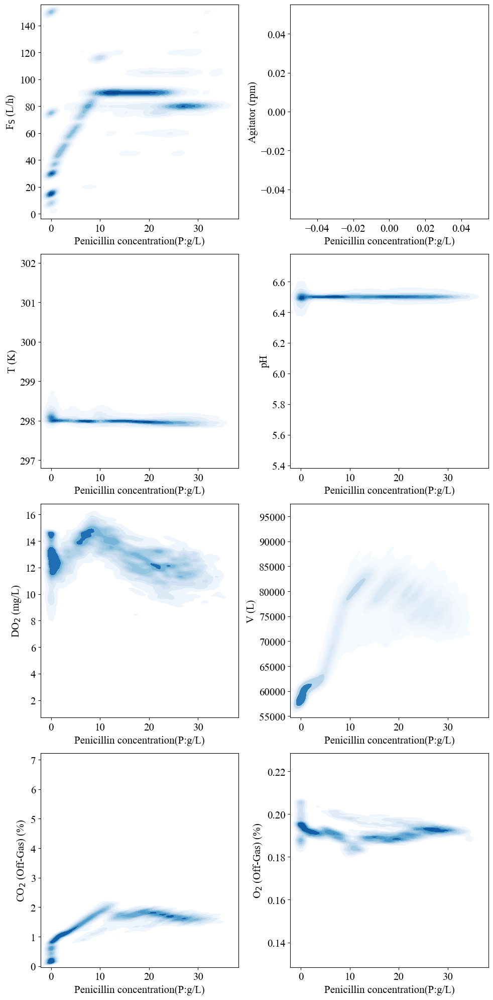

In [224]:
# Diagramas de densidad entre dos variables contínuas
# Variables de interés y sus nombres formateados con subíndices

# Variable independiente
x_var = 'Penicillin concentration(P:g/L)'

# Crear una figura con 4 filas y 2 columnas
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 20))
fig.tight_layout(pad=5.0)

# Iterar sobre las variables y los ejes
for i, (var, name) in enumerate(variable_names.items()):
    row = i // 2
    col = i % 2
    ax = axes[row, col]
    
    # Diagrama de densidad bivariada
    sns.kdeplot(x=data_select[x_var], y=data_select[var], cmap='Blues', shade=True, bw_adjust=0.5, ax=ax)
    
    # Títulos y etiquetas utilizando nombres con subíndices
    #ax.set_title(f'Density Plot of {x_var} vs {name}', fontsize=16)
    ax.set_xlabel(x_var, fontsize=15)
    ax.set_ylabel(name, fontsize=15)
    ax.tick_params(axis='x', labelsize=15)
    ax.tick_params(axis='y', labelsize=15)

# Ajustar el layout para que no se sobrepongan las etiquetas
plt.tight_layout()

# Mostrar el gráfico
plt.show()

Cuando una variable tiene un valor constante, como Agitator RPM(RPM:RPM) que siempre tiene un valor de 100 rpm, la densidad bivariada no se puede calcular correctamente porque no hay variación en los datos para esa variable. Esto resulta en un gráfico vacío o un gráfico sin datos significativos como se evidencia en los graficos anteriores. 

Se realizó otro análisis entre las variables seleccionadas y el tiempo, es muy importante entender el compartamiento dinamico de las variables independientes. 

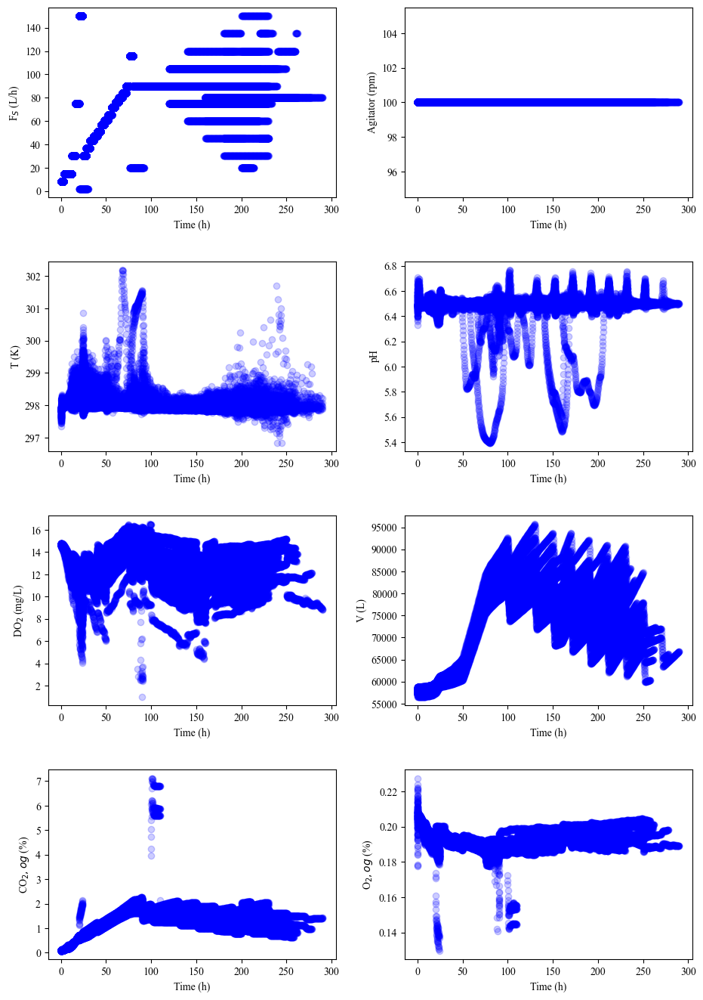

In [222]:
# Cambiar el tipo de letra
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'

# Crear la matriz de gráficas
fig, axes = plt.subplots(4, 2, figsize=(10, 14))
fig.tight_layout(pad=4.0)

# Iterar sobre las variables y crear las gráficas de dispersión
for i, variable in enumerate(variables):
    row = i // 2
    col = i % 2

    # Seleccionar los datos para la gráfica actual
    x = data_select['Time (h)']
    y = data_select[variable]

    # Crear la gráfica de dispersión en la posición correspondiente en la matriz
    axes[row, col].scatter(x, y, c='blue', alpha=0.2)

    # Añadir títulos y etiquetas a la gráfica
    axes[row, col].set_xlabel('Time (h)')
    axes[row, col].set_ylabel(variable_names[variable])

# Mostrar la matriz de gráficas
plt.show()

Se revisa el batch 2

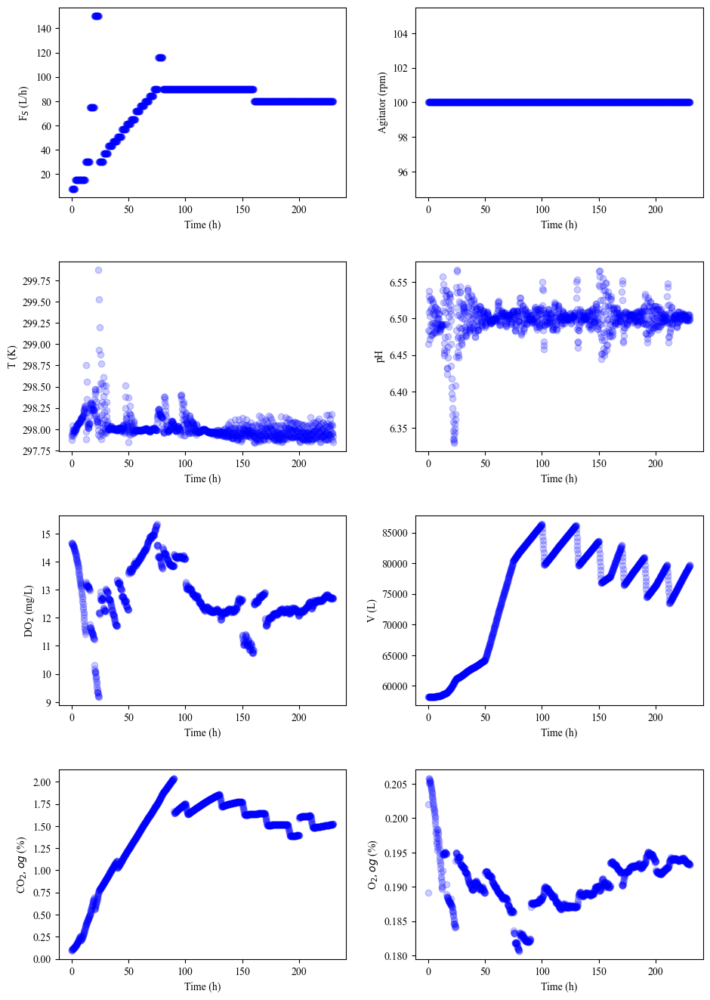

In [227]:
# Batch 2
batch_2_select = data_select[data_select['Batch'] == 2]

# Cambiar el tipo de letra
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = 'Times New Roman'

# Crear la matriz de gráficas
fig, axes = plt.subplots(4, 2, figsize=(10, 14))
fig.tight_layout(pad=4.0)

# Iterar sobre las variables y crear las gráficas de dispersión
for i, variable in enumerate(variables):
    row = i // 2
    col = i % 2

    # Seleccionar los datos para la gráfica actual
    x = batch_2_select['Time (h)']
    y = batch_2_select[variable]

    # Crear la gráfica de dispersión en la posición correspondiente en la matriz
    axes[row, col].scatter(x, y, c='blue', alpha=0.2)

    # Añadir títulos y etiquetas a la gráfica
    axes[row, col].set_xlabel('Time (h)')
    axes[row, col].set_ylabel(variable_names[variable])

# Mostrar la matriz de gráficas
plt.show()

### Análisis multivariado

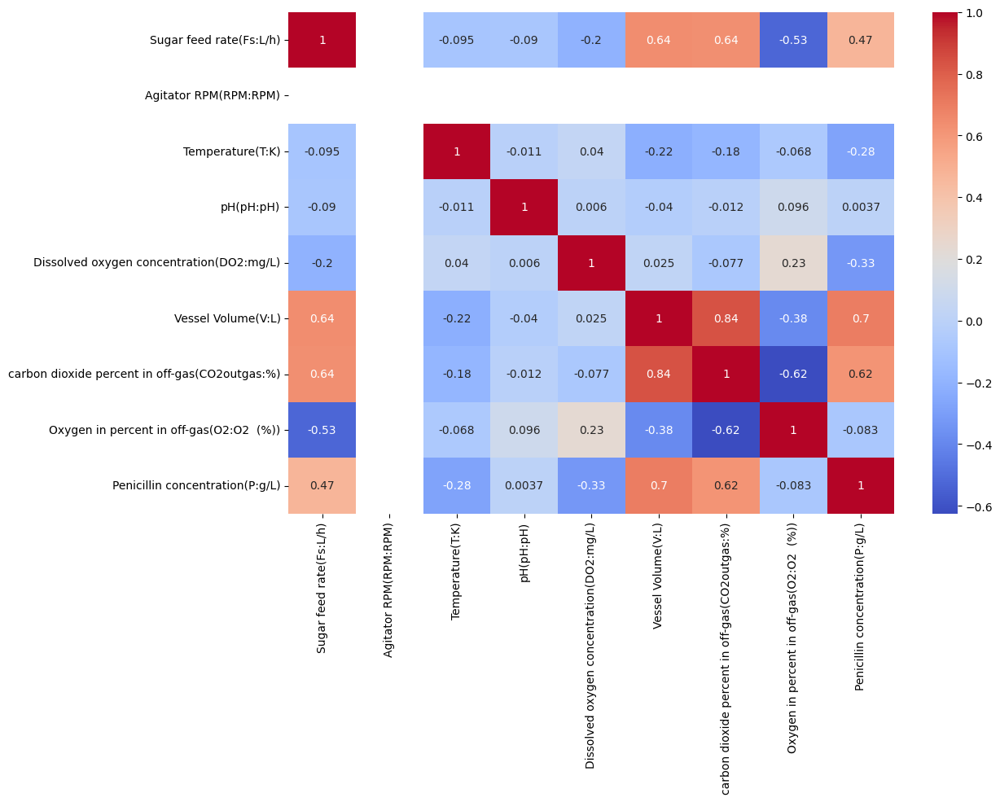

In [38]:
# Selección de variables
data_select1 = data[['Sugar feed rate(Fs:L/h)', 
    'Agitator RPM(RPM:RPM)', 
    'Temperature(T:K)', 
    'pH(pH:pH)', 
    'Dissolved oxygen concentration(DO2:mg/L)', 
    'Vessel Volume(V:L)', 
    'carbon dioxide percent in off-gas(CO2outgas:%)', 
    'Oxygen in percent in off-gas(O2:O2  (%))', 
    'Penicillin concentration(P:g/L)']]

# Correlación entre variables numéricas
plt.figure(figsize=(12, 8))
sns.heatmap(data_select1.corr(), annot=True, cmap='coolwarm')
plt.show()



En el mapa de calor se observa poca correlación entre las variables excepto en variables como vessel volume(V:L) y carbon dioxide percent in off-gas(CO2outgas:%), con un valor de 0.84. A continuación,  se revisa la multicolinealidad a partir del VIF. 

In [42]:
# Calcular el VIF para cada variable
X = data_select1.dropna()  # Asegúrate de eliminar valores nulos antes
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns
vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(len(X.columns))]

print(vif_data)

                                          feature           VIF
0                         Sugar feed rate(Fs:L/h)  2.120782e+00
1                           Agitator RPM(RPM:RPM)  2.586136e+06
2                                Temperature(T:K)  1.115187e+00
3                                       pH(pH:pH)  1.027925e+00
4        Dissolved oxygen concentration(DO2:mg/L)  1.803388e+00
5                              Vessel Volume(V:L)  5.209875e+00
6  carbon dioxide percent in off-gas(CO2outgas:%)  6.403930e+00
7        Oxygen in percent in off-gas(O2:O2  (%))  3.319619e+00
8                 Penicillin concentration(P:g/L)  3.951604e+00


Todas las variables indican poca colinealidad excepto vessel volume(V:L) y carbon dioxide percent in off-gas(CO2outgas:%). Sin embargo, los valores son cercanos a 5, es decir, la colinealidad moderada es baja. Con estos resultados se espera no tener problemas de multicolinealidad en los modelos. 

#### Detección e imputación de ouliers

Para la detección de ouliers se utilizó el método de Isolation Forest, el cual es altamente eficiente en términos de tiempo de ejecución y puede manejar grandes conjuntos de datos de manera efectiva, debido a su enfoque basado en la construcción de árboles, que es computacionalmente menos costoso en comparación con otros métodos de detección de outliers. Por otra parte, no asume que los datos siguen una distribución normal o cualquier otra distribución específica. Esto lo hace más flexible y aplicable a una amplia variedad de conjuntos de datos.

In [295]:
from sklearn.ensemble import IsolationForest
import pandas as pd

# Supongamos que data_grecipe es tu DataFrame
# data_grecipe = pd.read_csv('tu_archivo.csv')

def detect_outliers_isolation_forest(data_grecipe):
    # Inicializar el modelo de Isolation Forest
    iso_forest = IsolationForest(contamination=0.01)  # Puedes ajustar la contaminación según sea necesario
    
    # Aplicar el modelo a cada columna numérica
    for column in data_grecipe:
        if data_grecipe[column].dtype in ['int64', 'float64']:
            # Reshape para Isolation Forest
            column_data = data_grecipe[[column]].values.reshape(-1, 1)
            iso_forest.fit(column_data)
            outliers = iso_forest.predict(column_data)
            # Los outliers se marcan como -1
            num_outliers = (outliers == -1).sum()
            porcentaje = (num_outliers / len(data_grecipe)) * 100
            print(f'{column}: {num_outliers} ----> {porcentaje:.1f}%')

# Ejecutar la función
detect_outliers_isolation_forest(data_grecipe)


Batch: 0 ----> 0.0%
Time (h): 341 ----> 1.0%
Sugar feed rate(Fs:L/h): 0 ----> 0.0%
Agitator RPM(RPM:RPM): 0 ----> 0.0%
Temperature(T:K): 334 ----> 1.0%
pH(pH:pH): 340 ----> 1.0%
Dissolved oxygen concentration(DO2:mg/L): 337 ----> 1.0%
Vessel Volume(V:L): 337 ----> 1.0%
carbon dioxide percent in off-gas(CO2outgas:%): 341 ----> 1.0%
Oxygen in percent in off-gas(O2:O2  (%)): 344 ----> 1.0%
Penicillin concentration(P:g/L): 331 ----> 1.0%


Se encontraron muy bajos porcentajes de outliers en las variables seleccionadas. Además, los análisis univariados y bivariados muestran que las variables seleccionadas estan dentro de los rangos normales en la producción de pencilina, considerando también la incertidumbre de los sensores. Por ejemplo, en el caso de la temperatura, todo los valores evidenciados en los análisis muestran que son valores muy cercanos a la temperatura ambiente. Por tal motivo no se imputaran estos datos encontrados. 

Para los objetivos del proyecto se tuvo en cuenta el particionamiento en train y test de la sigueinte manera:  

### **Particionamiento dataset de train y test**

<img src="Batchs.png" alt="Batch" width="700" height="700">

A continuación, se desarrollaran los objetivos de este proyecto por cada estrategia de control.

# **Controlled by recipe driven approach**

### Paticionamiento train y test 

In [15]:
# Se realiza el particionamiento en train y en test con la estratégia de control: Controlado por un enfoque basado en recetas.

id_grecipe_train = [21, 13, 26, 9, 29, 30, 11, 24, 3, 20, 7, 22, 17, 5, 6, 12, 
                    10, 19, 25, 27, 4, 1, 8]
id_grecipe_test = [2, 14, 15, 16, 18, 23, 28]

# Utilizar una comprensión de lista para obtener los grupos
recipe_train = [data_select.groupby('Batch').get_group(id) for id in id_grecipe_train]
recipe_test = [data_select.groupby('Batch').get_group(id) for id in id_grecipe_test]

# Combinar los grupos
grecipe_train = pd.concat(recipe_train)
grecipe_test = pd.concat(recipe_test)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_grecipe = grecipe_train.drop(['Batch','Penicillin concentration(P:g/L)', 'Time (h)'], axis=1)
y_train_grecipe = grecipe_train["Penicillin concentration(P:g/L)"]
X_test_grecipe = grecipe_test.drop(['Batch','Penicillin concentration(P:g/L)', 'Time (h)'], axis=1)
y_test_grecipe = grecipe_test["Penicillin concentration(P:g/L)"]

### Desarrollo y ajuste de un modelo **Lasso** en GRecipe

In [143]:
# Definir una función para entrenar y evaluar un modelo Lasso con más hiperparámetros
def lasso_cv(alpha, max_iter, tol, fit_intercept, normalize):
    fit_intercept = bool(round(fit_intercept))
    normalize = bool(round(normalize))
    
    model = Pipeline([
        ('scaler', StandardScaler(with_mean=normalize)),
        ('lasso', Lasso(alpha=alpha, max_iter=int(max_iter), tol=tol, fit_intercept=fit_intercept))
    ])
    model.fit(X_train_grecipe, y_train_grecipe)
    y_pred = model.predict(X_test_grecipe)
    return -mean_squared_error(y_test_grecipe, y_pred)

# Definir el espacio de búsqueda para la optimización bayesiana
pbounds = {
    'alpha': (0.001, 1),
    'max_iter': (100, 1000),
    'tol': (1e-5, 1e-1),
    'fit_intercept': (0, 1),  
    'normalize': (0, 1)       
}

# Optimización bayesiana para Lasso
lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds=pbounds, random_state=42, allow_duplicate_points=True)
lasso_optimizer.maximize(init_points=10, n_iter=30)

# Obtener el mejor conjunto de hiperparámetros para Lasso
best_params = lasso_optimizer.max['params']
best_alpha = best_params['alpha']
best_max_iter = int(best_params['max_iter'])
best_tol = best_params['tol']
best_fit_intercept = bool(round(best_params['fit_intercept']))
best_normalize = bool(round(best_params['normalize']))

# Entrenar el modelo Lasso con los mejores hiperparámetros
lasso_model_grecipe = Pipeline([
    ('scaler', StandardScaler(with_mean=best_normalize)),
    ('lasso', Lasso(alpha=best_alpha, max_iter=best_max_iter, tol=best_tol, fit_intercept=best_fit_intercept))
])
lasso_model_grecipe.fit(X_train_grecipe, y_train_grecipe)


|   iter    |  target   |   alpha   | fit_in... | max_iter  | normalize |    tol    |
-------------------------------------------------------------------------------------
| 1         | -25.45    | 0.3752    | 0.9507    | 758.8     | 0.5987    | 0.01561   |
| 2         | -235.9    | 0.1568    | 0.05808   | 879.6     | 0.6011    | 0.07081   |
| 3         | -24.0     | 0.02156   | 0.9699    | 849.2     | 0.2123    | 0.01819   |
| 4         | -40.99    | 0.1842    | 0.3042    | 572.3     | 0.4319    | 0.02913   |
| 5         | -45.11    | 0.6122    | 0.1395    | 362.9     | 0.3664    | 0.04561   |
| 6         | -245.3    | 0.7854    | 0.1997    | 562.8     | 0.5924    | 0.004655  |
| 7         | -242.7    | 0.6079    | 0.1705    | 158.5     | 0.9489    | 0.09656   |
| 8         | -246.6    | 0.8086    | 0.3046    | 187.9     | 0.6842    | 0.04402   |
| 9         | -235.3    | 0.1229    | 0.4952    | 130.9     | 0.9093    | 0.02589   |
| 10        | -242.9    | 0.6629    | 0.3117    | 568.

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso',
                 Lasso(alpha=0.021563909801506645, max_iter=849,
                       tol=0.01819067847103799))])

In [150]:
print(f"Best alpha: {best_alpha}")
print(f"Best max_iter: {best_max_iter}")
print(f"Best tol: {best_tol}")
print(f"Best fit_intercept: {best_fit_intercept}")
print(f"Best normalize: {best_normalize}")

Best alpha: 0.023580402551871917
Best max_iter: 1408
Best tol: 0.0063547160447917535
Best fit_intercept: True
Best normalize: True


In [297]:
# # Definir una función para entrenar y evaluar un modelo Lasso
# def lasso_cv(alpha):
#     model = Lasso(alpha=alpha)
#     model.fit(X_train_grecipe, y_train_grecipe)
#     y_pred = model.predict(X_test_grecipe)
#     return -mean_squared_error(y_test_grecipe, y_pred)

# # Optimización bayesiana para Lasso
# lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds={'alpha': (0.001, 1)}, random_state=42, allow_duplicate_points=True)
# lasso_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener el mejor valor de alpha para Lasso
# best_alpha = lasso_optimizer.max['params']['alpha']

# # Entrenar el modelo Lasso con el mejor valor de alpha
# lasso_model_grecipe = Lasso(alpha=best_alpha)
# lasso_model_grecipe.fit(X_train_grecipe, y_train_grecipe)

|   iter    |  target   |   alpha   |
-------------------------------------
| 1         | -41.82    | 0.3752    |
| 2         | -42.62    | 0.9508    |
| 3         | -42.27    | 0.7323    |
| 4         | -42.08    | 0.5991    |
| 5         | -41.34    | 0.1569    |
| 6         | -41.34    | 0.1568    |
| 7         | -39.61    | 0.05903   |
| 8         | -42.48    | 0.8663    |
| 9         | -42.09    | 0.6015    |
| 10        | -42.24    | 0.7084    |
| 11        | -24.42    | 0.001     |
| 12        | -39.26    | 0.01353   |
| 13        | -26.21    | 0.003748  |
| 14        | -41.94    | 0.4873    |
| 15        | -41.7     | 0.2657    |
| 16        | -24.55    | 0.001323  |
| 17        | -42.37    | 0.7983    |
| 18        | -41.88    | 0.4311    |
| 19        | -40.25    | 0.1035    |
| 20        | -42.01    | 0.5433    |
| 21        | -41.76    | 0.3204    |
| 22        | -41.65    | 0.2113    |
Data point [0.001] is not unique. 1 duplicates registered. Continuing ...
| 23        | 

Lasso(alpha=0.001)

In [145]:
# Guardar el modelo entrenado
joblib.dump(lasso_model_grecipe, 'lasso_model_grecipe.pkl')

# Cargar el modelo entrenado
loaded_model_lasso_grecipe = joblib.load('lasso_model_grecipe.pkl')
loaded_model_lasso_grecipe

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso',
                 Lasso(alpha=0.021563909801506645, max_iter=849,
                       tol=0.01819067847103799))])

In [146]:
# Predecir con el modelo entrenado
y_pred_lasso_grecipe = loaded_model_lasso_grecipe.predict(X_test_grecipe)

# Calcular las métricas
mse_lasso_grecipe = mean_squared_error(y_test_grecipe, y_pred_lasso_grecipe)
rmse_lasso_grecipe = np.sqrt(mse_lasso_grecipe)
mae_lasso_grecipe = mean_absolute_error(y_test_grecipe, y_pred_lasso_grecipe)
r2_lasso_grecipe = r2_score(y_test_grecipe, y_pred_lasso_grecipe)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_lasso_grecipe:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lasso_grecipe:.5f}")
print(f"Mean Absolute Error (MAE): {mae_lasso_grecipe:.5f}")
print(f"R-squared (R^2): {r2_lasso_grecipe:.5f}")

Mean Squared Error (MSE): 23.99625
Root Mean Squared Error (RMSE): 4.89860
Mean Absolute Error (MAE): 3.77642
R-squared (R^2): 0.77965


In [148]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_lasso_grecipe = pd.DataFrame(y_pred_lasso_grecipe, columns=['pred_lasso_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_lasso_grecipe.to_csv('y_pred_lasso_grecipe.csv', index=False)

### Desarrollo y ajuste de un modelo **Random Forest** en GRecipe

In [185]:
# Definir una función para entrenar y evaluar un modelo Random Forest
def rf_cv(n_estimators, max_depth, max_features, min_samples_split, min_samples_leaf, bootstrap):
    model = RandomForestRegressor(
        n_estimators=int(n_estimators),
        max_depth=int(max_depth),
        max_features=max_features,
        min_samples_split=int(min_samples_split),
        min_samples_leaf=int(min_samples_leaf),
        bootstrap=bootstrap > 0.5  # Convierte a booleano
    )
    model.fit(X_train_grecipe, y_train_grecipe)
    y_pred = model.predict(X_test_grecipe)
    return -mean_squared_error(y_test_grecipe, y_pred)

# Optimización bayesiana para Random Forest
pbounds = {
    'n_estimators': (10, 200),
    'max_depth': (1, 20),
    'max_features': (0.1, 1.0),  # Se asume un valor flotante entre 0.1 y 1.0
    'min_samples_split': (2, 20),
    'min_samples_leaf': (1, 20),
    'bootstrap': (0, 1)  # Se usará 0 para False y 1 para True
}

rf_optimizer = BayesianOptimization(f=rf_cv, pbounds=pbounds, random_state=42)
rf_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para Random Forest
best_params = rf_optimizer.max['params']
best_n_estimators = int(best_params['n_estimators'])
best_max_depth = int(best_params['max_depth'])
best_max_features = best_params['max_features']
best_min_samples_split = int(best_params['min_samples_split'])
best_min_samples_leaf = int(best_params['min_samples_leaf'])
best_bootstrap = best_params['bootstrap'] > 0.5

# Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
rf_model_grecipe = RandomForestRegressor(
    n_estimators=best_n_estimators,
    max_depth=best_max_depth,
    max_features=best_max_features,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    bootstrap=best_bootstrap
)
rf_model_grecipe.fit(X_train_grecipe, y_train_grecipe)

|   iter    |  target   | bootstrap | max_depth | max_fe... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------------------
| 1         | -6.124    | 0.3745    | 19.06     | 0.7588    | 12.37     | 4.808     | 39.64     |
| 2         | -6.016    | 0.05808   | 17.46     | 0.641     | 14.45     | 2.371     | 194.3     |
| 3         | -12.86    | 0.8324    | 5.034     | 0.2636    | 4.485     | 7.476     | 109.7     |
| 4         | -6.952    | 0.4319    | 6.533     | 0.6507    | 3.65      | 7.259     | 79.61     |
| 5         | -5.705    | 0.4561    | 15.92     | 0.2797    | 10.77     | 12.66     | 18.83     |
| 6         | -23.52    | 0.6075    | 4.24      | 0.1585    | 19.03     | 19.38     | 163.6     |
| 7         | -25.52    | 0.3046    | 2.856     | 0.7158    | 9.363     | 4.197     | 104.1     |
| 8         | -5.687    | 0.03439   | 18.28     | 0.3329    | 13.59     | 7.611     | 108.8     |
| 9         | -11.03

RandomForestRegressor(bootstrap=False, max_depth=11,
                      max_features=0.529227702844746, min_samples_leaf=6,
                      min_samples_split=7, n_estimators=56)

In [186]:
#print(f"Best params: {best_params}")
print(f"Best n estimators: {best_n_estimators}")
print(f"Best max depth: {best_max_depth}")
print(f"Best max features: {best_max_features}")
print(f"Best min samples split: {best_min_samples_split}")
print(f"Best min samples leaf: {best_min_samples_leaf}")
print(f"Best best_bootstrap: {best_bootstrap}")

Best n estimators: 56
Best max depth: 11
Best max features: 0.529227702844746
Best min samples split: 7
Best min samples leaf: 6
Best best_bootstrap: False


In [301]:
# # Definir una función para entrenar y evaluar un modelo Random Forest
# def rf_cv(n_estimators, max_depth):
#     model = RandomForestRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth))
#     model.fit(X_train_grecipe, y_train_grecipe)
#     y_pred = model.predict(X_test_grecipe)
#     return -mean_squared_error(y_test_grecipe, y_pred)

# # Optimización bayesiana para Random Forest
# rf_optimizer = BayesianOptimization(f=rf_cv, pbounds={'n_estimators': (10, 200), 'max_depth': (1, 20)}, random_state=42)
# rf_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para Random Forest
# best_n_estimators = int(rf_optimizer.max['params']['n_estimators'])
# best_max_depth = int(rf_optimizer.max['params']['max_depth'])

# # Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
# rf_model_grecipe = RandomForestRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth)
# rf_model_grecipe.fit(X_train_grecipe, y_train_grecipe)

|   iter    |  target   | max_depth | n_esti... |
-------------------------------------------------
| 1         | -6.134    | 8.116     | 190.6     |
| 2         | -6.224    | 14.91     | 123.7     |
| 3         | -16.49    | 3.964     | 39.64     |
| 4         | -25.73    | 2.104     | 174.6     |
| 5         | -6.029    | 12.42     | 144.5     |
| 6         | -44.31    | 1.391     | 194.3     |
| 7         | -6.568    | 16.82     | 50.34     |
| 8         | -11.74    | 4.455     | 44.85     |
| 9         | -7.09     | 6.781     | 109.7     |
| 10        | -6.132    | 9.207     | 65.33     |
| 11        | -6.04     | 12.59     | 144.6     |
| 12        | -6.115    | 13.29     | 188.4     |
| 13        | -5.98     | 12.54     | 57.78     |
| 14        | -12.07    | 4.396     | 58.45     |
| 15        | -6.53     | 17.05     | 64.45     |
| 16        | -6.203    | 8.394     | 118.5     |
| 17        | -6.365    | 15.88     | 114.5     |
| 18        | -6.247    | 13.9      | 134.9     |


RandomForestRegressor(max_depth=12, n_estimators=57)

In [187]:
# Guardar el modelo entrenado
joblib.dump(rf_model_grecipe, 'rf_model_grecipe.pkl')

# Cargar el modelo entrenado
loaded_model_rf_grecipe = joblib.load('rf_model_grecipe.pkl')
loaded_model_rf_grecipe

RandomForestRegressor(bootstrap=False, max_depth=11,
                      max_features=0.529227702844746, min_samples_leaf=6,
                      min_samples_split=7, n_estimators=56)

In [188]:
# Predecir con el modelo entrenado
y_pred_rf_grecipe = loaded_model_rf_grecipe.predict(X_test_grecipe)

# Calcular las métricas
mse_rf_grecipe = mean_squared_error(y_test_grecipe, y_pred_rf_grecipe)
rmse_rf_grecipe = np.sqrt(mse_rf_grecipe)
mae_rf_grecipe = mean_absolute_error(y_test_grecipe, y_pred_rf_grecipe)
r2_rf_grecipe = r2_score(y_test_grecipe, y_pred_rf_grecipe)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_rf_grecipe:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_rf_grecipe:.5f}")
print(f"Mean Absolute Error (MAE): {mae_rf_grecipe:.5f}")
print(f"R-squared (R^2): {r2_rf_grecipe:.5f}")

Mean Squared Error (MSE): 5.69142
Root Mean Squared Error (RMSE): 2.38567
Mean Absolute Error (MAE): 1.50261
R-squared (R^2): 0.94774


In [189]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_rf_grecipe = pd.DataFrame(y_pred_rf_grecipe, columns=['pred_rf_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_rf_grecipe.to_csv('y_pred_rf_grecipe.csv', index=False)

### Desarrollo y ajuste de un modelo **ANN** en GRecipe

|   iter    |  target   | activa... | batch_... | dropou... |  epochs   | hidden... | hidden... | hidden... |
-------------------------------------------------------------------------------------------------------------
Epoch 1/33, RMSE: 0.3881
Epoch 2/33, RMSE: 0.3658
Epoch 3/33, RMSE: 0.3344
Epoch 4/33, RMSE: 0.3176
Epoch 5/33, RMSE: 0.2979
Epoch 6/33, RMSE: 0.2865
Epoch 7/33, RMSE: 0.2739
Epoch 8/33, RMSE: 0.2690
Epoch 9/33, RMSE: 0.2645
Epoch 10/33, RMSE: 0.2654
Epoch 11/33, RMSE: 0.2556
Epoch 12/33, RMSE: 0.2590
Epoch 13/33, RMSE: 0.2642
Epoch 14/33, RMSE: 0.2571
Epoch 15/33, RMSE: 0.2854
Epoch 16/33, RMSE: 0.2551
Epoch 17/33, RMSE: 0.2573
Epoch 18/33, RMSE: 0.2651
Epoch 19/33, RMSE: 0.2859
Epoch 20/33, RMSE: 0.3180
Epoch 21/33, RMSE: 0.2740
Epoch 22/33, RMSE: 0.2764
Epoch 23/33, RMSE: 0.2503
Epoch 24/33, RMSE: 0.2836
Epoch 25/33, RMSE: 0.2646
Epoch 26/33, RMSE: 0.3183
Epoch 27/33, RMSE: 0.2692
Epoch 28/33, RMSE: 0.2726
Epoch 29/33, RMSE: 0.2734
Epoch 30/33, RMSE: 0.2805
Epoch 31/

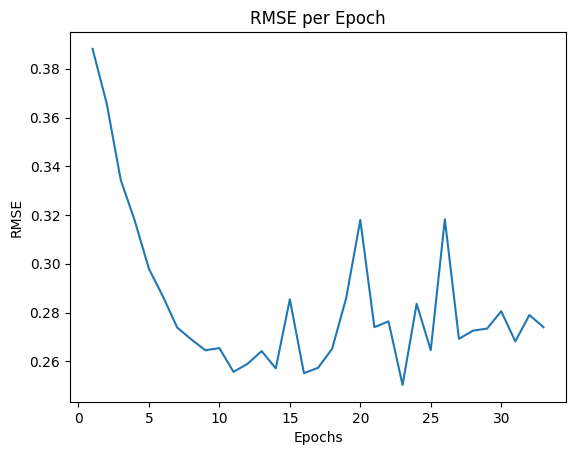

| 1         | -3.012    | 0.7491    | 48.03     | 0.3928    | 33.95     | 93.96     | 93.95     | 37.58     |
Epoch 1/10, RMSE: 0.4857
Epoch 2/10, RMSE: 0.4319
Epoch 3/10, RMSE: 0.3679
Epoch 4/10, RMSE: 0.4065
Epoch 5/10, RMSE: 0.3202
Epoch 6/10, RMSE: 0.3045
Epoch 7/10, RMSE: 0.2940
Epoch 8/10, RMSE: 0.2943
Epoch 9/10, RMSE: 0.3098
Epoch 10/10, RMSE: 0.3262


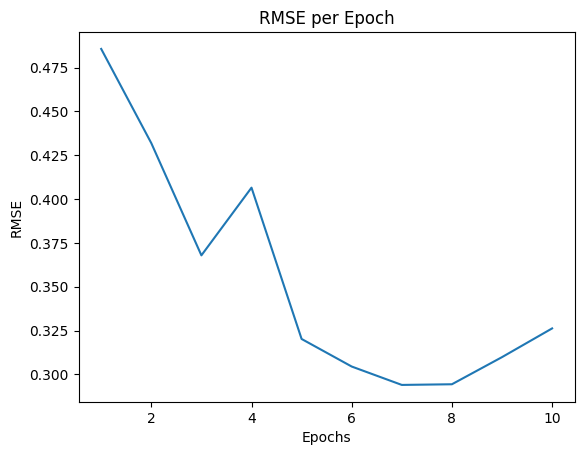

| 2         | -3.517    | 1.732     | 34.04     | 0.3832    | 10.82     | 250.2     | 223.8     | 52.38     |
Epoch 1/30, RMSE: 0.7128
Epoch 2/30, RMSE: 0.3961
Epoch 3/30, RMSE: 0.3598
Epoch 4/30, RMSE: 0.3441
Epoch 5/30, RMSE: 0.3682
Epoch 6/30, RMSE: 0.3656
Epoch 7/30, RMSE: 0.3642
Epoch 8/30, RMSE: 0.3690
Epoch 9/30, RMSE: 0.3635
Epoch 10/30, RMSE: 0.3598
Epoch 11/30, RMSE: 0.3633
Epoch 12/30, RMSE: 0.3733
Epoch 13/30, RMSE: 0.4266
Epoch 14/30, RMSE: 0.3997
Early stopping at epoch 14


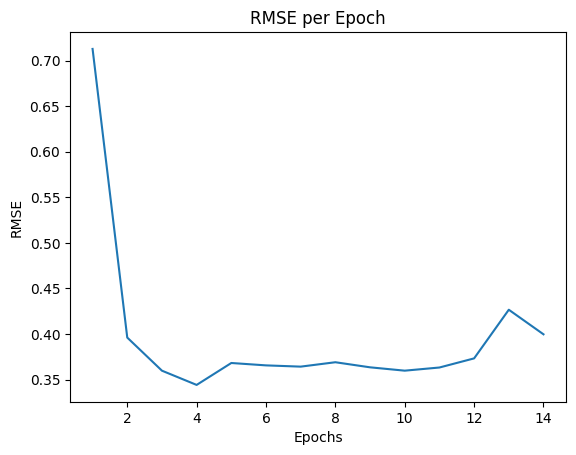

| 3         | -3.997    | 0.3636    | 17.34     | 0.2217    | 30.99     | 146.9     | 119.9     | 90.74     |
Epoch 1/28, RMSE: 0.4650
Epoch 2/28, RMSE: 0.3902
Epoch 3/28, RMSE: 0.3471
Epoch 4/28, RMSE: 0.3515
Epoch 5/28, RMSE: 0.3460
Epoch 6/28, RMSE: 0.3368
Epoch 7/28, RMSE: 0.3191
Epoch 8/28, RMSE: 0.2926
Epoch 9/28, RMSE: 0.3036
Epoch 10/28, RMSE: 0.3446
Epoch 11/28, RMSE: 0.3433
Epoch 12/28, RMSE: 0.3843
Epoch 13/28, RMSE: 0.4112
Epoch 14/28, RMSE: 0.4256
Epoch 15/28, RMSE: 0.3832
Epoch 16/28, RMSE: 0.3920
Epoch 17/28, RMSE: 0.3579
Epoch 18/28, RMSE: 0.3578
Early stopping at epoch 18


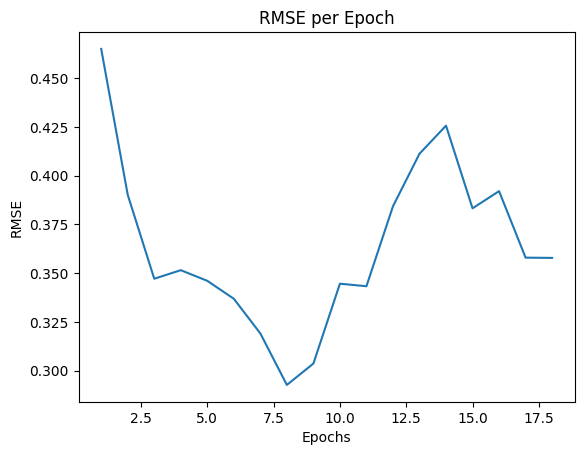

| 4         | -3.566    | 0.279     | 21.69     | 0.2465    | 28.24     | 214.8     | 102.3     | 81.37     |
Epoch 1/16, RMSE: 0.7497
Epoch 2/16, RMSE: 0.6136
Epoch 3/16, RMSE: 0.5024
Epoch 4/16, RMSE: 0.4340
Epoch 5/16, RMSE: 0.3477
Epoch 6/16, RMSE: 0.4659
Epoch 7/16, RMSE: 0.4501
Epoch 8/16, RMSE: 0.4245
Epoch 9/16, RMSE: 0.4161
Epoch 10/16, RMSE: 0.4014
Epoch 11/16, RMSE: 0.4158
Epoch 12/16, RMSE: 0.3620
Epoch 13/16, RMSE: 0.3675
Epoch 14/16, RMSE: 0.3391
Epoch 15/16, RMSE: 0.4146
Epoch 16/16, RMSE: 0.3542


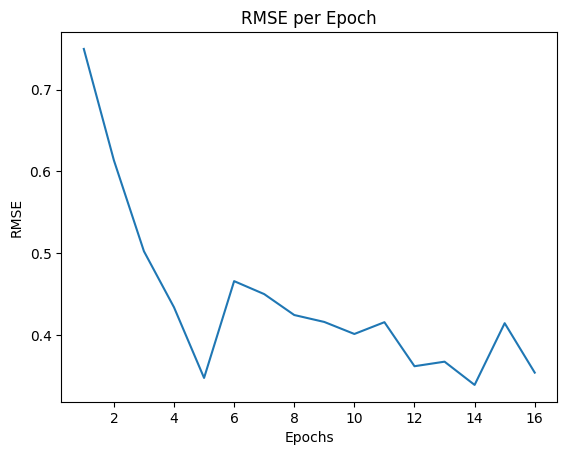

| 5         | -3.532    | 1.185     | 11.86     | 0.343     | 16.82     | 76.49     | 246.2     | 124.7     |
Epoch 1/37, RMSE: 0.4761
Epoch 2/37, RMSE: 0.3652
Epoch 3/37, RMSE: 0.3645
Epoch 4/37, RMSE: 0.3571
Epoch 5/37, RMSE: 0.3569
Epoch 6/37, RMSE: 0.3402
Epoch 7/37, RMSE: 0.3115
Epoch 8/37, RMSE: 0.2803
Epoch 9/37, RMSE: 0.2756
Epoch 10/37, RMSE: 0.2869
Epoch 11/37, RMSE: 0.3409
Epoch 12/37, RMSE: 0.3221
Epoch 13/37, RMSE: 0.3339
Epoch 14/37, RMSE: 0.3560
Epoch 15/37, RMSE: 0.3258
Epoch 16/37, RMSE: 0.3529
Epoch 17/37, RMSE: 0.3398
Epoch 18/37, RMSE: 0.3734
Epoch 19/37, RMSE: 0.3464
Early stopping at epoch 19


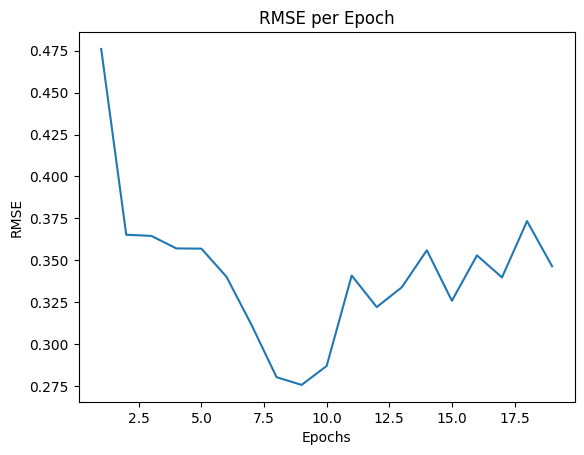

| 6         | -3.738    | 1.617     | 22.18     | 0.1391    | 37.37     | 148.5     | 87.43     | 79.54     |
Epoch 1/36, RMSE: 0.4137
Epoch 2/36, RMSE: 0.3772
Epoch 3/36, RMSE: 0.3642
Epoch 4/36, RMSE: 0.3484
Epoch 5/36, RMSE: 0.3116
Epoch 6/36, RMSE: 0.3034
Epoch 7/36, RMSE: 0.2863
Epoch 8/36, RMSE: 0.2838
Epoch 9/36, RMSE: 0.2721
Epoch 10/36, RMSE: 0.2776
Epoch 11/36, RMSE: 0.2714
Epoch 12/36, RMSE: 0.2791
Epoch 13/36, RMSE: 0.2701
Epoch 14/36, RMSE: 0.2730
Epoch 15/36, RMSE: 0.2670
Epoch 16/36, RMSE: 0.2755
Epoch 17/36, RMSE: 0.2621
Epoch 18/36, RMSE: 0.2759
Epoch 19/36, RMSE: 0.2576
Epoch 20/36, RMSE: 0.3245
Epoch 21/36, RMSE: 0.3067
Epoch 22/36, RMSE: 0.2585
Epoch 23/36, RMSE: 0.2559
Epoch 24/36, RMSE: 0.2553
Epoch 25/36, RMSE: 0.2707
Epoch 26/36, RMSE: 0.2779
Epoch 27/36, RMSE: 0.2600
Epoch 28/36, RMSE: 0.2889
Epoch 29/36, RMSE: 0.2805
Epoch 30/36, RMSE: 0.3026
Epoch 31/36, RMSE: 0.2594
Epoch 32/36, RMSE: 0.2901
Epoch 33/36, RMSE: 0.2789
Epoch 34/36, RMSE: 0.3151
Early stopping 

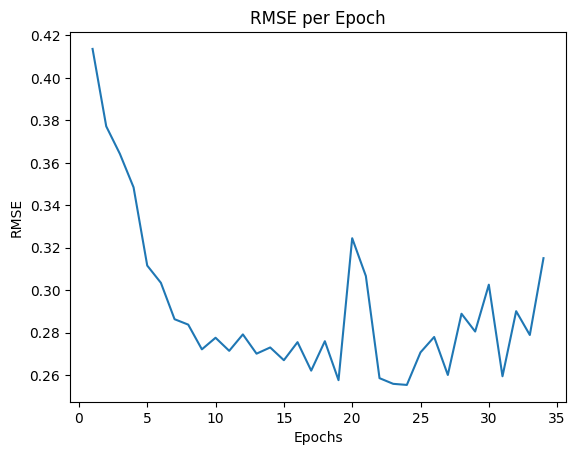

| 7         | -3.428    | 0.06878   | 46.37     | 0.2035    | 36.5      | 123.8     | 163.9     | 84.48     |
Epoch 1/47, RMSE: 0.4335
Epoch 2/47, RMSE: 0.3693
Epoch 3/47, RMSE: 0.3571
Epoch 4/47, RMSE: 0.3284
Epoch 5/47, RMSE: 0.3070
Epoch 6/47, RMSE: 0.2996
Epoch 7/47, RMSE: 0.3193
Epoch 8/47, RMSE: 0.3022
Epoch 9/47, RMSE: 0.2906
Epoch 10/47, RMSE: 0.2917
Epoch 11/47, RMSE: 0.2948
Epoch 12/47, RMSE: 0.3106
Epoch 13/47, RMSE: 0.3743
Epoch 14/47, RMSE: 0.3059
Epoch 15/47, RMSE: 0.3378
Epoch 16/47, RMSE: 0.3055
Epoch 17/47, RMSE: 0.3096
Epoch 18/47, RMSE: 0.3266
Epoch 19/47, RMSE: 0.3056
Early stopping at epoch 19


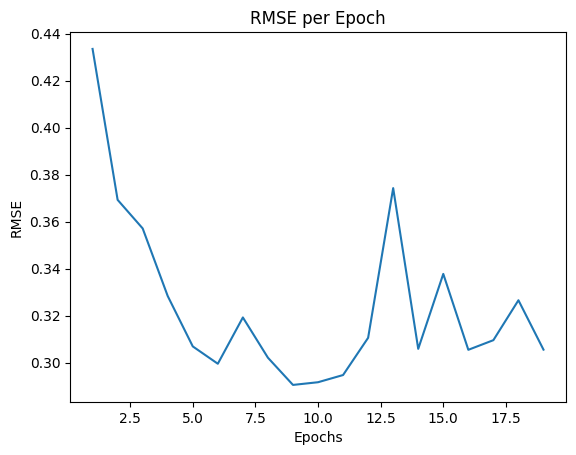

| 8         | -3.142    | 0.3697    | 48.78     | 0.4101    | 47.58     | 235.8     | 178.8     | 120.5     |
Epoch 1/23, RMSE: 0.7992
Epoch 2/23, RMSE: 0.4398
Epoch 3/23, RMSE: 0.3938
Epoch 4/23, RMSE: 0.3530
Epoch 5/23, RMSE: 0.3288
Epoch 6/23, RMSE: 0.3471
Epoch 7/23, RMSE: 0.3334
Epoch 8/23, RMSE: 0.3426
Epoch 9/23, RMSE: 0.3369
Epoch 10/23, RMSE: 0.3498
Epoch 11/23, RMSE: 0.3506
Epoch 12/23, RMSE: 0.3854
Epoch 13/23, RMSE: 0.3646
Epoch 14/23, RMSE: 0.3641
Epoch 15/23, RMSE: 0.3447
Early stopping at epoch 15


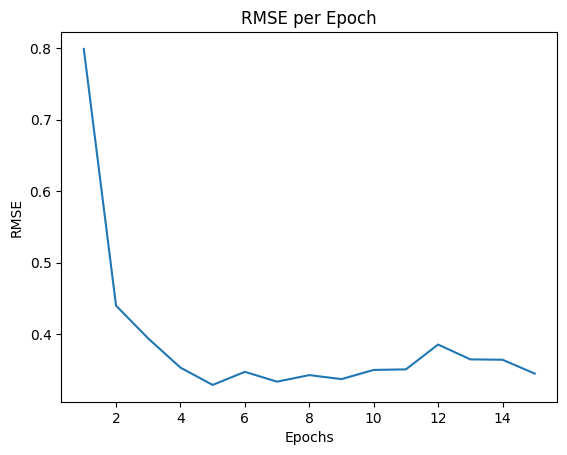

| 9         | -3.739    | 0.177     | 17.84     | 0.1181    | 23.01     | 138.6     | 116.1     | 111.6     |
Epoch 1/15, RMSE: 0.5612
Epoch 2/15, RMSE: 0.3690
Epoch 3/15, RMSE: 0.3728
Epoch 4/15, RMSE: 0.3431
Epoch 5/15, RMSE: 0.3398
Epoch 6/15, RMSE: 0.3314
Epoch 7/15, RMSE: 0.3275
Epoch 8/15, RMSE: 0.3277
Epoch 9/15, RMSE: 0.3590
Epoch 10/15, RMSE: 0.3661
Epoch 11/15, RMSE: 0.4125
Epoch 12/15, RMSE: 0.3795
Epoch 13/15, RMSE: 0.3691
Epoch 14/15, RMSE: 0.4159
Epoch 15/15, RMSE: 0.3961


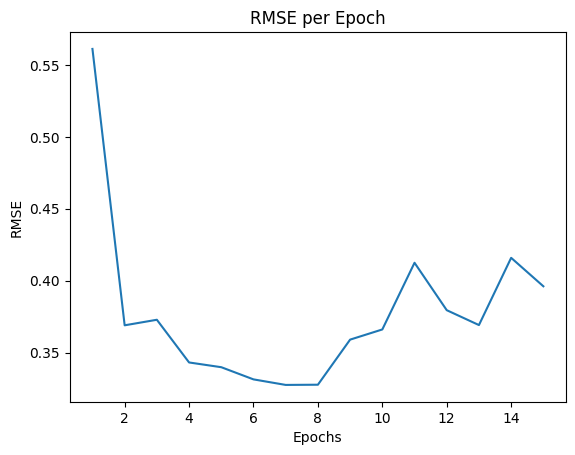

| 10        | -4.186    | 0.7135    | 21.24     | 0.3171    | 15.64     | 218.0     | 78.31     | 126.7     |
Epoch 1/35, RMSE: 0.3924
Epoch 2/35, RMSE: 0.3604
Epoch 3/35, RMSE: 0.3349
Epoch 4/35, RMSE: 0.3284
Epoch 5/35, RMSE: 0.3094
Epoch 6/35, RMSE: 0.2975
Epoch 7/35, RMSE: 0.2807
Epoch 8/35, RMSE: 0.2706
Epoch 9/35, RMSE: 0.2735
Epoch 10/35, RMSE: 0.2768
Epoch 11/35, RMSE: 0.2780
Epoch 12/35, RMSE: 0.2525
Epoch 13/35, RMSE: 0.2589
Epoch 14/35, RMSE: 0.2660
Epoch 15/35, RMSE: 0.2572
Epoch 16/35, RMSE: 0.2668
Epoch 17/35, RMSE: 0.2544
Epoch 18/35, RMSE: 0.2664
Epoch 19/35, RMSE: 0.2628
Epoch 20/35, RMSE: 0.2981
Epoch 21/35, RMSE: 0.2706
Epoch 22/35, RMSE: 0.2833
Early stopping at epoch 22


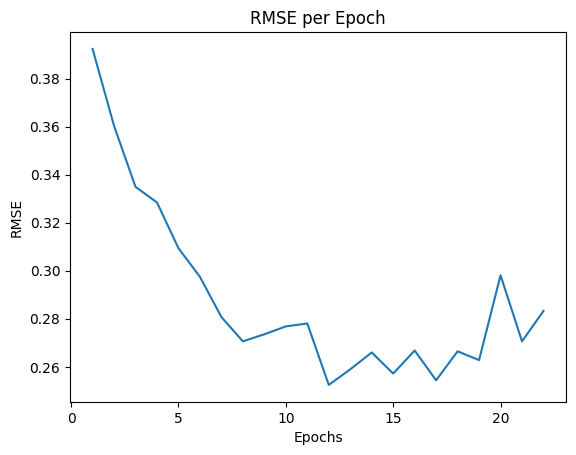

| 11        | -3.107    | 0.7627    | 50.0      | 0.3417    | 35.79     | 77.99     | 111.1     | 32.0      |
Epoch 1/40, RMSE: 0.3768
Epoch 2/40, RMSE: 0.3802
Epoch 3/40, RMSE: 0.3386
Epoch 4/40, RMSE: 0.3405
Epoch 5/40, RMSE: 0.3015
Epoch 6/40, RMSE: 0.2864
Epoch 7/40, RMSE: 0.2744
Epoch 8/40, RMSE: 0.2874
Epoch 9/40, RMSE: 0.2755
Epoch 10/40, RMSE: 0.2819
Epoch 11/40, RMSE: 0.2828
Epoch 12/40, RMSE: 0.2618
Epoch 13/40, RMSE: 0.2765
Epoch 14/40, RMSE: 0.2693
Epoch 15/40, RMSE: 0.2714
Epoch 16/40, RMSE: 0.2615
Epoch 17/40, RMSE: 0.3178
Epoch 18/40, RMSE: 0.3037
Epoch 19/40, RMSE: 0.2794
Epoch 20/40, RMSE: 0.3193
Epoch 21/40, RMSE: 0.2682
Epoch 22/40, RMSE: 0.2655
Epoch 23/40, RMSE: 0.2793
Epoch 24/40, RMSE: 0.2762
Epoch 25/40, RMSE: 0.3349
Epoch 26/40, RMSE: 0.2828
Early stopping at epoch 26


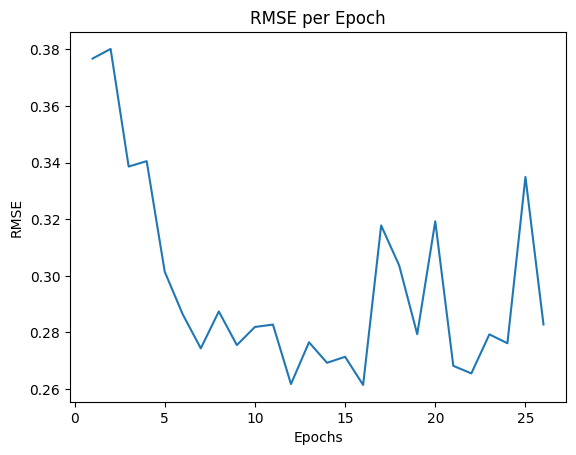

| 12        | -2.9      | 1.333     | 45.77     | 0.3375    | 40.07     | 124.8     | 164.3     | 80.4      |
Epoch 1/33, RMSE: 0.3742
Epoch 2/33, RMSE: 0.3679
Epoch 3/33, RMSE: 0.3383
Epoch 4/33, RMSE: 0.3316
Epoch 5/33, RMSE: 0.3197
Epoch 6/33, RMSE: 0.3077
Epoch 7/33, RMSE: 0.2881
Epoch 8/33, RMSE: 0.2744
Epoch 9/33, RMSE: 0.2870
Epoch 10/33, RMSE: 0.2875
Epoch 11/33, RMSE: 0.2898
Epoch 12/33, RMSE: 0.2736
Epoch 13/33, RMSE: 0.2923
Epoch 14/33, RMSE: 0.2848
Epoch 15/33, RMSE: 0.2641
Epoch 16/33, RMSE: 0.2607
Epoch 17/33, RMSE: 0.2641
Epoch 18/33, RMSE: 0.2587
Epoch 19/33, RMSE: 0.2738
Epoch 20/33, RMSE: 0.2569
Epoch 21/33, RMSE: 0.2675
Epoch 22/33, RMSE: 0.2943
Epoch 23/33, RMSE: 0.2651
Epoch 24/33, RMSE: 0.2748
Epoch 25/33, RMSE: 0.2899
Epoch 26/33, RMSE: 0.2551
Epoch 27/33, RMSE: 0.2716
Epoch 28/33, RMSE: 0.2548
Epoch 29/33, RMSE: 0.2760
Epoch 30/33, RMSE: 0.2504
Epoch 31/33, RMSE: 0.3083
Epoch 32/33, RMSE: 0.2792
Epoch 33/33, RMSE: 0.2833


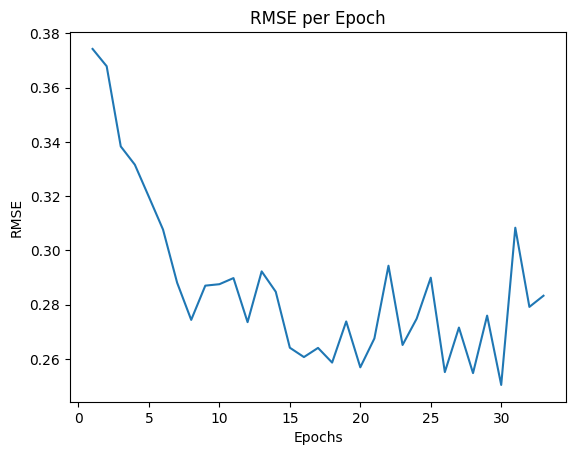

| 13        | -3.135    | 0.6465    | 45.74     | 0.1822    | 33.04     | 125.6     | 170.2     | 82.03     |
Epoch 1/31, RMSE: 0.3921
Epoch 2/31, RMSE: 0.3651
Epoch 3/31, RMSE: 0.3299
Epoch 4/31, RMSE: 0.3235
Epoch 5/31, RMSE: 0.3030
Epoch 6/31, RMSE: 0.2935
Epoch 7/31, RMSE: 0.2882
Epoch 8/31, RMSE: 0.2840
Epoch 9/31, RMSE: 0.2698
Epoch 10/31, RMSE: 0.2989
Epoch 11/31, RMSE: 0.3327
Epoch 12/31, RMSE: 0.2709
Epoch 13/31, RMSE: 0.2812
Epoch 14/31, RMSE: 0.3016
Epoch 15/31, RMSE: 0.2824
Epoch 16/31, RMSE: 0.2954
Epoch 17/31, RMSE: 0.3258
Epoch 18/31, RMSE: 0.2830
Epoch 19/31, RMSE: 0.2638
Epoch 20/31, RMSE: 0.3485
Epoch 21/31, RMSE: 0.2804
Epoch 22/31, RMSE: 0.2886
Epoch 23/31, RMSE: 0.3028
Epoch 24/31, RMSE: 0.3626
Epoch 25/31, RMSE: 0.3405
Epoch 26/31, RMSE: 0.2754
Epoch 27/31, RMSE: 0.3238
Epoch 28/31, RMSE: 0.2765
Epoch 29/31, RMSE: 0.3022
Early stopping at epoch 29


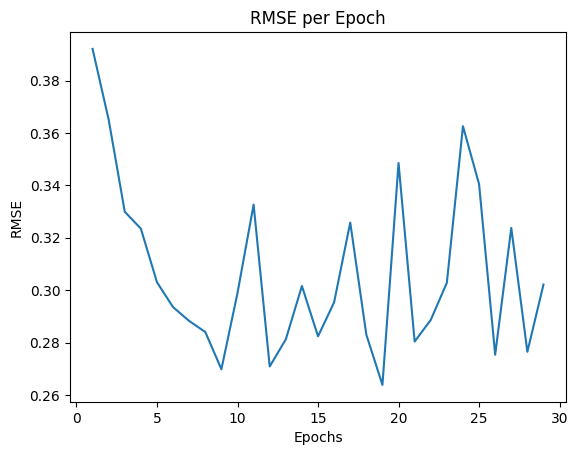

| 14        | -3.295    | 0.1207    | 44.23     | 0.4595    | 31.04     | 92.26     | 97.36     | 32.21     |
Epoch 1/44, RMSE: 0.4099
Epoch 2/44, RMSE: 0.3658
Epoch 3/44, RMSE: 0.3419
Epoch 4/44, RMSE: 0.3082
Epoch 5/44, RMSE: 0.2958
Epoch 6/44, RMSE: 0.3107
Epoch 7/44, RMSE: 0.2941
Epoch 8/44, RMSE: 0.3271
Epoch 9/44, RMSE: 0.3154
Epoch 10/44, RMSE: 0.3676
Epoch 11/44, RMSE: 0.4048
Epoch 12/44, RMSE: 0.4214
Epoch 13/44, RMSE: 0.3217
Epoch 14/44, RMSE: 0.2885
Epoch 15/44, RMSE: 0.3260
Epoch 16/44, RMSE: 0.3731
Epoch 17/44, RMSE: 0.3105
Epoch 18/44, RMSE: 0.2730
Epoch 19/44, RMSE: 0.3394
Epoch 20/44, RMSE: 0.3040
Epoch 21/44, RMSE: 0.2807
Epoch 22/44, RMSE: 0.3423
Epoch 23/44, RMSE: 0.3379
Epoch 24/44, RMSE: 0.3247
Epoch 25/44, RMSE: 0.3047
Epoch 26/44, RMSE: 0.2863
Epoch 27/44, RMSE: 0.2905
Epoch 28/44, RMSE: 0.2834
Early stopping at epoch 28


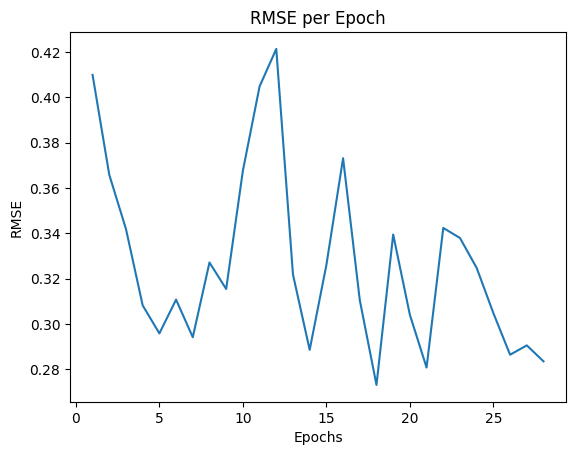

| 15        | -2.979    | 0.5669    | 41.55     | 0.4983    | 44.92     | 120.4     | 162.9     | 83.44     |
Epoch 1/36, RMSE: 0.4809
Epoch 2/36, RMSE: 0.4105
Epoch 3/36, RMSE: 0.3969
Epoch 4/36, RMSE: 0.4099
Epoch 5/36, RMSE: 0.4135
Epoch 6/36, RMSE: 0.4307
Epoch 7/36, RMSE: 0.4323
Epoch 8/36, RMSE: 0.4560
Epoch 9/36, RMSE: 0.4188
Epoch 10/36, RMSE: 0.4157
Epoch 11/36, RMSE: 0.4010
Epoch 12/36, RMSE: 0.3831
Epoch 13/36, RMSE: 0.3876
Epoch 14/36, RMSE: 0.3745
Epoch 15/36, RMSE: 0.3702
Epoch 16/36, RMSE: 0.3894
Epoch 17/36, RMSE: 0.3781
Epoch 18/36, RMSE: 0.3994
Epoch 19/36, RMSE: 0.3815
Epoch 20/36, RMSE: 0.3909
Epoch 21/36, RMSE: 0.4194
Epoch 22/36, RMSE: 0.4060
Epoch 23/36, RMSE: 0.4333
Epoch 24/36, RMSE: 0.4203
Epoch 25/36, RMSE: 0.4275
Early stopping at epoch 25


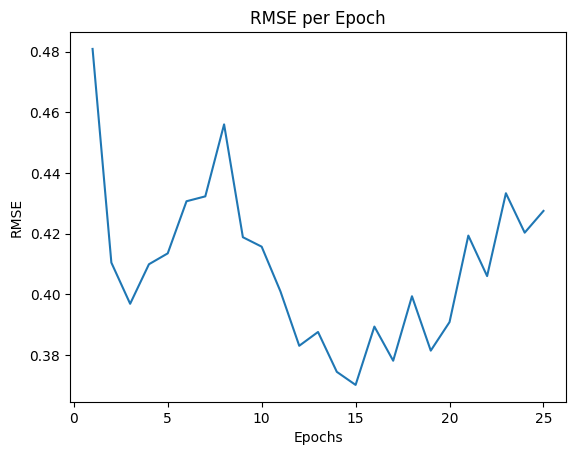

| 16        | -4.279    | 1.618     | 17.71     | 0.4403    | 36.04     | 191.3     | 73.83     | 72.2      |
Epoch 1/45, RMSE: 0.3731
Epoch 2/45, RMSE: 0.3567
Epoch 3/45, RMSE: 0.3337
Epoch 4/45, RMSE: 0.3112
Epoch 5/45, RMSE: 0.3123
Epoch 6/45, RMSE: 0.2933
Epoch 7/45, RMSE: 0.2812
Epoch 8/45, RMSE: 0.2853
Epoch 9/45, RMSE: 0.2806
Epoch 10/45, RMSE: 0.3013
Epoch 11/45, RMSE: 0.2787
Epoch 12/45, RMSE: 0.2843
Epoch 13/45, RMSE: 0.2805
Epoch 14/45, RMSE: 0.3015
Epoch 15/45, RMSE: 0.2908
Epoch 16/45, RMSE: 0.3396
Epoch 17/45, RMSE: 0.3167
Epoch 18/45, RMSE: 0.3290
Epoch 19/45, RMSE: 0.3321
Epoch 20/45, RMSE: 0.3180
Epoch 21/45, RMSE: 0.3102
Early stopping at epoch 21


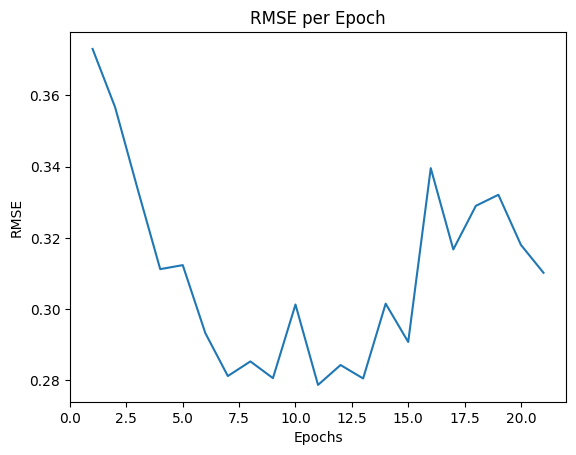

| 17        | -3.193    | 0.5005    | 41.93     | 0.3749    | 45.83     | 125.0     | 155.9     | 78.5      |
Epoch 1/45, RMSE: 0.3963
Epoch 2/45, RMSE: 0.3498
Epoch 3/45, RMSE: 0.3233
Epoch 4/45, RMSE: 0.3546
Epoch 5/45, RMSE: 0.3207
Epoch 6/45, RMSE: 0.3104
Epoch 7/45, RMSE: 0.2861
Epoch 8/45, RMSE: 0.2927
Epoch 9/45, RMSE: 0.2892
Epoch 10/45, RMSE: 0.2813
Epoch 11/45, RMSE: 0.2923
Epoch 12/45, RMSE: 0.2679
Epoch 13/45, RMSE: 0.2730
Epoch 14/45, RMSE: 0.2888
Epoch 15/45, RMSE: 0.3023
Epoch 16/45, RMSE: 0.3324
Epoch 17/45, RMSE: 0.2850
Epoch 18/45, RMSE: 0.2817
Epoch 19/45, RMSE: 0.2827
Epoch 20/45, RMSE: 0.2513
Epoch 21/45, RMSE: 0.3100
Epoch 22/45, RMSE: 0.3036
Epoch 23/45, RMSE: 0.3365
Epoch 24/45, RMSE: 0.3123
Epoch 25/45, RMSE: 0.3074
Epoch 26/45, RMSE: 0.2794
Epoch 27/45, RMSE: 0.3109
Epoch 28/45, RMSE: 0.2831
Epoch 29/45, RMSE: 0.3282
Epoch 30/45, RMSE: 0.2756
Early stopping at epoch 30


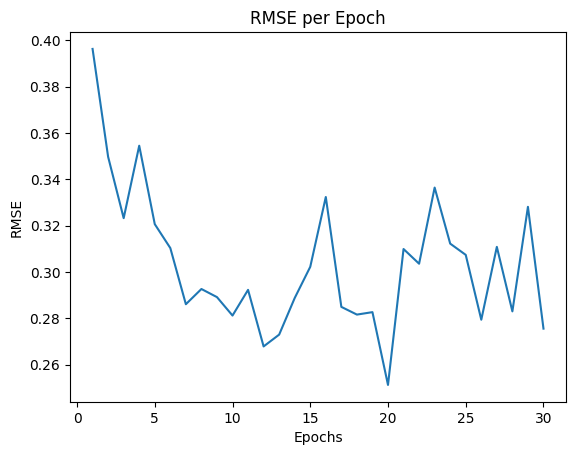

| 18        | -2.821    | 1.706     | 39.99     | 0.242     | 45.61     | 129.3     | 171.0     | 79.56     |
Epoch 1/27, RMSE: 0.3951
Epoch 2/27, RMSE: 0.3832
Epoch 3/27, RMSE: 0.3209
Epoch 4/27, RMSE: 0.3266
Epoch 5/27, RMSE: 0.3023
Epoch 6/27, RMSE: 0.2921
Epoch 7/27, RMSE: 0.2780
Epoch 8/27, RMSE: 0.3217
Epoch 9/27, RMSE: 0.2971
Epoch 10/27, RMSE: 0.3365
Epoch 11/27, RMSE: 0.2823
Epoch 12/27, RMSE: 0.3545
Epoch 13/27, RMSE: 0.3489
Epoch 14/27, RMSE: 0.2763
Epoch 15/27, RMSE: 0.3018
Epoch 16/27, RMSE: 0.3240
Epoch 17/27, RMSE: 0.3437
Epoch 18/27, RMSE: 0.3053
Epoch 19/27, RMSE: 0.2797
Epoch 20/27, RMSE: 0.3248
Epoch 21/27, RMSE: 0.2848
Epoch 22/27, RMSE: 0.2759
Epoch 23/27, RMSE: 0.3137
Epoch 24/27, RMSE: 0.2954
Epoch 25/27, RMSE: 0.2736
Epoch 26/27, RMSE: 0.2759
Epoch 27/27, RMSE: 0.2944


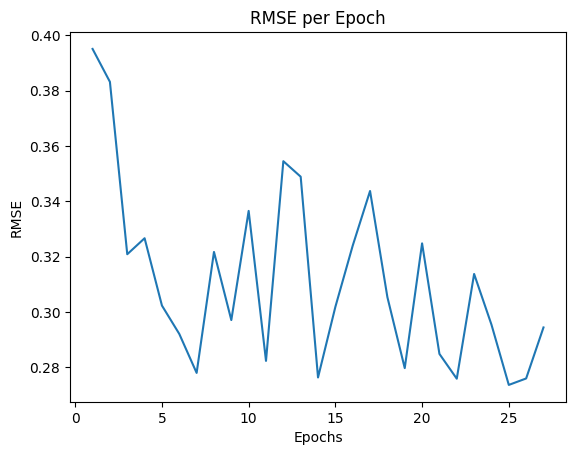

| 19        | -3.109    | 1.953     | 38.0      | 0.4612    | 27.79     | 142.3     | 110.2     | 49.19     |
Epoch 1/49, RMSE: 0.4630
Epoch 2/49, RMSE: 0.3681
Epoch 3/49, RMSE: 0.3418
Epoch 4/49, RMSE: 0.3404
Epoch 5/49, RMSE: 0.3382
Epoch 6/49, RMSE: 0.3294
Epoch 7/49, RMSE: 0.3175
Epoch 8/49, RMSE: 0.2934
Epoch 9/49, RMSE: 0.3116
Epoch 10/49, RMSE: 0.3490
Epoch 11/49, RMSE: 0.3353
Epoch 12/49, RMSE: 0.3649
Epoch 13/49, RMSE: 0.3756
Epoch 14/49, RMSE: 0.3592
Epoch 15/49, RMSE: 0.3701
Epoch 16/49, RMSE: 0.3595
Epoch 17/49, RMSE: 0.3840
Epoch 18/49, RMSE: 0.3889
Early stopping at epoch 18


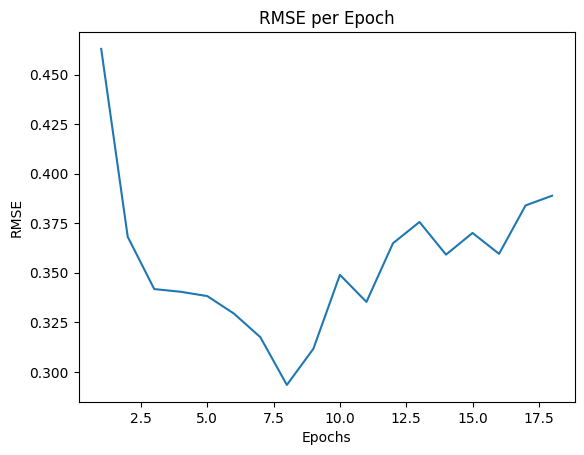

| 20        | -3.79     | 0.8566    | 23.09     | 0.307     | 49.26     | 67.23     | 235.0     | 81.87     |
Epoch 1/44, RMSE: 0.3899
Epoch 2/44, RMSE: 0.3825
Epoch 3/44, RMSE: 0.3650
Epoch 4/44, RMSE: 0.3545
Epoch 5/44, RMSE: 0.3076
Epoch 6/44, RMSE: 0.3089
Epoch 7/44, RMSE: 0.3053
Epoch 8/44, RMSE: 0.2934
Epoch 9/44, RMSE: 0.2904
Epoch 10/44, RMSE: 0.2862
Epoch 11/44, RMSE: 0.2884
Epoch 12/44, RMSE: 0.2884
Epoch 13/44, RMSE: 0.2751
Epoch 14/44, RMSE: 0.2740
Epoch 15/44, RMSE: 0.2877
Epoch 16/44, RMSE: 0.2772
Epoch 17/44, RMSE: 0.3025
Epoch 18/44, RMSE: 0.2580
Epoch 19/44, RMSE: 0.2726
Epoch 20/44, RMSE: 0.2794
Epoch 21/44, RMSE: 0.2851
Epoch 22/44, RMSE: 0.2767
Epoch 23/44, RMSE: 0.2695
Epoch 24/44, RMSE: 0.2792
Epoch 25/44, RMSE: 0.2610
Epoch 26/44, RMSE: 0.2627
Epoch 27/44, RMSE: 0.2614
Epoch 28/44, RMSE: 0.2651
Early stopping at epoch 28


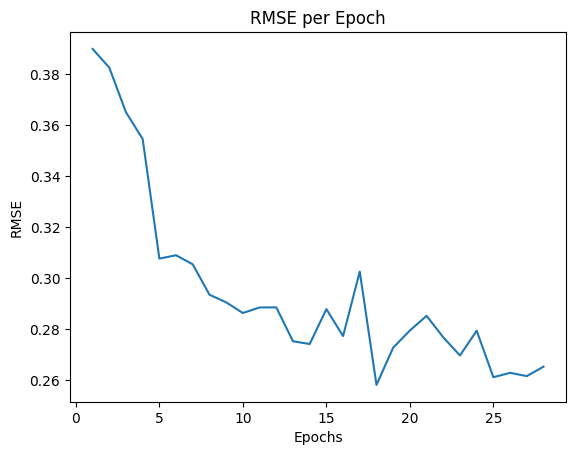

| 21        | -2.954    | 2.0       | 45.31     | 0.5       | 44.27     | 121.4     | 170.5     | 72.41     |
Epoch 1/11, RMSE: 0.3985
Epoch 2/11, RMSE: 0.3783
Epoch 3/11, RMSE: 0.3841
Epoch 4/11, RMSE: 0.3639
Epoch 5/11, RMSE: 0.2965
Epoch 6/11, RMSE: 0.3222
Epoch 7/11, RMSE: 0.2888
Epoch 8/11, RMSE: 0.2874
Epoch 9/11, RMSE: 0.2983
Epoch 10/11, RMSE: 0.3046
Epoch 11/11, RMSE: 0.2825


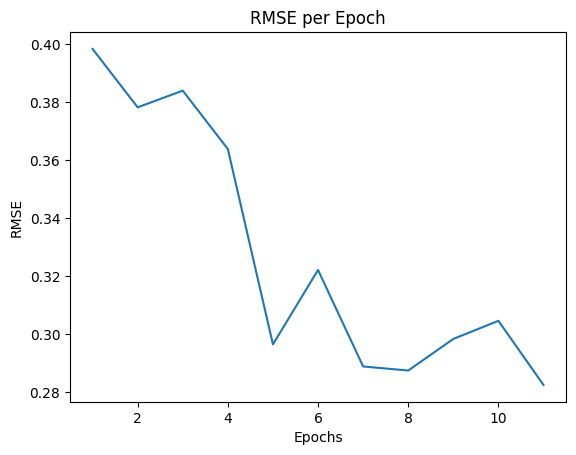

| 22        | -2.85     | 1.555     | 38.57     | 0.3394    | 11.04     | 148.9     | 173.3     | 96.87     |
Epoch 1/28, RMSE: 0.3988
Epoch 2/28, RMSE: 0.4599
Epoch 3/28, RMSE: 0.3584
Epoch 4/28, RMSE: 0.3816
Epoch 5/28, RMSE: 0.3478
Epoch 6/28, RMSE: 0.3522
Epoch 7/28, RMSE: 0.3191
Epoch 8/28, RMSE: 0.3137
Epoch 9/28, RMSE: 0.3013
Epoch 10/28, RMSE: 0.2858
Epoch 11/28, RMSE: 0.2920
Epoch 12/28, RMSE: 0.2878
Epoch 13/28, RMSE: 0.2766
Epoch 14/28, RMSE: 0.2676
Epoch 15/28, RMSE: 0.2865
Epoch 16/28, RMSE: 0.2722
Epoch 17/28, RMSE: 0.2662
Epoch 18/28, RMSE: 0.2587
Epoch 19/28, RMSE: 0.2657
Epoch 20/28, RMSE: 0.2565
Epoch 21/28, RMSE: 0.2762
Epoch 22/28, RMSE: 0.2727
Epoch 23/28, RMSE: 0.2760
Epoch 24/28, RMSE: 0.2776
Epoch 25/28, RMSE: 0.2719
Epoch 26/28, RMSE: 0.2640
Epoch 27/28, RMSE: 0.2601
Epoch 28/28, RMSE: 0.2858


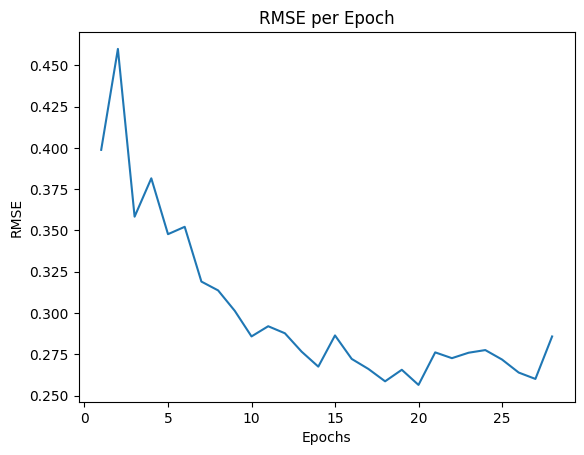

| 23        | -2.867    | 0.6746    | 48.63     | 0.1378    | 28.86     | 250.8     | 175.9     | 107.1     |
Epoch 1/20, RMSE: 0.4188
Epoch 2/20, RMSE: 0.3840
Epoch 3/20, RMSE: 0.3303
Epoch 4/20, RMSE: 0.3253
Epoch 5/20, RMSE: 0.3082
Epoch 6/20, RMSE: 0.3053
Epoch 7/20, RMSE: 0.2933
Epoch 8/20, RMSE: 0.2858
Epoch 9/20, RMSE: 0.2663
Epoch 10/20, RMSE: 0.2707
Epoch 11/20, RMSE: 0.2886
Epoch 12/20, RMSE: 0.2730
Epoch 13/20, RMSE: 0.2815
Epoch 14/20, RMSE: 0.2697
Epoch 15/20, RMSE: 0.2676
Epoch 16/20, RMSE: 0.2787
Epoch 17/20, RMSE: 0.2876
Epoch 18/20, RMSE: 0.2704
Epoch 19/20, RMSE: 0.2669
Early stopping at epoch 19


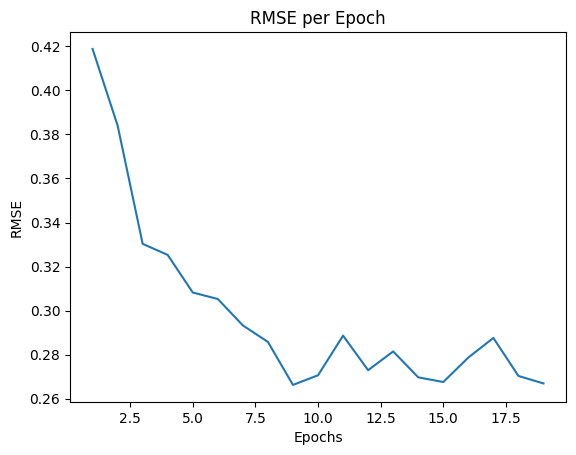

| 24        | -2.883    | 2.0       | 38.31     | 0.4785    | 20.96     | 145.4     | 176.9     | 87.19     |
Epoch 1/37, RMSE: 0.4164
Epoch 2/37, RMSE: 0.4053
Epoch 3/37, RMSE: 0.3454
Epoch 4/37, RMSE: 0.3223
Epoch 5/37, RMSE: 0.3080
Epoch 6/37, RMSE: 0.2923
Epoch 7/37, RMSE: 0.2906
Epoch 8/37, RMSE: 0.2836
Epoch 9/37, RMSE: 0.2927
Epoch 10/37, RMSE: 0.2778
Epoch 11/37, RMSE: 0.2637
Epoch 12/37, RMSE: 0.2606
Epoch 13/37, RMSE: 0.2796
Epoch 14/37, RMSE: 0.2750
Epoch 15/37, RMSE: 0.2705
Epoch 16/37, RMSE: 0.2699
Epoch 17/37, RMSE: 0.2678
Epoch 18/37, RMSE: 0.2609
Epoch 19/37, RMSE: 0.2592
Epoch 20/37, RMSE: 0.2630
Epoch 21/37, RMSE: 0.2739
Epoch 22/37, RMSE: 0.2673
Epoch 23/37, RMSE: 0.2640
Epoch 24/37, RMSE: 0.2550
Epoch 25/37, RMSE: 0.2729
Epoch 26/37, RMSE: 0.2587
Epoch 27/37, RMSE: 0.2629
Epoch 28/37, RMSE: 0.2567
Epoch 29/37, RMSE: 0.2573
Epoch 30/37, RMSE: 0.2602
Epoch 31/37, RMSE: 0.2527
Epoch 32/37, RMSE: 0.2526
Epoch 33/37, RMSE: 0.2577
Epoch 34/37, RMSE: 0.2580
Epoch 35/37, RM

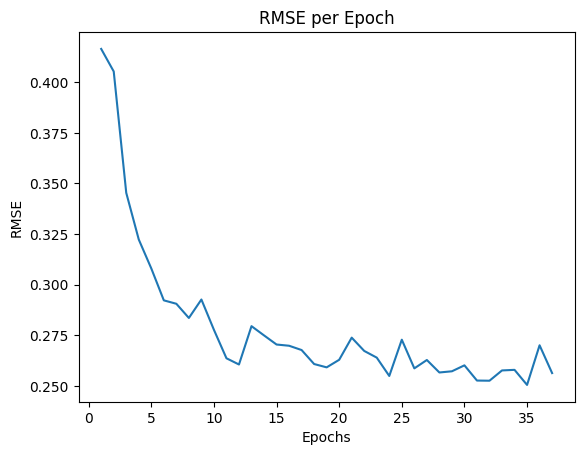

| 25        | -2.923    | 2.0       | 46.43     | 0.5       | 37.61     | 137.7     | 169.9     | 72.09     |
Epoch 1/37, RMSE: 0.3913
Epoch 2/37, RMSE: 0.3816
Epoch 3/37, RMSE: 0.3698
Epoch 4/37, RMSE: 0.3131
Epoch 5/37, RMSE: 0.3374
Epoch 6/37, RMSE: 0.3015
Epoch 7/37, RMSE: 0.3216
Epoch 8/37, RMSE: 0.3052
Epoch 9/37, RMSE: 0.2884
Epoch 10/37, RMSE: 0.2760
Epoch 11/37, RMSE: 0.2817
Epoch 12/37, RMSE: 0.2779
Epoch 13/37, RMSE: 0.2826
Epoch 14/37, RMSE: 0.2782
Epoch 15/37, RMSE: 0.2763
Epoch 16/37, RMSE: 0.2861
Epoch 17/37, RMSE: 0.2734
Epoch 18/37, RMSE: 0.2772
Epoch 19/37, RMSE: 0.2992
Epoch 20/37, RMSE: 0.2768
Epoch 21/37, RMSE: 0.3246
Epoch 22/37, RMSE: 0.2552
Epoch 23/37, RMSE: 0.2772
Epoch 24/37, RMSE: 0.3082
Epoch 25/37, RMSE: 0.3138
Epoch 26/37, RMSE: 0.3301
Epoch 27/37, RMSE: 0.2863
Epoch 28/37, RMSE: 0.3189
Epoch 29/37, RMSE: 0.2895
Epoch 30/37, RMSE: 0.3052
Epoch 31/37, RMSE: 0.2588
Epoch 32/37, RMSE: 0.2785
Early stopping at epoch 32


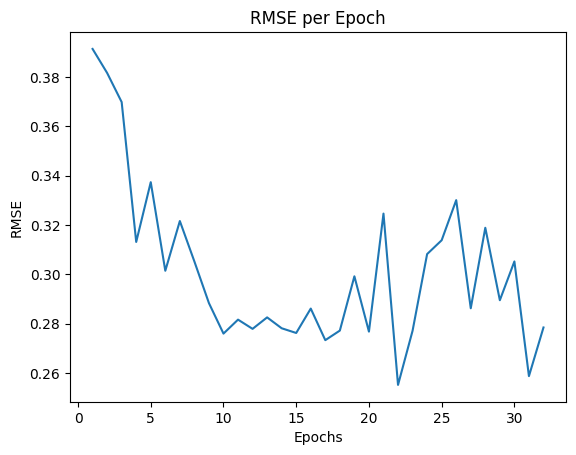

| 26        | -2.921    | 1.877     | 41.63     | 0.2017    | 37.8      | 106.4     | 188.5     | 102.7     |
Epoch 1/20, RMSE: 0.4249
Epoch 2/20, RMSE: 0.3842
Epoch 3/20, RMSE: 0.3635
Epoch 4/20, RMSE: 0.3584
Epoch 5/20, RMSE: 0.3510
Epoch 6/20, RMSE: 0.3012
Epoch 7/20, RMSE: 0.3046
Epoch 8/20, RMSE: 0.2998
Epoch 9/20, RMSE: 0.3445
Epoch 10/20, RMSE: 0.3197
Epoch 11/20, RMSE: 0.3188
Epoch 12/20, RMSE: 0.3541
Epoch 13/20, RMSE: 0.3858
Epoch 14/20, RMSE: 0.3524
Epoch 15/20, RMSE: 0.3799
Epoch 16/20, RMSE: 0.3648
Epoch 17/20, RMSE: 0.3827
Epoch 18/20, RMSE: 0.2976
Epoch 19/20, RMSE: 0.3500
Epoch 20/20, RMSE: 0.3322


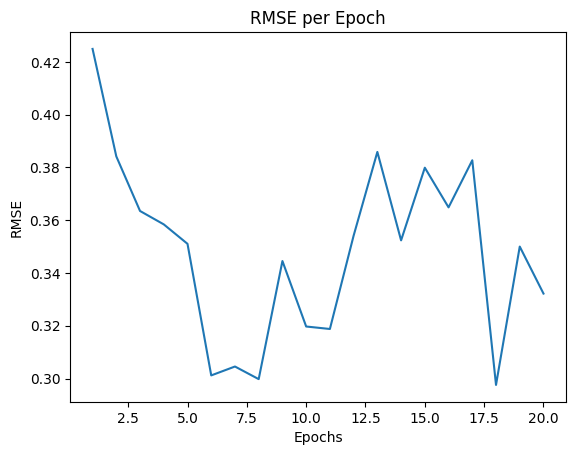

| 27        | -3.261    | 1.346     | 29.87     | 0.3214    | 20.78     | 144.8     | 111.0     | 127.2     |
Epoch 1/28, RMSE: 0.4184
Epoch 2/28, RMSE: 0.3970
Epoch 3/28, RMSE: 0.3707
Epoch 4/28, RMSE: 0.3539
Epoch 5/28, RMSE: 0.3167
Epoch 6/28, RMSE: 0.3056
Epoch 7/28, RMSE: 0.2878
Epoch 8/28, RMSE: 0.3033
Epoch 9/28, RMSE: 0.2756
Epoch 10/28, RMSE: 0.2818
Epoch 11/28, RMSE: 0.2791
Epoch 12/28, RMSE: 0.2748
Epoch 13/28, RMSE: 0.2777
Epoch 14/28, RMSE: 0.2681
Epoch 15/28, RMSE: 0.2925
Epoch 16/28, RMSE: 0.3094
Epoch 17/28, RMSE: 0.3155
Epoch 18/28, RMSE: 0.2545
Epoch 19/28, RMSE: 0.2750
Epoch 20/28, RMSE: 0.3123
Epoch 21/28, RMSE: 0.2770
Epoch 22/28, RMSE: 0.2724
Epoch 23/28, RMSE: 0.2880
Epoch 24/28, RMSE: 0.2974
Epoch 25/28, RMSE: 0.2950
Epoch 26/28, RMSE: 0.2851
Epoch 27/28, RMSE: 0.2960
Epoch 28/28, RMSE: 0.2714
Early stopping at epoch 28


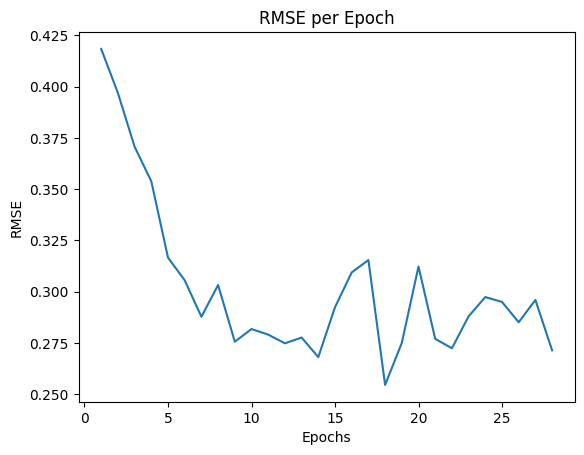

| 28        | -2.934    | 1.064     | 39.84     | 0.3058    | 28.08     | 172.5     | 142.1     | 33.04     |
Epoch 1/21, RMSE: 0.4994
Epoch 2/21, RMSE: 0.4541
Epoch 3/21, RMSE: 0.3719
Epoch 4/21, RMSE: 0.3515
Epoch 5/21, RMSE: 0.3151
Epoch 6/21, RMSE: 0.3230
Epoch 7/21, RMSE: 0.2808
Epoch 8/21, RMSE: 0.2923
Epoch 9/21, RMSE: 0.3103
Epoch 10/21, RMSE: 0.2973
Epoch 11/21, RMSE: 0.2841
Epoch 12/21, RMSE: 0.2916
Epoch 13/21, RMSE: 0.2847
Epoch 14/21, RMSE: 0.3521
Epoch 15/21, RMSE: 0.3260
Epoch 16/21, RMSE: 0.3036
Epoch 17/21, RMSE: 0.3185
Early stopping at epoch 17


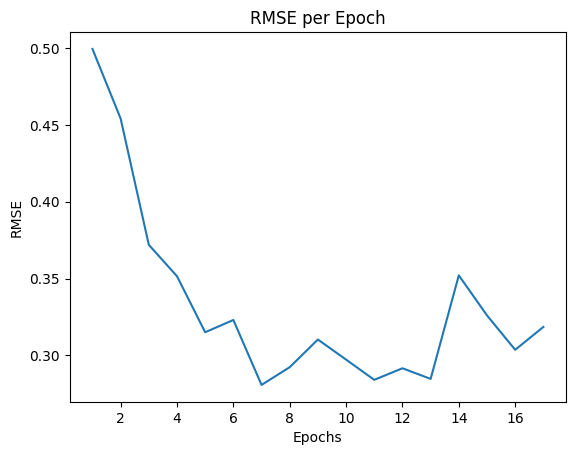

| 29        | -3.289    | 1.676     | 33.71     | 0.2496    | 21.14     | 253.3     | 144.2     | 104.4     |
Epoch 1/34, RMSE: 0.4006
Epoch 2/34, RMSE: 0.3934
Epoch 3/34, RMSE: 0.3573
Epoch 4/34, RMSE: 0.3106
Epoch 5/34, RMSE: 0.3216
Epoch 6/34, RMSE: 0.3035
Epoch 7/34, RMSE: 0.2897
Epoch 8/34, RMSE: 0.2819
Epoch 9/34, RMSE: 0.2949
Epoch 10/34, RMSE: 0.2936
Epoch 11/34, RMSE: 0.2959
Epoch 12/34, RMSE: 0.2590
Epoch 13/34, RMSE: 0.2676
Epoch 14/34, RMSE: 0.2623
Epoch 15/34, RMSE: 0.2841
Epoch 16/34, RMSE: 0.2860
Epoch 17/34, RMSE: 0.2826
Epoch 18/34, RMSE: 0.2933
Epoch 19/34, RMSE: 0.2763
Epoch 20/34, RMSE: 0.2860
Epoch 21/34, RMSE: 0.2926
Epoch 22/34, RMSE: 0.2862
Early stopping at epoch 22


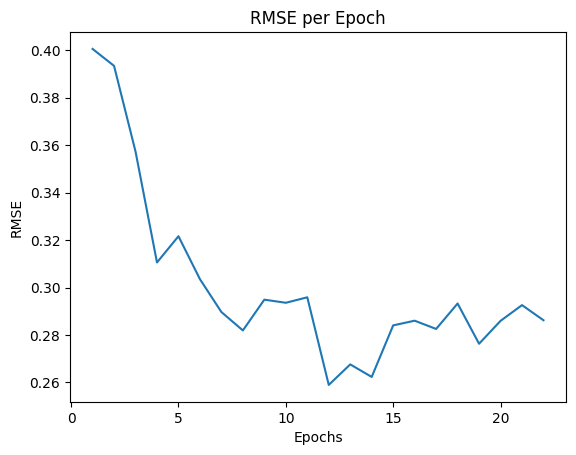

| 30        | -3.002    | 0.6581    | 38.94     | 0.2372    | 34.37     | 206.5     | 68.4      | 50.93     |
Epoch 1/31, RMSE: 0.4062
Epoch 2/31, RMSE: 0.3881
Epoch 3/31, RMSE: 0.3577
Epoch 4/31, RMSE: 0.3310
Epoch 5/31, RMSE: 0.3291
Epoch 6/31, RMSE: 0.3340
Epoch 7/31, RMSE: 0.3066
Epoch 8/31, RMSE: 0.3164
Epoch 9/31, RMSE: 0.3008
Epoch 10/31, RMSE: 0.2937
Epoch 11/31, RMSE: 0.3359
Epoch 12/31, RMSE: 0.3869
Epoch 13/31, RMSE: 0.3726
Epoch 14/31, RMSE: 0.2921
Epoch 15/31, RMSE: 0.3421
Epoch 16/31, RMSE: 0.3159
Epoch 17/31, RMSE: 0.3456
Epoch 18/31, RMSE: 0.3270
Epoch 19/31, RMSE: 0.3552
Epoch 20/31, RMSE: 0.3234
Epoch 21/31, RMSE: 0.3147
Epoch 22/31, RMSE: 0.3010
Epoch 23/31, RMSE: 0.3448
Epoch 24/31, RMSE: 0.3153
Early stopping at epoch 24


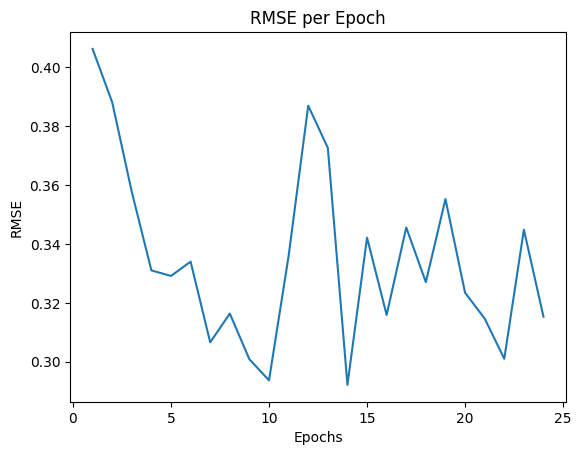

| 31        | -3.231    | 0.8071    | 36.67     | 0.4988    | 31.79     | 102.8     | 215.0     | 62.49     |
Epoch 1/24, RMSE: 0.5776
Epoch 2/24, RMSE: 0.4100
Epoch 3/24, RMSE: 0.3486
Epoch 4/24, RMSE: 0.3757
Epoch 5/24, RMSE: 0.3668
Epoch 6/24, RMSE: 0.3630
Epoch 7/24, RMSE: 0.3550
Epoch 8/24, RMSE: 0.3399
Epoch 9/24, RMSE: 0.3445
Epoch 10/24, RMSE: 0.3585
Epoch 11/24, RMSE: 0.3882
Epoch 12/24, RMSE: 0.3983
Epoch 13/24, RMSE: 0.4255
Epoch 14/24, RMSE: 0.4129
Epoch 15/24, RMSE: 0.4128
Epoch 16/24, RMSE: 0.3621
Epoch 17/24, RMSE: 0.3558
Epoch 18/24, RMSE: 0.3647
Early stopping at epoch 18


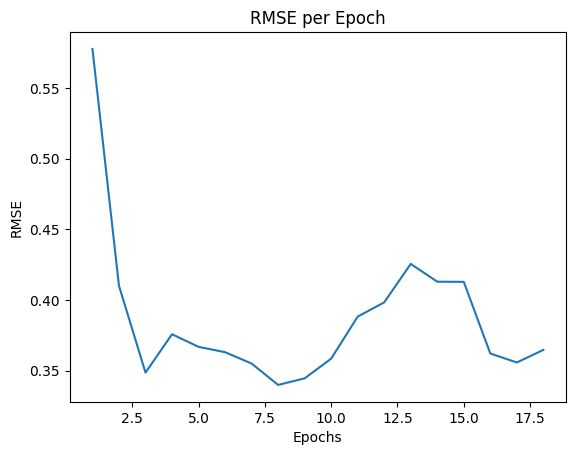

| 32        | -3.791    | 1.185     | 18.74     | 0.2365    | 24.72     | 149.4     | 255.2     | 87.54     |
Epoch 1/12, RMSE: 0.3718
Epoch 2/12, RMSE: 0.3571
Epoch 3/12, RMSE: 0.3861
Epoch 4/12, RMSE: 0.3452
Epoch 5/12, RMSE: 0.3481
Epoch 6/12, RMSE: 0.3154
Epoch 7/12, RMSE: 0.3128
Epoch 8/12, RMSE: 0.3378
Epoch 9/12, RMSE: 0.3203
Epoch 10/12, RMSE: 0.3083
Epoch 11/12, RMSE: 0.2747
Epoch 12/12, RMSE: 0.3172


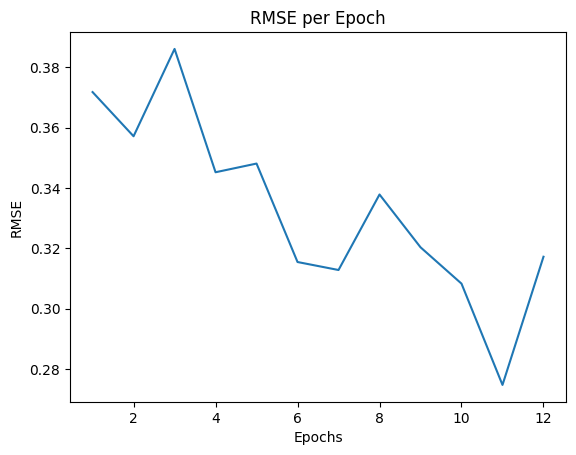

| 33        | -2.883    | 0.1255    | 49.38     | 0.1923    | 12.93     | 254.3     | 232.5     | 117.0     |
Epoch 1/10, RMSE: 0.4077
Epoch 2/10, RMSE: 0.4268
Epoch 3/10, RMSE: 0.3648
Epoch 4/10, RMSE: 0.3542
Epoch 5/10, RMSE: 0.3219
Epoch 6/10, RMSE: 0.3170
Epoch 7/10, RMSE: 0.2956
Epoch 8/10, RMSE: 0.3240
Epoch 9/10, RMSE: 0.2853
Epoch 10/10, RMSE: 0.2786


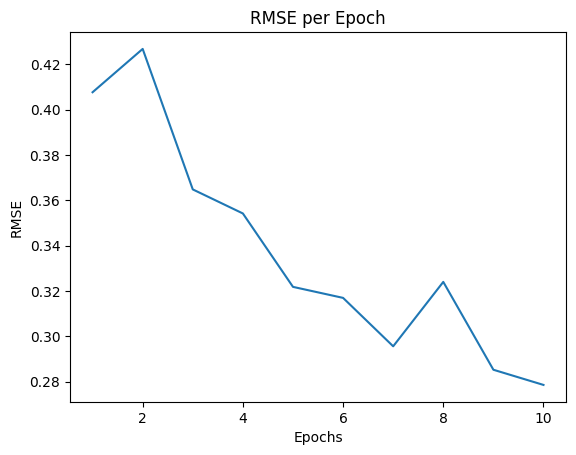

| 34        | -2.924    | 1.152     | 31.05     | 0.2923    | 10.46     | 157.0     | 160.7     | 34.85     |
Epoch 1/16, RMSE: 0.4021
Epoch 2/16, RMSE: 0.3699
Epoch 3/16, RMSE: 0.3439
Epoch 4/16, RMSE: 0.3236
Epoch 5/16, RMSE: 0.3197
Epoch 6/16, RMSE: 0.2948
Epoch 7/16, RMSE: 0.2750
Epoch 8/16, RMSE: 0.2747
Epoch 9/16, RMSE: 0.2875
Epoch 10/16, RMSE: 0.2702
Epoch 11/16, RMSE: 0.2718
Epoch 12/16, RMSE: 0.2629
Epoch 13/16, RMSE: 0.2618
Epoch 14/16, RMSE: 0.2558
Epoch 15/16, RMSE: 0.2628
Epoch 16/16, RMSE: 0.2561


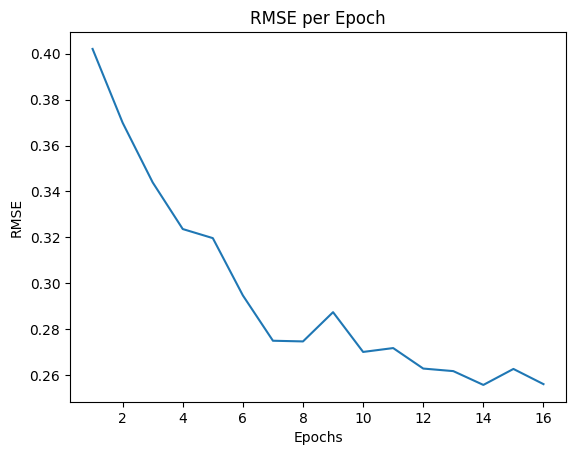

| 35        | -2.836    | 1.611     | 49.58     | 0.1759    | 16.23     | 123.9     | 142.3     | 70.46     |
Epoch 1/44, RMSE: 0.4234
Epoch 2/44, RMSE: 0.3534
Epoch 3/44, RMSE: 0.3457
Epoch 4/44, RMSE: 0.3017
Epoch 5/44, RMSE: 0.2982
Epoch 6/44, RMSE: 0.2876
Epoch 7/44, RMSE: 0.2993
Epoch 8/44, RMSE: 0.2860
Epoch 9/44, RMSE: 0.3107
Epoch 10/44, RMSE: 0.3097
Epoch 11/44, RMSE: 0.3144
Epoch 12/44, RMSE: 0.2986
Epoch 13/44, RMSE: 0.3075
Epoch 14/44, RMSE: 0.3049
Epoch 15/44, RMSE: 0.3118
Epoch 16/44, RMSE: 0.3212
Epoch 17/44, RMSE: 0.3069
Epoch 18/44, RMSE: 0.3478
Early stopping at epoch 18


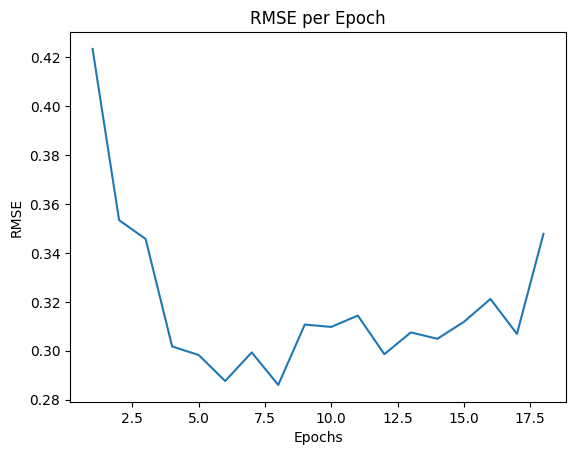

| 36        | -3.462    | 1.868     | 37.54     | 0.3662    | 44.25     | 126.8     | 64.34     | 94.14     |
Epoch 1/28, RMSE: 0.4455
Epoch 2/28, RMSE: 0.3597
Epoch 3/28, RMSE: 0.3427
Epoch 4/28, RMSE: 0.3338
Epoch 5/28, RMSE: 0.3070
Epoch 6/28, RMSE: 0.3123
Epoch 7/28, RMSE: 0.3111
Epoch 8/28, RMSE: 0.3304
Epoch 9/28, RMSE: 0.3053
Epoch 10/28, RMSE: 0.3809
Epoch 11/28, RMSE: 0.3557
Epoch 12/28, RMSE: 0.3780
Epoch 13/28, RMSE: 0.3755
Epoch 14/28, RMSE: 0.3820
Epoch 15/28, RMSE: 0.3647
Epoch 16/28, RMSE: 0.3328
Epoch 17/28, RMSE: 0.3300
Epoch 18/28, RMSE: 0.3540
Epoch 19/28, RMSE: 0.3325
Early stopping at epoch 19


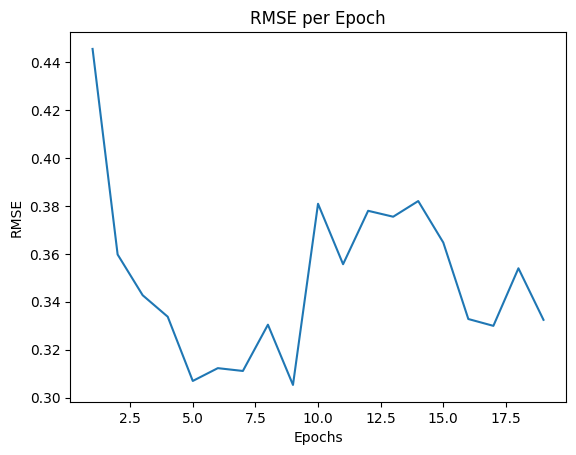

| 37        | -3.14     | 0.4472    | 26.64     | 0.3744    | 28.88     | 167.4     | 100.3     | 107.6     |
Epoch 1/20, RMSE: 0.5071
Epoch 2/20, RMSE: 0.3787
Epoch 3/20, RMSE: 0.3331
Epoch 4/20, RMSE: 0.4056
Epoch 5/20, RMSE: 0.3202
Epoch 6/20, RMSE: 0.3025
Epoch 7/20, RMSE: 0.3058
Epoch 8/20, RMSE: 0.2685
Epoch 9/20, RMSE: 0.2867
Epoch 10/20, RMSE: 0.2714
Epoch 11/20, RMSE: 0.2701
Epoch 12/20, RMSE: 0.3530
Epoch 13/20, RMSE: 0.3078
Epoch 14/20, RMSE: 0.2816
Epoch 15/20, RMSE: 0.2926
Epoch 16/20, RMSE: 0.3075
Epoch 17/20, RMSE: 0.3116
Epoch 18/20, RMSE: 0.3492
Early stopping at epoch 18


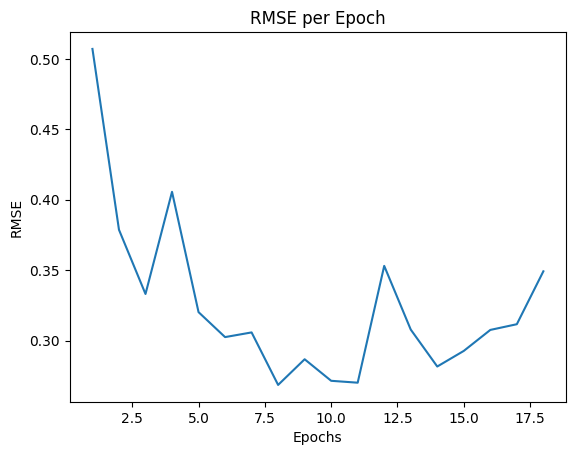

| 38        | -3.688    | 1.056     | 42.5      | 0.4639    | 20.03     | 209.8     | 235.3     | 48.04     |
Epoch 1/35, RMSE: 0.4165
Epoch 2/35, RMSE: 0.3782
Epoch 3/35, RMSE: 0.3594
Epoch 4/35, RMSE: 0.3300
Epoch 5/35, RMSE: 0.2988
Epoch 6/35, RMSE: 0.3063
Epoch 7/35, RMSE: 0.2878
Epoch 8/35, RMSE: 0.2762
Epoch 9/35, RMSE: 0.2919
Epoch 10/35, RMSE: 0.2814
Epoch 11/35, RMSE: 0.2781
Epoch 12/35, RMSE: 0.2660
Epoch 13/35, RMSE: 0.2863
Epoch 14/35, RMSE: 0.2941
Epoch 15/35, RMSE: 0.2664
Epoch 16/35, RMSE: 0.2648
Epoch 17/35, RMSE: 0.2630
Epoch 18/35, RMSE: 0.2810
Epoch 19/35, RMSE: 0.2824
Epoch 20/35, RMSE: 0.2602
Epoch 21/35, RMSE: 0.2701
Epoch 22/35, RMSE: 0.2596
Epoch 23/35, RMSE: 0.2603
Epoch 24/35, RMSE: 0.2597
Epoch 25/35, RMSE: 0.2552
Epoch 26/35, RMSE: 0.2589
Epoch 27/35, RMSE: 0.2621
Epoch 28/35, RMSE: 0.2513
Epoch 29/35, RMSE: 0.2596
Epoch 30/35, RMSE: 0.2592
Epoch 31/35, RMSE: 0.2566
Epoch 32/35, RMSE: 0.2475
Epoch 33/35, RMSE: 0.2716
Epoch 34/35, RMSE: 0.2622
Epoch 35/35, RM

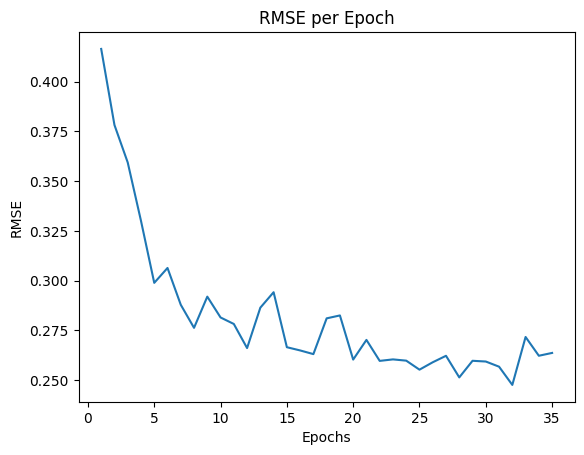

| 39        | -3.028    | 2.0       | 34.48     | 0.5       | 35.42     | 128.6     | 168.0     | 72.06     |
Epoch 1/28, RMSE: 0.3982
Epoch 2/28, RMSE: 0.3595
Epoch 3/28, RMSE: 0.3532
Epoch 4/28, RMSE: 0.3255
Epoch 5/28, RMSE: 0.3191
Epoch 6/28, RMSE: 0.3192
Epoch 7/28, RMSE: 0.3055
Epoch 8/28, RMSE: 0.3332
Epoch 9/28, RMSE: 0.3010
Epoch 10/28, RMSE: 0.4056
Epoch 11/28, RMSE: 0.3252
Epoch 12/28, RMSE: 0.4134
Epoch 13/28, RMSE: 0.3018
Epoch 14/28, RMSE: 0.3392
Epoch 15/28, RMSE: 0.3400
Epoch 16/28, RMSE: 0.3777
Epoch 17/28, RMSE: 0.3666
Epoch 18/28, RMSE: 0.3725
Epoch 19/28, RMSE: 0.3184
Early stopping at epoch 19


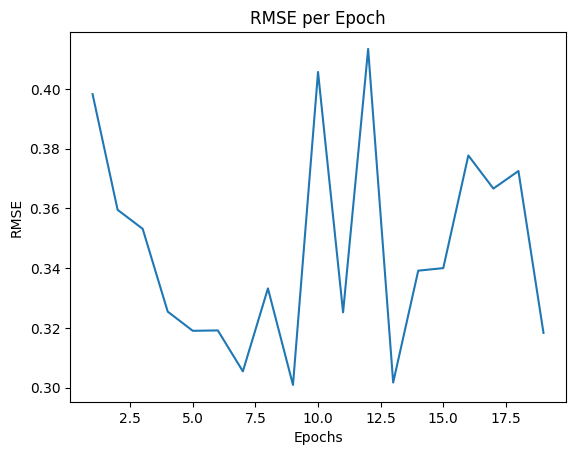

| 40        | -3.227    | 1.326     | 35.72     | 0.4697    | 28.14     | 190.1     | 144.5     | 113.3     |
Mejores hiperparámetros: Epochs=45, Batch size=39, Dropout=0.24200619449303562, Hidden Dims=[129, 171, 79], Activation=ReLU()
Epoch 1/45, RMSE: 0.4431
Epoch 2/45, RMSE: 0.3969
Epoch 3/45, RMSE: 0.3468
Epoch 4/45, RMSE: 0.3315
Epoch 5/45, RMSE: 0.3227
Epoch 6/45, RMSE: 0.3150
Epoch 7/45, RMSE: 0.2994
Epoch 8/45, RMSE: 0.2879
Epoch 9/45, RMSE: 0.2996
Epoch 10/45, RMSE: 0.2920
Epoch 11/45, RMSE: 0.2828
Epoch 12/45, RMSE: 0.2906
Epoch 13/45, RMSE: 0.2944
Epoch 14/45, RMSE: 0.2781
Epoch 15/45, RMSE: 0.2821
Epoch 16/45, RMSE: 0.2810
Epoch 17/45, RMSE: 0.2767
Epoch 18/45, RMSE: 0.2933
Epoch 19/45, RMSE: 0.3065
Epoch 20/45, RMSE: 0.2889
Epoch 21/45, RMSE: 0.2941
Epoch 22/45, RMSE: 0.2967
Epoch 23/45, RMSE: 0.2784
Epoch 24/45, RMSE: 0.3070
Epoch 25/45, RMSE: 0.3267
Epoch 26/45, RMSE: 0.2964
Epoch 27/45, RMSE: 0.3184
Early stopping at epoch 27


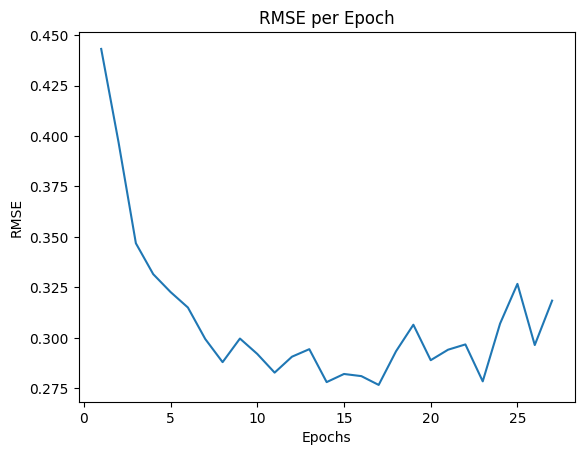

In [237]:
# Definir la clase del modelo ANN con más capas y Dropout
class ANNModel(nn.Module):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU()):
        super(ANNModel, self).__init__()
        self.hidden_layers = nn.ModuleList()
        self.dropout = nn.Dropout(dropout_prob)
        self.activation_fn = activation_fn
        
        # Primera capa
        self.hidden_layers.append(nn.Linear(input_dim, hidden_dims[0]))
        
        # Capas ocultas intermedias
        for i in range(1, len(hidden_dims)):
            self.hidden_layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i]))
        
        # Capa de salida
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x):
        for layer in self.hidden_layers:
            x = self.activation_fn(layer(x))
            x = self.dropout(x)
        x = self.output_layer(x)
        return x

# Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
class SklearnWrapper(BaseEstimator, RegressorMixin):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU(), 
                 epochs=100, batch_size=32, learning_rate=0.001):
        self.input_dim = input_dim
        self.hidden_dims = hidden_dims
        self.dropout_prob = dropout_prob
        self.activation_fn = activation_fn
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.model = ANNModel(input_dim, hidden_dims, dropout_prob, activation_fn)
        self.criterion = nn.MSELoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
        self.scheduler = optim.lr_scheduler.StepLR(self.optimizer, step_size=50, gamma=0.1)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.scaler_X = StandardScaler()
        self.scaler_y = StandardScaler()

    def fit(self, X, y):
        # Estandarizar los datos
        X = self.scaler_X.fit_transform(X)
        if isinstance(y, pd.Series):
            y = y.to_numpy()  # Convertir a numpy array si es necesario
        y = y.reshape(-1, 1)  # Asegurarse de que 'y' tenga la forma correcta
        y = self.scaler_y.fit_transform(y).flatten()

        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
        self.model.train()
        rmse_list = []
        best_rmse = float('inf')
        patience = 10
        patience_counter = 0

        for epoch in range(self.epochs):
            for i in range(0, len(X_tensor), self.batch_size):
                X_batch = X_tensor[i:i + self.batch_size]
                y_batch = y_tensor[i:i + self.batch_size]

                self.optimizer.zero_grad()
                outputs = self.model(X_batch).squeeze()
                loss = self.criterion(outputs, y_batch)
                loss.backward()
                self.optimizer.step()

            self.scheduler.step()

            # Evaluar el modelo después de cada epoch
            self.model.eval()
            with torch.no_grad():
                y_pred = self.model(X_tensor).squeeze().cpu().numpy()
                rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
                rmse_list.append(rmse)
                print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
                
                # Early stopping
                if rmse < best_rmse:
                    best_rmse = rmse
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if patience_counter >= patience:
                        print(f'Early stopping at epoch {epoch+1}')
                        break

            self.model.train()
        
        # Graficar el RMSE por epoch
        plt.plot(range(1, len(rmse_list) + 1), rmse_list)
        plt.xlabel('Epochs')
        plt.ylabel('RMSE')
        plt.title('RMSE per Epoch')
        plt.show()
        
        return self

    def predict(self, X):
        X = self.scaler_X.transform(X)
        
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            y_pred = self.model(X_tensor).squeeze().cpu().numpy()
        y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
        return y_pred

# Función auxiliar para decodificar la función de activación
def get_activation_function(name):
    if name == 0:
        return nn.ReLU()
    elif name == 1:
        return nn.Tanh()
    elif name == 2:
        return nn.LeakyReLU()
    else:
        return nn.ReLU()  # Default

# Guardar el modelo entrenado
def save_model(model, filename):
    joblib.dump(model, filename)

# Cargar el modelo entrenado
def load_model(filename):
    return joblib.load(filename)

# Definir la función de optimización
def train_evaluate_ANN(epochs, batch_size, dropout_prob, hidden_dim1, hidden_dim2, hidden_dim3, activation_fn):
    input_dim = X_train_grecipe.shape[1]
    hidden_dims = [int(hidden_dim1), int(hidden_dim2), int(hidden_dim3)]
    activation = get_activation_function(activation_fn)

    ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=hidden_dims, dropout_prob=dropout_prob, 
                                 activation_fn=activation, epochs=int(epochs), batch_size=int(batch_size))
    ann_wrapper.fit(X_train_grecipe, y_train_grecipe)
    
    y_pred = ann_wrapper.predict(X_test_grecipe)
    mse = mean_squared_error(y_test_grecipe, y_pred)
    rmse = np.sqrt(mse)
    return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# Rango de hiperparámetros para la optimización bayesiana
pbounds = {
    'epochs': (10, 50),
    'batch_size': (10, 50),
    'dropout_prob': (0.1, 0.5),
    'hidden_dim1': (64, 256),
    'hidden_dim2': (64, 256),
    'hidden_dim3': (32, 128),
    'activation_fn': (0, 2)  # 0: ReLU, 1: Tanh, 2: LeakyReLU
}

# Realizar la optimización bayesiana
optimizer = BayesianOptimization(
    f=train_evaluate_ANN,
    pbounds=pbounds,
    random_state=42
)

optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}, Dropout={best_dropout_prob}, Hidden Dims={best_hidden_dims}, Activation={best_activation}')

input_dim = X_train_grecipe.shape[1]

# Entrenar y evaluar el modelo final con los mejores hiperparámetros
ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=best_hidden_dims, dropout_prob=best_dropout_prob, 
                             activation_fn=best_activation, epochs=best_epochs, batch_size=best_batch_size)
ann_wrapper.fit(X_train_grecipe, y_train_grecipe)

# Guardar el modelo entrenado
save_model(ann_wrapper, 'ann_model_grecipe1.pkl')

In [238]:
# Cargar el modelo entrenado
loaded_model_ann_grecipe = load_model('ann_model_grecipe1.pkl')

y_pred_ann_grecipe = loaded_model_ann_grecipe.predict(X_test_grecipe)
    
# Calcular las métricas
mse_ann_grecipe = mean_squared_error(y_test_grecipe, y_pred_ann_grecipe)
rmse_ann_grecipe = np.sqrt(mse_ann_grecipe)
mae_ann_grecipe = mean_absolute_error(y_test_grecipe, y_pred_ann_grecipe)
r2_ann_grecipe = r2_score(y_test_grecipe, y_pred_ann_grecipe)
    
# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_ann_grecipe:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_ann_grecipe:.5f}")
print(f"Mean Absolute Error (MAE): {mae_ann_grecipe:.5f}")
print(f"R-squared (R^2): {r2_ann_grecipe:.5f}")

Mean Squared Error (MSE): 10.52516
Root Mean Squared Error (RMSE): 3.24425
Mean Absolute Error (MAE): 2.64745
R-squared (R^2): 0.90335


In [337]:
# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

# Imprimir los mejores hiperparámetros
print(f'Mejores hiperparámetros:')
print(f'  Epochs: {best_epochs}')
print(f'  Batch size: {best_batch_size}')
print(f'  Dropout probability: {best_dropout_prob}')
print(f'  Hidden layer sizes: {best_hidden_dims}')
print(f'  Activation function: {best_activation}')

Mejores hiperparámetros:
  Epochs: 28
  Batch size: 48
  Dropout probability: 0.13783708843384335
  Hidden layer sizes: [250, 175, 107]
  Activation function: ReLU()


|   iter    |  target   | batch_... |  epochs   |
-------------------------------------------------
Epoch 1/48, RMSE: 0.3834
Epoch 2/48, RMSE: 0.3733
Epoch 3/48, RMSE: 0.3720
Epoch 4/48, RMSE: 0.3844
Epoch 5/48, RMSE: 0.3627
Epoch 6/48, RMSE: 0.3788
Epoch 7/48, RMSE: 0.3763
Epoch 8/48, RMSE: 0.3726
Epoch 9/48, RMSE: 0.3734
Epoch 10/48, RMSE: 0.3674
Epoch 11/48, RMSE: 0.3698
Epoch 12/48, RMSE: 0.3741
Epoch 13/48, RMSE: 0.3617
Epoch 14/48, RMSE: 0.3826
Epoch 15/48, RMSE: 0.3702
Epoch 16/48, RMSE: 0.3726
Epoch 17/48, RMSE: 0.3710
Epoch 18/48, RMSE: 0.3737
Epoch 19/48, RMSE: 0.3834
Epoch 20/48, RMSE: 0.3628
Epoch 21/48, RMSE: 0.3594
Epoch 22/48, RMSE: 0.3612
Epoch 23/48, RMSE: 0.3711
Epoch 24/48, RMSE: 0.3564
Epoch 25/48, RMSE: 0.3587
Epoch 26/48, RMSE: 0.3389
Epoch 27/48, RMSE: 0.3357
Epoch 28/48, RMSE: 0.3394
Epoch 29/48, RMSE: 0.3260
Epoch 30/48, RMSE: 0.3298
Epoch 31/48, RMSE: 0.3393
Epoch 32/48, RMSE: 0.3309
Epoch 33/48, RMSE: 0.3188
Epoch 34/48, RMSE: 0.3139
Epoch 35/48, RMSE: 0.3313

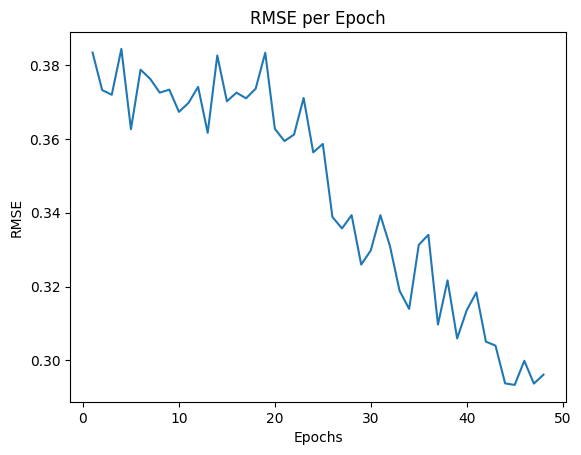

| 1         | -3.23     | 24.98     | 48.03     |
Epoch 1/33, RMSE: 0.4090
Epoch 2/33, RMSE: 0.3626
Epoch 3/33, RMSE: 0.3323
Epoch 4/33, RMSE: 0.3236
Epoch 5/33, RMSE: 0.3011
Epoch 6/33, RMSE: 0.2925
Epoch 7/33, RMSE: 0.2759
Epoch 8/33, RMSE: 0.2777
Epoch 9/33, RMSE: 0.2750
Epoch 10/33, RMSE: 0.2876
Epoch 11/33, RMSE: 0.2812
Epoch 12/33, RMSE: 0.2875
Epoch 13/33, RMSE: 0.2872
Epoch 14/33, RMSE: 0.3052
Epoch 15/33, RMSE: 0.3056
Epoch 16/33, RMSE: 0.3254
Epoch 17/33, RMSE: 0.3226
Epoch 18/33, RMSE: 0.3284
Epoch 19/33, RMSE: 0.3224
Epoch 20/33, RMSE: 0.3221
Epoch 21/33, RMSE: 0.3394
Epoch 22/33, RMSE: 0.3219
Epoch 23/33, RMSE: 0.3207
Epoch 24/33, RMSE: 0.3173
Epoch 25/33, RMSE: 0.3147
Epoch 26/33, RMSE: 0.3140
Epoch 27/33, RMSE: 0.2989
Epoch 28/33, RMSE: 0.3159
Epoch 29/33, RMSE: 0.3145
Epoch 30/33, RMSE: 0.3145
Epoch 31/33, RMSE: 0.3065
Epoch 32/33, RMSE: 0.3062
Epoch 33/33, RMSE: 0.3161


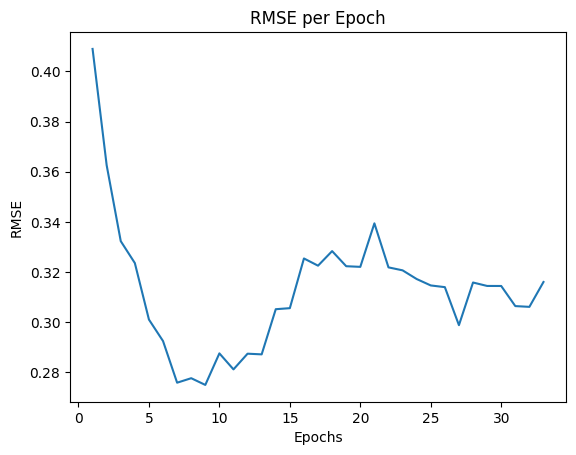

| 2         | -3.413    | 39.28     | 33.95     |
Epoch 1/16, RMSE: 0.4482
Epoch 2/16, RMSE: 0.3747
Epoch 3/16, RMSE: 0.3444
Epoch 4/16, RMSE: 0.3200
Epoch 5/16, RMSE: 0.3032
Epoch 6/16, RMSE: 0.3093
Epoch 7/16, RMSE: 0.3138
Epoch 8/16, RMSE: 0.3093
Epoch 9/16, RMSE: 0.3239
Epoch 10/16, RMSE: 0.3395
Epoch 11/16, RMSE: 0.3631
Epoch 12/16, RMSE: 0.3633
Epoch 13/16, RMSE: 0.3733
Epoch 14/16, RMSE: 0.3636
Epoch 15/16, RMSE: 0.3934
Epoch 16/16, RMSE: 0.3723


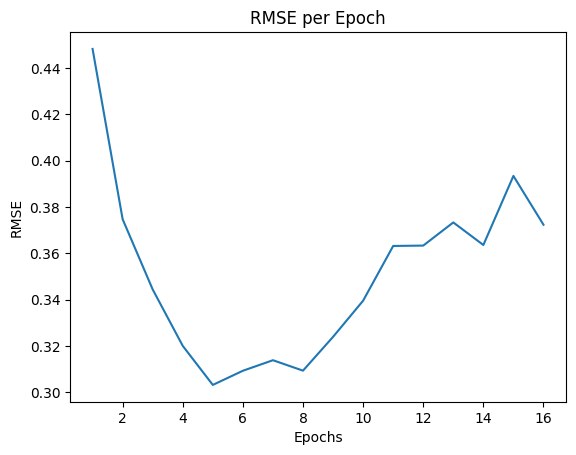

| 3         | -3.873    | 16.24     | 16.24     |
Epoch 1/44, RMSE: 0.5303
Epoch 2/44, RMSE: 0.4632
Epoch 3/44, RMSE: 0.3998
Epoch 4/44, RMSE: 0.4052
Epoch 5/44, RMSE: 0.4058
Epoch 6/44, RMSE: 0.4149
Epoch 7/44, RMSE: 0.4128
Epoch 8/44, RMSE: 0.4249
Epoch 9/44, RMSE: 0.4190
Epoch 10/44, RMSE: 0.4037
Epoch 11/44, RMSE: 0.3940
Epoch 12/44, RMSE: 0.3782
Epoch 13/44, RMSE: 0.3936
Epoch 14/44, RMSE: 0.3801
Epoch 15/44, RMSE: 0.3722
Epoch 16/44, RMSE: 0.3626
Epoch 17/44, RMSE: 0.3778
Epoch 18/44, RMSE: 0.3768
Epoch 19/44, RMSE: 0.3692
Epoch 20/44, RMSE: 0.3736
Epoch 21/44, RMSE: 0.3523
Epoch 22/44, RMSE: 0.3424
Epoch 23/44, RMSE: 0.3580
Epoch 24/44, RMSE: 0.3456
Epoch 25/44, RMSE: 0.3557
Epoch 26/44, RMSE: 0.3418
Epoch 27/44, RMSE: 0.3267
Epoch 28/44, RMSE: 0.3296
Epoch 29/44, RMSE: 0.3360
Epoch 30/44, RMSE: 0.3307
Epoch 31/44, RMSE: 0.3336
Epoch 32/44, RMSE: 0.3217
Epoch 33/44, RMSE: 0.3196
Epoch 34/44, RMSE: 0.3111
Epoch 35/44, RMSE: 0.3215
Epoch 36/44, RMSE: 0.3146
Epoch 37/44, RMSE: 0.33

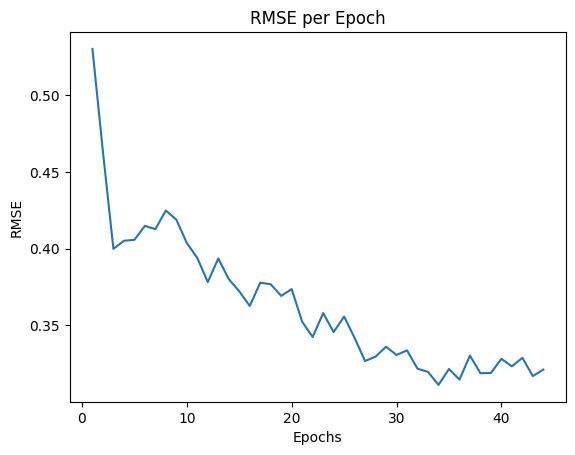

| 4         | -3.409    | 12.32     | 44.65     |
Epoch 1/38, RMSE: 0.3927
Epoch 2/38, RMSE: 0.3526
Epoch 3/38, RMSE: 0.3254
Epoch 4/38, RMSE: 0.3071
Epoch 5/38, RMSE: 0.2909
Epoch 6/38, RMSE: 0.2853
Epoch 7/38, RMSE: 0.2785
Epoch 8/38, RMSE: 0.2786
Epoch 9/38, RMSE: 0.2846
Epoch 10/38, RMSE: 0.3084
Epoch 11/38, RMSE: 0.3033
Epoch 12/38, RMSE: 0.3070
Epoch 13/38, RMSE: 0.3120
Epoch 14/38, RMSE: 0.3237
Epoch 15/38, RMSE: 0.3040
Epoch 16/38, RMSE: 0.3140
Epoch 17/38, RMSE: 0.3217
Epoch 18/38, RMSE: 0.3158
Epoch 19/38, RMSE: 0.3201
Epoch 20/38, RMSE: 0.3106
Epoch 21/38, RMSE: 0.3164
Epoch 22/38, RMSE: 0.3168
Epoch 23/38, RMSE: 0.3133
Epoch 24/38, RMSE: 0.3161
Epoch 25/38, RMSE: 0.3016
Epoch 26/38, RMSE: 0.3045
Epoch 27/38, RMSE: 0.3100
Epoch 28/38, RMSE: 0.3082
Epoch 29/38, RMSE: 0.3047
Epoch 30/38, RMSE: 0.3141
Epoch 31/38, RMSE: 0.3094
Epoch 32/38, RMSE: 0.3085
Epoch 33/38, RMSE: 0.3045
Epoch 34/38, RMSE: 0.3132
Epoch 35/38, RMSE: 0.3111
Epoch 36/38, RMSE: 0.3067
Epoch 37/38, RMSE: 0.30

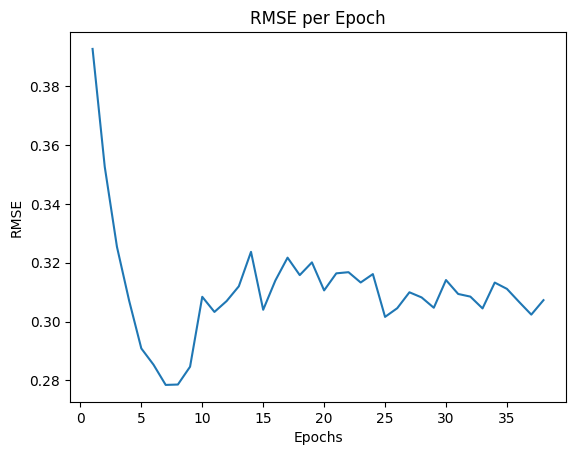

| 5         | -3.22     | 34.04     | 38.32     |
Epoch 1/48, RMSE: 0.5995
Epoch 2/48, RMSE: 0.5257
Epoch 3/48, RMSE: 0.4491
Epoch 4/48, RMSE: 0.3843
Epoch 5/48, RMSE: 0.3582
Epoch 6/48, RMSE: 0.3741
Epoch 7/48, RMSE: 0.3887
Epoch 8/48, RMSE: 0.4056
Epoch 9/48, RMSE: 0.3699
Epoch 10/48, RMSE: 0.3816
Epoch 11/48, RMSE: 0.3888
Epoch 12/48, RMSE: 0.3852
Epoch 13/48, RMSE: 0.4117
Epoch 14/48, RMSE: 0.3856
Epoch 15/48, RMSE: 0.3806
Epoch 16/48, RMSE: 0.3742
Epoch 17/48, RMSE: 0.3823
Epoch 18/48, RMSE: 0.3826
Epoch 19/48, RMSE: 0.3770
Epoch 20/48, RMSE: 0.3871
Epoch 21/48, RMSE: 0.4046
Epoch 22/48, RMSE: 0.4034
Epoch 23/48, RMSE: 0.3892
Epoch 24/48, RMSE: 0.3797
Epoch 25/48, RMSE: 0.4122
Epoch 26/48, RMSE: 0.3725
Epoch 27/48, RMSE: 0.4013
Epoch 28/48, RMSE: 0.3725
Epoch 29/48, RMSE: 0.3780
Epoch 30/48, RMSE: 0.3901
Epoch 31/48, RMSE: 0.3691
Epoch 32/48, RMSE: 0.3855
Epoch 33/48, RMSE: 0.3950
Epoch 34/48, RMSE: 0.3984
Epoch 35/48, RMSE: 0.3901
Epoch 36/48, RMSE: 0.3944
Epoch 37/48, RMSE: 0.37

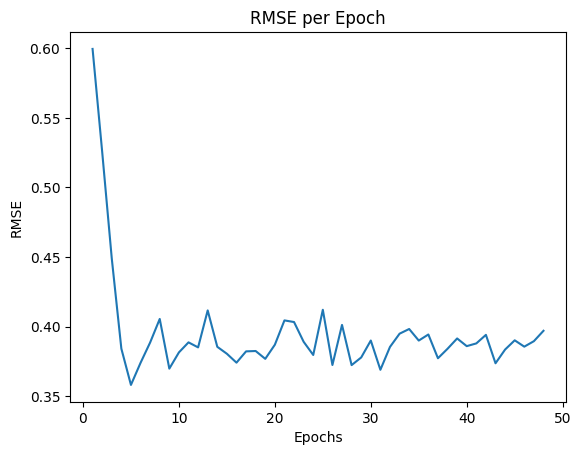

| 6         | -4.181    | 10.82     | 48.8      |
Epoch 1/18, RMSE: 0.3934
Epoch 2/18, RMSE: 0.3640
Epoch 3/18, RMSE: 0.3342
Epoch 4/18, RMSE: 0.3224
Epoch 5/18, RMSE: 0.2917
Epoch 6/18, RMSE: 0.2818
Epoch 7/18, RMSE: 0.2681
Epoch 8/18, RMSE: 0.2721
Epoch 9/18, RMSE: 0.2660
Epoch 10/18, RMSE: 0.2756
Epoch 11/18, RMSE: 0.2804
Epoch 12/18, RMSE: 0.2952
Epoch 13/18, RMSE: 0.2993
Epoch 14/18, RMSE: 0.3109
Epoch 15/18, RMSE: 0.3026
Epoch 16/18, RMSE: 0.3063
Epoch 17/18, RMSE: 0.3086
Epoch 18/18, RMSE: 0.3130


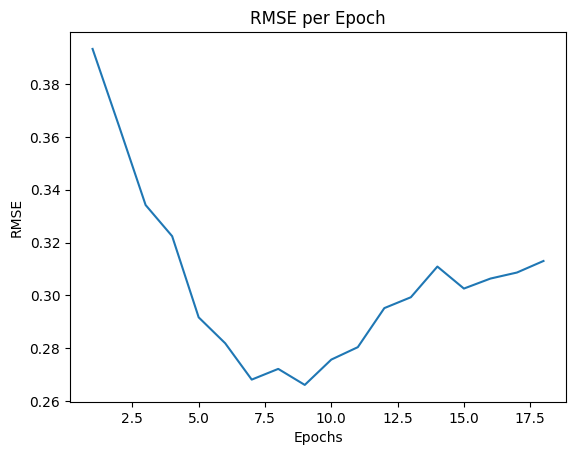

| 7         | -3.32     | 43.3      | 18.49     |
Epoch 1/17, RMSE: 0.4846
Epoch 2/17, RMSE: 0.3866
Epoch 3/17, RMSE: 0.3692
Epoch 4/17, RMSE: 0.3362
Epoch 5/17, RMSE: 0.3575
Epoch 6/17, RMSE: 0.3476
Epoch 7/17, RMSE: 0.3780
Epoch 8/17, RMSE: 0.3720
Epoch 9/17, RMSE: 0.3803
Epoch 10/17, RMSE: 0.3651
Epoch 11/17, RMSE: 0.3524
Epoch 12/17, RMSE: 0.3607
Epoch 13/17, RMSE: 0.3726
Epoch 14/17, RMSE: 0.3642
Epoch 15/17, RMSE: 0.3621
Epoch 16/17, RMSE: 0.3554
Epoch 17/17, RMSE: 0.3654


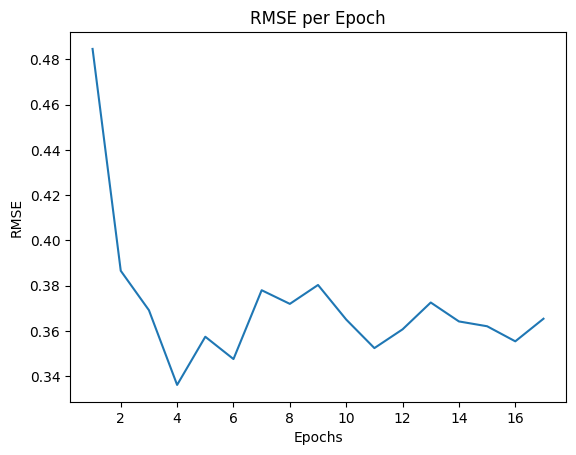

| 8         | -3.743    | 17.27     | 17.34     |
Epoch 1/30, RMSE: 0.4215
Epoch 2/30, RMSE: 0.3632
Epoch 3/30, RMSE: 0.3392
Epoch 4/30, RMSE: 0.3213
Epoch 5/30, RMSE: 0.3063
Epoch 6/30, RMSE: 0.2847
Epoch 7/30, RMSE: 0.2815
Epoch 8/30, RMSE: 0.2860
Epoch 9/30, RMSE: 0.3016
Epoch 10/30, RMSE: 0.3110
Epoch 11/30, RMSE: 0.3199
Epoch 12/30, RMSE: 0.3552
Epoch 13/30, RMSE: 0.3423
Epoch 14/30, RMSE: 0.3655
Epoch 15/30, RMSE: 0.3581
Epoch 16/30, RMSE: 0.3549
Epoch 17/30, RMSE: 0.3420
Epoch 18/30, RMSE: 0.3332
Epoch 19/30, RMSE: 0.3556
Epoch 20/30, RMSE: 0.3310
Epoch 21/30, RMSE: 0.3483
Epoch 22/30, RMSE: 0.3328
Epoch 23/30, RMSE: 0.3592
Epoch 24/30, RMSE: 0.3417
Epoch 25/30, RMSE: 0.3421
Epoch 26/30, RMSE: 0.3407
Epoch 27/30, RMSE: 0.3503
Epoch 28/30, RMSE: 0.3149
Epoch 29/30, RMSE: 0.3345
Epoch 30/30, RMSE: 0.3282


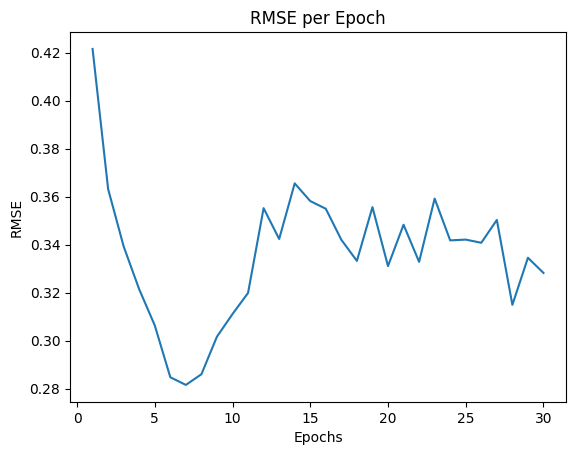

| 9         | -3.403    | 22.17     | 30.99     |
Epoch 1/21, RMSE: 0.3904
Epoch 2/21, RMSE: 0.3667
Epoch 3/21, RMSE: 0.3453
Epoch 4/21, RMSE: 0.3175
Epoch 5/21, RMSE: 0.2950
Epoch 6/21, RMSE: 0.2873
Epoch 7/21, RMSE: 0.2713
Epoch 8/21, RMSE: 0.2699
Epoch 9/21, RMSE: 0.2736
Epoch 10/21, RMSE: 0.2698
Epoch 11/21, RMSE: 0.2728
Epoch 12/21, RMSE: 0.2816
Epoch 13/21, RMSE: 0.2813
Epoch 14/21, RMSE: 0.2772
Epoch 15/21, RMSE: 0.2944
Epoch 16/21, RMSE: 0.2943
Epoch 17/21, RMSE: 0.3152
Epoch 18/21, RMSE: 0.3022
Epoch 19/21, RMSE: 0.3051
Epoch 20/21, RMSE: 0.3023
Epoch 21/21, RMSE: 0.2997


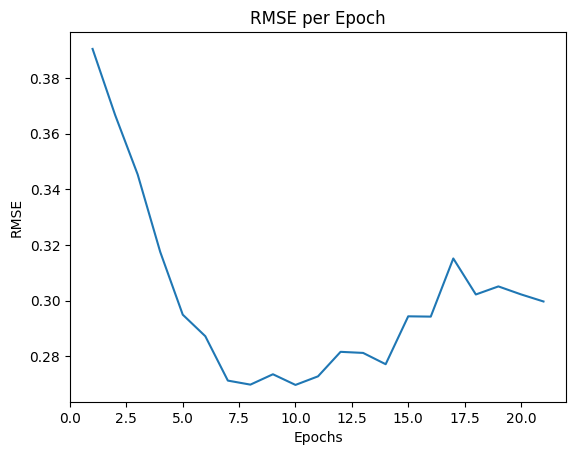

| 10        | -3.049    | 27.28     | 21.65     |
Epoch 1/24, RMSE: 0.4001
Epoch 2/24, RMSE: 0.3673
Epoch 3/24, RMSE: 0.3435
Epoch 4/24, RMSE: 0.3170
Epoch 5/24, RMSE: 0.3071
Epoch 6/24, RMSE: 0.2884
Epoch 7/24, RMSE: 0.2770
Epoch 8/24, RMSE: 0.2665
Epoch 9/24, RMSE: 0.2855
Epoch 10/24, RMSE: 0.2842
Epoch 11/24, RMSE: 0.3153
Epoch 12/24, RMSE: 0.3291
Epoch 13/24, RMSE: 0.3140
Epoch 14/24, RMSE: 0.3172
Epoch 15/24, RMSE: 0.3240
Epoch 16/24, RMSE: 0.3232
Epoch 17/24, RMSE: 0.3253
Epoch 18/24, RMSE: 0.3181
Epoch 19/24, RMSE: 0.3133
Epoch 20/24, RMSE: 0.3267
Epoch 21/24, RMSE: 0.3209
Epoch 22/24, RMSE: 0.3254
Epoch 23/24, RMSE: 0.3202
Epoch 24/24, RMSE: 0.3210


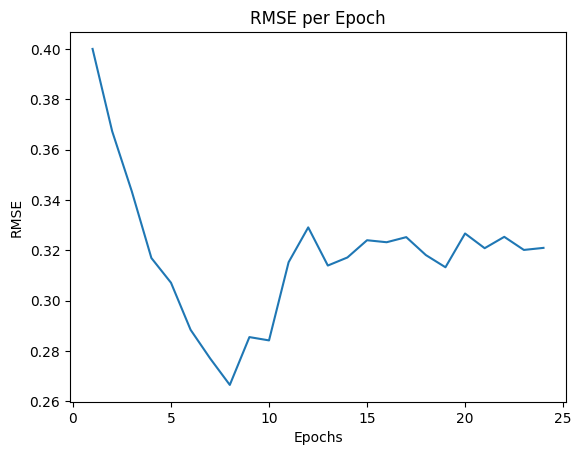

| 11        | -3.232    | 26.16     | 24.12     |
Epoch 1/22, RMSE: 0.3813
Epoch 2/22, RMSE: 0.3494
Epoch 3/22, RMSE: 0.3144
Epoch 4/22, RMSE: 0.3052
Epoch 5/22, RMSE: 0.3025
Epoch 6/22, RMSE: 0.3159
Epoch 7/22, RMSE: 0.3254
Epoch 8/22, RMSE: 0.3029
Epoch 9/22, RMSE: 0.3284
Epoch 10/22, RMSE: 0.3185
Epoch 11/22, RMSE: 0.3488
Epoch 12/22, RMSE: 0.3368
Epoch 13/22, RMSE: 0.3546
Epoch 14/22, RMSE: 0.3444
Epoch 15/22, RMSE: 0.3478
Epoch 16/22, RMSE: 0.3407
Epoch 17/22, RMSE: 0.3560
Epoch 18/22, RMSE: 0.3364
Epoch 19/22, RMSE: 0.3421
Epoch 20/22, RMSE: 0.3408
Epoch 21/22, RMSE: 0.3362
Epoch 22/22, RMSE: 0.3293


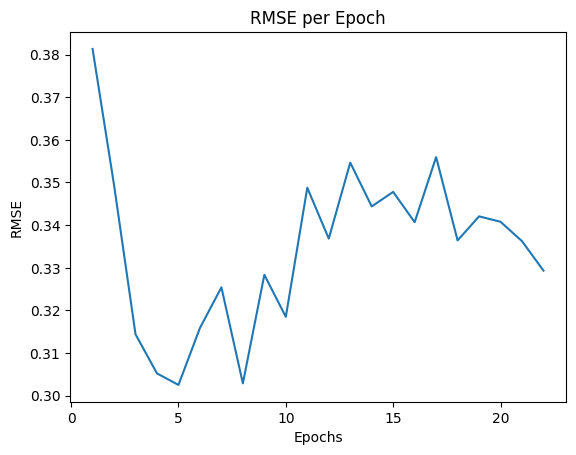

| 12        | -3.35     | 30.46     | 22.47     |
Epoch 1/19, RMSE: 0.4002
Epoch 2/19, RMSE: 0.3624
Epoch 3/19, RMSE: 0.3553
Epoch 4/19, RMSE: 0.3184
Epoch 5/19, RMSE: 0.2868
Epoch 6/19, RMSE: 0.2777
Epoch 7/19, RMSE: 0.2795
Epoch 8/19, RMSE: 0.2779
Epoch 9/19, RMSE: 0.2928
Epoch 10/19, RMSE: 0.2923
Epoch 11/19, RMSE: 0.2933
Epoch 12/19, RMSE: 0.3057
Epoch 13/19, RMSE: 0.3007
Epoch 14/19, RMSE: 0.3194
Epoch 15/19, RMSE: 0.3118
Epoch 16/19, RMSE: 0.3157
Epoch 17/19, RMSE: 0.3155
Epoch 18/19, RMSE: 0.3124
Epoch 19/19, RMSE: 0.3145


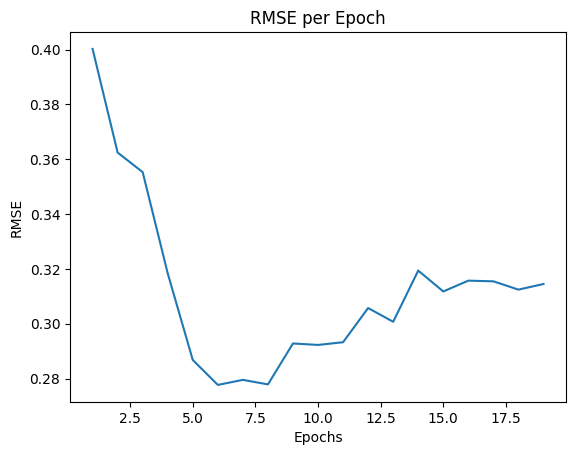

| 13        | -3.166    | 24.78     | 19.72     |
Epoch 1/17, RMSE: 0.3962
Epoch 2/17, RMSE: 0.3600
Epoch 3/17, RMSE: 0.3358
Epoch 4/17, RMSE: 0.3189
Epoch 5/17, RMSE: 0.3062
Epoch 6/17, RMSE: 0.3081
Epoch 7/17, RMSE: 0.3150
Epoch 8/17, RMSE: 0.3358
Epoch 9/17, RMSE: 0.3335
Epoch 10/17, RMSE: 0.3653
Epoch 11/17, RMSE: 0.3770
Epoch 12/17, RMSE: 0.3667
Epoch 13/17, RMSE: 0.3874
Epoch 14/17, RMSE: 0.3431
Epoch 15/17, RMSE: 0.3433
Epoch 16/17, RMSE: 0.3587
Epoch 17/17, RMSE: 0.3564


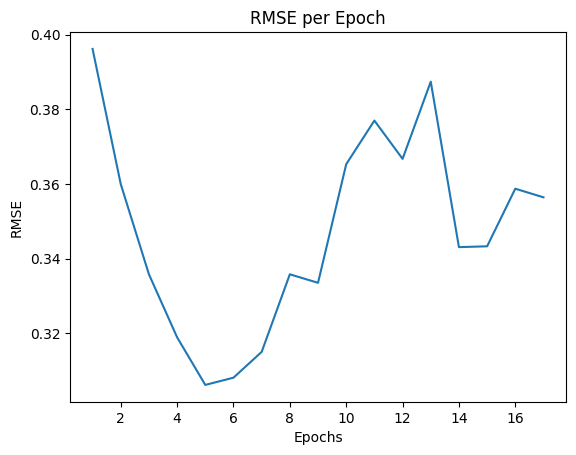

| 14        | -3.637    | 28.47     | 17.58     |
Epoch 1/22, RMSE: 0.4201
Epoch 2/22, RMSE: 0.3728
Epoch 3/22, RMSE: 0.3427
Epoch 4/22, RMSE: 0.3205
Epoch 5/22, RMSE: 0.3124
Epoch 6/22, RMSE: 0.2945
Epoch 7/22, RMSE: 0.2850
Epoch 8/22, RMSE: 0.2934
Epoch 9/22, RMSE: 0.2911
Epoch 10/22, RMSE: 0.3268
Epoch 11/22, RMSE: 0.3307
Epoch 12/22, RMSE: 0.3366
Epoch 13/22, RMSE: 0.3431
Epoch 14/22, RMSE: 0.3337
Epoch 15/22, RMSE: 0.3365
Epoch 16/22, RMSE: 0.3277
Epoch 17/22, RMSE: 0.3343
Epoch 18/22, RMSE: 0.3345
Epoch 19/22, RMSE: 0.3511
Epoch 20/22, RMSE: 0.3246
Epoch 21/22, RMSE: 0.3347
Epoch 22/22, RMSE: 0.3192


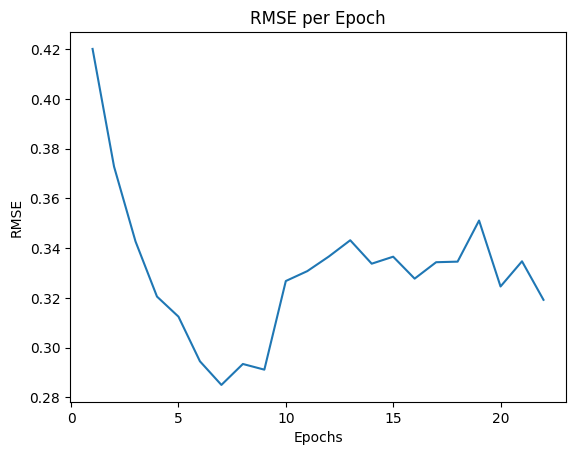

| 15        | -3.128    | 22.69     | 22.4      |
Epoch 1/42, RMSE: 0.3926
Epoch 2/42, RMSE: 0.3668
Epoch 3/42, RMSE: 0.3289
Epoch 4/42, RMSE: 0.3123
Epoch 5/42, RMSE: 0.2989
Epoch 6/42, RMSE: 0.2915
Epoch 7/42, RMSE: 0.2881
Epoch 8/42, RMSE: 0.2729
Epoch 9/42, RMSE: 0.2684
Epoch 10/42, RMSE: 0.2723
Epoch 11/42, RMSE: 0.2715
Epoch 12/42, RMSE: 0.2692
Epoch 13/42, RMSE: 0.2795
Epoch 14/42, RMSE: 0.3020
Epoch 15/42, RMSE: 0.2916
Epoch 16/42, RMSE: 0.2959
Epoch 17/42, RMSE: 0.2996
Epoch 18/42, RMSE: 0.2912
Epoch 19/42, RMSE: 0.3002
Epoch 20/42, RMSE: 0.2978
Epoch 21/42, RMSE: 0.2971
Epoch 22/42, RMSE: 0.2965
Epoch 23/42, RMSE: 0.3062
Epoch 24/42, RMSE: 0.2924
Epoch 25/42, RMSE: 0.3035
Epoch 26/42, RMSE: 0.2968
Epoch 27/42, RMSE: 0.3009
Epoch 28/42, RMSE: 0.3066
Epoch 29/42, RMSE: 0.2978
Epoch 30/42, RMSE: 0.3000
Epoch 31/42, RMSE: 0.2967
Epoch 32/42, RMSE: 0.2967
Epoch 33/42, RMSE: 0.3113
Epoch 34/42, RMSE: 0.2997
Epoch 35/42, RMSE: 0.3104
Epoch 36/42, RMSE: 0.3038
Epoch 37/42, RMSE: 0.30

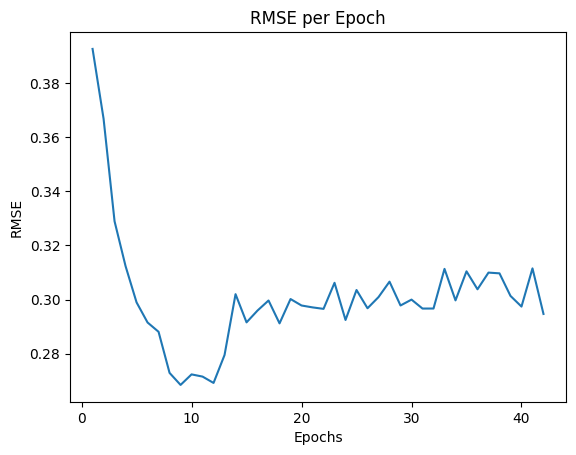

| 16        | -3.129    | 30.56     | 42.04     |
Epoch 1/42, RMSE: 0.3991
Epoch 2/42, RMSE: 0.3772
Epoch 3/42, RMSE: 0.3560
Epoch 4/42, RMSE: 0.3315
Epoch 5/42, RMSE: 0.3159
Epoch 6/42, RMSE: 0.2867
Epoch 7/42, RMSE: 0.2696
Epoch 8/42, RMSE: 0.2752
Epoch 9/42, RMSE: 0.2792
Epoch 10/42, RMSE: 0.2828
Epoch 11/42, RMSE: 0.2990
Epoch 12/42, RMSE: 0.3052
Epoch 13/42, RMSE: 0.3044
Epoch 14/42, RMSE: 0.2990
Epoch 15/42, RMSE: 0.3002
Epoch 16/42, RMSE: 0.3039
Epoch 17/42, RMSE: 0.3046
Epoch 18/42, RMSE: 0.3115
Epoch 19/42, RMSE: 0.3099
Epoch 20/42, RMSE: 0.3028
Epoch 21/42, RMSE: 0.3151
Epoch 22/42, RMSE: 0.3116
Epoch 23/42, RMSE: 0.3161
Epoch 24/42, RMSE: 0.3054
Epoch 25/42, RMSE: 0.3093
Epoch 26/42, RMSE: 0.3119
Epoch 27/42, RMSE: 0.3123
Epoch 28/42, RMSE: 0.3077
Epoch 29/42, RMSE: 0.2996
Epoch 30/42, RMSE: 0.3033
Epoch 31/42, RMSE: 0.3016
Epoch 32/42, RMSE: 0.2986
Epoch 33/42, RMSE: 0.3005
Epoch 34/42, RMSE: 0.2998
Epoch 35/42, RMSE: 0.3091
Epoch 36/42, RMSE: 0.2943
Epoch 37/42, RMSE: 0.32

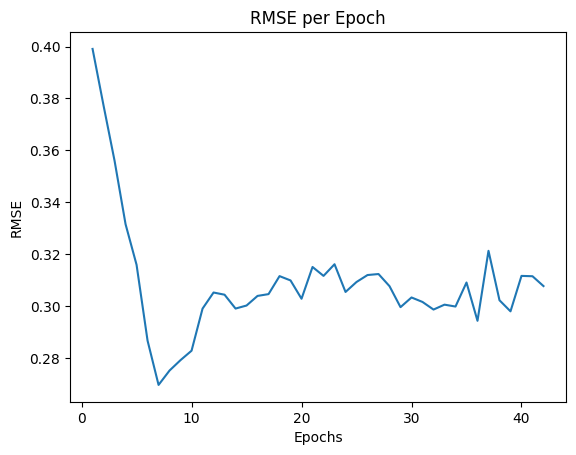

| 17        | -3.191    | 26.14     | 42.7      |
Epoch 1/37, RMSE: 0.4009
Epoch 2/37, RMSE: 0.3620
Epoch 3/37, RMSE: 0.3463
Epoch 4/37, RMSE: 0.3191
Epoch 5/37, RMSE: 0.3139
Epoch 6/37, RMSE: 0.2937
Epoch 7/37, RMSE: 0.3022
Epoch 8/37, RMSE: 0.3212
Epoch 9/37, RMSE: 0.3379
Epoch 10/37, RMSE: 0.3116
Epoch 11/37, RMSE: 0.3114
Epoch 12/37, RMSE: 0.3180
Epoch 13/37, RMSE: 0.3193
Epoch 14/37, RMSE: 0.3209
Epoch 15/37, RMSE: 0.3258
Epoch 16/37, RMSE: 0.3289
Epoch 17/37, RMSE: 0.3256
Epoch 18/37, RMSE: 0.3168
Epoch 19/37, RMSE: 0.3231
Epoch 20/37, RMSE: 0.3068
Epoch 21/37, RMSE: 0.3312
Epoch 22/37, RMSE: 0.3177
Epoch 23/37, RMSE: 0.3243
Epoch 24/37, RMSE: 0.3152
Epoch 25/37, RMSE: 0.3044
Epoch 26/37, RMSE: 0.3005
Epoch 27/37, RMSE: 0.3083
Epoch 28/37, RMSE: 0.3047
Epoch 29/37, RMSE: 0.3010
Epoch 30/37, RMSE: 0.3023
Epoch 31/37, RMSE: 0.2957
Epoch 32/37, RMSE: 0.3031
Epoch 33/37, RMSE: 0.3041
Epoch 34/37, RMSE: 0.3026
Epoch 35/37, RMSE: 0.2970
Epoch 36/37, RMSE: 0.3003
Epoch 37/37, RMSE: 0.29

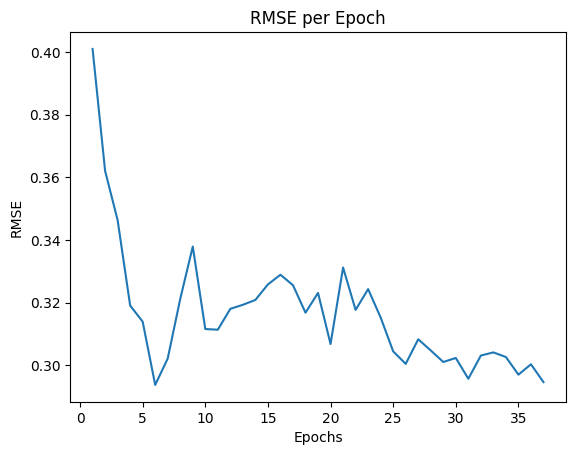

| 18        | -3.105    | 28.62     | 37.92     |
Epoch 1/47, RMSE: 0.4188
Epoch 2/47, RMSE: 0.3774
Epoch 3/47, RMSE: 0.3401
Epoch 4/47, RMSE: 0.3251
Epoch 5/47, RMSE: 0.3141
Epoch 6/47, RMSE: 0.3128
Epoch 7/47, RMSE: 0.3159
Epoch 8/47, RMSE: 0.3155
Epoch 9/47, RMSE: 0.3053
Epoch 10/47, RMSE: 0.3145
Epoch 11/47, RMSE: 0.3339
Epoch 12/47, RMSE: 0.3198
Epoch 13/47, RMSE: 0.3248
Epoch 14/47, RMSE: 0.3277
Epoch 15/47, RMSE: 0.3179
Epoch 16/47, RMSE: 0.3196
Epoch 17/47, RMSE: 0.3300
Epoch 18/47, RMSE: 0.3256
Epoch 19/47, RMSE: 0.3269
Epoch 20/47, RMSE: 0.3147
Epoch 21/47, RMSE: 0.3189
Epoch 22/47, RMSE: 0.3314
Epoch 23/47, RMSE: 0.3281
Epoch 24/47, RMSE: 0.3356
Epoch 25/47, RMSE: 0.3208
Epoch 26/47, RMSE: 0.3244
Epoch 27/47, RMSE: 0.3154
Epoch 28/47, RMSE: 0.3217
Epoch 29/47, RMSE: 0.3103
Epoch 30/47, RMSE: 0.3292
Epoch 31/47, RMSE: 0.3112
Epoch 32/47, RMSE: 0.3093
Epoch 33/47, RMSE: 0.3098
Epoch 34/47, RMSE: 0.3098
Epoch 35/47, RMSE: 0.3053
Epoch 36/47, RMSE: 0.3159
Epoch 37/47, RMSE: 0.30

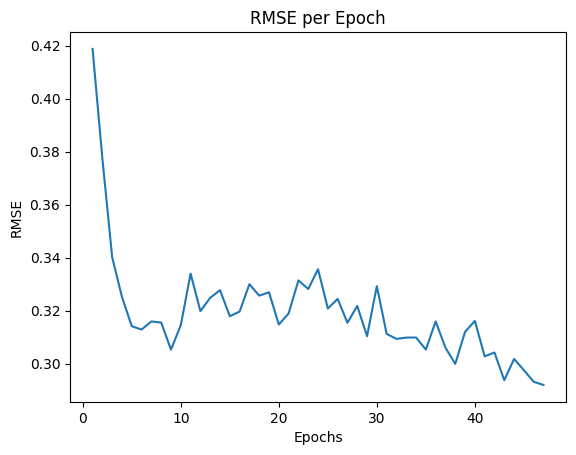

| 19        | -3.144    | 30.9      | 47.43     |
Epoch 1/44, RMSE: 0.3981
Epoch 2/44, RMSE: 0.3661
Epoch 3/44, RMSE: 0.3211
Epoch 4/44, RMSE: 0.3019
Epoch 5/44, RMSE: 0.2799
Epoch 6/44, RMSE: 0.2726
Epoch 7/44, RMSE: 0.2776
Epoch 8/44, RMSE: 0.2740
Epoch 9/44, RMSE: 0.2750
Epoch 10/44, RMSE: 0.2810
Epoch 11/44, RMSE: 0.3075
Epoch 12/44, RMSE: 0.3071
Epoch 13/44, RMSE: 0.3124
Epoch 14/44, RMSE: 0.3098
Epoch 15/44, RMSE: 0.3148
Epoch 16/44, RMSE: 0.3222
Epoch 17/44, RMSE: 0.3312
Epoch 18/44, RMSE: 0.3197
Epoch 19/44, RMSE: 0.3252
Epoch 20/44, RMSE: 0.3253
Epoch 21/44, RMSE: 0.3177
Epoch 22/44, RMSE: 0.3192
Epoch 23/44, RMSE: 0.3147
Epoch 24/44, RMSE: 0.3244
Epoch 25/44, RMSE: 0.3162
Epoch 26/44, RMSE: 0.3082
Epoch 27/44, RMSE: 0.3193
Epoch 28/44, RMSE: 0.3129
Epoch 29/44, RMSE: 0.3115
Epoch 30/44, RMSE: 0.3240
Epoch 31/44, RMSE: 0.3075
Epoch 32/44, RMSE: 0.3097
Epoch 33/44, RMSE: 0.3042
Epoch 34/44, RMSE: 0.3010
Epoch 35/44, RMSE: 0.3107
Epoch 36/44, RMSE: 0.3050
Epoch 37/44, RMSE: 0.30

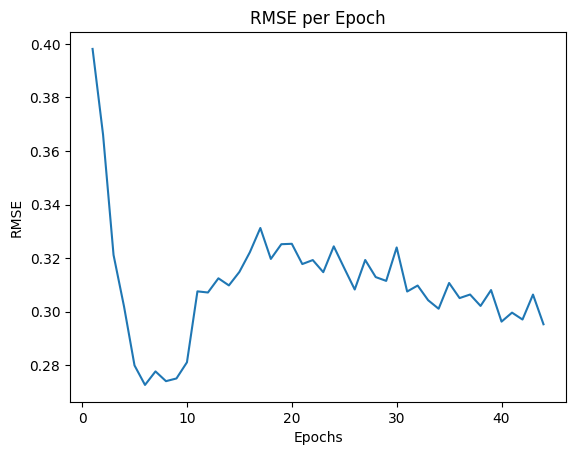

| 20        | -3.124    | 35.68     | 44.88     |
Epoch 1/50, RMSE: 0.3871
Epoch 2/50, RMSE: 0.3541
Epoch 3/50, RMSE: 0.3245
Epoch 4/50, RMSE: 0.3020
Epoch 5/50, RMSE: 0.2776
Epoch 6/50, RMSE: 0.2731
Epoch 7/50, RMSE: 0.2659
Epoch 8/50, RMSE: 0.2620
Epoch 9/50, RMSE: 0.2674
Epoch 10/50, RMSE: 0.2765
Epoch 11/50, RMSE: 0.2969
Epoch 12/50, RMSE: 0.2898
Epoch 13/50, RMSE: 0.3150
Epoch 14/50, RMSE: 0.3119
Epoch 15/50, RMSE: 0.3220
Epoch 16/50, RMSE: 0.3172
Epoch 17/50, RMSE: 0.3364
Epoch 18/50, RMSE: 0.3246
Epoch 19/50, RMSE: 0.3096
Epoch 20/50, RMSE: 0.3270
Epoch 21/50, RMSE: 0.3311
Epoch 22/50, RMSE: 0.3214
Epoch 23/50, RMSE: 0.3300
Epoch 24/50, RMSE: 0.3510
Epoch 25/50, RMSE: 0.3167
Epoch 26/50, RMSE: 0.3315
Epoch 27/50, RMSE: 0.3287
Epoch 28/50, RMSE: 0.3263
Epoch 29/50, RMSE: 0.3343
Epoch 30/50, RMSE: 0.3221
Epoch 31/50, RMSE: 0.3263
Epoch 32/50, RMSE: 0.3440
Epoch 33/50, RMSE: 0.3100
Epoch 34/50, RMSE: 0.3336
Epoch 35/50, RMSE: 0.3158
Epoch 36/50, RMSE: 0.3225
Epoch 37/50, RMSE: 0.33

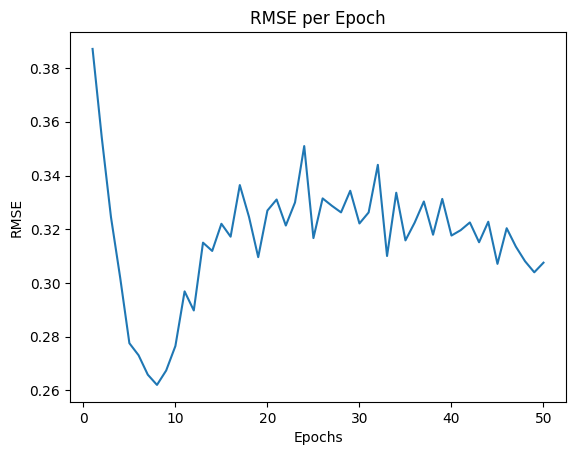

| 21        | -3.308    | 36.15     | 50.0      |
Epoch 1/43, RMSE: 0.3871
Epoch 2/43, RMSE: 0.3566
Epoch 3/43, RMSE: 0.3226
Epoch 4/43, RMSE: 0.3085
Epoch 5/43, RMSE: 0.2804
Epoch 6/43, RMSE: 0.2751
Epoch 7/43, RMSE: 0.2763
Epoch 8/43, RMSE: 0.2635
Epoch 9/43, RMSE: 0.2788
Epoch 10/43, RMSE: 0.2735
Epoch 11/43, RMSE: 0.2844
Epoch 12/43, RMSE: 0.2859
Epoch 13/43, RMSE: 0.2934
Epoch 14/43, RMSE: 0.3091
Epoch 15/43, RMSE: 0.2957
Epoch 16/43, RMSE: 0.3136
Epoch 17/43, RMSE: 0.3138
Epoch 18/43, RMSE: 0.3100
Epoch 19/43, RMSE: 0.3100
Epoch 20/43, RMSE: 0.3091
Epoch 21/43, RMSE: 0.3146
Epoch 22/43, RMSE: 0.3097
Epoch 23/43, RMSE: 0.3087
Epoch 24/43, RMSE: 0.3146
Epoch 25/43, RMSE: 0.3092
Epoch 26/43, RMSE: 0.3117
Epoch 27/43, RMSE: 0.3218
Epoch 28/43, RMSE: 0.3034
Epoch 29/43, RMSE: 0.3116
Epoch 30/43, RMSE: 0.3131
Epoch 31/43, RMSE: 0.3110
Epoch 32/43, RMSE: 0.3213
Epoch 33/43, RMSE: 0.3088
Epoch 34/43, RMSE: 0.3186
Epoch 35/43, RMSE: 0.3105
Epoch 36/43, RMSE: 0.3024
Epoch 37/43, RMSE: 0.30

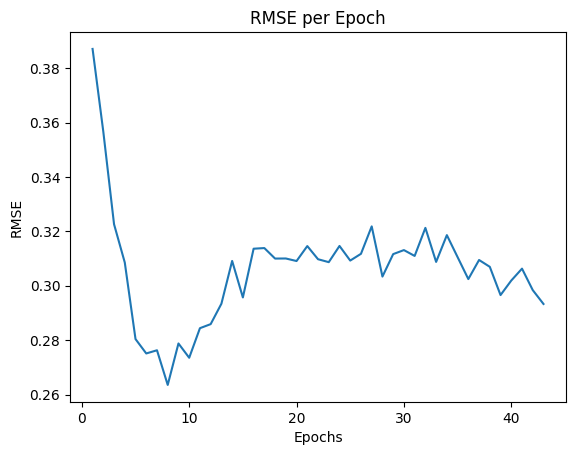

| 22        | -3.089    | 40.9      | 43.26     |
Epoch 1/47, RMSE: 0.3941
Epoch 2/47, RMSE: 0.3606
Epoch 3/47, RMSE: 0.3256
Epoch 4/47, RMSE: 0.3135
Epoch 5/47, RMSE: 0.2895
Epoch 6/47, RMSE: 0.2799
Epoch 7/47, RMSE: 0.2774
Epoch 8/47, RMSE: 0.2781
Epoch 9/47, RMSE: 0.2775
Epoch 10/47, RMSE: 0.2989
Epoch 11/47, RMSE: 0.3130
Epoch 12/47, RMSE: 0.3080
Epoch 13/47, RMSE: 0.3127
Epoch 14/47, RMSE: 0.3198
Epoch 15/47, RMSE: 0.3362
Epoch 16/47, RMSE: 0.3200
Epoch 17/47, RMSE: 0.3423
Epoch 18/47, RMSE: 0.3283
Epoch 19/47, RMSE: 0.3336
Epoch 20/47, RMSE: 0.3322
Epoch 21/47, RMSE: 0.3321
Epoch 22/47, RMSE: 0.3238
Epoch 23/47, RMSE: 0.3418
Epoch 24/47, RMSE: 0.3359
Epoch 25/47, RMSE: 0.3371
Epoch 26/47, RMSE: 0.3318
Epoch 27/47, RMSE: 0.3315
Epoch 28/47, RMSE: 0.3411
Epoch 29/47, RMSE: 0.3266
Epoch 30/47, RMSE: 0.3257
Epoch 31/47, RMSE: 0.3213
Epoch 32/47, RMSE: 0.3316
Epoch 33/47, RMSE: 0.3248
Epoch 34/47, RMSE: 0.3344
Epoch 35/47, RMSE: 0.3115
Epoch 36/47, RMSE: 0.3195
Epoch 37/47, RMSE: 0.32

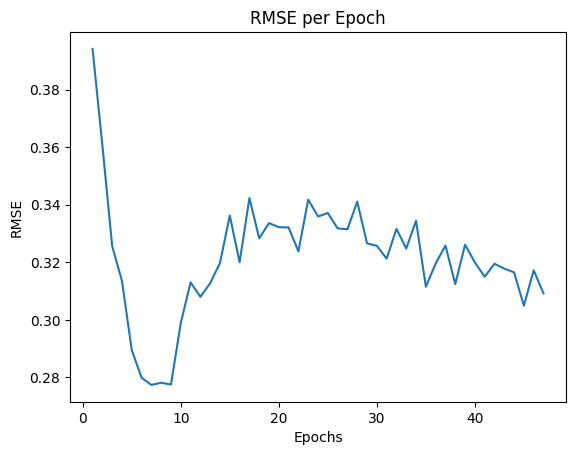

| 23        | -3.345    | 44.51     | 47.09     |
Epoch 1/39, RMSE: 0.3795
Epoch 2/39, RMSE: 0.3461
Epoch 3/39, RMSE: 0.3228
Epoch 4/39, RMSE: 0.3112
Epoch 5/39, RMSE: 0.2988
Epoch 6/39, RMSE: 0.2762
Epoch 7/39, RMSE: 0.2729
Epoch 8/39, RMSE: 0.2619
Epoch 9/39, RMSE: 0.2641
Epoch 10/39, RMSE: 0.2567
Epoch 11/39, RMSE: 0.2578
Epoch 12/39, RMSE: 0.2574
Epoch 13/39, RMSE: 0.2605
Epoch 14/39, RMSE: 0.2706
Epoch 15/39, RMSE: 0.2739
Epoch 16/39, RMSE: 0.2836
Epoch 17/39, RMSE: 0.2855
Epoch 18/39, RMSE: 0.3237
Epoch 19/39, RMSE: 0.3025
Epoch 20/39, RMSE: 0.3163
Epoch 21/39, RMSE: 0.3060
Epoch 22/39, RMSE: 0.3222
Epoch 23/39, RMSE: 0.3069
Epoch 24/39, RMSE: 0.3152
Epoch 25/39, RMSE: 0.3074
Epoch 26/39, RMSE: 0.3083
Epoch 27/39, RMSE: 0.3157
Epoch 28/39, RMSE: 0.3152
Epoch 29/39, RMSE: 0.3174
Epoch 30/39, RMSE: 0.3164
Epoch 31/39, RMSE: 0.3217
Epoch 32/39, RMSE: 0.3161
Epoch 33/39, RMSE: 0.3117
Epoch 34/39, RMSE: 0.3057
Epoch 35/39, RMSE: 0.3036
Epoch 36/39, RMSE: 0.3088
Epoch 37/39, RMSE: 0.30

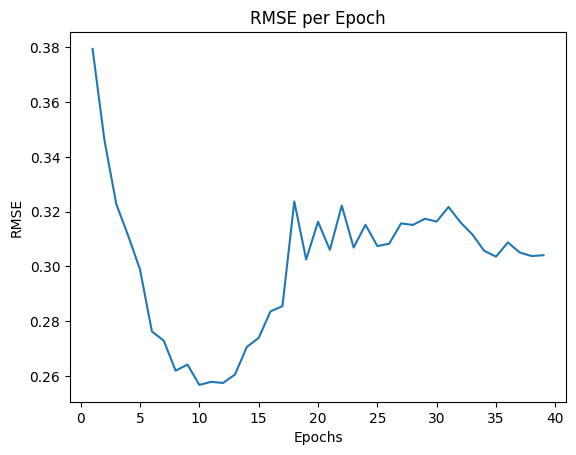

| 24        | -3.349    | 44.66     | 39.97     |
Epoch 1/41, RMSE: 0.4008
Epoch 2/41, RMSE: 0.3644
Epoch 3/41, RMSE: 0.3216
Epoch 4/41, RMSE: 0.3005
Epoch 5/41, RMSE: 0.2913
Epoch 6/41, RMSE: 0.2666
Epoch 7/41, RMSE: 0.2805
Epoch 8/41, RMSE: 0.2771
Epoch 9/41, RMSE: 0.3027
Epoch 10/41, RMSE: 0.3131
Epoch 11/41, RMSE: 0.3283
Epoch 12/41, RMSE: 0.3285
Epoch 13/41, RMSE: 0.3343
Epoch 14/41, RMSE: 0.3262
Epoch 15/41, RMSE: 0.3445
Epoch 16/41, RMSE: 0.3482
Epoch 17/41, RMSE: 0.3501
Epoch 18/41, RMSE: 0.3376
Epoch 19/41, RMSE: 0.3296
Epoch 20/41, RMSE: 0.3330
Epoch 21/41, RMSE: 0.3243
Epoch 22/41, RMSE: 0.3318
Epoch 23/41, RMSE: 0.3283
Epoch 24/41, RMSE: 0.3330
Epoch 25/41, RMSE: 0.3147
Epoch 26/41, RMSE: 0.3355
Epoch 27/41, RMSE: 0.3205
Epoch 28/41, RMSE: 0.3194
Epoch 29/41, RMSE: 0.3210
Epoch 30/41, RMSE: 0.3332
Epoch 31/41, RMSE: 0.3192
Epoch 32/41, RMSE: 0.3179
Epoch 33/41, RMSE: 0.3319
Epoch 34/41, RMSE: 0.3170
Epoch 35/41, RMSE: 0.3116
Epoch 36/41, RMSE: 0.3157
Epoch 37/41, RMSE: 0.31

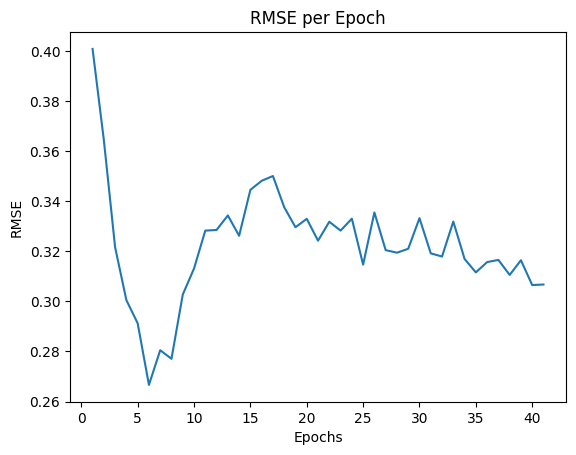

| 25        | -3.242    | 37.63     | 41.31     |
Epoch 1/39, RMSE: 0.5133
Epoch 2/39, RMSE: 0.4073
Epoch 3/39, RMSE: 0.4034
Epoch 4/39, RMSE: 0.4227
Epoch 5/39, RMSE: 0.3805
Epoch 6/39, RMSE: 0.4019
Epoch 7/39, RMSE: 0.3992
Epoch 8/39, RMSE: 0.4135
Epoch 9/39, RMSE: 0.4097
Epoch 10/39, RMSE: 0.4039
Epoch 11/39, RMSE: 0.4278
Epoch 12/39, RMSE: 0.4076
Epoch 13/39, RMSE: 0.3938
Epoch 14/39, RMSE: 0.3806
Epoch 15/39, RMSE: 0.4064
Epoch 16/39, RMSE: 0.4089
Epoch 17/39, RMSE: 0.3812
Epoch 18/39, RMSE: 0.3880
Epoch 19/39, RMSE: 0.3799
Epoch 20/39, RMSE: 0.3797
Epoch 21/39, RMSE: 0.3931
Epoch 22/39, RMSE: 0.3935
Epoch 23/39, RMSE: 0.3866
Epoch 24/39, RMSE: 0.3954
Epoch 25/39, RMSE: 0.3755
Epoch 26/39, RMSE: 0.3894
Epoch 27/39, RMSE: 0.3797
Epoch 28/39, RMSE: 0.3962
Epoch 29/39, RMSE: 0.3954
Epoch 30/39, RMSE: 0.3946
Epoch 31/39, RMSE: 0.3938
Epoch 32/39, RMSE: 0.3841
Epoch 33/39, RMSE: 0.3822
Epoch 34/39, RMSE: 0.3882
Epoch 35/39, RMSE: 0.3695
Epoch 36/39, RMSE: 0.3791
Epoch 37/39, RMSE: 0.38

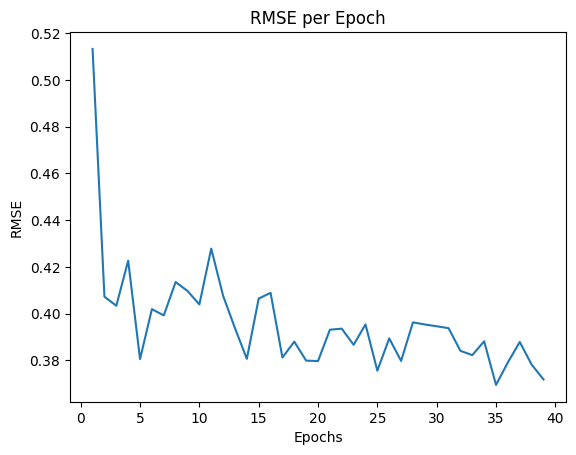

| 26        | -3.837    | 15.37     | 39.33     |
Epoch 1/33, RMSE: 0.4096
Epoch 2/33, RMSE: 0.3773
Epoch 3/33, RMSE: 0.3445
Epoch 4/33, RMSE: 0.3206
Epoch 5/33, RMSE: 0.3056
Epoch 6/33, RMSE: 0.2958
Epoch 7/33, RMSE: 0.2810
Epoch 8/33, RMSE: 0.2921
Epoch 9/33, RMSE: 0.2914
Epoch 10/33, RMSE: 0.3200
Epoch 11/33, RMSE: 0.3187
Epoch 12/33, RMSE: 0.3288
Epoch 13/33, RMSE: 0.3400
Epoch 14/33, RMSE: 0.3352
Epoch 15/33, RMSE: 0.3477
Epoch 16/33, RMSE: 0.3341
Epoch 17/33, RMSE: 0.3448
Epoch 18/33, RMSE: 0.3480
Epoch 19/33, RMSE: 0.3370
Epoch 20/33, RMSE: 0.3394
Epoch 21/33, RMSE: 0.3291
Epoch 22/33, RMSE: 0.3398
Epoch 23/33, RMSE: 0.3396
Epoch 24/33, RMSE: 0.3373
Epoch 25/33, RMSE: 0.3354
Epoch 26/33, RMSE: 0.3298
Epoch 27/33, RMSE: 0.3317
Epoch 28/33, RMSE: 0.3349
Epoch 29/33, RMSE: 0.3364
Epoch 30/33, RMSE: 0.3218
Epoch 31/33, RMSE: 0.3237
Epoch 32/33, RMSE: 0.3174
Epoch 33/33, RMSE: 0.3243


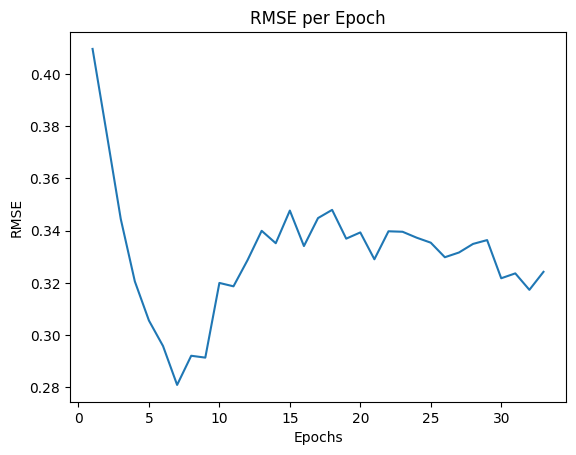

| 27        | -3.422    | 30.23     | 33.54     |
Epoch 1/46, RMSE: 0.3869
Epoch 2/46, RMSE: 0.3642
Epoch 3/46, RMSE: 0.3259
Epoch 4/46, RMSE: 0.3033
Epoch 5/46, RMSE: 0.2908
Epoch 6/46, RMSE: 0.2916
Epoch 7/46, RMSE: 0.2891
Epoch 8/46, RMSE: 0.3098
Epoch 9/46, RMSE: 0.3162
Epoch 10/46, RMSE: 0.3202
Epoch 11/46, RMSE: 0.3284
Epoch 12/46, RMSE: 0.3240
Epoch 13/46, RMSE: 0.3402
Epoch 14/46, RMSE: 0.3484
Epoch 15/46, RMSE: 0.3310
Epoch 16/46, RMSE: 0.3340
Epoch 17/46, RMSE: 0.3412
Epoch 18/46, RMSE: 0.3475
Epoch 19/46, RMSE: 0.3270
Epoch 20/46, RMSE: 0.3307
Epoch 21/46, RMSE: 0.3245
Epoch 22/46, RMSE: 0.3252
Epoch 23/46, RMSE: 0.3296
Epoch 24/46, RMSE: 0.3209
Epoch 25/46, RMSE: 0.3240
Epoch 26/46, RMSE: 0.3266
Epoch 27/46, RMSE: 0.3308
Epoch 28/46, RMSE: 0.3114
Epoch 29/46, RMSE: 0.3144
Epoch 30/46, RMSE: 0.3197
Epoch 31/46, RMSE: 0.3101
Epoch 32/46, RMSE: 0.3122
Epoch 33/46, RMSE: 0.3274
Epoch 34/46, RMSE: 0.3092
Epoch 35/46, RMSE: 0.3125
Epoch 36/46, RMSE: 0.3086
Epoch 37/46, RMSE: 0.31

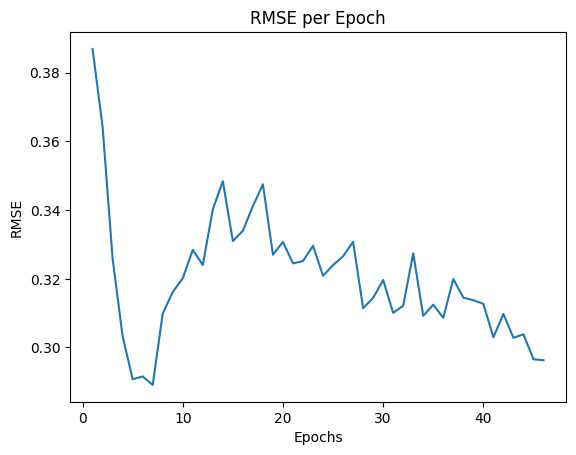

| 28        | -3.168    | 39.76     | 46.44     |
Epoch 1/12, RMSE: 0.3853
Epoch 2/12, RMSE: 0.3567
Epoch 3/12, RMSE: 0.3323
Epoch 4/12, RMSE: 0.3174
Epoch 5/12, RMSE: 0.3013
Epoch 6/12, RMSE: 0.2878
Epoch 7/12, RMSE: 0.2714
Epoch 8/12, RMSE: 0.2784
Epoch 9/12, RMSE: 0.2788
Epoch 10/12, RMSE: 0.2947
Epoch 11/12, RMSE: 0.3017
Epoch 12/12, RMSE: 0.3186


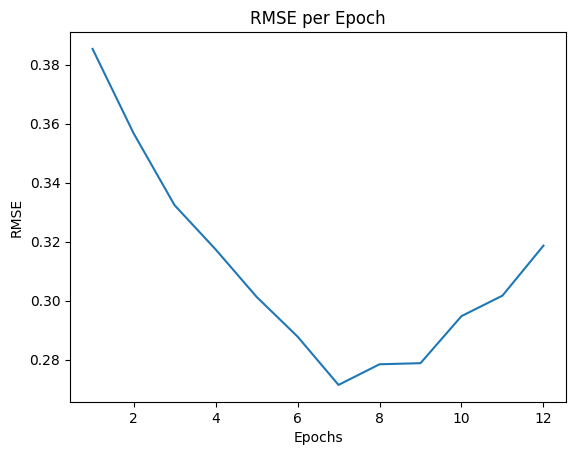

| 29        | -3.39     | 50.0      | 12.15     |
Epoch 1/37, RMSE: 0.4211
Epoch 2/37, RMSE: 0.3800
Epoch 3/37, RMSE: 0.3588
Epoch 4/37, RMSE: 0.3363
Epoch 5/37, RMSE: 0.3101
Epoch 6/37, RMSE: 0.2862
Epoch 7/37, RMSE: 0.2795
Epoch 8/37, RMSE: 0.2767
Epoch 9/37, RMSE: 0.2688
Epoch 10/37, RMSE: 0.2818
Epoch 11/37, RMSE: 0.2862
Epoch 12/37, RMSE: 0.3008
Epoch 13/37, RMSE: 0.3180
Epoch 14/37, RMSE: 0.3149
Epoch 15/37, RMSE: 0.3118
Epoch 16/37, RMSE: 0.3236
Epoch 17/37, RMSE: 0.3179
Epoch 18/37, RMSE: 0.3254
Epoch 19/37, RMSE: 0.3288
Epoch 20/37, RMSE: 0.3281
Epoch 21/37, RMSE: 0.3144
Epoch 22/37, RMSE: 0.3100
Epoch 23/37, RMSE: 0.3109
Epoch 24/37, RMSE: 0.3189
Epoch 25/37, RMSE: 0.3191
Epoch 26/37, RMSE: 0.3144
Epoch 27/37, RMSE: 0.3161
Epoch 28/37, RMSE: 0.3091
Epoch 29/37, RMSE: 0.3104
Epoch 30/37, RMSE: 0.3148
Epoch 31/37, RMSE: 0.3042
Epoch 32/37, RMSE: 0.3039
Epoch 33/37, RMSE: 0.3113
Epoch 34/37, RMSE: 0.3087
Epoch 35/37, RMSE: 0.3111
Epoch 36/37, RMSE: 0.2976
Epoch 37/37, RMSE: 0.29

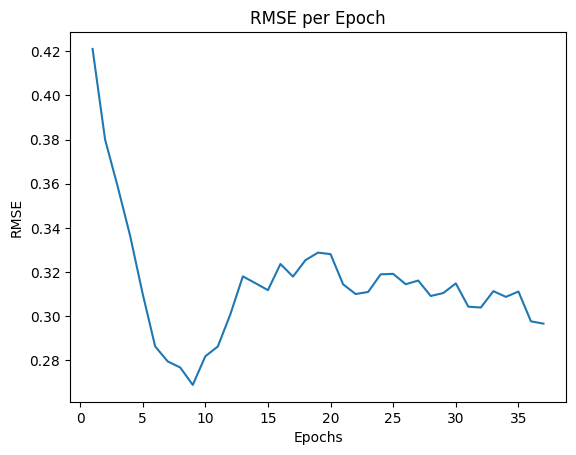

| 30        | -3.051    | 24.58     | 37.97     |
Epoch 1/25, RMSE: 0.3934
Epoch 2/25, RMSE: 0.3569
Epoch 3/25, RMSE: 0.3359
Epoch 4/25, RMSE: 0.3225
Epoch 5/25, RMSE: 0.2978
Epoch 6/25, RMSE: 0.2958
Epoch 7/25, RMSE: 0.2748
Epoch 8/25, RMSE: 0.2664
Epoch 9/25, RMSE: 0.2644
Epoch 10/25, RMSE: 0.2599
Epoch 11/25, RMSE: 0.2742
Epoch 12/25, RMSE: 0.2781
Epoch 13/25, RMSE: 0.2690
Epoch 14/25, RMSE: 0.2784
Epoch 15/25, RMSE: 0.2904
Epoch 16/25, RMSE: 0.3043
Epoch 17/25, RMSE: 0.2891
Epoch 18/25, RMSE: 0.3106
Epoch 19/25, RMSE: 0.3114
Epoch 20/25, RMSE: 0.3320
Epoch 21/25, RMSE: 0.3164
Epoch 22/25, RMSE: 0.3185
Epoch 23/25, RMSE: 0.3225
Epoch 24/25, RMSE: 0.3245
Epoch 25/25, RMSE: 0.3091


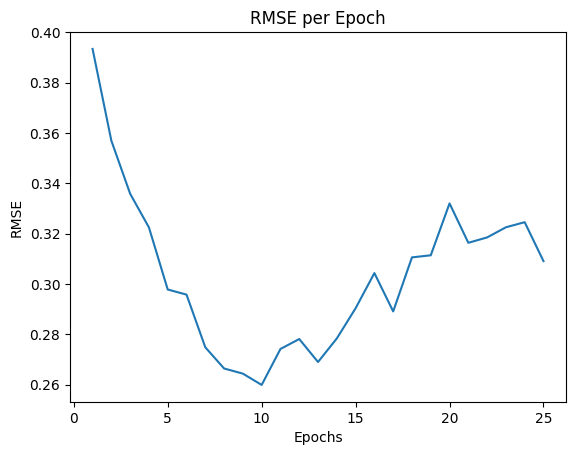

| 31        | -3.315    | 50.0      | 25.34     |
Epoch 1/10, RMSE: 0.3953
Epoch 2/10, RMSE: 0.3751
Epoch 3/10, RMSE: 0.3382
Epoch 4/10, RMSE: 0.3236
Epoch 5/10, RMSE: 0.2997
Epoch 6/10, RMSE: 0.2884
Epoch 7/10, RMSE: 0.2739
Epoch 8/10, RMSE: 0.2899
Epoch 9/10, RMSE: 0.3270
Epoch 10/10, RMSE: 0.3234


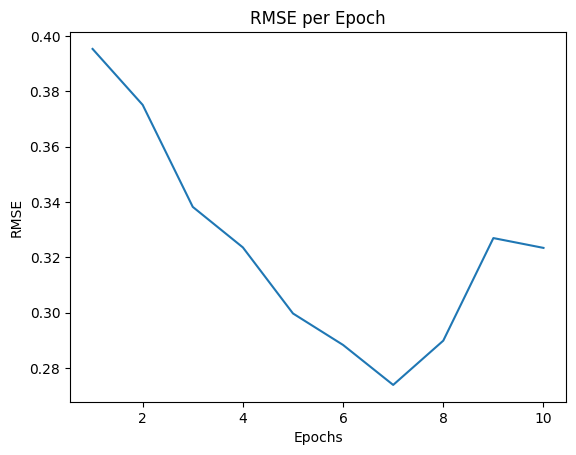

| 32        | -3.334    | 39.64     | 10.18     |
Epoch 1/32, RMSE: 0.3727
Epoch 2/32, RMSE: 0.3471
Epoch 3/32, RMSE: 0.3292
Epoch 4/32, RMSE: 0.3189
Epoch 5/32, RMSE: 0.3027
Epoch 6/32, RMSE: 0.3007
Epoch 7/32, RMSE: 0.2860
Epoch 8/32, RMSE: 0.2990
Epoch 9/32, RMSE: 0.2850
Epoch 10/32, RMSE: 0.2955
Epoch 11/32, RMSE: 0.3006
Epoch 12/32, RMSE: 0.3137
Epoch 13/32, RMSE: 0.3281
Epoch 14/32, RMSE: 0.3356
Epoch 15/32, RMSE: 0.3203
Epoch 16/32, RMSE: 0.3298
Epoch 17/32, RMSE: 0.3350
Epoch 18/32, RMSE: 0.3353
Epoch 19/32, RMSE: 0.3350
Epoch 20/32, RMSE: 0.3290
Epoch 21/32, RMSE: 0.3291
Epoch 22/32, RMSE: 0.3255
Epoch 23/32, RMSE: 0.3247
Epoch 24/32, RMSE: 0.3412
Epoch 25/32, RMSE: 0.3322
Epoch 26/32, RMSE: 0.3267
Epoch 27/32, RMSE: 0.3289
Epoch 28/32, RMSE: 0.3296
Epoch 29/32, RMSE: 0.3310
Epoch 30/32, RMSE: 0.3281
Epoch 31/32, RMSE: 0.3241
Epoch 32/32, RMSE: 0.3192


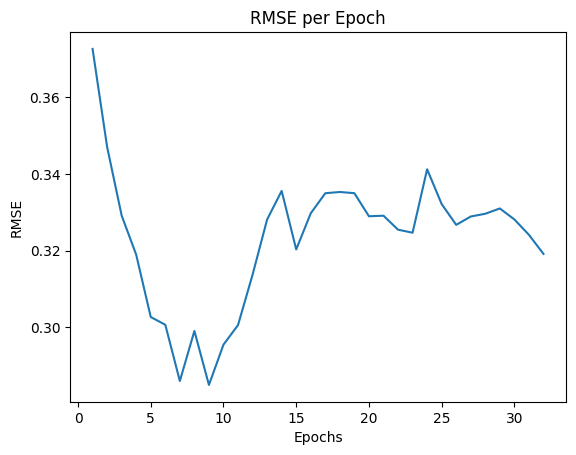

| 33        | -3.481    | 49.82     | 32.6      |
Epoch 1/27, RMSE: 0.5699
Epoch 2/27, RMSE: 0.5084
Epoch 3/27, RMSE: 0.4364
Epoch 4/27, RMSE: 0.3561
Epoch 5/27, RMSE: 0.3426
Epoch 6/27, RMSE: 0.3394
Epoch 7/27, RMSE: 0.3314
Epoch 8/27, RMSE: 0.3627
Epoch 9/27, RMSE: 0.3473
Epoch 10/27, RMSE: 0.3586
Epoch 11/27, RMSE: 0.3550
Epoch 12/27, RMSE: 0.3635
Epoch 13/27, RMSE: 0.3831
Epoch 14/27, RMSE: 0.3619
Epoch 15/27, RMSE: 0.3602
Epoch 16/27, RMSE: 0.3632
Epoch 17/27, RMSE: 0.3796
Epoch 18/27, RMSE: 0.3879
Epoch 19/27, RMSE: 0.3751
Epoch 20/27, RMSE: 0.3800
Epoch 21/27, RMSE: 0.3734
Epoch 22/27, RMSE: 0.3597
Epoch 23/27, RMSE: 0.3856
Epoch 24/27, RMSE: 0.3896
Epoch 25/27, RMSE: 0.3941
Epoch 26/27, RMSE: 0.3722
Epoch 27/27, RMSE: 0.3746


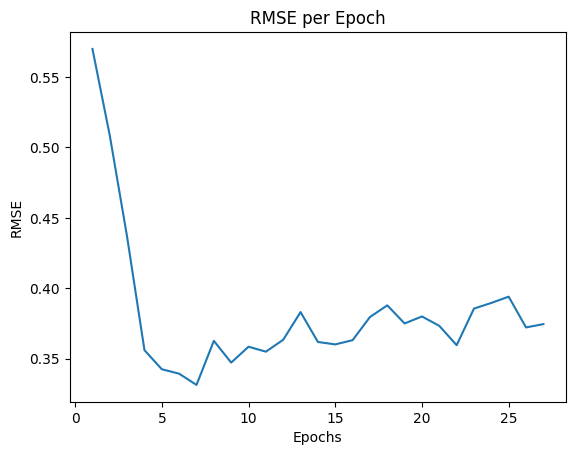

| 34        | -3.946    | 10.0      | 27.34     |
Epoch 1/25, RMSE: 0.4011
Epoch 2/25, RMSE: 0.3584
Epoch 3/25, RMSE: 0.3256
Epoch 4/25, RMSE: 0.3139
Epoch 5/25, RMSE: 0.3016
Epoch 6/25, RMSE: 0.2860
Epoch 7/25, RMSE: 0.2729
Epoch 8/25, RMSE: 0.2753
Epoch 9/25, RMSE: 0.2798
Epoch 10/25, RMSE: 0.2869
Epoch 11/25, RMSE: 0.2900
Epoch 12/25, RMSE: 0.2981
Epoch 13/25, RMSE: 0.3028
Epoch 14/25, RMSE: 0.3160
Epoch 15/25, RMSE: 0.3093
Epoch 16/25, RMSE: 0.3143
Epoch 17/25, RMSE: 0.3124
Epoch 18/25, RMSE: 0.3185
Epoch 19/25, RMSE: 0.3311
Epoch 20/25, RMSE: 0.3177
Epoch 21/25, RMSE: 0.3120
Epoch 22/25, RMSE: 0.3198
Epoch 23/25, RMSE: 0.3272
Epoch 24/25, RMSE: 0.3229
Epoch 25/25, RMSE: 0.3105


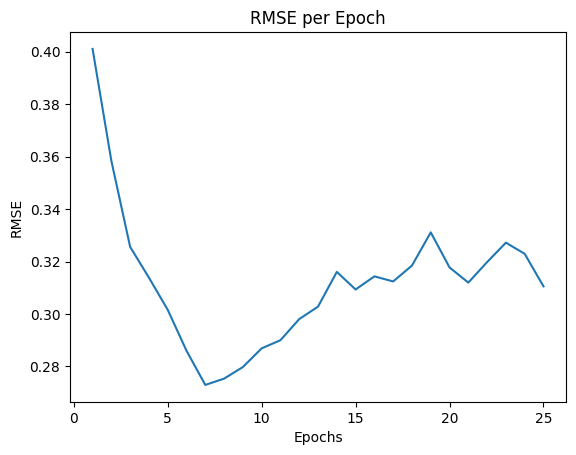

| 35        | -3.248    | 42.04     | 25.41     |
Epoch 1/19, RMSE: 0.3955
Epoch 2/19, RMSE: 0.3496
Epoch 3/19, RMSE: 0.3345
Epoch 4/19, RMSE: 0.3142
Epoch 5/19, RMSE: 0.2961
Epoch 6/19, RMSE: 0.2815
Epoch 7/19, RMSE: 0.2772
Epoch 8/19, RMSE: 0.2714
Epoch 9/19, RMSE: 0.2731
Epoch 10/19, RMSE: 0.2666
Epoch 11/19, RMSE: 0.2815
Epoch 12/19, RMSE: 0.2864
Epoch 13/19, RMSE: 0.3022
Epoch 14/19, RMSE: 0.3019
Epoch 15/19, RMSE: 0.3162
Epoch 16/19, RMSE: 0.3261
Epoch 17/19, RMSE: 0.3355
Epoch 18/19, RMSE: 0.3229
Epoch 19/19, RMSE: 0.3177


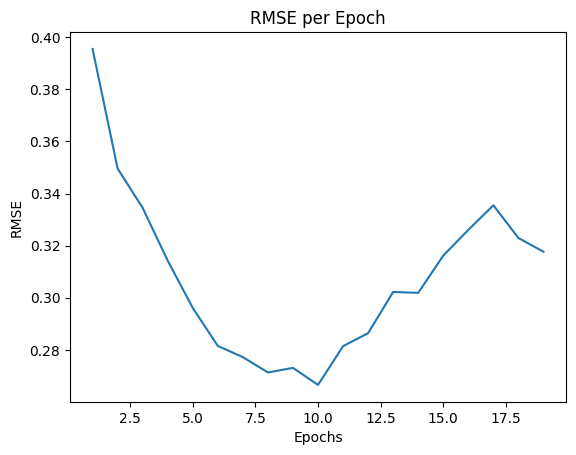

| 36        | -3.383    | 49.92     | 19.34     |
Epoch 1/21, RMSE: 0.3719
Epoch 2/21, RMSE: 0.3587
Epoch 3/21, RMSE: 0.3401
Epoch 4/21, RMSE: 0.3017
Epoch 5/21, RMSE: 0.2993
Epoch 6/21, RMSE: 0.2793
Epoch 7/21, RMSE: 0.2810
Epoch 8/21, RMSE: 0.2715
Epoch 9/21, RMSE: 0.2666
Epoch 10/21, RMSE: 0.2601
Epoch 11/21, RMSE: 0.2704
Epoch 12/21, RMSE: 0.2612
Epoch 13/21, RMSE: 0.2667
Epoch 14/21, RMSE: 0.2703
Epoch 15/21, RMSE: 0.2671
Epoch 16/21, RMSE: 0.2693
Epoch 17/21, RMSE: 0.2761
Epoch 18/21, RMSE: 0.2776
Epoch 19/21, RMSE: 0.2837
Epoch 20/21, RMSE: 0.2766
Epoch 21/21, RMSE: 0.2917


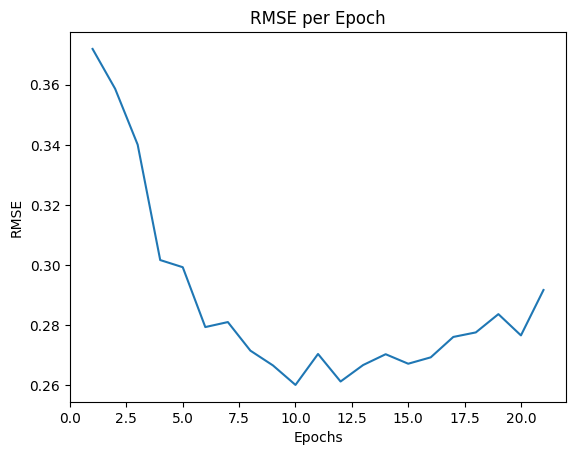

| 37        | -3.116    | 38.1      | 21.7      |
Epoch 1/26, RMSE: 0.3715
Epoch 2/26, RMSE: 0.3539
Epoch 3/26, RMSE: 0.3229
Epoch 4/26, RMSE: 0.3237
Epoch 5/26, RMSE: 0.3043
Epoch 6/26, RMSE: 0.2777
Epoch 7/26, RMSE: 0.2755
Epoch 8/26, RMSE: 0.2705
Epoch 9/26, RMSE: 0.2729
Epoch 10/26, RMSE: 0.2913
Epoch 11/26, RMSE: 0.3052
Epoch 12/26, RMSE: 0.3193
Epoch 13/26, RMSE: 0.3245
Epoch 14/26, RMSE: 0.3329
Epoch 15/26, RMSE: 0.3355
Epoch 16/26, RMSE: 0.3362
Epoch 17/26, RMSE: 0.3289
Epoch 18/26, RMSE: 0.3303
Epoch 19/26, RMSE: 0.3261
Epoch 20/26, RMSE: 0.3286
Epoch 21/26, RMSE: 0.3271
Epoch 22/26, RMSE: 0.3375
Epoch 23/26, RMSE: 0.3131
Epoch 24/26, RMSE: 0.3257
Epoch 25/26, RMSE: 0.3299
Epoch 26/26, RMSE: 0.3233


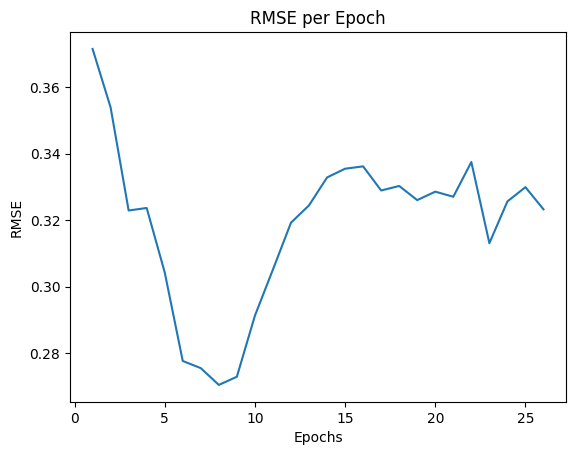

| 38        | -3.393    | 36.81     | 26.08     |
Epoch 1/17, RMSE: 0.4081
Epoch 2/17, RMSE: 0.3589
Epoch 3/17, RMSE: 0.3217
Epoch 4/17, RMSE: 0.3133
Epoch 5/17, RMSE: 0.2956
Epoch 6/17, RMSE: 0.2856
Epoch 7/17, RMSE: 0.2731
Epoch 8/17, RMSE: 0.2754
Epoch 9/17, RMSE: 0.2737
Epoch 10/17, RMSE: 0.2859
Epoch 11/17, RMSE: 0.2776
Epoch 12/17, RMSE: 0.2839
Epoch 13/17, RMSE: 0.2870
Epoch 14/17, RMSE: 0.2898
Epoch 15/17, RMSE: 0.2857
Epoch 16/17, RMSE: 0.3000
Epoch 17/17, RMSE: 0.3115


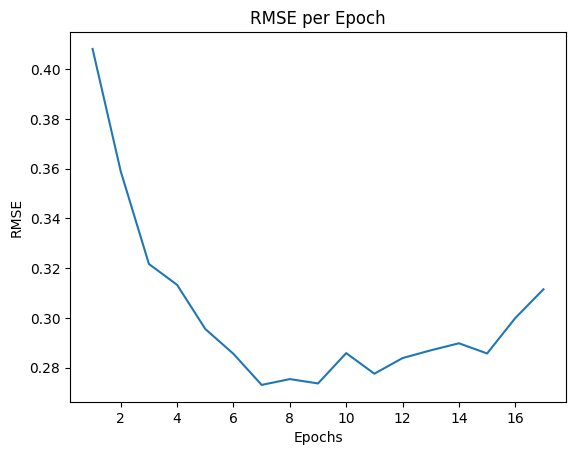

| 39        | -3.275    | 37.67     | 17.23     |
Epoch 1/49, RMSE: 0.3982
Epoch 2/49, RMSE: 0.3673
Epoch 3/49, RMSE: 0.3469
Epoch 4/49, RMSE: 0.3398
Epoch 5/49, RMSE: 0.3192
Epoch 6/49, RMSE: 0.3096
Epoch 7/49, RMSE: 0.2947
Epoch 8/49, RMSE: 0.2938
Epoch 9/49, RMSE: 0.2771
Epoch 10/49, RMSE: 0.2756
Epoch 11/49, RMSE: 0.2843
Epoch 12/49, RMSE: 0.2802
Epoch 13/49, RMSE: 0.2834
Epoch 14/49, RMSE: 0.2987
Epoch 15/49, RMSE: 0.2865
Epoch 16/49, RMSE: 0.2939
Epoch 17/49, RMSE: 0.3047
Epoch 18/49, RMSE: 0.3147
Epoch 19/49, RMSE: 0.3009
Epoch 20/49, RMSE: 0.3271
Epoch 21/49, RMSE: 0.3278
Epoch 22/49, RMSE: 0.3274
Epoch 23/49, RMSE: 0.3304
Epoch 24/49, RMSE: 0.3438
Epoch 25/49, RMSE: 0.3246
Epoch 26/49, RMSE: 0.3341
Epoch 27/49, RMSE: 0.3373
Epoch 28/49, RMSE: 0.3298
Epoch 29/49, RMSE: 0.3294
Epoch 30/49, RMSE: 0.3350
Epoch 31/49, RMSE: 0.3310
Epoch 32/49, RMSE: 0.3435
Epoch 33/49, RMSE: 0.3426
Epoch 34/49, RMSE: 0.3350
Epoch 35/49, RMSE: 0.3392
Epoch 36/49, RMSE: 0.3431
Epoch 37/49, RMSE: 0.34

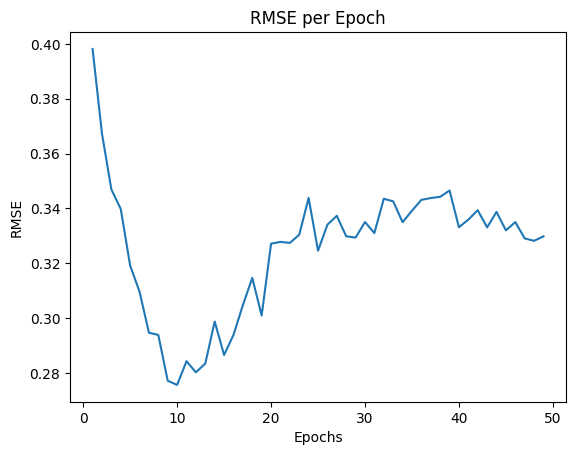

| 40        | -3.728    | 49.95     | 49.35     |
Mejores hiperparámetros: Epochs=21, Batch size=27
Epoch 1/21, RMSE: 0.4039
Epoch 2/21, RMSE: 0.3832
Epoch 3/21, RMSE: 0.3508
Epoch 4/21, RMSE: 0.3241
Epoch 5/21, RMSE: 0.3193
Epoch 6/21, RMSE: 0.3153
Epoch 7/21, RMSE: 0.2858
Epoch 8/21, RMSE: 0.2805
Epoch 9/21, RMSE: 0.2792
Epoch 10/21, RMSE: 0.2801
Epoch 11/21, RMSE: 0.2956
Epoch 12/21, RMSE: 0.3059
Epoch 13/21, RMSE: 0.3191
Epoch 14/21, RMSE: 0.3152
Epoch 15/21, RMSE: 0.3259
Epoch 16/21, RMSE: 0.3144
Epoch 17/21, RMSE: 0.3241
Epoch 18/21, RMSE: 0.3213
Epoch 19/21, RMSE: 0.3182
Epoch 20/21, RMSE: 0.3081
Epoch 21/21, RMSE: 0.3173


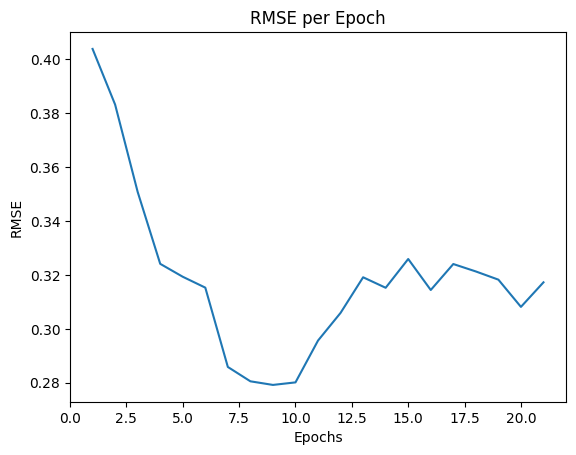

SklearnWrapper(batch_size=27, epochs=21, input_dim=8)

In [41]:
# # Definir la clase del modelo ANN con más capas y Dropout
# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# # Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.reshape(-1, 1)
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# # Definir la función de optimización
# def train_evaluate_ANN(epochs, batch_size):
#     input_dim = X_train_grecipe.shape[1]
#     ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=int(epochs), batch_size=int(batch_size))
#     ann_wrapper.fit(X_train_grecipe, y_train_grecipe)
    
#     y_pred = ann_wrapper.predict(X_test_grecipe)
#     mse = mean_squared_error(y_test_grecipe, y_pred)
#     rmse = np.sqrt(mse)
#     return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# # Rango de hiperparámetros para la optimización bayesiana
# pbounds = {
#     'epochs': (10, 50),
#     'batch_size': (10, 50)
# }

# # Realizar la optimización bayesiana
# optimizer = BayesianOptimization(
#     f=train_evaluate_ANN,
#     pbounds=pbounds,
#     random_state=42
# )

# optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores hiperparámetros
# best_params = optimizer.max['params']
# best_epochs = int(best_params['epochs'])
# best_batch_size = int(best_params['batch_size'])

# print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}')

# # Asegúrate de definir input_dim aquí
# input_dim = X_train_grecipe.shape[1]

# # Entrenar y evaluar el modelo final con los mejores hiperparámetros
# ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=best_epochs, batch_size=best_batch_size)
# ann_wrapper.fit(X_train_grecipe, y_train_grecipe)


In [15]:
# # Guardar el modelo entrenado
# joblib.dump(ann_wrapper, 'ann_model_grecipe1.pkl')

# # Cargar el modelo entrenado
# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# # Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.reshape(-1, 1)
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# if __name__ == "__main__":
#     # Cargar el modelo entrenado
#     loaded_model_ann_grecipe = joblib.load('ann_model_grecipe.pkl')

#     # Predecir con el modelo entrenado
#     y_pred_ann_grecipe = loaded_model_ann_grecipe.predict(X_test_grecipe)
    
#     # Calcular las métricas
#     mse_ann_grecipe = mean_squared_error(y_test_grecipe, y_pred_ann_grecipe)
#     rmse_ann_grecipe = np.sqrt(mse_ann_grecipe)
#     mae_ann_grecipe = mean_absolute_error(y_test_grecipe, y_pred_ann_grecipe)
#     r2_ann_grecipe = r2_score(y_test_grecipe, y_pred_ann_grecipe)
    
#     # Imprimier las métricas
#     print(f"Mean Squared Error (MSE): {mse_ann_grecipe:.5f}")
#     print(f"Root Mean Squared Error (RMSE): {rmse_ann_grecipe:.5f}")
#     print(f"Mean Absolute Error (MAE): {mae_ann_grecipe:.5f}")
#     print(f"R-squared (R^2): {r2_ann_grecipe:.5f}")

Mean Squared Error (MSE): 10.43402
Root Mean Squared Error (RMSE): 3.23017
Mean Absolute Error (MAE): 2.59775
R-squared (R^2): 0.90419


In [239]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ann_grecipe = pd.DataFrame(y_pred_ann_grecipe, columns=['pred_ann_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_ann_grecipe.to_csv('y_pred_ann_grecipe.csv', index=False)

### Desarrollo y ajuste de un modelo **XGBoost** en GRecipe

In [190]:
# Definición de la función de validación cruzada
def xgb_cv(n_estimators, max_depth, learning_rate, subsample, colsample_bytree, gamma, min_child_weight):
    model = XGBRegressor(
        n_estimators=int(n_estimators), 
        max_depth=int(max_depth), 
        learning_rate=learning_rate, 
        subsample=subsample, 
        colsample_bytree=colsample_bytree, 
        gamma=gamma, 
        min_child_weight=min_child_weight, 
        objective='reg:squarederror',
        n_jobs=-1
    )
    model.fit(X_train_grecipe, y_train_grecipe)
    y_pred = model.predict(X_test_grecipe)
    return -mean_squared_error(y_test_grecipe, y_pred)

# Optimización bayesiana para XGBoost
xgb_optimizer = BayesianOptimization(
    f=xgb_cv,
    pbounds={
        'n_estimators': (10, 200),
        'max_depth': (1, 20),
        'learning_rate': (0.01, 0.3),
        'subsample': (0.5, 1.0),
        'colsample_bytree': (0.5, 1.0),
        'gamma': (0, 5),
        'min_child_weight': (1, 10)
    },
    random_state=42
)

xgb_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para XGBoost
best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
best_learning_rate = xgb_optimizer.max['params']['learning_rate']
best_subsample = xgb_optimizer.max['params']['subsample']
best_colsample_bytree = xgb_optimizer.max['params']['colsample_bytree']
best_gamma = xgb_optimizer.max['params']['gamma']
best_min_child_weight = xgb_optimizer.max['params']['min_child_weight']

# Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
xgb_model_grecipe = XGBRegressor(
    n_estimators=best_n_estimators, 
    max_depth=best_max_depth, 
    learning_rate=best_learning_rate, 
    subsample=best_subsample, 
    colsample_bytree=best_colsample_bytree, 
    gamma=best_gamma, 
    min_child_weight=best_min_child_weight, 
    objective='reg:squarederror',
    n_jobs=-1
)
xgb_model_grecipe.fit(X_train_grecipe, y_train_grecipe)


|   iter    |  target   | colsam... |   gamma   | learni... | max_depth | min_ch... | n_esti... | subsample |
-------------------------------------------------------------------------------------------------------------
| 1         | -6.659    | 0.6873    | 4.754     | 0.2223    | 12.37     | 2.404     | 39.64     | 0.529     |
| 2         | -11.58    | 0.9331    | 3.006     | 0.2153    | 1.391     | 9.729     | 168.2     | 0.6062    |
| 3         | -6.335    | 0.5909    | 0.917     | 0.09823   | 10.97     | 4.888     | 65.33     | 0.8059    |
| 4         | -6.254    | 0.5697    | 1.461     | 0.1162    | 9.665     | 8.067     | 47.94     | 0.7571    |
| 5         | -6.247    | 0.7962    | 0.2323    | 0.1862    | 4.24      | 1.585     | 190.3     | 0.9828    |
| 6         | -15.41    | 0.9042    | 1.523     | 0.03832   | 14.0      | 4.961     | 33.19     | 0.7476    |
| 7         | -6.774    | 0.5172    | 4.547     | 0.08505   | 13.59     | 3.805     | 108.8     | 0.7734    |
| 8       

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=1.0, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=2.3442177433879685, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.3, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=8, max_leaves=None,
             min_child_weight=6.99562852217798, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=54,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [191]:
print(f"n_estimators: {best_n_estimators}")
print(f"max_depth: {best_max_depth}")
print(f"learning_rate: {best_learning_rate}")
print(f"subsample: {best_subsample}")
print(f"colsample_bytree: {best_colsample_bytree}")
print(f"gamma: {best_gamma}")
print(f"min_child_weight: {best_min_child_weight}")

n_estimators: 54
max_depth: 8
learning_rate: 0.3
subsample: 0.5
colsample_bytree: 1.0
gamma: 2.3442177433879685
min_child_weight: 6.99562852217798


In [155]:
# def xgb_cv(n_estimators, max_depth, learning_rate):
#     model = XGBRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth), learning_rate=learning_rate, objective='reg:squarederror')
#     model.fit(X_train_grecipe, y_train_grecipe)
#     y_pred = model.predict(X_test_grecipe)
#     return -mean_squared_error(y_test_grecipe, y_pred)

# # Optimización bayesiana para XGBoost
# xgb_optimizer = BayesianOptimization(
#     f=xgb_cv,
#     pbounds={
#         'n_estimators': (10, 200),
#         'max_depth': (1, 20),
#         'learning_rate': (0.01, 0.3)
#     },
#     random_state=42
# )

# xgb_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para XGBoost
# best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
# best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
# best_learning_rate = xgb_optimizer.max['params']['learning_rate']

# # Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
# xgb_model_grecipe = XGBRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth, learning_rate=best_learning_rate, objective='reg:squarederror')
# xgb_model_grecipe.fit(X_train_grecipe, y_train_grecipe)

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
| 1         | -7.817    | 0.1186    | 19.06     | 149.1     |
| 2         | -7.159    | 0.1836    | 3.964     | 39.64     |
| 3         | -8.286    | 0.02684   | 17.46     | 124.2     |
| 4         | -11.58    | 0.2153    | 1.391     | 194.3     |
| 5         | -6.249    | 0.2514    | 5.034     | 44.55     |
| 6         | -5.726    | 0.06319   | 6.781     | 109.7     |
| 7         | -6.098    | 0.1353    | 6.533     | 126.3     |
| 8         | -5.58     | 0.05045   | 6.551     | 79.61     |
| 9         | -7.175    | 0.1423    | 15.92     | 47.94     |
| 10        | -6.702    | 0.1591    | 12.26     | 18.83     |
| 11        | -6.057    | 0.06435   | 5.959     | 93.8      |
| 12        | -6.28     | 0.2208    | 5.131     | 44.59     |
| 13        | -6.481    | 0.1041    | 12.49     | 85.67     |
| 14        | -11.94    | 0.2246    | 1.03      | 117.1     |
| 15    

In [192]:
# Guardar el modelo entrenado
joblib.dump(xgb_model_grecipe, 'xgb_model_grecipe.pkl')

# Cargar el modelo entrenado
loaded_model_xgb_grecipe = joblib.load('xgb_model_grecipe.pkl')
loaded_model_xgb_grecipe

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=1.0, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=2.3442177433879685, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.3, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=8, max_leaves=None,
             min_child_weight=6.99562852217798, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=54,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [194]:
# Evaluar el modelo
y_pred_xgb_grecipe = loaded_model_xgb_grecipe.predict(X_test_grecipe)
xgb_mse_grecipe = mean_squared_error(y_test_grecipe, y_pred_xgb_grecipe)

# Calcular las métricas
mse_xgb_grecipe = mean_squared_error(y_test_grecipe, y_pred_xgb_grecipe)
rmse_xgb_grecipe = np.sqrt(mse_xgb_grecipe)
mae_xgb_grecipe = mean_absolute_error(y_test_grecipe, y_pred_xgb_grecipe)
r2_xgb_grecipe = r2_score(y_test_grecipe, y_pred_xgb_grecipe)

# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_xgb_grecipe:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_xgb_grecipe:.5f}")
print(f"Mean Absolute Error (MAE): {mae_xgb_grecipe:.5f}")
print(f"R-squared (R^2): {r2_xgb_grecipe:.5f}")

Mean Squared Error (MSE): 5.79296
Root Mean Squared Error (RMSE): 2.40686
Mean Absolute Error (MAE): 1.60918
R-squared (R^2): 0.94680


In [79]:
# Guardamos las predicciones que se necesitarán más adelante
# Convertir las predicciones a un DataFrame de pandas
y_pred_xgb_grecipe = pd.DataFrame(y_pred_xgb_grecipe, columns=['pred_xgb_grecipe'])

# Guardar el DataFrame como un archivo CSV
y_pred_xgb_grecipe.to_csv('y_pred_xgb_grecipe.csv', index=False)

### Desarrollo y ajuste de un modelo **KNN** en GRecipe

In [210]:
# Normalizar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_grecipe)
X_test_scaled = scaler.transform(X_test_grecipe)

# Reducir dimensionalidad con PCA
pca = PCA(n_components=0.95)  # Retener 95% de la varianza
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Definir el modelo KNN
knn = KNeighborsRegressor()

# Definir los hiperparámetros a optimizar
param_grid = {
    'n_neighbors': (1, 30),
    'leaf_size': (10, 50),
    'p': (1, 2),  # 1 para Manhattan, 2 para Euclídea
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski']
}

# Configurar la búsqueda bayesiana
opt = BayesSearchCV(
    knn,
    param_grid,
    n_iter=50,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=1
)

# Ejecutar la búsqueda bayesiana
opt.fit(X_train_pca, y_train_grecipe)

# Imprimir los mejores hiperparámetros encontrados
print("Best Hyperparameters: ", opt.best_params_)

# Entrenar el modelo con los mejores hiperparámetros
best_knn_grecipe = opt.best_estimator_
best_knn_grecipe.fit(X_train_pca, y_train_grecipe)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(algorithm='ball_tree', leaf_size=33, n_neighbors=30)

In [211]:
# Imprimir los mejores hiperparámetros encontrados uno por uno
best_params = opt.best_params_
print("Best Hyperparameters:")
for param, value in best_params.items():
    print(f"{param}: {value}")

Best Hyperparameters:
algorithm: ball_tree
leaf_size: 33
metric: minkowski
n_neighbors: 30
p: 2
weights: uniform


In [18]:
# # Normalizar los datos
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_grecipe)
# X_test_scaled = scaler.transform(X_test_grecipe)

# # Reducir dimensionalidad con PCA
# pca = PCA(n_components=0.95)  # Retener 95% de la varianza
# X_train_pca = pca.fit_transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # Definir el modelo KNN
# knn = KNeighborsRegressor()

# # Definir los hiperparámetros a optimizar
# param_grid = {
#     'n_neighbors': (1, 30),
#     'leaf_size': (10, 50),
#     'p': (1, 2)  # 1 para Manhattan, 2 para Euclídea
# }

# # Configurar la búsqueda bayesiana
# opt = BayesSearchCV(
#     knn,
#     param_grid,
#     n_iter=50,
#     cv=5,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=1
# )

# # Ejecutar la búsqueda bayesiana
# opt.fit(X_train_pca, y_train_grecipe)

# # Imprimir los mejores hiperparámetros encontrados
# print("Best Hyperparameters: ", opt.best_params_)

# # Entrenar el modelo con los mejores hiperparámetros
# best_knn_grecipe = opt.best_estimator_
# best_knn_grecipe.fit(X_train_pca, y_train_grecipe)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=10, n_neighbors=30)

In [212]:
# Guardar el modelo entrenado
joblib.dump(best_knn_grecipe, 'knn_model_grecipe.pkl')

# Cargar el modelo entrenado
loaded_model_knn_grecipe = joblib.load('knn_model_grecipe.pkl')
loaded_model_knn_grecipe

KNeighborsRegressor(algorithm='ball_tree', leaf_size=33, n_neighbors=30)

In [213]:
# Predecir y evaluar el modelo
y_pred_knn_grecipe = loaded_model_knn_grecipe.predict(X_test_pca)

# Calcular las métricas
mae_knn_grecipe = mean_absolute_error(y_test_grecipe, y_pred_knn_grecipe)
mse_knn_grecipe = mean_squared_error(y_test_grecipe, y_pred_knn_grecipe)
rmse_knn_grecipe = np.sqrt(mse_knn_grecipe)
r2_knn_grecipe = r2_score(y_test_grecipe, y_pred_knn_grecipe)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_knn_grecipe:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_knn_grecipe:.5f}")
print(f"Mean Absolute Error (MAE): {mae_knn_grecipe:.5f}")
print(f"R-squared (R^2): {r2_knn_grecipe:.5f}")

Mean Squared Error (MSE): 6.43625
Root Mean Squared Error (RMSE): 2.53698
Mean Absolute Error (MAE): 1.64312
R-squared (R^2): 0.94090


In [214]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_knn_grecipe = pd.DataFrame(y_pred_knn_grecipe, columns=['pred_knn_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_knn_grecipe.to_csv('y_pred_knn_grecipe.csv', index=False)

### **Ensamble Heterogéneo** con todos los modelos

Epoch 1/45, RMSE: 0.3937
Epoch 2/45, RMSE: 0.3816
Epoch 3/45, RMSE: 0.3750
Epoch 4/45, RMSE: 0.3430
Epoch 5/45, RMSE: 0.3089
Epoch 6/45, RMSE: 0.3052
Epoch 7/45, RMSE: 0.2904
Epoch 8/45, RMSE: 0.2808
Epoch 9/45, RMSE: 0.2779
Epoch 10/45, RMSE: 0.2684
Epoch 11/45, RMSE: 0.2735
Epoch 12/45, RMSE: 0.2662
Epoch 13/45, RMSE: 0.2720
Epoch 14/45, RMSE: 0.2882
Epoch 15/45, RMSE: 0.2665
Epoch 16/45, RMSE: 0.2939
Epoch 17/45, RMSE: 0.3040
Epoch 18/45, RMSE: 0.2876
Epoch 19/45, RMSE: 0.2801
Epoch 20/45, RMSE: 0.3708
Epoch 21/45, RMSE: 0.3547
Epoch 22/45, RMSE: 0.2646
Epoch 23/45, RMSE: 0.3056
Epoch 24/45, RMSE: 0.2848
Epoch 25/45, RMSE: 0.3262
Epoch 26/45, RMSE: 0.2766
Epoch 27/45, RMSE: 0.3432
Epoch 28/45, RMSE: 0.2892
Epoch 29/45, RMSE: 0.2905
Epoch 30/45, RMSE: 0.2670
Epoch 31/45, RMSE: 0.2930
Epoch 32/45, RMSE: 0.3031
Early stopping at epoch 32


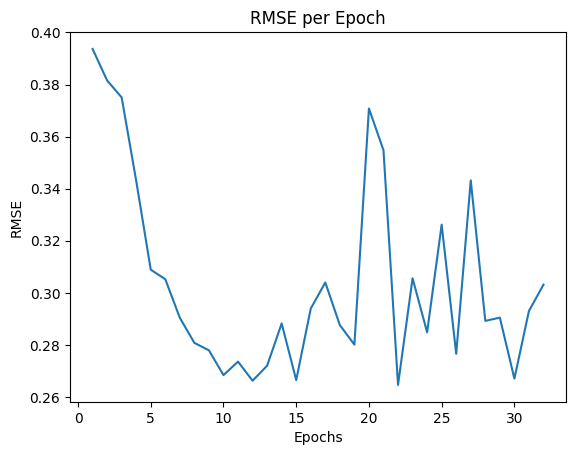

VotingRegressor(estimators=[('lasso',
                             Pipeline(steps=[('scaler',
                                              StandardScaler(with_mean=False)),
                                             ('lasso',
                                              Lasso(alpha=0.021563909801506645,
                                                    max_iter=849,
                                                    tol=0.01819067847103799))])),
                            ('rf',
                             RandomForestRegressor(bootstrap=False,
                                                   max_depth=11,
                                                   max_features=0.529227702844746,
                                                   min_samples_leaf=6,
                                                   min_samples_split=7,
                                                   n_estimators=56)),
                            ('ann',
                             SklearnWrapper(bat...
                                          learning_rate=0.3, max_bin=None,
                                          max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=8,
                                          max_leaves=None,
                                          min_child_weight=6.99562852217798,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=54,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...)),
                            ('knn',
                             KNeighborsRegressor(algorithm='ball_tree',
                                                 leaf_size=33,
                                                 n_neighbors=30))])

In [240]:
ensemble_model_grecipe = VotingRegressor(estimators=[
    ('lasso', loaded_model_lasso_grecipe),
    ('rf', loaded_model_rf_grecipe),
    ('ann', loaded_model_ann_grecipe),
    ('xgb', loaded_model_xgb_grecipe),
    ('knn', loaded_model_knn_grecipe)
])

# Entrenar el modelo ensemble
ensemble_model_grecipe.fit(X_train_grecipe, y_train_grecipe)

In [241]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_grecipe, 'ensemble_model_grecipe.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_grecipe = joblib.load('ensemble_model_grecipe.pkl')

In [242]:
# Evaluar el modelo ensemble
y_pred_ensamble_grecipe = loaded_model_esemble_grecipe.predict(X_test_grecipe)

In [244]:
# Méttricas
mae_ensamble_grecipe = mean_absolute_error(y_test_grecipe, y_pred_ensamble_grecipe) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_grecipe = mean_squared_error(y_test_grecipe, y_pred_ensamble_grecipe) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_grecipe = np.sqrt(mse_ensamble_grecipe) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_grecipe = r2_score(y_test_grecipe, y_pred_ensamble_grecipe) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Cuadrático Medio (MSE): {mse_ensamble_grecipe:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_grecipe:.5f}")
print(f"Error Medio Absoluto (MAE): {mae_ensamble_grecipe:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_grecipe:.5f}")

Error Cuadrático Medio (MSE): 8.64010
Raíz del Error Cuadrático Medio (RMSE): 2.93941
Error Medio Absoluto (MAE): 2.20414
Coeficiente de Determinación (R^2): 0.92066


In [319]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ensamble_grecipe = pd.DataFrame(y_pred_ensamble_grecipe, columns=['pred_ensamble_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_ensamble_grecipe.to_csv('y_pred_ensamble_grecipe.csv', index=False)

Los modelos con mejor rendimiento fueron Random forest y XGBoost. 

### **Ensamble Heterogéneo** con los modelos seleccionados

In [313]:
ensemble_model_grecipe_select = VotingRegressor(estimators=[
    #('lasso', loaded_model_lasso_grecipe),
    ('rf', loaded_model_rf_grecipe),
    #('ann', loaded_model_ann_grecipe),
    ('xgb', loaded_model_xgb_grecipe),
    #('knn', loaded_model_knn_grecipe)
])

# Entrenar el modelo ensemble
ensemble_model_grecipe_select.fit(X_train_grecipe, y_train_grecipe)

VotingRegressor(estimators=[('rf',
                             RandomForestRegressor(bootstrap=False,
                                                   max_depth=11,
                                                   max_features=0.529227702844746,
                                                   min_samples_leaf=6,
                                                   min_samples_split=7,
                                                   n_estimators=56)),
                            ('xgb',
                             XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=1.0, device=None,
                                          early_stopping_rounds=None,
                                          enable_c...
                                          grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=0.3, max_bin=None,
                                          max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=8,
                                          max_leaves=None,
                                          min_child_weight=6.99562852217798,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=54,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...))])

In [314]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_grecipe_select, 'ensemble_model_grecipe_select.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_grecipe = joblib.load('ensemble_model_grecipe_select.pkl')

In [315]:
# Evaluar el modelo ensemble
y_pred_ensamble_grecipe_select = ensemble_model_grecipe_select.predict(X_test_grecipe)

In [317]:
# Méttricas
mae_ensamble_grecipe_select = mean_absolute_error(y_test_grecipe, y_pred_ensamble_grecipe_select) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_grecipe_select = mean_squared_error(y_test_grecipe, y_pred_ensamble_grecipe_select) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_grecipe_select = np.sqrt(mse_ensamble_grecipe_select) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_grecipe_select = r2_score(y_test_grecipe, y_pred_ensamble_grecipe_select) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Cuadrático Medio (MSE): {mse_ensamble_grecipe_select:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_grecipe_select:.5f}")
print(f"Error Medio Absoluto (MAE): {mae_ensamble_grecipe_select:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_grecipe_select:.5f}")

Error Cuadrático Medio (MSE): 5.42293
Raíz del Error Cuadrático Medio (RMSE): 2.32872
Error Medio Absoluto (MAE): 1.51025
Coeficiente de Determinación (R^2): 0.95020


In [318]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ensamble_select_grecipe = pd.DataFrame(y_pred_ensamble_grecipe_select, columns=['pred_ensamble_select_grecipe'])

# Guardar el DataFrame como un archivo CSV
pred_ensamble_select_grecipe.to_csv('y_pred_ensamble_grecipe_select.csv', index=False)

### Modelos y métricas con ensambles

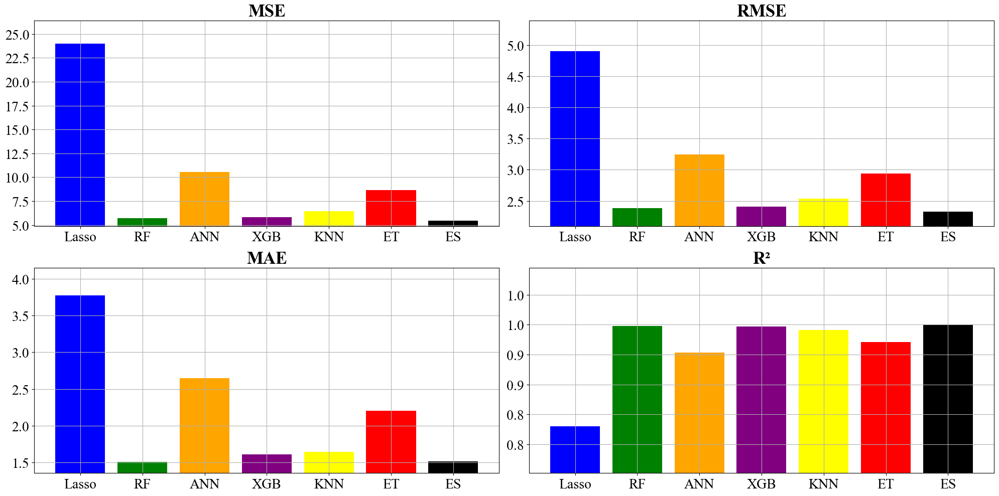

In [326]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'RF', 'ANN', 'XGB', 'KNN', 'ET', 'ES']
scores = {
    'Lasso': [mse_lasso_grecipe, rmse_lasso_grecipe, mae_lasso_grecipe, r2_lasso_grecipe],
    'RF': [mse_rf_grecipe, rmse_rf_grecipe, mae_rf_grecipe, r2_rf_grecipe],
    'ANN': [mse_ann_grecipe, rmse_ann_grecipe, mae_ann_grecipe, r2_ann_grecipe],
    'XGB': [mse_xgb_grecipe, rmse_xgb_grecipe, mae_xgb_grecipe, r2_xgb_grecipe],
    'KNN': [mse_knn_grecipe, rmse_knn_grecipe, mae_knn_grecipe, r2_knn_grecipe], 
    'ET': [mse_ensamble_grecipe, rmse_ensamble_grecipe, mae_ensamble_grecipe, r2_ensamble_grecipe],
    'ES': [mse_ensamble_grecipe_select, rmse_ensamble_grecipe_select, mae_ensamble_grecipe_select, r2_ensamble_grecipe_select]
}

# Subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 10))  # Ajustar tamaño para una mejor visualización

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs.flat[i]  # Acceder correctamente a cada subtrama
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'orange', 'purple', 'yellow', 'red', 'black'])
    ax.set_title(f'{metric}', fontsize=25, fontweight='bold')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=0, fontsize=20)
    y_ticks = ax.get_yticks()
    ax.set_yticklabels([f'{y_tick:.1f}' for y_tick in y_ticks], fontsize=20)
    ax.grid(True)

plt.tight_layout()

# Guardar la figura completa en un archivo
plt.savefig('model_performance_metrics_grecipe.png', dpi=300)

plt.show()


### Comparación de modelos en el batch 2

In [16]:
# Cargar las predicciones
load_pred_lasso_grecipe = pd.read_csv(r'y_pred_lasso_grecipe.csv')
load_pred_rf_grecipe = pd.read_csv(r'y_pred_rf_grecipe.csv')
load_pred_ann_grecipe = pd.read_csv(r'y_pred_ann_grecipe.csv')
load_pred_xgb_grecipe = pd.read_csv(r'y_pred_xgb_grecipe.csv')
load_pred_knn_grecipe = pd.read_csv(r'y_pred_knn_grecipe.csv')
load_pred_ensamble_select_grecipe = pd.read_csv(r'y_pred_ensamble_grecipe_select.csv')

In [17]:
# se hace un reset a los índices de grecipe_test para poder concatenar 
grecipe_test_reset = grecipe_test.reset_index(drop=True)
# concatenar 
data_select_pred_grecipe = pd.concat([grecipe_test_reset, load_pred_lasso_grecipe, load_pred_rf_grecipe, load_pred_ann_grecipe,
                                     load_pred_xgb_grecipe, load_pred_knn_grecipe, load_pred_ensamble_select_grecipe], axis=1).reset_index(drop=True)

In [18]:
# Batch 2
batch_2_select = data_select_pred_grecipe[data_select_pred_grecipe['Batch'] == 2]

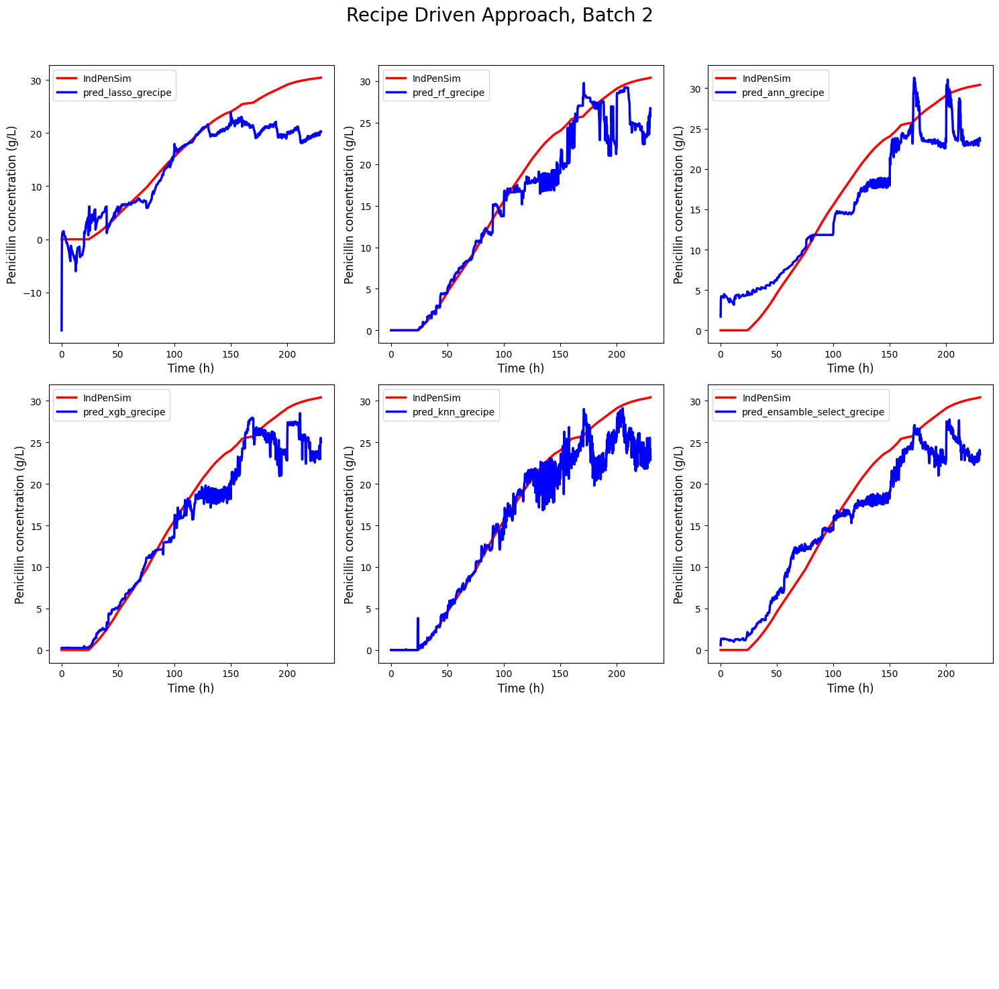

In [19]:
# Predicciones
pred_columns = [
    'pred_lasso_grecipe', 'pred_rf_grecipe', 'pred_ann_grecipe',
    'pred_xgb_grecipe', 'pred_knn_grecipe', 'pred_ensamble_select_grecipe'
]

# Series de pandas a arrays de NumPy
x = batch_2_select['Time (h)'].to_numpy()
y1 = batch_2_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Titulo
fig.suptitle("Recipe Driven Approach, Batch 2", fontsize=20)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_2_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=pred_columns[i], linewidth=2.5)
        #ax.set_title(pred_columns[i], fontsize=15)
        ax.set_xlabel("Time (h)", fontsize=12)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=12)
        ax.tick_params(axis='both', which='major', labelsize=10)
        ax.legend(fontsize=10)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
plt.show()

#### Graficamos los modelos seleccionados y el ensamble

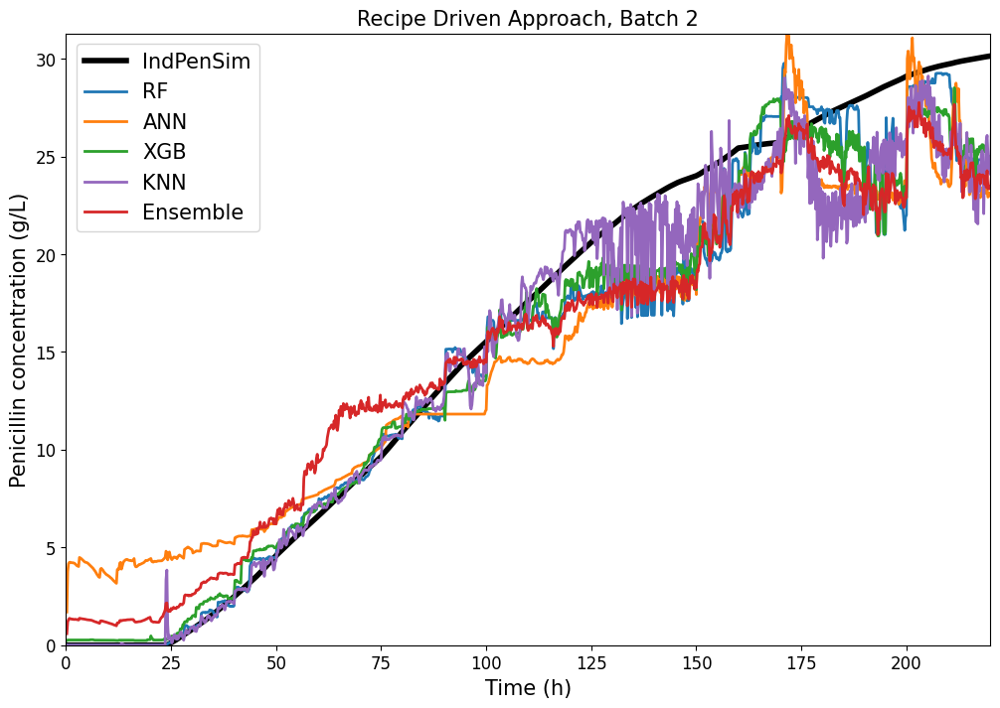

In [20]:
# Predicciones
pred_columns = [
    'pred_rf_grecipe', 'pred_ann_grecipe',
    'pred_xgb_grecipe', 'pred_knn_grecipe', 'pred_ensamble_select_grecipe'
]

# Colores
colors = {
    'IndPenSim': 'black',
    #'pred_lasso_grecipe': 'blue',
    'pred_rf_grecipe': '#1f77b4',
    'pred_ann_grecipe': '#ff7f0e',
    'pred_xgb_grecipe': '#2ca02c',
    'pred_knn_grecipe': '#9467bd',
    'pred_ensamble_select_grecipe': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_rf_grecipe': 'RF',
    'pred_ann_grecipe': 'ANN',
    'pred_xgb_grecipe': 'XGB',
    'pred_knn_grecipe': 'KNN',
    'pred_ensamble_select_grecipe': 'Ensemble'
}

# Series de pandas a arrays de NumPy
x = batch_2_select['Time (h)'].to_numpy()
y1 = batch_2_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_2_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_2_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Recipe Driven Approach, Batch 2", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

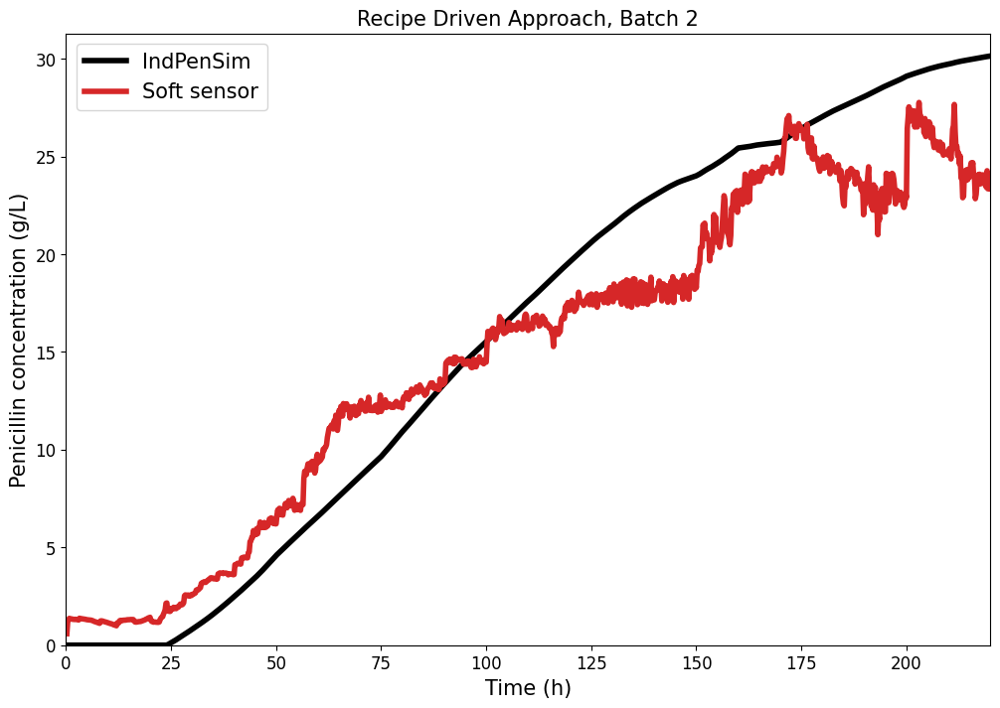

In [21]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_grecipe': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_2_select['Time (h)'].to_numpy()
y1 = batch_2_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_2_select['pred_ensamble_select_grecipe'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_grecipe'])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_2_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Recipe Driven Approach, Batch 2", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

### Comparación de modelos en el batch 15

In [327]:
# Cargar las predicciones
load_pred_lasso_grecipe = pd.read_csv(r'y_pred_lasso_grecipe.csv')
load_pred_rf_grecipe = pd.read_csv(r'y_pred_rf_grecipe.csv')
load_pred_ann_grecipe = pd.read_csv(r'y_pred_ann_grecipe.csv')
load_pred_xgb_grecipe = pd.read_csv(r'y_pred_xgb_grecipe.csv')
load_pred_knn_grecipe = pd.read_csv(r'y_pred_knn_grecipe.csv')
load_pred_ensamble_select_grecipe = pd.read_csv(r'y_pred_ensamble_grecipe_select.csv')

In [328]:
# se hace un reset a los índices de grecipe_test para poder concatenar 
grecipe_test_reset = grecipe_test.reset_index(drop=True)
# concatenar 
data_select_pred_grecipe = pd.concat([grecipe_test_reset, load_pred_lasso_grecipe, load_pred_rf_grecipe, load_pred_ann_grecipe,
                                     load_pred_xgb_grecipe, load_pred_knn_grecipe, load_pred_ensamble_select_grecipe], axis=1).reset_index(drop=True)

In [329]:
# Batch 15
batch_15_select = data_select_pred_grecipe[data_select_pred_grecipe['Batch'] == 15]

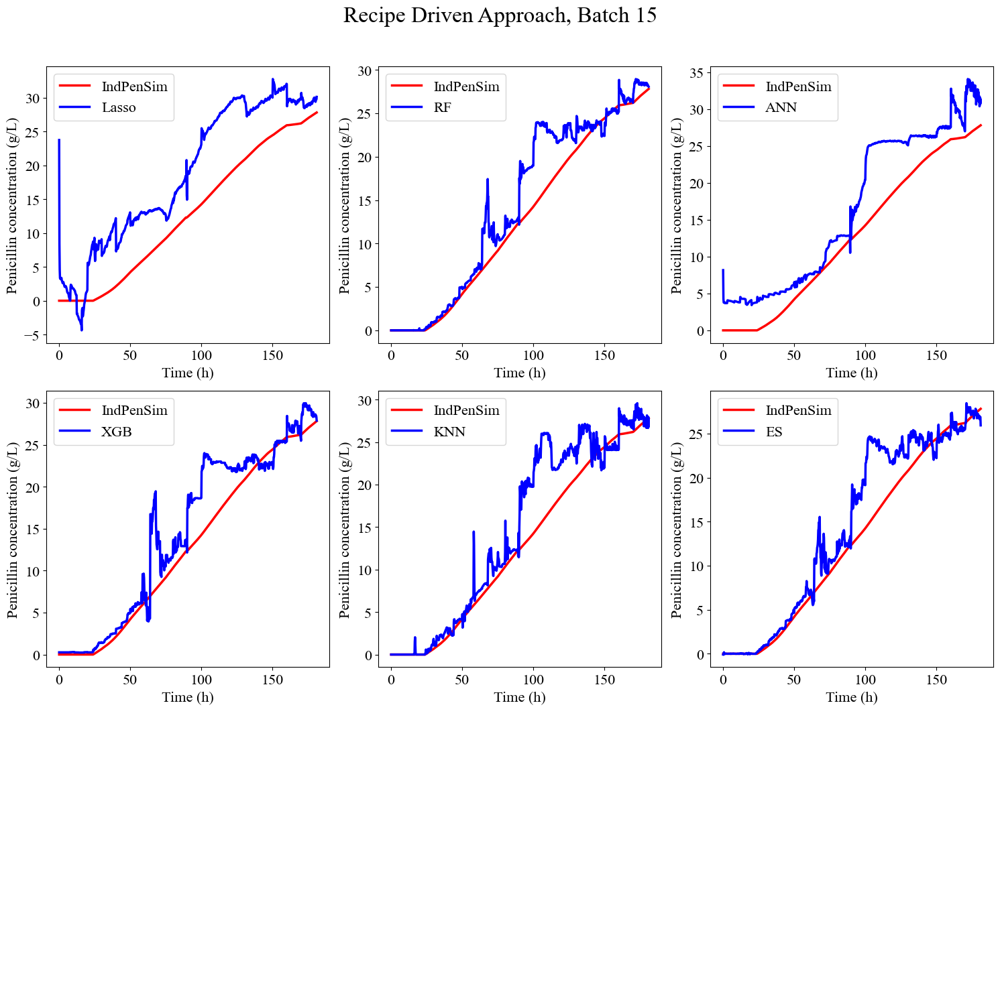

In [331]:
# Configurar matplotlib para usar Times New Roman
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = ['Times New Roman']

# Predicciones
pred_columns = [
    'pred_lasso_grecipe', 'pred_rf_grecipe', 'pred_ann_grecipe',
    'pred_xgb_grecipe', 'pred_knn_grecipe', 'pred_ensamble_select_grecipe'
]

# Nuevos nombres para las columnas
column_names = {
    'pred_lasso_grecipe': 'Lasso',
    'pred_rf_grecipe': 'RF',
    'pred_ann_grecipe': 'ANN',
    'pred_xgb_grecipe': 'XGB',
    'pred_knn_grecipe': 'KNN',
    'pred_ensamble_select_grecipe': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_15_select['Time (h)'].to_numpy()
y1 = batch_15_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Título
fig.suptitle("Recipe Driven Approach, Batch 15", fontsize=24)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_15_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=column_names[pred_columns[i]], linewidth=2.5)
        #ax.set_title(column_names[pred_columns[i]], fontsize=18)
        ax.set_xlabel("Time (h)", fontsize=16)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=16)
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.legend(fontsize=16)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
fig.subplots_adjust(bottom=0.0001, top=0.92)  # Ajustar el espacio en la parte inferior y superior

# Guardar la figura completa en un archivo
plt.savefig('model_performance_grecipe_batch_15.png', dpi=300, bbox_inches='tight')

plt.show()


#### Graficamos los modelos seleccionados y el ensamble

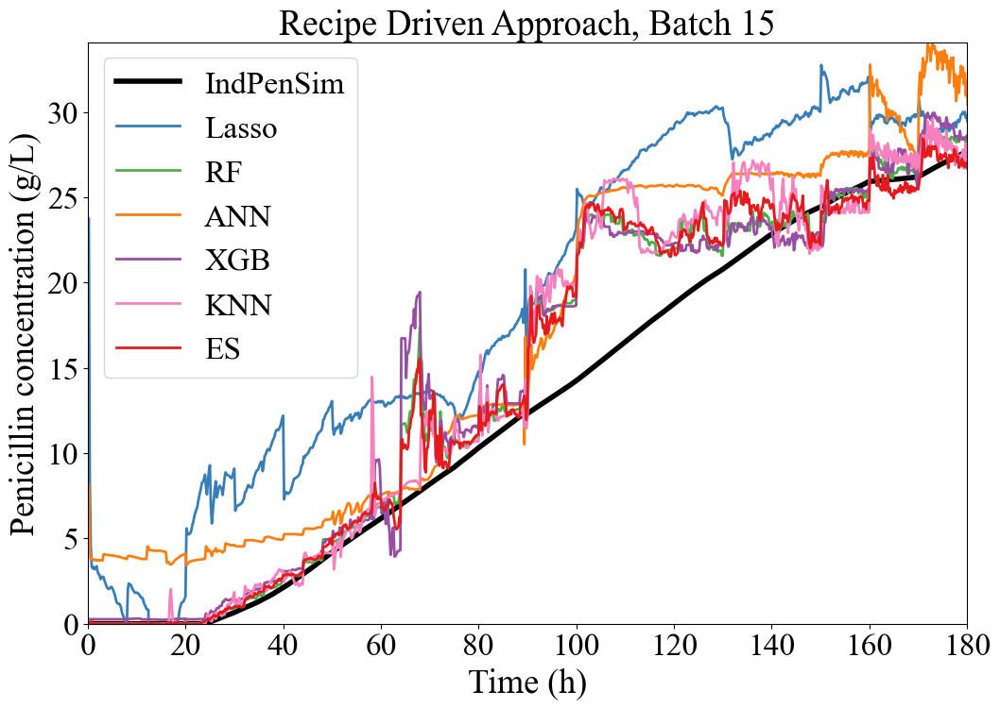

In [333]:
# Predicciones
pred_columns = ['pred_lasso_grecipe',
    'pred_rf_grecipe', 'pred_ann_grecipe',
    'pred_xgb_grecipe', 'pred_knn_grecipe', 'pred_ensamble_select_grecipe'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_grecipe': '#377eb8',  # Ajustado a un azul más contrastante
    'pred_rf_grecipe': '#4daf4a',     # Ajustado a un verde más claro
    'pred_ann_grecipe': '#ff7f0e',    # Naranja
    'pred_xgb_grecipe': '#984ea3',    # Púrpura más oscuro
    'pred_knn_grecipe': '#f781bf',    # Rojo más brillante
    'pred_ensamble_select_grecipe': '#e41a1c' # Rosa más claro e41a1c
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_grecipe': 'Lasso',
    'pred_rf_grecipe': 'RF',
    'pred_ann_grecipe': 'ANN',
    'pred_xgb_grecipe': 'XGB',
    'pred_knn_grecipe': 'KNN',
    'pred_ensamble_select_grecipe': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_15_select['Time (h)'].to_numpy()
y1 = batch_15_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_15_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 180)
plt.ylim(0, max(y1.max(), *[batch_15_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Recipe Driven Approach, Batch 15", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('model_performance_grecipe_batch_15_join.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

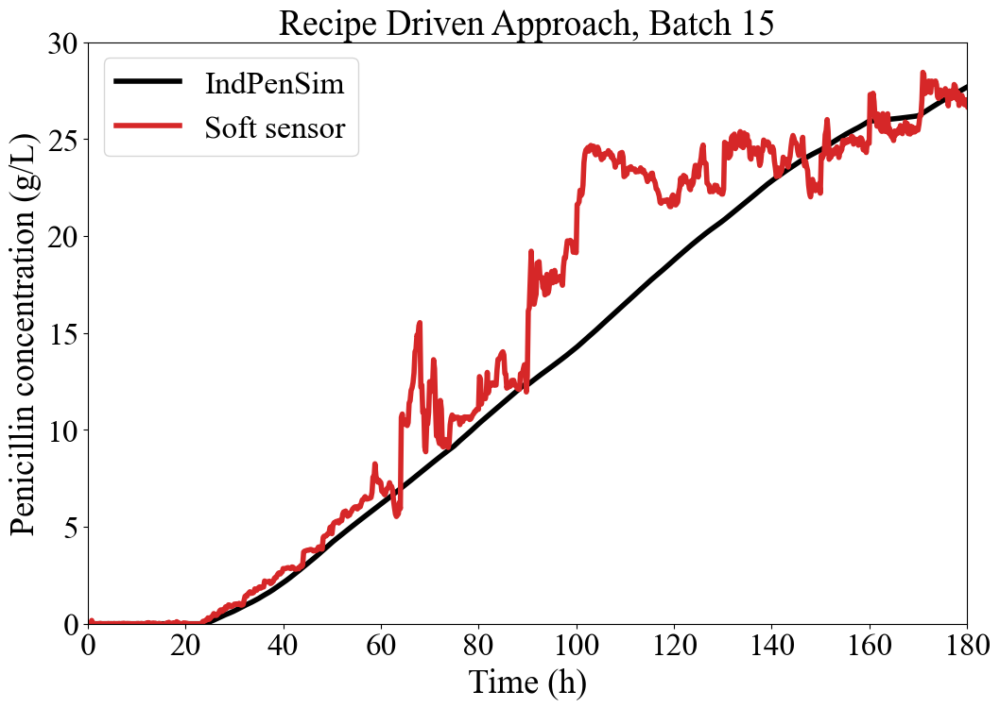

In [334]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_grecipe': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_15_select['Time (h)'].to_numpy()
y1 = batch_15_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_15_select['pred_ensamble_select_grecipe'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_grecipe'])

# Límites del eje x e y
plt.xlim(0, 180)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Recipe Driven Approach, Batch 15", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('soft_sensor_batch_15_grecipe.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

# **Controlled by operators**

### Paticionamiento train y test 

In [28]:
# Se realiza el particionamiento en train y en test con la estratégia de control: Controlados por operarios.

id_goperators_train = [54, 47, 37, 45, 55, 59, 38, 50, 34, 57, 43, 44, 49, 39, 53, 
                      33, 40, 36, 58, 51, 56, 42, 31, 48]
id_goperators_test = [32, 35, 41, 46, 52, 60]

# Utilizar una comprensión de lista para obtener los grupos
operators_train = [data_select.groupby('Batch').get_group(id) for id in id_goperators_train]
operators_test = [data_select.groupby('Batch').get_group(id) for id in id_goperators_test]

# Combinar los grupos
goperators_train = pd.concat(operators_train)
goperators_test = pd.concat(operators_test)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_goperators = goperators_train.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_train_goperators = goperators_train["Penicillin concentration(P:g/L)"]
X_test_goperators = goperators_test.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_test_goperators = goperators_test["Penicillin concentration(P:g/L)"]

### Desarrollo y ajuste de un modelo **Lasso** en GOperators

In [153]:
# Función para entrenar y evaluar un modelo Lasso con más hiperparámetros
def lasso_cv(alpha, max_iter, tol, fit_intercept, normalize):
    fit_intercept = bool(round(fit_intercept))
    normalize = bool(round(normalize))
    
    model = Pipeline([
        ('scaler', StandardScaler(with_mean=normalize)),
        ('lasso', Lasso(alpha=alpha, max_iter=int(max_iter), tol=tol, fit_intercept=fit_intercept))
    ])
    model.fit(X_train_goperators, y_train_goperators)
    y_pred = model.predict(X_test_goperators)
    return -mean_squared_error(y_test_goperators, y_pred)

# Espacio de búsqueda para la optimización bayesiana
pbounds = {
    'alpha': (0.001, 1),
    'max_iter': (100, 1000),
    'tol': (1e-5, 1e-1),
    'fit_intercept': (0, 1),  
    'normalize': (0, 1)       
}

# Optimización bayesiana para Lasso
lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds=pbounds, random_state=42, allow_duplicate_points=True)
lasso_optimizer.maximize(init_points=10, n_iter=30)

# Obtener el mejor conjunto de hiperparámetros para Lasso
best_params = lasso_optimizer.max['params']
best_alpha = best_params['alpha']
best_max_iter = int(best_params['max_iter'])
best_tol = best_params['tol']
best_fit_intercept = bool(round(best_params['fit_intercept']))
best_normalize = bool(round(best_params['normalize']))

# Entrenar el modelo Lasso con los mejores hiperparámetros
lasso_model_goperators = Pipeline([
    ('scaler', StandardScaler(with_mean=best_normalize)),
    ('lasso', Lasso(alpha=best_alpha, max_iter=best_max_iter, tol=best_tol, fit_intercept=best_fit_intercept))
])
lasso_model_goperators.fit(X_train_goperators, y_train_goperators)


|   iter    |  target   |   alpha   | fit_in... | max_iter  | normalize |    tol    |
-------------------------------------------------------------------------------------
| 1         | -9.712    | 0.3752    | 0.9507    | 758.8     | 0.5987    | 0.01561   |
| 2         | -217.8    | 0.1568    | 0.05808   | 879.6     | 0.6011    | 0.07081   |
| 3         | -8.228    | 0.02156   | 0.9699    | 849.2     | 0.2123    | 0.01819   |
| 4         | -9.559    | 0.1842    | 0.3042    | 572.3     | 0.4319    | 0.02913   |
| 5         | -11.4     | 0.6122    | 0.1395    | 362.9     | 0.3664    | 0.04561   |
| 6         | -229.2    | 0.7854    | 0.1997    | 562.8     | 0.5924    | 0.004655  |
| 7         | -226.9    | 0.6079    | 0.1705    | 158.5     | 0.9489    | 0.09656   |
| 8         | -230.1    | 0.8086    | 0.3046    | 187.9     | 0.6842    | 0.04402   |
| 9         | -214.9    | 0.1229    | 0.4952    | 130.9     | 0.9093    | 0.02589   |
| 10        | -226.7    | 0.6629    | 0.3117    | 568.

Pipeline(steps=[('scaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.001, max_iter=349, tol=0.1))])

In [154]:
print(f"Best alpha: {best_alpha}")
print(f"Best max_iter: {best_max_iter}")
print(f"Best tol: {best_tol}")
print(f"Best fit_intercept: {best_fit_intercept}")
print(f"Best normalize: {best_normalize}")

Best alpha: 0.001
Best max_iter: 349
Best tol: 0.1
Best fit_intercept: True
Best normalize: True


In [327]:
# # Función para entrenar y evaluar un modelo Lasso
# def lasso_cv(alpha):
#     model = Lasso(alpha=alpha)
#     model.fit(X_train_goperators, y_train_goperators)
#     y_pred_lasso_goperators = model.predict(X_test_goperators)
#     return -mean_squared_error(y_test_goperators, y_pred_lasso_goperators)

# # Optimización bayesiana para Lasso
# lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds={'alpha': (0.001, 1)}, random_state=42, allow_duplicate_points=True)
# lasso_optimizer.maximize(init_points=10, n_iter=30)

# # Mejor valor de alpha para Lasso
# best_alpha = lasso_optimizer.max['params']['alpha']

# # Entrenar el modelo Lasso con el mejor valor de alpha
# lasso_model_goperators = Lasso(alpha=best_alpha)
# lasso_model_goperators.fit(X_train_goperators, y_train_goperators)

|   iter    |  target   |   alpha   |
-------------------------------------
| 1         | -8.521    | 0.3752    |
| 2         | -9.23     | 0.9508    |
| 3         | -8.925    | 0.7323    |
| 4         | -8.76     | 0.5991    |
| 5         | -8.332    | 0.1569    |
| 6         | -8.332    | 0.1568    |
| 7         | -8.284    | 0.05903   |
| 8         | -9.107    | 0.8663    |
| 9         | -8.763    | 0.6015    |
| 10        | -8.894    | 0.7084    |
| 11        | -8.074    | 0.001     |
Data point [0.001] is not unique. 1 duplicates registered. Continuing ...
| 12        | -8.074    | 0.001     |
Data point [0.001] is not unique. 2 duplicates registered. Continuing ...
| 13        | -8.074    | 0.001     |
Data point [0.001] is not unique. 3 duplicates registered. Continuing ...
| 14        | -8.074    | 0.001     |
Data point [0.001] is not unique. 4 duplicates registered. Continuing ...
| 15        | -8.074    | 0.001     |
Data point [0.001] is not unique. 5 duplicates registered.

Lasso(alpha=0.001)

In [155]:
# Guardar el modelo entrenado
joblib.dump(lasso_model_goperators, 'lasso_model_goperators.pkl')

# Cargar el modelo entrenado
loaded_model_lasso_goperators = joblib.load('lasso_model_goperators.pkl')
loaded_model_lasso_goperators

Pipeline(steps=[('scaler', StandardScaler()),
                ('lasso', Lasso(alpha=0.001, max_iter=349, tol=0.1))])

In [156]:
# Predecir con el modelo entrenado
y_pred_lasso_goperators = loaded_model_lasso_goperators.predict(X_test_goperators)

# Calcular las métricas
mse_lasso_goperators = mean_squared_error(y_test_goperators, y_pred_lasso_goperators)
rmse_lasso_goperators = np.sqrt(mse_lasso_goperators)
mae_lasso_goperators = mean_absolute_error(y_test_goperators, y_pred_lasso_goperators)
r2_lasso_goperators = r2_score(y_test_goperators, y_pred_lasso_goperators)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_lasso_goperators:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lasso_goperators:.5f}")
print(f"Mean Absolute Error (MAE): {mae_lasso_goperators:.5f}")
print(f"R-squared (R^2): {r2_lasso_goperators:.5f}")

Mean Squared Error (MSE): 7.88956
Root Mean Squared Error (RMSE): 2.80884
Mean Absolute Error (MAE): 2.22154
R-squared (R^2): 0.92289


In [157]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_lasso_goperators = pd.DataFrame(y_pred_lasso_goperators, columns=['pred_lasso_goperators'])

# Guardar el DataFrame como un archivo CSV
pred_lasso_goperators.to_csv('y_pred_lasso_goperators.csv', index=False)

### Desarrollo y ajuste de un modelo **Random Forest** en GOperators

In [180]:
# Definir una función para entrenar y evaluar un modelo Random Forest
def rf_cv(n_estimators, max_depth, max_features, min_samples_split, min_samples_leaf, bootstrap):
    model = RandomForestRegressor(
        n_estimators=int(n_estimators),
        max_depth=int(max_depth),
        max_features=max_features,
        min_samples_split=int(min_samples_split),
        min_samples_leaf=int(min_samples_leaf),
        bootstrap=bootstrap > 0.5  # Convierte a booleano
    )
    model.fit(X_train_goperators, y_train_goperators)
    y_pred = model.predict(X_test_goperators)
    return -mean_squared_error(y_test_goperators, y_pred)

# Optimización bayesiana para Random Forest
pbounds = {
    'n_estimators': (10, 200),
    'max_depth': (1, 20),
    'max_features': (0.1, 1.0),  # Se asume un valor flotante entre 0.1 y 1.0
    'min_samples_split': (2, 20),
    'min_samples_leaf': (1, 20),
    'bootstrap': (0, 1)  # Se usará 0 para False y 1 para True
}

rf_optimizer = BayesianOptimization(f=rf_cv, pbounds=pbounds, random_state=42)
rf_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para Random Forest
best_params = rf_optimizer.max['params']
best_n_estimators = int(best_params['n_estimators'])
best_max_depth = int(best_params['max_depth'])
best_max_features = best_params['max_features']
best_min_samples_split = int(best_params['min_samples_split'])
best_min_samples_leaf = int(best_params['min_samples_leaf'])
best_bootstrap = best_params['bootstrap'] > 0.5

# Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
rf_model_goperators = RandomForestRegressor(
    n_estimators=best_n_estimators,
    max_depth=best_max_depth,
    max_features=best_max_features,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    bootstrap=best_bootstrap
)
rf_model_goperators.fit(X_train_goperators, y_train_goperators)

|   iter    |  target   | bootstrap | max_depth | max_fe... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------------------
| 1         | -4.533    | 0.3745    | 19.06     | 0.7588    | 12.37     | 4.808     | 39.64     |
| 2         | -4.462    | 0.05808   | 17.46     | 0.641     | 14.45     | 2.371     | 194.3     |
| 3         | -8.995    | 0.8324    | 5.034     | 0.2636    | 4.485     | 7.476     | 109.7     |
| 4         | -3.913    | 0.4319    | 6.533     | 0.6507    | 3.65      | 7.259     | 79.61     |
| 5         | -4.91     | 0.4561    | 15.92     | 0.2797    | 10.77     | 12.66     | 18.83     |
| 6         | -20.56    | 0.6075    | 4.24      | 0.1585    | 19.03     | 19.38     | 163.6     |
| 7         | -12.67    | 0.3046    | 2.856     | 0.7158    | 9.363     | 4.197     | 104.1     |
| 8         | -4.77     | 0.03439   | 18.28     | 0.3329    | 13.59     | 7.611     | 108.8     |
| 9         | -4.809

RandomForestRegressor(bootstrap=False, max_depth=6,
                      max_features=0.6506676052501416, min_samples_leaf=3,
                      min_samples_split=7, n_estimators=79)

In [181]:
#print(f"Best params: {best_params}")
print(f"Best n estimators: {best_n_estimators}")
print(f"Best max depth: {best_max_depth}")
print(f"Best max features: {best_max_features}")
print(f"Best min samples split: {best_min_samples_split}")
print(f"Best min samples leaf: {best_min_samples_leaf}")
print(f"Best best_bootstrap: {best_bootstrap}")

Best n estimators: 79
Best max depth: 6
Best max features: 0.6506676052501416
Best min samples split: 7
Best min samples leaf: 3
Best best_bootstrap: False


In [333]:
# # Función para entrenar y evaluar un modelo Random Forest
# def rf_cv(n_estimators, max_depth):
#     model = RandomForestRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth))
#     model.fit(X_train_goperators, y_train_goperators)
#     y_pred = model.predict(X_test_goperators)
#     return -mean_squared_error(y_test_goperators, y_pred)

# # Optimización bayesiana para Random Forest
# rf_optimizer = BayesianOptimization(f=rf_cv, pbounds={'n_estimators': (10, 200), 'max_depth': (1, 20)}, random_state=42)
# rf_optimizer.maximize(init_points=10, n_iter=30)

# # Mejores valores de hiperparámetros para Random Forest
# best_n_estimators = int(rf_optimizer.max['params']['n_estimators'])
# best_max_depth = int(rf_optimizer.max['params']['max_depth'])

# # Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
# rf_model_goperators = RandomForestRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth)
# rf_model_goperators.fit(X_train_goperators, y_train_goperators)

|   iter    |  target   | max_depth | n_esti... |
-------------------------------------------------
| 1         | -4.799    | 8.116     | 190.6     |
| 2         | -4.832    | 14.91     | 123.7     |
| 3         | -7.027    | 3.964     | 39.64     |
| 4         | -11.95    | 2.104     | 174.6     |
| 5         | -4.941    | 12.42     | 144.5     |
| 6         | -25.54    | 1.391     | 194.3     |
| 7         | -5.217    | 16.82     | 50.34     |
| 8         | -4.907    | 4.455     | 44.85     |
| 9         | -4.468    | 6.781     | 109.7     |
| 10        | -4.811    | 9.207     | 65.33     |
| 11        | -4.783    | 9.005     | 110.1     |
| 12        | -4.989    | 13.26     | 188.2     |
| 13        | -4.558    | 8.905     | 118.5     |
| 14        | -4.927    | 17.08     | 115.7     |
| 15        | -4.551    | 8.048     | 53.09     |
| 16        | -4.874    | 14.46     | 58.87     |
| 17        | -11.94    | 2.305     | 59.15     |
| 18        | -4.95     | 11.51     | 45.72     |


RandomForestRegressor(max_depth=6, n_estimators=139)

In [182]:
# Guardar el modelo entrenado
joblib.dump(rf_model_goperators, 'rf_model_goperators.pkl')

# Cargar el modelo entrenado
loaded_model_rf_goperators = joblib.load('rf_model_goperators.pkl')
loaded_model_rf_goperators

RandomForestRegressor(bootstrap=False, max_depth=6,
                      max_features=0.6506676052501416, min_samples_leaf=3,
                      min_samples_split=7, n_estimators=79)

In [183]:
# Predecir con el modelo entrenado
y_pred_rf_goperators = loaded_model_rf_goperators.predict(X_test_goperators)

# Calcular las métricas
mse_rf_goperators = mean_squared_error(y_test_goperators, y_pred_rf_goperators)
rmse_rf_goperators = np.sqrt(mse_rf_goperators)
mae_rf_goperators = mean_absolute_error(y_test_goperators, y_pred_rf_goperators)
r2_rf_goperators = r2_score(y_test_goperators, y_pred_rf_goperators)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_rf_goperators:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_rf_goperators:.5f}")
print(f"Mean Absolute Error (MAE): {mae_rf_goperators:.5f}")
print(f"R-squared (R^2): {r2_rf_goperators:.5f}")

Mean Squared Error (MSE): 3.94912
Root Mean Squared Error (RMSE): 1.98724
Mean Absolute Error (MAE): 1.15845
R-squared (R^2): 0.96140


In [184]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_rf_goperators = pd.DataFrame(y_pred_rf_goperators, columns=['pred_rf_goperators'])

# Guardar el DataFrame como un archivo CSV
pred_rf_goperators.to_csv('y_pred_rf_goperators.csv', index=False)

### Desarrollo y ajuste de un modelo **ANN** en GOperators

|   iter    |  target   | activa... | batch_... | dropou... |  epochs   | hidden... | hidden... | hidden... |
-------------------------------------------------------------------------------------------------------------
Epoch 1/33, RMSE: 0.3446
Epoch 2/33, RMSE: 0.2727
Epoch 3/33, RMSE: 0.2979
Epoch 4/33, RMSE: 0.2933
Epoch 5/33, RMSE: 0.2924
Epoch 6/33, RMSE: 0.2706
Epoch 7/33, RMSE: 0.2472
Epoch 8/33, RMSE: 0.3008
Epoch 9/33, RMSE: 0.2489
Epoch 10/33, RMSE: 0.2812
Epoch 11/33, RMSE: 0.2610
Epoch 12/33, RMSE: 0.2743
Epoch 13/33, RMSE: 0.2363
Epoch 14/33, RMSE: 0.2329
Epoch 15/33, RMSE: 0.2705
Epoch 16/33, RMSE: 0.2708
Epoch 17/33, RMSE: 0.2557
Epoch 18/33, RMSE: 0.2779
Epoch 19/33, RMSE: 0.2312
Epoch 20/33, RMSE: 0.2654
Epoch 21/33, RMSE: 0.2885
Epoch 22/33, RMSE: 0.2622
Epoch 23/33, RMSE: 0.2730
Epoch 24/33, RMSE: 0.2658
Epoch 25/33, RMSE: 0.2673
Epoch 26/33, RMSE: 0.2531
Epoch 27/33, RMSE: 0.2592
Epoch 28/33, RMSE: 0.2926
Epoch 29/33, RMSE: 0.2396
Early stopping at epoch 29


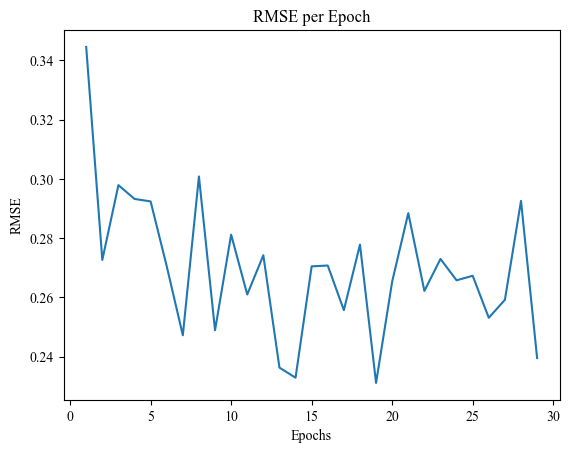

| 1         | -2.908    | 0.7491    | 48.03     | 0.3928    | 33.95     | 93.96     | 93.95     | 37.58     |
Epoch 1/10, RMSE: 0.4737
Epoch 2/10, RMSE: 0.4092
Epoch 3/10, RMSE: 0.4594
Epoch 4/10, RMSE: 0.4173
Epoch 5/10, RMSE: 0.3294
Epoch 6/10, RMSE: 0.3159
Epoch 7/10, RMSE: 0.3073
Epoch 8/10, RMSE: 0.3514
Epoch 9/10, RMSE: 0.3189
Epoch 10/10, RMSE: 0.2651


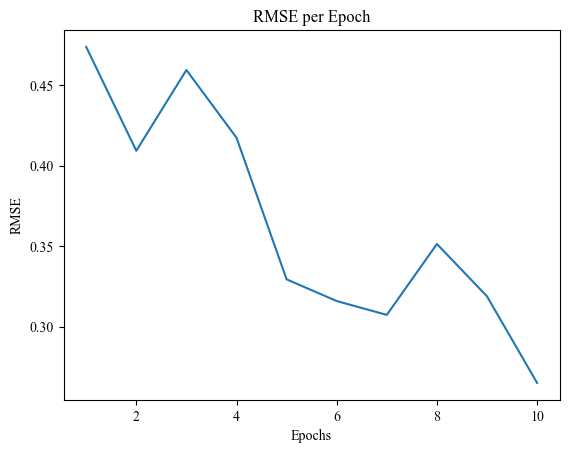

| 2         | -3.412    | 1.732     | 34.04     | 0.3832    | 10.82     | 250.2     | 223.8     | 52.38     |
Epoch 1/30, RMSE: 0.6550
Epoch 2/30, RMSE: 0.3938
Epoch 3/30, RMSE: 0.3544
Epoch 4/30, RMSE: 0.3810
Epoch 5/30, RMSE: 0.3737
Epoch 6/30, RMSE: 0.4841
Epoch 7/30, RMSE: 0.3335
Epoch 8/30, RMSE: 0.3415
Epoch 9/30, RMSE: 0.3349
Epoch 10/30, RMSE: 0.2939
Epoch 11/30, RMSE: 0.3056
Epoch 12/30, RMSE: 0.2974
Epoch 13/30, RMSE: 0.2884
Epoch 14/30, RMSE: 0.3076
Epoch 15/30, RMSE: 0.2935
Epoch 16/30, RMSE: 0.3265
Epoch 17/30, RMSE: 0.2698
Epoch 18/30, RMSE: 0.2949
Epoch 19/30, RMSE: 0.2890
Epoch 20/30, RMSE: 0.2884
Epoch 21/30, RMSE: 0.3334
Epoch 22/30, RMSE: 0.2946
Epoch 23/30, RMSE: 0.2891
Epoch 24/30, RMSE: 0.2712
Epoch 25/30, RMSE: 0.3167
Epoch 26/30, RMSE: 0.3087
Epoch 27/30, RMSE: 0.2767
Early stopping at epoch 27


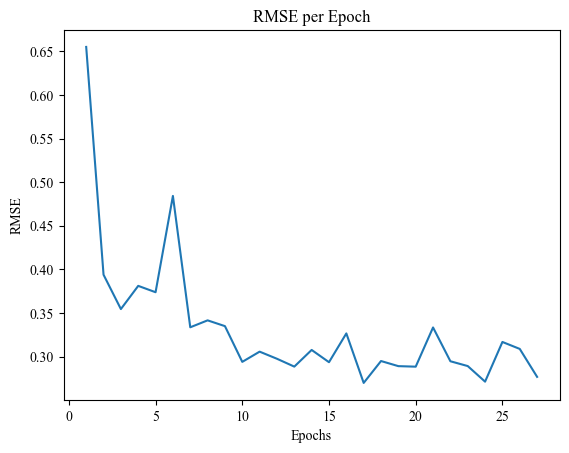

| 3         | -3.284    | 0.3636    | 17.34     | 0.2217    | 30.99     | 146.9     | 119.9     | 90.74     |
Epoch 1/28, RMSE: 0.6532
Epoch 2/28, RMSE: 0.3775
Epoch 3/28, RMSE: 0.3887
Epoch 4/28, RMSE: 0.5571
Epoch 5/28, RMSE: 0.5531
Epoch 6/28, RMSE: 0.5713
Epoch 7/28, RMSE: 0.4384
Epoch 8/28, RMSE: 0.5041
Epoch 9/28, RMSE: 0.6620
Epoch 10/28, RMSE: 0.3460
Epoch 11/28, RMSE: 0.9976
Epoch 12/28, RMSE: 0.3001
Epoch 13/28, RMSE: 0.3480
Epoch 14/28, RMSE: 0.4121
Epoch 15/28, RMSE: 0.4044
Epoch 16/28, RMSE: 0.3609
Epoch 17/28, RMSE: 0.3235
Epoch 18/28, RMSE: 0.2675
Epoch 19/28, RMSE: 0.3175
Epoch 20/28, RMSE: 0.2898
Epoch 21/28, RMSE: 0.2914
Epoch 22/28, RMSE: 0.2817
Epoch 23/28, RMSE: 0.2784
Epoch 24/28, RMSE: 0.2442
Epoch 25/28, RMSE: 0.2790
Epoch 26/28, RMSE: 0.2813
Epoch 27/28, RMSE: 0.2868
Epoch 28/28, RMSE: 0.2808


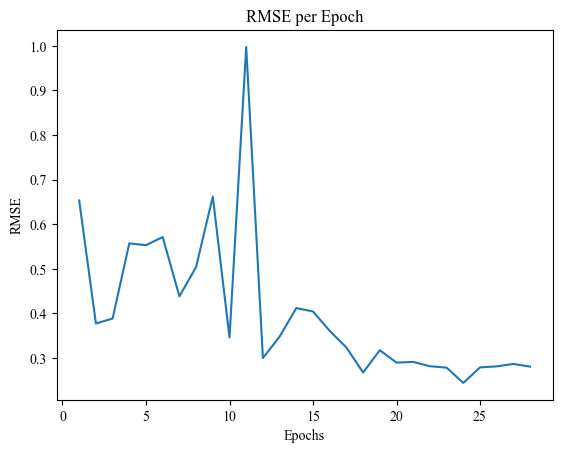

| 4         | -3.596    | 0.279     | 21.69     | 0.2465    | 28.24     | 214.8     | 102.3     | 81.37     |
Epoch 1/16, RMSE: 0.6330
Epoch 2/16, RMSE: 0.6941
Epoch 3/16, RMSE: 0.4625
Epoch 4/16, RMSE: 0.3846
Epoch 5/16, RMSE: 0.3884
Epoch 6/16, RMSE: 0.5221
Epoch 7/16, RMSE: 0.5919
Epoch 8/16, RMSE: 0.5466
Epoch 9/16, RMSE: 0.4558
Epoch 10/16, RMSE: 0.4996
Epoch 11/16, RMSE: 0.3947
Epoch 12/16, RMSE: 0.4635
Epoch 13/16, RMSE: 0.4760
Epoch 14/16, RMSE: 0.4681
Early stopping at epoch 14


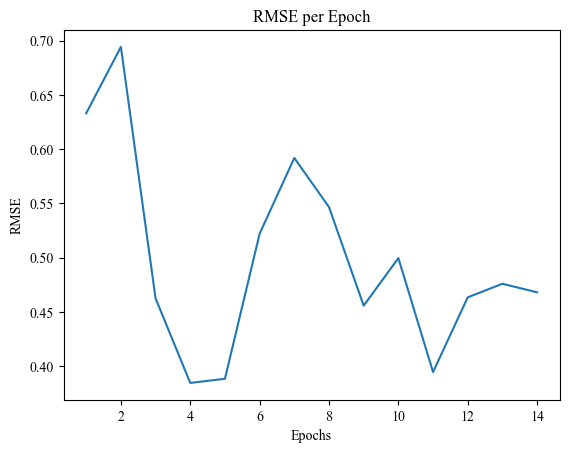

| 5         | -4.355    | 1.185     | 11.86     | 0.343     | 16.82     | 76.49     | 246.2     | 124.7     |
Epoch 1/37, RMSE: 0.5595
Epoch 2/37, RMSE: 0.5774
Epoch 3/37, RMSE: 0.6661
Epoch 4/37, RMSE: 0.5411
Epoch 5/37, RMSE: 0.6176
Epoch 6/37, RMSE: 0.5656
Epoch 7/37, RMSE: 0.4434
Epoch 8/37, RMSE: 0.5268
Epoch 9/37, RMSE: 0.3649
Epoch 10/37, RMSE: 0.4026
Epoch 11/37, RMSE: 0.3782
Epoch 12/37, RMSE: 0.3489
Epoch 13/37, RMSE: 0.3162
Epoch 14/37, RMSE: 0.3433
Epoch 15/37, RMSE: 0.2779
Epoch 16/37, RMSE: 0.3130
Epoch 17/37, RMSE: 0.3056
Epoch 18/37, RMSE: 0.2569
Epoch 19/37, RMSE: 0.3122
Epoch 20/37, RMSE: 0.2734
Epoch 21/37, RMSE: 0.3458
Epoch 22/37, RMSE: 0.2553
Epoch 23/37, RMSE: 0.2448
Epoch 24/37, RMSE: 0.2847
Epoch 25/37, RMSE: 0.3123
Epoch 26/37, RMSE: 0.2282
Epoch 27/37, RMSE: 0.2508
Epoch 28/37, RMSE: 0.3262
Epoch 29/37, RMSE: 0.2384
Epoch 30/37, RMSE: 0.3071
Epoch 31/37, RMSE: 0.2733
Epoch 32/37, RMSE: 0.2656
Epoch 33/37, RMSE: 0.2411
Epoch 34/37, RMSE: 0.3376
Epoch 35/37, RM

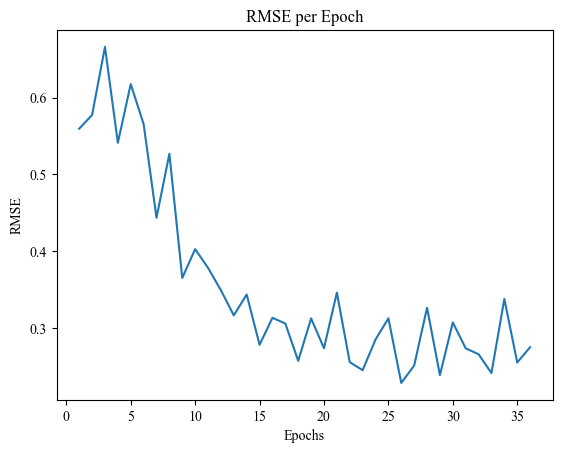

| 6         | -3.407    | 1.617     | 22.18     | 0.1391    | 37.37     | 148.5     | 87.43     | 79.54     |
Epoch 1/36, RMSE: 0.3975
Epoch 2/36, RMSE: 0.3411
Epoch 3/36, RMSE: 0.3384
Epoch 4/36, RMSE: 0.3552
Epoch 5/36, RMSE: 0.3418
Epoch 6/36, RMSE: 0.2969
Epoch 7/36, RMSE: 0.2315
Epoch 8/36, RMSE: 0.2922
Epoch 9/36, RMSE: 0.2941
Epoch 10/36, RMSE: 0.2927
Epoch 11/36, RMSE: 0.2871
Epoch 12/36, RMSE: 0.2581
Epoch 13/36, RMSE: 0.2817
Epoch 14/36, RMSE: 0.2632
Epoch 15/36, RMSE: 0.2695
Epoch 16/36, RMSE: 0.2493
Epoch 17/36, RMSE: 0.2592
Early stopping at epoch 17


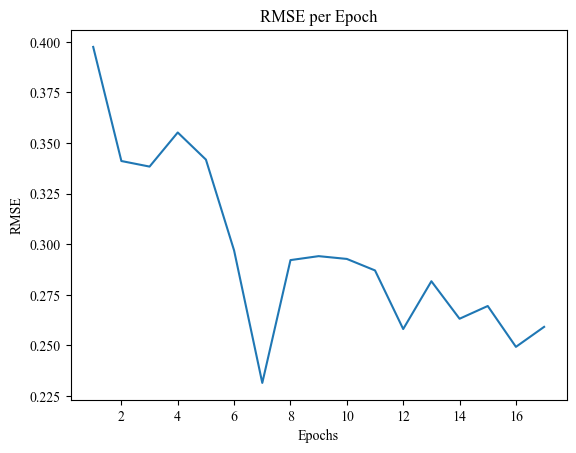

| 7         | -3.626    | 0.06878   | 46.37     | 0.2035    | 36.5      | 123.8     | 163.9     | 84.48     |
Epoch 1/47, RMSE: 0.3210
Epoch 2/47, RMSE: 0.4266
Epoch 3/47, RMSE: 0.3978
Epoch 4/47, RMSE: 0.4007
Epoch 5/47, RMSE: 0.3414
Epoch 6/47, RMSE: 0.2815
Epoch 7/47, RMSE: 0.2738
Epoch 8/47, RMSE: 0.3405
Epoch 9/47, RMSE: 0.2752
Epoch 10/47, RMSE: 0.3575
Epoch 11/47, RMSE: 0.2629
Epoch 12/47, RMSE: 0.3031
Epoch 13/47, RMSE: 0.2851
Epoch 14/47, RMSE: 0.2493
Epoch 15/47, RMSE: 0.2641
Epoch 16/47, RMSE: 0.2714
Epoch 17/47, RMSE: 0.2630
Epoch 18/47, RMSE: 0.2560
Epoch 19/47, RMSE: 0.2566
Epoch 20/47, RMSE: 0.3160
Epoch 21/47, RMSE: 0.2709
Epoch 22/47, RMSE: 0.3109
Epoch 23/47, RMSE: 0.2920
Epoch 24/47, RMSE: 0.3042
Early stopping at epoch 24


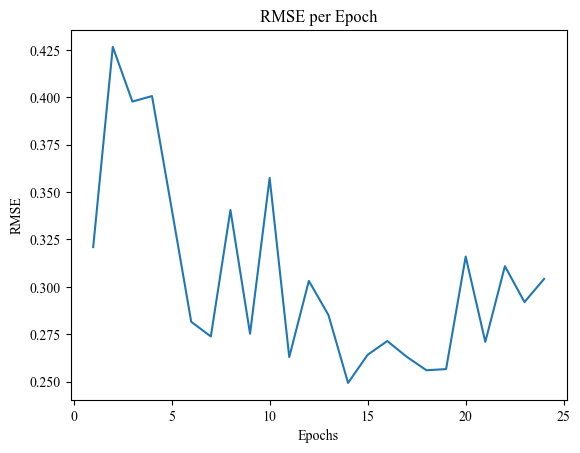

| 8         | -3.443    | 0.3697    | 48.78     | 0.4101    | 47.58     | 235.8     | 178.8     | 120.5     |
Epoch 1/23, RMSE: 0.6575
Epoch 2/23, RMSE: 0.6608
Epoch 3/23, RMSE: 0.5530
Epoch 4/23, RMSE: 0.4118
Epoch 5/23, RMSE: 0.5663
Epoch 6/23, RMSE: 0.4053
Epoch 7/23, RMSE: 0.4651
Epoch 8/23, RMSE: 0.4874
Epoch 9/23, RMSE: 0.6648
Epoch 10/23, RMSE: 0.3475
Epoch 11/23, RMSE: 0.4560
Epoch 12/23, RMSE: 0.3554
Epoch 13/23, RMSE: 0.4578
Epoch 14/23, RMSE: 0.4837
Epoch 15/23, RMSE: 0.5204
Epoch 16/23, RMSE: 0.4279
Epoch 17/23, RMSE: 0.5167
Epoch 18/23, RMSE: 0.3491
Epoch 19/23, RMSE: 0.3249
Epoch 20/23, RMSE: 0.4433
Epoch 21/23, RMSE: 0.3373
Epoch 22/23, RMSE: 0.3337
Epoch 23/23, RMSE: 0.2647


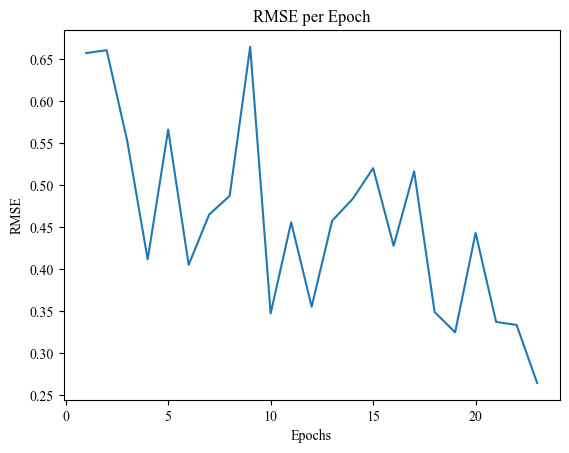

| 9         | -3.726    | 0.177     | 17.84     | 0.1181    | 23.01     | 138.6     | 116.1     | 111.6     |
Epoch 1/15, RMSE: 0.4865
Epoch 2/15, RMSE: 0.6978
Epoch 3/15, RMSE: 0.3697
Epoch 4/15, RMSE: 0.3864
Epoch 5/15, RMSE: 0.3539
Epoch 6/15, RMSE: 0.3719
Epoch 7/15, RMSE: 0.3773
Epoch 8/15, RMSE: 0.3262
Epoch 9/15, RMSE: 0.3382
Epoch 10/15, RMSE: 0.3895
Epoch 11/15, RMSE: 0.3317
Epoch 12/15, RMSE: 0.2801
Epoch 13/15, RMSE: 0.3406
Epoch 14/15, RMSE: 0.2678
Epoch 15/15, RMSE: 0.2875


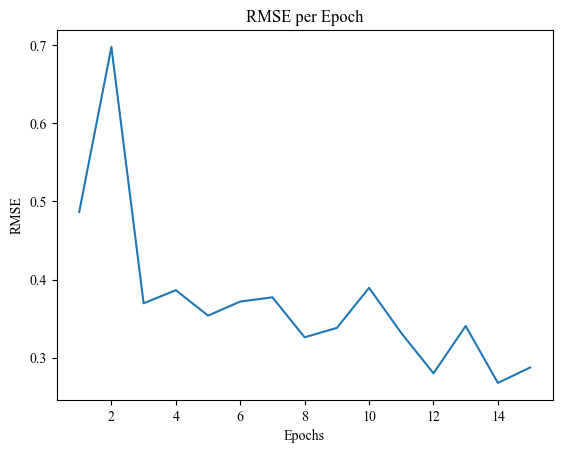

| 10        | -3.988    | 0.7135    | 21.24     | 0.3171    | 15.64     | 218.0     | 78.31     | 126.7     |
Epoch 1/15, RMSE: 0.3301
Epoch 2/15, RMSE: 0.4008
Epoch 3/15, RMSE: 0.3655
Epoch 4/15, RMSE: 0.4392
Epoch 5/15, RMSE: 0.3791
Epoch 6/15, RMSE: 0.3130
Epoch 7/15, RMSE: 0.3362
Epoch 8/15, RMSE: 0.3068
Epoch 9/15, RMSE: 0.2716
Epoch 10/15, RMSE: 0.4435
Epoch 11/15, RMSE: 0.2889
Epoch 12/15, RMSE: 0.2844
Epoch 13/15, RMSE: 0.2760
Epoch 14/15, RMSE: 0.3153
Epoch 15/15, RMSE: 0.2557


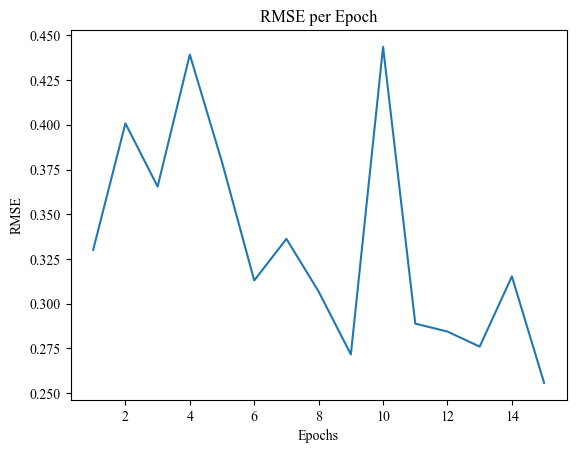

| 11        | -3.862    | 0.9247    | 38.56     | 0.3944    | 15.53     | 249.5     | 221.6     | 51.63     |
Epoch 1/43, RMSE: 0.6419
Epoch 2/43, RMSE: 0.4111
Epoch 3/43, RMSE: 0.5132
Epoch 4/43, RMSE: 0.5681
Epoch 5/43, RMSE: 0.4656
Epoch 6/43, RMSE: 0.5588
Epoch 7/43, RMSE: 0.4826
Epoch 8/43, RMSE: 0.5207
Epoch 9/43, RMSE: 0.4782
Epoch 10/43, RMSE: 0.4507
Epoch 11/43, RMSE: 0.4499
Epoch 12/43, RMSE: 0.4180
Early stopping at epoch 12


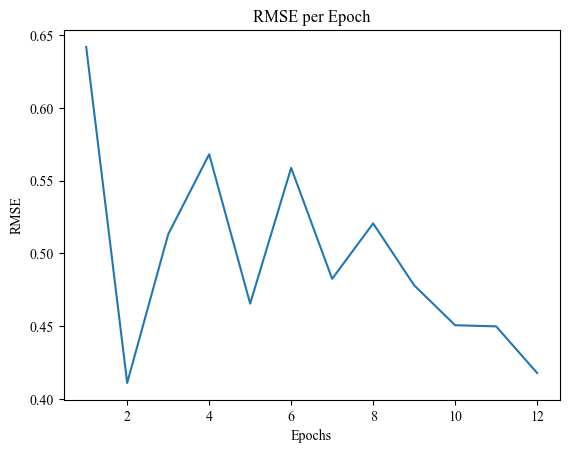

| 12        | -3.873    | 0.1287    | 14.36     | 0.4586    | 44.0      | 208.4     | 117.6     | 79.79     |
Epoch 1/28, RMSE: 0.6701
Epoch 2/28, RMSE: 0.3664
Epoch 3/28, RMSE: 0.3838
Epoch 4/28, RMSE: 0.3461
Epoch 5/28, RMSE: 0.4111
Epoch 6/28, RMSE: 0.4017
Epoch 7/28, RMSE: 0.3921
Epoch 8/28, RMSE: 0.3917
Epoch 9/28, RMSE: 0.4240
Epoch 10/28, RMSE: 0.3525
Epoch 11/28, RMSE: 0.3145
Epoch 12/28, RMSE: 0.3871
Epoch 13/28, RMSE: 0.3308
Epoch 14/28, RMSE: 0.3142
Epoch 15/28, RMSE: 0.2838
Epoch 16/28, RMSE: 0.3221
Epoch 17/28, RMSE: 0.3110
Epoch 18/28, RMSE: 0.2922
Epoch 19/28, RMSE: 0.2533
Epoch 20/28, RMSE: 0.2593
Epoch 21/28, RMSE: 0.2738
Epoch 22/28, RMSE: 0.2945
Epoch 23/28, RMSE: 0.3171
Epoch 24/28, RMSE: 0.2683
Epoch 25/28, RMSE: 0.2669
Epoch 26/28, RMSE: 0.2690
Epoch 27/28, RMSE: 0.3014
Epoch 28/28, RMSE: 0.2947


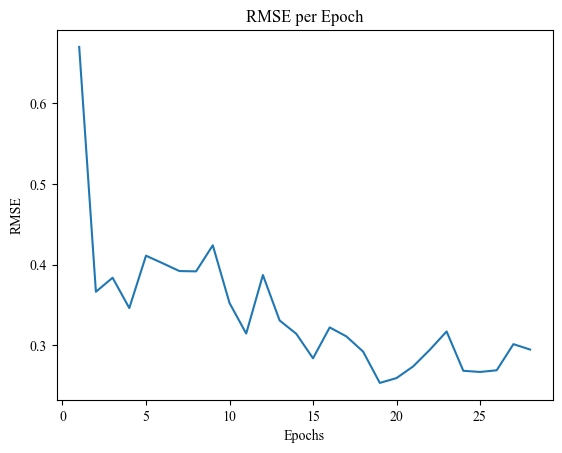

| 13        | -3.71     | 0.8514    | 23.63     | 0.462     | 28.9      | 245.0     | 121.1     | 97.32     |
Epoch 1/39, RMSE: 0.6727
Epoch 2/39, RMSE: 0.4556
Epoch 3/39, RMSE: 0.4563
Epoch 4/39, RMSE: 0.4146
Epoch 5/39, RMSE: 0.5054
Epoch 6/39, RMSE: 0.4940
Epoch 7/39, RMSE: 0.4917
Epoch 8/39, RMSE: 0.5571
Epoch 9/39, RMSE: 0.5221
Epoch 10/39, RMSE: 0.4986
Epoch 11/39, RMSE: 0.4445
Epoch 12/39, RMSE: 0.3923
Epoch 13/39, RMSE: 0.3919
Epoch 14/39, RMSE: 0.3263
Epoch 15/39, RMSE: 0.3090
Epoch 16/39, RMSE: 0.3298
Epoch 17/39, RMSE: 0.3078
Epoch 18/39, RMSE: 0.2832
Epoch 19/39, RMSE: 0.2925
Epoch 20/39, RMSE: 0.3146
Epoch 21/39, RMSE: 0.2985
Epoch 22/39, RMSE: 0.2883
Epoch 23/39, RMSE: 0.3079
Epoch 24/39, RMSE: 0.2921
Epoch 25/39, RMSE: 0.2919
Epoch 26/39, RMSE: 0.2710
Epoch 27/39, RMSE: 0.2559
Epoch 28/39, RMSE: 0.3080
Epoch 29/39, RMSE: 0.2729
Epoch 30/39, RMSE: 0.2824
Epoch 31/39, RMSE: 0.2698
Epoch 32/39, RMSE: 0.2502
Epoch 33/39, RMSE: 0.2610
Epoch 34/39, RMSE: 0.2862
Epoch 35/39, RM

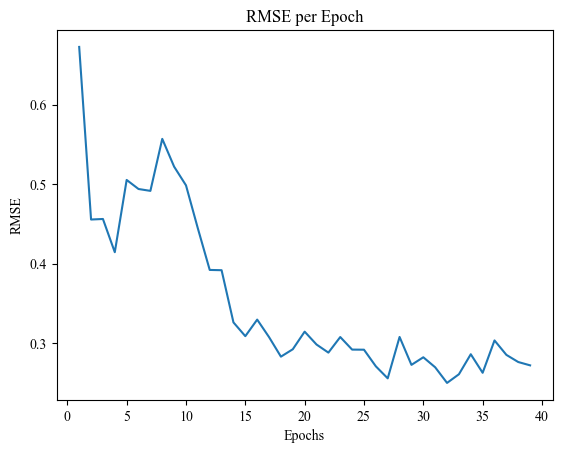

| 14        | -3.104    | 1.997     | 12.05     | 0.413     | 39.69     | 216.1     | 131.1     | 76.58     |
Epoch 1/19, RMSE: 0.3366
Epoch 2/19, RMSE: 0.3610
Epoch 3/19, RMSE: 0.3422
Epoch 4/19, RMSE: 0.3072
Epoch 5/19, RMSE: 0.3544
Epoch 6/19, RMSE: 0.3351
Epoch 7/19, RMSE: 0.3201
Epoch 8/19, RMSE: 0.2852
Epoch 9/19, RMSE: 0.3183
Epoch 10/19, RMSE: 0.2432
Epoch 11/19, RMSE: 0.2833
Epoch 12/19, RMSE: 0.2498
Epoch 13/19, RMSE: 0.2657
Epoch 14/19, RMSE: 0.2831
Epoch 15/19, RMSE: 0.2649
Epoch 16/19, RMSE: 0.2482
Epoch 17/19, RMSE: 0.2557
Epoch 18/19, RMSE: 0.2628
Epoch 19/19, RMSE: 0.2998


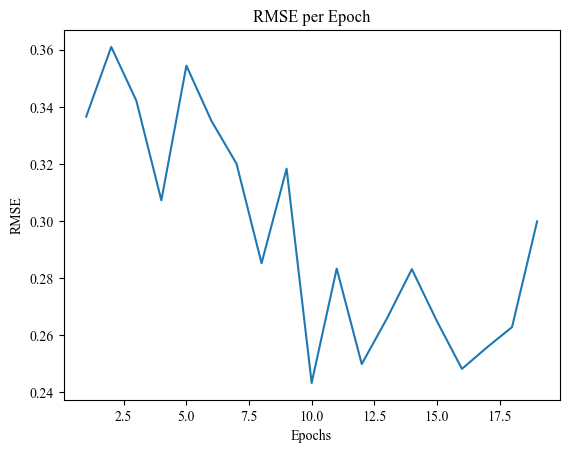

| 15        | -3.768    | 1.112     | 46.15     | 0.3647    | 19.22     | 249.5     | 140.1     | 34.66     |
Epoch 1/36, RMSE: 0.4477
Epoch 2/36, RMSE: 0.3362
Epoch 3/36, RMSE: 0.4506
Epoch 4/36, RMSE: 0.4773
Epoch 5/36, RMSE: 0.4535
Epoch 6/36, RMSE: 0.4203
Epoch 7/36, RMSE: 0.4212
Epoch 8/36, RMSE: 0.3760
Epoch 9/36, RMSE: 0.3523
Epoch 10/36, RMSE: 0.3885
Epoch 11/36, RMSE: 0.3803
Epoch 12/36, RMSE: 0.3788
Early stopping at epoch 12


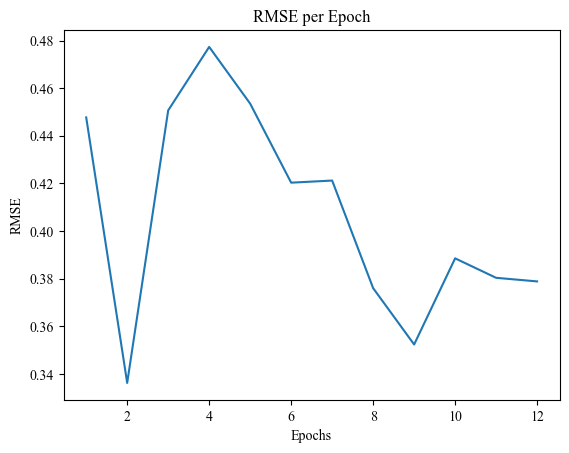

| 16        | -4.065    | 1.618     | 17.71     | 0.4403    | 36.04     | 191.3     | 73.83     | 72.2      |
Epoch 1/36, RMSE: 0.4153
Epoch 2/36, RMSE: 0.3933
Epoch 3/36, RMSE: 0.3861
Epoch 4/36, RMSE: 0.3393
Epoch 5/36, RMSE: 0.3366
Epoch 6/36, RMSE: 0.3691
Epoch 7/36, RMSE: 0.3369
Epoch 8/36, RMSE: 0.3784
Epoch 9/36, RMSE: 0.4230
Epoch 10/36, RMSE: 0.3370
Epoch 11/36, RMSE: 0.3045
Epoch 12/36, RMSE: 0.2544
Epoch 13/36, RMSE: 0.3151
Epoch 14/36, RMSE: 0.2935
Epoch 15/36, RMSE: 0.2762
Epoch 16/36, RMSE: 0.2595
Epoch 17/36, RMSE: 0.2626
Epoch 18/36, RMSE: 0.2816
Epoch 19/36, RMSE: 0.2443
Epoch 20/36, RMSE: 0.2632
Epoch 21/36, RMSE: 0.2539
Epoch 22/36, RMSE: 0.2600
Epoch 23/36, RMSE: 0.2564
Epoch 24/36, RMSE: 0.2655
Epoch 25/36, RMSE: 0.2435
Epoch 26/36, RMSE: 0.2286
Epoch 27/36, RMSE: 0.2313
Epoch 28/36, RMSE: 0.2336
Epoch 29/36, RMSE: 0.2350
Epoch 30/36, RMSE: 0.2338
Epoch 31/36, RMSE: 0.2484
Epoch 32/36, RMSE: 0.2385
Epoch 33/36, RMSE: 0.2590
Epoch 34/36, RMSE: 0.2310
Epoch 35/36, RM

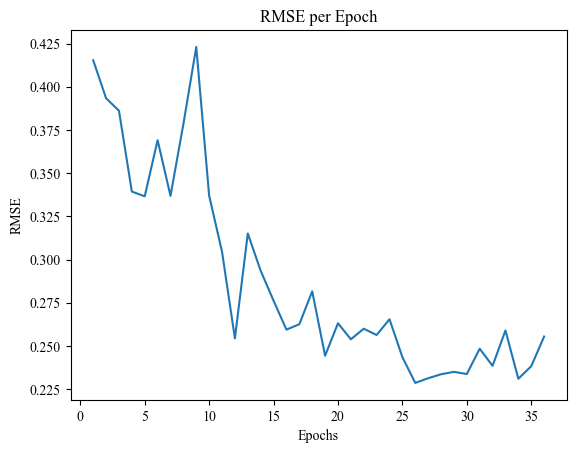

| 17        | -4.04     | 1.419     | 35.26     | 0.4207    | 36.96     | 226.2     | 105.4     | 124.2     |
Epoch 1/48, RMSE: 0.3508
Epoch 2/48, RMSE: 0.4434
Epoch 3/48, RMSE: 0.3886
Epoch 4/48, RMSE: 0.3419
Epoch 5/48, RMSE: 0.3373
Epoch 6/48, RMSE: 0.2715
Epoch 7/48, RMSE: 0.2559
Epoch 8/48, RMSE: 0.3470
Epoch 9/48, RMSE: 0.2545
Epoch 10/48, RMSE: 0.3816
Epoch 11/48, RMSE: 0.3757
Epoch 12/48, RMSE: 0.3048
Epoch 13/48, RMSE: 0.2541
Epoch 14/48, RMSE: 0.2584
Epoch 15/48, RMSE: 0.2456
Epoch 16/48, RMSE: 0.2568
Epoch 17/48, RMSE: 0.2613
Epoch 18/48, RMSE: 0.3163
Epoch 19/48, RMSE: 0.2621
Epoch 20/48, RMSE: 0.2787
Epoch 21/48, RMSE: 0.2845
Epoch 22/48, RMSE: 0.2788
Epoch 23/48, RMSE: 0.2853
Epoch 24/48, RMSE: 0.3463
Epoch 25/48, RMSE: 0.3212
Early stopping at epoch 25


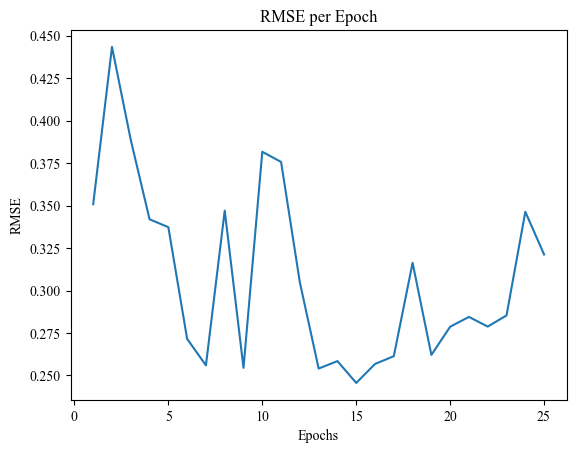

| 18        | -3.783    | 0.2382    | 48.01     | 0.4874    | 48.13     | 241.6     | 109.4     | 72.46     |
Epoch 1/27, RMSE: 0.3256
Epoch 2/27, RMSE: 0.4166
Epoch 3/27, RMSE: 0.4376
Epoch 4/27, RMSE: 0.3706
Epoch 5/27, RMSE: 0.3581
Epoch 6/27, RMSE: 0.3779
Epoch 7/27, RMSE: 0.3601
Epoch 8/27, RMSE: 0.3182
Epoch 9/27, RMSE: 0.2640
Epoch 10/27, RMSE: 0.2859
Epoch 11/27, RMSE: 0.2573
Epoch 12/27, RMSE: 0.2924
Epoch 13/27, RMSE: 0.2554
Epoch 14/27, RMSE: 0.2717
Epoch 15/27, RMSE: 0.2549
Epoch 16/27, RMSE: 0.2712
Epoch 17/27, RMSE: 0.2465
Epoch 18/27, RMSE: 0.2478
Epoch 19/27, RMSE: 0.2617
Epoch 20/27, RMSE: 0.2630
Epoch 21/27, RMSE: 0.2634
Epoch 22/27, RMSE: 0.2725
Epoch 23/27, RMSE: 0.2776
Epoch 24/27, RMSE: 0.2393
Epoch 25/27, RMSE: 0.2646
Epoch 26/27, RMSE: 0.2484
Epoch 27/27, RMSE: 0.2717


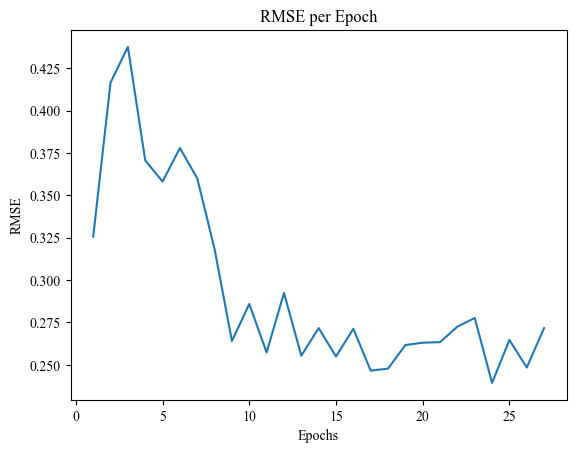

| 19        | -3.462    | 1.953     | 38.0      | 0.4612    | 27.79     | 142.3     | 110.2     | 49.19     |
Epoch 1/49, RMSE: 0.5417
Epoch 2/49, RMSE: 0.3649
Epoch 3/49, RMSE: 0.3207
Epoch 4/49, RMSE: 0.4917
Epoch 5/49, RMSE: 0.4706
Epoch 6/49, RMSE: 0.3457
Epoch 7/49, RMSE: 0.3979
Epoch 8/49, RMSE: 0.3287
Epoch 9/49, RMSE: 0.3460
Epoch 10/49, RMSE: 0.3541
Epoch 11/49, RMSE: 0.3180
Epoch 12/49, RMSE: 0.3787
Epoch 13/49, RMSE: 0.2953
Epoch 14/49, RMSE: 0.3594
Epoch 15/49, RMSE: 0.3116
Epoch 16/49, RMSE: 0.2816
Epoch 17/49, RMSE: 0.2868
Epoch 18/49, RMSE: 0.2817
Epoch 19/49, RMSE: 0.3617
Epoch 20/49, RMSE: 0.2955
Epoch 21/49, RMSE: 0.3002
Epoch 22/49, RMSE: 0.3040
Epoch 23/49, RMSE: 0.4362
Epoch 24/49, RMSE: 0.2874
Epoch 25/49, RMSE: 0.2826
Epoch 26/49, RMSE: 0.2733
Epoch 27/49, RMSE: 0.2858
Epoch 28/49, RMSE: 0.2682
Epoch 29/49, RMSE: 0.2590
Epoch 30/49, RMSE: 0.2828
Epoch 31/49, RMSE: 0.3011
Epoch 32/49, RMSE: 0.3133
Epoch 33/49, RMSE: 0.2709
Epoch 34/49, RMSE: 0.2774
Epoch 35/49, RM

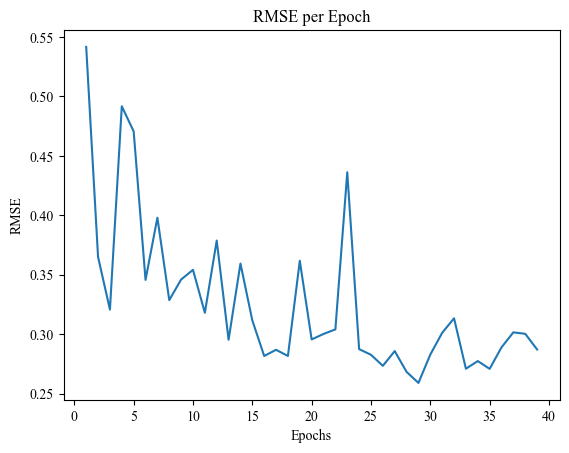

| 20        | -4.236    | 0.8566    | 23.09     | 0.307     | 49.26     | 67.23     | 235.0     | 81.87     |
Epoch 1/33, RMSE: 0.3581
Epoch 2/33, RMSE: 0.4476
Epoch 3/33, RMSE: 0.3470
Epoch 4/33, RMSE: 0.3089
Epoch 5/33, RMSE: 0.2758
Epoch 6/33, RMSE: 0.2774
Epoch 7/33, RMSE: 0.2654
Epoch 8/33, RMSE: 0.2457
Epoch 9/33, RMSE: 0.3081
Epoch 10/33, RMSE: 0.2788
Epoch 11/33, RMSE: 0.2786
Epoch 12/33, RMSE: 0.2899
Epoch 13/33, RMSE: 0.2697
Epoch 14/33, RMSE: 0.2527
Epoch 15/33, RMSE: 0.2527
Epoch 16/33, RMSE: 0.2630
Epoch 17/33, RMSE: 0.2389
Epoch 18/33, RMSE: 0.2609
Epoch 19/33, RMSE: 0.2466
Epoch 20/33, RMSE: 0.3166
Epoch 21/33, RMSE: 0.2572
Epoch 22/33, RMSE: 0.2330
Epoch 23/33, RMSE: 0.2409
Epoch 24/33, RMSE: 0.2436
Epoch 25/33, RMSE: 0.2440
Epoch 26/33, RMSE: 0.2597
Epoch 27/33, RMSE: 0.2844
Epoch 28/33, RMSE: 0.2300
Epoch 29/33, RMSE: 0.2724
Epoch 30/33, RMSE: 0.2305
Epoch 31/33, RMSE: 0.2615
Epoch 32/33, RMSE: 0.2252
Epoch 33/33, RMSE: 0.2479


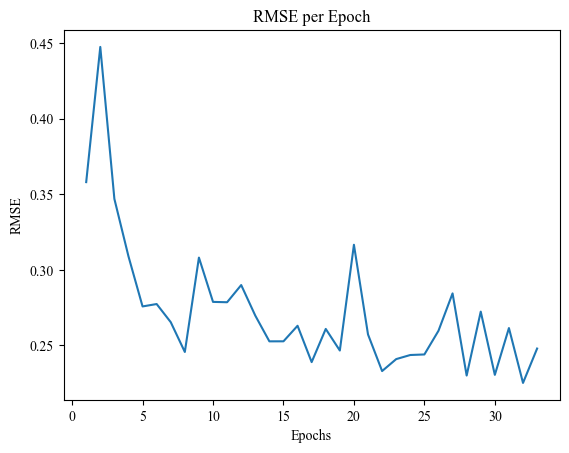

| 21        | -3.953    | 0.01295   | 29.32     | 0.2163    | 33.45     | 162.1     | 94.66     | 124.8     |
Epoch 1/11, RMSE: 0.4685
Epoch 2/11, RMSE: 0.4730
Epoch 3/11, RMSE: 0.4636
Epoch 4/11, RMSE: 0.3465
Epoch 5/11, RMSE: 0.3643
Epoch 6/11, RMSE: 0.3265
Epoch 7/11, RMSE: 0.3217
Epoch 8/11, RMSE: 0.2891
Epoch 9/11, RMSE: 0.3448
Epoch 10/11, RMSE: 0.3327
Epoch 11/11, RMSE: 0.2729


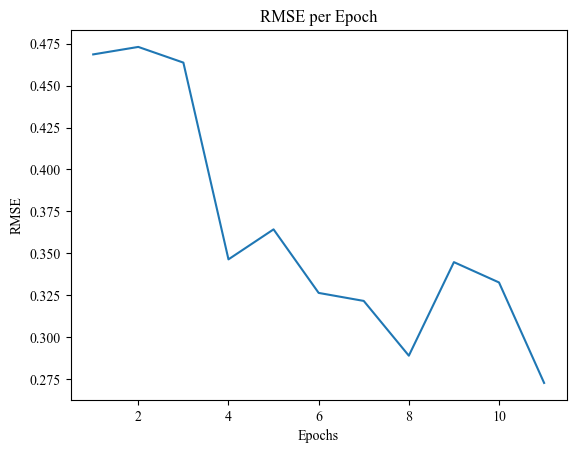

| 22        | -3.682    | 1.555     | 38.57     | 0.3394    | 11.04     | 148.9     | 173.3     | 96.87     |
Epoch 1/28, RMSE: 0.4251
Epoch 2/28, RMSE: 0.3625
Epoch 3/28, RMSE: 0.3609
Epoch 4/28, RMSE: 0.3621
Epoch 5/28, RMSE: 0.3130
Epoch 6/28, RMSE: 0.3005
Epoch 7/28, RMSE: 0.2850
Epoch 8/28, RMSE: 0.2921
Epoch 9/28, RMSE: 0.3157
Epoch 10/28, RMSE: 0.2713
Epoch 11/28, RMSE: 0.2655
Epoch 12/28, RMSE: 0.2681
Epoch 13/28, RMSE: 0.2443
Epoch 14/28, RMSE: 0.2848
Epoch 15/28, RMSE: 0.2447
Epoch 16/28, RMSE: 0.3239
Epoch 17/28, RMSE: 0.2789
Epoch 18/28, RMSE: 0.2503
Epoch 19/28, RMSE: 0.2797
Epoch 20/28, RMSE: 0.4272
Epoch 21/28, RMSE: 0.2327
Epoch 22/28, RMSE: 0.3037
Epoch 23/28, RMSE: 0.2595
Epoch 24/28, RMSE: 0.2857
Epoch 25/28, RMSE: 0.3039
Epoch 26/28, RMSE: 0.2828
Epoch 27/28, RMSE: 0.2998
Epoch 28/28, RMSE: 0.2688


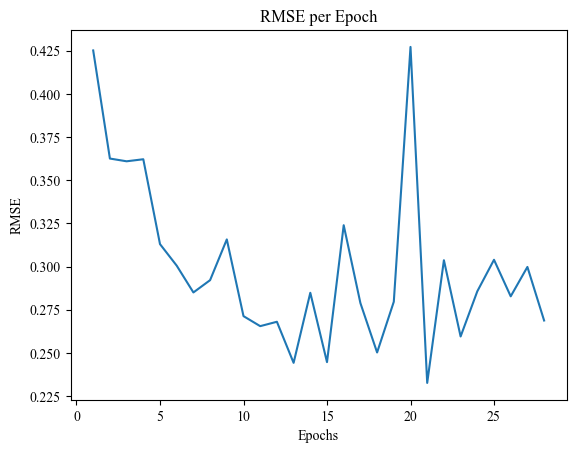

| 23        | -2.802    | 0.6746    | 48.63     | 0.1378    | 28.86     | 250.8     | 175.9     | 107.1     |
Epoch 1/48, RMSE: 0.3572
Epoch 2/48, RMSE: 0.4645
Epoch 3/48, RMSE: 0.3414
Epoch 4/48, RMSE: 0.3277
Epoch 5/48, RMSE: 0.3557
Epoch 6/48, RMSE: 0.3513
Epoch 7/48, RMSE: 0.3264
Epoch 8/48, RMSE: 0.3018
Epoch 9/48, RMSE: 0.3591
Epoch 10/48, RMSE: 0.2841
Epoch 11/48, RMSE: 0.2916
Epoch 12/48, RMSE: 0.3083
Epoch 13/48, RMSE: 0.2743
Epoch 14/48, RMSE: 0.2551
Epoch 15/48, RMSE: 0.2750
Epoch 16/48, RMSE: 0.2702
Epoch 17/48, RMSE: 0.2624
Epoch 18/48, RMSE: 0.2658
Epoch 19/48, RMSE: 0.3327
Epoch 20/48, RMSE: 0.2737
Epoch 21/48, RMSE: 0.2514
Epoch 22/48, RMSE: 0.2492
Epoch 23/48, RMSE: 0.2324
Epoch 24/48, RMSE: 0.2626
Epoch 25/48, RMSE: 0.2652
Epoch 26/48, RMSE: 0.2356
Epoch 27/48, RMSE: 0.2769
Epoch 28/48, RMSE: 0.2511
Epoch 29/48, RMSE: 0.2511
Epoch 30/48, RMSE: 0.2450
Epoch 31/48, RMSE: 0.3150
Epoch 32/48, RMSE: 0.2473
Epoch 33/48, RMSE: 0.2393
Early stopping at epoch 33


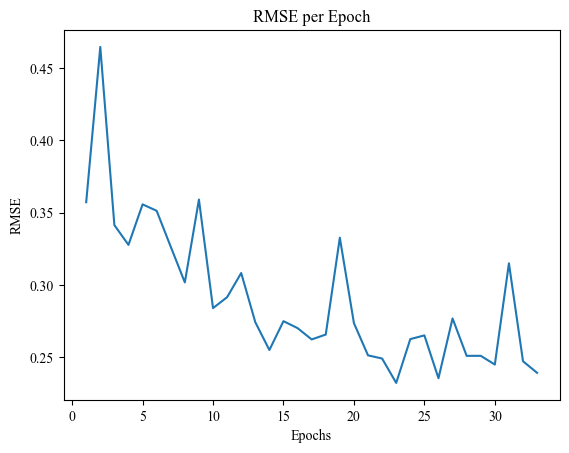

| 24        | -3.546    | 0.9884    | 42.29     | 0.3201    | 48.11     | 154.5     | 244.6     | 62.21     |
Epoch 1/36, RMSE: 0.5721
Epoch 2/36, RMSE: 0.4465
Epoch 3/36, RMSE: 0.3690
Epoch 4/36, RMSE: 0.3340
Epoch 5/36, RMSE: 0.3137
Epoch 6/36, RMSE: 0.4584
Epoch 7/36, RMSE: 0.6533
Epoch 8/36, RMSE: 0.4181
Epoch 9/36, RMSE: 0.3019
Epoch 10/36, RMSE: 0.3383
Epoch 11/36, RMSE: 0.3598
Epoch 12/36, RMSE: 0.2865
Epoch 13/36, RMSE: 0.3022
Epoch 14/36, RMSE: 0.3582
Epoch 15/36, RMSE: 0.2985
Epoch 16/36, RMSE: 0.2868
Epoch 17/36, RMSE: 0.2700
Epoch 18/36, RMSE: 0.2730
Epoch 19/36, RMSE: 0.2639
Epoch 20/36, RMSE: 0.2718
Epoch 21/36, RMSE: 0.2809
Epoch 22/36, RMSE: 0.2516
Epoch 23/36, RMSE: 0.2971
Epoch 24/36, RMSE: 0.2758
Epoch 25/36, RMSE: 0.2932
Epoch 26/36, RMSE: 0.2621
Epoch 27/36, RMSE: 0.2499
Epoch 28/36, RMSE: 0.2407
Epoch 29/36, RMSE: 0.2701
Epoch 30/36, RMSE: 0.2284
Epoch 31/36, RMSE: 0.2619
Epoch 32/36, RMSE: 0.2637
Epoch 33/36, RMSE: 0.2530
Epoch 34/36, RMSE: 0.2826
Epoch 35/36, RM

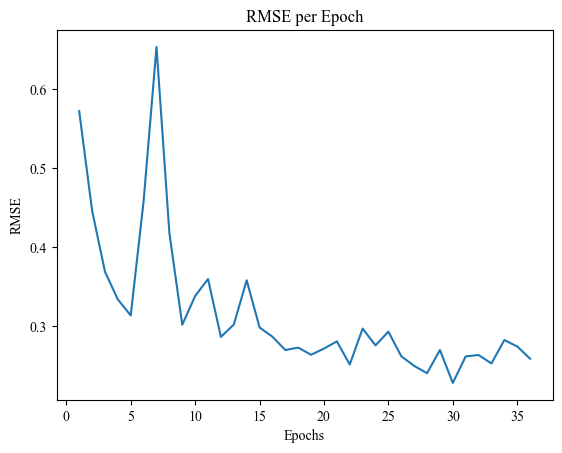

| 25        | -3.658    | 1.493     | 23.54     | 0.2813    | 36.24     | 184.2     | 103.4     | 103.8     |
Epoch 1/37, RMSE: 0.3693
Epoch 2/37, RMSE: 0.3265
Epoch 3/37, RMSE: 0.3238
Epoch 4/37, RMSE: 0.3235
Epoch 5/37, RMSE: 0.3040
Epoch 6/37, RMSE: 0.2835
Epoch 7/37, RMSE: 0.2989
Epoch 8/37, RMSE: 0.2753
Epoch 9/37, RMSE: 0.2573
Epoch 10/37, RMSE: 0.2497
Epoch 11/37, RMSE: 0.2691
Epoch 12/37, RMSE: 0.2990
Epoch 13/37, RMSE: 0.2976
Epoch 14/37, RMSE: 0.2720
Epoch 15/37, RMSE: 0.2690
Epoch 16/37, RMSE: 0.2678
Epoch 17/37, RMSE: 0.2895
Epoch 18/37, RMSE: 0.2613
Epoch 19/37, RMSE: 0.2589
Epoch 20/37, RMSE: 0.3238
Early stopping at epoch 20


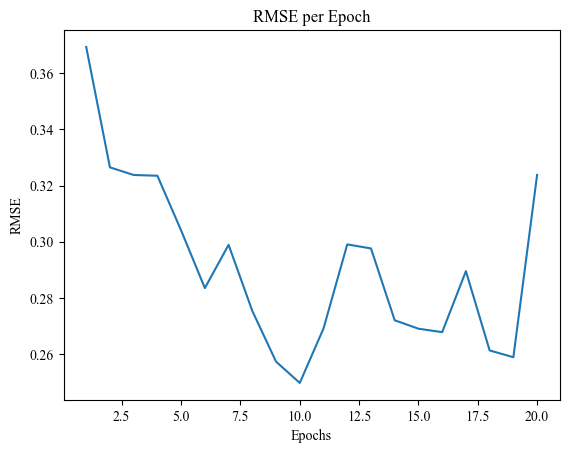

| 26        | -4.324    | 1.877     | 41.63     | 0.2017    | 37.8      | 106.4     | 188.5     | 102.7     |
Epoch 1/20, RMSE: 0.3603
Epoch 2/20, RMSE: 0.3662
Epoch 3/20, RMSE: 0.3140
Epoch 4/20, RMSE: 0.3254
Epoch 5/20, RMSE: 0.3801
Epoch 6/20, RMSE: 0.4210
Epoch 7/20, RMSE: 0.3191
Epoch 8/20, RMSE: 0.3423
Epoch 9/20, RMSE: 0.3174
Epoch 10/20, RMSE: 0.2994
Epoch 11/20, RMSE: 0.2867
Epoch 12/20, RMSE: 0.3112
Epoch 13/20, RMSE: 0.2869
Epoch 14/20, RMSE: 0.2785
Epoch 15/20, RMSE: 0.2605
Epoch 16/20, RMSE: 0.2820
Epoch 17/20, RMSE: 0.2447
Epoch 18/20, RMSE: 0.2361
Epoch 19/20, RMSE: 0.2597
Epoch 20/20, RMSE: 0.2850


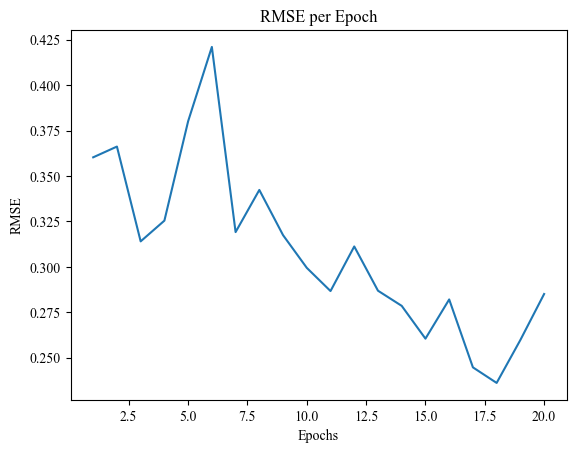

| 27        | -3.411    | 1.346     | 29.87     | 0.3214    | 20.78     | 144.8     | 111.0     | 127.2     |
Epoch 1/28, RMSE: 0.3415
Epoch 2/28, RMSE: 0.3383
Epoch 3/28, RMSE: 0.4382
Epoch 4/28, RMSE: 0.3650
Epoch 5/28, RMSE: 0.3709
Epoch 6/28, RMSE: 0.3433
Epoch 7/28, RMSE: 0.3546
Epoch 8/28, RMSE: 0.3321
Epoch 9/28, RMSE: 0.3105
Epoch 10/28, RMSE: 0.2998
Epoch 11/28, RMSE: 0.2688
Epoch 12/28, RMSE: 0.2442
Epoch 13/28, RMSE: 0.2715
Epoch 14/28, RMSE: 0.2334
Epoch 15/28, RMSE: 0.2404
Epoch 16/28, RMSE: 0.2583
Epoch 17/28, RMSE: 0.2678
Epoch 18/28, RMSE: 0.2519
Epoch 19/28, RMSE: 0.2753
Epoch 20/28, RMSE: 0.3201
Epoch 21/28, RMSE: 0.2569
Epoch 22/28, RMSE: 0.2956
Epoch 23/28, RMSE: 0.3034
Epoch 24/28, RMSE: 0.2732
Early stopping at epoch 24


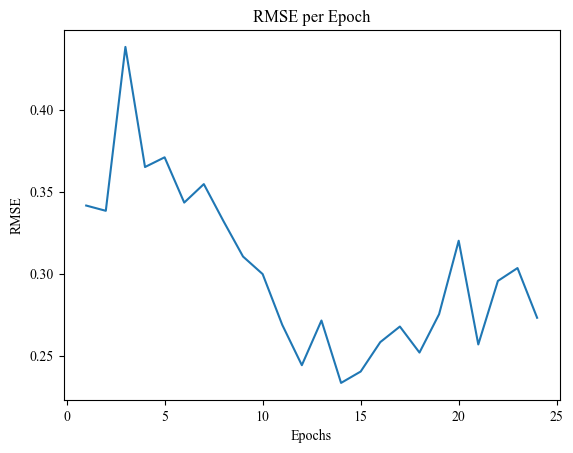

| 28        | -3.456    | 1.064     | 39.84     | 0.3058    | 28.08     | 172.5     | 142.1     | 33.04     |
Epoch 1/21, RMSE: 0.4525
Epoch 2/21, RMSE: 0.5711
Epoch 3/21, RMSE: 0.4598
Epoch 4/21, RMSE: 0.4621
Epoch 5/21, RMSE: 0.3551
Epoch 6/21, RMSE: 0.2924
Epoch 7/21, RMSE: 0.2875
Epoch 8/21, RMSE: 0.2837
Epoch 9/21, RMSE: 0.2973
Epoch 10/21, RMSE: 0.3267
Epoch 11/21, RMSE: 0.2499
Epoch 12/21, RMSE: 0.2570
Epoch 13/21, RMSE: 0.2625
Epoch 14/21, RMSE: 0.3269
Epoch 15/21, RMSE: 0.2780
Epoch 16/21, RMSE: 0.2488
Epoch 17/21, RMSE: 0.2594
Epoch 18/21, RMSE: 0.3060
Epoch 19/21, RMSE: 0.2603
Epoch 20/21, RMSE: 0.3387
Epoch 21/21, RMSE: 0.2757


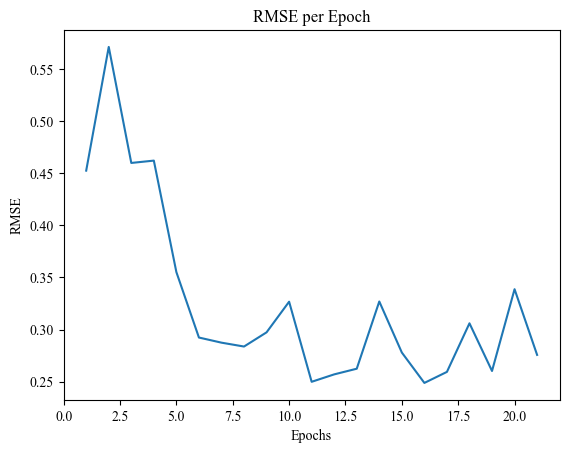

| 29        | -3.941    | 1.676     | 33.71     | 0.2496    | 21.14     | 253.3     | 144.2     | 104.4     |
Epoch 1/34, RMSE: 0.3797
Epoch 2/34, RMSE: 0.3986
Epoch 3/34, RMSE: 0.3896
Epoch 4/34, RMSE: 0.3496
Epoch 5/34, RMSE: 0.3344
Epoch 6/34, RMSE: 0.3601
Epoch 7/34, RMSE: 0.3183
Epoch 8/34, RMSE: 0.3003
Epoch 9/34, RMSE: 0.2611
Epoch 10/34, RMSE: 0.2708
Epoch 11/34, RMSE: 0.2970
Epoch 12/34, RMSE: 0.2683
Epoch 13/34, RMSE: 0.2507
Epoch 14/34, RMSE: 0.2642
Epoch 15/34, RMSE: 0.2505
Epoch 16/34, RMSE: 0.2432
Epoch 17/34, RMSE: 0.2744
Epoch 18/34, RMSE: 0.2401
Epoch 19/34, RMSE: 0.2316
Epoch 20/34, RMSE: 0.2447
Epoch 21/34, RMSE: 0.2483
Epoch 22/34, RMSE: 0.2456
Epoch 23/34, RMSE: 0.2471
Epoch 24/34, RMSE: 0.2637
Epoch 25/34, RMSE: 0.3542
Epoch 26/34, RMSE: 0.2771
Epoch 27/34, RMSE: 0.2680
Epoch 28/34, RMSE: 0.2691
Epoch 29/34, RMSE: 0.2536
Early stopping at epoch 29


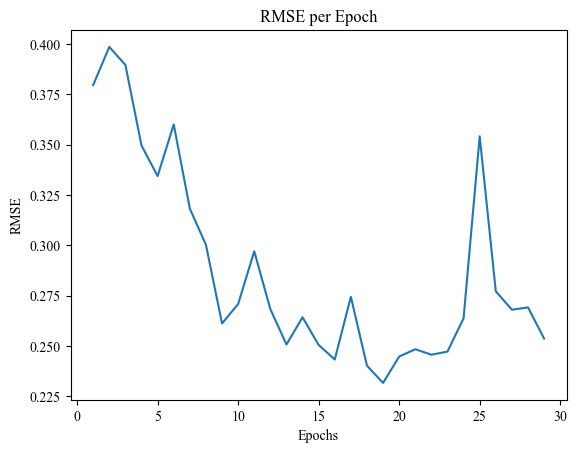

| 30        | -3.826    | 0.6581    | 38.94     | 0.2372    | 34.37     | 206.5     | 68.4      | 50.93     |
Epoch 1/31, RMSE: 0.3395
Epoch 2/31, RMSE: 0.3580
Epoch 3/31, RMSE: 0.3480
Epoch 4/31, RMSE: 0.3897
Epoch 5/31, RMSE: 0.3814
Epoch 6/31, RMSE: 0.3504
Epoch 7/31, RMSE: 0.3349
Epoch 8/31, RMSE: 0.3001
Epoch 9/31, RMSE: 0.3448
Epoch 10/31, RMSE: 0.3345
Epoch 11/31, RMSE: 0.3046
Epoch 12/31, RMSE: 0.2838
Epoch 13/31, RMSE: 0.2740
Epoch 14/31, RMSE: 0.2786
Epoch 15/31, RMSE: 0.2875
Epoch 16/31, RMSE: 0.2934
Epoch 17/31, RMSE: 0.2671
Epoch 18/31, RMSE: 0.2968
Epoch 19/31, RMSE: 0.2719
Epoch 20/31, RMSE: 0.2703
Epoch 21/31, RMSE: 0.2762
Epoch 22/31, RMSE: 0.2710
Epoch 23/31, RMSE: 0.2532
Epoch 24/31, RMSE: 0.2644
Epoch 25/31, RMSE: 0.2776
Epoch 26/31, RMSE: 0.2583
Epoch 27/31, RMSE: 0.2378
Epoch 28/31, RMSE: 0.2345
Epoch 29/31, RMSE: 0.2318
Epoch 30/31, RMSE: 0.2398
Epoch 31/31, RMSE: 0.2504


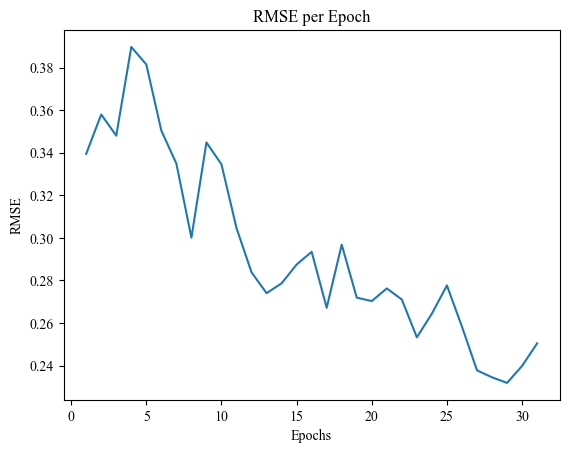

| 31        | -3.876    | 0.8071    | 36.67     | 0.4988    | 31.79     | 102.8     | 215.0     | 62.49     |
Epoch 1/24, RMSE: 0.7033
Epoch 2/24, RMSE: 0.5609
Epoch 3/24, RMSE: 0.5916
Epoch 4/24, RMSE: 0.4289
Epoch 5/24, RMSE: 0.6339
Epoch 6/24, RMSE: 0.4652
Epoch 7/24, RMSE: 0.4181
Epoch 8/24, RMSE: 0.3601
Epoch 9/24, RMSE: 0.4117
Epoch 10/24, RMSE: 0.3956
Epoch 11/24, RMSE: 0.6018
Epoch 12/24, RMSE: 0.3651
Epoch 13/24, RMSE: 0.4350
Epoch 14/24, RMSE: 0.6306
Epoch 15/24, RMSE: 0.4337
Epoch 16/24, RMSE: 0.5249
Epoch 17/24, RMSE: 0.3742
Epoch 18/24, RMSE: 0.3941
Early stopping at epoch 18


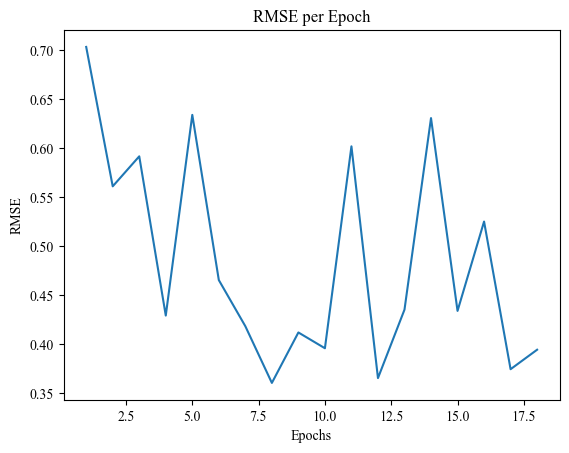

| 32        | -4.705    | 1.185     | 18.74     | 0.2365    | 24.72     | 149.4     | 255.2     | 87.54     |
Epoch 1/12, RMSE: 0.4416
Epoch 2/12, RMSE: 0.3626
Epoch 3/12, RMSE: 0.3759
Epoch 4/12, RMSE: 0.4515
Epoch 5/12, RMSE: 0.3406
Epoch 6/12, RMSE: 0.4348
Epoch 7/12, RMSE: 0.3364
Epoch 8/12, RMSE: 0.2782
Epoch 9/12, RMSE: 0.2561
Epoch 10/12, RMSE: 0.2945
Epoch 11/12, RMSE: 0.2634
Epoch 12/12, RMSE: 0.2369


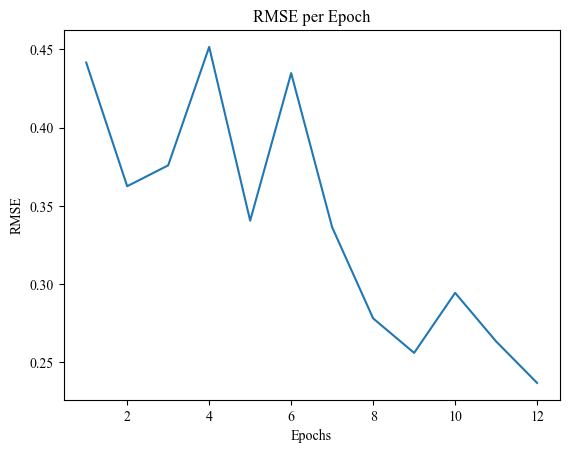

| 33        | -3.174    | 0.1255    | 49.38     | 0.1923    | 12.93     | 254.3     | 232.5     | 117.0     |
Epoch 1/10, RMSE: 0.3540
Epoch 2/10, RMSE: 0.4005
Epoch 3/10, RMSE: 0.4631
Epoch 4/10, RMSE: 0.3787
Epoch 5/10, RMSE: 0.3724
Epoch 6/10, RMSE: 0.3491
Epoch 7/10, RMSE: 0.3352
Epoch 8/10, RMSE: 0.3379
Epoch 9/10, RMSE: 0.3149
Epoch 10/10, RMSE: 0.3436


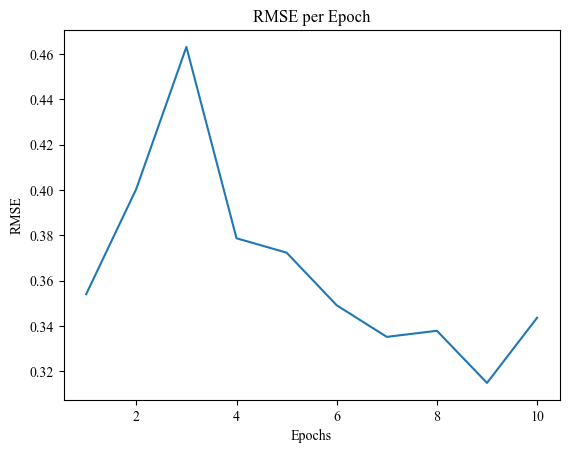

| 34        | -3.926    | 1.152     | 31.05     | 0.2923    | 10.46     | 157.0     | 160.7     | 34.85     |
Epoch 1/16, RMSE: 0.4629
Epoch 2/16, RMSE: 0.3641
Epoch 3/16, RMSE: 0.3274
Epoch 4/16, RMSE: 0.3606
Epoch 5/16, RMSE: 0.3891
Epoch 6/16, RMSE: 0.3175
Epoch 7/16, RMSE: 0.3987
Epoch 8/16, RMSE: 0.2695
Epoch 9/16, RMSE: 0.3136
Epoch 10/16, RMSE: 0.2468
Epoch 11/16, RMSE: 0.3039
Epoch 12/16, RMSE: 0.2694
Epoch 13/16, RMSE: 0.2591
Epoch 14/16, RMSE: 0.2642
Epoch 15/16, RMSE: 0.2693
Epoch 16/16, RMSE: 0.2427


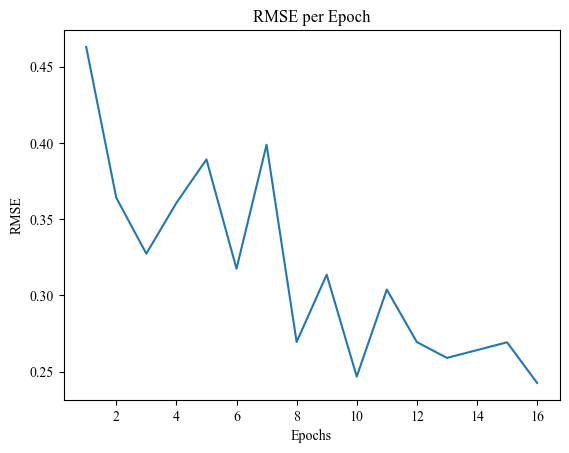

| 35        | -3.68     | 1.611     | 49.58     | 0.1759    | 16.23     | 123.9     | 142.3     | 70.46     |
Epoch 1/44, RMSE: 0.3506
Epoch 2/44, RMSE: 0.4279
Epoch 3/44, RMSE: 0.3834
Epoch 4/44, RMSE: 0.3432
Epoch 5/44, RMSE: 0.3428
Epoch 6/44, RMSE: 0.3489
Epoch 7/44, RMSE: 0.2994
Epoch 8/44, RMSE: 0.3061
Epoch 9/44, RMSE: 0.2743
Epoch 10/44, RMSE: 0.2630
Epoch 11/44, RMSE: 0.2900
Epoch 12/44, RMSE: 0.2771
Epoch 13/44, RMSE: 0.2853
Epoch 14/44, RMSE: 0.2893
Epoch 15/44, RMSE: 0.2967
Epoch 16/44, RMSE: 0.2862
Epoch 17/44, RMSE: 0.2624
Epoch 18/44, RMSE: 0.2899
Epoch 19/44, RMSE: 0.2667
Epoch 20/44, RMSE: 0.2734
Epoch 21/44, RMSE: 0.2647
Epoch 22/44, RMSE: 0.2472
Epoch 23/44, RMSE: 0.2469
Epoch 24/44, RMSE: 0.2646
Epoch 25/44, RMSE: 0.2286
Epoch 26/44, RMSE: 0.2417
Epoch 27/44, RMSE: 0.2338
Epoch 28/44, RMSE: 0.2317
Epoch 29/44, RMSE: 0.2409
Epoch 30/44, RMSE: 0.2361
Epoch 31/44, RMSE: 0.2596
Epoch 32/44, RMSE: 0.2155
Epoch 33/44, RMSE: 0.2231
Epoch 34/44, RMSE: 0.2271
Epoch 35/44, RM

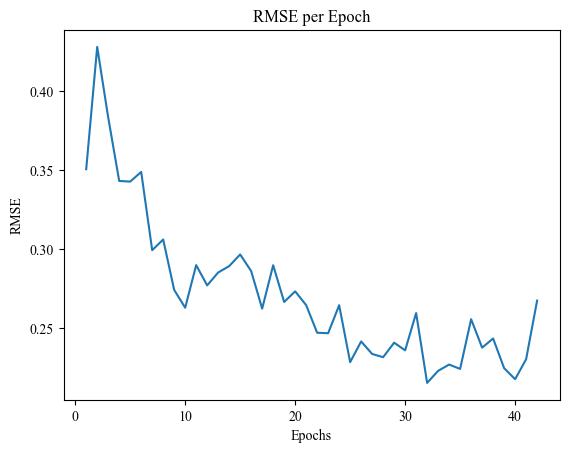

| 36        | -3.847    | 1.868     | 37.54     | 0.3662    | 44.25     | 126.8     | 64.34     | 94.14     |
Epoch 1/28, RMSE: 0.4169
Epoch 2/28, RMSE: 0.3639
Epoch 3/28, RMSE: 0.4226
Epoch 4/28, RMSE: 0.3737
Epoch 5/28, RMSE: 0.3930
Epoch 6/28, RMSE: 0.2973
Epoch 7/28, RMSE: 0.3093
Epoch 8/28, RMSE: 0.2566
Epoch 9/28, RMSE: 0.2731
Epoch 10/28, RMSE: 0.2714
Epoch 11/28, RMSE: 0.2740
Epoch 12/28, RMSE: 0.2796
Epoch 13/28, RMSE: 0.2660
Epoch 14/28, RMSE: 0.2511
Epoch 15/28, RMSE: 0.2624
Epoch 16/28, RMSE: 0.2517
Epoch 17/28, RMSE: 0.2441
Epoch 18/28, RMSE: 0.2558
Epoch 19/28, RMSE: 0.2380
Epoch 20/28, RMSE: 0.2604
Epoch 21/28, RMSE: 0.2392
Epoch 22/28, RMSE: 0.2451
Epoch 23/28, RMSE: 0.2345
Epoch 24/28, RMSE: 0.2671
Epoch 25/28, RMSE: 0.2533
Epoch 26/28, RMSE: 0.2408
Epoch 27/28, RMSE: 0.2617
Epoch 28/28, RMSE: 0.2586


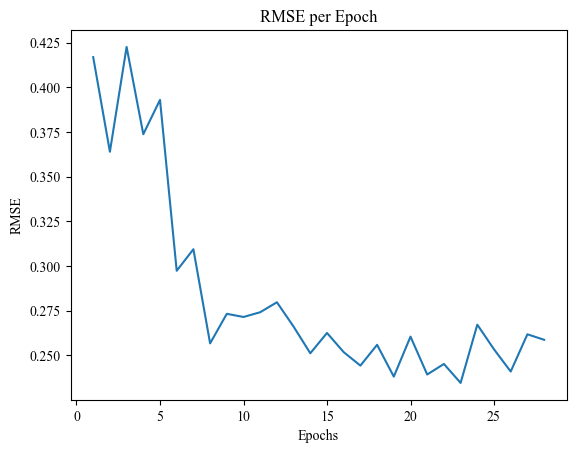

| 37        | -4.067    | 0.4472    | 26.64     | 0.3744    | 28.88     | 167.4     | 100.3     | 107.6     |
Epoch 1/20, RMSE: 0.3800
Epoch 2/20, RMSE: 0.3875
Epoch 3/20, RMSE: 0.4445
Epoch 4/20, RMSE: 0.3855
Epoch 5/20, RMSE: 0.3889
Epoch 6/20, RMSE: 0.3013
Epoch 7/20, RMSE: 0.3000
Epoch 8/20, RMSE: 0.2724
Epoch 9/20, RMSE: 0.3391
Epoch 10/20, RMSE: 0.2725
Epoch 11/20, RMSE: 0.2606
Epoch 12/20, RMSE: 0.2520
Epoch 13/20, RMSE: 0.2435
Epoch 14/20, RMSE: 0.2488
Epoch 15/20, RMSE: 0.3012
Epoch 16/20, RMSE: 0.2540
Epoch 17/20, RMSE: 0.3415
Epoch 18/20, RMSE: 0.3026
Epoch 19/20, RMSE: 0.3174
Epoch 20/20, RMSE: 0.3246


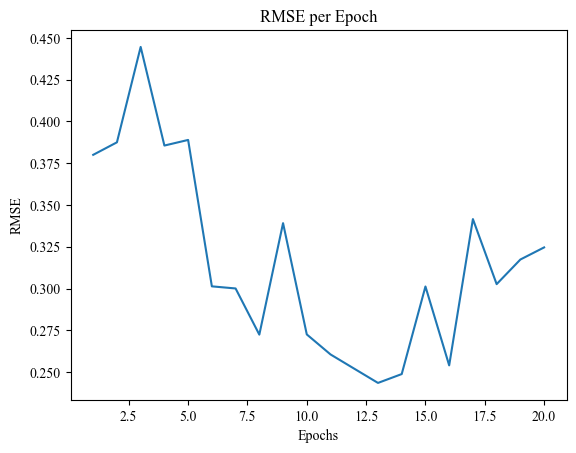

| 38        | -3.414    | 1.056     | 42.5      | 0.4639    | 20.03     | 209.8     | 235.3     | 48.04     |
Epoch 1/39, RMSE: 0.4236
Epoch 2/39, RMSE: 0.4129
Epoch 3/39, RMSE: 0.4167
Epoch 4/39, RMSE: 0.4078
Epoch 5/39, RMSE: 0.3017
Epoch 6/39, RMSE: 0.3272
Epoch 7/39, RMSE: 0.2895
Epoch 8/39, RMSE: 0.2751
Epoch 9/39, RMSE: 0.2574
Epoch 10/39, RMSE: 0.3582
Epoch 11/39, RMSE: 0.3045
Epoch 12/39, RMSE: 0.2318
Epoch 13/39, RMSE: 0.2341
Epoch 14/39, RMSE: 0.2354
Epoch 15/39, RMSE: 0.2391
Epoch 16/39, RMSE: 0.2749
Epoch 17/39, RMSE: 0.2270
Epoch 18/39, RMSE: 0.2453
Epoch 19/39, RMSE: 0.2702
Epoch 20/39, RMSE: 0.2380
Epoch 21/39, RMSE: 0.2362
Epoch 22/39, RMSE: 0.2733
Epoch 23/39, RMSE: 0.2580
Epoch 24/39, RMSE: 0.2520
Epoch 25/39, RMSE: 0.2451
Epoch 26/39, RMSE: 0.3370
Epoch 27/39, RMSE: 0.3445
Early stopping at epoch 27


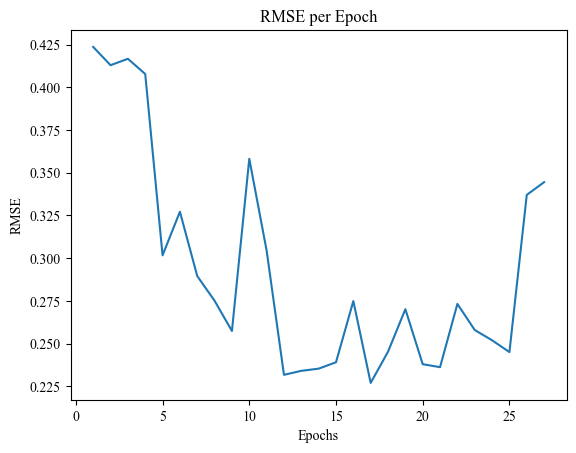

| 39        | -3.779    | 0.9641    | 49.18     | 0.3962    | 39.56     | 243.1     | 155.8     | 112.6     |
Epoch 1/28, RMSE: 0.4600
Epoch 2/28, RMSE: 0.4331
Epoch 3/28, RMSE: 0.3818
Epoch 4/28, RMSE: 0.3772
Epoch 5/28, RMSE: 0.3883
Epoch 6/28, RMSE: 0.3424
Epoch 7/28, RMSE: 0.3097
Epoch 8/28, RMSE: 0.3802
Epoch 9/28, RMSE: 0.3002
Epoch 10/28, RMSE: 0.2848
Epoch 11/28, RMSE: 0.2780
Epoch 12/28, RMSE: 0.2790
Epoch 13/28, RMSE: 0.2683
Epoch 14/28, RMSE: 0.2591
Epoch 15/28, RMSE: 0.2703
Epoch 16/28, RMSE: 0.2774
Epoch 17/28, RMSE: 0.2569
Epoch 18/28, RMSE: 0.2562
Epoch 19/28, RMSE: 0.2538
Epoch 20/28, RMSE: 0.2430
Epoch 21/28, RMSE: 0.2588
Epoch 22/28, RMSE: 0.2389
Epoch 23/28, RMSE: 0.2433
Epoch 24/28, RMSE: 0.2394
Epoch 25/28, RMSE: 0.2649
Epoch 26/28, RMSE: 0.2719
Epoch 27/28, RMSE: 0.2434
Epoch 28/28, RMSE: 0.2357


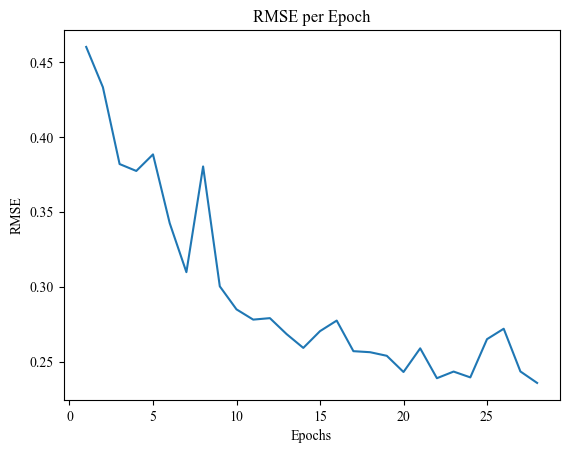

| 40        | -3.699    | 1.326     | 35.72     | 0.4697    | 28.14     | 190.1     | 144.5     | 113.3     |
Mejores hiperparámetros: Epochs=28, Batch size=48, Dropout=0.13783708843384335, Hidden Dims=[250, 175, 107], Activation=ReLU()
Epoch 1/28, RMSE: 0.3541
Epoch 2/28, RMSE: 0.3316
Epoch 3/28, RMSE: 0.3772
Epoch 4/28, RMSE: 0.3432
Epoch 5/28, RMSE: 0.3256
Epoch 6/28, RMSE: 0.3232
Epoch 7/28, RMSE: 0.3111
Epoch 8/28, RMSE: 0.3057
Epoch 9/28, RMSE: 0.2829
Epoch 10/28, RMSE: 0.2619
Epoch 11/28, RMSE: 0.2720
Epoch 12/28, RMSE: 0.2442
Epoch 13/28, RMSE: 0.2577
Epoch 14/28, RMSE: 0.2350
Epoch 15/28, RMSE: 0.2585
Epoch 16/28, RMSE: 0.3105
Epoch 17/28, RMSE: 0.2880
Epoch 18/28, RMSE: 0.3424
Epoch 19/28, RMSE: 0.3288
Epoch 20/28, RMSE: 0.2869
Epoch 21/28, RMSE: 0.3714
Epoch 22/28, RMSE: 0.3276
Epoch 23/28, RMSE: 0.3913
Epoch 24/28, RMSE: 0.3288
Early stopping at epoch 24


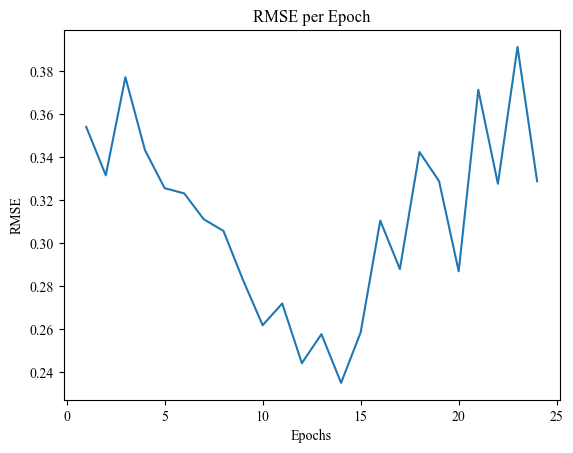

In [297]:
# Definir la clase del modelo ANN con más capas y Dropout
class ANNModel(nn.Module):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU()):
        super(ANNModel, self).__init__()
        self.hidden_layers = nn.ModuleList()
        self.dropout = nn.Dropout(dropout_prob)
        self.activation_fn = activation_fn
        
        # Primera capa
        self.hidden_layers.append(nn.Linear(input_dim, hidden_dims[0]))
        
        # Capas ocultas intermedias
        for i in range(1, len(hidden_dims)):
            self.hidden_layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i]))
        
        # Capa de salida
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x):
        for layer in self.hidden_layers:
            x = self.activation_fn(layer(x))
            x = self.dropout(x)
        x = self.output_layer(x)
        return x

# Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
class SklearnWrapper(BaseEstimator, RegressorMixin):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU(), 
                 epochs=100, batch_size=32, learning_rate=0.001):
        self.input_dim = input_dim
        self.hidden_dims = hidden_dims
        self.dropout_prob = dropout_prob
        self.activation_fn = activation_fn
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.model = ANNModel(input_dim, hidden_dims, dropout_prob, activation_fn)
        self.criterion = nn.MSELoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
        self.scheduler = optim.lr_scheduler.StepLR(self.optimizer, step_size=50, gamma=0.1)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.scaler_X = StandardScaler()
        self.scaler_y = StandardScaler()

    def fit(self, X, y):
        # Estandarizar los datos
        X = self.scaler_X.fit_transform(X)
        if isinstance(y, pd.Series):
            y = y.to_numpy()  # Convertir a numpy array si es necesario
        y = y.reshape(-1, 1)  # Asegurarse de que 'y' tenga la forma correcta
        y = self.scaler_y.fit_transform(y).flatten()

        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
        self.model.train()
        rmse_list = []
        best_rmse = float('inf')
        patience = 10
        patience_counter = 0

        for epoch in range(self.epochs):
            for i in range(0, len(X_tensor), self.batch_size):
                X_batch = X_tensor[i:i + self.batch_size]
                y_batch = y_tensor[i:i + self.batch_size]

                self.optimizer.zero_grad()
                outputs = self.model(X_batch).squeeze()
                loss = self.criterion(outputs, y_batch)
                loss.backward()
                self.optimizer.step()

            self.scheduler.step()

            # Evaluar el modelo después de cada epoch
            self.model.eval()
            with torch.no_grad():
                y_pred = self.model(X_tensor).squeeze().cpu().numpy()
                rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
                rmse_list.append(rmse)
                print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
                
                # Early stopping
                if rmse < best_rmse:
                    best_rmse = rmse
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if patience_counter >= patience:
                        print(f'Early stopping at epoch {epoch+1}')
                        break

            self.model.train()
        
        # Graficar el RMSE por epoch
        plt.plot(range(1, len(rmse_list) + 1), rmse_list)
        plt.xlabel('Epochs')
        plt.ylabel('RMSE')
        plt.title('RMSE per Epoch')
        plt.show()
        
        return self

    def predict(self, X):
        X = self.scaler_X.transform(X)
        
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            y_pred = self.model(X_tensor).squeeze().cpu().numpy()
        y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
        return y_pred

# Función auxiliar para decodificar la función de activación
def get_activation_function(name):
    if name == 0:
        return nn.ReLU()
    elif name == 1:
        return nn.Tanh()
    elif name == 2:
        return nn.LeakyReLU()
    else:
        return nn.ReLU()  # Default

# Guardar el modelo entrenado
def save_model(model, filename):
    joblib.dump(model, filename)

# Cargar el modelo entrenado
def load_model(filename):
    return joblib.load(filename)

# Definir la función de optimización
def train_evaluate_ANN(epochs, batch_size, dropout_prob, hidden_dim1, hidden_dim2, hidden_dim3, activation_fn):
    input_dim = X_train_goperators.shape[1]
    hidden_dims = [int(hidden_dim1), int(hidden_dim2), int(hidden_dim3)]
    activation = get_activation_function(activation_fn)

    ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=hidden_dims, dropout_prob=dropout_prob, 
                                 activation_fn=activation, epochs=int(epochs), batch_size=int(batch_size))
    ann_wrapper.fit(X_train_goperators, y_train_goperators)
    
    y_pred = ann_wrapper.predict(X_test_goperators)
    mse = mean_squared_error(y_test_goperators, y_pred)
    rmse = np.sqrt(mse)
    return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# Rango de hiperparámetros para la optimización bayesiana
pbounds = {
    'epochs': (10, 50),
    'batch_size': (10, 50),
    'dropout_prob': (0.1, 0.5),
    'hidden_dim1': (64, 256),
    'hidden_dim2': (64, 256),
    'hidden_dim3': (32, 128),
    'activation_fn': (0, 2)  # 0: ReLU, 1: Tanh, 2: LeakyReLU
}

# Realizar la optimización bayesiana
optimizer = BayesianOptimization(
    f=train_evaluate_ANN,
    pbounds=pbounds,
    random_state=42
)

optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}, Dropout={best_dropout_prob}, Hidden Dims={best_hidden_dims}, Activation={best_activation}')

input_dim = X_train_goperators.shape[1]

# Entrenar y evaluar el modelo final con los mejores hiperparámetros
ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=best_hidden_dims, dropout_prob=best_dropout_prob, 
                             activation_fn=best_activation, epochs=best_epochs, batch_size=best_batch_size)
ann_wrapper.fit(X_train_goperators, y_train_goperators)

# Guardar el modelo entrenado
save_model(ann_wrapper, 'ann_model_goperators1.pkl')

In [335]:
# Cargar el modelo entrenado
loaded_model_ann_goperators = load_model('ann_model_goperators1.pkl')

y_pred_ann_goperators = loaded_model_ann_goperators.predict(X_test_goperators)
    
# Calcular las métricas
mse_ann_goperators = mean_squared_error(y_test_goperators, y_pred_ann_goperators)
rmse_ann_goperators = np.sqrt(mse_ann_goperators)
mae_ann_goperators = mean_absolute_error(y_test_goperators, y_pred_ann_goperators)
r2_ann_goperators = r2_score(y_test_goperators, y_pred_ann_goperators)
    
# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_ann_goperators:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_ann_goperators:.5f}")
print(f"Mean Absolute Error (MAE): {mae_ann_goperators:.5f}")
print(f"R-squared (R^2): {r2_ann_goperators:.5f}")

Mean Squared Error (MSE): 13.52893
Root Mean Squared Error (RMSE): 3.67817
Mean Absolute Error (MAE): 2.66496
R-squared (R^2): 0.86777


In [338]:
# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

# Imprimir los mejores hiperparámetros
print(f'Mejores hiperparámetros:')
print(f'  Epochs: {best_epochs}')
print(f'  Batch size: {best_batch_size}')
print(f'  Dropout probability: {best_dropout_prob}')
print(f'  Hidden layer sizes: {best_hidden_dims}')
print(f'  Activation function: {best_activation}')

Mejores hiperparámetros:
  Epochs: 28
  Batch size: 48
  Dropout probability: 0.13783708843384335
  Hidden layer sizes: [250, 175, 107]
  Activation function: ReLU()


In [336]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ann_goperators = pd.DataFrame(y_pred_ann_goperators, columns=['pred_ann_goperators'])

# Guardar el DataFrame como un archivo CSV
pred_ann_goperators.to_csv('y_pred_ann_goperators.csv', index=False)

|   iter    |  target   | batch_... |  epochs   |
-------------------------------------------------
Epoch 1/95, RMSE: 0.3522
Epoch 2/95, RMSE: 0.3308
Epoch 3/95, RMSE: 0.3626
Epoch 4/95, RMSE: 0.3525
Epoch 5/95, RMSE: 0.3606
Epoch 6/95, RMSE: 0.3154
Epoch 7/95, RMSE: 0.3105
Epoch 8/95, RMSE: 0.2948
Epoch 9/95, RMSE: 0.2780
Epoch 10/95, RMSE: 0.2927
Epoch 11/95, RMSE: 0.2932
Epoch 12/95, RMSE: 0.3135
Epoch 13/95, RMSE: 0.3066
Epoch 14/95, RMSE: 0.3208
Epoch 15/95, RMSE: 0.3104
Epoch 16/95, RMSE: 0.2930
Epoch 17/95, RMSE: 0.3152
Epoch 18/95, RMSE: 0.2972
Epoch 19/95, RMSE: 0.2885
Epoch 20/95, RMSE: 0.2995
Epoch 21/95, RMSE: 0.2903
Epoch 22/95, RMSE: 0.2760
Epoch 23/95, RMSE: 0.2839
Epoch 24/95, RMSE: 0.2667
Epoch 25/95, RMSE: 0.2785
Epoch 26/95, RMSE: 0.2757
Epoch 27/95, RMSE: 0.2822
Epoch 28/95, RMSE: 0.2613
Epoch 29/95, RMSE: 0.2681
Epoch 30/95, RMSE: 0.2692
Epoch 31/95, RMSE: 0.2699
Epoch 32/95, RMSE: 0.2566
Epoch 33/95, RMSE: 0.2422
Epoch 34/95, RMSE: 0.2501
Epoch 35/95, RMSE: 0.2538

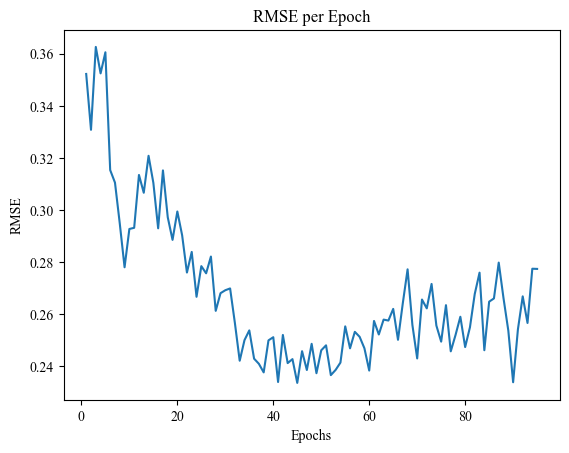

| 1         | -3.162    | 33.98     | 95.56     |
Epoch 1/63, RMSE: 0.3415
Epoch 2/63, RMSE: 0.2751
Epoch 3/63, RMSE: 0.2915
Epoch 4/63, RMSE: 0.2786
Epoch 5/63, RMSE: 0.2808
Epoch 6/63, RMSE: 0.2782
Epoch 7/63, RMSE: 0.2717
Epoch 8/63, RMSE: 0.2669
Epoch 9/63, RMSE: 0.2505
Epoch 10/63, RMSE: 0.2748
Epoch 11/63, RMSE: 0.2816
Epoch 12/63, RMSE: 0.2977
Epoch 13/63, RMSE: 0.3062
Epoch 14/63, RMSE: 0.3248
Epoch 15/63, RMSE: 0.3239
Epoch 16/63, RMSE: 0.3246
Epoch 17/63, RMSE: 0.3177
Epoch 18/63, RMSE: 0.3278
Epoch 19/63, RMSE: 0.3151
Epoch 20/63, RMSE: 0.3161
Epoch 21/63, RMSE: 0.3015
Epoch 22/63, RMSE: 0.3050
Epoch 23/63, RMSE: 0.3317
Epoch 24/63, RMSE: 0.3250
Epoch 25/63, RMSE: 0.3023
Epoch 26/63, RMSE: 0.3149
Epoch 27/63, RMSE: 0.3066
Epoch 28/63, RMSE: 0.2806
Epoch 29/63, RMSE: 0.3144
Epoch 30/63, RMSE: 0.3012
Epoch 31/63, RMSE: 0.3010
Epoch 32/63, RMSE: 0.2931
Epoch 33/63, RMSE: 0.2740
Epoch 34/63, RMSE: 0.2870
Epoch 35/63, RMSE: 0.2958
Epoch 36/63, RMSE: 0.2925
Epoch 37/63, RMSE: 0.27

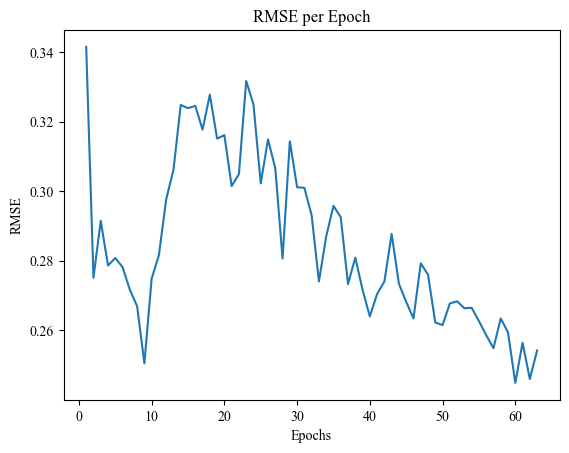

| 2         | -3.096    | 51.14     | 63.88     |
Epoch 1/24, RMSE: 0.3906
Epoch 2/24, RMSE: 0.3763
Epoch 3/24, RMSE: 0.3112
Epoch 4/24, RMSE: 0.2987
Epoch 5/24, RMSE: 0.2882
Epoch 6/24, RMSE: 0.2820
Epoch 7/24, RMSE: 0.2860
Epoch 8/24, RMSE: 0.2767
Epoch 9/24, RMSE: 0.2616
Epoch 10/24, RMSE: 0.2837
Epoch 11/24, RMSE: 0.2977
Epoch 12/24, RMSE: 0.2947
Epoch 13/24, RMSE: 0.2810
Epoch 14/24, RMSE: 0.2801
Epoch 15/24, RMSE: 0.2792
Epoch 16/24, RMSE: 0.2739
Epoch 17/24, RMSE: 0.2748
Epoch 18/24, RMSE: 0.2740
Epoch 19/24, RMSE: 0.2806
Epoch 20/24, RMSE: 0.2702
Epoch 21/24, RMSE: 0.2738
Epoch 22/24, RMSE: 0.2837
Epoch 23/24, RMSE: 0.2739
Epoch 24/24, RMSE: 0.2829


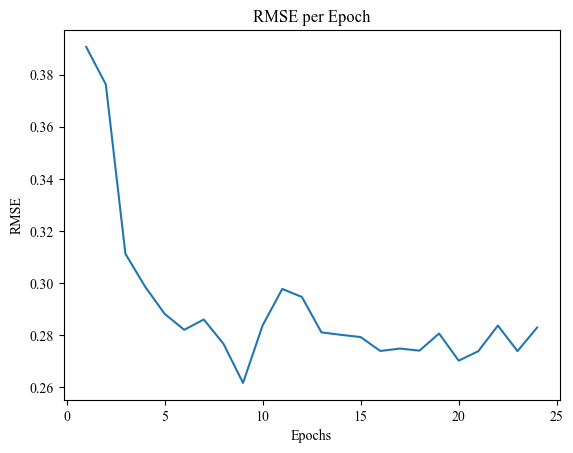

| 3         | -3.734    | 23.49     | 24.04     |
Epoch 1/87, RMSE: 0.4164
Epoch 2/87, RMSE: 0.3682
Epoch 3/87, RMSE: 0.3709
Epoch 4/87, RMSE: 0.3299
Epoch 5/87, RMSE: 0.3130
Epoch 6/87, RMSE: 0.3035
Epoch 7/87, RMSE: 0.2851
Epoch 8/87, RMSE: 0.2629
Epoch 9/87, RMSE: 0.2747
Epoch 10/87, RMSE: 0.2497
Epoch 11/87, RMSE: 0.2951
Epoch 12/87, RMSE: 0.3078
Epoch 13/87, RMSE: 0.3023
Epoch 14/87, RMSE: 0.3128
Epoch 15/87, RMSE: 0.3310
Epoch 16/87, RMSE: 0.3260
Epoch 17/87, RMSE: 0.3293
Epoch 18/87, RMSE: 0.3061
Epoch 19/87, RMSE: 0.3149
Epoch 20/87, RMSE: 0.3346
Epoch 21/87, RMSE: 0.3021
Epoch 22/87, RMSE: 0.3090
Epoch 23/87, RMSE: 0.3389
Epoch 24/87, RMSE: 0.3156
Epoch 25/87, RMSE: 0.3285
Epoch 26/87, RMSE: 0.3058
Epoch 27/87, RMSE: 0.3277
Epoch 28/87, RMSE: 0.3109
Epoch 29/87, RMSE: 0.3055
Epoch 30/87, RMSE: 0.3009
Epoch 31/87, RMSE: 0.3284
Epoch 32/87, RMSE: 0.2988
Epoch 33/87, RMSE: 0.3136
Epoch 34/87, RMSE: 0.3029
Epoch 35/87, RMSE: 0.2944
Epoch 36/87, RMSE: 0.3002
Epoch 37/87, RMSE: 0.31

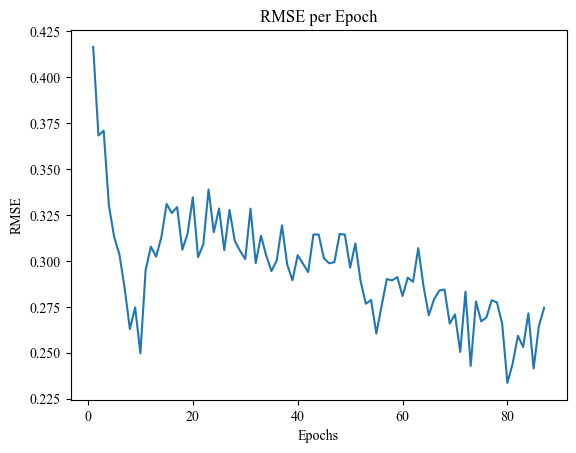

| 4         | -3.415    | 18.79     | 87.96     |
Epoch 1/73, RMSE: 0.3399
Epoch 2/73, RMSE: 0.3002
Epoch 3/73, RMSE: 0.3310
Epoch 4/73, RMSE: 0.3341
Epoch 5/73, RMSE: 0.3010
Epoch 6/73, RMSE: 0.2823
Epoch 7/73, RMSE: 0.2666
Epoch 8/73, RMSE: 0.2572
Epoch 9/73, RMSE: 0.2505
Epoch 10/73, RMSE: 0.2494
Epoch 11/73, RMSE: 0.2527
Epoch 12/73, RMSE: 0.2469
Epoch 13/73, RMSE: 0.2490
Epoch 14/73, RMSE: 0.2424
Epoch 15/73, RMSE: 0.2406
Epoch 16/73, RMSE: 0.2366
Epoch 17/73, RMSE: 0.2549
Epoch 18/73, RMSE: 0.2520
Epoch 19/73, RMSE: 0.2487
Epoch 20/73, RMSE: 0.2647
Epoch 21/73, RMSE: 0.2682
Epoch 22/73, RMSE: 0.2608
Epoch 23/73, RMSE: 0.2748
Epoch 24/73, RMSE: 0.2682
Epoch 25/73, RMSE: 0.2953
Epoch 26/73, RMSE: 0.2798
Epoch 27/73, RMSE: 0.2757
Epoch 28/73, RMSE: 0.2777
Epoch 29/73, RMSE: 0.3031
Epoch 30/73, RMSE: 0.2836
Epoch 31/73, RMSE: 0.2809
Epoch 32/73, RMSE: 0.2674
Epoch 33/73, RMSE: 0.3273
Epoch 34/73, RMSE: 0.2899
Epoch 35/73, RMSE: 0.2835
Epoch 36/73, RMSE: 0.3054
Epoch 37/73, RMSE: 0.28

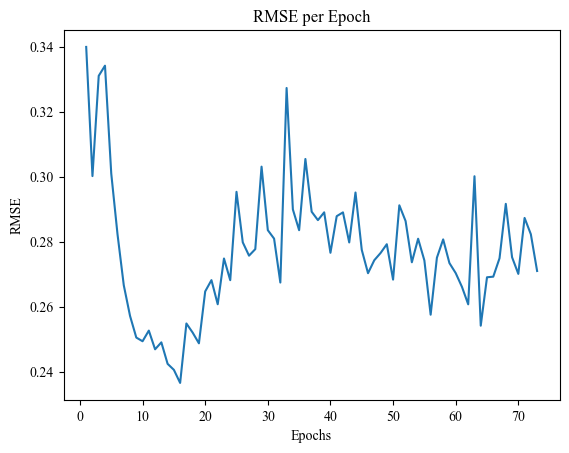

| 5         | -3.269    | 44.85     | 73.73     |
Epoch 1/97, RMSE: 0.5773
Epoch 2/97, RMSE: 0.3549
Epoch 3/97, RMSE: 0.3274
Epoch 4/97, RMSE: 0.3300
Epoch 5/97, RMSE: 0.3219
Epoch 6/97, RMSE: 0.3399
Epoch 7/97, RMSE: 0.3723
Epoch 8/97, RMSE: 0.3740
Epoch 9/97, RMSE: 0.4081
Epoch 10/97, RMSE: 0.4007
Epoch 11/97, RMSE: 0.4004
Epoch 12/97, RMSE: 0.3944
Epoch 13/97, RMSE: 0.4101
Epoch 14/97, RMSE: 0.3911
Epoch 15/97, RMSE: 0.3792
Epoch 16/97, RMSE: 0.3856
Epoch 17/97, RMSE: 0.3680
Epoch 18/97, RMSE: 0.3622
Epoch 19/97, RMSE: 0.3642
Epoch 20/97, RMSE: 0.3634
Epoch 21/97, RMSE: 0.3742
Epoch 22/97, RMSE: 0.3509
Epoch 23/97, RMSE: 0.3760
Epoch 24/97, RMSE: 0.3896
Epoch 25/97, RMSE: 0.3689
Epoch 26/97, RMSE: 0.3669
Epoch 27/97, RMSE: 0.3816
Epoch 28/97, RMSE: 0.3816
Epoch 29/97, RMSE: 0.3840
Epoch 30/97, RMSE: 0.3371
Epoch 31/97, RMSE: 0.3862
Epoch 32/97, RMSE: 0.3523
Epoch 33/97, RMSE: 0.3766
Epoch 34/97, RMSE: 0.3525
Epoch 35/97, RMSE: 0.3809
Epoch 36/97, RMSE: 0.3440
Epoch 37/97, RMSE: 0.37

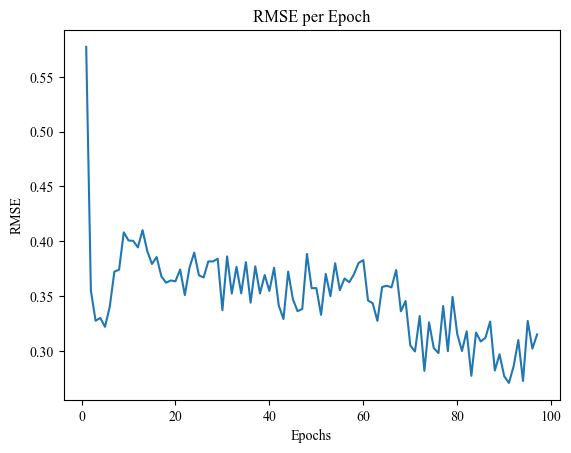

| 6         | -3.567    | 16.99     | 97.29     |
Epoch 1/29, RMSE: 0.3426
Epoch 2/29, RMSE: 0.2813
Epoch 3/29, RMSE: 0.2760
Epoch 4/29, RMSE: 0.2734
Epoch 5/29, RMSE: 0.2848
Epoch 6/29, RMSE: 0.2776
Epoch 7/29, RMSE: 0.2630
Epoch 8/29, RMSE: 0.2542
Epoch 9/29, RMSE: 0.2418
Epoch 10/29, RMSE: 0.2359
Epoch 11/29, RMSE: 0.2627
Epoch 12/29, RMSE: 0.2708
Epoch 13/29, RMSE: 0.3014
Epoch 14/29, RMSE: 0.2960
Epoch 15/29, RMSE: 0.3000
Epoch 16/29, RMSE: 0.3108
Epoch 17/29, RMSE: 0.3273
Epoch 18/29, RMSE: 0.3302
Epoch 19/29, RMSE: 0.3232
Epoch 20/29, RMSE: 0.3310
Epoch 21/29, RMSE: 0.3216
Epoch 22/29, RMSE: 0.3302
Epoch 23/29, RMSE: 0.3107
Epoch 24/29, RMSE: 0.3179
Epoch 25/29, RMSE: 0.3150
Epoch 26/29, RMSE: 0.3092
Epoch 27/29, RMSE: 0.2905
Epoch 28/29, RMSE: 0.3011
Epoch 29/29, RMSE: 0.3116


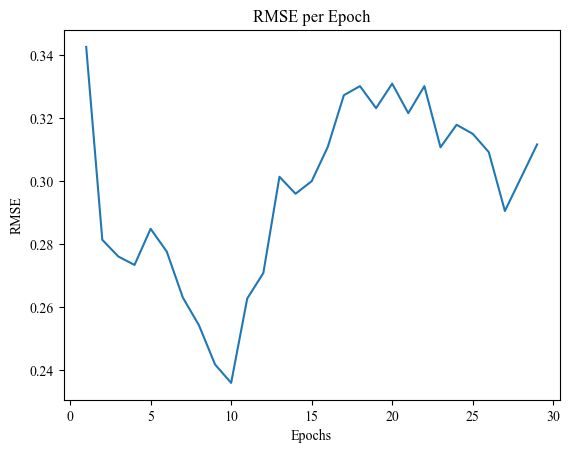

| 7         | -3.423    | 55.96     | 29.11     |
Epoch 1/26, RMSE: 0.3352
Epoch 2/26, RMSE: 0.3160
Epoch 3/26, RMSE: 0.3175
Epoch 4/26, RMSE: 0.3001
Epoch 5/26, RMSE: 0.2802
Epoch 6/26, RMSE: 0.2817
Epoch 7/26, RMSE: 0.2711
Epoch 8/26, RMSE: 0.2908
Epoch 9/26, RMSE: 0.2925
Epoch 10/26, RMSE: 0.2818
Epoch 11/26, RMSE: 0.2749
Epoch 12/26, RMSE: 0.2777
Epoch 13/26, RMSE: 0.2635
Epoch 14/26, RMSE: 0.2667
Epoch 15/26, RMSE: 0.2810
Epoch 16/26, RMSE: 0.2581
Epoch 17/26, RMSE: 0.2682
Epoch 18/26, RMSE: 0.2550
Epoch 19/26, RMSE: 0.2456
Epoch 20/26, RMSE: 0.2437
Epoch 21/26, RMSE: 0.2676
Epoch 22/26, RMSE: 0.2366
Epoch 23/26, RMSE: 0.2323
Epoch 24/26, RMSE: 0.2467
Epoch 25/26, RMSE: 0.2560
Epoch 26/26, RMSE: 0.2306


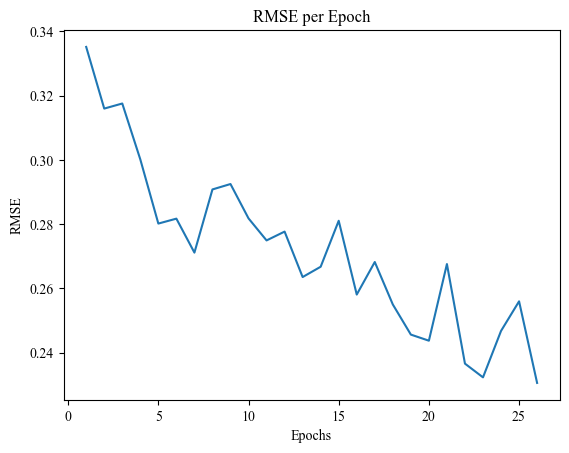

| 8         | -2.837    | 24.73     | 26.51     |
Epoch 1/57, RMSE: 0.3078
Epoch 2/57, RMSE: 0.3252
Epoch 3/57, RMSE: 0.3370
Epoch 4/57, RMSE: 0.3167
Epoch 5/57, RMSE: 0.3137
Epoch 6/57, RMSE: 0.3078
Epoch 7/57, RMSE: 0.2860
Epoch 8/57, RMSE: 0.3116
Epoch 9/57, RMSE: 0.3101
Epoch 10/57, RMSE: 0.3224
Epoch 11/57, RMSE: 0.3296
Epoch 12/57, RMSE: 0.3201
Epoch 13/57, RMSE: 0.3003
Epoch 14/57, RMSE: 0.3242
Epoch 15/57, RMSE: 0.3119
Epoch 16/57, RMSE: 0.3079
Epoch 17/57, RMSE: 0.3086
Epoch 18/57, RMSE: 0.2818
Epoch 19/57, RMSE: 0.2999
Epoch 20/57, RMSE: 0.2922
Epoch 21/57, RMSE: 0.2883
Epoch 22/57, RMSE: 0.2780
Epoch 23/57, RMSE: 0.2831
Epoch 24/57, RMSE: 0.2755
Epoch 25/57, RMSE: 0.2805
Epoch 26/57, RMSE: 0.2741
Epoch 27/57, RMSE: 0.2783
Epoch 28/57, RMSE: 0.2717
Epoch 29/57, RMSE: 0.2646
Epoch 30/57, RMSE: 0.2718
Epoch 31/57, RMSE: 0.2696
Epoch 32/57, RMSE: 0.2535
Epoch 33/57, RMSE: 0.2537
Epoch 34/57, RMSE: 0.2576
Epoch 35/57, RMSE: 0.2572
Epoch 36/57, RMSE: 0.2667
Epoch 37/57, RMSE: 0.24

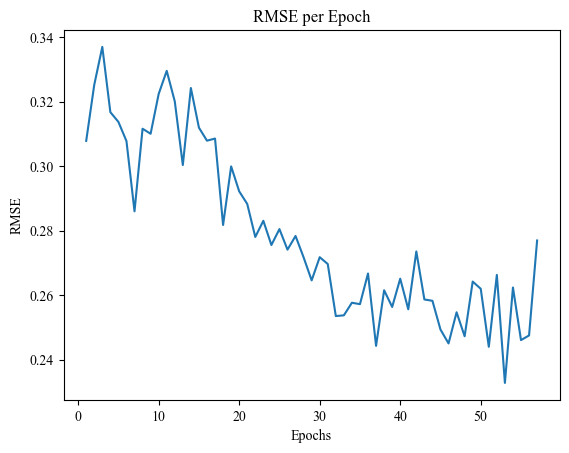

| 9         | -3.211    | 30.6      | 57.23     |
Epoch 1/36, RMSE: 0.3585
Epoch 2/36, RMSE: 0.3410
Epoch 3/36, RMSE: 0.3560
Epoch 4/36, RMSE: 0.3265
Epoch 5/36, RMSE: 0.3130
Epoch 6/36, RMSE: 0.3039
Epoch 7/36, RMSE: 0.2763
Epoch 8/36, RMSE: 0.2631
Epoch 9/36, RMSE: 0.2674
Epoch 10/36, RMSE: 0.2549
Epoch 11/36, RMSE: 0.2943
Epoch 12/36, RMSE: 0.3049
Epoch 13/36, RMSE: 0.3278
Epoch 14/36, RMSE: 0.3181
Epoch 15/36, RMSE: 0.3219
Epoch 16/36, RMSE: 0.3321
Epoch 17/36, RMSE: 0.3325
Epoch 18/36, RMSE: 0.3178
Epoch 19/36, RMSE: 0.3015
Epoch 20/36, RMSE: 0.3044
Epoch 21/36, RMSE: 0.3048
Epoch 22/36, RMSE: 0.3072
Epoch 23/36, RMSE: 0.3242
Epoch 24/36, RMSE: 0.3063
Epoch 25/36, RMSE: 0.2980
Epoch 26/36, RMSE: 0.2989
Epoch 27/36, RMSE: 0.3072
Epoch 28/36, RMSE: 0.2992
Epoch 29/36, RMSE: 0.2850
Epoch 30/36, RMSE: 0.2927
Epoch 31/36, RMSE: 0.2735
Epoch 32/36, RMSE: 0.2741
Epoch 33/36, RMSE: 0.2870
Epoch 34/36, RMSE: 0.2705
Epoch 35/36, RMSE: 0.2675
Epoch 36/36, RMSE: 0.2755


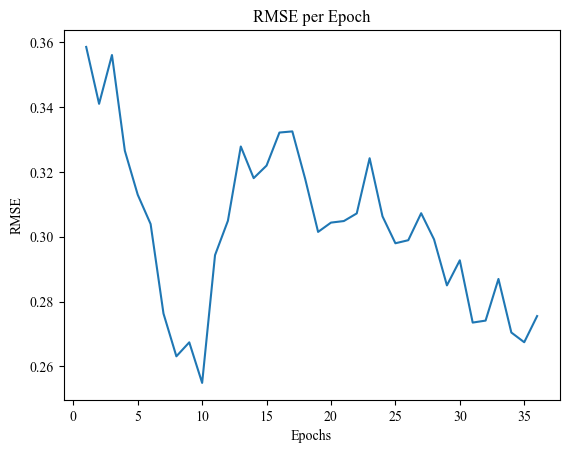

| 10        | -3.314    | 36.73     | 36.21     |
Epoch 1/73, RMSE: 0.3128
Epoch 2/73, RMSE: 0.3612
Epoch 3/73, RMSE: 0.3163
Epoch 4/73, RMSE: 0.3094
Epoch 5/73, RMSE: 0.2847
Epoch 6/73, RMSE: 0.2924
Epoch 7/73, RMSE: 0.2902
Epoch 8/73, RMSE: 0.2978
Epoch 9/73, RMSE: 0.3037
Epoch 10/73, RMSE: 0.3178
Epoch 11/73, RMSE: 0.3184
Epoch 12/73, RMSE: 0.3236
Epoch 13/73, RMSE: 0.3258
Epoch 14/73, RMSE: 0.3319
Epoch 15/73, RMSE: 0.3456
Epoch 16/73, RMSE: 0.3256
Epoch 17/73, RMSE: 0.3300
Epoch 18/73, RMSE: 0.3217
Epoch 19/73, RMSE: 0.3216
Epoch 20/73, RMSE: 0.3184
Epoch 21/73, RMSE: 0.3153
Epoch 22/73, RMSE: 0.3179
Epoch 23/73, RMSE: 0.3357
Epoch 24/73, RMSE: 0.3291
Epoch 25/73, RMSE: 0.3163
Epoch 26/73, RMSE: 0.3049
Epoch 27/73, RMSE: 0.3221
Epoch 28/73, RMSE: 0.3138
Epoch 29/73, RMSE: 0.3166
Epoch 30/73, RMSE: 0.3053
Epoch 31/73, RMSE: 0.3526
Epoch 32/73, RMSE: 0.3072
Epoch 33/73, RMSE: 0.3007
Epoch 34/73, RMSE: 0.3265
Epoch 35/73, RMSE: 0.3179
Epoch 36/73, RMSE: 0.3053
Epoch 37/73, RMSE: 0.31

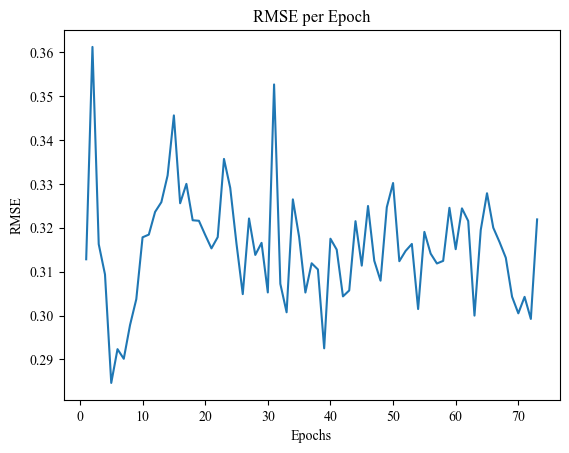

| 11        | -3.227    | 44.85     | 73.88     |
Epoch 1/26, RMSE: 0.3480
Epoch 2/26, RMSE: 0.3408
Epoch 3/26, RMSE: 0.3649
Epoch 4/26, RMSE: 0.3418
Epoch 5/26, RMSE: 0.3132
Epoch 6/26, RMSE: 0.2796
Epoch 7/26, RMSE: 0.2652
Epoch 8/26, RMSE: 0.2689
Epoch 9/26, RMSE: 0.3047
Epoch 10/26, RMSE: 0.3119
Epoch 11/26, RMSE: 0.3107
Epoch 12/26, RMSE: 0.3171
Epoch 13/26, RMSE: 0.3208
Epoch 14/26, RMSE: 0.3076
Epoch 15/26, RMSE: 0.3134
Epoch 16/26, RMSE: 0.3137
Epoch 17/26, RMSE: 0.2904
Epoch 18/26, RMSE: 0.2861
Epoch 19/26, RMSE: 0.3014
Epoch 20/26, RMSE: 0.3068
Epoch 21/26, RMSE: 0.3066
Epoch 22/26, RMSE: 0.3094
Epoch 23/26, RMSE: 0.3209
Epoch 24/26, RMSE: 0.3386
Epoch 25/26, RMSE: 0.3252
Epoch 26/26, RMSE: 0.3173


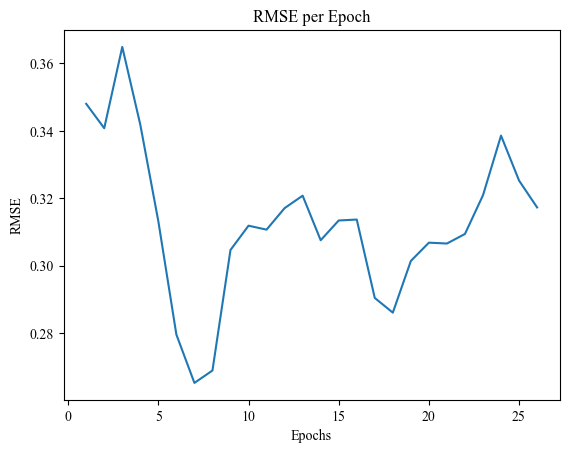

| 12        | -3.811    | 25.45     | 26.31     |
Epoch 1/63, RMSE: 0.3227
Epoch 2/63, RMSE: 0.2772
Epoch 3/63, RMSE: 0.2996
Epoch 4/63, RMSE: 0.2755
Epoch 5/63, RMSE: 0.2825
Epoch 6/63, RMSE: 0.2671
Epoch 7/63, RMSE: 0.2640
Epoch 8/63, RMSE: 0.2686
Epoch 9/63, RMSE: 0.2721
Epoch 10/63, RMSE: 0.2890
Epoch 11/63, RMSE: 0.3060
Epoch 12/63, RMSE: 0.3355
Epoch 13/63, RMSE: 0.3109
Epoch 14/63, RMSE: 0.3187
Epoch 15/63, RMSE: 0.3397
Epoch 16/63, RMSE: 0.3471
Epoch 17/63, RMSE: 0.3271
Epoch 18/63, RMSE: 0.3124
Epoch 19/63, RMSE: 0.3449
Epoch 20/63, RMSE: 0.3165
Epoch 21/63, RMSE: 0.3343
Epoch 22/63, RMSE: 0.3340
Epoch 23/63, RMSE: 0.3241
Epoch 24/63, RMSE: 0.3396
Epoch 25/63, RMSE: 0.3404
Epoch 26/63, RMSE: 0.3409
Epoch 27/63, RMSE: 0.3368
Epoch 28/63, RMSE: 0.3226
Epoch 29/63, RMSE: 0.3143
Epoch 30/63, RMSE: 0.3098
Epoch 31/63, RMSE: 0.3260
Epoch 32/63, RMSE: 0.3134
Epoch 33/63, RMSE: 0.3168
Epoch 34/63, RMSE: 0.3320
Epoch 35/63, RMSE: 0.3250
Epoch 36/63, RMSE: 0.3296
Epoch 37/63, RMSE: 0.32

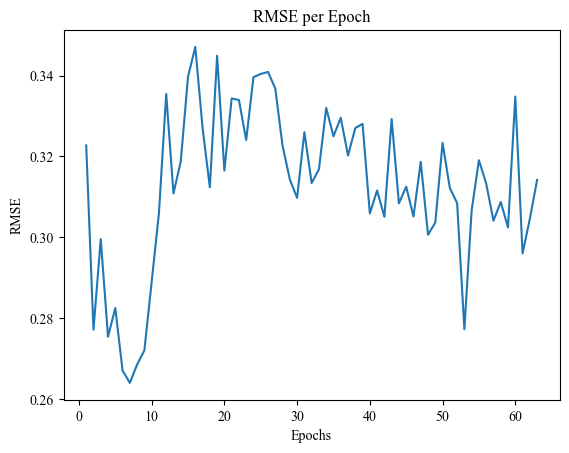

| 13        | -3.215    | 51.53     | 63.64     |
Epoch 1/95, RMSE: 0.3474
Epoch 2/95, RMSE: 0.3166
Epoch 3/95, RMSE: 0.3859
Epoch 4/95, RMSE: 0.3837
Epoch 5/95, RMSE: 0.3612
Epoch 6/95, RMSE: 0.3401
Epoch 7/95, RMSE: 0.3216
Epoch 8/95, RMSE: 0.3038
Epoch 9/95, RMSE: 0.3188
Epoch 10/95, RMSE: 0.3061
Epoch 11/95, RMSE: 0.3010
Epoch 12/95, RMSE: 0.2906
Epoch 13/95, RMSE: 0.2871
Epoch 14/95, RMSE: 0.2811
Epoch 15/95, RMSE: 0.3174
Epoch 16/95, RMSE: 0.2696
Epoch 17/95, RMSE: 0.2811
Epoch 18/95, RMSE: 0.2611
Epoch 19/95, RMSE: 0.2710
Epoch 20/95, RMSE: 0.2831
Epoch 21/95, RMSE: 0.2620
Epoch 22/95, RMSE: 0.2726
Epoch 23/95, RMSE: 0.2528
Epoch 24/95, RMSE: 0.2545
Epoch 25/95, RMSE: 0.2474
Epoch 26/95, RMSE: 0.2674
Epoch 27/95, RMSE: 0.2461
Epoch 28/95, RMSE: 0.2432
Epoch 29/95, RMSE: 0.2346
Epoch 30/95, RMSE: 0.2473
Epoch 31/95, RMSE: 0.2501
Epoch 32/95, RMSE: 0.2464
Epoch 33/95, RMSE: 0.2487
Epoch 34/95, RMSE: 0.2589
Epoch 35/95, RMSE: 0.2480
Epoch 36/95, RMSE: 0.2343
Epoch 37/95, RMSE: 0.24

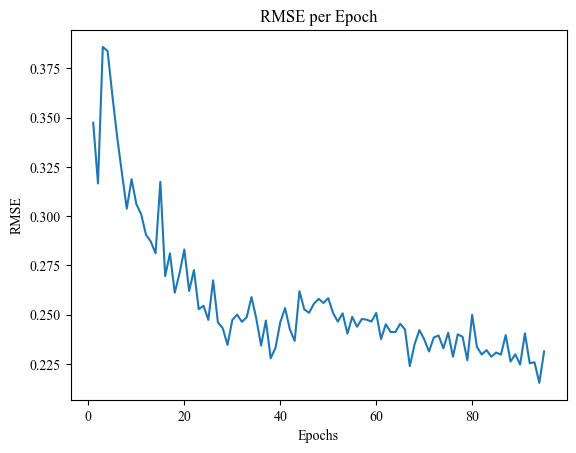

| 14        | -3.237    | 33.96     | 95.61     |
Epoch 1/95, RMSE: 0.3842
Epoch 2/95, RMSE: 0.3540
Epoch 3/95, RMSE: 0.3271
Epoch 4/95, RMSE: 0.3412
Epoch 5/95, RMSE: 0.3030
Epoch 6/95, RMSE: 0.3200
Epoch 7/95, RMSE: 0.3011
Epoch 8/95, RMSE: 0.3242
Epoch 9/95, RMSE: 0.3286
Epoch 10/95, RMSE: 0.3158
Epoch 11/95, RMSE: 0.3099
Epoch 12/95, RMSE: 0.3378
Epoch 13/95, RMSE: 0.3233
Epoch 14/95, RMSE: 0.3419
Epoch 15/95, RMSE: 0.3133
Epoch 16/95, RMSE: 0.3187
Epoch 17/95, RMSE: 0.3079
Epoch 18/95, RMSE: 0.2960
Epoch 19/95, RMSE: 0.3187
Epoch 20/95, RMSE: 0.3014
Epoch 21/95, RMSE: 0.2992
Epoch 22/95, RMSE: 0.2912
Epoch 23/95, RMSE: 0.2964
Epoch 24/95, RMSE: 0.2916
Epoch 25/95, RMSE: 0.2865
Epoch 26/95, RMSE: 0.2848
Epoch 27/95, RMSE: 0.2891
Epoch 28/95, RMSE: 0.2717
Epoch 29/95, RMSE: 0.2763
Epoch 30/95, RMSE: 0.2887
Epoch 31/95, RMSE: 0.3015
Epoch 32/95, RMSE: 0.2753
Epoch 33/95, RMSE: 0.2872
Epoch 34/95, RMSE: 0.2923
Epoch 35/95, RMSE: 0.2948
Epoch 36/95, RMSE: 0.2978
Epoch 37/95, RMSE: 0.28

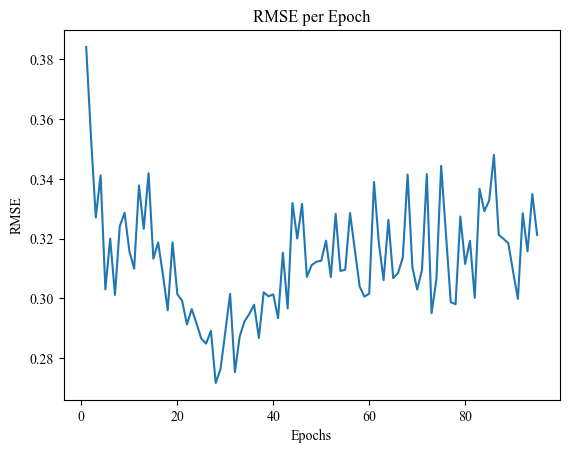

| 15        | -3.606    | 33.92     | 95.15     |
Epoch 1/26, RMSE: 0.3840
Epoch 2/26, RMSE: 0.3246
Epoch 3/26, RMSE: 0.3166
Epoch 4/26, RMSE: 0.2925
Epoch 5/26, RMSE: 0.2574
Epoch 6/26, RMSE: 0.2532
Epoch 7/26, RMSE: 0.2460
Epoch 8/26, RMSE: 0.2624
Epoch 9/26, RMSE: 0.3201
Epoch 10/26, RMSE: 0.3048
Epoch 11/26, RMSE: 0.3044
Epoch 12/26, RMSE: 0.2994
Epoch 13/26, RMSE: 0.2951
Epoch 14/26, RMSE: 0.2896
Epoch 15/26, RMSE: 0.2909
Epoch 16/26, RMSE: 0.2839
Epoch 17/26, RMSE: 0.2937
Epoch 18/26, RMSE: 0.2793
Epoch 19/26, RMSE: 0.2934
Epoch 20/26, RMSE: 0.2828
Epoch 21/26, RMSE: 0.2707
Epoch 22/26, RMSE: 0.2661
Epoch 23/26, RMSE: 0.2752
Epoch 24/26, RMSE: 0.2823
Epoch 25/26, RMSE: 0.2602
Epoch 26/26, RMSE: 0.2515


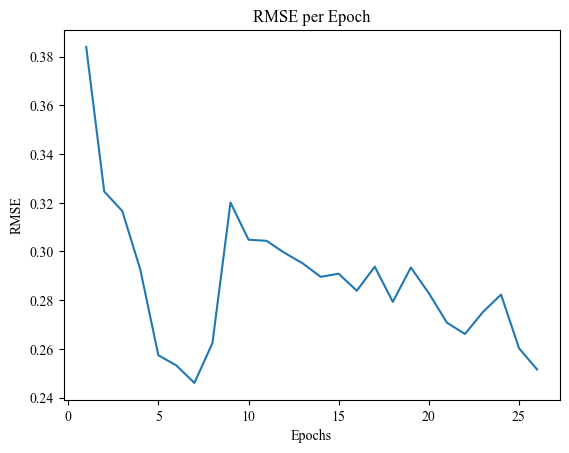

| 16        | -3.3      | 25.08     | 26.72     |
Epoch 1/84, RMSE: 0.3137
Epoch 2/84, RMSE: 0.2895
Epoch 3/84, RMSE: 0.3246
Epoch 4/84, RMSE: 0.2920
Epoch 5/84, RMSE: 0.2833
Epoch 6/84, RMSE: 0.2998
Epoch 7/84, RMSE: 0.2986
Epoch 8/84, RMSE: 0.3267
Epoch 9/84, RMSE: 0.3176
Epoch 10/84, RMSE: 0.3451
Epoch 11/84, RMSE: 0.3355
Epoch 12/84, RMSE: 0.3188
Epoch 13/84, RMSE: 0.3309
Epoch 14/84, RMSE: 0.3300
Epoch 15/84, RMSE: 0.3199
Epoch 16/84, RMSE: 0.3230
Epoch 17/84, RMSE: 0.3228
Epoch 18/84, RMSE: 0.3158
Epoch 19/84, RMSE: 0.2969
Epoch 20/84, RMSE: 0.3107
Epoch 21/84, RMSE: 0.3033
Epoch 22/84, RMSE: 0.3049
Epoch 23/84, RMSE: 0.2989
Epoch 24/84, RMSE: 0.2827
Epoch 25/84, RMSE: 0.3059
Epoch 26/84, RMSE: 0.2882
Epoch 27/84, RMSE: 0.2969
Epoch 28/84, RMSE: 0.2844
Epoch 29/84, RMSE: 0.2953
Epoch 30/84, RMSE: 0.3121
Epoch 31/84, RMSE: 0.3001
Epoch 32/84, RMSE: 0.2969
Epoch 33/84, RMSE: 0.2916
Epoch 34/84, RMSE: 0.2874
Epoch 35/84, RMSE: 0.2828
Epoch 36/84, RMSE: 0.2791
Epoch 37/84, RMSE: 0.29

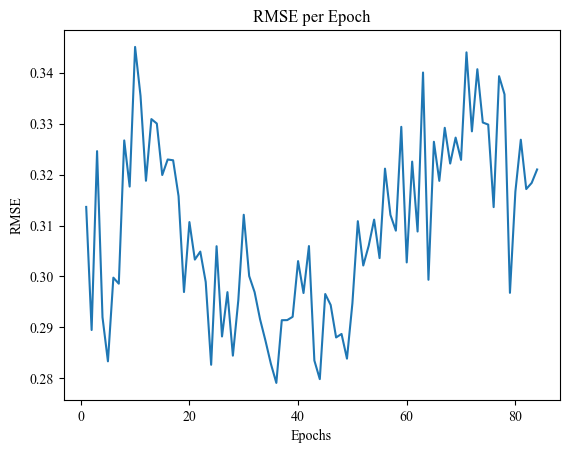

| 17        | -3.385    | 37.21     | 84.19     |
Epoch 1/26, RMSE: 0.3515
Epoch 2/26, RMSE: 0.3579
Epoch 3/26, RMSE: 0.3277
Epoch 4/26, RMSE: 0.3107
Epoch 5/26, RMSE: 0.3024
Epoch 6/26, RMSE: 0.3166
Epoch 7/26, RMSE: 0.2894
Epoch 8/26, RMSE: 0.2967
Epoch 9/26, RMSE: 0.2644
Epoch 10/26, RMSE: 0.2577
Epoch 11/26, RMSE: 0.2479
Epoch 12/26, RMSE: 0.2399
Epoch 13/26, RMSE: 0.2547
Epoch 14/26, RMSE: 0.2508
Epoch 15/26, RMSE: 0.2526
Epoch 16/26, RMSE: 0.2499
Epoch 17/26, RMSE: 0.2602
Epoch 18/26, RMSE: 0.2657
Epoch 19/26, RMSE: 0.2682
Epoch 20/26, RMSE: 0.2492
Epoch 21/26, RMSE: 0.2416
Epoch 22/26, RMSE: 0.2513
Epoch 23/26, RMSE: 0.2477
Epoch 24/26, RMSE: 0.2608
Epoch 25/26, RMSE: 0.2513
Epoch 26/26, RMSE: 0.2441


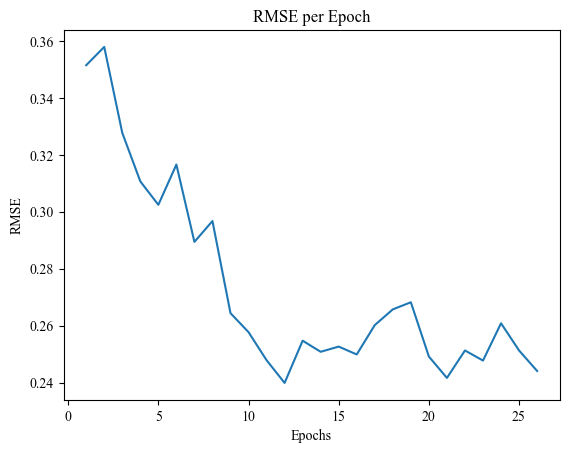

| 18        | -3.021    | 24.69     | 26.82     |
Epoch 1/26, RMSE: 0.3239
Epoch 2/26, RMSE: 0.3066
Epoch 3/26, RMSE: 0.3073
Epoch 4/26, RMSE: 0.2939
Epoch 5/26, RMSE: 0.2904
Epoch 6/26, RMSE: 0.2993
Epoch 7/26, RMSE: 0.2839
Epoch 8/26, RMSE: 0.2719
Epoch 9/26, RMSE: 0.2678
Epoch 10/26, RMSE: 0.2574
Epoch 11/26, RMSE: 0.2549
Epoch 12/26, RMSE: 0.2420
Epoch 13/26, RMSE: 0.2378
Epoch 14/26, RMSE: 0.2424
Epoch 15/26, RMSE: 0.2422
Epoch 16/26, RMSE: 0.2452
Epoch 17/26, RMSE: 0.2390
Epoch 18/26, RMSE: 0.2431
Epoch 19/26, RMSE: 0.2423
Epoch 20/26, RMSE: 0.2521
Epoch 21/26, RMSE: 0.2453
Epoch 22/26, RMSE: 0.2335
Epoch 23/26, RMSE: 0.2322
Epoch 24/26, RMSE: 0.2375
Epoch 25/26, RMSE: 0.2468
Epoch 26/26, RMSE: 0.2315


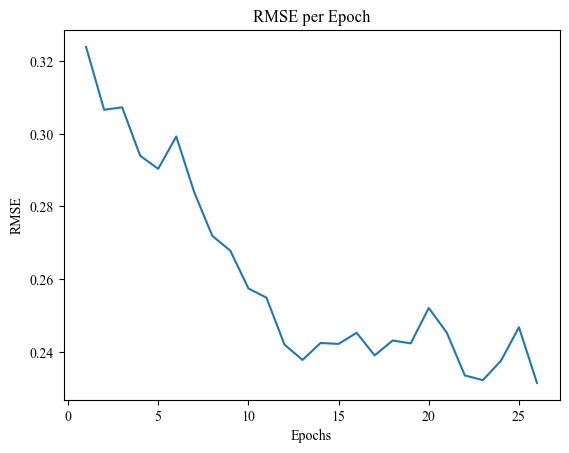

| 19        | -3.27     | 24.9      | 26.42     |
Epoch 1/64, RMSE: 0.3279
Epoch 2/64, RMSE: 0.2935
Epoch 3/64, RMSE: 0.2861
Epoch 4/64, RMSE: 0.2737
Epoch 5/64, RMSE: 0.2661
Epoch 6/64, RMSE: 0.2489
Epoch 7/64, RMSE: 0.2311
Epoch 8/64, RMSE: 0.2309
Epoch 9/64, RMSE: 0.2383
Epoch 10/64, RMSE: 0.2414
Epoch 11/64, RMSE: 0.2651
Epoch 12/64, RMSE: 0.2824
Epoch 13/64, RMSE: 0.3046
Epoch 14/64, RMSE: 0.3024
Epoch 15/64, RMSE: 0.3094
Epoch 16/64, RMSE: 0.3137
Epoch 17/64, RMSE: 0.3162
Epoch 18/64, RMSE: 0.3146
Epoch 19/64, RMSE: 0.3278
Epoch 20/64, RMSE: 0.3031
Epoch 21/64, RMSE: 0.3385
Epoch 22/64, RMSE: 0.3133
Epoch 23/64, RMSE: 0.3226
Epoch 24/64, RMSE: 0.3246
Epoch 25/64, RMSE: 0.3308
Epoch 26/64, RMSE: 0.3143
Epoch 27/64, RMSE: 0.3378
Epoch 28/64, RMSE: 0.3275
Epoch 29/64, RMSE: 0.3199
Epoch 30/64, RMSE: 0.3317
Epoch 31/64, RMSE: 0.3213
Epoch 32/64, RMSE: 0.3028
Epoch 33/64, RMSE: 0.3247
Epoch 34/64, RMSE: 0.3165
Epoch 35/64, RMSE: 0.3066
Epoch 36/64, RMSE: 0.2971
Epoch 37/64, RMSE: 0.30

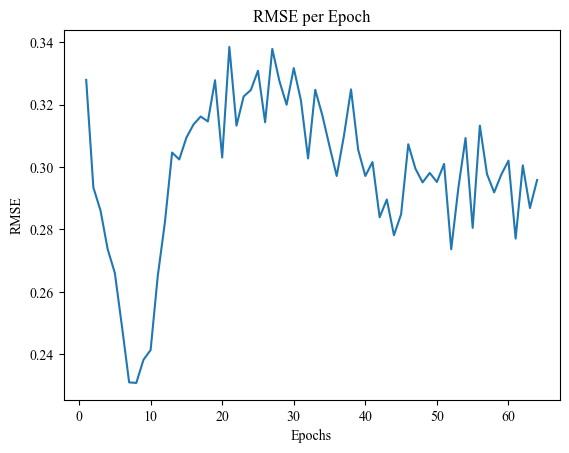

| 20        | -3.182    | 51.15     | 64.16     |
Epoch 1/23, RMSE: 0.3236
Epoch 2/23, RMSE: 0.2830
Epoch 3/23, RMSE: 0.3022
Epoch 4/23, RMSE: 0.2804
Epoch 5/23, RMSE: 0.2862
Epoch 6/23, RMSE: 0.2612
Epoch 7/23, RMSE: 0.2504
Epoch 8/23, RMSE: 0.2364
Epoch 9/23, RMSE: 0.2303
Epoch 10/23, RMSE: 0.2447
Epoch 11/23, RMSE: 0.2402
Epoch 12/23, RMSE: 0.2475
Epoch 13/23, RMSE: 0.2723
Epoch 14/23, RMSE: 0.2840
Epoch 15/23, RMSE: 0.2865
Epoch 16/23, RMSE: 0.3213
Epoch 17/23, RMSE: 0.3055
Epoch 18/23, RMSE: 0.2959
Epoch 19/23, RMSE: 0.3195
Epoch 20/23, RMSE: 0.2991
Epoch 21/23, RMSE: 0.3075
Epoch 22/23, RMSE: 0.2869
Epoch 23/23, RMSE: 0.2906


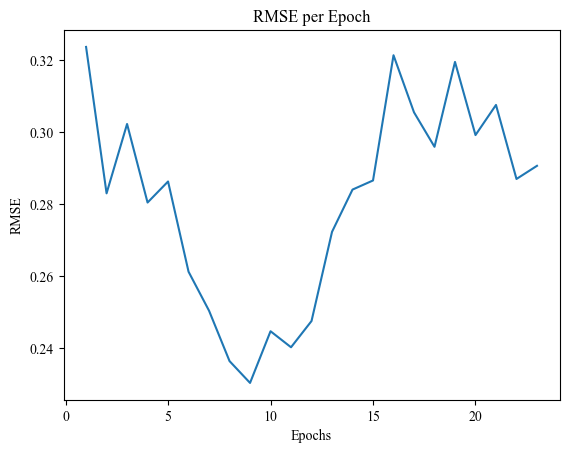

| 21        | -3.294    | 44.99     | 23.65     |
Epoch 1/26, RMSE: 0.4205
Epoch 2/26, RMSE: 0.3442
Epoch 3/26, RMSE: 0.2959
Epoch 4/26, RMSE: 0.2971
Epoch 5/26, RMSE: 0.2930
Epoch 6/26, RMSE: 0.3539
Epoch 7/26, RMSE: 0.3194
Epoch 8/26, RMSE: 0.3571
Epoch 9/26, RMSE: 0.3119
Epoch 10/26, RMSE: 0.3224
Epoch 11/26, RMSE: 0.3340
Epoch 12/26, RMSE: 0.3174
Epoch 13/26, RMSE: 0.3162
Epoch 14/26, RMSE: 0.2935
Epoch 15/26, RMSE: 0.2886
Epoch 16/26, RMSE: 0.3013
Epoch 17/26, RMSE: 0.2976
Epoch 18/26, RMSE: 0.2771
Epoch 19/26, RMSE: 0.2785
Epoch 20/26, RMSE: 0.2800
Epoch 21/26, RMSE: 0.3115
Epoch 22/26, RMSE: 0.2902
Epoch 23/26, RMSE: 0.2860
Epoch 24/26, RMSE: 0.3070
Epoch 25/26, RMSE: 0.2872
Epoch 26/26, RMSE: 0.2942


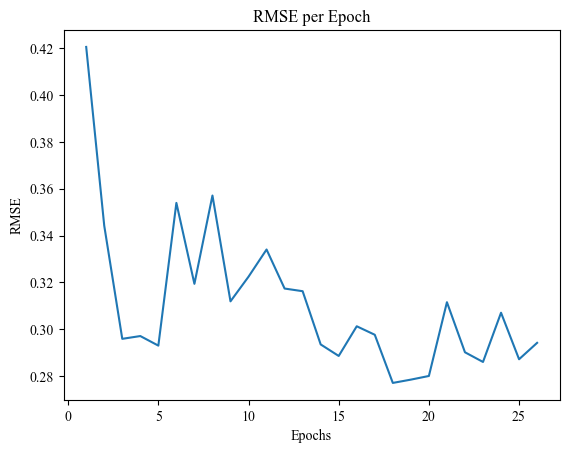

| 22        | -3.626    | 24.8      | 26.59     |
Epoch 1/73, RMSE: 0.3510
Epoch 2/73, RMSE: 0.2944
Epoch 3/73, RMSE: 0.3272
Epoch 4/73, RMSE: 0.3354
Epoch 5/73, RMSE: 0.3121
Epoch 6/73, RMSE: 0.2840
Epoch 7/73, RMSE: 0.2599
Epoch 8/73, RMSE: 0.2478
Epoch 9/73, RMSE: 0.2381
Epoch 10/73, RMSE: 0.2277
Epoch 11/73, RMSE: 0.2308
Epoch 12/73, RMSE: 0.2281
Epoch 13/73, RMSE: 0.2387
Epoch 14/73, RMSE: 0.2251
Epoch 15/73, RMSE: 0.2436
Epoch 16/73, RMSE: 0.2527
Epoch 17/73, RMSE: 0.2714
Epoch 18/73, RMSE: 0.2749
Epoch 19/73, RMSE: 0.2739
Epoch 20/73, RMSE: 0.2930
Epoch 21/73, RMSE: 0.2974
Epoch 22/73, RMSE: 0.3031
Epoch 23/73, RMSE: 0.2913
Epoch 24/73, RMSE: 0.2819
Epoch 25/73, RMSE: 0.2904
Epoch 26/73, RMSE: 0.2838
Epoch 27/73, RMSE: 0.2904
Epoch 28/73, RMSE: 0.2935
Epoch 29/73, RMSE: 0.2793
Epoch 30/73, RMSE: 0.2861
Epoch 31/73, RMSE: 0.2853
Epoch 32/73, RMSE: 0.2850
Epoch 33/73, RMSE: 0.2680
Epoch 34/73, RMSE: 0.2733
Epoch 35/73, RMSE: 0.2620
Epoch 36/73, RMSE: 0.2512
Epoch 37/73, RMSE: 0.25

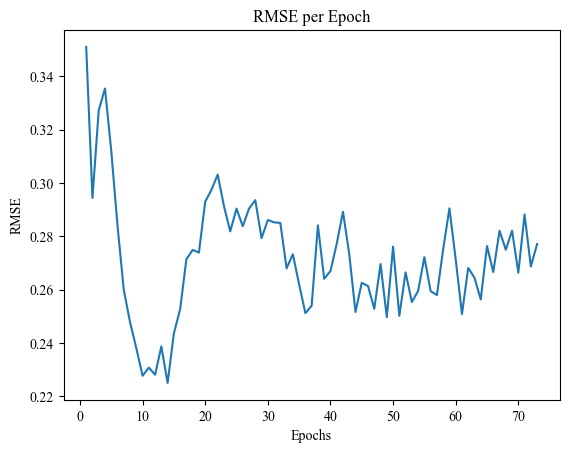

| 23        | -3.123    | 44.98     | 73.89     |
Epoch 1/63, RMSE: 0.3470
Epoch 2/63, RMSE: 0.2741
Epoch 3/63, RMSE: 0.2792
Epoch 4/63, RMSE: 0.2749
Epoch 5/63, RMSE: 0.2800
Epoch 6/63, RMSE: 0.2827
Epoch 7/63, RMSE: 0.2713
Epoch 8/63, RMSE: 0.2799
Epoch 9/63, RMSE: 0.2936
Epoch 10/63, RMSE: 0.3006
Epoch 11/63, RMSE: 0.3205
Epoch 12/63, RMSE: 0.3112
Epoch 13/63, RMSE: 0.3197
Epoch 14/63, RMSE: 0.3368
Epoch 15/63, RMSE: 0.3475
Epoch 16/63, RMSE: 0.3379
Epoch 17/63, RMSE: 0.3385
Epoch 18/63, RMSE: 0.3245
Epoch 19/63, RMSE: 0.3267
Epoch 20/63, RMSE: 0.3245
Epoch 21/63, RMSE: 0.3167
Epoch 22/63, RMSE: 0.3263
Epoch 23/63, RMSE: 0.3291
Epoch 24/63, RMSE: 0.3131
Epoch 25/63, RMSE: 0.3168
Epoch 26/63, RMSE: 0.3147
Epoch 27/63, RMSE: 0.3154
Epoch 28/63, RMSE: 0.3026
Epoch 29/63, RMSE: 0.3185
Epoch 30/63, RMSE: 0.3129
Epoch 31/63, RMSE: 0.3042
Epoch 32/63, RMSE: 0.3110
Epoch 33/63, RMSE: 0.3054
Epoch 34/63, RMSE: 0.3182
Epoch 35/63, RMSE: 0.3098
Epoch 36/63, RMSE: 0.3102
Epoch 37/63, RMSE: 0.30

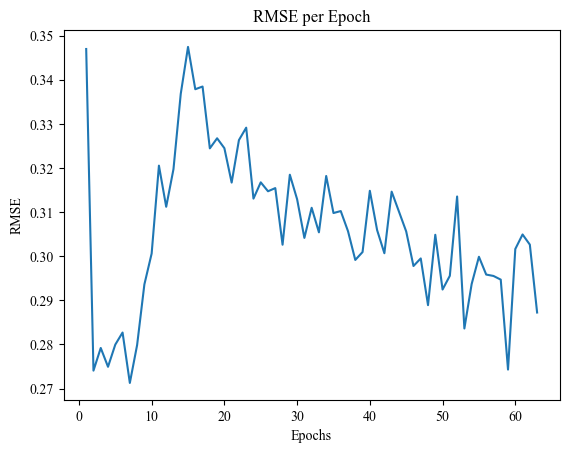

| 24        | -3.142    | 51.45     | 63.64     |
Epoch 1/33, RMSE: 0.3605
Epoch 2/33, RMSE: 0.2920
Epoch 3/33, RMSE: 0.3052
Epoch 4/33, RMSE: 0.3276
Epoch 5/33, RMSE: 0.3213
Epoch 6/33, RMSE: 0.3215
Epoch 7/33, RMSE: 0.3382
Epoch 8/33, RMSE: 0.3493
Epoch 9/33, RMSE: 0.3478
Epoch 10/33, RMSE: 0.3515
Epoch 11/33, RMSE: 0.3698
Epoch 12/33, RMSE: 0.3764
Epoch 13/33, RMSE: 0.3820
Epoch 14/33, RMSE: 0.3831
Epoch 15/33, RMSE: 0.3686
Epoch 16/33, RMSE: 0.3894
Epoch 17/33, RMSE: 0.3774
Epoch 18/33, RMSE: 0.3911
Epoch 19/33, RMSE: 0.3956
Epoch 20/33, RMSE: 0.3824
Epoch 21/33, RMSE: 0.3930
Epoch 22/33, RMSE: 0.3769
Epoch 23/33, RMSE: 0.3762
Epoch 24/33, RMSE: 0.3989
Epoch 25/33, RMSE: 0.3967
Epoch 26/33, RMSE: 0.3994
Epoch 27/33, RMSE: 0.3990
Epoch 28/33, RMSE: 0.3819
Epoch 29/33, RMSE: 0.3856
Epoch 30/33, RMSE: 0.3755
Epoch 31/33, RMSE: 0.3851
Epoch 32/33, RMSE: 0.3794
Epoch 33/33, RMSE: 0.3826


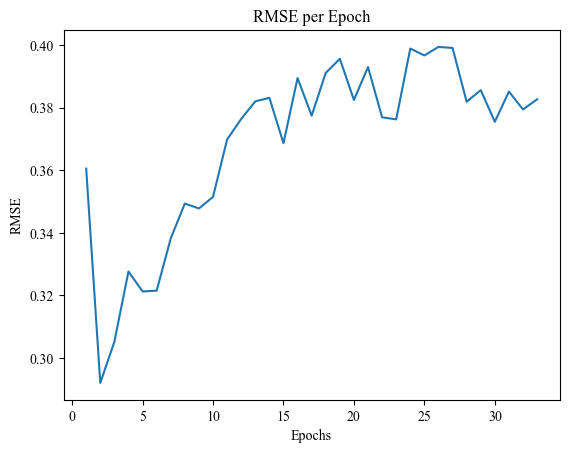

| 25        | -3.642    | 61.86     | 33.53     |
Epoch 1/63, RMSE: 0.3547
Epoch 2/63, RMSE: 0.2787
Epoch 3/63, RMSE: 0.2814
Epoch 4/63, RMSE: 0.2918
Epoch 5/63, RMSE: 0.2829
Epoch 6/63, RMSE: 0.2854
Epoch 7/63, RMSE: 0.2864
Epoch 8/63, RMSE: 0.3165
Epoch 9/63, RMSE: 0.3097
Epoch 10/63, RMSE: 0.3319
Epoch 11/63, RMSE: 0.3289
Epoch 12/63, RMSE: 0.3401
Epoch 13/63, RMSE: 0.3549
Epoch 14/63, RMSE: 0.3506
Epoch 15/63, RMSE: 0.3588
Epoch 16/63, RMSE: 0.3524
Epoch 17/63, RMSE: 0.3521
Epoch 18/63, RMSE: 0.3432
Epoch 19/63, RMSE: 0.3467
Epoch 20/63, RMSE: 0.3604
Epoch 21/63, RMSE: 0.3353
Epoch 22/63, RMSE: 0.3444
Epoch 23/63, RMSE: 0.3296
Epoch 24/63, RMSE: 0.3196
Epoch 25/63, RMSE: 0.3379
Epoch 26/63, RMSE: 0.3204
Epoch 27/63, RMSE: 0.3257
Epoch 28/63, RMSE: 0.3353
Epoch 29/63, RMSE: 0.3263
Epoch 30/63, RMSE: 0.3267
Epoch 31/63, RMSE: 0.3198
Epoch 32/63, RMSE: 0.3217
Epoch 33/63, RMSE: 0.3024
Epoch 34/63, RMSE: 0.3217
Epoch 35/63, RMSE: 0.3162
Epoch 36/63, RMSE: 0.3092
Epoch 37/63, RMSE: 0.30

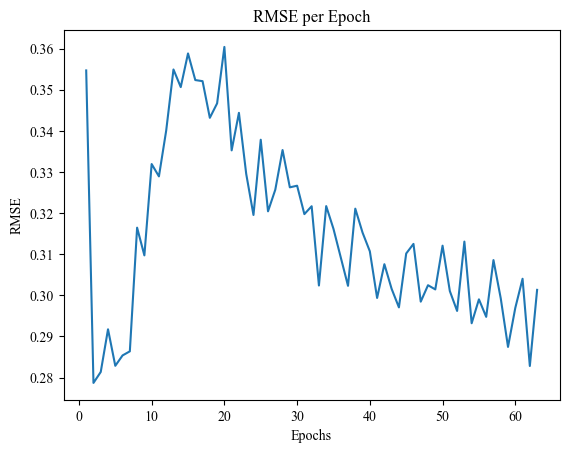

| 26        | -3.247    | 51.56     | 63.54     |
Epoch 1/36, RMSE: 0.3464
Epoch 2/36, RMSE: 0.3186
Epoch 3/36, RMSE: 0.3377
Epoch 4/36, RMSE: 0.3309
Epoch 5/36, RMSE: 0.3259
Epoch 6/36, RMSE: 0.3295
Epoch 7/36, RMSE: 0.3177
Epoch 8/36, RMSE: 0.3601
Epoch 9/36, RMSE: 0.3634
Epoch 10/36, RMSE: 0.3537
Epoch 11/36, RMSE: 0.3559
Epoch 12/36, RMSE: 0.3573
Epoch 13/36, RMSE: 0.3408
Epoch 14/36, RMSE: 0.3370
Epoch 15/36, RMSE: 0.3480
Epoch 16/36, RMSE: 0.3403
Epoch 17/36, RMSE: 0.3185
Epoch 18/36, RMSE: 0.3140
Epoch 19/36, RMSE: 0.3437
Epoch 20/36, RMSE: 0.3291
Epoch 21/36, RMSE: 0.3014
Epoch 22/36, RMSE: 0.3060
Epoch 23/36, RMSE: 0.3174
Epoch 24/36, RMSE: 0.3063
Epoch 25/36, RMSE: 0.3138
Epoch 26/36, RMSE: 0.3080
Epoch 27/36, RMSE: 0.3091
Epoch 28/36, RMSE: 0.3154
Epoch 29/36, RMSE: 0.3252
Epoch 30/36, RMSE: 0.3074
Epoch 31/36, RMSE: 0.2879
Epoch 32/36, RMSE: 0.2990
Epoch 33/36, RMSE: 0.2964
Epoch 34/36, RMSE: 0.3037
Epoch 35/36, RMSE: 0.2875
Epoch 36/36, RMSE: 0.2975


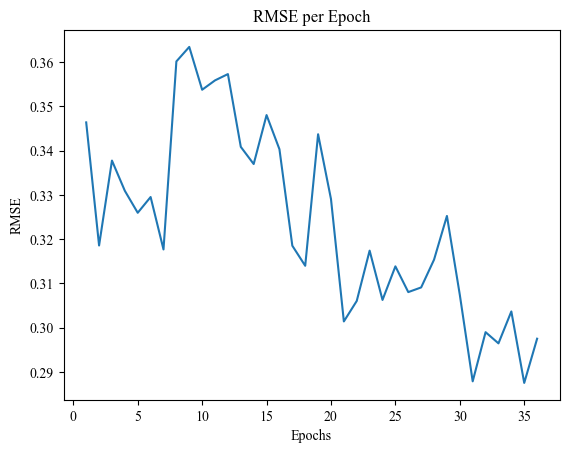

| 27        | -3.569    | 36.68     | 36.18     |
Epoch 1/71, RMSE: 0.3293
Epoch 2/71, RMSE: 0.3015
Epoch 3/71, RMSE: 0.2829
Epoch 4/71, RMSE: 0.2732
Epoch 5/71, RMSE: 0.2919
Epoch 6/71, RMSE: 0.2920
Epoch 7/71, RMSE: 0.2873
Epoch 8/71, RMSE: 0.3217
Epoch 9/71, RMSE: 0.3413
Epoch 10/71, RMSE: 0.3541
Epoch 11/71, RMSE: 0.3524
Epoch 12/71, RMSE: 0.3560
Epoch 13/71, RMSE: 0.3674
Epoch 14/71, RMSE: 0.3485
Epoch 15/71, RMSE: 0.3600
Epoch 16/71, RMSE: 0.3822
Epoch 17/71, RMSE: 0.3685
Epoch 18/71, RMSE: 0.3639
Epoch 19/71, RMSE: 0.3686
Epoch 20/71, RMSE: 0.3677
Epoch 21/71, RMSE: 0.3733
Epoch 22/71, RMSE: 0.3753
Epoch 23/71, RMSE: 0.3678
Epoch 24/71, RMSE: 0.3935
Epoch 25/71, RMSE: 0.3791
Epoch 26/71, RMSE: 0.3839
Epoch 27/71, RMSE: 0.3594
Epoch 28/71, RMSE: 0.3586
Epoch 29/71, RMSE: 0.3623
Epoch 30/71, RMSE: 0.3537
Epoch 31/71, RMSE: 0.3567
Epoch 32/71, RMSE: 0.3396
Epoch 33/71, RMSE: 0.3727
Epoch 34/71, RMSE: 0.3518
Epoch 35/71, RMSE: 0.3484
Epoch 36/71, RMSE: 0.3442
Epoch 37/71, RMSE: 0.34

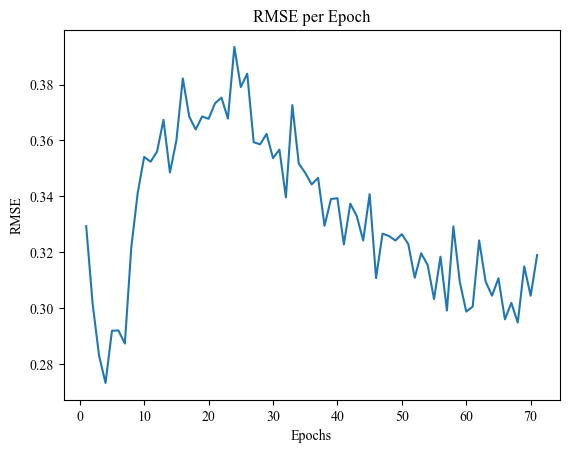

| 28        | -3.441    | 55.32     | 71.27     |
Epoch 1/70, RMSE: 0.3443
Epoch 2/70, RMSE: 0.2889
Epoch 3/70, RMSE: 0.3169
Epoch 4/70, RMSE: 0.3193
Epoch 5/70, RMSE: 0.3165
Epoch 6/70, RMSE: 0.2850
Epoch 7/70, RMSE: 0.2731
Epoch 8/70, RMSE: 0.2821
Epoch 9/70, RMSE: 0.2971
Epoch 10/70, RMSE: 0.3262
Epoch 11/70, RMSE: 0.3210
Epoch 12/70, RMSE: 0.3420
Epoch 13/70, RMSE: 0.3637
Epoch 14/70, RMSE: 0.3366
Epoch 15/70, RMSE: 0.3424
Epoch 16/70, RMSE: 0.3396
Epoch 17/70, RMSE: 0.3496
Epoch 18/70, RMSE: 0.3408
Epoch 19/70, RMSE: 0.3298
Epoch 20/70, RMSE: 0.3334
Epoch 21/70, RMSE: 0.3141
Epoch 22/70, RMSE: 0.3148
Epoch 23/70, RMSE: 0.2990
Epoch 24/70, RMSE: 0.3103
Epoch 25/70, RMSE: 0.3076
Epoch 26/70, RMSE: 0.3020
Epoch 27/70, RMSE: 0.2987
Epoch 28/70, RMSE: 0.2903
Epoch 29/70, RMSE: 0.2979
Epoch 30/70, RMSE: 0.2912
Epoch 31/70, RMSE: 0.2858
Epoch 32/70, RMSE: 0.2898
Epoch 33/70, RMSE: 0.2854
Epoch 34/70, RMSE: 0.2869
Epoch 35/70, RMSE: 0.2731
Epoch 36/70, RMSE: 0.2724
Epoch 37/70, RMSE: 0.26

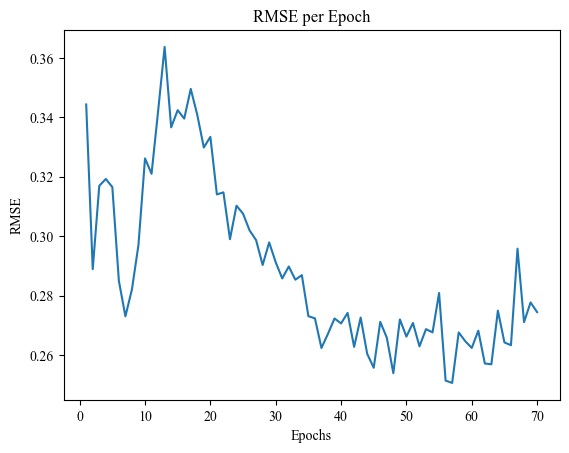

| 29        | -3.004    | 40.1      | 70.47     |
Epoch 1/73, RMSE: 0.3279
Epoch 2/73, RMSE: 0.2970
Epoch 3/73, RMSE: 0.2953
Epoch 4/73, RMSE: 0.2795
Epoch 5/73, RMSE: 0.2824
Epoch 6/73, RMSE: 0.2698
Epoch 7/73, RMSE: 0.2553
Epoch 8/73, RMSE: 0.2554
Epoch 9/73, RMSE: 0.2608
Epoch 10/73, RMSE: 0.2456
Epoch 11/73, RMSE: 0.2344
Epoch 12/73, RMSE: 0.2494
Epoch 13/73, RMSE: 0.2420
Epoch 14/73, RMSE: 0.2363
Epoch 15/73, RMSE: 0.2440
Epoch 16/73, RMSE: 0.2370
Epoch 17/73, RMSE: 0.2261
Epoch 18/73, RMSE: 0.2330
Epoch 19/73, RMSE: 0.2181
Epoch 20/73, RMSE: 0.2199
Epoch 21/73, RMSE: 0.2265
Epoch 22/73, RMSE: 0.2211
Epoch 23/73, RMSE: 0.2323
Epoch 24/73, RMSE: 0.2304
Epoch 25/73, RMSE: 0.2353
Epoch 26/73, RMSE: 0.2289
Epoch 27/73, RMSE: 0.2435
Epoch 28/73, RMSE: 0.2410
Epoch 29/73, RMSE: 0.2493
Epoch 30/73, RMSE: 0.2513
Epoch 31/73, RMSE: 0.2415
Epoch 32/73, RMSE: 0.2563
Epoch 33/73, RMSE: 0.2511
Epoch 34/73, RMSE: 0.2448
Epoch 35/73, RMSE: 0.2622
Epoch 36/73, RMSE: 0.2643
Epoch 37/73, RMSE: 0.26

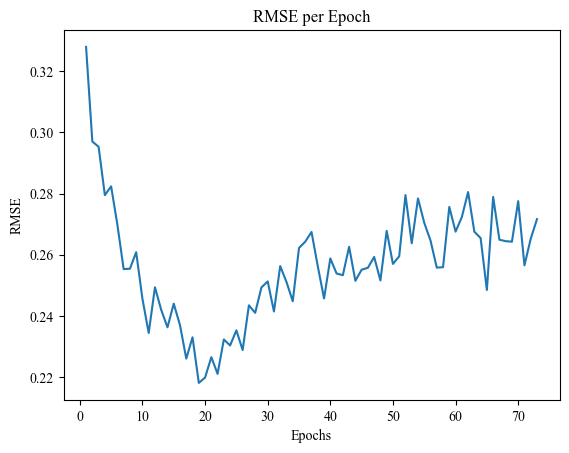

| 30        | -3.142    | 45.09     | 73.8      |
Epoch 1/73, RMSE: 0.3317
Epoch 2/73, RMSE: 0.3360
Epoch 3/73, RMSE: 0.3515
Epoch 4/73, RMSE: 0.3476
Epoch 5/73, RMSE: 0.3320
Epoch 6/73, RMSE: 0.3041
Epoch 7/73, RMSE: 0.2835
Epoch 8/73, RMSE: 0.2596
Epoch 9/73, RMSE: 0.2495
Epoch 10/73, RMSE: 0.2571
Epoch 11/73, RMSE: 0.2570
Epoch 12/73, RMSE: 0.2623
Epoch 13/73, RMSE: 0.2708
Epoch 14/73, RMSE: 0.2753
Epoch 15/73, RMSE: 0.2808
Epoch 16/73, RMSE: 0.2728
Epoch 17/73, RMSE: 0.2841
Epoch 18/73, RMSE: 0.2848
Epoch 19/73, RMSE: 0.2782
Epoch 20/73, RMSE: 0.2695
Epoch 21/73, RMSE: 0.2689
Epoch 22/73, RMSE: 0.2570
Epoch 23/73, RMSE: 0.2664
Epoch 24/73, RMSE: 0.2556
Epoch 25/73, RMSE: 0.2477
Epoch 26/73, RMSE: 0.2526
Epoch 27/73, RMSE: 0.2630
Epoch 28/73, RMSE: 0.2675
Epoch 29/73, RMSE: 0.2618
Epoch 30/73, RMSE: 0.2482
Epoch 31/73, RMSE: 0.2624
Epoch 32/73, RMSE: 0.2540
Epoch 33/73, RMSE: 0.2587
Epoch 34/73, RMSE: 0.2618
Epoch 35/73, RMSE: 0.2511
Epoch 36/73, RMSE: 0.2486
Epoch 37/73, RMSE: 0.25

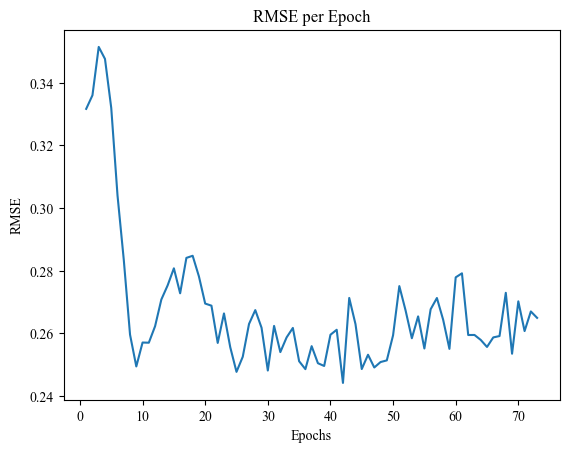

| 31        | -3.087    | 44.98     | 73.95     |
Epoch 1/63, RMSE: 0.3348
Epoch 2/63, RMSE: 0.2693
Epoch 3/63, RMSE: 0.2879
Epoch 4/63, RMSE: 0.2947
Epoch 5/63, RMSE: 0.3063
Epoch 6/63, RMSE: 0.3104
Epoch 7/63, RMSE: 0.3074
Epoch 8/63, RMSE: 0.3256
Epoch 9/63, RMSE: 0.3209
Epoch 10/63, RMSE: 0.3329
Epoch 11/63, RMSE: 0.3419
Epoch 12/63, RMSE: 0.3453
Epoch 13/63, RMSE: 0.3389
Epoch 14/63, RMSE: 0.3519
Epoch 15/63, RMSE: 0.3655
Epoch 16/63, RMSE: 0.3520
Epoch 17/63, RMSE: 0.3653
Epoch 18/63, RMSE: 0.3616
Epoch 19/63, RMSE: 0.3485
Epoch 20/63, RMSE: 0.3484
Epoch 21/63, RMSE: 0.3556
Epoch 22/63, RMSE: 0.3690
Epoch 23/63, RMSE: 0.3445
Epoch 24/63, RMSE: 0.3592
Epoch 25/63, RMSE: 0.3614
Epoch 26/63, RMSE: 0.3680
Epoch 27/63, RMSE: 0.3794
Epoch 28/63, RMSE: 0.3818
Epoch 29/63, RMSE: 0.3643
Epoch 30/63, RMSE: 0.3784
Epoch 31/63, RMSE: 0.3612
Epoch 32/63, RMSE: 0.3758
Epoch 33/63, RMSE: 0.3737
Epoch 34/63, RMSE: 0.3562
Epoch 35/63, RMSE: 0.3785
Epoch 36/63, RMSE: 0.3843
Epoch 37/63, RMSE: 0.36

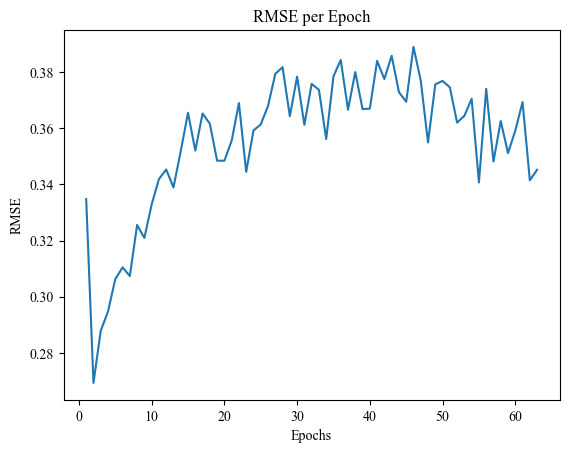

| 32        | -3.487    | 51.2      | 63.84     |
Epoch 1/73, RMSE: 0.3369
Epoch 2/73, RMSE: 0.2699
Epoch 3/73, RMSE: 0.3730
Epoch 4/73, RMSE: 0.3096
Epoch 5/73, RMSE: 0.3267
Epoch 6/73, RMSE: 0.3254
Epoch 7/73, RMSE: 0.3202
Epoch 8/73, RMSE: 0.3306
Epoch 9/73, RMSE: 0.3403
Epoch 10/73, RMSE: 0.3422
Epoch 11/73, RMSE: 0.3380
Epoch 12/73, RMSE: 0.3565
Epoch 13/73, RMSE: 0.3619
Epoch 14/73, RMSE: 0.3380
Epoch 15/73, RMSE: 0.3304
Epoch 16/73, RMSE: 0.3363
Epoch 17/73, RMSE: 0.3410
Epoch 18/73, RMSE: 0.3344
Epoch 19/73, RMSE: 0.3244
Epoch 20/73, RMSE: 0.3380
Epoch 21/73, RMSE: 0.3230
Epoch 22/73, RMSE: 0.3196
Epoch 23/73, RMSE: 0.3293
Epoch 24/73, RMSE: 0.3373
Epoch 25/73, RMSE: 0.3242
Epoch 26/73, RMSE: 0.3063
Epoch 27/73, RMSE: 0.3188
Epoch 28/73, RMSE: 0.3186
Epoch 29/73, RMSE: 0.2956
Epoch 30/73, RMSE: 0.3092
Epoch 31/73, RMSE: 0.3037
Epoch 32/73, RMSE: 0.2896
Epoch 33/73, RMSE: 0.3009
Epoch 34/73, RMSE: 0.3042
Epoch 35/73, RMSE: 0.3164
Epoch 36/73, RMSE: 0.2869
Epoch 37/73, RMSE: 0.30

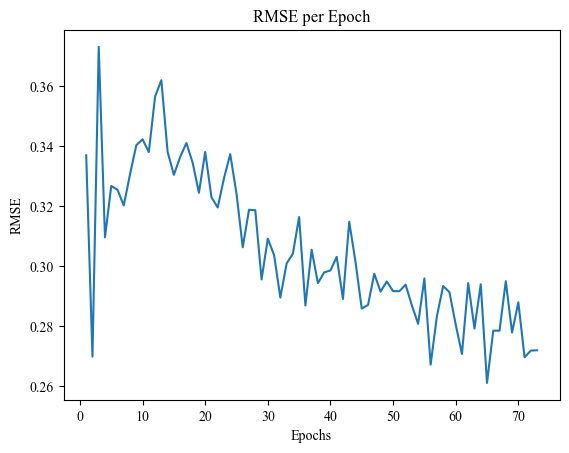

| 33        | -3.1      | 45.1      | 73.91     |
Epoch 1/20, RMSE: 0.3257
Epoch 2/20, RMSE: 0.3019
Epoch 3/20, RMSE: 0.3249
Epoch 4/20, RMSE: 0.3270
Epoch 5/20, RMSE: 0.3077
Epoch 6/20, RMSE: 0.2737
Epoch 7/20, RMSE: 0.2655
Epoch 8/20, RMSE: 0.2567
Epoch 9/20, RMSE: 0.2523
Epoch 10/20, RMSE: 0.2609
Epoch 11/20, RMSE: 0.2695
Epoch 12/20, RMSE: 0.2823
Epoch 13/20, RMSE: 0.3318
Epoch 14/20, RMSE: 0.3218
Epoch 15/20, RMSE: 0.3166
Epoch 16/20, RMSE: 0.3231
Epoch 17/20, RMSE: 0.3117
Epoch 18/20, RMSE: 0.3151
Epoch 19/20, RMSE: 0.3092
Epoch 20/20, RMSE: 0.3064


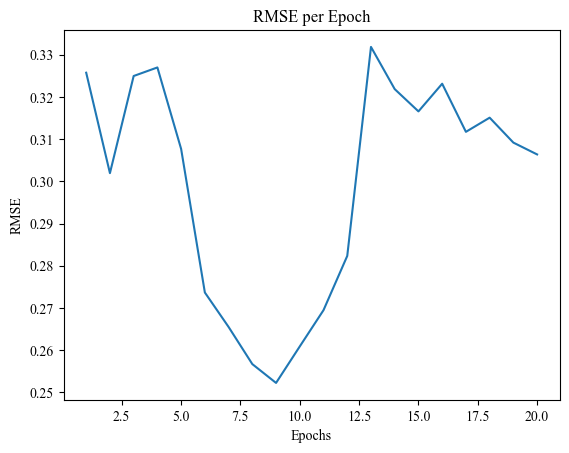

| 34        | -3.71     | 47.11     | 20.55     |
Epoch 1/26, RMSE: 0.3447
Epoch 2/26, RMSE: 0.3102
Epoch 3/26, RMSE: 0.2694
Epoch 4/26, RMSE: 0.2619
Epoch 5/26, RMSE: 0.2652
Epoch 6/26, RMSE: 0.2653
Epoch 7/26, RMSE: 0.3061
Epoch 8/26, RMSE: 0.3107
Epoch 9/26, RMSE: 0.2995
Epoch 10/26, RMSE: 0.3201
Epoch 11/26, RMSE: 0.2983
Epoch 12/26, RMSE: 0.3111
Epoch 13/26, RMSE: 0.2986
Epoch 14/26, RMSE: 0.3058
Epoch 15/26, RMSE: 0.2827
Epoch 16/26, RMSE: 0.2646
Epoch 17/26, RMSE: 0.2638
Epoch 18/26, RMSE: 0.2788
Epoch 19/26, RMSE: 0.2876
Epoch 20/26, RMSE: 0.2838
Epoch 21/26, RMSE: 0.2921
Epoch 22/26, RMSE: 0.2796
Epoch 23/26, RMSE: 0.3126
Epoch 24/26, RMSE: 0.3164
Epoch 25/26, RMSE: 0.3243
Epoch 26/26, RMSE: 0.2953


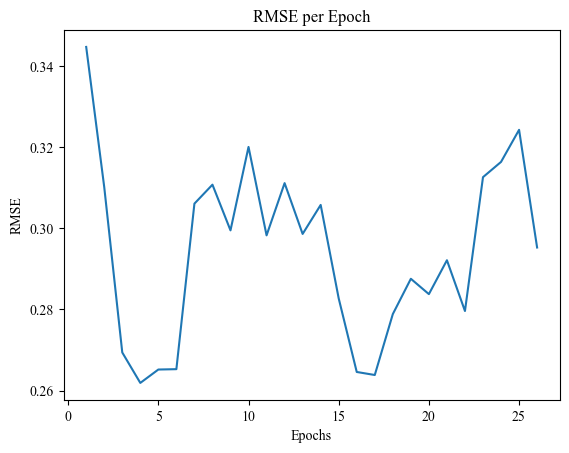

| 35        | -3.482    | 24.66     | 26.34     |
Epoch 1/79, RMSE: 0.3428
Epoch 2/79, RMSE: 0.2885
Epoch 3/79, RMSE: 0.3224
Epoch 4/79, RMSE: 0.3226
Epoch 5/79, RMSE: 0.3116
Epoch 6/79, RMSE: 0.3187
Epoch 7/79, RMSE: 0.3293
Epoch 8/79, RMSE: 0.3264
Epoch 9/79, RMSE: 0.3474
Epoch 10/79, RMSE: 0.3464
Epoch 11/79, RMSE: 0.3347
Epoch 12/79, RMSE: 0.3356
Epoch 13/79, RMSE: 0.3445
Epoch 14/79, RMSE: 0.3195
Epoch 15/79, RMSE: 0.3240
Epoch 16/79, RMSE: 0.3258
Epoch 17/79, RMSE: 0.3040
Epoch 18/79, RMSE: 0.3303
Epoch 19/79, RMSE: 0.3348
Epoch 20/79, RMSE: 0.3208
Epoch 21/79, RMSE: 0.3239
Epoch 22/79, RMSE: 0.3186
Epoch 23/79, RMSE: 0.2880
Epoch 24/79, RMSE: 0.3118
Epoch 25/79, RMSE: 0.3037
Epoch 26/79, RMSE: 0.2964
Epoch 27/79, RMSE: 0.2999
Epoch 28/79, RMSE: 0.2828
Epoch 29/79, RMSE: 0.3005
Epoch 30/79, RMSE: 0.2865
Epoch 31/79, RMSE: 0.2937
Epoch 32/79, RMSE: 0.3046
Epoch 33/79, RMSE: 0.2927
Epoch 34/79, RMSE: 0.2909
Epoch 35/79, RMSE: 0.2895
Epoch 36/79, RMSE: 0.3165
Epoch 37/79, RMSE: 0.30

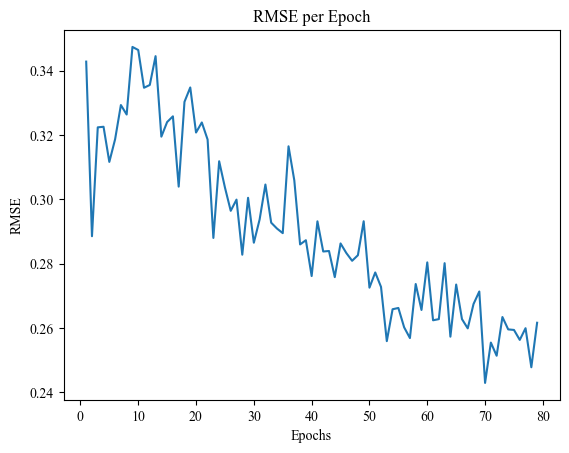

| 36        | -3.125    | 38.33     | 79.82     |
Epoch 1/15, RMSE: 0.3455
Epoch 2/15, RMSE: 0.3085
Epoch 3/15, RMSE: 0.3144
Epoch 4/15, RMSE: 0.3141
Epoch 5/15, RMSE: 0.3006
Epoch 6/15, RMSE: 0.2713
Epoch 7/15, RMSE: 0.2788
Epoch 8/15, RMSE: 0.3134
Epoch 9/15, RMSE: 0.3239
Epoch 10/15, RMSE: 0.3191
Epoch 11/15, RMSE: 0.3148
Epoch 12/15, RMSE: 0.3023
Epoch 13/15, RMSE: 0.3194
Epoch 14/15, RMSE: 0.3180
Epoch 15/15, RMSE: 0.3005


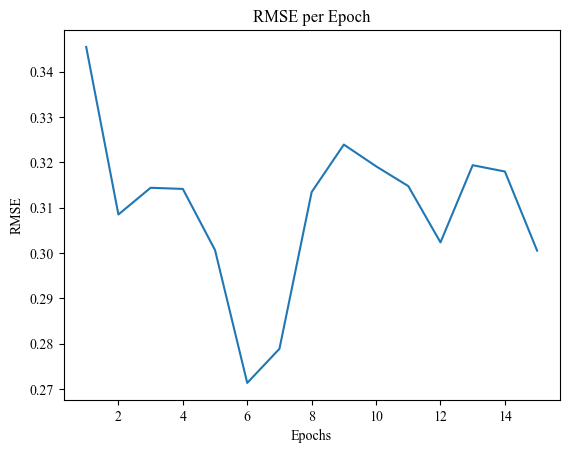

| 37        | -3.678    | 33.42     | 15.91     |
Epoch 1/29, RMSE: 0.3331
Epoch 2/29, RMSE: 0.2769
Epoch 3/29, RMSE: 0.2827
Epoch 4/29, RMSE: 0.2844
Epoch 5/29, RMSE: 0.2853
Epoch 6/29, RMSE: 0.2448
Epoch 7/29, RMSE: 0.2470
Epoch 8/29, RMSE: 0.2339
Epoch 9/29, RMSE: 0.2354
Epoch 10/29, RMSE: 0.2553
Epoch 11/29, RMSE: 0.2578
Epoch 12/29, RMSE: 0.2760
Epoch 13/29, RMSE: 0.2729
Epoch 14/29, RMSE: 0.2858
Epoch 15/29, RMSE: 0.2958
Epoch 16/29, RMSE: 0.3092
Epoch 17/29, RMSE: 0.3221
Epoch 18/29, RMSE: 0.3532
Epoch 19/29, RMSE: 0.3368
Epoch 20/29, RMSE: 0.3313
Epoch 21/29, RMSE: 0.3241
Epoch 22/29, RMSE: 0.3326
Epoch 23/29, RMSE: 0.3397
Epoch 24/29, RMSE: 0.3273
Epoch 25/29, RMSE: 0.3258
Epoch 26/29, RMSE: 0.3368
Epoch 27/29, RMSE: 0.3395
Epoch 28/29, RMSE: 0.3169
Epoch 29/29, RMSE: 0.3291


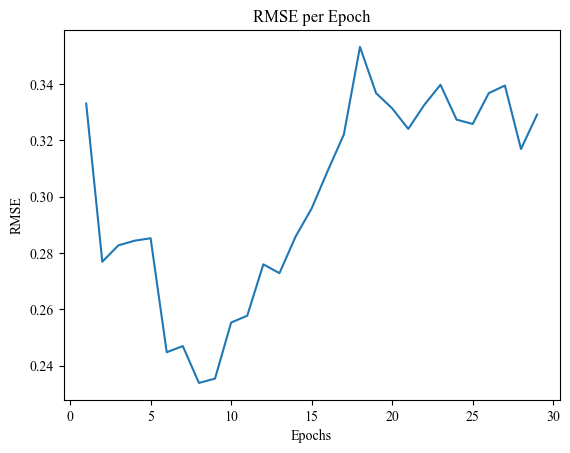

| 38        | -3.635    | 55.26     | 29.43     |
Epoch 1/81, RMSE: 0.3564
Epoch 2/81, RMSE: 0.2768
Epoch 3/81, RMSE: 0.2693
Epoch 4/81, RMSE: 0.2602
Epoch 5/81, RMSE: 0.2731
Epoch 6/81, RMSE: 0.2711
Epoch 7/81, RMSE: 0.2715
Epoch 8/81, RMSE: 0.2988
Epoch 9/81, RMSE: 0.3151
Epoch 10/81, RMSE: 0.3314
Epoch 11/81, RMSE: 0.3567
Epoch 12/81, RMSE: 0.3588
Epoch 13/81, RMSE: 0.3602
Epoch 14/81, RMSE: 0.3630
Epoch 15/81, RMSE: 0.3768
Epoch 16/81, RMSE: 0.3741
Epoch 17/81, RMSE: 0.3730
Epoch 18/81, RMSE: 0.3826
Epoch 19/81, RMSE: 0.3785
Epoch 20/81, RMSE: 0.3777
Epoch 21/81, RMSE: 0.3760
Epoch 22/81, RMSE: 0.3860
Epoch 23/81, RMSE: 0.3812
Epoch 24/81, RMSE: 0.3843
Epoch 25/81, RMSE: 0.3748
Epoch 26/81, RMSE: 0.3889
Epoch 27/81, RMSE: 0.3900
Epoch 28/81, RMSE: 0.3761
Epoch 29/81, RMSE: 0.3732
Epoch 30/81, RMSE: 0.3785
Epoch 31/81, RMSE: 0.3731
Epoch 32/81, RMSE: 0.3733
Epoch 33/81, RMSE: 0.3692
Epoch 34/81, RMSE: 0.3672
Epoch 35/81, RMSE: 0.3655
Epoch 36/81, RMSE: 0.3605
Epoch 37/81, RMSE: 0.34

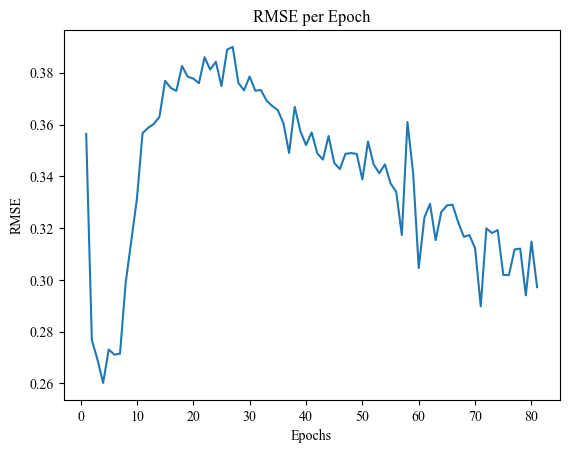

| 39        | -3.338    | 60.16     | 81.93     |
Epoch 1/16, RMSE: 0.3315
Epoch 2/16, RMSE: 0.2795
Epoch 3/16, RMSE: 0.2685
Epoch 4/16, RMSE: 0.2771
Epoch 5/16, RMSE: 0.2776
Epoch 6/16, RMSE: 0.2701
Epoch 7/16, RMSE: 0.3036
Epoch 8/16, RMSE: 0.2982
Epoch 9/16, RMSE: 0.3133
Epoch 10/16, RMSE: 0.3327
Epoch 11/16, RMSE: 0.3392
Epoch 12/16, RMSE: 0.3469
Epoch 13/16, RMSE: 0.3361
Epoch 14/16, RMSE: 0.3469
Epoch 15/16, RMSE: 0.3617
Epoch 16/16, RMSE: 0.3574


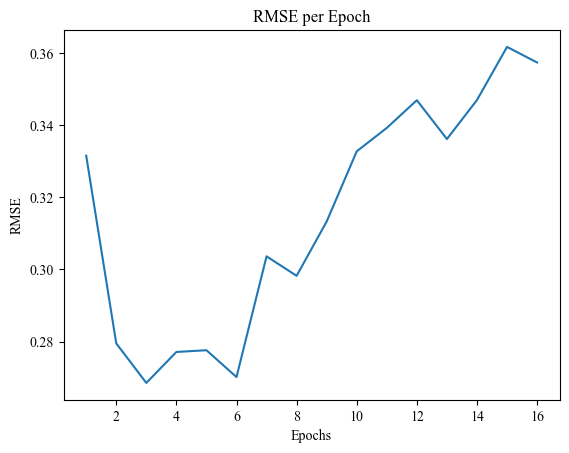

| 40        | -3.773    | 53.92     | 16.71     |
Mejores hiperparámetros: Epochs=26, Batch size=24
Epoch 1/26, RMSE: 0.3676
Epoch 2/26, RMSE: 0.3307
Epoch 3/26, RMSE: 0.3062
Epoch 4/26, RMSE: 0.2932
Epoch 5/26, RMSE: 0.2885
Epoch 6/26, RMSE: 0.2676
Epoch 7/26, RMSE: 0.2585
Epoch 8/26, RMSE: 0.2496
Epoch 9/26, RMSE: 0.2508
Epoch 10/26, RMSE: 0.2400
Epoch 11/26, RMSE: 0.2249
Epoch 12/26, RMSE: 0.2173
Epoch 13/26, RMSE: 0.2192
Epoch 14/26, RMSE: 0.2235
Epoch 15/26, RMSE: 0.2334
Epoch 16/26, RMSE: 0.2403
Epoch 17/26, RMSE: 0.2357
Epoch 18/26, RMSE: 0.2488
Epoch 19/26, RMSE: 0.2244
Epoch 20/26, RMSE: 0.2464
Epoch 21/26, RMSE: 0.2582
Epoch 22/26, RMSE: 0.2412
Epoch 23/26, RMSE: 0.2350
Epoch 24/26, RMSE: 0.2392
Epoch 25/26, RMSE: 0.2544
Epoch 26/26, RMSE: 0.2440


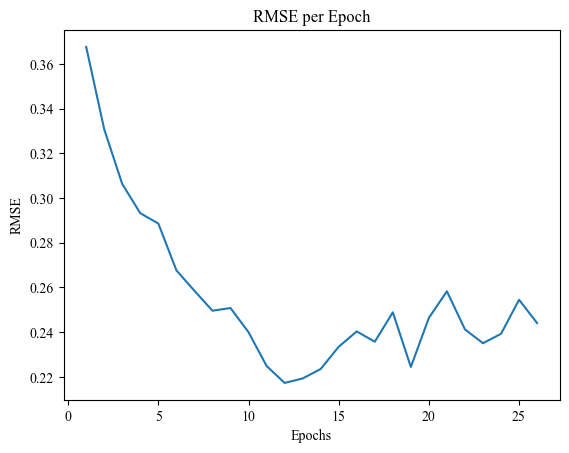

In [369]:
# # main_script.py

# # Definir la función de evaluación para la optimización bayesiana
# def train_evaluate_ANN(epochs, batch_size):
#     input_dim = X_train_goperators.shape[1]
#     ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=int(epochs), batch_size=int(batch_size))
#     ann_wrapper.fit(X_train_goperators, y_train_goperators)
    
#     y_pred = ann_wrapper.predict(X_test_goperators)
#     mse = mean_squared_error(y_test_goperators, y_pred)
#     rmse = np.sqrt(mse)
#     return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# # Rango de hiperparámetros para la optimización bayesiana
# pbounds = {
#     'epochs': (10, 100),
#     'batch_size': (16, 64)
# }

# # Realizar la optimización bayesiana
# optimizer = BayesianOptimization(
#     f=train_evaluate_ANN,
#     pbounds=pbounds,
#     random_state=42
# )

# optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores hiperparámetros
# best_params = optimizer.max['params']
# best_epochs = int(best_params['epochs'])
# best_batch_size = int(best_params['batch_size'])

# print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}')

# # Definir input_dim aquí
# input_dim = X_train_goperators.shape[1]

# # Entrenar y evaluar el modelo final con los mejores hiperparámetros
# ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=best_epochs, batch_size=best_batch_size)
# ann_wrapper.fit(X_train_goperators, y_train_goperators)

# # Guardar el modelo entrenado
# joblib.dump(ann_wrapper, 'ann_model_goperators.pkl')

# # Cargar el modelo entrenado
# loaded_model_ann_goperators = joblib.load('ann_model_goperators.pkl')

# # Predecir con el modelo entrenado
# y_pred_ann_goperators = loaded_model_ann_goperators.predict(X_test_goperators)

In [370]:
# # Calcular las métricas
# mse_ann_goperators = mean_squared_error(y_test_goperators, y_pred_ann_goperators)
# rmse_ann_goperators = np.sqrt(mse_ann_goperators)
# mae_ann_goperators = mean_absolute_error(y_test_goperators, y_pred_ann_goperators)
# r2_ann_goperators = r2_score(y_test_goperators, y_pred_ann_goperators)

# # Imprimir las métricas
# print(f"Mean Squared Error (MSE): {mse_ann_goperators:.5f}")
# print(f"Root Mean Squared Error (RMSE): {rmse_ann_goperators:.5f}")
# print(f"Mean Absolute Error (MAE): {mae_ann_goperators:.5f}")
# print(f"R-squared (R^2): {r2_ann_goperators:.5f}")

Mean Squared Error (MSE): 11.50902
Root Mean Squared Error (RMSE): 3.39249
Mean Absolute Error (MAE): 2.49823
R-squared (R^2): 0.88752


### Desarrollo y ajuste de un modelo **XGBoost** en GOperators

In [195]:
# Definición de la función de validación cruzada
def xgb_cv(n_estimators, max_depth, learning_rate, subsample, colsample_bytree, gamma, min_child_weight):
    model = XGBRegressor(
        n_estimators=int(n_estimators), 
        max_depth=int(max_depth), 
        learning_rate=learning_rate, 
        subsample=subsample, 
        colsample_bytree=colsample_bytree, 
        gamma=gamma, 
        min_child_weight=min_child_weight, 
        objective='reg:squarederror',
        n_jobs=-1
    )
    model.fit(X_train_goperators, y_train_goperators)
    y_pred = model.predict(X_test_goperators)
    return -mean_squared_error(y_test_goperators, y_pred)

# Optimización bayesiana para XGBoost
xgb_optimizer = BayesianOptimization(
    f=xgb_cv,
    pbounds={
        'n_estimators': (10, 200),
        'max_depth': (1, 20),
        'learning_rate': (0.01, 0.3),
        'subsample': (0.5, 1.0),
        'colsample_bytree': (0.5, 1.0),
        'gamma': (0, 5),
        'min_child_weight': (1, 10)
    },
    random_state=42
)

xgb_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para XGBoost
best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
best_learning_rate = xgb_optimizer.max['params']['learning_rate']
best_subsample = xgb_optimizer.max['params']['subsample']
best_colsample_bytree = xgb_optimizer.max['params']['colsample_bytree']
best_gamma = xgb_optimizer.max['params']['gamma']
best_min_child_weight = xgb_optimizer.max['params']['min_child_weight']

# Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
xgb_model_goperators = XGBRegressor(
    n_estimators=best_n_estimators, 
    max_depth=best_max_depth, 
    learning_rate=best_learning_rate, 
    subsample=best_subsample, 
    colsample_bytree=best_colsample_bytree, 
    gamma=best_gamma, 
    min_child_weight=best_min_child_weight, 
    objective='reg:squarederror',
    n_jobs=-1
)
xgb_model_goperators.fit(X_train_goperators, y_train_goperators)

|   iter    |  target   | colsam... |   gamma   | learni... | max_depth | min_ch... | n_esti... | subsample |
-------------------------------------------------------------------------------------------------------------
| 1         | -4.397    | 0.6873    | 4.754     | 0.2223    | 12.37     | 2.404     | 39.64     | 0.529     |
| 2         | -3.439    | 0.9331    | 3.006     | 0.2153    | 1.391     | 9.729     | 168.2     | 0.6062    |
| 3         | -4.231    | 0.5909    | 0.917     | 0.09823   | 10.97     | 4.888     | 65.33     | 0.8059    |
| 4         | -4.095    | 0.5697    | 1.461     | 0.1162    | 9.665     | 8.067     | 47.94     | 0.7571    |
| 5         | -3.877    | 0.7962    | 0.2323    | 0.1862    | 4.24      | 1.585     | 190.3     | 0.9828    |
| 6         | -11.87    | 0.9042    | 1.523     | 0.03832   | 14.0      | 4.961     | 33.19     | 0.7476    |
| 7         | -6.238    | 0.5172    | 4.547     | 0.08505   | 13.59     | 3.805     | 108.8     | 0.7734    |
| 8       

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8652215451760478, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0.014610650359962452,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.02368622346827104,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=9.433987403607084, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=173,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [196]:
print(f"n_estimators: {best_n_estimators}")
print(f"max_depth: {best_max_depth}")
print(f"learning_rate: {best_learning_rate}")
print(f"subsample: {best_subsample}")
print(f"colsample_bytree: {best_colsample_bytree}")
print(f"gamma: {best_gamma}")
print(f"min_child_weight: {best_min_child_weight}")

n_estimators: 173
max_depth: 2
learning_rate: 0.02368622346827104
subsample: 0.8185869969078902
colsample_bytree: 0.8652215451760478
gamma: 0.014610650359962452
min_child_weight: 9.433987403607084


In [352]:
# def xgb_cv(n_estimators, max_depth, learning_rate):
#     model = XGBRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth), learning_rate=learning_rate, objective='reg:squarederror')
#     model.fit(X_train_goperators, y_train_goperators)
#     y_pred = model.predict(X_test_goperators)
#     return -mean_squared_error(y_test_goperators, y_pred)

# # Optimización bayesiana para XGBoost
# xgb_optimizer = BayesianOptimization(
#     f=xgb_cv,
#     pbounds={
#         'n_estimators': (10, 200),
#         'max_depth': (1, 20),
#         'learning_rate': (0.01, 0.3)
#     },
#     random_state=42
# )

# xgb_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para XGBoost
# best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
# best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
# best_learning_rate = xgb_optimizer.max['params']['learning_rate']

# # Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
# xgb_model_goperators = XGBRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth, learning_rate=best_learning_rate, objective='reg:squarederror')
# xgb_model_goperators.fit(X_train_goperators, y_train_goperators)

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
| 1         | -6.231    | 0.1186    | 19.06     | 149.1     |
| 2         | -3.55     | 0.1836    | 3.964     | 39.64     |
| 3         | -6.112    | 0.02684   | 17.46     | 124.2     |
| 4         | -3.432    | 0.2153    | 1.391     | 194.3     |
| 5         | -4.078    | 0.2514    | 5.034     | 44.55     |
| 6         | -4.569    | 0.06319   | 6.781     | 109.7     |
| 7         | -4.416    | 0.1353    | 6.533     | 126.3     |
| 8         | -4.409    | 0.05045   | 6.551     | 79.61     |
| 9         | -5.895    | 0.1423    | 15.92     | 47.94     |
| 10        | -5.673    | 0.1591    | 12.26     | 18.83     |
| 11        | -3.926    | 0.2459    | 2.784     | 199.9     |
| 12        | -4.748    | 0.1589    | 8.731     | 190.9     |
| 13        | -5.348    | 0.3       | 1.0       | 33.24     |
| 14        | -3.506    | 0.3       | 1.0       | 189.4     |
| 15    

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.25779111806041294,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=1, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=182, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [197]:
# Guardar el modelo entrenado
joblib.dump(xgb_model_goperators, 'xgb_model_goperators.pkl')

# Cargar el modelo entrenado
loaded_model_xgb_goperators = joblib.load('xgb_model_goperators.pkl')
loaded_model_xgb_goperators

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8652215451760478, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=0.014610650359962452,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.02368622346827104,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=2, max_leaves=None,
             min_child_weight=9.433987403607084, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=173,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [198]:
# Evaluar el modelo
y_pred_xgb_goperators = loaded_model_xgb_goperators.predict(X_test_goperators)
xgb_mse_goperators = mean_squared_error(y_test_goperators, y_pred_xgb_goperators)

# Calcular las métricas
mse_xgb_goperators = mean_squared_error(y_test_goperators, y_pred_xgb_goperators)
rmse_xgb_goperators = np.sqrt(mse_xgb_goperators)
mae_xgb_goperators = mean_absolute_error(y_test_goperators, y_pred_xgb_goperators)
r2_xgb_goperators = r2_score(y_test_goperators, y_pred_xgb_goperators)

# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_xgb_goperators:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_xgb_goperators:.5f}")
print(f"Mean Absolute Error (MAE): {mae_xgb_goperators:.5f}")
print(f"R-squared (R^2): {r2_xgb_goperators:.5f}")

Mean Squared Error (MSE): 3.32604
Root Mean Squared Error (RMSE): 1.82374
Mean Absolute Error (MAE): 1.14063
R-squared (R^2): 0.96749


In [199]:
# Guardamos las predicciones que se necesitarán más adelante
# Convertir las predicciones a un DataFrame de pandas
y_pred_xgb_goperators = pd.DataFrame(y_pred_xgb_goperators, columns=['pred_xgb_goperators'])

# Guardar el DataFrame como un archivo CSV
y_pred_xgb_goperators.to_csv('y_pred_xgb_goperators.csv', index=False)

### Desarrollo y ajuste de un modelo **KNN** en GOperators

In [215]:
# Normalizar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_goperators)
X_test_scaled = scaler.transform(X_test_goperators)

# Reducir dimensionalidad con PCA
pca = PCA(n_components=0.95)  # Retener 95% de la varianza
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Definir el modelo KNN
knn = KNeighborsRegressor()

# Definir los hiperparámetros a optimizar
param_grid = {
    'n_neighbors': (1, 30),
    'leaf_size': (10, 50),
    'p': (1, 2),  # 1 para Manhattan, 2 para Euclídea
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski']
}

# Configurar la búsqueda bayesiana
opt = BayesSearchCV(
    knn,
    param_grid,
    n_iter=50,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=1
)

# Ejecutar la búsqueda bayesiana
opt.fit(X_train_pca, y_train_goperators)

# Imprimir los mejores hiperparámetros encontrados
print("Best Hyperparameters: ", opt.best_params_)

# Entrenar el modelo con los mejores hiperparámetros
best_knn_goperators = opt.best_estimator_
best_knn_goperators.fit(X_train_pca, y_train_goperators)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(algorithm='brute', leaf_size=10, metric='manhattan',
                    n_neighbors=30, p=1, weights='distance')

In [216]:
# Imprimir los mejores hiperparámetros encontrados uno por uno
best_params = opt.best_params_
print("Best Hyperparameters:")
for param, value in best_params.items():
    print(f"{param}: {value}")

Best Hyperparameters:
algorithm: brute
leaf_size: 10
metric: manhattan
n_neighbors: 30
p: 1
weights: distance


In [356]:
# # Normalizar los datos
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_grecipe)
# X_test_scaled = scaler.transform(X_test_grecipe)

# # Reducir dimensionalidad con PCA
# pca = PCA(n_components=0.95)  # Retener 95% de la varianza
# X_train_pca = pca.fit_transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # Normalizar los datos
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_goperators)
# X_test_scaled = scaler.transform(X_test_goperators)

# # Reducir dimensionalidad con PCA
# pca = PCA(n_components=0.95)  # Retener 95% de la varianza
# X_train_pca = pca.fit_transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # Definir el modelo KNN
# knn = KNeighborsRegressor()

# # Definir los hiperparámetros a optimizar
# param_grid = {
#     'n_neighbors': (1, 30),
#     'leaf_size': (10, 50),
#     'p': (1, 2)  # 1 para Manhattan, 2 para Euclídea
# }

# # Configurar la búsqueda bayesiana
# opt = BayesSearchCV(
#     knn,
#     param_grid,
#     n_iter=50,
#     cv=5,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=1
# )

# # Ejecutar la búsqueda bayesiana
# opt.fit(X_train_pca, y_train_goperators)

# # Imprimir los mejores hiperparámetros encontrados
# print("Best Hyperparameters: ", opt.best_params_)

# # Entrenar el modelo con los mejores hiperparámetros
# best_knn_goperators = opt.best_estimator_
# best_knn_goperators.fit(X_train_pca, y_train_goperators)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=10, n_neighbors=30, p=1)

In [217]:
# Guardar el modelo entrenado
joblib.dump(best_knn_goperators, 'knn_model_goperators.pkl')

# Cargar el modelo entrenado
loaded_model_knn_goperators = joblib.load('knn_model_goperators.pkl')
loaded_model_knn_goperators

KNeighborsRegressor(algorithm='brute', leaf_size=10, metric='manhattan',
                    n_neighbors=30, p=1, weights='distance')

In [218]:
# Predecir y evaluar el modelo
y_pred_knn_goperators = loaded_model_knn_goperators.predict(X_test_pca)

# Calcular las métricas
mae_knn_goperators = mean_absolute_error(y_test_goperators, y_pred_knn_goperators)
mse_knn_goperators = mean_squared_error(y_test_goperators, y_pred_knn_goperators)
rmse_knn_goperators = np.sqrt(mse_knn_goperators)
r2_knn_goperators = r2_score(y_test_goperators, y_pred_knn_goperators)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_knn_goperators:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_knn_goperators:.5f}")
print(f"Mean Absolute Error (MAE): {mae_knn_goperators:.5f}")
print(f"R-squared (R^2): {r2_knn_goperators:.5f}")

Mean Squared Error (MSE): 8.68093
Root Mean Squared Error (RMSE): 2.94634
Mean Absolute Error (MAE): 1.88458
R-squared (R^2): 0.91516


In [219]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_knn_goperators = pd.DataFrame(y_pred_knn_goperators, columns=['pred_knn_goperators'])

# Guardar el DataFrame como un archivo CSV
pred_knn_goperators.to_csv('y_pred_knn_goperators.csv', index=False)

### Modelos y métricas

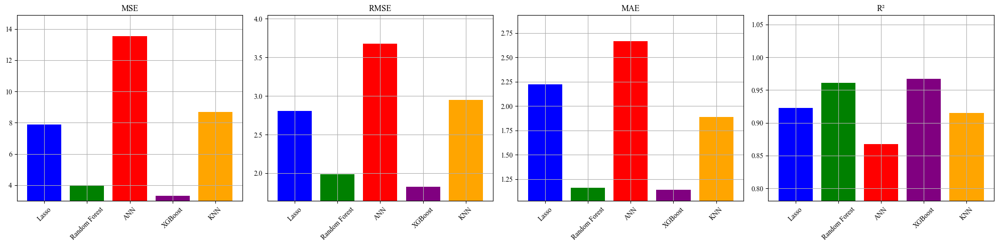

In [343]:
# Ejemplo de datos
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'Random Forest', 'ANN', 'XGBoost', 'KNN']
scores = {
    'Lasso': [mse_lasso_goperators, rmse_lasso_goperators, mae_lasso_goperators, r2_lasso_goperators],
    'Random Forest': [mse_rf_goperators, rmse_rf_goperators, mae_rf_goperators, r2_rf_goperators],
    'ANN': [mse_ann_goperators, rmse_ann_goperators, mae_ann_goperators, r2_ann_goperators],
    'XGBoost': [mse_xgb_goperators, rmse_xgb_goperators, mae_xgb_goperators, r2_xgb_goperators],
    'KNN': [mse_knn_goperators, rmse_knn_goperators, mae_knn_goperators, r2_knn_goperators]
}

# Crear subplots
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs[i]
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'red', 'purple', 'orange'])
    ax.set_title(f'{metric}')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=45)
    ax.grid(True)

plt.tight_layout()
plt.show()
plt.show()
plt.show()

### **Ensamble Heterogéneo** con todos los modelos

Epoch 1/28, RMSE: 0.4128
Epoch 2/28, RMSE: 0.3317
Epoch 3/28, RMSE: 0.3842
Epoch 4/28, RMSE: 0.4621
Epoch 5/28, RMSE: 0.3123
Epoch 6/28, RMSE: 0.3198
Epoch 7/28, RMSE: 0.2838
Epoch 8/28, RMSE: 0.2883
Epoch 9/28, RMSE: 0.2502
Epoch 10/28, RMSE: 0.3229
Epoch 11/28, RMSE: 0.3220
Epoch 12/28, RMSE: 0.4579
Epoch 13/28, RMSE: 0.2380
Epoch 14/28, RMSE: 0.3214
Epoch 15/28, RMSE: 0.2520
Epoch 16/28, RMSE: 0.3197
Epoch 17/28, RMSE: 0.3718
Epoch 18/28, RMSE: 0.3701
Epoch 19/28, RMSE: 0.3436
Epoch 20/28, RMSE: 0.2910
Epoch 21/28, RMSE: 0.2898
Epoch 22/28, RMSE: 0.2896
Epoch 23/28, RMSE: 0.3665
Early stopping at epoch 23


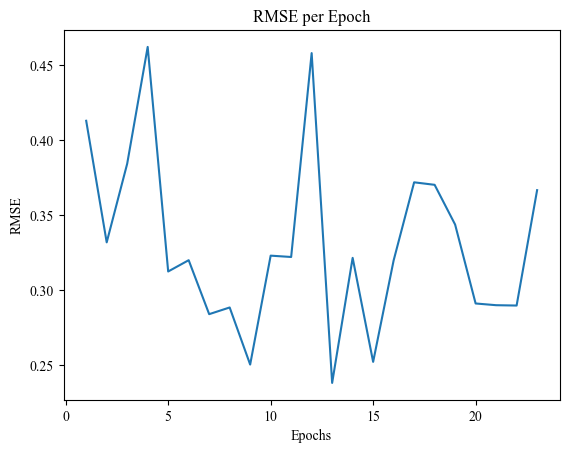

VotingRegressor(estimators=[('lasso',
                             Pipeline(steps=[('scaler', StandardScaler()),
                                             ('lasso',
                                              Lasso(alpha=0.001, max_iter=349,
                                                    tol=0.1))])),
                            ('rf',
                             RandomForestRegressor(bootstrap=False, max_depth=6,
                                                   max_features=0.6506676052501416,
                                                   min_samples_leaf=3,
                                                   min_samples_split=7,
                                                   n_estimators=79)),
                            ('ann',
                             SklearnWrapper(batch_size=48,
                                            dropout_prob=0.13783708843384335,
                                            ep...
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=2,
                                          max_leaves=None,
                                          min_child_weight=9.433987403607084,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=173,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...)),
                            ('knn',
                             KNeighborsRegressor(algorithm='brute',
                                                 leaf_size=10,
                                                 metric='manhattan',
                                                 n_neighbors=30, p=1,
                                                 weights='distance'))])

In [339]:
ensemble_model_goperators = VotingRegressor(estimators=[
    ('lasso', loaded_model_lasso_goperators),
    ('rf', loaded_model_rf_goperators),
    ('ann', loaded_model_ann_goperators),
    ('xgb', loaded_model_xgb_goperators),
    ('knn', loaded_model_knn_goperators)
])

# Entrenar el modelo ensemble
ensemble_model_goperators.fit(X_train_goperators, y_train_goperators)

In [340]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_goperators, 'ensemble_model_goperators.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_goperators = joblib.load('ensemble_model_goperators.pkl')

In [341]:
# Evaluar el modelo ensemble
y_pred_ensamble_goperators = loaded_model_esemble_goperators.predict(X_test_goperators)

In [344]:
# Méttricas
mae_ensamble_goperators = mean_absolute_error(y_test_goperators, y_pred_ensamble_goperators) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_goperators = mean_squared_error(y_test_goperators, y_pred_ensamble_goperators) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_goperators = np.sqrt(mse_ensamble_goperators) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_goperators = r2_score(y_test_goperators, y_pred_ensamble_goperators) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Cuadrático Medio (MSE): {mse_ensamble_goperators:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_goperators:.5f}")
print(f"Error Medio Absoluto (MAE): {mae_ensamble_goperators:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_goperators:.5f}")

Error Cuadrático Medio (MSE): 4.40439
Raíz del Error Cuadrático Medio (RMSE): 2.09866
Error Medio Absoluto (MAE): 1.34940
Coeficiente de Determinación (R^2): 0.95695


### **Ensamble Heterogéneo** con los modelos seleccionados

In [358]:
ensemble_model_goperators_select = VotingRegressor(estimators=[
    #('lasso', loaded_model_lasso_goperators),
    ('rf', loaded_model_rf_goperators),
    #('ann', loaded_model_ann_goperators),
    ('xgb', loaded_model_xgb_goperators),
    #('knn', loaded_model_knn_goperators)
])

# Entrenar el modelo ensemble
ensemble_model_goperators_select.fit(X_train_goperators, y_train_goperators)

VotingRegressor(estimators=[('rf',
                             RandomForestRegressor(bootstrap=False, max_depth=6,
                                                   max_features=0.6506676052501416,
                                                   min_samples_leaf=3,
                                                   min_samples_split=7,
                                                   n_estimators=79)),
                            ('xgb',
                             XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=0.8652215451760478,
                                          device=None,
                                          early_stopping_round...
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=0.02368622346827104,
                                          max_bin=None, max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=2,
                                          max_leaves=None,
                                          min_child_weight=9.433987403607084,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=173,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...))])

In [359]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_goperators_select, 'ensemble_model_goperators_select.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_goperators = joblib.load('ensemble_model_goperators_select.pkl')

In [360]:
# Evaluar el modelo ensemble
y_pred_ensamble_goperators_select = loaded_model_esemble_goperators.predict(X_test_goperators)

In [361]:
# Méttricas
mae_ensamble_goperators_select = mean_absolute_error(y_test_goperators, y_pred_ensamble_goperators_select) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_goperators_select = mean_squared_error(y_test_goperators, y_pred_ensamble_goperators_select) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_goperators_select = np.sqrt(mse_ensamble_goperators_select) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_goperators_select = r2_score(y_test_goperators, y_pred_ensamble_goperators_select) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Cuadrático Medio (MSE): {mse_ensamble_goperators_select:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_goperators_select:.5f}")
print(f"Error Medio Absoluto (MAE): {mae_ensamble_goperators_select:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_goperators_select:.5f}")

Error Cuadrático Medio (MSE): 3.35455
Raíz del Error Cuadrático Medio (RMSE): 1.83154
Error Medio Absoluto (MAE): 1.07985
Coeficiente de Determinación (R^2): 0.96721


In [362]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ensamble_select_goperators = pd.DataFrame(y_pred_ensamble_goperators_select, columns=['pred_ensamble_select_goperators'])

# Guardar el DataFrame como un archivo CSV
pred_ensamble_select_goperators.to_csv('y_pred_ensamble_goperators_select.csv', index=False)

### Modelos y métricas con ensambles

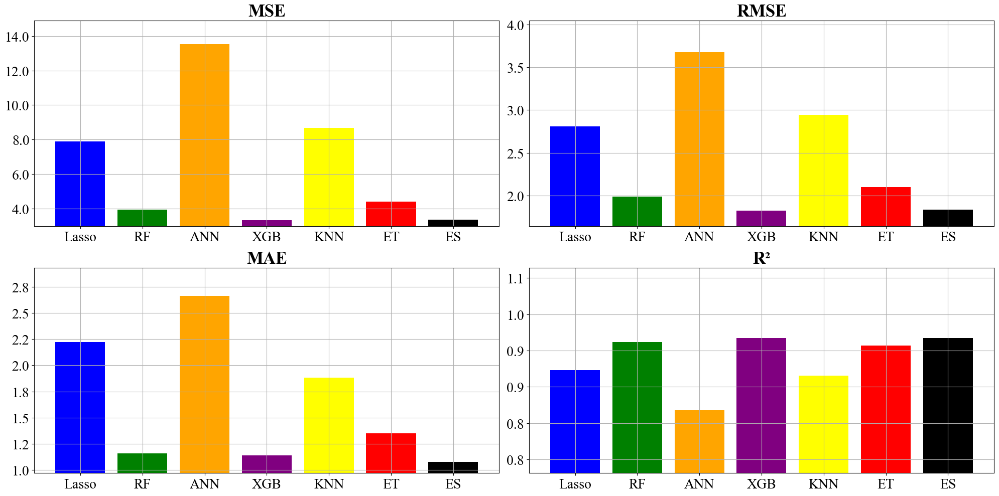

In [363]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'RF', 'ANN', 'XGB', 'KNN', 'ET', 'ES']
scores = {
    'Lasso': [mse_lasso_goperators, rmse_lasso_goperators, mae_lasso_goperators, r2_lasso_goperators],
    'RF': [mse_rf_goperators, rmse_rf_goperators, mae_rf_goperators, r2_rf_goperators],
    'ANN': [mse_ann_goperators, rmse_ann_goperators, mae_ann_goperators, r2_ann_goperators],
    'XGB': [mse_xgb_goperators, rmse_xgb_goperators, mae_xgb_goperators, r2_xgb_goperators],
    'KNN': [mse_knn_goperators, rmse_knn_goperators, mae_knn_goperators, r2_knn_goperators], 
    'ET': [mse_ensamble_goperators, rmse_ensamble_goperators, mae_ensamble_goperators, r2_ensamble_goperators],
    'ES': [mse_ensamble_goperators_select, rmse_ensamble_goperators_select, mae_ensamble_goperators_select, r2_ensamble_goperators_select]
}

# Subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 10))  # Ajustar tamaño para una mejor visualización

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs.flat[i]  # Acceder correctamente a cada subtrama
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'orange', 'purple', 'yellow', 'red', 'black'])
    ax.set_title(f'{metric}', fontsize=25, fontweight='bold')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=0, fontsize=20)
    y_ticks = ax.get_yticks()
    ax.set_yticklabels([f'{y_tick:.1f}' for y_tick in y_ticks], fontsize=20)
    ax.grid(True)

plt.tight_layout()

# Guardar la figura completa en un archivo
plt.savefig('model_performance_metrics_goperators.png', dpi=300)

plt.show()


### Comparación de modelos en el batch 32

In [379]:
# Cargar las predicciones
load_pred_lasso_goperators = pd.read_csv(r'y_pred_lasso_goperators.csv')
load_pred_rf_goperators = pd.read_csv(r'y_pred_rf_goperators.csv')
load_pred_ann_goperators = pd.read_csv(r'y_pred_ann_goperators.csv')
load_pred_xgb_goperators = pd.read_csv(r'y_pred_xgb_goperators.csv')
load_pred_knn_goperators = pd.read_csv(r'y_pred_knn_goperators.csv')
load_pred_ensamble_select_goperators = pd.read_csv(r'y_pred_ensamble_goperators_select.csv')

In [380]:
# se hace un reset a los índices de goperators_test para poder concatenar 
goperators_test_reset = goperators_test.reset_index(drop=True)
# concatenar 
data_select_pred_goperators = pd.concat([goperators_test_reset, load_pred_lasso_goperators, load_pred_rf_goperators, load_pred_ann_goperators,
                                     load_pred_xgb_goperators, load_pred_knn_goperators, load_pred_ensamble_select_goperators], axis=1).reset_index(drop=True)

In [381]:
# Batch 32
batch_32_select = data_select_pred_goperators[data_select_pred_goperators['Batch'] == 32]

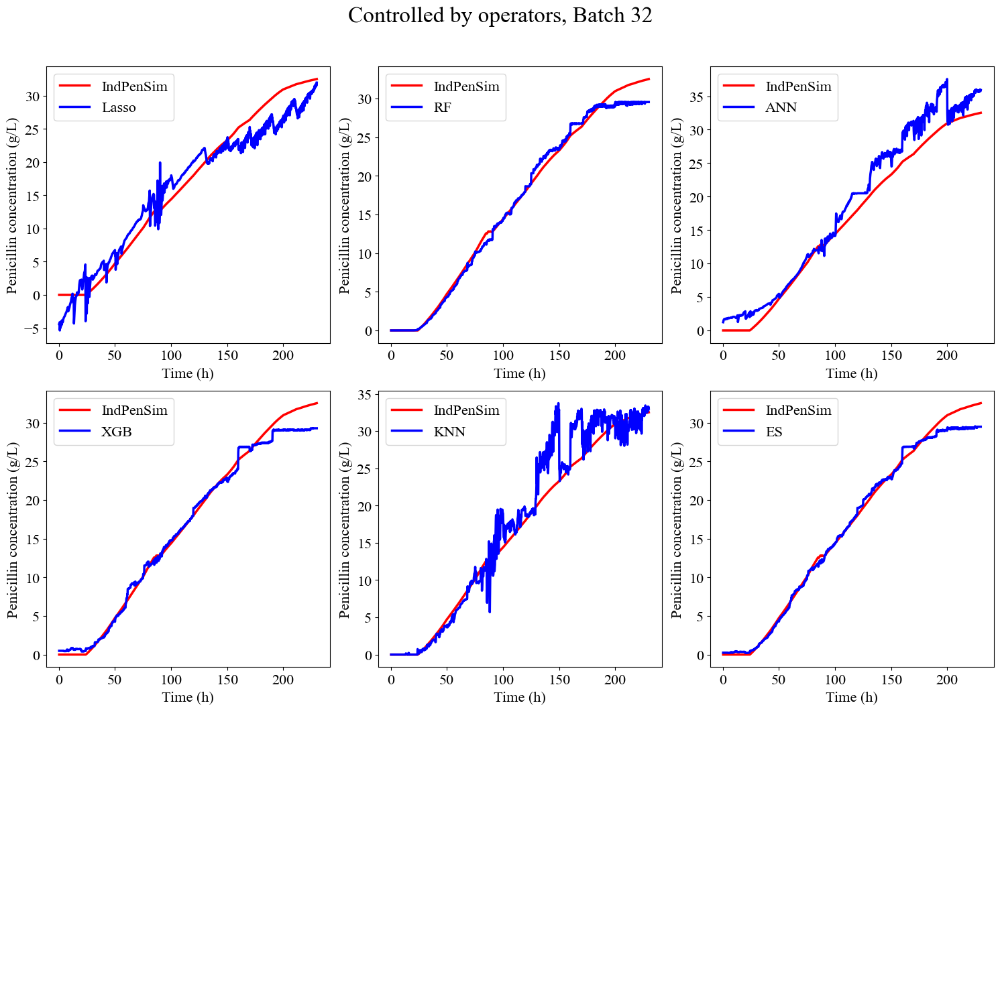

In [382]:
# Configurar matplotlib para usar Times New Roman
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = ['Times New Roman']

# Predicciones
pred_columns = [
    'pred_lasso_goperators', 'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_knn_goperators', 'pred_ensamble_select_goperators'
]

# Nuevos nombres para las columnas
column_names = {
    'pred_lasso_goperators': 'Lasso',
    'pred_rf_goperators': 'RF',
    'pred_ann_goperators': 'ANN',
    'pred_xgb_goperators': 'XGB',
    'pred_knn_goperators': 'KNN',
    'pred_ensamble_select_goperators': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Título
fig.suptitle("Controlled by operators, Batch 32", fontsize=24)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_32_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=column_names[pred_columns[i]], linewidth=2.5)
        #ax.set_title(column_names[pred_columns[i]], fontsize=18)
        ax.set_xlabel("Time (h)", fontsize=16)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=16)
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.legend(fontsize=16)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
fig.subplots_adjust(bottom=0.0001, top=0.92)  # Ajustar el espacio en la parte inferior y superior

# Guardar la figura completa en un archivo
plt.savefig('model_performance_goperators_batch_32.png', dpi=300, bbox_inches='tight')

plt.show()


#### Graficamos los modelos seleccionados y el ensamble

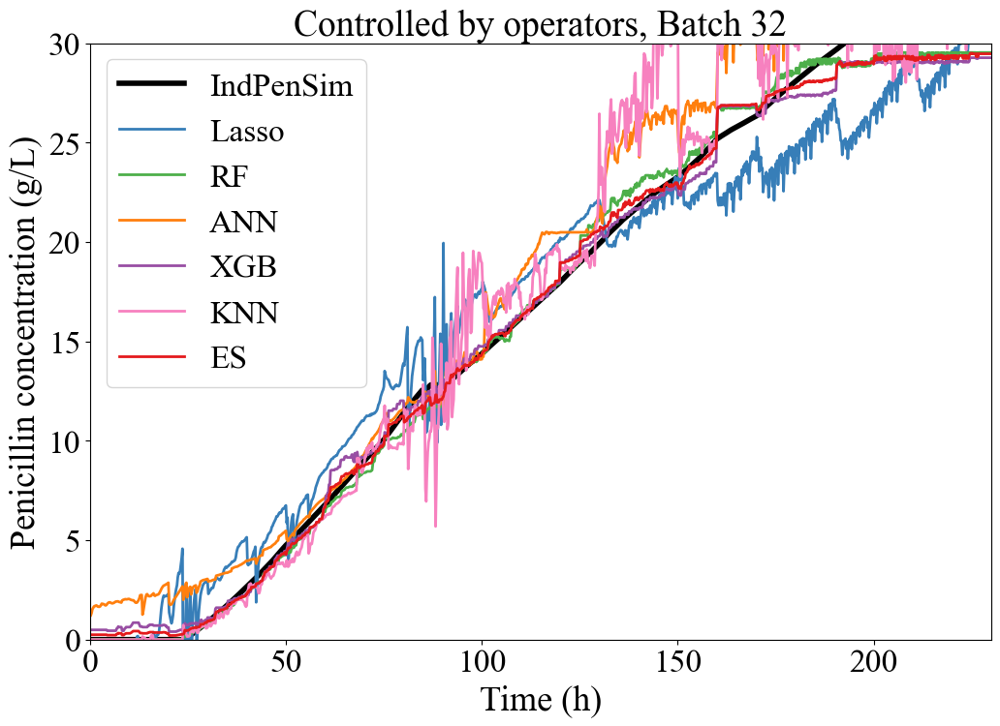

In [383]:
# Predicciones
pred_columns = ['pred_lasso_goperators',
    'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_knn_goperators', 'pred_ensamble_select_goperators'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_goperators': '#377eb8',  # Ajustado a un azul más contrastante
    'pred_rf_goperators': '#4daf4a',     # Ajustado a un verde más claro
    'pred_ann_goperators': '#ff7f0e',    # Naranja
    'pred_xgb_goperators': '#984ea3',    # Púrpura más oscuro
    'pred_knn_goperators': '#f781bf',    # Rojo más brillante
    'pred_ensamble_select_goperators': '#e41a1c' # Rosa más claro e41a1c
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_goperators': 'Lasso',
    'pred_rf_goperators': 'RF',
    'pred_ann_goperators': 'ANN',
    'pred_xgb_goperators': 'XGB',
    'pred_knn_goperators': 'KNN',
    'pred_ensamble_select_goperators': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_32_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 32", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('model_performance_goperators_batch_32_join.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

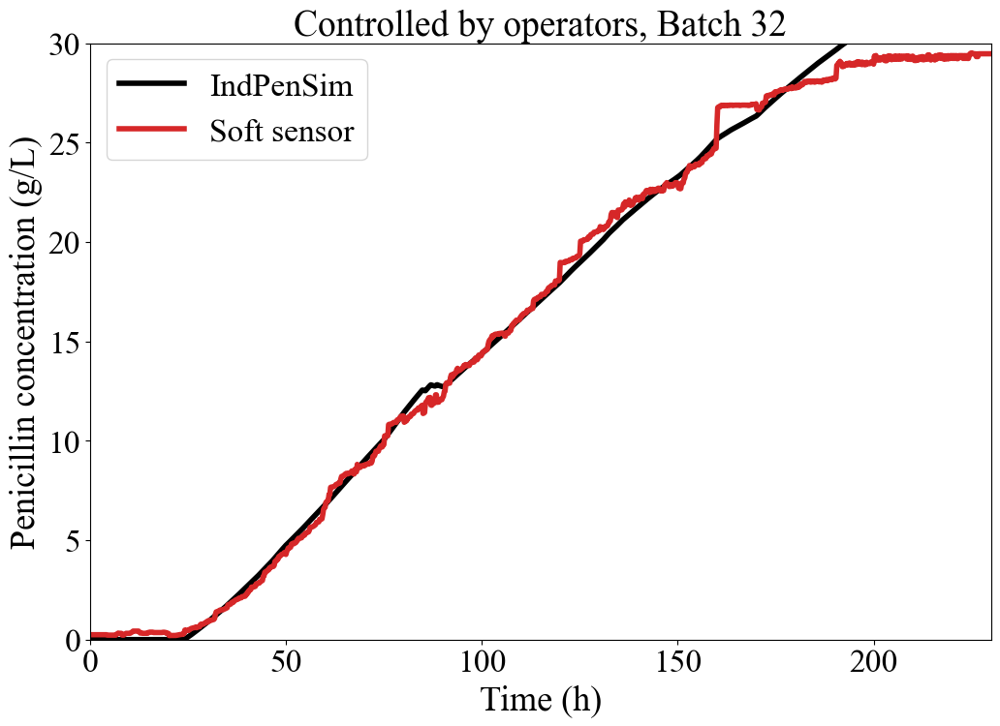

In [384]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_goperators': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_32_select['pred_ensamble_select_goperators'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_goperators'])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 32", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('soft_sensor_batch_32_goperators.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

In [30]:
# Cargar las predicciones
load_pred_lasso_goperators = pd.read_csv(r'y_pred_lasso_goperators.csv')
load_pred_rf_goperators = pd.read_csv(r'y_pred_rf_goperators.csv')
load_pred_ann_goperators = pd.read_csv(r'y_pred_ann_goperators.csv')
load_pred_xgb_goperators = pd.read_csv(r'y_pred_xgb_goperators.csv')
load_pred_knn_goperators = pd.read_csv(r'y_pred_knn_goperators.csv')
load_pred_ensamble_select_goperators = pd.read_csv(r'y_pred_ensamble_goperators_select.csv')

In [31]:
# se hace un reset a los índices de goperators_test para poder concatenar 
goperators_test_reset = goperators_test.reset_index(drop=True)
# concatenar 
data_select_pred_goperators = pd.concat([goperators_test_reset, load_pred_lasso_goperators, load_pred_rf_goperators, load_pred_ann_goperators,
                                         load_pred_xgb_goperators, load_pred_knn_goperators, load_pred_ensamble_select_goperators], axis=1).reset_index(drop=True)

In [32]:
# Batch 32
batch_32_select = data_select_pred_goperators[data_select_pred_goperators['Batch'] == 32]

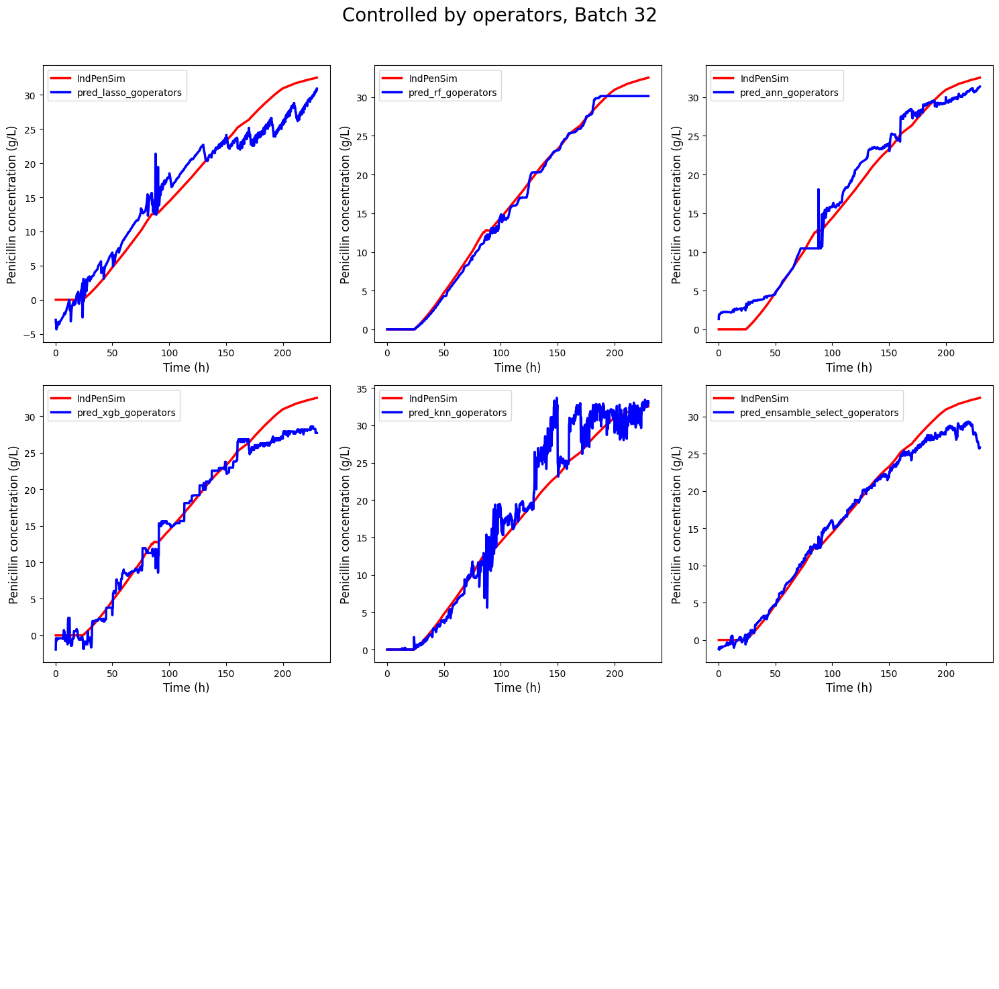

In [33]:
# Predicciones
pred_columns = [
    'pred_lasso_goperators', 'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_knn_goperators', 'pred_ensamble_select_goperators'
]

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Titulo
fig.suptitle("Controlled by operators, Batch 32", fontsize=20)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_32_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=pred_columns[i], linewidth=2.5)
        #ax.set_title(pred_columns[i], fontsize=15)
        ax.set_xlabel("Time (h)", fontsize=12)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=12)
        ax.tick_params(axis='both', which='major', labelsize=10)
        ax.legend(fontsize=10)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
plt.show()

#### Graficamos los modelos seleccionados y el ensamble

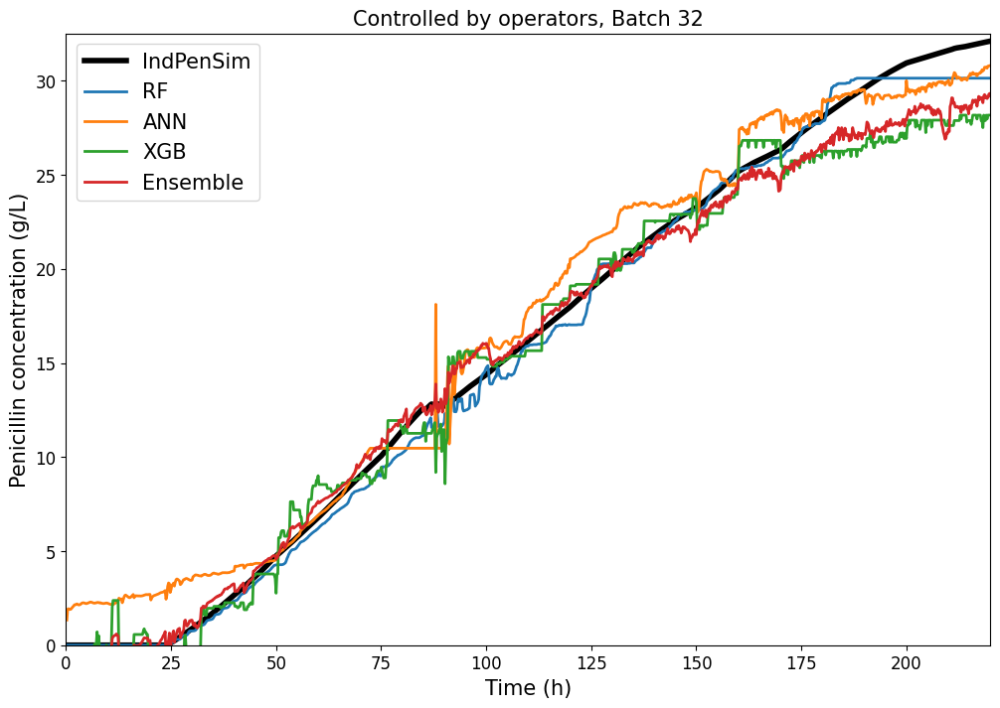

In [34]:
# Predicciones
pred_columns = [
    'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_ensamble_select_goperators'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_goperators': '#9467bd',
    'pred_rf_goperators': '#1f77b4',
    'pred_ann_goperators': '#ff7f0e',
    'pred_xgb_goperators': '#2ca02c',
    #'pred_knn_goperators': '#9467bd',
    'pred_ensamble_select_goperators': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_rf_goperators': 'RF',
    'pred_ann_goperators': 'ANN',
    'pred_xgb_goperators': 'XGB',
    'pred_knn_goperators': 'KNN',
    'pred_ensamble_select_goperators': 'Ensemble'
}

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_32_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_32_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 32", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

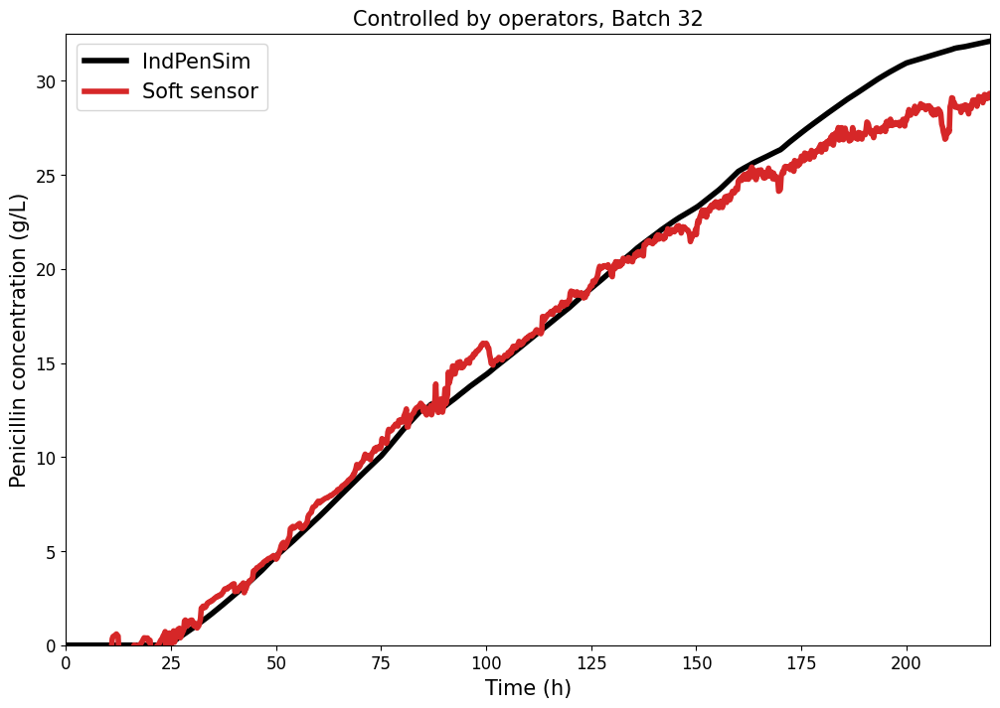

In [35]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_goperators': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_32_select['Time (h)'].to_numpy()
y1 = batch_32_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_32_select['pred_ensamble_select_goperators'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_goperators'])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_32_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 32", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

### Comparación de modelos en el batch 60

In [364]:
# Cargar las predicciones
load_pred_lasso_goperators = pd.read_csv(r'y_pred_lasso_goperators.csv')
load_pred_rf_goperators = pd.read_csv(r'y_pred_rf_goperators.csv')
load_pred_ann_goperators = pd.read_csv(r'y_pred_ann_goperators.csv')
load_pred_xgb_goperators = pd.read_csv(r'y_pred_xgb_goperators.csv')
load_pred_knn_goperators = pd.read_csv(r'y_pred_knn_goperators.csv')
load_pred_ensamble_select_goperators = pd.read_csv(r'y_pred_ensamble_goperators_select.csv')

In [365]:
# se hace un reset a los índices de goperators_test para poder concatenar 
goperators_test_reset = goperators_test.reset_index(drop=True)
# concatenar 
data_select_pred_goperators = pd.concat([goperators_test_reset, load_pred_lasso_goperators, load_pred_rf_goperators, load_pred_ann_goperators,
                                     load_pred_xgb_goperators, load_pred_knn_goperators, load_pred_ensamble_select_goperators], axis=1).reset_index(drop=True)

In [366]:
# Batch 60
batch_60_select = data_select_pred_goperators[data_select_pred_goperators['Batch'] == 60]

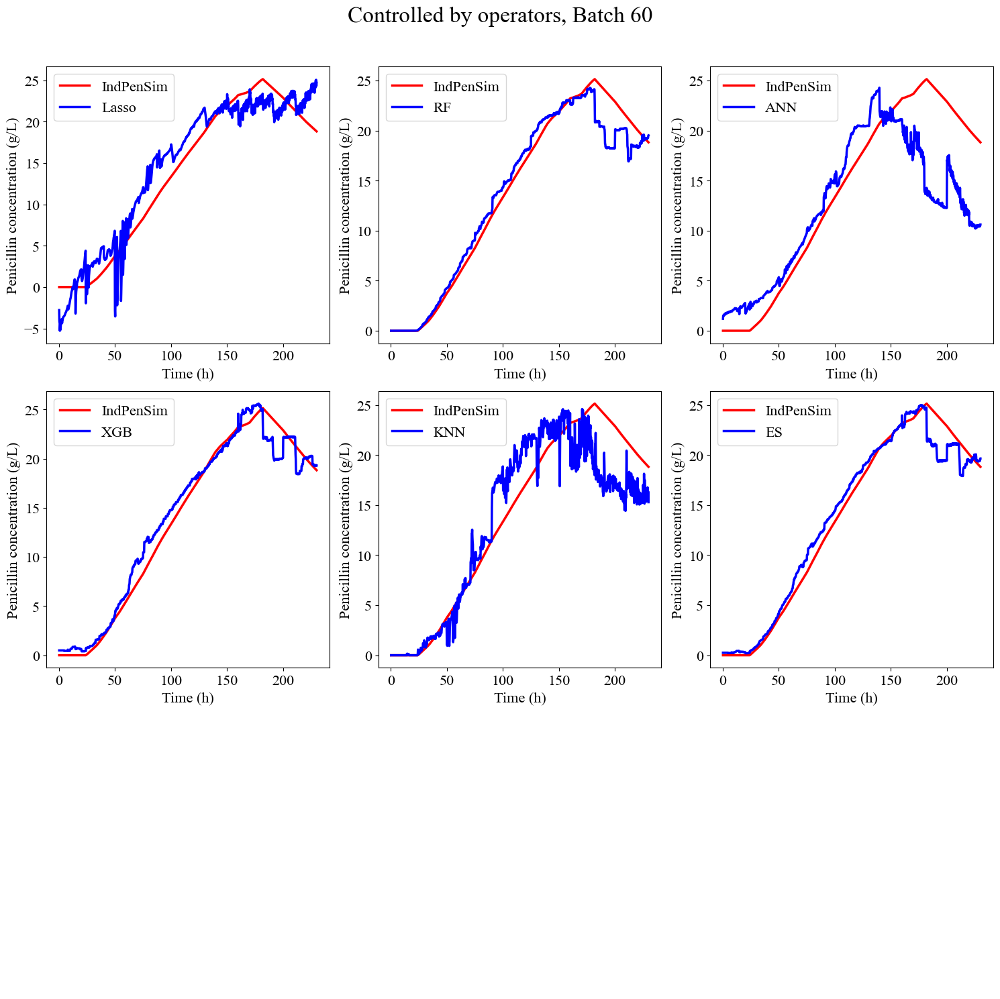

In [368]:
# Configurar matplotlib para usar Times New Roman
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = ['Times New Roman']

# Predicciones
pred_columns = [
    'pred_lasso_goperators', 'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_knn_goperators', 'pred_ensamble_select_goperators'
]

# Nuevos nombres para las columnas
column_names = {
    'pred_lasso_goperators': 'Lasso',
    'pred_rf_goperators': 'RF',
    'pred_ann_goperators': 'ANN',
    'pred_xgb_goperators': 'XGB',
    'pred_knn_goperators': 'KNN',
    'pred_ensamble_select_goperators': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_60_select['Time (h)'].to_numpy()
y1 = batch_60_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Título
fig.suptitle("Controlled by operators, Batch 60", fontsize=24)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_60_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=column_names[pred_columns[i]], linewidth=2.5)
        #ax.set_title(column_names[pred_columns[i]], fontsize=18)
        ax.set_xlabel("Time (h)", fontsize=16)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=16)
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.legend(fontsize=16)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
fig.subplots_adjust(bottom=0.0001, top=0.92)  # Ajustar el espacio en la parte inferior y superior

# Guardar la figura completa en un archivo
plt.savefig('model_performance_goperators_batch_60.png', dpi=300, bbox_inches='tight')

plt.show()


#### Graficamos los modelos seleccionados y el ensamble

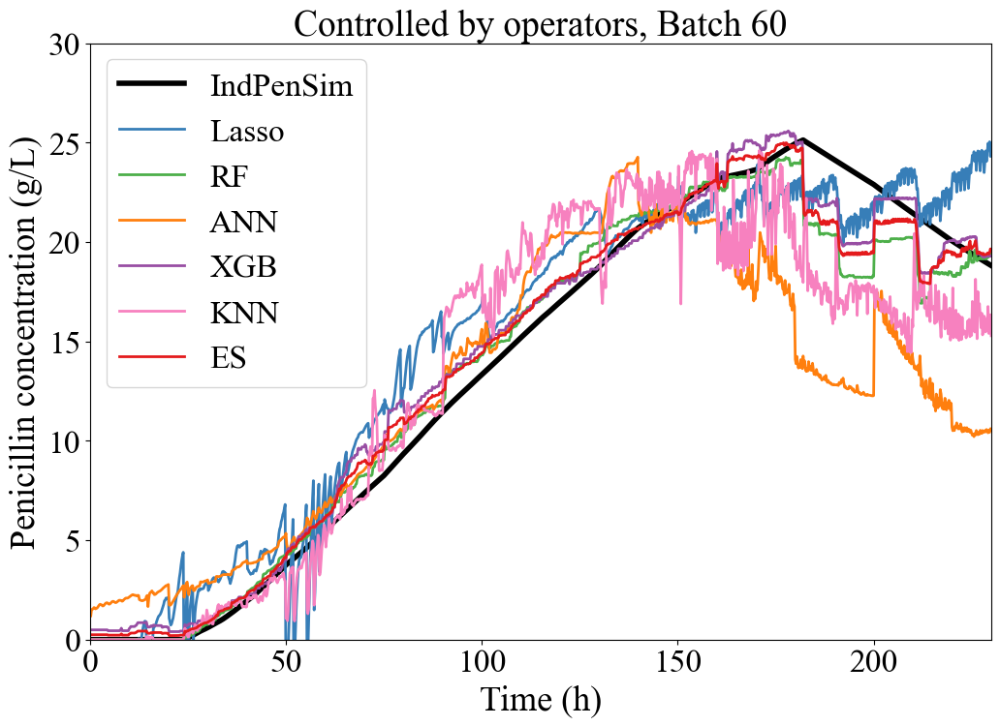

In [378]:
# Predicciones
pred_columns = ['pred_lasso_goperators',
    'pred_rf_goperators', 'pred_ann_goperators',
    'pred_xgb_goperators', 'pred_knn_goperators', 'pred_ensamble_select_goperators'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_goperators': '#377eb8',  # Ajustado a un azul más contrastante
    'pred_rf_goperators': '#4daf4a',     # Ajustado a un verde más claro
    'pred_ann_goperators': '#ff7f0e',    # Naranja
    'pred_xgb_goperators': '#984ea3',    # Púrpura más oscuro
    'pred_knn_goperators': '#f781bf',    # Rojo más brillante
    'pred_ensamble_select_goperators': '#e41a1c' # Rosa más claro e41a1c
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_goperators': 'Lasso',
    'pred_rf_goperators': 'RF',
    'pred_ann_goperators': 'ANN',
    'pred_xgb_goperators': 'XGB',
    'pred_knn_goperators': 'KNN',
    'pred_ensamble_select_goperators': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_60_select['Time (h)'].to_numpy()
y1 = batch_60_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_60_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 60", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('model_performance_goperators_batch_60_join.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

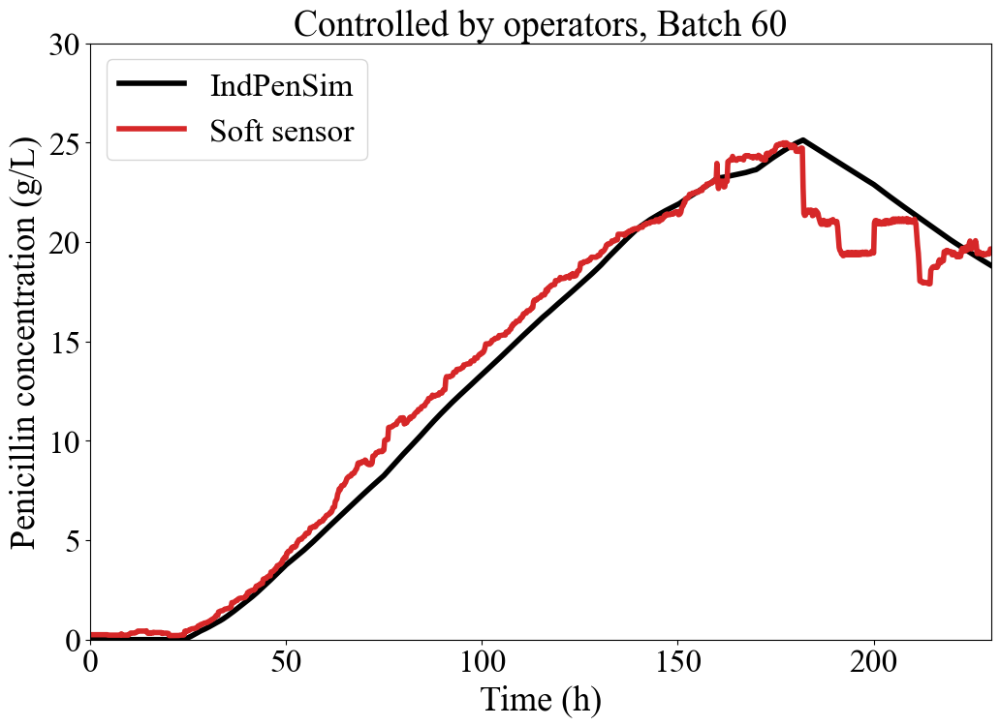

In [376]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_goperators': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_60_select['Time (h)'].to_numpy()
y1 = batch_60_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_60_select['pred_ensamble_select_goperators'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_goperators'])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by operators, Batch 60", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('soft_sensor_batch_60_goperators.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

# **Controlled by APC solution using the Raman spectroscopy**

In [49]:
# Se realiza el particionamiento en train y en test con la estratégia de control: Controlados por una solución 
#de control avanzado de procesos (APC) mediante espectroscopia Raman.

id_gapc_train = [65, 70, 67, 73, 82, 87, 77, 76, 90, 66, 85, 69, 
                89, 83, 71, 88, 81, 72, 62, 80, 61, 74, 84, 75]
id_gapc_test = [64, 68, 78, 79, 86, 63]

# Utilizar una comprensión de lista para obtener los grupos
apc_train = [data_select.groupby('Batch').get_group(id) for id in id_gapc_train]
apc_test = [data_select.groupby('Batch').get_group(id) for id in id_gapc_test]

# Combinar los grupos
gapc_train = pd.concat(apc_train)
gapc_test = pd.concat(apc_test)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_gapc = gapc_train.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_train_gapc = gapc_train["Penicillin concentration(P:g/L)"]
X_test_gapc = gapc_test.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_test_gapc = gapc_test["Penicillin concentration(P:g/L)"]

### Desarrollo y ajuste de un modelo **Lasso** en GAPC

In [158]:
# Función para entrenar y evaluar un modelo Lasso con más hiperparámetros
def lasso_cv(alpha, max_iter, tol, fit_intercept, normalize):
    fit_intercept = bool(round(fit_intercept))
    normalize = bool(round(normalize))
    
    model = Pipeline([
        ('scaler', StandardScaler(with_mean=normalize)),
        ('lasso', Lasso(alpha=alpha, max_iter=int(max_iter), tol=tol, fit_intercept=fit_intercept))
    ])
    model.fit(X_train_gapc, y_train_gapc)
    y_pred = model.predict(X_test_gapc)
    return -mean_squared_error(y_test_gapc, y_pred)

# Espacio de búsqueda para la optimización bayesiana
pbounds = {
    'alpha': (0.001, 1),
    'max_iter': (100, 1000),
    'tol': (1e-5, 1e-1),
    'fit_intercept': (0, 1),  
    'normalize': (0, 1)       
}

# Optimización bayesiana para Lasso
lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds=pbounds, random_state=42, allow_duplicate_points=True)
lasso_optimizer.maximize(init_points=10, n_iter=30)

# Obtener el mejor conjunto de hiperparámetros para Lasso
best_params = lasso_optimizer.max['params']
best_alpha = best_params['alpha']
best_max_iter = int(best_params['max_iter'])
best_tol = best_params['tol']
best_fit_intercept = bool(round(best_params['fit_intercept']))
best_normalize = bool(round(best_params['normalize']))

# Entrenar el modelo Lasso con los mejores hiperparámetros
lasso_model_gapc = Pipeline([
    ('scaler', StandardScaler(with_mean=best_normalize)),
    ('lasso', Lasso(alpha=best_alpha, max_iter=best_max_iter, tol=best_tol, fit_intercept=best_fit_intercept))
])
lasso_model_gapc.fit(X_train_gapc, y_train_gapc)

|   iter    |  target   |   alpha   | fit_in... | max_iter  | normalize |    tol    |
-------------------------------------------------------------------------------------
| 1         | -2.03     | 0.3752    | 0.9507    | 758.8     | 0.5987    | 0.01561   |
| 2         | -236.8    | 0.1568    | 0.05808   | 879.6     | 0.6011    | 0.07081   |
| 3         | -1.32     | 0.02156   | 0.9699    | 849.2     | 0.2123    | 0.01819   |
| 4         | -2.835    | 0.1842    | 0.3042    | 572.3     | 0.4319    | 0.02913   |
| 5         | -3.206    | 0.6122    | 0.1395    | 362.9     | 0.3664    | 0.04561   |
| 6         | -237.6    | 0.7854    | 0.1997    | 562.8     | 0.5924    | 0.004655  |
| 7         | -237.2    | 0.6079    | 0.1705    | 158.5     | 0.9489    | 0.09656   |
| 8         | -237.6    | 0.8086    | 0.3046    | 187.9     | 0.6842    | 0.04402   |
| 9         | -237.5    | 0.1229    | 0.4952    | 130.9     | 0.9093    | 0.02589   |
| 10        | -237.3    | 0.6629    | 0.3117    | 568.

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso',
                 Lasso(alpha=0.021563909801506645, max_iter=849,
                       tol=0.01819067847103799))])

In [159]:
print(f"Best alpha: {best_alpha}")
print(f"Best max_iter: {best_max_iter}")
print(f"Best tol: {best_tol}")
print(f"Best fit_intercept: {best_fit_intercept}")
print(f"Best normalize: {best_normalize}")

Best alpha: 0.021563909801506645
Best max_iter: 849
Best tol: 0.01819067847103799
Best fit_intercept: True
Best normalize: False


In [50]:
# # Definir una función para entrenar y evaluar un modelo Lasso
# def lasso_cv(alpha):
#     model = Lasso(alpha=alpha)
#     model.fit(X_train_gapc, y_train_gapc)
#     y_pred = model.predict(X_test_gapc)
#     return -mean_squared_error(y_test_gapc, y_pred)

# # Optimización bayesiana para Lasso
# lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds={'alpha': (0.001, 1)}, random_state=42, allow_duplicate_points=True)
# lasso_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener el mejor valor de alpha para Lasso
# best_alpha = lasso_optimizer.max['params']['alpha']

# # Entrenar el modelo Lasso con el mejor valor de alpha
# lasso_model_gapc = Lasso(alpha=best_alpha)
# lasso_model_gapc.fit(X_train_gapc, y_train_gapc)

|   iter    |  target   |   alpha   |
-------------------------------------
| 1         | -1.631    | 0.3752    |
| 2         | -1.881    | 0.9508    |
| 3         | -1.864    | 0.7323    |
| 4         | -1.755    | 0.5991    |
| 5         | -1.552    | 0.1569    |
| 6         | -1.552    | 0.1568    |
| 7         | -1.543    | 0.05903   |
| 8         | -1.883    | 0.8663    |
| 9         | -1.757    | 0.6015    |
| 10        | -1.841    | 0.7084    |
| 11        | -1.534    | 0.001     |
| 12        | -1.573    | 0.2412    |
| 13        | -1.579    | 0.01473   |
| 14        | -1.689    | 0.467     |
| 15        | -1.545    | 0.1061    |
| 16        | -1.596    | 0.3046    |
| 17        | -1.56     | 0.1977    |
| 18        | -1.544    | 0.08117   |
| 19        | -1.548    | 0.1314    |
| 20        | -1.583    | 0.2715    |
Data point [0.001] is not unique. 1 duplicates registered. Continuing ...
| 21        | -1.534    | 0.001     |
Data point [0.001] is not unique. 2 duplicates regis

Lasso(alpha=0.001)

In [160]:
# Guardar el modelo entrenado
joblib.dump(lasso_model_gapc, 'lasso_model_gapc.pkl')

# Cargar el modelo entrenado
loaded_model_lasso_gapc = joblib.load('lasso_model_gapc.pkl')
loaded_model_lasso_gapc

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso',
                 Lasso(alpha=0.021563909801506645, max_iter=849,
                       tol=0.01819067847103799))])

In [161]:
# Predecir con el modelo entrenado
y_pred_lasso_gapc = loaded_model_lasso_gapc.predict(X_test_gapc)

# Calcular las métricas
mse_lasso_gapc = mean_squared_error(y_test_gapc, y_pred_lasso_gapc)
rmse_lasso_gapc = np.sqrt(mse_lasso_gapc)
mae_lasso_gapc = mean_absolute_error(y_test_gapc, y_pred_lasso_gapc)
r2_lasso_gapc = r2_score(y_test_gapc, y_pred_lasso_gapc)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_lasso_gapc:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lasso_gapc:.5f}")
print(f"Mean Absolute Error (MAE): {mae_lasso_gapc:.5f}")
print(f"R-squared (R^2): {r2_lasso_gapc:.5f}")

Mean Squared Error (MSE): 1.31996
Root Mean Squared Error (RMSE): 1.14890
Mean Absolute Error (MAE): 0.93080
R-squared (R^2): 0.98791


In [162]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_lasso_gapc = pd.DataFrame(y_pred_lasso_gapc, columns=['pred_lasso_gapc'])

# Guardar el DataFrame como un archivo CSV
pred_lasso_gapc.to_csv('y_pred_lasso_gapc.csv', index=False)

### Desarrollo y ajuste de un modelo **Random Forest** en GAPC

In [168]:
# Definir una función para entrenar y evaluar un modelo Random Forest
def rf_cv(n_estimators, max_depth, max_features, min_samples_split, min_samples_leaf, bootstrap):
    model = RandomForestRegressor(
        n_estimators=int(n_estimators),
        max_depth=int(max_depth),
        max_features=max_features,
        min_samples_split=int(min_samples_split),
        min_samples_leaf=int(min_samples_leaf),
        bootstrap=bootstrap > 0.5  # Convierte a booleano
    )
    model.fit(X_train_gapc, y_train_gapc)
    y_pred = model.predict(X_test_gapc)
    return -mean_squared_error(y_test_gapc, y_pred)

# Optimización bayesiana para Random Forest
pbounds = {
    'n_estimators': (10, 200),
    'max_depth': (1, 20),
    'max_features': (0.1, 1.0),  # Se asume un valor flotante entre 0.1 y 1.0
    'min_samples_split': (2, 20),
    'min_samples_leaf': (1, 20),
    'bootstrap': (0, 1)  # Se usará 0 para False y 1 para True
}

rf_optimizer = BayesianOptimization(f=rf_cv, pbounds=pbounds, random_state=42)
rf_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para Random Forest
best_params = rf_optimizer.max['params']
best_n_estimators = int(best_params['n_estimators'])
best_max_depth = int(best_params['max_depth'])
best_max_features = best_params['max_features']
best_min_samples_split = int(best_params['min_samples_split'])
best_min_samples_leaf = int(best_params['min_samples_leaf'])
best_bootstrap = best_params['bootstrap'] > 0.5

# Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
rf_model_gapc = RandomForestRegressor(
    n_estimators=best_n_estimators,
    max_depth=best_max_depth,
    max_features=best_max_features,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    bootstrap=best_bootstrap
)
rf_model_gapc.fit(X_train_gapc, y_train_gapc)


|   iter    |  target   | bootstrap | max_depth | max_fe... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------------------
| 1         | -2.28     | 0.3745    | 19.06     | 0.7588    | 12.37     | 4.808     | 39.64     |
| 2         | -2.108    | 0.05808   | 17.46     | 0.641     | 14.45     | 2.371     | 194.3     |
| 3         | -2.293    | 0.8324    | 5.034     | 0.2636    | 4.485     | 7.476     | 109.7     |
| 4         | -1.174    | 0.4319    | 6.533     | 0.6507    | 3.65      | 7.259     | 79.61     |
| 5         | -1.704    | 0.4561    | 15.92     | 0.2797    | 10.77     | 12.66     | 18.83     |
| 6         | -6.822    | 0.6075    | 4.24      | 0.1585    | 19.03     | 19.38     | 163.6     |
| 7         | -4.552    | 0.3046    | 2.856     | 0.7158    | 9.363     | 4.197     | 104.1     |
| 8         | -1.614    | 0.03439   | 18.28     | 0.3329    | 13.59     | 7.611     | 108.8     |
| 9         | -1.026

RandomForestRegressor(max_depth=4, max_features=0.9726261649881027,
                      min_samples_leaf=15, min_samples_split=18,
                      n_estimators=180)

In [171]:
#print(f"Best params: {best_params}")
print(f"Best n estimators: {best_n_estimators}")
print(f"Best max depth: {best_max_depth}")
print(f"Best max features: {best_max_features}")
print(f"Best min samples split: {best_min_samples_split}")
print(f"Best min samples leaf: {best_min_samples_leaf}")
print(f"Best best_bootstrap: {best_bootstrap}")

Best n estimators: 180
Best max depth: 4
Best max features: 0.9726261649881027
Best min samples split: 18
Best min samples leaf: 15
Best best_bootstrap: True


In [54]:
# # Definir una función para entrenar y evaluar un modelo Random Forest
# def rf_cv(n_estimators, max_depth):
#     model = RandomForestRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth))
#     model.fit(X_train_gapc, y_train_gapc)
#     y_pred = model.predict(X_test_gapc)
#     return -mean_squared_error(y_test_gapc, y_pred)

# # Optimización bayesiana para Random Forest
# rf_optimizer = BayesianOptimization(f=rf_cv, pbounds={'n_estimators': (10, 200), 'max_depth': (1, 20)}, random_state=42)
# rf_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para Random Forest
# best_n_estimators = int(rf_optimizer.max['params']['n_estimators'])
# best_max_depth = int(rf_optimizer.max['params']['max_depth'])

# # Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
# rf_model_gapc = RandomForestRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth)
# rf_model_gapc.fit(X_train_gapc, y_train_gapc)

|   iter    |  target   | max_depth | n_esti... |
-------------------------------------------------
| 1         | -1.768    | 8.116     | 190.6     |
| 2         | -2.471    | 14.91     | 123.7     |
| 3         | -1.569    | 3.964     | 39.64     |
| 4         | -5.35     | 2.104     | 174.6     |
| 5         | -2.405    | 12.42     | 144.5     |
| 6         | -22.25    | 1.391     | 194.3     |
| 7         | -2.497    | 16.82     | 50.34     |
| 8         | -1.111    | 4.455     | 44.85     |
| 9         | -1.286    | 6.781     | 109.7     |
| 10        | -2.019    | 9.207     | 65.33     |
| 11        | -22.34    | 1.628     | 42.64     |
| 12        | -1.778    | 8.083     | 190.8     |
| 13        | -1.294    | 6.578     | 46.23     |
| 14        | -1.293    | 6.927     | 43.24     |
| 15        | -1.288    | 6.874     | 38.72     |
| 16        | -1.139    | 4.272     | 36.39     |
| 17        | -1.565    | 3.88      | 48.72     |
| 18        | -1.537    | 7.949     | 113.4     |


RandomForestRegressor(max_depth=4, n_estimators=44)

In [172]:
# Guardar el modelo entrenado
joblib.dump(rf_model_gapc, 'rf_model_gapc.pkl')

# Cargar el modelo entrenado
loaded_model_rf_gapc = joblib.load('rf_model_gapc.pkl')
loaded_model_rf_gapc

RandomForestRegressor(max_depth=4, max_features=0.9726261649881027,
                      min_samples_leaf=15, min_samples_split=18,
                      n_estimators=180)

In [173]:
# Predecir con el modelo entrenado
y_pred_rf_gapc = loaded_model_rf_gapc.predict(X_test_gapc)

# Calcular las métricas
mse_rf_gapc = mean_squared_error(y_test_gapc, y_pred_rf_gapc)
rmse_rf_gapc = np.sqrt(mse_rf_gapc)
mae_rf_gapc = mean_absolute_error(y_test_gapc, y_pred_rf_gapc)
r2_rf_gapc = r2_score(y_test_gapc, y_pred_rf_gapc)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_rf_gapc:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_rf_gapc:.5f}")
print(f"Mean Absolute Error (MAE): {mae_rf_gapc:.5f}")
print(f"R-squared (R^2): {r2_rf_gapc:.5f}")

Mean Squared Error (MSE): 1.01133
Root Mean Squared Error (RMSE): 1.00565
Mean Absolute Error (MAE): 0.72637
R-squared (R^2): 0.99074


In [174]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_rf_gapc = pd.DataFrame(y_pred_rf_gapc, columns=['pred_rf_gapc'])

# Guardar el DataFrame como un archivo CSV
pred_rf_gapc.to_csv('y_pred_rf_gapc.csv', index=False)

### Desarrollo y ajuste de un modelo **ANN** en GAPC

|   iter    |  target   | activa... | batch_... | dropou... |  epochs   | hidden... | hidden... | hidden... |
-------------------------------------------------------------------------------------------------------------
Epoch 1/33, RMSE: 0.5315
Epoch 2/33, RMSE: 0.4517
Epoch 3/33, RMSE: 0.3974
Epoch 4/33, RMSE: 0.3624
Epoch 5/33, RMSE: 0.3739
Epoch 6/33, RMSE: 0.4512
Epoch 7/33, RMSE: 0.3827
Epoch 8/33, RMSE: 0.3817
Epoch 9/33, RMSE: 0.3120
Epoch 10/33, RMSE: 0.3075
Epoch 11/33, RMSE: 0.3509
Epoch 12/33, RMSE: 0.3199
Epoch 13/33, RMSE: 0.3293
Epoch 14/33, RMSE: 0.3054
Epoch 15/33, RMSE: 0.3195
Epoch 16/33, RMSE: 0.3072
Epoch 17/33, RMSE: 0.3058
Epoch 18/33, RMSE: 0.2709
Epoch 19/33, RMSE: 0.2476
Epoch 20/33, RMSE: 0.2851
Epoch 21/33, RMSE: 0.2651
Epoch 22/33, RMSE: 0.2357
Epoch 23/33, RMSE: 0.2293
Epoch 24/33, RMSE: 0.2790
Epoch 25/33, RMSE: 0.2287
Epoch 26/33, RMSE: 0.2773
Epoch 27/33, RMSE: 0.2145
Epoch 28/33, RMSE: 0.2370
Epoch 29/33, RMSE: 0.2544
Epoch 30/33, RMSE: 0.2463
Epoch 31/

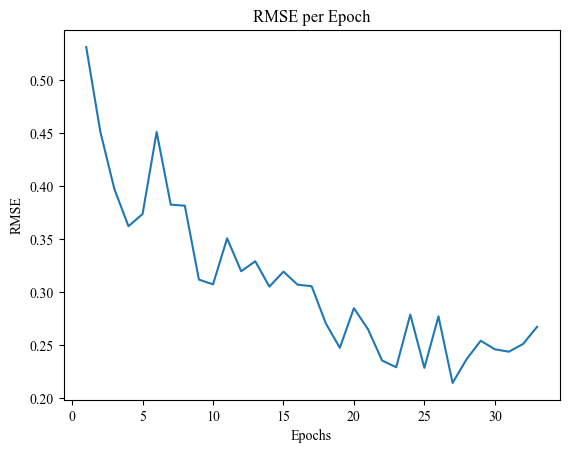

| 1         | -2.691    | 0.7491    | 48.03     | 0.3928    | 33.95     | 93.96     | 93.95     | 37.58     |
Epoch 1/10, RMSE: 0.4780
Epoch 2/10, RMSE: 0.3661
Epoch 3/10, RMSE: 0.4333
Epoch 4/10, RMSE: 0.4372
Epoch 5/10, RMSE: 0.4354
Epoch 6/10, RMSE: 0.3227
Epoch 7/10, RMSE: 0.2564
Epoch 8/10, RMSE: 0.2616
Epoch 9/10, RMSE: 0.2721
Epoch 10/10, RMSE: 0.2795


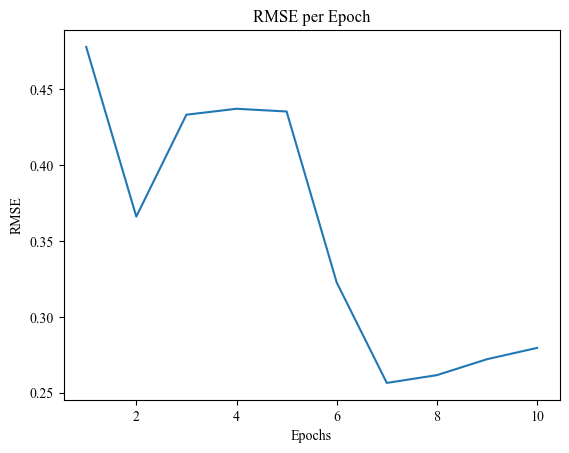

| 2         | -2.77     | 1.732     | 34.04     | 0.3832    | 10.82     | 250.2     | 223.8     | 52.38     |
Epoch 1/30, RMSE: 0.4113
Epoch 2/30, RMSE: 0.3658
Epoch 3/30, RMSE: 0.6591
Epoch 4/30, RMSE: 0.4525
Epoch 5/30, RMSE: 0.5031
Epoch 6/30, RMSE: 0.2585
Epoch 7/30, RMSE: 0.3258
Epoch 8/30, RMSE: 0.2339
Epoch 9/30, RMSE: 0.2239
Epoch 10/30, RMSE: 0.2489
Epoch 11/30, RMSE: 0.2532
Epoch 12/30, RMSE: 0.2587
Epoch 13/30, RMSE: 0.3002
Epoch 14/30, RMSE: 0.2838
Epoch 15/30, RMSE: 0.2479
Epoch 16/30, RMSE: 0.3757
Epoch 17/30, RMSE: 0.4678
Epoch 18/30, RMSE: 0.2992
Epoch 19/30, RMSE: 0.2898
Early stopping at epoch 19


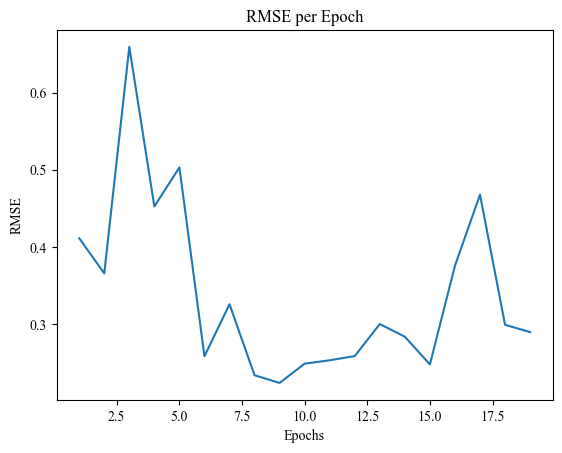

| 3         | -2.861    | 0.3636    | 17.34     | 0.2217    | 30.99     | 146.9     | 119.9     | 90.74     |
Epoch 1/28, RMSE: 0.3945
Epoch 2/28, RMSE: 0.3632
Epoch 3/28, RMSE: 0.3348
Epoch 4/28, RMSE: 0.3383
Epoch 5/28, RMSE: 0.4258
Epoch 6/28, RMSE: 0.3011
Epoch 7/28, RMSE: 0.2523
Epoch 8/28, RMSE: 0.3965
Epoch 9/28, RMSE: 0.3727
Epoch 10/28, RMSE: 0.2957
Epoch 11/28, RMSE: 0.3165
Epoch 12/28, RMSE: 0.3082
Epoch 13/28, RMSE: 0.3035
Epoch 14/28, RMSE: 0.2803
Epoch 15/28, RMSE: 0.2950
Epoch 16/28, RMSE: 0.2826
Epoch 17/28, RMSE: 0.2902
Early stopping at epoch 17


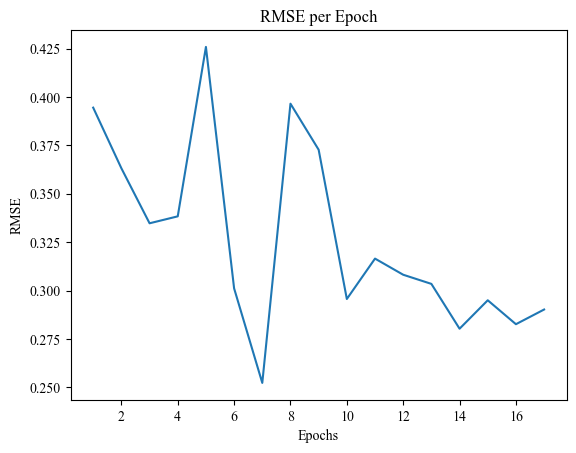

| 4         | -2.841    | 0.279     | 21.69     | 0.2465    | 28.24     | 214.8     | 102.3     | 81.37     |
Epoch 1/16, RMSE: 0.4425
Epoch 2/16, RMSE: 0.4841
Epoch 3/16, RMSE: 0.5013
Epoch 4/16, RMSE: 0.4285
Epoch 5/16, RMSE: 0.5913
Epoch 6/16, RMSE: 0.3423
Epoch 7/16, RMSE: 0.3514
Epoch 8/16, RMSE: 0.5134
Epoch 9/16, RMSE: 0.3377
Epoch 10/16, RMSE: 0.4254
Epoch 11/16, RMSE: 0.4772
Epoch 12/16, RMSE: 0.4008
Epoch 13/16, RMSE: 0.3896
Epoch 14/16, RMSE: 0.2770
Epoch 15/16, RMSE: 0.3637
Epoch 16/16, RMSE: 0.3132


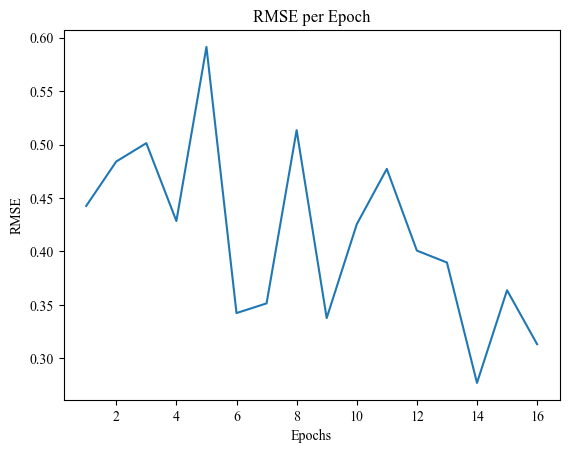

| 5         | -3.095    | 1.185     | 11.86     | 0.343     | 16.82     | 76.49     | 246.2     | 124.7     |
Epoch 1/37, RMSE: 0.2983
Epoch 2/37, RMSE: 0.3802
Epoch 3/37, RMSE: 0.4057
Epoch 4/37, RMSE: 0.3559
Epoch 5/37, RMSE: 0.2606
Epoch 6/37, RMSE: 0.2400
Epoch 7/37, RMSE: 0.2432
Epoch 8/37, RMSE: 0.2209
Epoch 9/37, RMSE: 0.2566
Epoch 10/37, RMSE: 0.2086
Epoch 11/37, RMSE: 0.1948
Epoch 12/37, RMSE: 0.2440
Epoch 13/37, RMSE: 0.2406
Epoch 14/37, RMSE: 0.2285
Epoch 15/37, RMSE: 0.2731
Epoch 16/37, RMSE: 0.3539
Epoch 17/37, RMSE: 0.3067
Epoch 18/37, RMSE: 0.2905
Epoch 19/37, RMSE: 0.3168
Epoch 20/37, RMSE: 0.2904
Epoch 21/37, RMSE: 0.2967
Early stopping at epoch 21


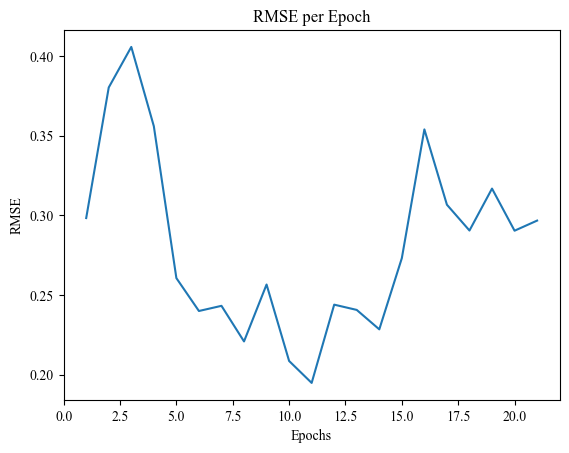

| 6         | -3.002    | 1.617     | 22.18     | 0.1391    | 37.37     | 148.5     | 87.43     | 79.54     |
Epoch 1/36, RMSE: 0.4068
Epoch 2/36, RMSE: 0.4474
Epoch 3/36, RMSE: 0.3378
Epoch 4/36, RMSE: 0.3594
Epoch 5/36, RMSE: 0.2810
Epoch 6/36, RMSE: 0.2871
Epoch 7/36, RMSE: 0.2874
Epoch 8/36, RMSE: 0.2773
Epoch 9/36, RMSE: 0.2608
Epoch 10/36, RMSE: 0.2436
Epoch 11/36, RMSE: 0.2372
Epoch 12/36, RMSE: 0.2485
Epoch 13/36, RMSE: 0.2877
Epoch 14/36, RMSE: 0.2822
Epoch 15/36, RMSE: 0.2653
Epoch 16/36, RMSE: 0.2353
Epoch 17/36, RMSE: 0.2445
Epoch 18/36, RMSE: 0.2355
Epoch 19/36, RMSE: 0.2431
Epoch 20/36, RMSE: 0.1952
Epoch 21/36, RMSE: 0.2087
Epoch 22/36, RMSE: 0.2137
Epoch 23/36, RMSE: 0.2142
Epoch 24/36, RMSE: 0.1868
Epoch 25/36, RMSE: 0.2124
Epoch 26/36, RMSE: 0.2192
Epoch 27/36, RMSE: 0.1908
Epoch 28/36, RMSE: 0.1918
Epoch 29/36, RMSE: 0.1845
Epoch 30/36, RMSE: 0.2069
Epoch 31/36, RMSE: 0.2132
Epoch 32/36, RMSE: 0.1777
Epoch 33/36, RMSE: 0.1938
Epoch 34/36, RMSE: 0.1776
Epoch 35/36, RM

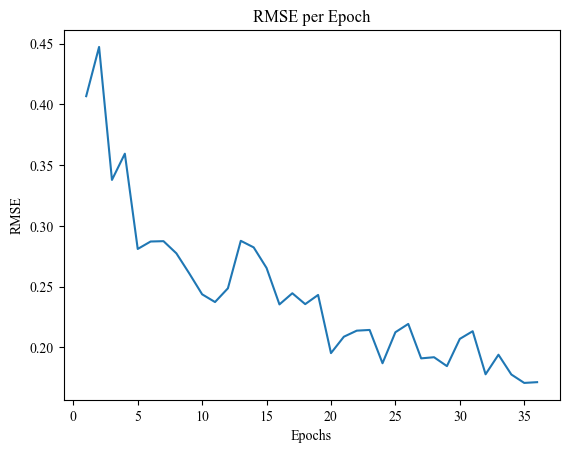

| 7         | -1.812    | 0.06878   | 46.37     | 0.2035    | 36.5      | 123.8     | 163.9     | 84.48     |
Epoch 1/47, RMSE: 0.5005
Epoch 2/47, RMSE: 0.4558
Epoch 3/47, RMSE: 0.3443
Epoch 4/47, RMSE: 0.3787
Epoch 5/47, RMSE: 0.3652
Epoch 6/47, RMSE: 0.3134
Epoch 7/47, RMSE: 0.5731
Epoch 8/47, RMSE: 0.3880
Epoch 9/47, RMSE: 0.2736
Epoch 10/47, RMSE: 0.2858
Epoch 11/47, RMSE: 0.3011
Epoch 12/47, RMSE: 0.2567
Epoch 13/47, RMSE: 0.3007
Epoch 14/47, RMSE: 0.2595
Epoch 15/47, RMSE: 0.3275
Epoch 16/47, RMSE: 0.2520
Epoch 17/47, RMSE: 0.2543
Epoch 18/47, RMSE: 0.2774
Epoch 19/47, RMSE: 0.2369
Epoch 20/47, RMSE: 0.2532
Epoch 21/47, RMSE: 0.3274
Epoch 22/47, RMSE: 0.2766
Epoch 23/47, RMSE: 0.2484
Epoch 24/47, RMSE: 0.2345
Epoch 25/47, RMSE: 0.2566
Epoch 26/47, RMSE: 0.2944
Epoch 27/47, RMSE: 0.2745
Epoch 28/47, RMSE: 0.2430
Epoch 29/47, RMSE: 0.2254
Epoch 30/47, RMSE: 0.2089
Epoch 31/47, RMSE: 0.2509
Epoch 32/47, RMSE: 0.2164
Epoch 33/47, RMSE: 0.1832
Epoch 34/47, RMSE: 0.2024
Epoch 35/47, RM

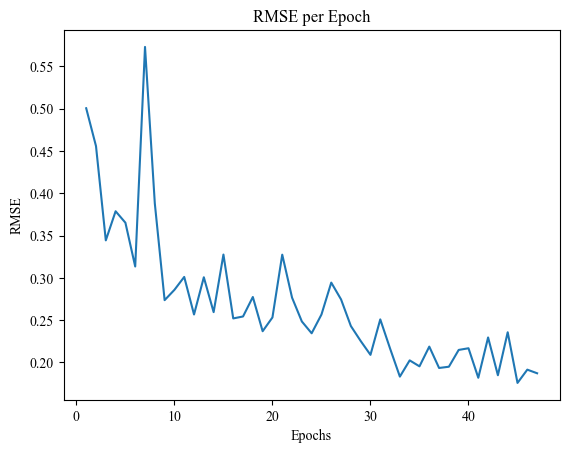

| 8         | -2.019    | 0.3697    | 48.78     | 0.4101    | 47.58     | 235.8     | 178.8     | 120.5     |
Epoch 1/23, RMSE: 0.4204
Epoch 2/23, RMSE: 0.5289
Epoch 3/23, RMSE: 0.3444
Epoch 4/23, RMSE: 0.3332
Epoch 5/23, RMSE: 0.2914
Epoch 6/23, RMSE: 0.2948
Epoch 7/23, RMSE: 0.2426
Epoch 8/23, RMSE: 0.2397
Epoch 9/23, RMSE: 0.2590
Epoch 10/23, RMSE: 0.2599
Epoch 11/23, RMSE: 0.2400
Epoch 12/23, RMSE: 0.2865
Epoch 13/23, RMSE: 0.3302
Epoch 14/23, RMSE: 0.3097
Epoch 15/23, RMSE: 0.2826
Epoch 16/23, RMSE: 0.2207
Epoch 17/23, RMSE: 0.2665
Epoch 18/23, RMSE: 0.2505
Epoch 19/23, RMSE: 0.3093
Epoch 20/23, RMSE: 0.2989
Epoch 21/23, RMSE: 0.3233
Epoch 22/23, RMSE: 0.2953
Epoch 23/23, RMSE: 0.2540


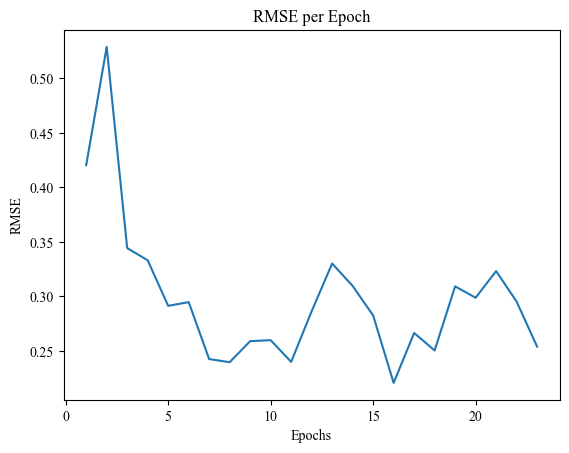

| 9         | -2.38     | 0.177     | 17.84     | 0.1181    | 23.01     | 138.6     | 116.1     | 111.6     |
Epoch 1/15, RMSE: 0.4773
Epoch 2/15, RMSE: 0.5517
Epoch 3/15, RMSE: 0.4259
Epoch 4/15, RMSE: 0.4686
Epoch 5/15, RMSE: 0.4254
Epoch 6/15, RMSE: 0.3588
Epoch 7/15, RMSE: 0.4253
Epoch 8/15, RMSE: 0.4018
Epoch 9/15, RMSE: 0.3874
Epoch 10/15, RMSE: 0.3562
Epoch 11/15, RMSE: 0.4145
Epoch 12/15, RMSE: 0.4083
Epoch 13/15, RMSE: 0.3787
Epoch 14/15, RMSE: 0.3944
Epoch 15/15, RMSE: 0.3724


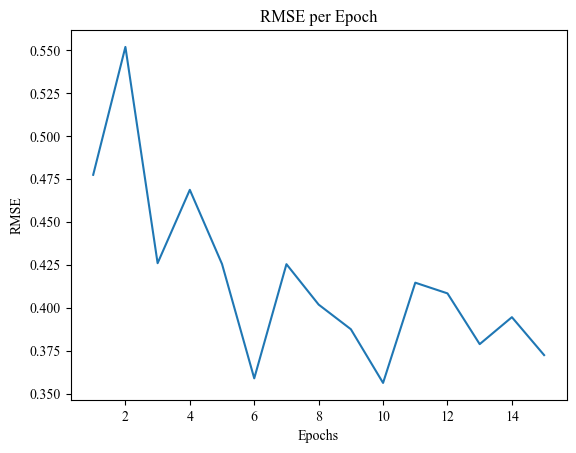

| 10        | -3.681    | 0.7135    | 21.24     | 0.3171    | 15.64     | 218.0     | 78.31     | 126.7     |
Epoch 1/19, RMSE: 0.4942
Epoch 2/19, RMSE: 0.5606
Epoch 3/19, RMSE: 0.4436
Epoch 4/19, RMSE: 0.4162
Epoch 5/19, RMSE: 0.4663
Epoch 6/19, RMSE: 0.3541
Epoch 7/19, RMSE: 0.4054
Epoch 8/19, RMSE: 0.3820
Epoch 9/19, RMSE: 0.4078
Epoch 10/19, RMSE: 0.3838
Epoch 11/19, RMSE: 0.3808
Epoch 12/19, RMSE: 0.3723
Epoch 13/19, RMSE: 0.4542
Epoch 14/19, RMSE: 0.4093
Epoch 15/19, RMSE: 0.4052
Epoch 16/19, RMSE: 0.4060
Early stopping at epoch 16


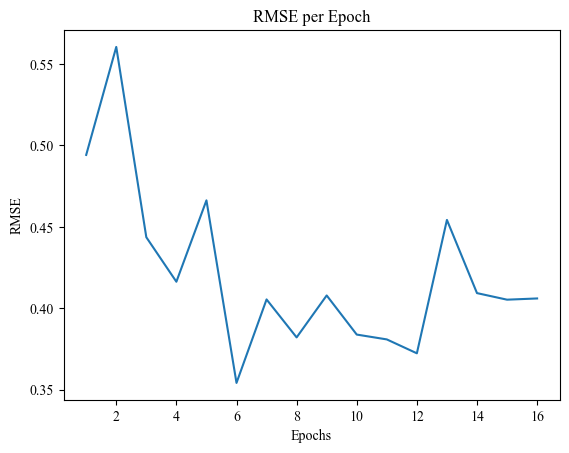

| 11        | -4.044    | 1.18      | 23.14     | 0.4402    | 19.96     | 142.6     | 117.0     | 115.6     |
Epoch 1/43, RMSE: 0.6353
Epoch 2/43, RMSE: 0.5993
Epoch 3/43, RMSE: 0.5887
Epoch 4/43, RMSE: 0.5342
Epoch 5/43, RMSE: 0.6167
Epoch 6/43, RMSE: 0.3897
Epoch 7/43, RMSE: 0.5450
Epoch 8/43, RMSE: 0.5546
Epoch 9/43, RMSE: 0.4454
Epoch 10/43, RMSE: 0.4300
Epoch 11/43, RMSE: 0.3901
Epoch 12/43, RMSE: 0.3404
Epoch 13/43, RMSE: 0.3888
Epoch 14/43, RMSE: 0.3707
Epoch 15/43, RMSE: 0.3446
Epoch 16/43, RMSE: 0.3402
Epoch 17/43, RMSE: 0.3509
Epoch 18/43, RMSE: 0.3831
Epoch 19/43, RMSE: 0.3313
Epoch 20/43, RMSE: 0.3700
Epoch 21/43, RMSE: 0.3807
Epoch 22/43, RMSE: 0.3180
Epoch 23/43, RMSE: 0.3299
Epoch 24/43, RMSE: 0.3220
Epoch 25/43, RMSE: 0.2908
Epoch 26/43, RMSE: 0.3168
Epoch 27/43, RMSE: 0.3400
Epoch 28/43, RMSE: 0.2630
Epoch 29/43, RMSE: 0.3186
Epoch 30/43, RMSE: 0.3010
Epoch 31/43, RMSE: 0.2954
Epoch 32/43, RMSE: 0.3055
Epoch 33/43, RMSE: 0.3406
Epoch 34/43, RMSE: 0.2496
Epoch 35/43, RM

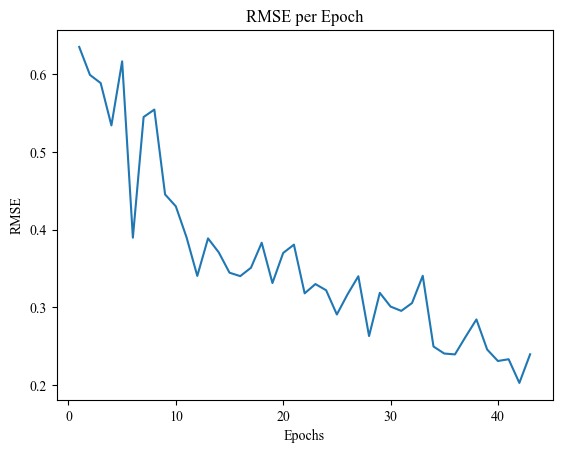

| 12        | -2.359    | 0.1287    | 14.36     | 0.4586    | 44.0      | 208.4     | 117.6     | 79.79     |
Epoch 1/28, RMSE: 0.4406
Epoch 2/28, RMSE: 0.5757
Epoch 3/28, RMSE: 0.6018
Epoch 4/28, RMSE: 0.4436
Epoch 5/28, RMSE: 0.3715
Epoch 6/28, RMSE: 0.4381
Epoch 7/28, RMSE: 0.4783
Epoch 8/28, RMSE: 0.4362
Epoch 9/28, RMSE: 0.3816
Epoch 10/28, RMSE: 0.3649
Epoch 11/28, RMSE: 0.3953
Epoch 12/28, RMSE: 0.4034
Epoch 13/28, RMSE: 0.4609
Epoch 14/28, RMSE: 0.4518
Epoch 15/28, RMSE: 0.3894
Epoch 16/28, RMSE: 0.3966
Epoch 17/28, RMSE: 0.3833
Epoch 18/28, RMSE: 0.3646
Epoch 19/28, RMSE: 0.4544
Epoch 20/28, RMSE: 0.3870
Epoch 21/28, RMSE: 0.4461
Epoch 22/28, RMSE: 0.3263
Epoch 23/28, RMSE: 0.3969
Epoch 24/28, RMSE: 0.3623
Epoch 25/28, RMSE: 0.3321
Epoch 26/28, RMSE: 0.3225
Epoch 27/28, RMSE: 0.3615
Epoch 28/28, RMSE: 0.3305


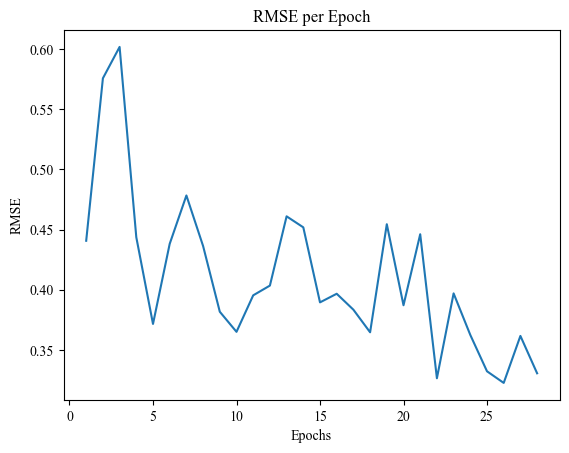

| 13        | -3.349    | 0.8514    | 23.63     | 0.462     | 28.9      | 245.0     | 121.1     | 97.32     |
Epoch 1/39, RMSE: 0.5218
Epoch 2/39, RMSE: 0.5250
Epoch 3/39, RMSE: 0.6338
Epoch 4/39, RMSE: 0.5265
Epoch 5/39, RMSE: 0.5262
Epoch 6/39, RMSE: 0.6042
Epoch 7/39, RMSE: 0.6438
Epoch 8/39, RMSE: 0.4691
Epoch 9/39, RMSE: 0.4243
Epoch 10/39, RMSE: 0.4465
Epoch 11/39, RMSE: 0.3266
Epoch 12/39, RMSE: 0.4058
Epoch 13/39, RMSE: 0.4220
Epoch 14/39, RMSE: 0.3789
Epoch 15/39, RMSE: 0.4022
Epoch 16/39, RMSE: 0.4202
Epoch 17/39, RMSE: 0.3170
Epoch 18/39, RMSE: 0.3081
Epoch 19/39, RMSE: 0.3063
Epoch 20/39, RMSE: 0.3128
Epoch 21/39, RMSE: 0.3246
Epoch 22/39, RMSE: 0.3191
Epoch 23/39, RMSE: 0.3659
Epoch 24/39, RMSE: 0.3565
Epoch 25/39, RMSE: 0.3637
Epoch 26/39, RMSE: 0.3744
Epoch 27/39, RMSE: 0.2391
Epoch 28/39, RMSE: 0.2931
Epoch 29/39, RMSE: 0.3264
Epoch 30/39, RMSE: 0.3134
Epoch 31/39, RMSE: 0.2333
Epoch 32/39, RMSE: 0.3234
Epoch 33/39, RMSE: 0.2292
Epoch 34/39, RMSE: 0.2302
Epoch 35/39, RM

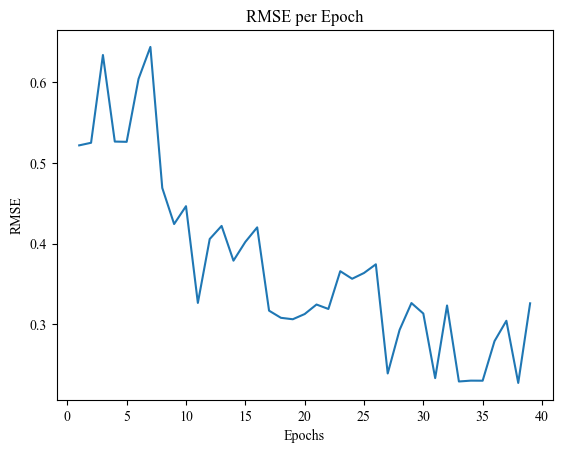

| 14        | -3.289    | 1.997     | 12.05     | 0.413     | 39.69     | 216.1     | 131.1     | 76.58     |
Epoch 1/19, RMSE: 0.3925
Epoch 2/19, RMSE: 0.5260
Epoch 3/19, RMSE: 0.4684
Epoch 4/19, RMSE: 0.3708
Epoch 5/19, RMSE: 0.3750
Epoch 6/19, RMSE: 0.3624
Epoch 7/19, RMSE: 0.3054
Epoch 8/19, RMSE: 0.2407
Epoch 9/19, RMSE: 0.2186
Epoch 10/19, RMSE: 0.2267
Epoch 11/19, RMSE: 0.4595
Epoch 12/19, RMSE: 0.2584
Epoch 13/19, RMSE: 0.1934
Epoch 14/19, RMSE: 0.1986
Epoch 15/19, RMSE: 0.2657
Epoch 16/19, RMSE: 0.2441
Epoch 17/19, RMSE: 0.2080
Epoch 18/19, RMSE: 0.1875
Epoch 19/19, RMSE: 0.1974


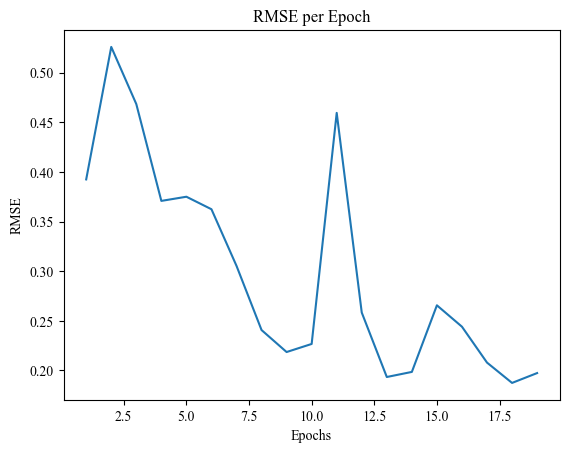

| 15        | -1.882    | 1.112     | 46.15     | 0.3647    | 19.22     | 249.5     | 140.1     | 34.66     |
Epoch 1/36, RMSE: 0.5694
Epoch 2/36, RMSE: 0.5956
Epoch 3/36, RMSE: 0.4634
Epoch 4/36, RMSE: 0.4725
Epoch 5/36, RMSE: 0.3263
Epoch 6/36, RMSE: 0.3622
Epoch 7/36, RMSE: 0.3929
Epoch 8/36, RMSE: 0.2961
Epoch 9/36, RMSE: 0.3977
Epoch 10/36, RMSE: 0.4371
Epoch 11/36, RMSE: 0.4307
Epoch 12/36, RMSE: 0.3392
Epoch 13/36, RMSE: 0.4156
Epoch 14/36, RMSE: 0.4249
Epoch 15/36, RMSE: 0.3531
Epoch 16/36, RMSE: 0.3298
Epoch 17/36, RMSE: 0.3302
Epoch 18/36, RMSE: 0.4472
Early stopping at epoch 18


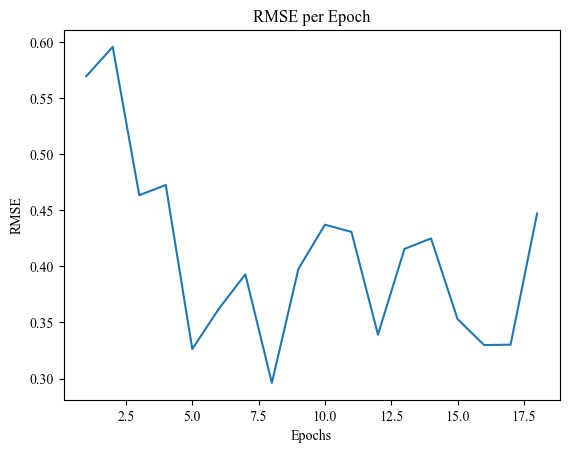

| 16        | -4.532    | 1.618     | 17.71     | 0.4403    | 36.04     | 191.3     | 73.83     | 72.2      |
Epoch 1/36, RMSE: 0.7168
Epoch 2/36, RMSE: 0.5666
Epoch 3/36, RMSE: 0.6300
Epoch 4/36, RMSE: 0.5477
Epoch 5/36, RMSE: 0.4250
Epoch 6/36, RMSE: 0.4681
Epoch 7/36, RMSE: 0.3928
Epoch 8/36, RMSE: 0.3534
Epoch 9/36, RMSE: 0.4472
Epoch 10/36, RMSE: 0.3770
Epoch 11/36, RMSE: 0.3473
Epoch 12/36, RMSE: 0.3460
Epoch 13/36, RMSE: 0.3196
Epoch 14/36, RMSE: 0.3322
Epoch 15/36, RMSE: 0.3315
Epoch 16/36, RMSE: 0.3343
Epoch 17/36, RMSE: 0.3836
Epoch 18/36, RMSE: 0.3141
Epoch 19/36, RMSE: 0.3582
Epoch 20/36, RMSE: 0.2798
Epoch 21/36, RMSE: 0.3624
Epoch 22/36, RMSE: 0.3720
Epoch 23/36, RMSE: 0.2594
Epoch 24/36, RMSE: 0.3290
Epoch 25/36, RMSE: 0.3114
Epoch 26/36, RMSE: 0.2977
Epoch 27/36, RMSE: 0.3000
Epoch 28/36, RMSE: 0.2914
Epoch 29/36, RMSE: 0.2917
Epoch 30/36, RMSE: 0.2911
Epoch 31/36, RMSE: 0.2667
Epoch 32/36, RMSE: 0.2217
Epoch 33/36, RMSE: 0.3211
Epoch 34/36, RMSE: 0.2903
Epoch 35/36, RM

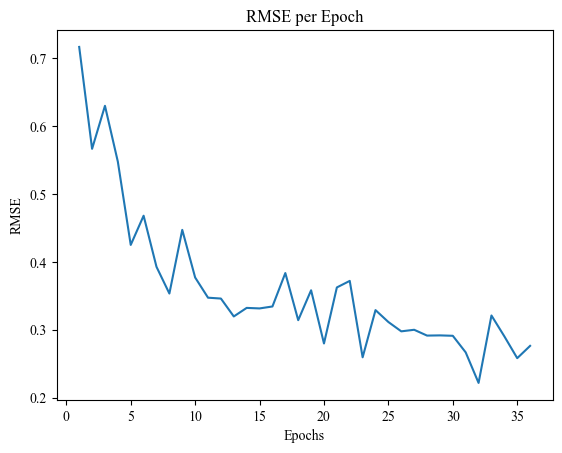

| 17        | -2.78     | 1.419     | 35.26     | 0.4207    | 36.96     | 226.2     | 105.4     | 124.2     |
Epoch 1/48, RMSE: 0.5244
Epoch 2/48, RMSE: 0.5500
Epoch 3/48, RMSE: 0.4162
Epoch 4/48, RMSE: 0.4617
Epoch 5/48, RMSE: 0.4216
Epoch 6/48, RMSE: 0.3076
Epoch 7/48, RMSE: 0.3098
Epoch 8/48, RMSE: 0.2687
Epoch 9/48, RMSE: 0.4058
Epoch 10/48, RMSE: 0.3447
Epoch 11/48, RMSE: 0.3850
Epoch 12/48, RMSE: 0.3264
Epoch 13/48, RMSE: 0.2896
Epoch 14/48, RMSE: 0.2110
Epoch 15/48, RMSE: 0.2549
Epoch 16/48, RMSE: 0.2142
Epoch 17/48, RMSE: 0.2515
Epoch 18/48, RMSE: 0.2494
Epoch 19/48, RMSE: 0.3113
Epoch 20/48, RMSE: 0.2838
Epoch 21/48, RMSE: 0.1791
Epoch 22/48, RMSE: 0.2147
Epoch 23/48, RMSE: 0.2439
Epoch 24/48, RMSE: 0.2284
Epoch 25/48, RMSE: 0.2251
Epoch 26/48, RMSE: 0.2929
Epoch 27/48, RMSE: 0.2590
Epoch 28/48, RMSE: 0.2340
Epoch 29/48, RMSE: 0.1928
Epoch 30/48, RMSE: 0.2153
Epoch 31/48, RMSE: 0.2173
Early stopping at epoch 31


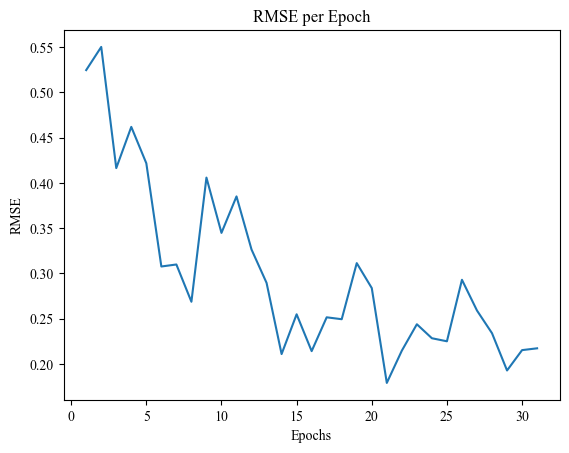

| 18        | -2.15     | 0.2382    | 48.01     | 0.4874    | 48.13     | 241.6     | 109.4     | 72.46     |
Epoch 1/27, RMSE: 0.5354
Epoch 2/27, RMSE: 0.4726
Epoch 3/27, RMSE: 0.5019
Epoch 4/27, RMSE: 0.4588
Epoch 5/27, RMSE: 0.3795
Epoch 6/27, RMSE: 0.4345
Epoch 7/27, RMSE: 0.3726
Epoch 8/27, RMSE: 0.3241
Epoch 9/27, RMSE: 0.3798
Epoch 10/27, RMSE: 0.3618
Epoch 11/27, RMSE: 0.3477
Epoch 12/27, RMSE: 0.3288
Epoch 13/27, RMSE: 0.2671
Epoch 14/27, RMSE: 0.2757
Epoch 15/27, RMSE: 0.2879
Epoch 16/27, RMSE: 0.2475
Epoch 17/27, RMSE: 0.3190
Epoch 18/27, RMSE: 0.3242
Epoch 19/27, RMSE: 0.2616
Epoch 20/27, RMSE: 0.3102
Epoch 21/27, RMSE: 0.2532
Epoch 22/27, RMSE: 0.3408
Epoch 23/27, RMSE: 0.2447
Epoch 24/27, RMSE: 0.2597
Epoch 25/27, RMSE: 0.2740
Epoch 26/27, RMSE: 0.2905
Epoch 27/27, RMSE: 0.2633


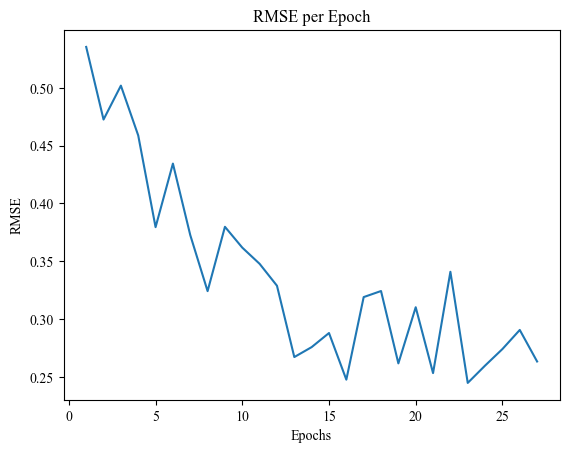

| 19        | -2.668    | 1.953     | 38.0      | 0.4612    | 27.79     | 142.3     | 110.2     | 49.19     |
Epoch 1/49, RMSE: 0.3597
Epoch 2/49, RMSE: 0.3914
Epoch 3/49, RMSE: 0.3464
Epoch 4/49, RMSE: 0.3883
Epoch 5/49, RMSE: 0.4011
Epoch 6/49, RMSE: 0.3978
Epoch 7/49, RMSE: 0.3322
Epoch 8/49, RMSE: 0.2789
Epoch 9/49, RMSE: 0.2811
Epoch 10/49, RMSE: 0.2623
Epoch 11/49, RMSE: 0.3295
Epoch 12/49, RMSE: 0.3892
Epoch 13/49, RMSE: 0.4414
Epoch 14/49, RMSE: 0.3489
Epoch 15/49, RMSE: 0.3563
Epoch 16/49, RMSE: 0.3559
Epoch 17/49, RMSE: 0.4549
Epoch 18/49, RMSE: 0.3276
Epoch 19/49, RMSE: 0.3182
Epoch 20/49, RMSE: 0.3155
Early stopping at epoch 20


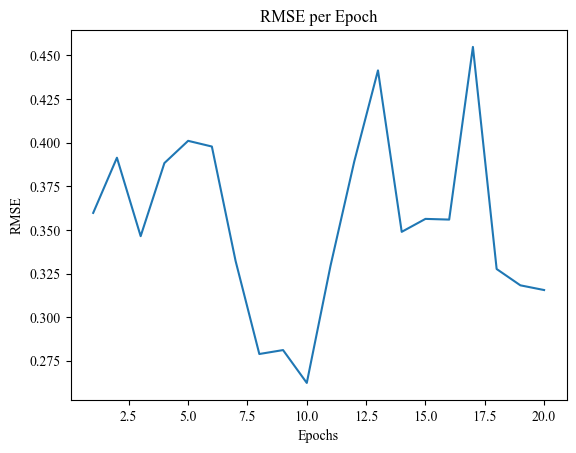

| 20        | -3.165    | 0.8566    | 23.09     | 0.307     | 49.26     | 67.23     | 235.0     | 81.87     |
Epoch 1/33, RMSE: 0.3333
Epoch 2/33, RMSE: 0.3891
Epoch 3/33, RMSE: 0.3552
Epoch 4/33, RMSE: 0.3378
Epoch 5/33, RMSE: 0.2744
Epoch 6/33, RMSE: 0.2678
Epoch 7/33, RMSE: 0.2512
Epoch 8/33, RMSE: 0.3808
Epoch 9/33, RMSE: 0.3549
Epoch 10/33, RMSE: 0.3526
Epoch 11/33, RMSE: 0.4103
Epoch 12/33, RMSE: 0.4629
Epoch 13/33, RMSE: 0.3380
Epoch 14/33, RMSE: 0.3498
Epoch 15/33, RMSE: 0.3069
Epoch 16/33, RMSE: 0.3135
Epoch 17/33, RMSE: 0.3295
Early stopping at epoch 17


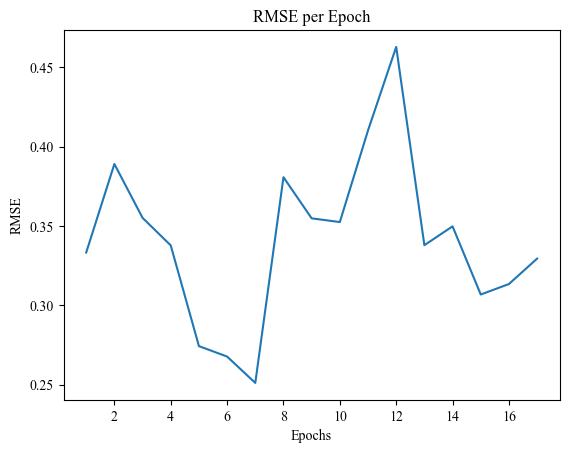

| 21        | -3.327    | 0.01295   | 29.32     | 0.2163    | 33.45     | 162.1     | 94.66     | 124.8     |
Epoch 1/11, RMSE: 0.6796
Epoch 2/11, RMSE: 0.6416
Epoch 3/11, RMSE: 0.6039
Epoch 4/11, RMSE: 0.6140
Epoch 5/11, RMSE: 0.3681
Epoch 6/11, RMSE: 0.3381
Epoch 7/11, RMSE: 0.2890
Epoch 8/11, RMSE: 0.3613
Epoch 9/11, RMSE: 0.2533
Epoch 10/11, RMSE: 0.3839
Epoch 11/11, RMSE: 0.2373


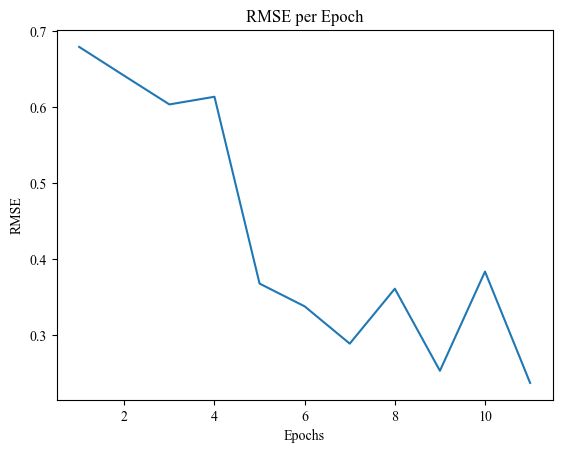

| 22        | -2.292    | 1.555     | 38.57     | 0.3394    | 11.04     | 148.9     | 173.3     | 96.87     |
Epoch 1/28, RMSE: 0.4845
Epoch 2/28, RMSE: 0.4344
Epoch 3/28, RMSE: 0.4272
Epoch 4/28, RMSE: 0.3298
Epoch 5/28, RMSE: 0.3527
Epoch 6/28, RMSE: 0.3465
Epoch 7/28, RMSE: 0.3700
Epoch 8/28, RMSE: 0.2850
Epoch 9/28, RMSE: 0.2541
Epoch 10/28, RMSE: 0.3597
Epoch 11/28, RMSE: 0.2304
Epoch 12/28, RMSE: 0.2482
Epoch 13/28, RMSE: 0.2530
Epoch 14/28, RMSE: 0.2463
Epoch 15/28, RMSE: 0.3877
Epoch 16/28, RMSE: 0.2859
Epoch 17/28, RMSE: 0.2282
Epoch 18/28, RMSE: 0.2650
Epoch 19/28, RMSE: 0.2370
Epoch 20/28, RMSE: 0.2625
Epoch 21/28, RMSE: 0.2447
Epoch 22/28, RMSE: 0.1952
Epoch 23/28, RMSE: 0.2291
Epoch 24/28, RMSE: 0.2048
Epoch 25/28, RMSE: 0.1872
Epoch 26/28, RMSE: 0.2145
Epoch 27/28, RMSE: 0.2069
Epoch 28/28, RMSE: 0.2515


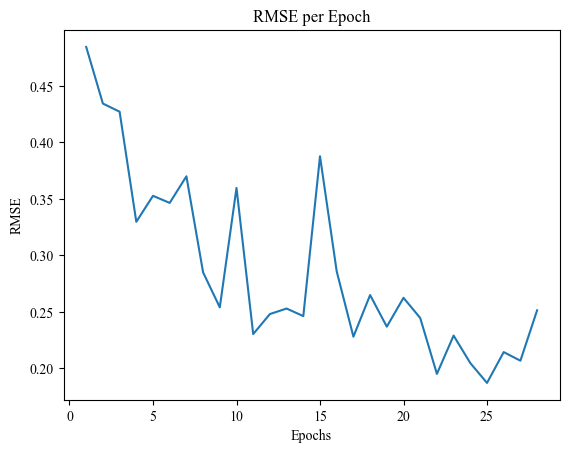

| 23        | -2.494    | 0.6746    | 48.63     | 0.1378    | 28.86     | 250.8     | 175.9     | 107.1     |
Epoch 1/48, RMSE: 0.3996
Epoch 2/48, RMSE: 0.5069
Epoch 3/48, RMSE: 0.3820
Epoch 4/48, RMSE: 0.3951
Epoch 5/48, RMSE: 0.3917
Epoch 6/48, RMSE: 0.3414
Epoch 7/48, RMSE: 0.3084
Epoch 8/48, RMSE: 0.2802
Epoch 9/48, RMSE: 0.3517
Epoch 10/48, RMSE: 0.2249
Epoch 11/48, RMSE: 0.2219
Epoch 12/48, RMSE: 0.2709
Epoch 13/48, RMSE: 0.2548
Epoch 14/48, RMSE: 0.4127
Epoch 15/48, RMSE: 0.2628
Epoch 16/48, RMSE: 0.2310
Epoch 17/48, RMSE: 0.2010
Epoch 18/48, RMSE: 0.2157
Epoch 19/48, RMSE: 0.2542
Epoch 20/48, RMSE: 0.1998
Epoch 21/48, RMSE: 0.2821
Epoch 22/48, RMSE: 0.2362
Epoch 23/48, RMSE: 0.2602
Epoch 24/48, RMSE: 0.2249
Epoch 25/48, RMSE: 0.2030
Epoch 26/48, RMSE: 0.2260
Epoch 27/48, RMSE: 0.2266
Epoch 28/48, RMSE: 0.2121
Epoch 29/48, RMSE: 0.1904
Epoch 30/48, RMSE: 0.2458
Epoch 31/48, RMSE: 0.2008
Epoch 32/48, RMSE: 0.2361
Epoch 33/48, RMSE: 0.2201
Epoch 34/48, RMSE: 0.2050
Epoch 35/48, RM

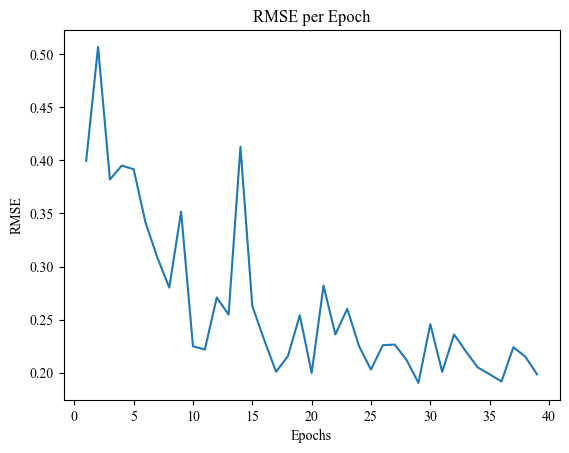

| 24        | -2.07     | 0.9884    | 42.29     | 0.3201    | 48.11     | 154.5     | 244.6     | 62.21     |
Epoch 1/36, RMSE: 0.3916
Epoch 2/36, RMSE: 0.4281
Epoch 3/36, RMSE: 0.3926
Epoch 4/36, RMSE: 0.2710
Epoch 5/36, RMSE: 0.3071
Epoch 6/36, RMSE: 0.2221
Epoch 7/36, RMSE: 0.2666
Epoch 8/36, RMSE: 0.2194
Epoch 9/36, RMSE: 0.2391
Epoch 10/36, RMSE: 0.2682
Epoch 11/36, RMSE: 0.3419
Epoch 12/36, RMSE: 0.3528
Epoch 13/36, RMSE: 0.3789
Epoch 14/36, RMSE: 0.3792
Epoch 15/36, RMSE: 0.3270
Epoch 16/36, RMSE: 0.3728
Epoch 17/36, RMSE: 0.3761
Epoch 18/36, RMSE: 0.3566
Early stopping at epoch 18


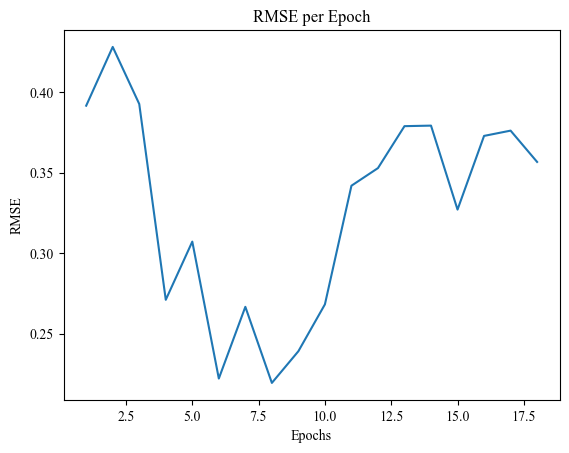

| 25        | -3.663    | 1.493     | 23.54     | 0.2813    | 36.24     | 184.2     | 103.4     | 103.8     |
Epoch 1/37, RMSE: 0.3503
Epoch 2/37, RMSE: 0.4369
Epoch 3/37, RMSE: 0.3609
Epoch 4/37, RMSE: 0.6185
Epoch 5/37, RMSE: 0.2879
Epoch 6/37, RMSE: 0.5043
Epoch 7/37, RMSE: 0.2884
Epoch 8/37, RMSE: 0.2711
Epoch 9/37, RMSE: 0.3347
Epoch 10/37, RMSE: 0.2481
Epoch 11/37, RMSE: 0.2486
Epoch 12/37, RMSE: 0.2197
Epoch 13/37, RMSE: 0.2266
Epoch 14/37, RMSE: 0.2188
Epoch 15/37, RMSE: 0.2257
Epoch 16/37, RMSE: 0.2148
Epoch 17/37, RMSE: 0.2241
Epoch 18/37, RMSE: 0.2108
Epoch 19/37, RMSE: 0.1980
Epoch 20/37, RMSE: 0.2191
Epoch 21/37, RMSE: 0.1942
Epoch 22/37, RMSE: 0.2619
Epoch 23/37, RMSE: 0.2062
Epoch 24/37, RMSE: 0.2019
Epoch 25/37, RMSE: 0.1961
Epoch 26/37, RMSE: 0.2066
Epoch 27/37, RMSE: 0.2213
Epoch 28/37, RMSE: 0.2102
Epoch 29/37, RMSE: 0.2218
Epoch 30/37, RMSE: 0.2120
Epoch 31/37, RMSE: 0.2356
Early stopping at epoch 31


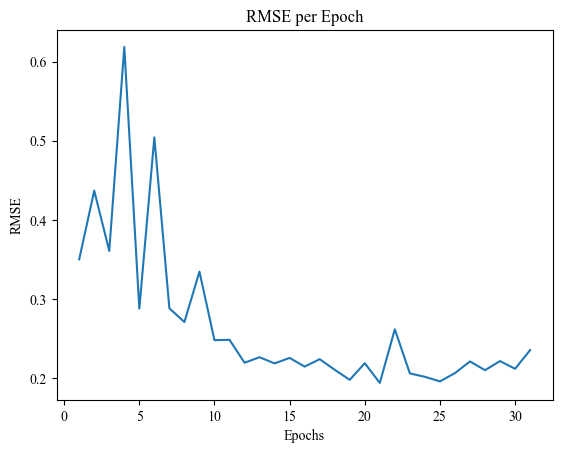

| 26        | -2.403    | 1.877     | 41.63     | 0.2017    | 37.8      | 106.4     | 188.5     | 102.7     |
Epoch 1/20, RMSE: 0.2807
Epoch 2/20, RMSE: 0.2649
Epoch 3/20, RMSE: 0.4209
Epoch 4/20, RMSE: 0.4574
Epoch 5/20, RMSE: 0.4541
Epoch 6/20, RMSE: 0.4104
Epoch 7/20, RMSE: 0.3428
Epoch 8/20, RMSE: 0.3405
Epoch 9/20, RMSE: 0.3631
Epoch 10/20, RMSE: 0.3101
Epoch 11/20, RMSE: 0.3226
Epoch 12/20, RMSE: 0.3960
Early stopping at epoch 12


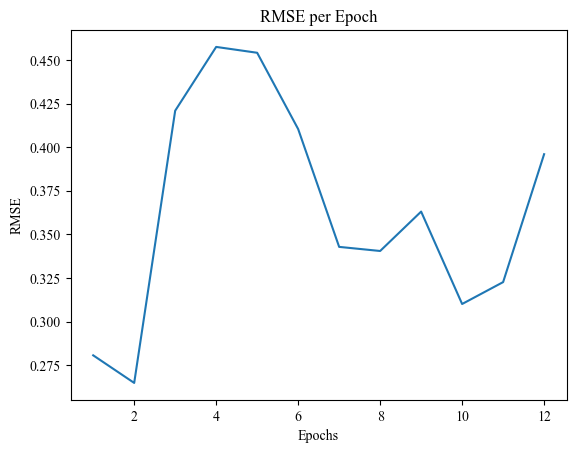

| 27        | -3.947    | 1.346     | 29.87     | 0.3214    | 20.78     | 144.8     | 111.0     | 127.2     |
Epoch 1/28, RMSE: 0.4834
Epoch 2/28, RMSE: 0.4717
Epoch 3/28, RMSE: 0.5595
Epoch 4/28, RMSE: 0.3782
Epoch 5/28, RMSE: 0.3326
Epoch 6/28, RMSE: 0.3601
Epoch 7/28, RMSE: 0.3160
Epoch 8/28, RMSE: 0.2853
Epoch 9/28, RMSE: 0.2566
Epoch 10/28, RMSE: 0.2517
Epoch 11/28, RMSE: 0.2409
Epoch 12/28, RMSE: 0.2670
Epoch 13/28, RMSE: 0.3838
Epoch 14/28, RMSE: 0.2795
Epoch 15/28, RMSE: 0.2244
Epoch 16/28, RMSE: 0.2310
Epoch 17/28, RMSE: 0.2070
Epoch 18/28, RMSE: 0.2130
Epoch 19/28, RMSE: 0.2233
Epoch 20/28, RMSE: 0.1988
Epoch 21/28, RMSE: 0.2467
Epoch 22/28, RMSE: 0.2097
Epoch 23/28, RMSE: 0.2062
Epoch 24/28, RMSE: 0.2202
Epoch 25/28, RMSE: 0.2276
Epoch 26/28, RMSE: 0.2396
Epoch 27/28, RMSE: 0.2387
Epoch 28/28, RMSE: 0.2393


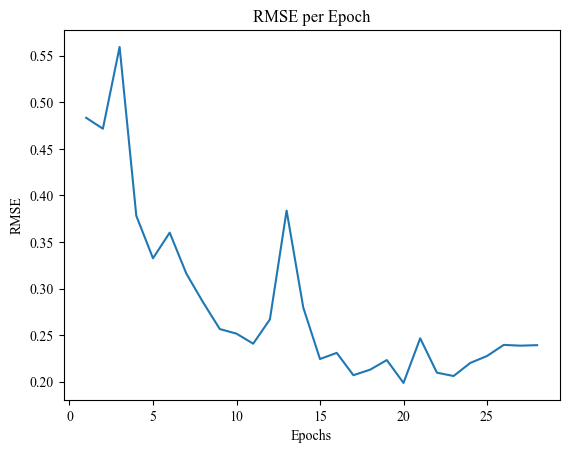

| 28        | -2.407    | 1.064     | 39.84     | 0.3058    | 28.08     | 172.5     | 142.1     | 33.04     |
Epoch 1/21, RMSE: 0.1580
Epoch 2/21, RMSE: 0.3539
Epoch 3/21, RMSE: 0.2840
Epoch 4/21, RMSE: 0.5728
Epoch 5/21, RMSE: 0.3866
Epoch 6/21, RMSE: 0.3482
Epoch 7/21, RMSE: 0.3108
Epoch 8/21, RMSE: 0.2799
Epoch 9/21, RMSE: 0.4368
Epoch 10/21, RMSE: 0.3731
Epoch 11/21, RMSE: 0.2546
Early stopping at epoch 11


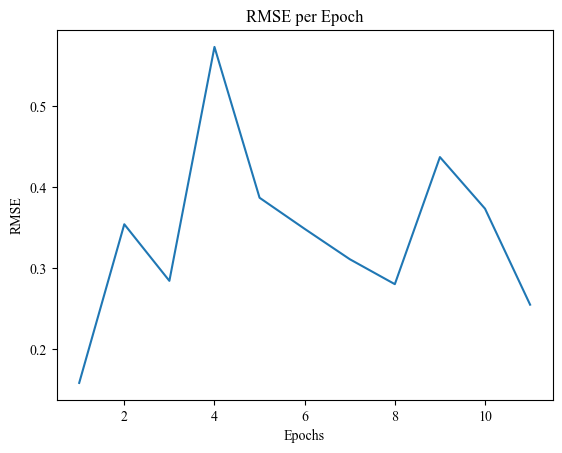

| 29        | -2.423    | 1.676     | 33.71     | 0.2496    | 21.14     | 253.3     | 144.2     | 104.4     |
Epoch 1/34, RMSE: 0.3709
Epoch 2/34, RMSE: 0.4989
Epoch 3/34, RMSE: 0.5154
Epoch 4/34, RMSE: 0.4319
Epoch 5/34, RMSE: 0.4359
Epoch 6/34, RMSE: 0.3578
Epoch 7/34, RMSE: 0.3037
Epoch 8/34, RMSE: 0.2774
Epoch 9/34, RMSE: 0.2903
Epoch 10/34, RMSE: 0.2499
Epoch 11/34, RMSE: 0.2986
Epoch 12/34, RMSE: 0.2724
Epoch 13/34, RMSE: 0.3003
Epoch 14/34, RMSE: 0.3267
Epoch 15/34, RMSE: 0.2867
Epoch 16/34, RMSE: 0.2548
Epoch 17/34, RMSE: 0.2433
Epoch 18/34, RMSE: 0.2856
Epoch 19/34, RMSE: 0.2565
Epoch 20/34, RMSE: 0.2355
Epoch 21/34, RMSE: 0.2556
Epoch 22/34, RMSE: 0.2932
Epoch 23/34, RMSE: 0.2729
Epoch 24/34, RMSE: 0.2345
Epoch 25/34, RMSE: 0.2492
Epoch 26/34, RMSE: 0.2233
Epoch 27/34, RMSE: 0.2750
Epoch 28/34, RMSE: 0.2244
Epoch 29/34, RMSE: 0.2422
Epoch 30/34, RMSE: 0.2529
Epoch 31/34, RMSE: 0.2389
Epoch 32/34, RMSE: 0.2548
Epoch 33/34, RMSE: 0.2408
Epoch 34/34, RMSE: 0.2374


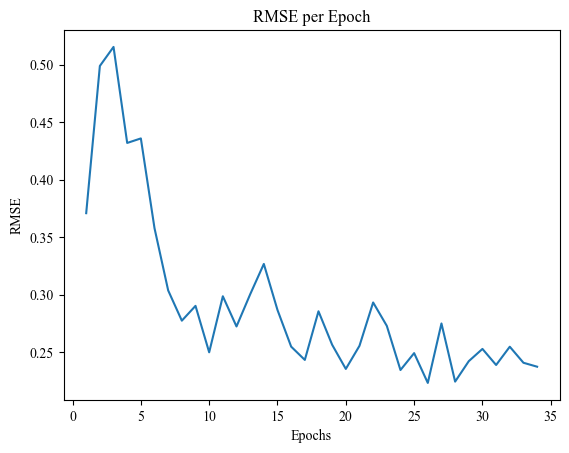

| 30        | -2.356    | 0.6581    | 38.94     | 0.2372    | 34.37     | 206.5     | 68.4      | 50.93     |
Epoch 1/31, RMSE: 0.6354
Epoch 2/31, RMSE: 0.5127
Epoch 3/31, RMSE: 0.5617
Epoch 4/31, RMSE: 0.5155
Epoch 5/31, RMSE: 0.4555
Epoch 6/31, RMSE: 0.3919
Epoch 7/31, RMSE: 0.3301
Epoch 8/31, RMSE: 0.4194
Epoch 9/31, RMSE: 0.3475
Epoch 10/31, RMSE: 0.3260
Epoch 11/31, RMSE: 0.3246
Epoch 12/31, RMSE: 0.2864
Epoch 13/31, RMSE: 0.3080
Epoch 14/31, RMSE: 0.3218
Epoch 15/31, RMSE: 0.3184
Epoch 16/31, RMSE: 0.3882
Epoch 17/31, RMSE: 0.3507
Epoch 18/31, RMSE: 0.3194
Epoch 19/31, RMSE: 0.3080
Epoch 20/31, RMSE: 0.3355
Epoch 21/31, RMSE: 0.2498
Epoch 22/31, RMSE: 0.2549
Epoch 23/31, RMSE: 0.2832
Epoch 24/31, RMSE: 0.2506
Epoch 25/31, RMSE: 0.2602
Epoch 26/31, RMSE: 0.2295
Epoch 27/31, RMSE: 0.2430
Epoch 28/31, RMSE: 0.2331
Epoch 29/31, RMSE: 0.2496
Epoch 30/31, RMSE: 0.2548
Epoch 31/31, RMSE: 0.2211


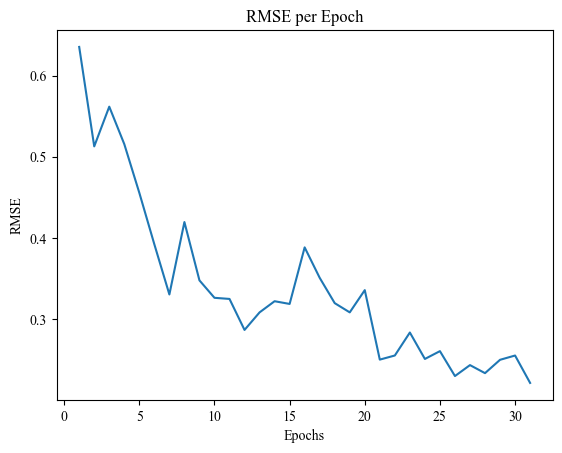

| 31        | -2.232    | 0.8071    | 36.67     | 0.4988    | 31.79     | 102.8     | 215.0     | 62.49     |
Epoch 1/24, RMSE: 0.3362
Epoch 2/24, RMSE: 0.3828
Epoch 3/24, RMSE: 0.4535
Epoch 4/24, RMSE: 0.3322
Epoch 5/24, RMSE: 0.2610
Epoch 6/24, RMSE: 0.2924
Epoch 7/24, RMSE: 0.2219
Epoch 8/24, RMSE: 0.2461
Epoch 9/24, RMSE: 0.2326
Epoch 10/24, RMSE: 0.3549
Epoch 11/24, RMSE: 0.5095
Epoch 12/24, RMSE: 0.4425
Epoch 13/24, RMSE: 0.3999
Epoch 14/24, RMSE: 0.4299
Epoch 15/24, RMSE: 0.3595
Epoch 16/24, RMSE: 0.3685
Epoch 17/24, RMSE: 0.3762
Early stopping at epoch 17


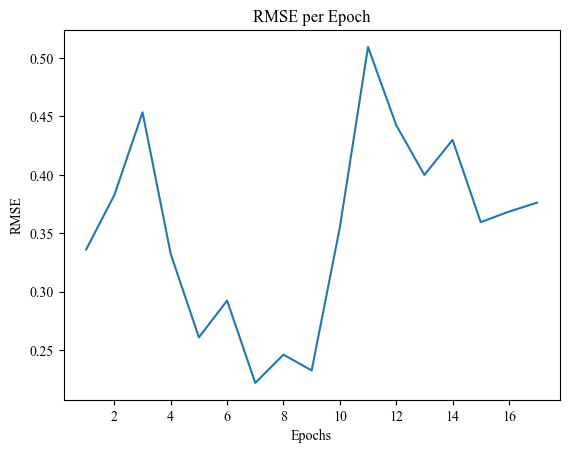

| 32        | -3.781    | 1.185     | 18.74     | 0.2365    | 24.72     | 149.4     | 255.2     | 87.54     |
Epoch 1/12, RMSE: 0.4474
Epoch 2/12, RMSE: 0.5546
Epoch 3/12, RMSE: 0.3538
Epoch 4/12, RMSE: 0.3213
Epoch 5/12, RMSE: 0.3282
Epoch 6/12, RMSE: 0.4220
Epoch 7/12, RMSE: 0.3287
Epoch 8/12, RMSE: 0.2510
Epoch 9/12, RMSE: 0.4080
Epoch 10/12, RMSE: 0.3660
Epoch 11/12, RMSE: 0.1866
Epoch 12/12, RMSE: 0.2065


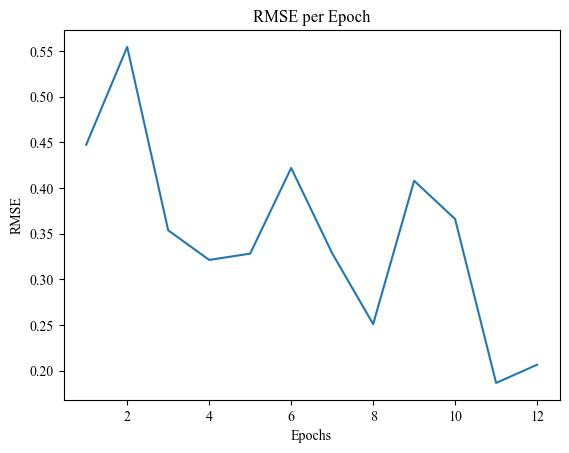

| 33        | -1.931    | 0.1255    | 49.38     | 0.1923    | 12.93     | 254.3     | 232.5     | 117.0     |
Epoch 1/10, RMSE: 0.3094
Epoch 2/10, RMSE: 0.3948
Epoch 3/10, RMSE: 0.4868
Epoch 4/10, RMSE: 0.5333
Epoch 5/10, RMSE: 0.5043
Epoch 6/10, RMSE: 0.4329
Epoch 7/10, RMSE: 0.3822
Epoch 8/10, RMSE: 0.3856
Epoch 9/10, RMSE: 0.3372
Epoch 10/10, RMSE: 0.3168


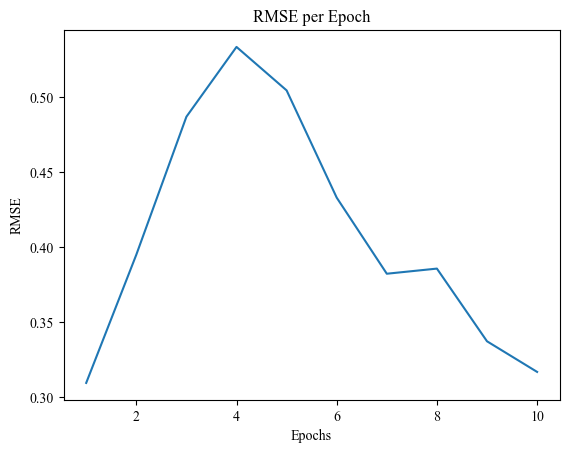

| 34        | -3.096    | 1.152     | 31.05     | 0.2923    | 10.46     | 157.0     | 160.7     | 34.85     |
Epoch 1/16, RMSE: 0.4505
Epoch 2/16, RMSE: 0.3947
Epoch 3/16, RMSE: 0.3401
Epoch 4/16, RMSE: 0.4116
Epoch 5/16, RMSE: 0.2797
Epoch 6/16, RMSE: 0.2655
Epoch 7/16, RMSE: 0.2921
Epoch 8/16, RMSE: 0.2548
Epoch 9/16, RMSE: 0.3288
Epoch 10/16, RMSE: 0.2420
Epoch 11/16, RMSE: 0.3654
Epoch 12/16, RMSE: 0.2914
Epoch 13/16, RMSE: 0.2771
Epoch 14/16, RMSE: 0.2394
Epoch 15/16, RMSE: 0.2777
Epoch 16/16, RMSE: 0.2352


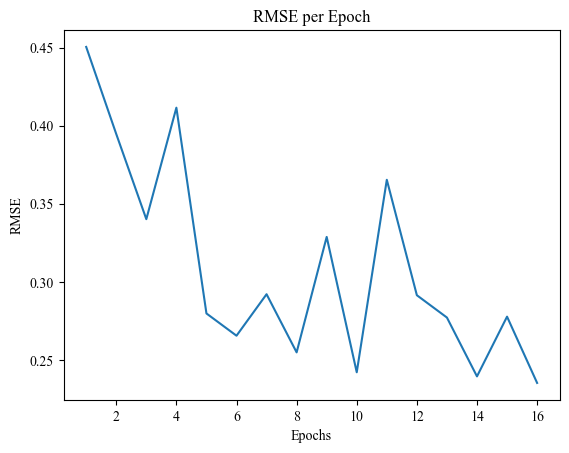

| 35        | -2.272    | 1.611     | 49.58     | 0.1759    | 16.23     | 123.9     | 142.3     | 70.46     |
Epoch 1/44, RMSE: 0.4912
Epoch 2/44, RMSE: 0.5616
Epoch 3/44, RMSE: 0.5803
Epoch 4/44, RMSE: 0.5157
Epoch 5/44, RMSE: 0.4735
Epoch 6/44, RMSE: 0.4303
Epoch 7/44, RMSE: 0.4261
Epoch 8/44, RMSE: 0.4204
Epoch 9/44, RMSE: 0.3779
Epoch 10/44, RMSE: 0.4074
Epoch 11/44, RMSE: 0.3624
Epoch 12/44, RMSE: 0.3471
Epoch 13/44, RMSE: 0.3226
Epoch 14/44, RMSE: 0.3184
Epoch 15/44, RMSE: 0.2966
Epoch 16/44, RMSE: 0.2936
Epoch 17/44, RMSE: 0.3045
Epoch 18/44, RMSE: 0.2982
Epoch 19/44, RMSE: 0.2939
Epoch 20/44, RMSE: 0.2677
Epoch 21/44, RMSE: 0.2860
Epoch 22/44, RMSE: 0.2772
Epoch 23/44, RMSE: 0.2592
Epoch 24/44, RMSE: 0.2812
Epoch 25/44, RMSE: 0.2830
Epoch 26/44, RMSE: 0.2209
Epoch 27/44, RMSE: 0.2587
Epoch 28/44, RMSE: 0.2583
Epoch 29/44, RMSE: 0.2610
Epoch 30/44, RMSE: 0.2876
Epoch 31/44, RMSE: 0.2970
Epoch 32/44, RMSE: 0.2377
Epoch 33/44, RMSE: 0.2103
Epoch 34/44, RMSE: 0.2811
Epoch 35/44, RM

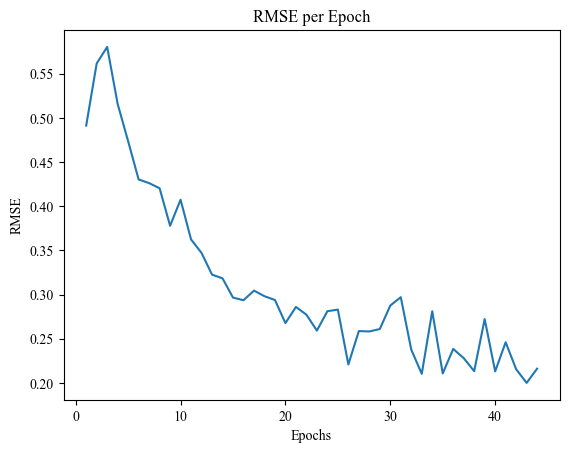

| 36        | -2.257    | 1.868     | 37.54     | 0.3662    | 44.25     | 126.8     | 64.34     | 94.14     |
Epoch 1/28, RMSE: 0.3873
Epoch 2/28, RMSE: 0.4021
Epoch 3/28, RMSE: 0.3387
Epoch 4/28, RMSE: 0.3271
Epoch 5/28, RMSE: 0.2691
Epoch 6/28, RMSE: 0.3166
Epoch 7/28, RMSE: 0.3294
Epoch 8/28, RMSE: 0.3809
Epoch 9/28, RMSE: 0.3224
Epoch 10/28, RMSE: 0.3911
Epoch 11/28, RMSE: 0.4136
Epoch 12/28, RMSE: 0.3823
Epoch 13/28, RMSE: 0.3989
Epoch 14/28, RMSE: 0.3361
Epoch 15/28, RMSE: 0.3582
Early stopping at epoch 15


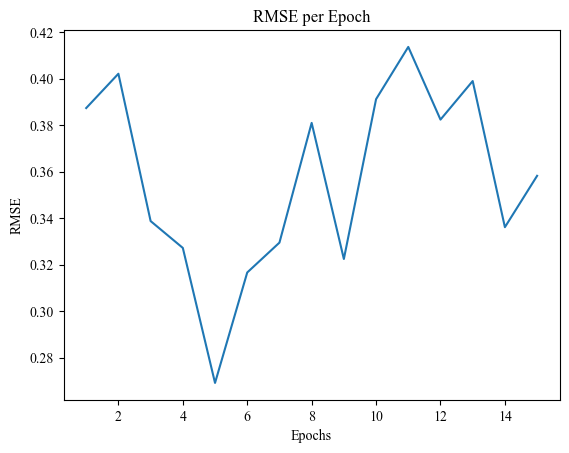

| 37        | -3.537    | 0.4472    | 26.64     | 0.3744    | 28.88     | 167.4     | 100.3     | 107.6     |
Epoch 1/20, RMSE: 0.5054
Epoch 2/20, RMSE: 0.5115
Epoch 3/20, RMSE: 0.4186
Epoch 4/20, RMSE: 0.4509
Epoch 5/20, RMSE: 0.4449
Epoch 6/20, RMSE: 0.4128
Epoch 7/20, RMSE: 0.2840
Epoch 8/20, RMSE: 0.2513
Epoch 9/20, RMSE: 0.3254
Epoch 10/20, RMSE: 0.2328
Epoch 11/20, RMSE: 0.2745
Epoch 12/20, RMSE: 0.2315
Epoch 13/20, RMSE: 0.1964
Epoch 14/20, RMSE: 0.2223
Epoch 15/20, RMSE: 0.2376
Epoch 16/20, RMSE: 0.2931
Epoch 17/20, RMSE: 0.3117
Epoch 18/20, RMSE: 0.2300
Epoch 19/20, RMSE: 0.2322
Epoch 20/20, RMSE: 0.1819


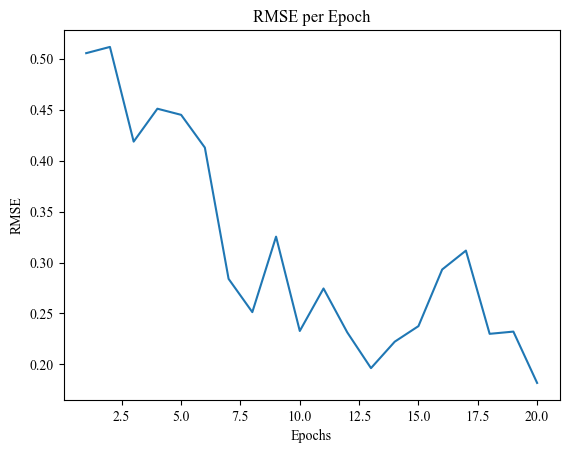

| 38        | -1.759    | 1.056     | 42.5      | 0.4639    | 20.03     | 209.8     | 235.3     | 48.04     |
Epoch 1/39, RMSE: 0.5492
Epoch 2/39, RMSE: 0.4393
Epoch 3/39, RMSE: 0.3216
Epoch 4/39, RMSE: 0.3772
Epoch 5/39, RMSE: 0.4693
Epoch 6/39, RMSE: 0.3543
Epoch 7/39, RMSE: 0.3010
Epoch 8/39, RMSE: 0.2756
Epoch 9/39, RMSE: 0.2663
Epoch 10/39, RMSE: 0.2429
Epoch 11/39, RMSE: 0.2775
Epoch 12/39, RMSE: 0.2483
Epoch 13/39, RMSE: 0.2517
Epoch 14/39, RMSE: 0.2571
Epoch 15/39, RMSE: 0.2354
Epoch 16/39, RMSE: 0.2709
Epoch 17/39, RMSE: 0.2822
Epoch 18/39, RMSE: 0.2415
Epoch 19/39, RMSE: 0.2608
Epoch 20/39, RMSE: 0.2726
Epoch 21/39, RMSE: 0.2389
Epoch 22/39, RMSE: 0.2533
Epoch 23/39, RMSE: 0.3178
Epoch 24/39, RMSE: 0.2266
Epoch 25/39, RMSE: 0.2343
Epoch 26/39, RMSE: 0.2545
Epoch 27/39, RMSE: 0.2304
Epoch 28/39, RMSE: 0.2185
Epoch 29/39, RMSE: 0.2598
Epoch 30/39, RMSE: 0.2572
Epoch 31/39, RMSE: 0.2199
Epoch 32/39, RMSE: 0.2170
Epoch 33/39, RMSE: 0.2493
Epoch 34/39, RMSE: 0.2198
Epoch 35/39, RM

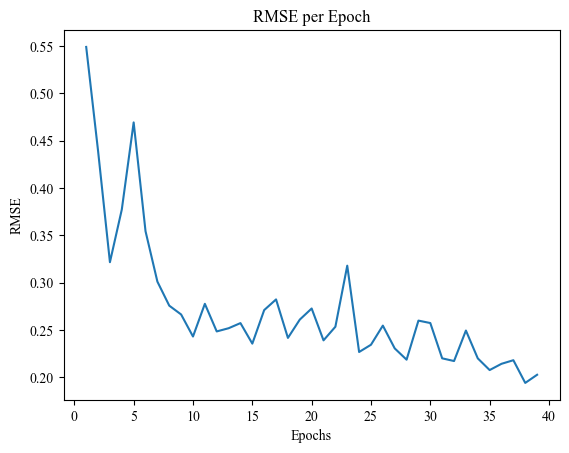

| 39        | -2.073    | 0.9641    | 49.18     | 0.3962    | 39.56     | 243.1     | 155.8     | 112.6     |
Epoch 1/28, RMSE: 0.2350
Epoch 2/28, RMSE: 0.5314
Epoch 3/28, RMSE: 0.5766
Epoch 4/28, RMSE: 0.4550
Epoch 5/28, RMSE: 0.4289
Epoch 6/28, RMSE: 0.4071
Epoch 7/28, RMSE: 0.3557
Epoch 8/28, RMSE: 0.5052
Epoch 9/28, RMSE: 0.3177
Epoch 10/28, RMSE: 0.3250
Epoch 11/28, RMSE: 0.3094
Early stopping at epoch 11


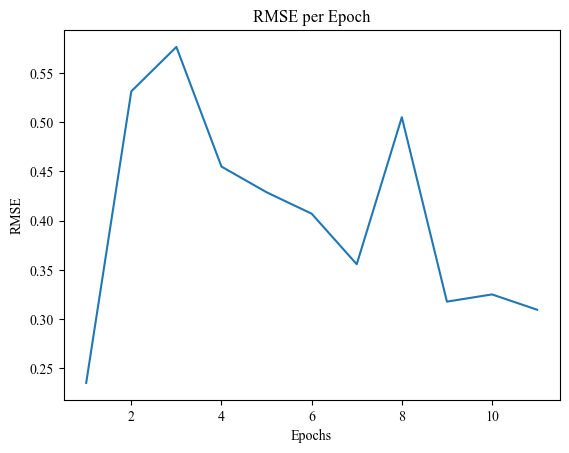

| 40        | -3.022    | 1.326     | 35.72     | 0.4697    | 28.14     | 190.1     | 144.5     | 113.3     |
Mejores hiperparámetros: Epochs=20, Batch size=42, Dropout=0.4639233898230902, Hidden Dims=[209, 235, 48], Activation=ReLU()
Epoch 1/20, RMSE: 0.4571
Epoch 2/20, RMSE: 0.4571
Epoch 3/20, RMSE: 0.3928
Epoch 4/20, RMSE: 0.5969
Epoch 5/20, RMSE: 0.4938
Epoch 6/20, RMSE: 0.4344
Epoch 7/20, RMSE: 0.3480
Epoch 8/20, RMSE: 0.4327
Epoch 9/20, RMSE: 0.2650
Epoch 10/20, RMSE: 0.2198
Epoch 11/20, RMSE: 0.2373
Epoch 12/20, RMSE: 0.2440
Epoch 13/20, RMSE: 0.3040
Epoch 14/20, RMSE: 0.2668
Epoch 15/20, RMSE: 0.2602
Epoch 16/20, RMSE: 0.2972
Epoch 17/20, RMSE: 0.2706
Epoch 18/20, RMSE: 0.2557
Epoch 19/20, RMSE: 0.2749
Epoch 20/20, RMSE: 0.2345
Early stopping at epoch 20


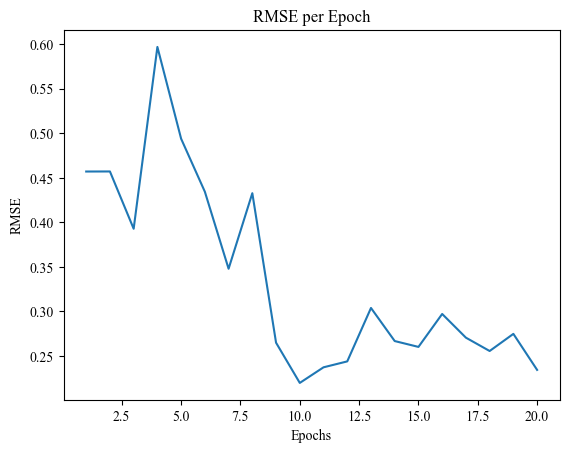

In [385]:
# Definir la clase del modelo ANN con más capas y Dropout
class ANNModel(nn.Module):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU()):
        super(ANNModel, self).__init__()
        self.hidden_layers = nn.ModuleList()
        self.dropout = nn.Dropout(dropout_prob)
        self.activation_fn = activation_fn
        
        # Primera capa
        self.hidden_layers.append(nn.Linear(input_dim, hidden_dims[0]))
        
        # Capas ocultas intermedias
        for i in range(1, len(hidden_dims)):
            self.hidden_layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i]))
        
        # Capa de salida
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x):
        for layer in self.hidden_layers:
            x = self.activation_fn(layer(x))
            x = self.dropout(x)
        x = self.output_layer(x)
        return x

# Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
class SklearnWrapper(BaseEstimator, RegressorMixin):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU(), 
                 epochs=100, batch_size=32, learning_rate=0.001):
        self.input_dim = input_dim
        self.hidden_dims = hidden_dims
        self.dropout_prob = dropout_prob
        self.activation_fn = activation_fn
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.model = ANNModel(input_dim, hidden_dims, dropout_prob, activation_fn)
        self.criterion = nn.MSELoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
        self.scheduler = optim.lr_scheduler.StepLR(self.optimizer, step_size=50, gamma=0.1)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.scaler_X = StandardScaler()
        self.scaler_y = StandardScaler()

    def fit(self, X, y):
        # Estandarizar los datos
        X = self.scaler_X.fit_transform(X)
        if isinstance(y, pd.Series):
            y = y.to_numpy()  # Convertir a numpy array si es necesario
        y = y.reshape(-1, 1)  # Asegurarse de que 'y' tenga la forma correcta
        y = self.scaler_y.fit_transform(y).flatten()

        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
        self.model.train()
        rmse_list = []
        best_rmse = float('inf')
        patience = 10
        patience_counter = 0

        for epoch in range(self.epochs):
            for i in range(0, len(X_tensor), self.batch_size):
                X_batch = X_tensor[i:i + self.batch_size]
                y_batch = y_tensor[i:i + self.batch_size]

                self.optimizer.zero_grad()
                outputs = self.model(X_batch).squeeze()
                loss = self.criterion(outputs, y_batch)
                loss.backward()
                self.optimizer.step()

            self.scheduler.step()

            # Evaluar el modelo después de cada epoch
            self.model.eval()
            with torch.no_grad():
                y_pred = self.model(X_tensor).squeeze().cpu().numpy()
                rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
                rmse_list.append(rmse)
                print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
                
                # Early stopping
                if rmse < best_rmse:
                    best_rmse = rmse
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if patience_counter >= patience:
                        print(f'Early stopping at epoch {epoch+1}')
                        break

            self.model.train()
        
        # Graficar el RMSE por epoch
        plt.plot(range(1, len(rmse_list) + 1), rmse_list)
        plt.xlabel('Epochs')
        plt.ylabel('RMSE')
        plt.title('RMSE per Epoch')
        plt.show()
        
        return self

    def predict(self, X):
        X = self.scaler_X.transform(X)
        
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            y_pred = self.model(X_tensor).squeeze().cpu().numpy()
        y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
        return y_pred

# Función auxiliar para decodificar la función de activación
def get_activation_function(name):
    if name == 0:
        return nn.ReLU()
    elif name == 1:
        return nn.Tanh()
    elif name == 2:
        return nn.LeakyReLU()
    else:
        return nn.ReLU()  # Default

# Guardar el modelo entrenado
def save_model(model, filename):
    joblib.dump(model, filename)

# Cargar el modelo entrenado
def load_model(filename):
    return joblib.load(filename)

# Definir la función de optimización
def train_evaluate_ANN(epochs, batch_size, dropout_prob, hidden_dim1, hidden_dim2, hidden_dim3, activation_fn):
    input_dim = X_train_gapc.shape[1]
    hidden_dims = [int(hidden_dim1), int(hidden_dim2), int(hidden_dim3)]
    activation = get_activation_function(activation_fn)

    ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=hidden_dims, dropout_prob=dropout_prob, 
                                 activation_fn=activation, epochs=int(epochs), batch_size=int(batch_size))
    ann_wrapper.fit(X_train_gapc, y_train_gapc)
    
    y_pred = ann_wrapper.predict(X_test_gapc)
    mse = mean_squared_error(y_test_gapc, y_pred)
    rmse = np.sqrt(mse)
    return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# Rango de hiperparámetros para la optimización bayesiana
pbounds = {
    'epochs': (10, 50),
    'batch_size': (10, 50),
    'dropout_prob': (0.1, 0.5),
    'hidden_dim1': (64, 256),
    'hidden_dim2': (64, 256),
    'hidden_dim3': (32, 128),
    'activation_fn': (0, 2)  # 0: ReLU, 1: Tanh, 2: LeakyReLU
}

# Realizar la optimización bayesiana
optimizer = BayesianOptimization(
    f=train_evaluate_ANN,
    pbounds=pbounds,
    random_state=42
)

optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}, Dropout={best_dropout_prob}, Hidden Dims={best_hidden_dims}, Activation={best_activation}')

input_dim = X_train_gapc.shape[1]

# Entrenar y evaluar el modelo final con los mejores hiperparámetros
ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=best_hidden_dims, dropout_prob=best_dropout_prob, 
                             activation_fn=best_activation, epochs=best_epochs, batch_size=best_batch_size)
ann_wrapper.fit(X_train_gapc, y_train_gapc)

# Guardar el modelo entrenado
save_model(ann_wrapper, 'ann_model_gapc1.pkl')

In [386]:
# Cargar el modelo entrenado
loaded_model_ann_gapc = load_model('ann_model_gapc1.pkl')

y_pred_ann_gapc = loaded_model_ann_gapc.predict(X_test_gapc)
    
# Calcular las métricas
mse_ann_gapc = mean_squared_error(y_test_gapc, y_pred_ann_gapc)
rmse_ann_gapc = np.sqrt(mse_ann_gapc)
mae_ann_gapc = mean_absolute_error(y_test_gapc, y_pred_ann_gapc)
r2_ann_gapc = r2_score(y_test_gapc, y_pred_ann_gapc)
    
# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_ann_gapc:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_ann_gapc:.5f}")
print(f"Mean Absolute Error (MAE): {mae_ann_gapc:.5f}")
print(f"R-squared (R^2): {r2_ann_gapc:.5f}")

Mean Squared Error (MSE): 5.29021
Root Mean Squared Error (RMSE): 2.30005
Mean Absolute Error (MAE): 1.93852
R-squared (R^2): 0.95154


In [387]:
# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

# Imprimir los mejores hiperparámetros
print(f'Mejores hiperparámetros:')
print(f'  Epochs: {best_epochs}')
print(f'  Batch size: {best_batch_size}')
print(f'  Dropout probability: {best_dropout_prob}')
print(f'  Hidden layer sizes: {best_hidden_dims}')
print(f'  Activation function: {best_activation}')

Mejores hiperparámetros:
  Epochs: 20
  Batch size: 42
  Dropout probability: 0.4639233898230902
  Hidden layer sizes: [209, 235, 48]
  Activation function: ReLU()


In [388]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ann_gapc = pd.DataFrame(y_pred_ann_gapc, columns=['pred_ann_gapc'])

# Guardar el DataFrame como un archivo CSV
pred_ann_gapc.to_csv('y_pred_ann_gapc.csv', index=False)

|   iter    |  target   | batch_... |  epochs   |
-------------------------------------------------
Epoch 1/48, RMSE: 0.3666
Epoch 2/48, RMSE: 0.4300
Epoch 3/48, RMSE: 0.4200
Epoch 4/48, RMSE: 0.4050
Epoch 5/48, RMSE: 0.4112
Epoch 6/48, RMSE: 0.4104
Epoch 7/48, RMSE: 0.4363
Epoch 8/48, RMSE: 0.4203
Epoch 9/48, RMSE: 0.3989
Epoch 10/48, RMSE: 0.4023
Epoch 11/48, RMSE: 0.3856
Epoch 12/48, RMSE: 0.3727
Epoch 13/48, RMSE: 0.3614
Epoch 14/48, RMSE: 0.3562
Epoch 15/48, RMSE: 0.3508
Epoch 16/48, RMSE: 0.3494
Epoch 17/48, RMSE: 0.3295
Epoch 18/48, RMSE: 0.3295
Epoch 19/48, RMSE: 0.3186
Epoch 20/48, RMSE: 0.3279
Epoch 21/48, RMSE: 0.3087
Epoch 22/48, RMSE: 0.3047
Epoch 23/48, RMSE: 0.3155
Epoch 24/48, RMSE: 0.3099
Epoch 25/48, RMSE: 0.3010
Epoch 26/48, RMSE: 0.3059
Epoch 27/48, RMSE: 0.3104
Epoch 28/48, RMSE: 0.3012
Epoch 29/48, RMSE: 0.3022
Epoch 30/48, RMSE: 0.2992
Epoch 31/48, RMSE: 0.3084
Epoch 32/48, RMSE: 0.2998
Epoch 33/48, RMSE: 0.3044
Epoch 34/48, RMSE: 0.2960
Epoch 35/48, RMSE: 0.2919

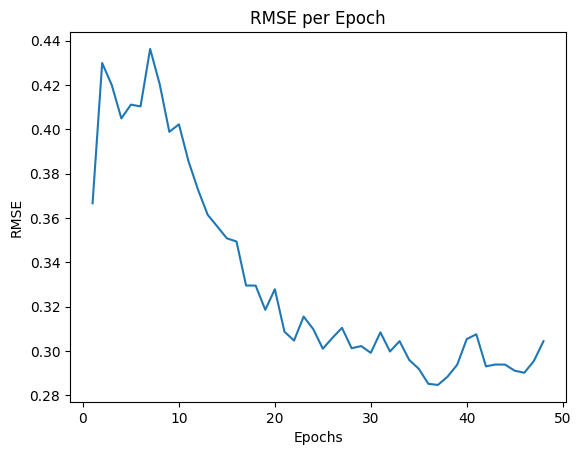

| 1         | -3.065    | 24.98     | 48.03     |
Epoch 1/33, RMSE: 0.4655
Epoch 2/33, RMSE: 0.4471
Epoch 3/33, RMSE: 0.4380
Epoch 4/33, RMSE: 0.4234
Epoch 5/33, RMSE: 0.4429
Epoch 6/33, RMSE: 0.4672
Epoch 7/33, RMSE: 0.4381
Epoch 8/33, RMSE: 0.4562
Epoch 9/33, RMSE: 0.4433
Epoch 10/33, RMSE: 0.4459
Epoch 11/33, RMSE: 0.4434
Epoch 12/33, RMSE: 0.4188
Epoch 13/33, RMSE: 0.4114
Epoch 14/33, RMSE: 0.4028
Epoch 15/33, RMSE: 0.4036
Epoch 16/33, RMSE: 0.3987
Epoch 17/33, RMSE: 0.3990
Epoch 18/33, RMSE: 0.3969
Epoch 19/33, RMSE: 0.3892
Epoch 20/33, RMSE: 0.3682
Epoch 21/33, RMSE: 0.3658
Epoch 22/33, RMSE: 0.3706
Epoch 23/33, RMSE: 0.3750
Epoch 24/33, RMSE: 0.3527
Epoch 25/33, RMSE: 0.3571
Epoch 26/33, RMSE: 0.3431
Epoch 27/33, RMSE: 0.3249
Epoch 28/33, RMSE: 0.3237
Epoch 29/33, RMSE: 0.3261
Epoch 30/33, RMSE: 0.3324
Epoch 31/33, RMSE: 0.3261
Epoch 32/33, RMSE: 0.3047
Epoch 33/33, RMSE: 0.3103


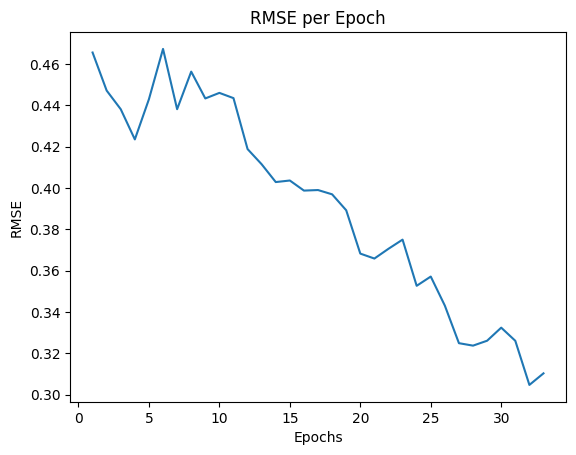

| 2         | -3.17     | 39.28     | 33.95     |
Epoch 1/16, RMSE: 0.4520
Epoch 2/16, RMSE: 0.4420
Epoch 3/16, RMSE: 0.3876
Epoch 4/16, RMSE: 0.4109
Epoch 5/16, RMSE: 0.3963
Epoch 6/16, RMSE: 0.4458
Epoch 7/16, RMSE: 0.4274
Epoch 8/16, RMSE: 0.4159
Epoch 9/16, RMSE: 0.3979
Epoch 10/16, RMSE: 0.4128
Epoch 11/16, RMSE: 0.4316
Epoch 12/16, RMSE: 0.4323
Epoch 13/16, RMSE: 0.4137
Epoch 14/16, RMSE: 0.4014
Epoch 15/16, RMSE: 0.4257
Epoch 16/16, RMSE: 0.4157


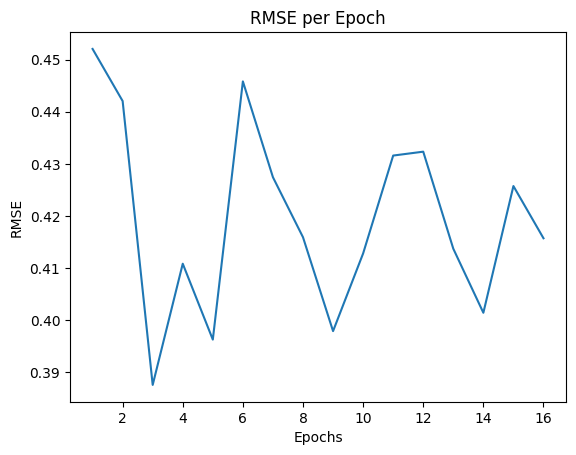

| 3         | -4.1      | 16.24     | 16.24     |
Epoch 1/44, RMSE: 0.6110
Epoch 2/44, RMSE: 0.5190
Epoch 3/44, RMSE: 0.4700
Epoch 4/44, RMSE: 0.4478
Epoch 5/44, RMSE: 0.4131
Epoch 6/44, RMSE: 0.4101
Epoch 7/44, RMSE: 0.4720
Epoch 8/44, RMSE: 0.4820
Epoch 9/44, RMSE: 0.4649
Epoch 10/44, RMSE: 0.4546
Epoch 11/44, RMSE: 0.4623
Epoch 12/44, RMSE: 0.4627
Epoch 13/44, RMSE: 0.4711
Epoch 14/44, RMSE: 0.4800
Epoch 15/44, RMSE: 0.5050
Epoch 16/44, RMSE: 0.4653
Epoch 17/44, RMSE: 0.4673
Epoch 18/44, RMSE: 0.4959
Epoch 19/44, RMSE: 0.4991
Epoch 20/44, RMSE: 0.4989
Epoch 21/44, RMSE: 0.5016
Epoch 22/44, RMSE: 0.4807
Epoch 23/44, RMSE: 0.4617
Epoch 24/44, RMSE: 0.4947
Epoch 25/44, RMSE: 0.4584
Epoch 26/44, RMSE: 0.4541
Epoch 27/44, RMSE: 0.4707
Epoch 28/44, RMSE: 0.4885
Epoch 29/44, RMSE: 0.4765
Epoch 30/44, RMSE: 0.4635
Epoch 31/44, RMSE: 0.4835
Epoch 32/44, RMSE: 0.4833
Epoch 33/44, RMSE: 0.4825
Epoch 34/44, RMSE: 0.4706
Epoch 35/44, RMSE: 0.4729
Epoch 36/44, RMSE: 0.4872
Epoch 37/44, RMSE: 0.48

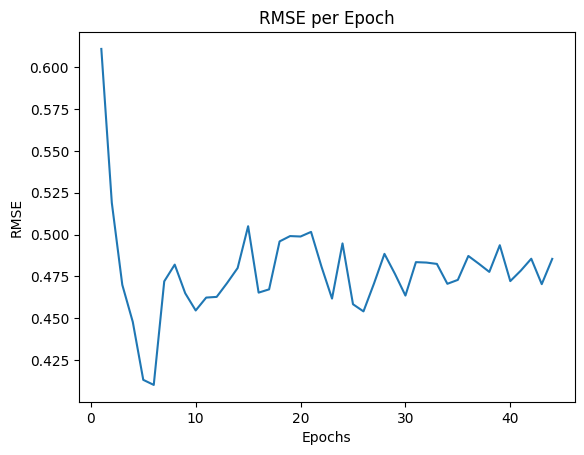

| 4         | -4.871    | 12.32     | 44.65     |
Epoch 1/38, RMSE: 0.4862
Epoch 2/38, RMSE: 0.4867
Epoch 3/38, RMSE: 0.4889
Epoch 4/38, RMSE: 0.4200
Epoch 5/38, RMSE: 0.3755
Epoch 6/38, RMSE: 0.3589
Epoch 7/38, RMSE: 0.3522
Epoch 8/38, RMSE: 0.3799
Epoch 9/38, RMSE: 0.3819
Epoch 10/38, RMSE: 0.3801
Epoch 11/38, RMSE: 0.3719
Epoch 12/38, RMSE: 0.3498
Epoch 13/38, RMSE: 0.3178
Epoch 14/38, RMSE: 0.3352
Epoch 15/38, RMSE: 0.3435
Epoch 16/38, RMSE: 0.3287
Epoch 17/38, RMSE: 0.3201
Epoch 18/38, RMSE: 0.3151
Epoch 19/38, RMSE: 0.2971
Epoch 20/38, RMSE: 0.3062
Epoch 21/38, RMSE: 0.3115
Epoch 22/38, RMSE: 0.2934
Epoch 23/38, RMSE: 0.3000
Epoch 24/38, RMSE: 0.2901
Epoch 25/38, RMSE: 0.2764
Epoch 26/38, RMSE: 0.2889
Epoch 27/38, RMSE: 0.2682
Epoch 28/38, RMSE: 0.2834
Epoch 29/38, RMSE: 0.2800
Epoch 30/38, RMSE: 0.2825
Epoch 31/38, RMSE: 0.2782
Epoch 32/38, RMSE: 0.2700
Epoch 33/38, RMSE: 0.2850
Epoch 34/38, RMSE: 0.2811
Epoch 35/38, RMSE: 0.2828
Epoch 36/38, RMSE: 0.2757
Epoch 37/38, RMSE: 0.27

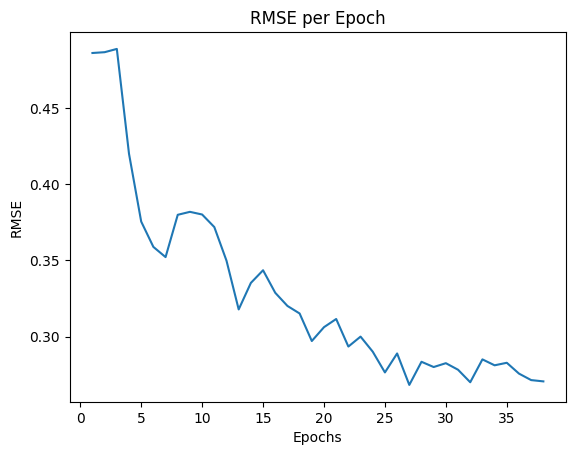

| 5         | -2.725    | 34.04     | 38.32     |
Epoch 1/48, RMSE: 0.4201
Epoch 2/48, RMSE: 0.3840
Epoch 3/48, RMSE: 0.3352
Epoch 4/48, RMSE: 0.4226
Epoch 5/48, RMSE: 0.3561
Epoch 6/48, RMSE: 0.4681
Epoch 7/48, RMSE: 0.4943
Epoch 8/48, RMSE: 0.5465
Epoch 9/48, RMSE: 0.5367
Epoch 10/48, RMSE: 0.5532
Epoch 11/48, RMSE: 0.5753
Epoch 12/48, RMSE: 0.5671
Epoch 13/48, RMSE: 0.5782
Epoch 14/48, RMSE: 0.5456
Epoch 15/48, RMSE: 0.5566
Epoch 16/48, RMSE: 0.5951
Epoch 17/48, RMSE: 0.5522
Epoch 18/48, RMSE: 0.5866
Epoch 19/48, RMSE: 0.5289
Epoch 20/48, RMSE: 0.5386
Epoch 21/48, RMSE: 0.5227
Epoch 22/48, RMSE: 0.5541
Epoch 23/48, RMSE: 0.5257
Epoch 24/48, RMSE: 0.5286
Epoch 25/48, RMSE: 0.5172
Epoch 26/48, RMSE: 0.5283
Epoch 27/48, RMSE: 0.5078
Epoch 28/48, RMSE: 0.4932
Epoch 29/48, RMSE: 0.4942
Epoch 30/48, RMSE: 0.5027
Epoch 31/48, RMSE: 0.4765
Epoch 32/48, RMSE: 0.5012
Epoch 33/48, RMSE: 0.4751
Epoch 34/48, RMSE: 0.5024
Epoch 35/48, RMSE: 0.4920
Epoch 36/48, RMSE: 0.4999
Epoch 37/48, RMSE: 0.49

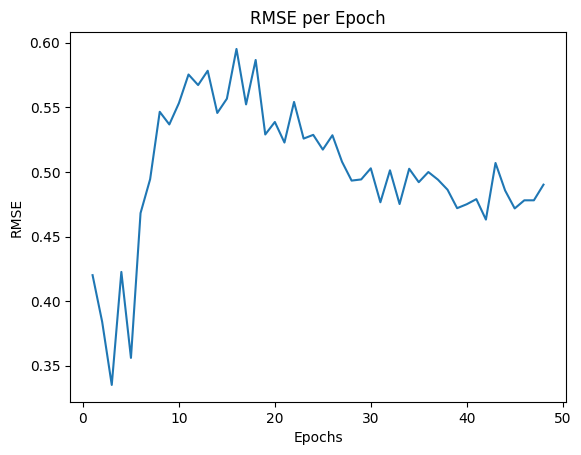

| 6         | -4.918    | 10.82     | 48.8      |
Epoch 1/18, RMSE: 0.4304
Epoch 2/18, RMSE: 0.3987
Epoch 3/18, RMSE: 0.4081
Epoch 4/18, RMSE: 0.3947
Epoch 5/18, RMSE: 0.4038
Epoch 6/18, RMSE: 0.3437
Epoch 7/18, RMSE: 0.3251
Epoch 8/18, RMSE: 0.3354
Epoch 9/18, RMSE: 0.3531
Epoch 10/18, RMSE: 0.3574
Epoch 11/18, RMSE: 0.3525
Epoch 12/18, RMSE: 0.3657
Epoch 13/18, RMSE: 0.3593
Epoch 14/18, RMSE: 0.3366
Epoch 15/18, RMSE: 0.3350
Epoch 16/18, RMSE: 0.3574
Epoch 17/18, RMSE: 0.3313
Epoch 18/18, RMSE: 0.3414


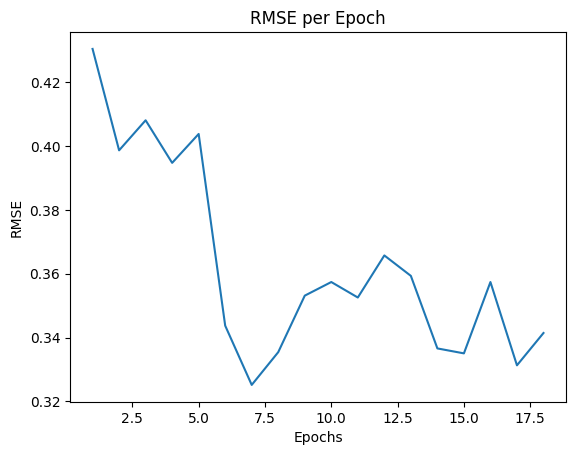

| 7         | -3.425    | 43.3      | 18.49     |
Epoch 1/17, RMSE: 0.3828
Epoch 2/17, RMSE: 0.4284
Epoch 3/17, RMSE: 0.3718
Epoch 4/17, RMSE: 0.2951
Epoch 5/17, RMSE: 0.3586
Epoch 6/17, RMSE: 0.3728
Epoch 7/17, RMSE: 0.3727
Epoch 8/17, RMSE: 0.3911
Epoch 9/17, RMSE: 0.3827
Epoch 10/17, RMSE: 0.3883
Epoch 11/17, RMSE: 0.3876
Epoch 12/17, RMSE: 0.3872
Epoch 13/17, RMSE: 0.3761
Epoch 14/17, RMSE: 0.3875
Epoch 15/17, RMSE: 0.3901
Epoch 16/17, RMSE: 0.3942
Epoch 17/17, RMSE: 0.4021


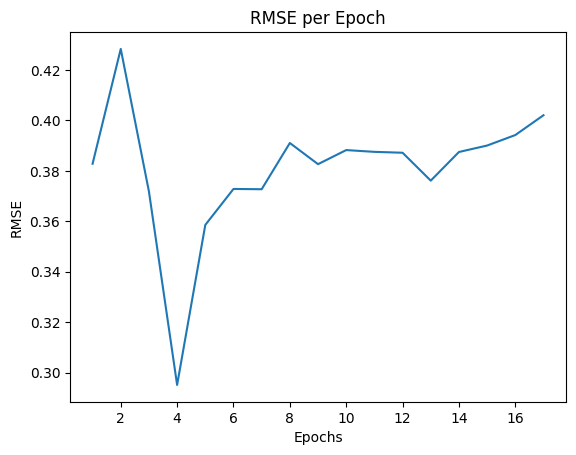

| 8         | -4.038    | 17.27     | 17.34     |
Epoch 1/30, RMSE: 0.3929
Epoch 2/30, RMSE: 0.4464
Epoch 3/30, RMSE: 0.4128
Epoch 4/30, RMSE: 0.4074
Epoch 5/30, RMSE: 0.3682
Epoch 6/30, RMSE: 0.3209
Epoch 7/30, RMSE: 0.3277
Epoch 8/30, RMSE: 0.3716
Epoch 9/30, RMSE: 0.3588
Epoch 10/30, RMSE: 0.3473
Epoch 11/30, RMSE: 0.3212
Epoch 12/30, RMSE: 0.3093
Epoch 13/30, RMSE: 0.3031
Epoch 14/30, RMSE: 0.2938
Epoch 15/30, RMSE: 0.3046
Epoch 16/30, RMSE: 0.2923
Epoch 17/30, RMSE: 0.2875
Epoch 18/30, RMSE: 0.2963
Epoch 19/30, RMSE: 0.2890
Epoch 20/30, RMSE: 0.2983
Epoch 21/30, RMSE: 0.3015
Epoch 22/30, RMSE: 0.2848
Epoch 23/30, RMSE: 0.2965
Epoch 24/30, RMSE: 0.3040
Epoch 25/30, RMSE: 0.2899
Epoch 26/30, RMSE: 0.2910
Epoch 27/30, RMSE: 0.3083
Epoch 28/30, RMSE: 0.2918
Epoch 29/30, RMSE: 0.3002
Epoch 30/30, RMSE: 0.2939


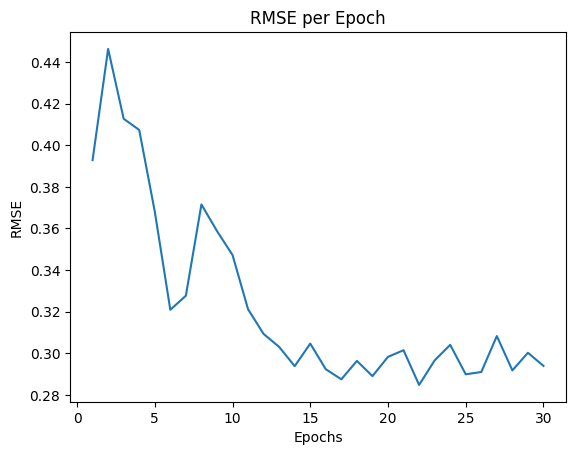

| 9         | -2.975    | 22.17     | 30.99     |
Epoch 1/21, RMSE: 0.3292
Epoch 2/21, RMSE: 0.3766
Epoch 3/21, RMSE: 0.3456
Epoch 4/21, RMSE: 0.4094
Epoch 5/21, RMSE: 0.4316
Epoch 6/21, RMSE: 0.4672
Epoch 7/21, RMSE: 0.4731
Epoch 8/21, RMSE: 0.4643
Epoch 9/21, RMSE: 0.4664
Epoch 10/21, RMSE: 0.4522
Epoch 11/21, RMSE: 0.4423
Epoch 12/21, RMSE: 0.4311
Epoch 13/21, RMSE: 0.4120
Epoch 14/21, RMSE: 0.4116
Epoch 15/21, RMSE: 0.4016
Epoch 16/21, RMSE: 0.3957
Epoch 17/21, RMSE: 0.3902
Epoch 18/21, RMSE: 0.3687
Epoch 19/21, RMSE: 0.3715
Epoch 20/21, RMSE: 0.3609
Epoch 21/21, RMSE: 0.3544


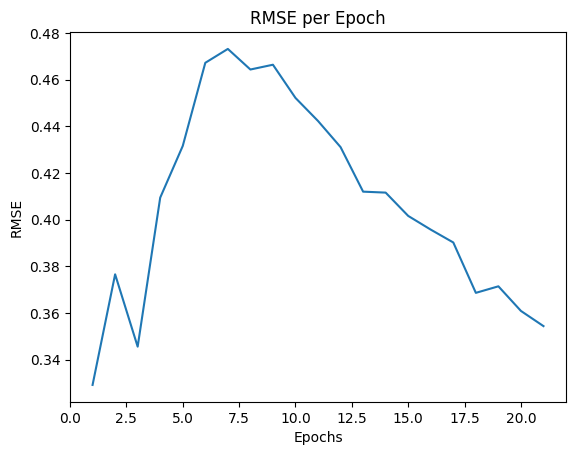

| 10        | -3.611    | 27.28     | 21.65     |
Epoch 1/50, RMSE: 0.4494
Epoch 2/50, RMSE: 0.4898
Epoch 3/50, RMSE: 0.3771
Epoch 4/50, RMSE: 0.3693
Epoch 5/50, RMSE: 0.3899
Epoch 6/50, RMSE: 0.3953
Epoch 7/50, RMSE: 0.3522
Epoch 8/50, RMSE: 0.3439
Epoch 9/50, RMSE: 0.3372
Epoch 10/50, RMSE: 0.3474
Epoch 11/50, RMSE: 0.3307
Epoch 12/50, RMSE: 0.3539
Epoch 13/50, RMSE: 0.3458
Epoch 14/50, RMSE: 0.3358
Epoch 15/50, RMSE: 0.3249
Epoch 16/50, RMSE: 0.3328
Epoch 17/50, RMSE: 0.3180
Epoch 18/50, RMSE: 0.3270
Epoch 19/50, RMSE: 0.3217
Epoch 20/50, RMSE: 0.3097
Epoch 21/50, RMSE: 0.2903
Epoch 22/50, RMSE: 0.2987
Epoch 23/50, RMSE: 0.2937
Epoch 24/50, RMSE: 0.2998
Epoch 25/50, RMSE: 0.2898
Epoch 26/50, RMSE: 0.2743
Epoch 27/50, RMSE: 0.2853
Epoch 28/50, RMSE: 0.2846
Epoch 29/50, RMSE: 0.2749
Epoch 30/50, RMSE: 0.2785
Epoch 31/50, RMSE: 0.2601
Epoch 32/50, RMSE: 0.2659
Epoch 33/50, RMSE: 0.2590
Epoch 34/50, RMSE: 0.2714
Epoch 35/50, RMSE: 0.2719
Epoch 36/50, RMSE: 0.2549
Epoch 37/50, RMSE: 0.24

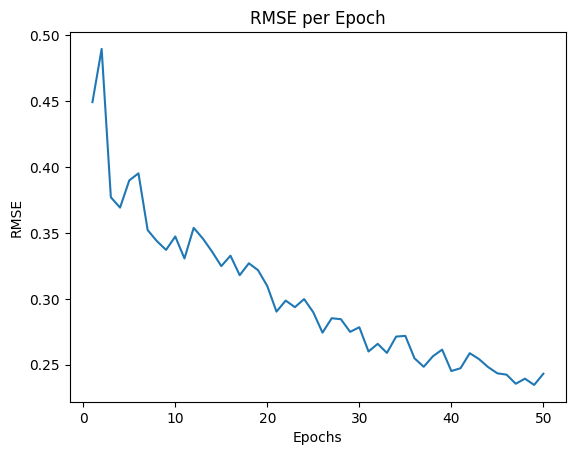

| 11        | -2.496    | 39.66     | 50.0      |
Epoch 1/50, RMSE: 0.3811
Epoch 2/50, RMSE: 0.3883
Epoch 3/50, RMSE: 0.3142
Epoch 4/50, RMSE: 0.3347
Epoch 5/50, RMSE: 0.3610
Epoch 6/50, RMSE: 0.3345
Epoch 7/50, RMSE: 0.3669
Epoch 8/50, RMSE: 0.3374
Epoch 9/50, RMSE: 0.3481
Epoch 10/50, RMSE: 0.3439
Epoch 11/50, RMSE: 0.3240
Epoch 12/50, RMSE: 0.3464
Epoch 13/50, RMSE: 0.3324
Epoch 14/50, RMSE: 0.3464
Epoch 15/50, RMSE: 0.3362
Epoch 16/50, RMSE: 0.3243
Epoch 17/50, RMSE: 0.3364
Epoch 18/50, RMSE: 0.3436
Epoch 19/50, RMSE: 0.3332
Epoch 20/50, RMSE: 0.3136
Epoch 21/50, RMSE: 0.3307
Epoch 22/50, RMSE: 0.3336
Epoch 23/50, RMSE: 0.3113
Epoch 24/50, RMSE: 0.3127
Epoch 25/50, RMSE: 0.3162
Epoch 26/50, RMSE: 0.3126
Epoch 27/50, RMSE: 0.3088
Epoch 28/50, RMSE: 0.2896
Epoch 29/50, RMSE: 0.3008
Epoch 30/50, RMSE: 0.3029
Epoch 31/50, RMSE: 0.2969
Epoch 32/50, RMSE: 0.2886
Epoch 33/50, RMSE: 0.2915
Epoch 34/50, RMSE: 0.2825
Epoch 35/50, RMSE: 0.2811
Epoch 36/50, RMSE: 0.2845
Epoch 37/50, RMSE: 0.27

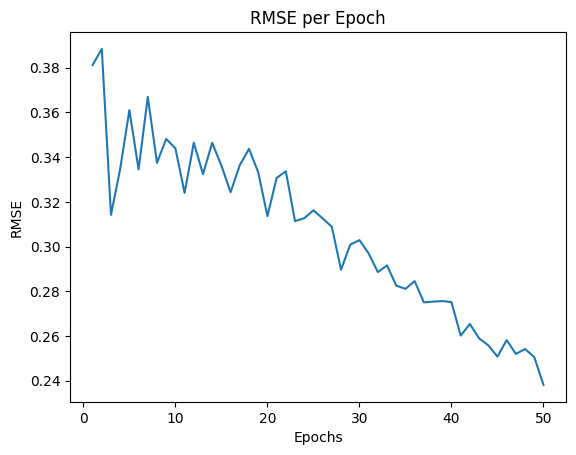

| 12        | -2.503    | 50.0      | 50.0      |
Epoch 1/41, RMSE: 0.4424
Epoch 2/41, RMSE: 0.4596
Epoch 3/41, RMSE: 0.3700
Epoch 4/41, RMSE: 0.4169
Epoch 5/41, RMSE: 0.3814
Epoch 6/41, RMSE: 0.4018
Epoch 7/41, RMSE: 0.4086
Epoch 8/41, RMSE: 0.4004
Epoch 9/41, RMSE: 0.4174
Epoch 10/41, RMSE: 0.4067
Epoch 11/41, RMSE: 0.4108
Epoch 12/41, RMSE: 0.4199
Epoch 13/41, RMSE: 0.4132
Epoch 14/41, RMSE: 0.4190
Epoch 15/41, RMSE: 0.3947
Epoch 16/41, RMSE: 0.3969
Epoch 17/41, RMSE: 0.4182
Epoch 18/41, RMSE: 0.3940
Epoch 19/41, RMSE: 0.3970
Epoch 20/41, RMSE: 0.3981
Epoch 21/41, RMSE: 0.3796
Epoch 22/41, RMSE: 0.3891
Epoch 23/41, RMSE: 0.3887
Epoch 24/41, RMSE: 0.3873
Epoch 25/41, RMSE: 0.3779
Epoch 26/41, RMSE: 0.3648
Epoch 27/41, RMSE: 0.3570
Epoch 28/41, RMSE: 0.3505
Epoch 29/41, RMSE: 0.3460
Epoch 30/41, RMSE: 0.3475
Epoch 31/41, RMSE: 0.3413
Epoch 32/41, RMSE: 0.3428
Epoch 33/41, RMSE: 0.3470
Epoch 34/41, RMSE: 0.3348
Epoch 35/41, RMSE: 0.3216
Epoch 36/41, RMSE: 0.3269
Epoch 37/41, RMSE: 0.32

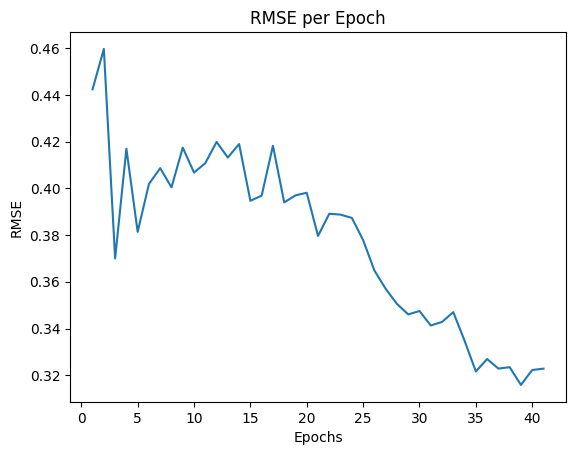

| 13        | -3.333    | 50.0      | 41.15     |
Epoch 1/10, RMSE: 0.4138
Epoch 2/10, RMSE: 0.4448
Epoch 3/10, RMSE: 0.3660
Epoch 4/10, RMSE: 0.3971
Epoch 5/10, RMSE: 0.4063
Epoch 6/10, RMSE: 0.3882
Epoch 7/10, RMSE: 0.3320
Epoch 8/10, RMSE: 0.3867
Epoch 9/10, RMSE: 0.3807
Epoch 10/10, RMSE: 0.4061


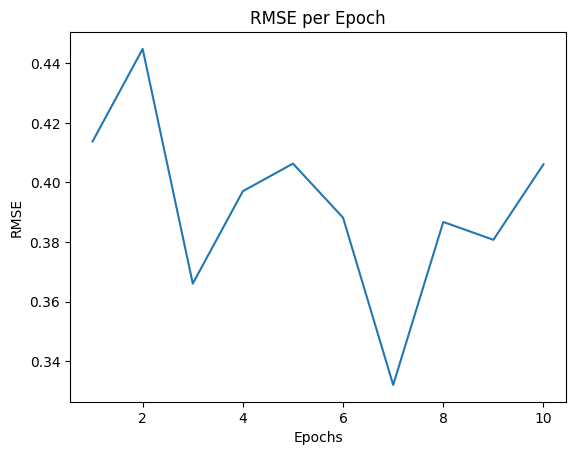

| 14        | -4.128    | 50.0      | 10.0      |
Epoch 1/50, RMSE: 0.4474
Epoch 2/50, RMSE: 0.5211
Epoch 3/50, RMSE: 0.5277
Epoch 4/50, RMSE: 0.4867
Epoch 5/50, RMSE: 0.4829
Epoch 6/50, RMSE: 0.4844
Epoch 7/50, RMSE: 0.4662
Epoch 8/50, RMSE: 0.4437
Epoch 9/50, RMSE: 0.4321
Epoch 10/50, RMSE: 0.4343
Epoch 11/50, RMSE: 0.4112
Epoch 12/50, RMSE: 0.3904
Epoch 13/50, RMSE: 0.4006
Epoch 14/50, RMSE: 0.3891
Epoch 15/50, RMSE: 0.3978
Epoch 16/50, RMSE: 0.3779
Epoch 17/50, RMSE: 0.3623
Epoch 18/50, RMSE: 0.3784
Epoch 19/50, RMSE: 0.3632
Epoch 20/50, RMSE: 0.3550
Epoch 21/50, RMSE: 0.3495
Epoch 22/50, RMSE: 0.3396
Epoch 23/50, RMSE: 0.3281
Epoch 24/50, RMSE: 0.3234
Epoch 25/50, RMSE: 0.3088
Epoch 26/50, RMSE: 0.3162
Epoch 27/50, RMSE: 0.3048
Epoch 28/50, RMSE: 0.3050
Epoch 29/50, RMSE: 0.2987
Epoch 30/50, RMSE: 0.3012
Epoch 31/50, RMSE: 0.2916
Epoch 32/50, RMSE: 0.2902
Epoch 33/50, RMSE: 0.2898
Epoch 34/50, RMSE: 0.2850
Epoch 35/50, RMSE: 0.2813
Epoch 36/50, RMSE: 0.2748
Epoch 37/50, RMSE: 0.28

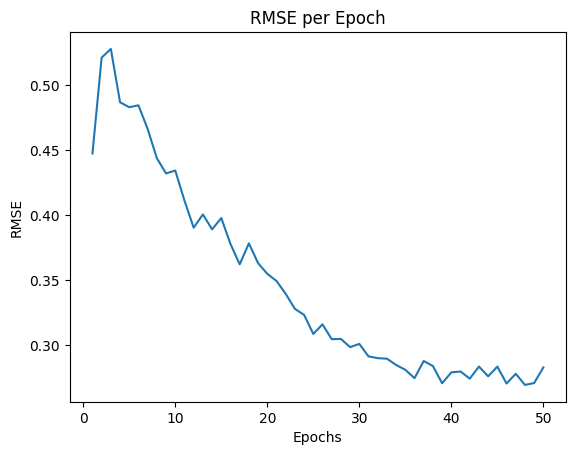

| 15        | -2.909    | 32.96     | 50.0      |
Epoch 1/50, RMSE: 0.4711
Epoch 2/50, RMSE: 0.3990
Epoch 3/50, RMSE: 0.4060
Epoch 4/50, RMSE: 0.3888
Epoch 5/50, RMSE: 0.4121
Epoch 6/50, RMSE: 0.4025
Epoch 7/50, RMSE: 0.3953
Epoch 8/50, RMSE: 0.3904
Epoch 9/50, RMSE: 0.3668
Epoch 10/50, RMSE: 0.3685
Epoch 11/50, RMSE: 0.3384
Epoch 12/50, RMSE: 0.3816
Epoch 13/50, RMSE: 0.3629
Epoch 14/50, RMSE: 0.3715
Epoch 15/50, RMSE: 0.3470
Epoch 16/50, RMSE: 0.3625
Epoch 17/50, RMSE: 0.3617
Epoch 18/50, RMSE: 0.3392
Epoch 19/50, RMSE: 0.3346
Epoch 20/50, RMSE: 0.3176
Epoch 21/50, RMSE: 0.3340
Epoch 22/50, RMSE: 0.3360
Epoch 23/50, RMSE: 0.3197
Epoch 24/50, RMSE: 0.3162
Epoch 25/50, RMSE: 0.3156
Epoch 26/50, RMSE: 0.3194
Epoch 27/50, RMSE: 0.3100
Epoch 28/50, RMSE: 0.3066
Epoch 29/50, RMSE: 0.3090
Epoch 30/50, RMSE: 0.3055
Epoch 31/50, RMSE: 0.3001
Epoch 32/50, RMSE: 0.3039
Epoch 33/50, RMSE: 0.3036
Epoch 34/50, RMSE: 0.2855
Epoch 35/50, RMSE: 0.2906
Epoch 36/50, RMSE: 0.2904
Epoch 37/50, RMSE: 0.28

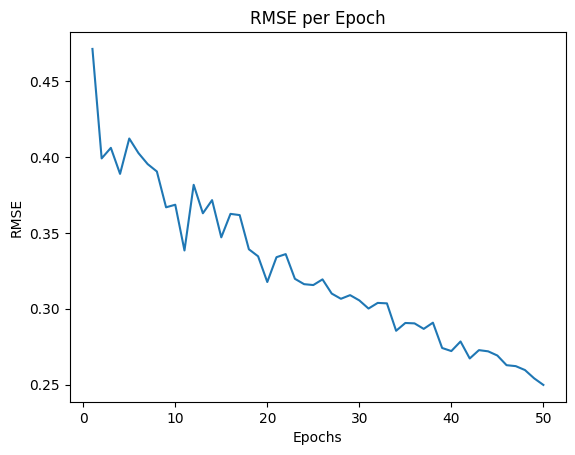

| 16        | -2.639    | 45.02     | 50.0      |
Epoch 1/38, RMSE: 0.3140
Epoch 2/38, RMSE: 0.4752
Epoch 3/38, RMSE: 0.4576
Epoch 4/38, RMSE: 0.4204
Epoch 5/38, RMSE: 0.3811
Epoch 6/38, RMSE: 0.3616
Epoch 7/38, RMSE: 0.3704
Epoch 8/38, RMSE: 0.3592
Epoch 9/38, RMSE: 0.3573
Epoch 10/38, RMSE: 0.3239
Epoch 11/38, RMSE: 0.3332
Epoch 12/38, RMSE: 0.3165
Epoch 13/38, RMSE: 0.3174
Epoch 14/38, RMSE: 0.3100
Epoch 15/38, RMSE: 0.3118
Epoch 16/38, RMSE: 0.3054
Epoch 17/38, RMSE: 0.2961
Epoch 18/38, RMSE: 0.2881
Epoch 19/38, RMSE: 0.2861
Epoch 20/38, RMSE: 0.2636
Epoch 21/38, RMSE: 0.2865
Epoch 22/38, RMSE: 0.2804
Epoch 23/38, RMSE: 0.2749
Epoch 24/38, RMSE: 0.2688
Epoch 25/38, RMSE: 0.2787
Epoch 26/38, RMSE: 0.2819
Epoch 27/38, RMSE: 0.2754
Epoch 28/38, RMSE: 0.2796
Epoch 29/38, RMSE: 0.2811
Epoch 30/38, RMSE: 0.2742
Epoch 31/38, RMSE: 0.2933
Epoch 32/38, RMSE: 0.2831
Epoch 33/38, RMSE: 0.2749
Epoch 34/38, RMSE: 0.2888
Epoch 35/38, RMSE: 0.2847
Epoch 36/38, RMSE: 0.2863
Epoch 37/38, RMSE: 0.28

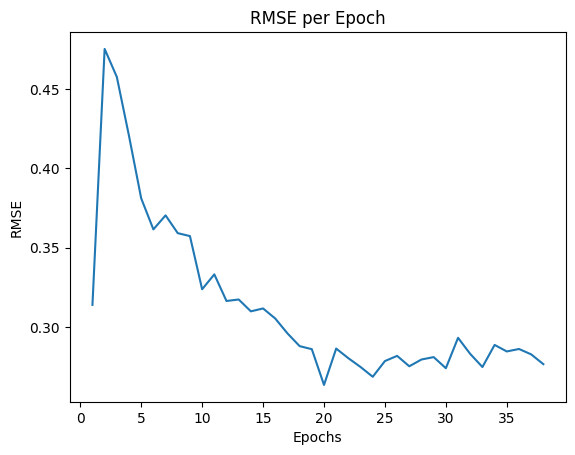

| 17        | -2.813    | 26.76     | 38.47     |
Epoch 1/44, RMSE: 0.4447
Epoch 2/44, RMSE: 0.4054
Epoch 3/44, RMSE: 0.4187
Epoch 4/44, RMSE: 0.4081
Epoch 5/44, RMSE: 0.4144
Epoch 6/44, RMSE: 0.4292
Epoch 7/44, RMSE: 0.3732
Epoch 8/44, RMSE: 0.3664
Epoch 9/44, RMSE: 0.3795
Epoch 10/44, RMSE: 0.3886
Epoch 11/44, RMSE: 0.3711
Epoch 12/44, RMSE: 0.3724
Epoch 13/44, RMSE: 0.3640
Epoch 14/44, RMSE: 0.3483
Epoch 15/44, RMSE: 0.3659
Epoch 16/44, RMSE: 0.3389
Epoch 17/44, RMSE: 0.3359
Epoch 18/44, RMSE: 0.3424
Epoch 19/44, RMSE: 0.3311
Epoch 20/44, RMSE: 0.3456
Epoch 21/44, RMSE: 0.3205
Epoch 22/44, RMSE: 0.3384
Epoch 23/44, RMSE: 0.3209
Epoch 24/44, RMSE: 0.3280
Epoch 25/44, RMSE: 0.3168
Epoch 26/44, RMSE: 0.3238
Epoch 27/44, RMSE: 0.3090
Epoch 28/44, RMSE: 0.3149
Epoch 29/44, RMSE: 0.3120
Epoch 30/44, RMSE: 0.2976
Epoch 31/44, RMSE: 0.2993
Epoch 32/44, RMSE: 0.2972
Epoch 33/44, RMSE: 0.2898
Epoch 34/44, RMSE: 0.2918
Epoch 35/44, RMSE: 0.2837
Epoch 36/44, RMSE: 0.2878
Epoch 37/44, RMSE: 0.29

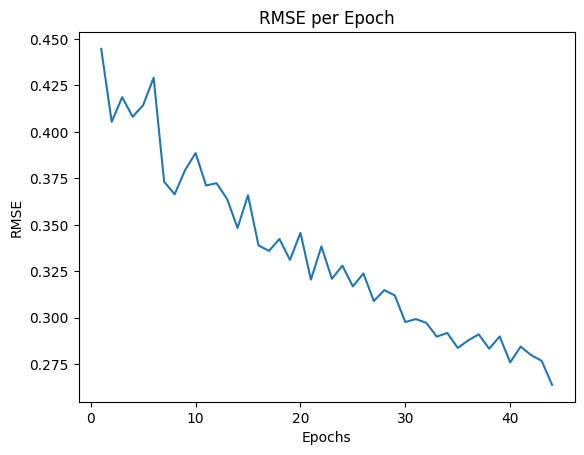

| 18        | -2.734    | 38.64     | 44.55     |
Epoch 1/31, RMSE: 0.4210
Epoch 2/31, RMSE: 0.4841
Epoch 3/31, RMSE: 0.5092
Epoch 4/31, RMSE: 0.4835
Epoch 5/31, RMSE: 0.4434
Epoch 6/31, RMSE: 0.4709
Epoch 7/31, RMSE: 0.4185
Epoch 8/31, RMSE: 0.4104
Epoch 9/31, RMSE: 0.4096
Epoch 10/31, RMSE: 0.3933
Epoch 11/31, RMSE: 0.3854
Epoch 12/31, RMSE: 0.3608
Epoch 13/31, RMSE: 0.3680
Epoch 14/31, RMSE: 0.3610
Epoch 15/31, RMSE: 0.3585
Epoch 16/31, RMSE: 0.3526
Epoch 17/31, RMSE: 0.3497
Epoch 18/31, RMSE: 0.3294
Epoch 19/31, RMSE: 0.3344
Epoch 20/31, RMSE: 0.3346
Epoch 21/31, RMSE: 0.3307
Epoch 22/31, RMSE: 0.3227
Epoch 23/31, RMSE: 0.3031
Epoch 24/31, RMSE: 0.3130
Epoch 25/31, RMSE: 0.3080
Epoch 26/31, RMSE: 0.3131
Epoch 27/31, RMSE: 0.2958
Epoch 28/31, RMSE: 0.3038
Epoch 29/31, RMSE: 0.2916
Epoch 30/31, RMSE: 0.2975
Epoch 31/31, RMSE: 0.3057


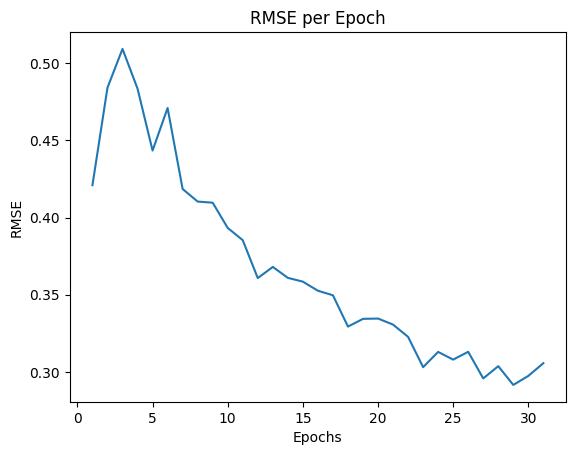

| 19        | -3.075    | 30.23     | 31.96     |
Epoch 1/10, RMSE: 0.3770
Epoch 2/10, RMSE: 0.5115
Epoch 3/10, RMSE: 0.5233
Epoch 4/10, RMSE: 0.4802
Epoch 5/10, RMSE: 0.4490
Epoch 6/10, RMSE: 0.4118
Epoch 7/10, RMSE: 0.3931
Epoch 8/10, RMSE: 0.3987
Epoch 9/10, RMSE: 0.4055
Epoch 10/10, RMSE: 0.3881


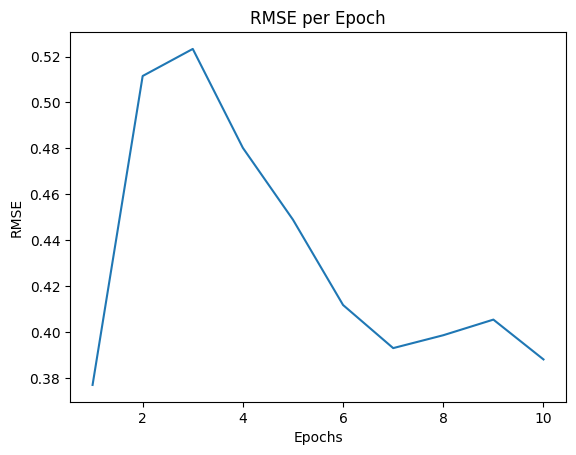

| 20        | -3.94     | 33.76     | 10.0      |
Epoch 1/26, RMSE: 0.3610
Epoch 2/26, RMSE: 0.3538
Epoch 3/26, RMSE: 0.3275
Epoch 4/26, RMSE: 0.3302
Epoch 5/26, RMSE: 0.3443
Epoch 6/26, RMSE: 0.3233
Epoch 7/26, RMSE: 0.3754
Epoch 8/26, RMSE: 0.3442
Epoch 9/26, RMSE: 0.3755
Epoch 10/26, RMSE: 0.3188
Epoch 11/26, RMSE: 0.3738
Epoch 12/26, RMSE: 0.3629
Epoch 13/26, RMSE: 0.3837
Epoch 14/26, RMSE: 0.3697
Epoch 15/26, RMSE: 0.3652
Epoch 16/26, RMSE: 0.3465
Epoch 17/26, RMSE: 0.3549
Epoch 18/26, RMSE: 0.3709
Epoch 19/26, RMSE: 0.3518
Epoch 20/26, RMSE: 0.3546
Epoch 21/26, RMSE: 0.3371
Epoch 22/26, RMSE: 0.3370
Epoch 23/26, RMSE: 0.3351
Epoch 24/26, RMSE: 0.3395
Epoch 25/26, RMSE: 0.3246
Epoch 26/26, RMSE: 0.3169


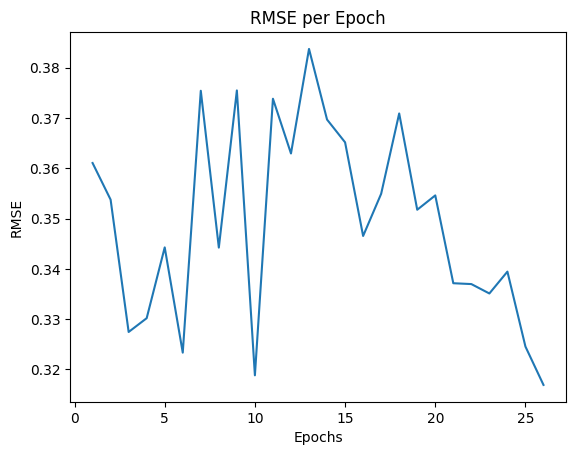

| 21        | -3.169    | 50.0      | 26.42     |
Epoch 1/43, RMSE: 0.3968
Epoch 2/43, RMSE: 0.4452
Epoch 3/43, RMSE: 0.4435
Epoch 4/43, RMSE: 0.4192
Epoch 5/43, RMSE: 0.4154
Epoch 6/43, RMSE: 0.3925
Epoch 7/43, RMSE: 0.4063
Epoch 8/43, RMSE: 0.3726
Epoch 9/43, RMSE: 0.3747
Epoch 10/43, RMSE: 0.3577
Epoch 11/43, RMSE: 0.3661
Epoch 12/43, RMSE: 0.3582
Epoch 13/43, RMSE: 0.3485
Epoch 14/43, RMSE: 0.3510
Epoch 15/43, RMSE: 0.3410
Epoch 16/43, RMSE: 0.3348
Epoch 17/43, RMSE: 0.3292
Epoch 18/43, RMSE: 0.3298
Epoch 19/43, RMSE: 0.3110
Epoch 20/43, RMSE: 0.3129
Epoch 21/43, RMSE: 0.3088
Epoch 22/43, RMSE: 0.2971
Epoch 23/43, RMSE: 0.2941
Epoch 24/43, RMSE: 0.2902
Epoch 25/43, RMSE: 0.2928
Epoch 26/43, RMSE: 0.3062
Epoch 27/43, RMSE: 0.2956
Epoch 28/43, RMSE: 0.3052
Epoch 29/43, RMSE: 0.2942
Epoch 30/43, RMSE: 0.2816
Epoch 31/43, RMSE: 0.2845
Epoch 32/43, RMSE: 0.2862
Epoch 33/43, RMSE: 0.2827
Epoch 34/43, RMSE: 0.2808
Epoch 35/43, RMSE: 0.2743
Epoch 36/43, RMSE: 0.2835
Epoch 37/43, RMSE: 0.27

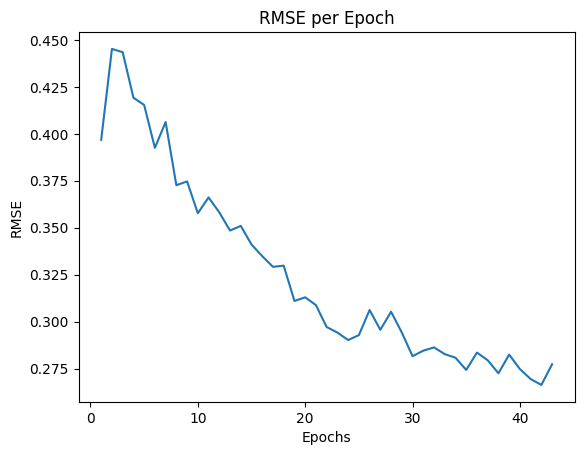

| 22        | -2.842    | 31.23     | 43.16     |
Epoch 1/27, RMSE: 0.4643
Epoch 2/27, RMSE: 0.3867
Epoch 3/27, RMSE: 0.4036
Epoch 4/27, RMSE: 0.4081
Epoch 5/27, RMSE: 0.4417
Epoch 6/27, RMSE: 0.4737
Epoch 7/27, RMSE: 0.4806
Epoch 8/27, RMSE: 0.4617
Epoch 9/27, RMSE: 0.4596
Epoch 10/27, RMSE: 0.4764
Epoch 11/27, RMSE: 0.4794
Epoch 12/27, RMSE: 0.5237
Epoch 13/27, RMSE: 0.4903
Epoch 14/27, RMSE: 0.5273
Epoch 15/27, RMSE: 0.5457
Epoch 16/27, RMSE: 0.5415
Epoch 17/27, RMSE: 0.5522
Epoch 18/27, RMSE: 0.5563
Epoch 19/27, RMSE: 0.5591
Epoch 20/27, RMSE: 0.5634
Epoch 21/27, RMSE: 0.5710
Epoch 22/27, RMSE: 0.5662
Epoch 23/27, RMSE: 0.5627
Epoch 24/27, RMSE: 0.5866
Epoch 25/27, RMSE: 0.5634
Epoch 26/27, RMSE: 0.5727
Epoch 27/27, RMSE: 0.5680


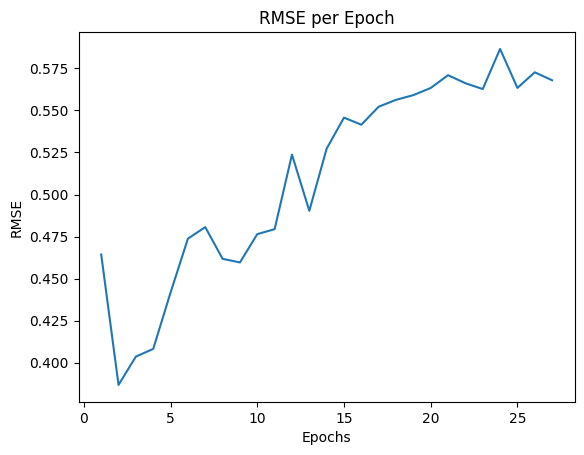

| 23        | -5.705    | 10.0      | 27.48     |
Epoch 1/47, RMSE: 0.3487
Epoch 2/47, RMSE: 0.3283
Epoch 3/47, RMSE: 0.3260
Epoch 4/47, RMSE: 0.3667
Epoch 5/47, RMSE: 0.2851
Epoch 6/47, RMSE: 0.2843
Epoch 7/47, RMSE: 0.2587
Epoch 8/47, RMSE: 0.3116
Epoch 9/47, RMSE: 0.2940
Epoch 10/47, RMSE: 0.3501
Epoch 11/47, RMSE: 0.3568
Epoch 12/47, RMSE: 0.3357
Epoch 13/47, RMSE: 0.3476
Epoch 14/47, RMSE: 0.3616
Epoch 15/47, RMSE: 0.3514
Epoch 16/47, RMSE: 0.3438
Epoch 17/47, RMSE: 0.3243
Epoch 18/47, RMSE: 0.3417
Epoch 19/47, RMSE: 0.3220
Epoch 20/47, RMSE: 0.3379
Epoch 21/47, RMSE: 0.3308
Epoch 22/47, RMSE: 0.3291
Epoch 23/47, RMSE: 0.3115
Epoch 24/47, RMSE: 0.3058
Epoch 25/47, RMSE: 0.3120
Epoch 26/47, RMSE: 0.3115
Epoch 27/47, RMSE: 0.2992
Epoch 28/47, RMSE: 0.2921
Epoch 29/47, RMSE: 0.3072
Epoch 30/47, RMSE: 0.3013
Epoch 31/47, RMSE: 0.2841
Epoch 32/47, RMSE: 0.2895
Epoch 33/47, RMSE: 0.2743
Epoch 34/47, RMSE: 0.2726
Epoch 35/47, RMSE: 0.2766
Epoch 36/47, RMSE: 0.2693
Epoch 37/47, RMSE: 0.27

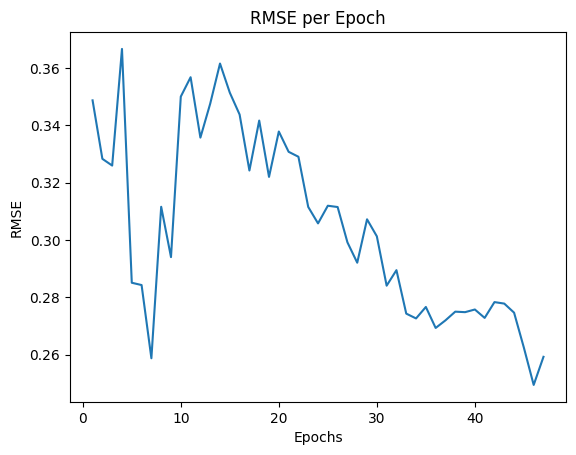

| 24        | -2.666    | 49.99     | 47.78     |
Epoch 1/48, RMSE: 0.4080
Epoch 2/48, RMSE: 0.5045
Epoch 3/48, RMSE: 0.4682
Epoch 4/48, RMSE: 0.4555
Epoch 5/48, RMSE: 0.4107
Epoch 6/48, RMSE: 0.3860
Epoch 7/48, RMSE: 0.3888
Epoch 8/48, RMSE: 0.3860
Epoch 9/48, RMSE: 0.3796
Epoch 10/48, RMSE: 0.3595
Epoch 11/48, RMSE: 0.3781
Epoch 12/48, RMSE: 0.3697
Epoch 13/48, RMSE: 0.3636
Epoch 14/48, RMSE: 0.3602
Epoch 15/48, RMSE: 0.3407
Epoch 16/48, RMSE: 0.3460
Epoch 17/48, RMSE: 0.3357
Epoch 18/48, RMSE: 0.3383
Epoch 19/48, RMSE: 0.3287
Epoch 20/48, RMSE: 0.3241
Epoch 21/48, RMSE: 0.3221
Epoch 22/48, RMSE: 0.3141
Epoch 23/48, RMSE: 0.3093
Epoch 24/48, RMSE: 0.2996
Epoch 25/48, RMSE: 0.3114
Epoch 26/48, RMSE: 0.3176
Epoch 27/48, RMSE: 0.3058
Epoch 28/48, RMSE: 0.3090
Epoch 29/48, RMSE: 0.2983
Epoch 30/48, RMSE: 0.2942
Epoch 31/48, RMSE: 0.2877
Epoch 32/48, RMSE: 0.2848
Epoch 33/48, RMSE: 0.2823
Epoch 34/48, RMSE: 0.2898
Epoch 35/48, RMSE: 0.2786
Epoch 36/48, RMSE: 0.2702
Epoch 37/48, RMSE: 0.27

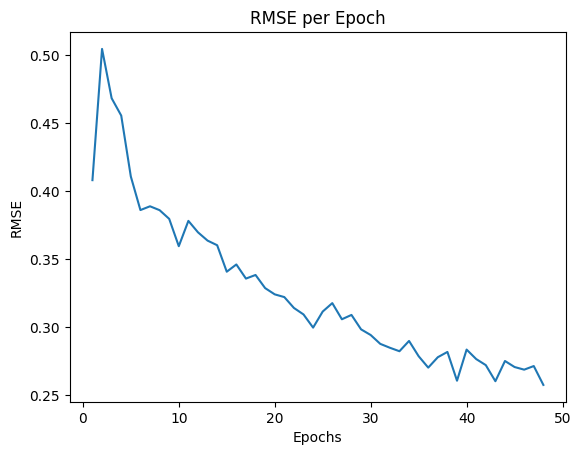

| 25        | -2.669    | 41.01     | 48.16     |
Epoch 1/50, RMSE: 0.3958
Epoch 2/50, RMSE: 0.4959
Epoch 3/50, RMSE: 0.4819
Epoch 4/50, RMSE: 0.4726
Epoch 5/50, RMSE: 0.4533
Epoch 6/50, RMSE: 0.4476
Epoch 7/50, RMSE: 0.4243
Epoch 8/50, RMSE: 0.4210
Epoch 9/50, RMSE: 0.4099
Epoch 10/50, RMSE: 0.4026
Epoch 11/50, RMSE: 0.4178
Epoch 12/50, RMSE: 0.4008
Epoch 13/50, RMSE: 0.4000
Epoch 14/50, RMSE: 0.3943
Epoch 15/50, RMSE: 0.3794
Epoch 16/50, RMSE: 0.3864
Epoch 17/50, RMSE: 0.3715
Epoch 18/50, RMSE: 0.3673
Epoch 19/50, RMSE: 0.3410
Epoch 20/50, RMSE: 0.3437
Epoch 21/50, RMSE: 0.3486
Epoch 22/50, RMSE: 0.3317
Epoch 23/50, RMSE: 0.3236
Epoch 24/50, RMSE: 0.3293
Epoch 25/50, RMSE: 0.3226
Epoch 26/50, RMSE: 0.3132
Epoch 27/50, RMSE: 0.3187
Epoch 28/50, RMSE: 0.3030
Epoch 29/50, RMSE: 0.3047
Epoch 30/50, RMSE: 0.3111
Epoch 31/50, RMSE: 0.2965
Epoch 32/50, RMSE: 0.2948
Epoch 33/50, RMSE: 0.2927
Epoch 34/50, RMSE: 0.2850
Epoch 35/50, RMSE: 0.3019
Epoch 36/50, RMSE: 0.2919
Epoch 37/50, RMSE: 0.28

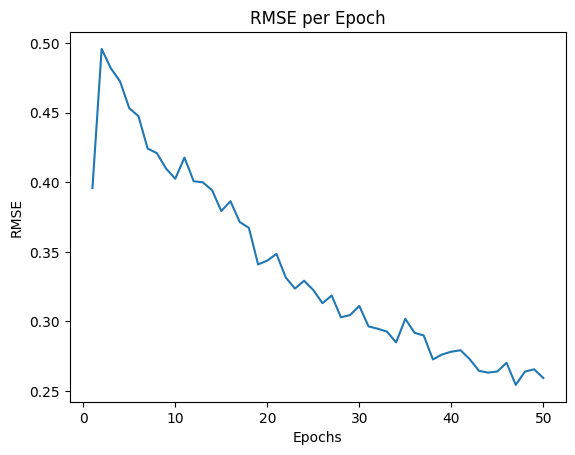

| 26        | -2.656    | 37.71     | 50.0      |
Epoch 1/40, RMSE: 0.3506
Epoch 2/40, RMSE: 0.4379
Epoch 3/40, RMSE: 0.4423
Epoch 4/40, RMSE: 0.3909
Epoch 5/40, RMSE: 0.3872
Epoch 6/40, RMSE: 0.3663
Epoch 7/40, RMSE: 0.3635
Epoch 8/40, RMSE: 0.3604
Epoch 9/40, RMSE: 0.3491
Epoch 10/40, RMSE: 0.3569
Epoch 11/40, RMSE: 0.3489
Epoch 12/40, RMSE: 0.3271
Epoch 13/40, RMSE: 0.3194
Epoch 14/40, RMSE: 0.3311
Epoch 15/40, RMSE: 0.3303
Epoch 16/40, RMSE: 0.3151
Epoch 17/40, RMSE: 0.3167
Epoch 18/40, RMSE: 0.3043
Epoch 19/40, RMSE: 0.3118
Epoch 20/40, RMSE: 0.3010
Epoch 21/40, RMSE: 0.2974
Epoch 22/40, RMSE: 0.2874
Epoch 23/40, RMSE: 0.2925
Epoch 24/40, RMSE: 0.2885
Epoch 25/40, RMSE: 0.2768
Epoch 26/40, RMSE: 0.2770
Epoch 27/40, RMSE: 0.2743
Epoch 28/40, RMSE: 0.2756
Epoch 29/40, RMSE: 0.2678
Epoch 30/40, RMSE: 0.2598
Epoch 31/40, RMSE: 0.2672
Epoch 32/40, RMSE: 0.2594
Epoch 33/40, RMSE: 0.2615
Epoch 34/40, RMSE: 0.2709
Epoch 35/40, RMSE: 0.2659
Epoch 36/40, RMSE: 0.2685
Epoch 37/40, RMSE: 0.26

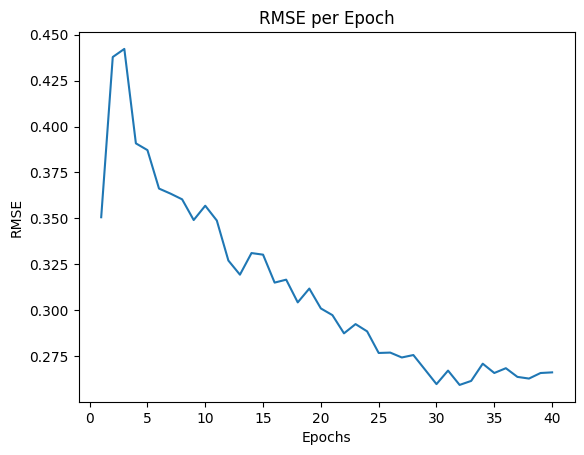

| 27        | -2.655    | 38.8      | 40.08     |
Epoch 1/49, RMSE: 0.4364
Epoch 2/49, RMSE: 0.4161
Epoch 3/49, RMSE: 0.4514
Epoch 4/49, RMSE: 0.4596
Epoch 5/49, RMSE: 0.3829
Epoch 6/49, RMSE: 0.3916
Epoch 7/49, RMSE: 0.4006
Epoch 8/49, RMSE: 0.3890
Epoch 9/49, RMSE: 0.3819
Epoch 10/49, RMSE: 0.3824
Epoch 11/49, RMSE: 0.3745
Epoch 12/49, RMSE: 0.3803
Epoch 13/49, RMSE: 0.3777
Epoch 14/49, RMSE: 0.3660
Epoch 15/49, RMSE: 0.3687
Epoch 16/49, RMSE: 0.3638
Epoch 17/49, RMSE: 0.3632
Epoch 18/49, RMSE: 0.3259
Epoch 19/49, RMSE: 0.3521
Epoch 20/49, RMSE: 0.3198
Epoch 21/49, RMSE: 0.3373
Epoch 22/49, RMSE: 0.3366
Epoch 23/49, RMSE: 0.3295
Epoch 24/49, RMSE: 0.3215
Epoch 25/49, RMSE: 0.3203
Epoch 26/49, RMSE: 0.3248
Epoch 27/49, RMSE: 0.3150
Epoch 28/49, RMSE: 0.3115
Epoch 29/49, RMSE: 0.3109
Epoch 30/49, RMSE: 0.3045
Epoch 31/49, RMSE: 0.3037
Epoch 32/49, RMSE: 0.2943
Epoch 33/49, RMSE: 0.2851
Epoch 34/49, RMSE: 0.2996
Epoch 35/49, RMSE: 0.2759
Epoch 36/49, RMSE: 0.2771
Epoch 37/49, RMSE: 0.26

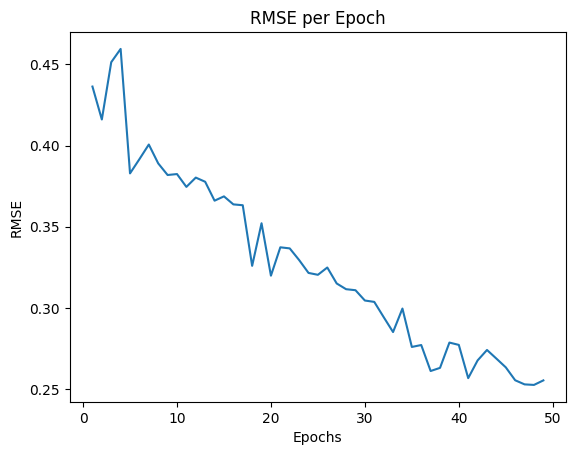

| 28        | -2.621    | 42.0      | 49.85     |
Epoch 1/10, RMSE: 0.5032
Epoch 2/10, RMSE: 0.4943
Epoch 3/10, RMSE: 0.4442
Epoch 4/10, RMSE: 0.4254
Epoch 5/10, RMSE: 0.3765
Epoch 6/10, RMSE: 0.3549
Epoch 7/10, RMSE: 0.3717
Epoch 8/10, RMSE: 0.3661
Epoch 9/10, RMSE: 0.3483
Epoch 10/10, RMSE: 0.3681


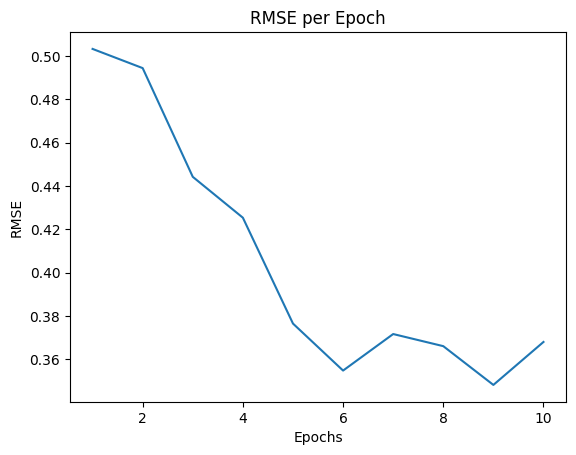

| 29        | -3.619    | 22.8      | 10.0      |
Epoch 1/36, RMSE: 0.5113
Epoch 2/36, RMSE: 0.4779
Epoch 3/36, RMSE: 0.4830
Epoch 4/36, RMSE: 0.4091
Epoch 5/36, RMSE: 0.4062
Epoch 6/36, RMSE: 0.3911
Epoch 7/36, RMSE: 0.3810
Epoch 8/36, RMSE: 0.3975
Epoch 9/36, RMSE: 0.3891
Epoch 10/36, RMSE: 0.3871
Epoch 11/36, RMSE: 0.3855
Epoch 12/36, RMSE: 0.3400
Epoch 13/36, RMSE: 0.3546
Epoch 14/36, RMSE: 0.3574
Epoch 15/36, RMSE: 0.3502
Epoch 16/36, RMSE: 0.3313
Epoch 17/36, RMSE: 0.3546
Epoch 18/36, RMSE: 0.3421
Epoch 19/36, RMSE: 0.3593
Epoch 20/36, RMSE: 0.3484
Epoch 21/36, RMSE: 0.3471
Epoch 22/36, RMSE: 0.3476
Epoch 23/36, RMSE: 0.3416
Epoch 24/36, RMSE: 0.3598
Epoch 25/36, RMSE: 0.3577
Epoch 26/36, RMSE: 0.3446
Epoch 27/36, RMSE: 0.3511
Epoch 28/36, RMSE: 0.3360
Epoch 29/36, RMSE: 0.3275
Epoch 30/36, RMSE: 0.3437
Epoch 31/36, RMSE: 0.3457
Epoch 32/36, RMSE: 0.3319
Epoch 33/36, RMSE: 0.3370
Epoch 34/36, RMSE: 0.3152
Epoch 35/36, RMSE: 0.3248
Epoch 36/36, RMSE: 0.3279


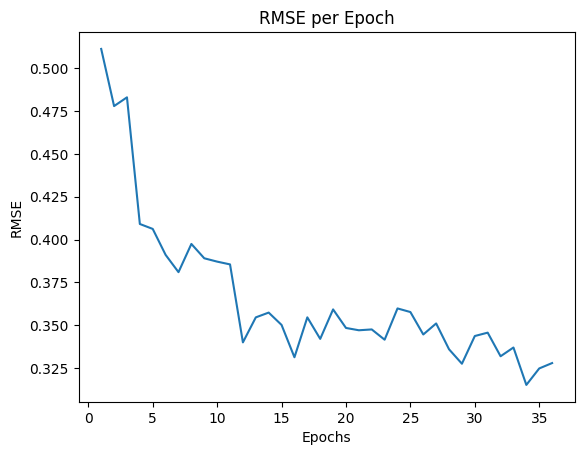

| 30        | -3.278    | 22.2      | 36.5      |
Epoch 1/25, RMSE: 0.4334
Epoch 2/25, RMSE: 0.3992
Epoch 3/25, RMSE: 0.4472
Epoch 4/25, RMSE: 0.3676
Epoch 5/25, RMSE: 0.3714
Epoch 6/25, RMSE: 0.3634
Epoch 7/25, RMSE: 0.3580
Epoch 8/25, RMSE: 0.3952
Epoch 9/25, RMSE: 0.3922
Epoch 10/25, RMSE: 0.4057
Epoch 11/25, RMSE: 0.3864
Epoch 12/25, RMSE: 0.3807
Epoch 13/25, RMSE: 0.3596
Epoch 14/25, RMSE: 0.3911
Epoch 15/25, RMSE: 0.3636
Epoch 16/25, RMSE: 0.3683
Epoch 17/25, RMSE: 0.3733
Epoch 18/25, RMSE: 0.3476
Epoch 19/25, RMSE: 0.3435
Epoch 20/25, RMSE: 0.3428
Epoch 21/25, RMSE: 0.3517
Epoch 22/25, RMSE: 0.3254
Epoch 23/25, RMSE: 0.3322
Epoch 24/25, RMSE: 0.3335
Epoch 25/25, RMSE: 0.3091


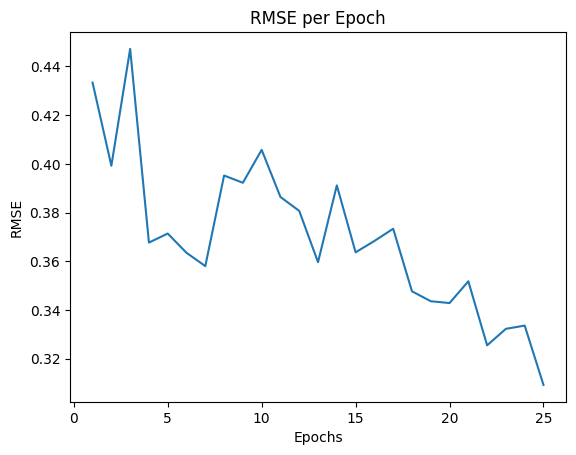

| 31        | -3.106    | 42.14     | 25.71     |
Epoch 1/41, RMSE: 0.4959
Epoch 2/41, RMSE: 0.4374
Epoch 3/41, RMSE: 0.3852
Epoch 4/41, RMSE: 0.3841
Epoch 5/41, RMSE: 0.3787
Epoch 6/41, RMSE: 0.3590
Epoch 7/41, RMSE: 0.3465
Epoch 8/41, RMSE: 0.3141
Epoch 9/41, RMSE: 0.3119
Epoch 10/41, RMSE: 0.3505
Epoch 11/41, RMSE: 0.3313
Epoch 12/41, RMSE: 0.3399
Epoch 13/41, RMSE: 0.3298
Epoch 14/41, RMSE: 0.3266
Epoch 15/41, RMSE: 0.3443
Epoch 16/41, RMSE: 0.3259
Epoch 17/41, RMSE: 0.3201
Epoch 18/41, RMSE: 0.3254
Epoch 19/41, RMSE: 0.3303
Epoch 20/41, RMSE: 0.3167
Epoch 21/41, RMSE: 0.3118
Epoch 22/41, RMSE: 0.3027
Epoch 23/41, RMSE: 0.3094
Epoch 24/41, RMSE: 0.3114
Epoch 25/41, RMSE: 0.2926
Epoch 26/41, RMSE: 0.2903
Epoch 27/41, RMSE: 0.2837
Epoch 28/41, RMSE: 0.2896
Epoch 29/41, RMSE: 0.2759
Epoch 30/41, RMSE: 0.2776
Epoch 31/41, RMSE: 0.2799
Epoch 32/41, RMSE: 0.2748
Epoch 33/41, RMSE: 0.2643
Epoch 34/41, RMSE: 0.2632
Epoch 35/41, RMSE: 0.2517
Epoch 36/41, RMSE: 0.2643
Epoch 37/41, RMSE: 0.26

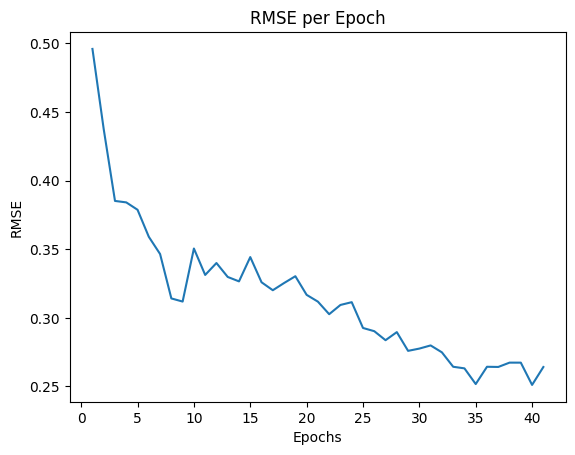

| 32        | -2.772    | 42.82     | 41.71     |
Epoch 1/50, RMSE: 0.4210
Epoch 2/50, RMSE: 0.4086
Epoch 3/50, RMSE: 0.3496
Epoch 4/50, RMSE: 0.4080
Epoch 5/50, RMSE: 0.3569
Epoch 6/50, RMSE: 0.3655
Epoch 7/50, RMSE: 0.3694
Epoch 8/50, RMSE: 0.3582
Epoch 9/50, RMSE: 0.3207
Epoch 10/50, RMSE: 0.3518
Epoch 11/50, RMSE: 0.3488
Epoch 12/50, RMSE: 0.3643
Epoch 13/50, RMSE: 0.3772
Epoch 14/50, RMSE: 0.3800
Epoch 15/50, RMSE: 0.3803
Epoch 16/50, RMSE: 0.3896
Epoch 17/50, RMSE: 0.4113
Epoch 18/50, RMSE: 0.3938
Epoch 19/50, RMSE: 0.3721
Epoch 20/50, RMSE: 0.3998
Epoch 21/50, RMSE: 0.3703
Epoch 22/50, RMSE: 0.3880
Epoch 23/50, RMSE: 0.3728
Epoch 24/50, RMSE: 0.3517
Epoch 25/50, RMSE: 0.3613
Epoch 26/50, RMSE: 0.3523
Epoch 27/50, RMSE: 0.3616
Epoch 28/50, RMSE: 0.3439
Epoch 29/50, RMSE: 0.3416
Epoch 30/50, RMSE: 0.3422
Epoch 31/50, RMSE: 0.3423
Epoch 32/50, RMSE: 0.3425
Epoch 33/50, RMSE: 0.3306
Epoch 34/50, RMSE: 0.3270
Epoch 35/50, RMSE: 0.3318
Epoch 36/50, RMSE: 0.3196
Epoch 37/50, RMSE: 0.32

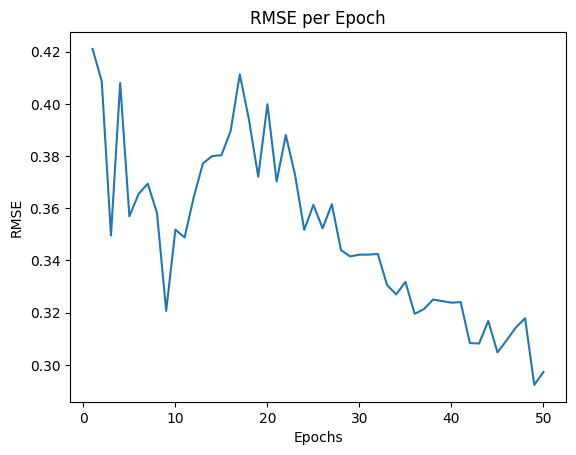

| 33        | -3.031    | 48.2      | 50.0      |
Epoch 1/33, RMSE: 0.4008
Epoch 2/33, RMSE: 0.4112
Epoch 3/33, RMSE: 0.4200
Epoch 4/33, RMSE: 0.3536
Epoch 5/33, RMSE: 0.3402
Epoch 6/33, RMSE: 0.3279
Epoch 7/33, RMSE: 0.3260
Epoch 8/33, RMSE: 0.3238
Epoch 9/33, RMSE: 0.2790
Epoch 10/33, RMSE: 0.3193
Epoch 11/33, RMSE: 0.2912
Epoch 12/33, RMSE: 0.3156
Epoch 13/33, RMSE: 0.3208
Epoch 14/33, RMSE: 0.3076
Epoch 15/33, RMSE: 0.3304
Epoch 16/33, RMSE: 0.3185
Epoch 17/33, RMSE: 0.3176
Epoch 18/33, RMSE: 0.3179
Epoch 19/33, RMSE: 0.3196
Epoch 20/33, RMSE: 0.3002
Epoch 21/33, RMSE: 0.3091
Epoch 22/33, RMSE: 0.3247
Epoch 23/33, RMSE: 0.3130
Epoch 24/33, RMSE: 0.3184
Epoch 25/33, RMSE: 0.2922
Epoch 26/33, RMSE: 0.3085
Epoch 27/33, RMSE: 0.2961
Epoch 28/33, RMSE: 0.3059
Epoch 29/33, RMSE: 0.2889
Epoch 30/33, RMSE: 0.3001
Epoch 31/33, RMSE: 0.2777
Epoch 32/33, RMSE: 0.2958
Epoch 33/33, RMSE: 0.2721


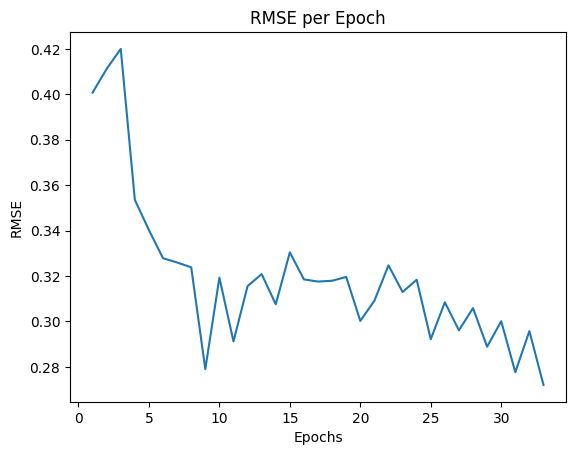

| 34        | -2.762    | 47.24     | 33.13     |
Epoch 1/24, RMSE: 0.4568
Epoch 2/24, RMSE: 0.4068
Epoch 3/24, RMSE: 0.4571
Epoch 4/24, RMSE: 0.4450
Epoch 5/24, RMSE: 0.4168
Epoch 6/24, RMSE: 0.3907
Epoch 7/24, RMSE: 0.4013
Epoch 8/24, RMSE: 0.4122
Epoch 9/24, RMSE: 0.3814
Epoch 10/24, RMSE: 0.3807
Epoch 11/24, RMSE: 0.3751
Epoch 12/24, RMSE: 0.3746
Epoch 13/24, RMSE: 0.3552
Epoch 14/24, RMSE: 0.3486
Epoch 15/24, RMSE: 0.3427
Epoch 16/24, RMSE: 0.3336
Epoch 17/24, RMSE: 0.3211
Epoch 18/24, RMSE: 0.3280
Epoch 19/24, RMSE: 0.3181
Epoch 20/24, RMSE: 0.3184
Epoch 21/24, RMSE: 0.2938
Epoch 22/24, RMSE: 0.3158
Epoch 23/24, RMSE: 0.3002
Epoch 24/24, RMSE: 0.2949


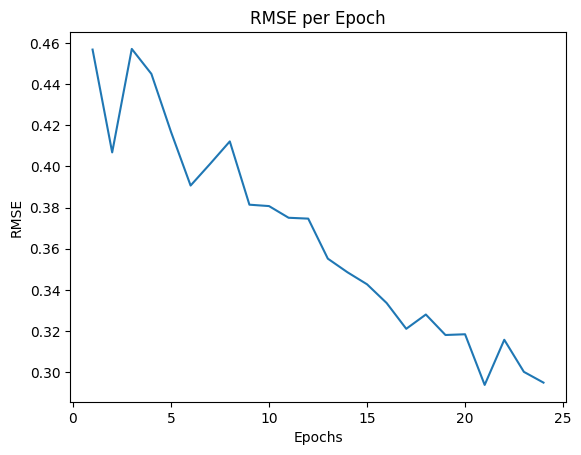

| 35        | -2.94     | 35.37     | 24.03     |
Epoch 1/10, RMSE: 0.5712
Epoch 2/10, RMSE: 0.3882
Epoch 3/10, RMSE: 0.4199
Epoch 4/10, RMSE: 0.3219
Epoch 5/10, RMSE: 0.4555
Epoch 6/10, RMSE: 0.4676
Epoch 7/10, RMSE: 0.5045
Epoch 8/10, RMSE: 0.5261
Epoch 9/10, RMSE: 0.5584
Epoch 10/10, RMSE: 0.5575


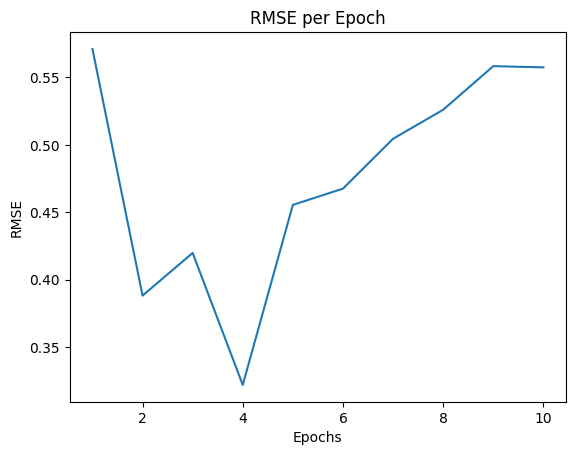

| 36        | -5.561    | 10.04     | 10.09     |
Epoch 1/18, RMSE: 0.3975
Epoch 2/18, RMSE: 0.4524
Epoch 3/18, RMSE: 0.4742
Epoch 4/18, RMSE: 0.4818
Epoch 5/18, RMSE: 0.4496
Epoch 6/18, RMSE: 0.4269
Epoch 7/18, RMSE: 0.4439
Epoch 8/18, RMSE: 0.4277
Epoch 9/18, RMSE: 0.4304
Epoch 10/18, RMSE: 0.4103
Epoch 11/18, RMSE: 0.3890
Epoch 12/18, RMSE: 0.3928
Epoch 13/18, RMSE: 0.3703
Epoch 14/18, RMSE: 0.3804
Epoch 15/18, RMSE: 0.3693
Epoch 16/18, RMSE: 0.3526
Epoch 17/18, RMSE: 0.3608
Epoch 18/18, RMSE: 0.3421


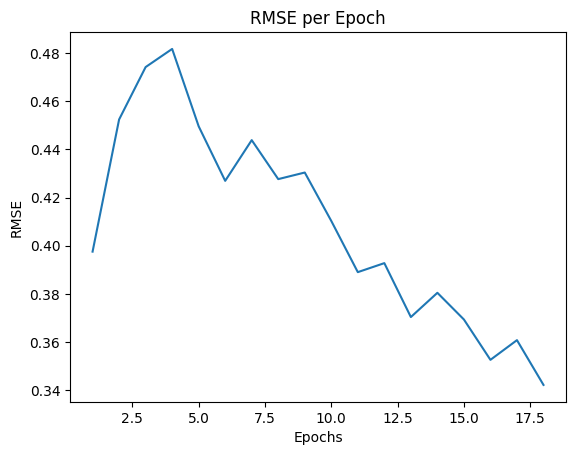

| 37        | -3.433    | 35.82     | 18.41     |
Epoch 1/36, RMSE: 0.4658
Epoch 2/36, RMSE: 0.4800
Epoch 3/36, RMSE: 0.4187
Epoch 4/36, RMSE: 0.3669
Epoch 5/36, RMSE: 0.3569
Epoch 6/36, RMSE: 0.3343
Epoch 7/36, RMSE: 0.3343
Epoch 8/36, RMSE: 0.3003
Epoch 9/36, RMSE: 0.2577
Epoch 10/36, RMSE: 0.2962
Epoch 11/36, RMSE: 0.3067
Epoch 12/36, RMSE: 0.3082
Epoch 13/36, RMSE: 0.3430
Epoch 14/36, RMSE: 0.3156
Epoch 15/36, RMSE: 0.3134
Epoch 16/36, RMSE: 0.3282
Epoch 17/36, RMSE: 0.3395
Epoch 18/36, RMSE: 0.3206
Epoch 19/36, RMSE: 0.3143
Epoch 20/36, RMSE: 0.3165
Epoch 21/36, RMSE: 0.3083
Epoch 22/36, RMSE: 0.3035
Epoch 23/36, RMSE: 0.3131
Epoch 24/36, RMSE: 0.3083
Epoch 25/36, RMSE: 0.2907
Epoch 26/36, RMSE: 0.2939
Epoch 27/36, RMSE: 0.2829
Epoch 28/36, RMSE: 0.2942
Epoch 29/36, RMSE: 0.2956
Epoch 30/36, RMSE: 0.2970
Epoch 31/36, RMSE: 0.2906
Epoch 32/36, RMSE: 0.2697
Epoch 33/36, RMSE: 0.2744
Epoch 34/36, RMSE: 0.2740
Epoch 35/36, RMSE: 0.2728
Epoch 36/36, RMSE: 0.2665


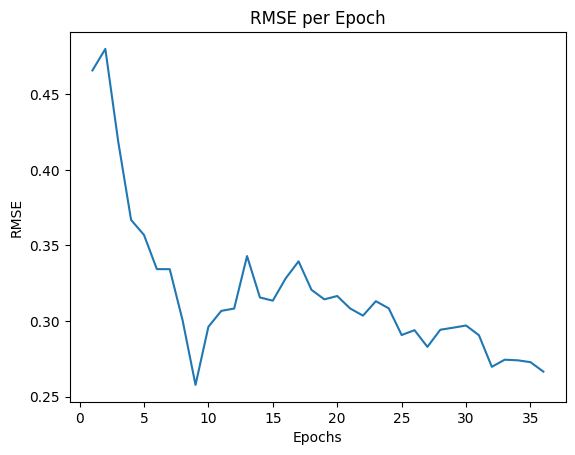

| 38        | -2.712    | 44.23     | 36.91     |
Epoch 1/19, RMSE: 0.4579
Epoch 2/19, RMSE: 0.3952
Epoch 3/19, RMSE: 0.3934
Epoch 4/19, RMSE: 0.3235
Epoch 5/19, RMSE: 0.3584
Epoch 6/19, RMSE: 0.3444
Epoch 7/19, RMSE: 0.3210
Epoch 8/19, RMSE: 0.3821
Epoch 9/19, RMSE: 0.3401
Epoch 10/19, RMSE: 0.3693
Epoch 11/19, RMSE: 0.3616
Epoch 12/19, RMSE: 0.3706
Epoch 13/19, RMSE: 0.3722
Epoch 14/19, RMSE: 0.3815
Epoch 15/19, RMSE: 0.3828
Epoch 16/19, RMSE: 0.3945
Epoch 17/19, RMSE: 0.3824
Epoch 18/19, RMSE: 0.3950
Epoch 19/19, RMSE: 0.3786


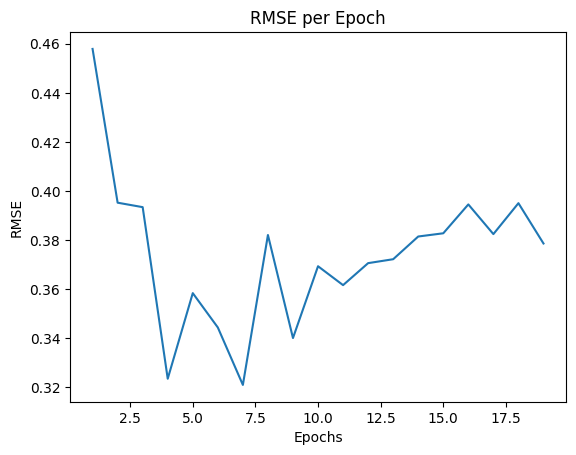

| 39        | -3.833    | 49.9      | 19.48     |
Epoch 1/42, RMSE: 0.4217
Epoch 2/42, RMSE: 0.4259
Epoch 3/42, RMSE: 0.3935
Epoch 4/42, RMSE: 0.4126
Epoch 5/42, RMSE: 0.3950
Epoch 6/42, RMSE: 0.3739
Epoch 7/42, RMSE: 0.3482
Epoch 8/42, RMSE: 0.3372
Epoch 9/42, RMSE: 0.2802
Epoch 10/42, RMSE: 0.2886
Epoch 11/42, RMSE: 0.2566
Epoch 12/42, RMSE: 0.2644
Epoch 13/42, RMSE: 0.2585
Epoch 14/42, RMSE: 0.2529
Epoch 15/42, RMSE: 0.2505
Epoch 16/42, RMSE: 0.2620
Epoch 17/42, RMSE: 0.2567
Epoch 18/42, RMSE: 0.2698
Epoch 19/42, RMSE: 0.2591
Epoch 20/42, RMSE: 0.2558
Epoch 21/42, RMSE: 0.2513
Epoch 22/42, RMSE: 0.2741
Epoch 23/42, RMSE: 0.2684
Epoch 24/42, RMSE: 0.2513
Epoch 25/42, RMSE: 0.2579
Epoch 26/42, RMSE: 0.2584
Epoch 27/42, RMSE: 0.2584
Epoch 28/42, RMSE: 0.2654
Epoch 29/42, RMSE: 0.2716
Epoch 30/42, RMSE: 0.2698
Epoch 31/42, RMSE: 0.2722
Epoch 32/42, RMSE: 0.2718
Epoch 33/42, RMSE: 0.2562
Epoch 34/42, RMSE: 0.2577
Epoch 35/42, RMSE: 0.2631
Epoch 36/42, RMSE: 0.2544
Epoch 37/42, RMSE: 0.26

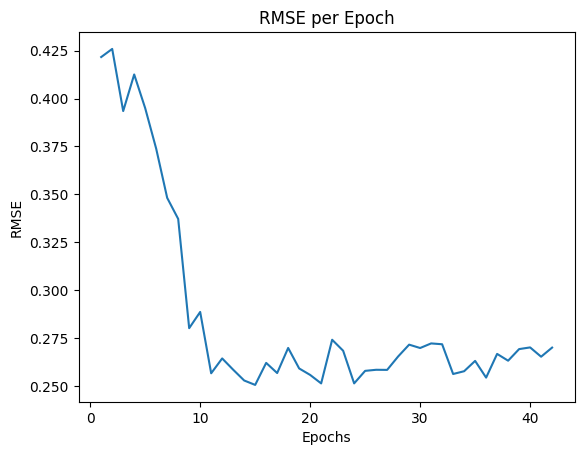

| 40        | -2.701    | 25.04     | 42.87     |
Mejores hiperparámetros: Epochs=50, Batch size=39
Epoch 1/50, RMSE: 0.4355
Epoch 2/50, RMSE: 0.4364
Epoch 3/50, RMSE: 0.4376
Epoch 4/50, RMSE: 0.3905
Epoch 5/50, RMSE: 0.3508
Epoch 6/50, RMSE: 0.3655
Epoch 7/50, RMSE: 0.3614
Epoch 8/50, RMSE: 0.3963
Epoch 9/50, RMSE: 0.3289
Epoch 10/50, RMSE: 0.3429
Epoch 11/50, RMSE: 0.3464
Epoch 12/50, RMSE: 0.3518
Epoch 13/50, RMSE: 0.3346
Epoch 14/50, RMSE: 0.3387
Epoch 15/50, RMSE: 0.3372
Epoch 16/50, RMSE: 0.3150
Epoch 17/50, RMSE: 0.3246
Epoch 18/50, RMSE: 0.3342
Epoch 19/50, RMSE: 0.3333
Epoch 20/50, RMSE: 0.3159
Epoch 21/50, RMSE: 0.3023
Epoch 22/50, RMSE: 0.3218
Epoch 23/50, RMSE: 0.3126
Epoch 24/50, RMSE: 0.2990
Epoch 25/50, RMSE: 0.3039
Epoch 26/50, RMSE: 0.2936
Epoch 27/50, RMSE: 0.2983
Epoch 28/50, RMSE: 0.2935
Epoch 29/50, RMSE: 0.2743
Epoch 30/50, RMSE: 0.2889
Epoch 31/50, RMSE: 0.2779
Epoch 32/50, RMSE: 0.2579
Epoch 33/50, RMSE: 0.2651
Epoch 34/50, RMSE: 0.2695
Epoch 35/50, RMSE: 0.2614

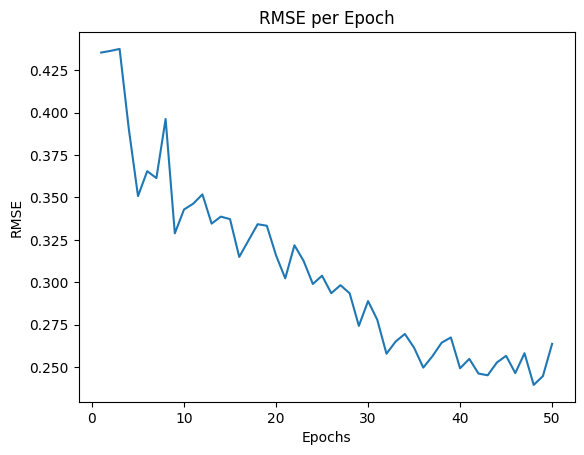

SklearnWrapper(batch_size=39, epochs=50, input_dim=9)

In [67]:
# import numpy as np
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from sklearn.base import BaseEstimator, RegressorMixin
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import mean_squared_error
# import matplotlib.pyplot as plt
# from bayes_opt import BayesianOptimization

# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.values.reshape(-1, 1)  # Convertir y a un array de NumPy y redimensionar
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# def train_evaluate_ANN(epochs, batch_size):
#     input_dim = X_train_gapc.shape[1]
#     ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=int(epochs), batch_size=int(batch_size))
#     ann_wrapper.fit(X_train_gapc, y_train_gapc)
    
#     y_pred = ann_wrapper.predict(X_test_gapc)
#     mse = mean_squared_error(y_test_gapc, y_pred)
#     rmse = np.sqrt(mse)
#     return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# pbounds = {
#     'epochs': (10, 50),
#     'batch_size': (10, 50)
# }

# optimizer = BayesianOptimization(
#     f=train_evaluate_ANN,
#     pbounds=pbounds,
#     random_state=42
# )

# optimizer.maximize(init_points=10, n_iter=30)

# best_params = optimizer.max['params']
# best_epochs = int(best_params['epochs'])
# best_batch_size = int(best_params['batch_size'])

# print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}')

# input_dim = X_train_gapc.shape[1]

# ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=best_epochs, batch_size=best_batch_size)
# ann_wrapper.fit(X_train_gapc, y_train_gapc)

In [68]:
# # Guardar el modelo entrenado
# joblib.dump(ann_wrapper, 'ann_model_gapc.pkl')

# # Cargar el modelo entrenado
# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# # Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.reshape(-1, 1)
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# if __name__ == "__main__":
#     # Cargar el modelo entrenado
#     loaded_model_ann_gapc = joblib.load('ann_model_gapc.pkl')

#     # Predecir con el modelo entrenado
#     y_pred_ann_gapc = loaded_model_ann_gapc.predict(X_test_gapc)
    
#     # Calcular las métricas
#     mse_ann_gapc = mean_squared_error(y_test_gapc, y_pred_ann_gapc)
#     rmse_ann_gapc = np.sqrt(mse_ann_gapc)
#     mae_ann_gapc = mean_absolute_error(y_test_gapc, y_pred_ann_gapc)
#     r2_ann_gapc = r2_score(y_test_gapc, y_pred_ann_gapc)
    
#     # Imprimier las métricas
#     print(f"Mean Squared Error (MSE): {mse_ann_gapc:.5f}")
#     print(f"Root Mean Squared Error (RMSE): {rmse_ann_gapc:.5f}")
#     print(f"Mean Absolute Error (MAE): {mae_ann_gapc:.5f}")
#     print(f"R-squared (R^2): {r2_ann_gapc:.5f}")

Mean Squared Error (MSE): 7.68159
Root Mean Squared Error (RMSE): 2.77157
Mean Absolute Error (MAE): 2.22331
R-squared (R^2): 0.92964


### Desarrollo y ajuste de un modelo **XGBoost** en GAPC

In [200]:
# Definición de la función de validación cruzada
def xgb_cv(n_estimators, max_depth, learning_rate, subsample, colsample_bytree, gamma, min_child_weight):
    model = XGBRegressor(
        n_estimators=int(n_estimators), 
        max_depth=int(max_depth), 
        learning_rate=learning_rate, 
        subsample=subsample, 
        colsample_bytree=colsample_bytree, 
        gamma=gamma, 
        min_child_weight=min_child_weight, 
        objective='reg:squarederror',
        n_jobs=-1
    )
    model.fit(X_train_gapc, y_train_gapc)
    y_pred = model.predict(X_test_gapc)
    return -mean_squared_error(y_test_gapc, y_pred)

# Optimización bayesiana para XGBoost
xgb_optimizer = BayesianOptimization(
    f=xgb_cv,
    pbounds={
        'n_estimators': (10, 200),
        'max_depth': (1, 20),
        'learning_rate': (0.01, 0.3),
        'subsample': (0.5, 1.0),
        'colsample_bytree': (0.5, 1.0),
        'gamma': (0, 5),
        'min_child_weight': (1, 10)
    },
    random_state=42
)

xgb_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para XGBoost
best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
best_learning_rate = xgb_optimizer.max['params']['learning_rate']
best_subsample = xgb_optimizer.max['params']['subsample']
best_colsample_bytree = xgb_optimizer.max['params']['colsample_bytree']
best_gamma = xgb_optimizer.max['params']['gamma']
best_min_child_weight = xgb_optimizer.max['params']['min_child_weight']

# Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
xgb_model_gapc = XGBRegressor(
    n_estimators=best_n_estimators, 
    max_depth=best_max_depth, 
    learning_rate=best_learning_rate, 
    subsample=best_subsample, 
    colsample_bytree=best_colsample_bytree, 
    gamma=best_gamma, 
    min_child_weight=best_min_child_weight, 
    objective='reg:squarederror',
    n_jobs=-1
)
xgb_model_gapc.fit(X_train_gapc, y_train_gapc)


|   iter    |  target   | colsam... |   gamma   | learni... | max_depth | min_ch... | n_esti... | subsample |
-------------------------------------------------------------------------------------------------------------
| 1         | -1.971    | 0.6873    | 4.754     | 0.2223    | 12.37     | 2.404     | 39.64     | 0.529     |
| 2         | -1.216    | 0.9331    | 3.006     | 0.2153    | 1.391     | 9.729     | 168.2     | 0.6062    |
| 3         | -1.87     | 0.5909    | 0.917     | 0.09823   | 10.97     | 4.888     | 65.33     | 0.8059    |
| 4         | -1.803    | 0.5697    | 1.461     | 0.1162    | 9.665     | 8.067     | 47.94     | 0.7571    |
| 5         | -2.076    | 0.7962    | 0.2323    | 0.1862    | 4.24      | 1.585     | 190.3     | 0.9828    |
| 6         | -10.59    | 0.9042    | 1.523     | 0.03832   | 14.0      | 4.961     | 33.19     | 0.7476    |
| 7         | -1.821    | 0.5172    | 4.547     | 0.08505   | 13.59     | 3.805     | 108.8     | 0.7734    |
| 8       

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.6783766633467947, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=1.4046725484369038,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.16738186411589207,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=8.219772826786357, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=24,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [201]:
print(f"n_estimators: {best_n_estimators}")
print(f"max_depth: {best_max_depth}")
print(f"learning_rate: {best_learning_rate}")
print(f"subsample: {best_subsample}")
print(f"colsample_bytree: {best_colsample_bytree}")
print(f"gamma: {best_gamma}")
print(f"min_child_weight: {best_min_child_weight}")

n_estimators: 24
max_depth: 3
learning_rate: 0.16738186411589207
subsample: 0.9934434683002586
colsample_bytree: 0.6783766633467947
gamma: 1.4046725484369038
min_child_weight: 8.219772826786357


In [59]:
# def xgb_cv(n_estimators, max_depth, learning_rate):
#     model = XGBRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth), learning_rate=learning_rate, objective='reg:squarederror')
#     model.fit(X_train_gapc, y_train_gapc)
#     y_pred = model.predict(X_test_gapc)
#     return -mean_squared_error(y_test_gapc, y_pred)

# # Optimización bayesiana para XGBoost
# xgb_optimizer = BayesianOptimization(
#     f=xgb_cv,
#     pbounds={
#         'n_estimators': (10, 200),
#         'max_depth': (1, 20),
#         'learning_rate': (0.01, 0.3)
#     },
#     random_state=42
# )

# xgb_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para XGBoost
# best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
# best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
# best_learning_rate = xgb_optimizer.max['params']['learning_rate']

# # Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
# xgb_model_gapc = XGBRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth, learning_rate=best_learning_rate, objective='reg:squarederror')
# xgb_model_gapc.fit(X_train_gapc, y_train_gapc)

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
| 1         | -2.641    | 0.1186    | 19.06     | 149.1     |
| 2         | -1.134    | 0.1836    | 3.964     | 39.64     |
| 3         | -2.664    | 0.02684   | 17.46     | 124.2     |
| 4         | -1.179    | 0.2153    | 1.391     | 194.3     |
| 5         | -2.02     | 0.2514    | 5.034     | 44.55     |
| 6         | -1.908    | 0.06319   | 6.781     | 109.7     |
| 7         | -2.373    | 0.1353    | 6.533     | 126.3     |
| 8         | -1.737    | 0.05045   | 6.551     | 79.61     |
| 9         | -2.681    | 0.1423    | 15.92     | 47.94     |
| 10        | -2.809    | 0.1591    | 12.26     | 18.83     |
| 11        | -1.433    | 0.1021    | 5.445     | 37.54     |
| 12        | -1.503    | 0.3       | 1.0       | 37.56     |
| 13        | -5.43     | 0.01313   | 1.21      | 199.1     |
| 14        | -61.38    | 0.01      | 1.553     | 40.47     |
| 15    

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.03695842141189637,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=1, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=196, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [202]:
# Guardar el modelo entrenado
joblib.dump(xgb_model_gapc, 'xgb_model_gapc.pkl')

# Cargar el modelo entrenado
loaded_model_xgb_gapc = joblib.load('xgb_model_gapc.pkl')
loaded_model_xgb_gapc

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.6783766633467947, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=1.4046725484369038,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.16738186411589207,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=8.219772826786357, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=24,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [203]:
# Evaluar el modelo
y_pred_xgb_gapc = loaded_model_xgb_gapc.predict(X_test_gapc)
xgb_mse_gapc = mean_squared_error(y_test_gapc, y_pred_xgb_gapc)

# Calcular las métricas
mse_xgb_gapc = mean_squared_error(y_test_gapc, y_pred_xgb_gapc)
rmse_xgb_gapc = np.sqrt(mse_xgb_gapc)
mae_xgb_gapc = mean_absolute_error(y_test_gapc, y_pred_xgb_gapc)
r2_xgb_gapc = r2_score(y_test_gapc, y_pred_xgb_gapc)

# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_xgb_gapc:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_xgb_gapc:.5f}")
print(f"Mean Absolute Error (MAE): {mae_xgb_gapc:.5f}")
print(f"R-squared (R^2): {r2_xgb_gapc:.5f}")

Mean Squared Error (MSE): 0.99523
Root Mean Squared Error (RMSE): 0.99761
Mean Absolute Error (MAE): 0.75078
R-squared (R^2): 0.99088


In [204]:
# Guardamos las predicciones que se necesitarán más adelante
# Convertir las predicciones a un DataFrame de pandas
y_pred_xgb_gapc = pd.DataFrame(y_pred_xgb_gapc, columns=['pred_xgb_gapc'])

# Guardar el DataFrame como un archivo CSV
y_pred_xgb_gapc.to_csv('y_pred_xgb_gapc.csv', index=False)

### Desarrollo y ajuste de un modelo **KNN** en GAPC

In [220]:
# Normalizar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_gapc)
X_test_scaled = scaler.transform(X_test_gapc)

# Reducir dimensionalidad con PCA
pca = PCA(n_components=0.95)  # Retener 95% de la varianza
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Definir el modelo KNN
knn = KNeighborsRegressor()

# Definir los hiperparámetros a optimizar
param_grid = {
    'n_neighbors': (1, 30),
    'leaf_size': (10, 50),
    'p': (1, 2),  # 1 para Manhattan, 2 para Euclídea
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski']
}

# Configurar la búsqueda bayesiana
opt = BayesSearchCV(
    knn,
    param_grid,
    n_iter=50,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=1
)

# Ejecutar la búsqueda bayesiana
opt.fit(X_train_pca, y_train_gapc)

# Imprimir los mejores hiperparámetros encontrados
print("Best Hyperparameters: ", opt.best_params_)

# Entrenar el modelo con los mejores hiperparámetros
best_knn_gapc = opt.best_estimator_
best_knn_gapc.fit(X_train_pca, y_train_gapc)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=23, n_neighbors=30)

In [221]:
# Imprimir los mejores hiperparámetros encontrados uno por uno
best_params = opt.best_params_
print("Best Hyperparameters:")
for param, value in best_params.items():
    print(f"{param}: {value}")

Best Hyperparameters:
algorithm: auto
leaf_size: 23
metric: minkowski
n_neighbors: 30
p: 2
weights: uniform


In [63]:
# # Normalizar los datos
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_gapc)
# X_test_scaled = scaler.transform(X_test_gapc)

# # Reducir dimensionalidad con PCA
# pca = PCA(n_components=0.95)  # Retener 95% de la varianza
# X_train_pca = pca.fit_transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # Definir el modelo KNN
# knn = KNeighborsRegressor()

# # Definir los hiperparámetros a optimizar
# param_grid = {
#     'n_neighbors': (1, 30),
#     'leaf_size': (10, 50),
#     'p': (1, 2)  # 1 para Manhattan, 2 para Euclídea
# }

# # Configurar la búsqueda bayesiana
# opt = BayesSearchCV(
#     knn,
#     param_grid,
#     n_iter=50,
#     cv=5,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=1
# )

# # Ejecutar la búsqueda bayesiana
# opt.fit(X_train_pca, y_train_gapc)

# # Imprimir los mejores hiperparámetros encontrados
# print("Best Hyperparameters: ", opt.best_params_)

# # Entrenar el modelo con los mejores hiperparámetros
# best_knn_gapc = opt.best_estimator_
# best_knn_gapc.fit(X_train_pca, y_train_gapc)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=10, n_neighbors=30)

In [222]:
# Guardar el modelo entrenado
joblib.dump(best_knn_gapc, 'knn_model_gapc.pkl')

# Cargar el modelo entrenado
loaded_model_knn_gapc = joblib.load('knn_model_gapc.pkl')
loaded_model_knn_gapc

KNeighborsRegressor(leaf_size=23, n_neighbors=30)

In [223]:
# Predecir y evaluar el modelo
y_pred_knn_gapc = loaded_model_knn_gapc.predict(X_test_pca)

# Calcular las métricas
mae_knn_gapc = mean_absolute_error(y_test_gapc, y_pred_knn_gapc)
mse_knn_gapc = mean_squared_error(y_test_gapc, y_pred_knn_gapc)
rmse_knn_gapc = np.sqrt(mse_knn_gapc)
r2_knn_gapc = r2_score(y_test_gapc, y_pred_knn_gapc)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_knn_gapc:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_knn_gapc:.5f}")
print(f"Mean Absolute Error (MAE): {mae_knn_gapc:.5f}")
print(f"R-squared (R^2): {r2_knn_gapc:.5f}")

Mean Squared Error (MSE): 2.33126
Root Mean Squared Error (RMSE): 1.52685
Mean Absolute Error (MAE): 1.08494
R-squared (R^2): 0.97865


In [224]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_knn_gapc = pd.DataFrame(y_pred_knn_gapc, columns=['pred_knn_gapc'])

# Guardar el DataFrame como un archivo CSV
pred_knn_gapc.to_csv('y_pred_knn_gapc.csv', index=False)

### Modelos y métricas

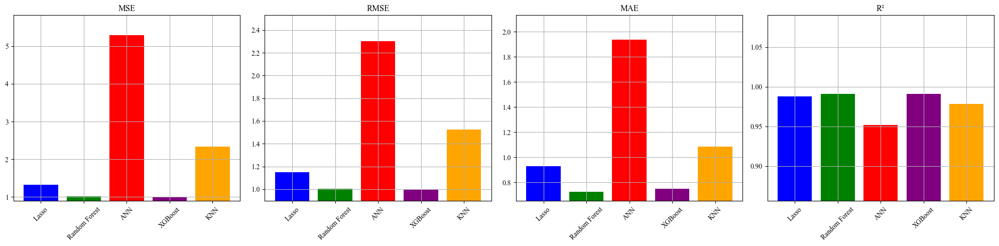

In [389]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'Random Forest', 'ANN', 'XGBoost', 'KNN']
scores = {
    'Lasso': [mse_lasso_gapc, rmse_lasso_gapc, mae_lasso_gapc, r2_lasso_gapc],
    'Random Forest': [mse_rf_gapc, rmse_rf_gapc, mae_rf_gapc, r2_rf_gapc],
    'ANN': [mse_ann_gapc, rmse_ann_gapc, mae_ann_gapc, r2_ann_gapc],
    'XGBoost': [mse_xgb_gapc, rmse_xgb_gapc, mae_xgb_gapc, r2_xgb_gapc],
    'KNN': [mse_knn_gapc, rmse_knn_gapc, mae_knn_gapc, r2_knn_gapc]
}

# Subplots
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs[i]
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'red', 'purple', 'orange'])
    ax.set_title(f'{metric}')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=45)
    ax.grid(True)

plt.tight_layout()
plt.show()
plt.show()
plt.show()

El modelo con más bajo rendimiento fue el ANN. 

### **Ensamble Heterogéneo** con todos los modelos

Epoch 1/20, RMSE: 0.3258
Epoch 2/20, RMSE: 0.3111
Epoch 3/20, RMSE: 0.5175
Epoch 4/20, RMSE: 0.6501
Epoch 5/20, RMSE: 0.4563
Epoch 6/20, RMSE: 0.3878
Epoch 7/20, RMSE: 0.3767
Epoch 8/20, RMSE: 0.2573
Epoch 9/20, RMSE: 0.2747
Epoch 10/20, RMSE: 0.3997
Epoch 11/20, RMSE: 0.2447
Epoch 12/20, RMSE: 0.2455
Epoch 13/20, RMSE: 0.2599
Epoch 14/20, RMSE: 0.2394
Epoch 15/20, RMSE: 0.2272
Epoch 16/20, RMSE: 0.2798
Epoch 17/20, RMSE: 0.2574
Epoch 18/20, RMSE: 0.2584
Epoch 19/20, RMSE: 0.2750
Epoch 20/20, RMSE: 0.2430


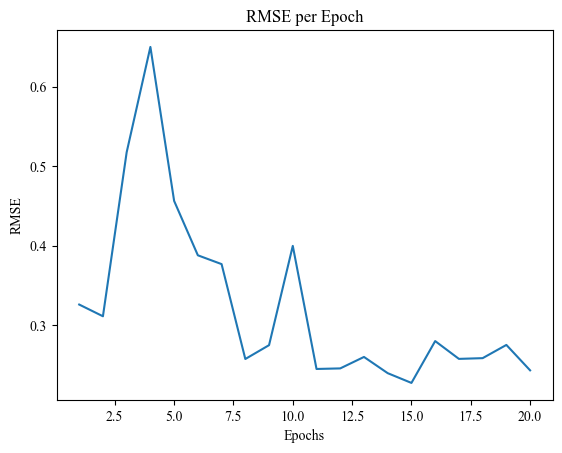

VotingRegressor(estimators=[('lasso',
                             Pipeline(steps=[('scaler',
                                              StandardScaler(with_mean=False)),
                                             ('lasso',
                                              Lasso(alpha=0.021563909801506645,
                                                    max_iter=849,
                                                    tol=0.01819067847103799))])),
                            ('rf',
                             RandomForestRegressor(max_depth=4,
                                                   max_features=0.9726261649881027,
                                                   min_samples_leaf=15,
                                                   min_samples_split=18,
                                                   n_estimators=180)),
                            ('ann',
                             SklearnWrapper(batch_size=42,
                                            dr...
                                          learning_rate=0.16738186411589207,
                                          max_bin=None, max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=3,
                                          max_leaves=None,
                                          min_child_weight=8.219772826786357,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=24,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...)),
                            ('knn',
                             KNeighborsRegressor(leaf_size=23,
                                                 n_neighbors=30))])

In [390]:
ensemble_model_gapc = VotingRegressor(estimators=[
    ('lasso', loaded_model_lasso_gapc),
    ('rf', loaded_model_rf_gapc),
    ('ann', loaded_model_ann_gapc),
    ('xgb', loaded_model_xgb_gapc),
    ('knn', loaded_model_knn_gapc)
])

# Entrenar el modelo ensemble
ensemble_model_gapc.fit(X_train_gapc, y_train_gapc)

In [391]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_gapc, 'ensemble_model_gapc.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_gapc = joblib.load('ensemble_model_gapc.pkl')

In [392]:
# Evaluar el modelo ensemble
y_pred_ensamble_gapc = loaded_model_esemble_gapc.predict(X_test_gapc)

In [393]:
# Méttricas
mae_ensamble_gapc = mean_absolute_error(y_test_gapc, y_pred_ensamble_gapc) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_gapc = mean_squared_error(y_test_gapc, y_pred_ensamble_gapc) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_gapc = np.sqrt(mse_ensamble_gapc) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_gapc = r2_score(y_test_gapc, y_pred_ensamble_gapc) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Medio Absoluto (MAE): {mae_ensamble_gapc:.5f}")
print(f"Error Cuadrático Medio (MSE): {mse_ensamble_gapc:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_gapc:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_gapc:.5f}")

Error Medio Absoluto (MAE): 0.89169
Error Cuadrático Medio (MSE): 1.22261
Raíz del Error Cuadrático Medio (RMSE): 1.10572
Coeficiente de Determinación (R^2): 0.98880


### **Ensamble Heterogéneo** con los modelos seleccionados

In [402]:
ensemble_model_gapc_select = VotingRegressor(estimators=[
    ('lasso', loaded_model_lasso_gapc),
    ('rf', loaded_model_rf_gapc),
    #('ann', loaded_model_ann_gapc),
    ('xgb', loaded_model_xgb_gapc),
    #('knn', loaded_model_knn_gapc)
])

# Entrenar el modelo ensemble
ensemble_model_gapc_select.fit(X_train_gapc, y_train_gapc)

VotingRegressor(estimators=[('lasso',
                             Pipeline(steps=[('scaler',
                                              StandardScaler(with_mean=False)),
                                             ('lasso',
                                              Lasso(alpha=0.021563909801506645,
                                                    max_iter=849,
                                                    tol=0.01819067847103799))])),
                            ('rf',
                             RandomForestRegressor(max_depth=4,
                                                   max_features=0.9726261649881027,
                                                   min_samples_leaf=15,
                                                   min_samples_split=18,
                                                   n_estimators=180)),
                            ('xgb',
                             XGBRegressor(base_score=None, bo...
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=0.16738186411589207,
                                          max_bin=None, max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=3,
                                          max_leaves=None,
                                          min_child_weight=8.219772826786357,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=24,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...))])

In [403]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_gapc_select, 'ensemble_model_gapc_select.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_gapc = joblib.load('ensemble_model_gapc_select.pkl')

In [404]:
# Evaluar el modelo ensemble
y_pred_ensamble_gapc_select = loaded_model_esemble_gapc.predict(X_test_gapc)

In [405]:
# Méttricas
mae_ensamble_gapc_select = mean_absolute_error(y_test_gapc, y_pred_ensamble_gapc_select) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_gapc_select = mean_squared_error(y_test_gapc, y_pred_ensamble_gapc_select) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_gapc_select = np.sqrt(mse_ensamble_gapc_select) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_gapc_select = r2_score(y_test_gapc, y_pred_ensamble_gapc_select) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Medio Absoluto (MAE): {mae_ensamble_gapc_select:.5f}")
print(f"Error Cuadrático Medio (MSE): {mse_ensamble_gapc_select:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_gapc_select:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_gapc_select:.5f}")

Error Medio Absoluto (MAE): 0.69679
Error Cuadrático Medio (MSE): 0.73709
Raíz del Error Cuadrático Medio (RMSE): 0.85854
Coeficiente de Determinación (R^2): 0.99325


In [406]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ensamble_select_gapc = pd.DataFrame(y_pred_ensamble_gapc_select, columns=['pred_ensamble_select_gapc'])

# Guardar el DataFrame como un archivo CSV
pred_ensamble_select_gapc.to_csv('y_pred_ensamble_gapc_select.csv', index=False)

### Modelos y métricas con ensambles

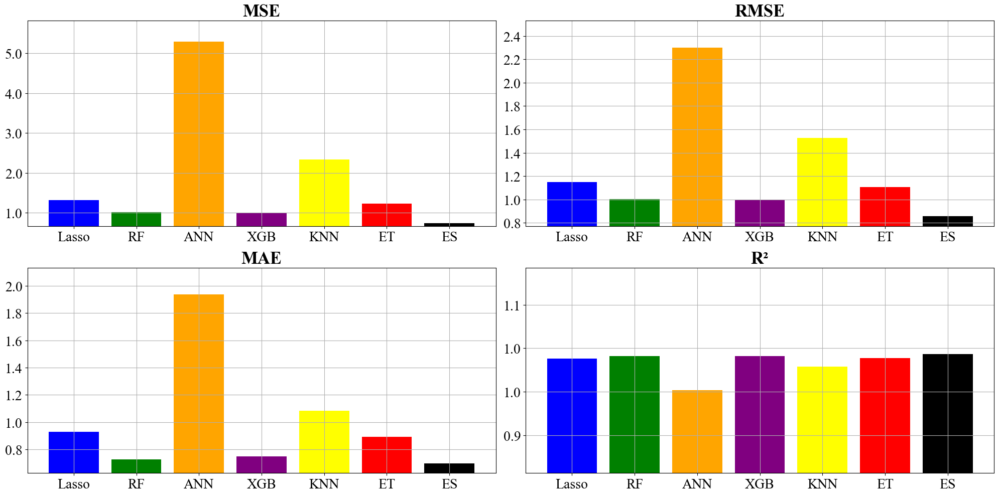

In [407]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'RF', 'ANN', 'XGB', 'KNN', 'ET', 'ES']
scores = {
    'Lasso': [mse_lasso_gapc, rmse_lasso_gapc, mae_lasso_gapc, r2_lasso_gapc],
    'RF': [mse_rf_gapc, rmse_rf_gapc, mae_rf_gapc, r2_rf_gapc],
    'ANN': [mse_ann_gapc, rmse_ann_gapc, mae_ann_gapc, r2_ann_gapc],
    'XGB': [mse_xgb_gapc, rmse_xgb_gapc, mae_xgb_gapc, r2_xgb_gapc],
    'KNN': [mse_knn_gapc, rmse_knn_gapc, mae_knn_gapc, r2_knn_gapc], 
    'ET': [mse_ensamble_gapc, rmse_ensamble_gapc, mae_ensamble_gapc, r2_ensamble_gapc],
    'ES': [mse_ensamble_gapc_select, rmse_ensamble_gapc_select, mae_ensamble_gapc_select, r2_ensamble_gapc_select]
}

# Subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 10))  # Ajustar tamaño para una mejor visualización

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs.flat[i]  # Acceder correctamente a cada subtrama
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'orange', 'purple', 'yellow', 'red', 'black'])
    ax.set_title(f'{metric}', fontsize=25, fontweight='bold')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=0, fontsize=20)
    y_ticks = ax.get_yticks()
    ax.set_yticklabels([f'{y_tick:.1f}' for y_tick in y_ticks], fontsize=20)
    ax.grid(True)

plt.tight_layout()

# Guardar la figura completa en un archivo
plt.savefig('model_performance_metrics_gapc.png', dpi=300)

plt.show()


### Comparación de modelos en el batch 68

In [82]:
# Cargar las predicciones
load_pred_lasso_gapc = pd.read_csv(r'y_pred_lasso_gapc.csv')
load_pred_rf_gapc = pd.read_csv(r'y_pred_rf_gapc.csv')
load_pred_ann_gapc = pd.read_csv(r'y_pred_ann_gapc.csv')
load_pred_xgb_gapc = pd.read_csv(r'y_pred_xgb_gapc.csv')
load_pred_knn_gapc = pd.read_csv(r'y_pred_knn_gapc.csv')
load_pred_ensamble_select_gapc = pd.read_csv(r'y_pred_ensamble_gapc_select.csv')

In [83]:
# se hace un reset a los índices de gapc_test para poder concatenar 
gapc_test_reset = gapc_test.reset_index(drop=True)
# concatenar 
data_select_pred_gapc = pd.concat([gapc_test_reset, load_pred_lasso_gapc, load_pred_rf_gapc, load_pred_ann_gapc,
                                     load_pred_xgb_gapc, load_pred_knn_gapc, load_pred_ensamble_select_gapc], axis=1).reset_index(drop=True)

In [90]:
# Batch 68
batch_68_select = data_select_pred_gapc[data_select_pred_gapc['Batch'] == 68]

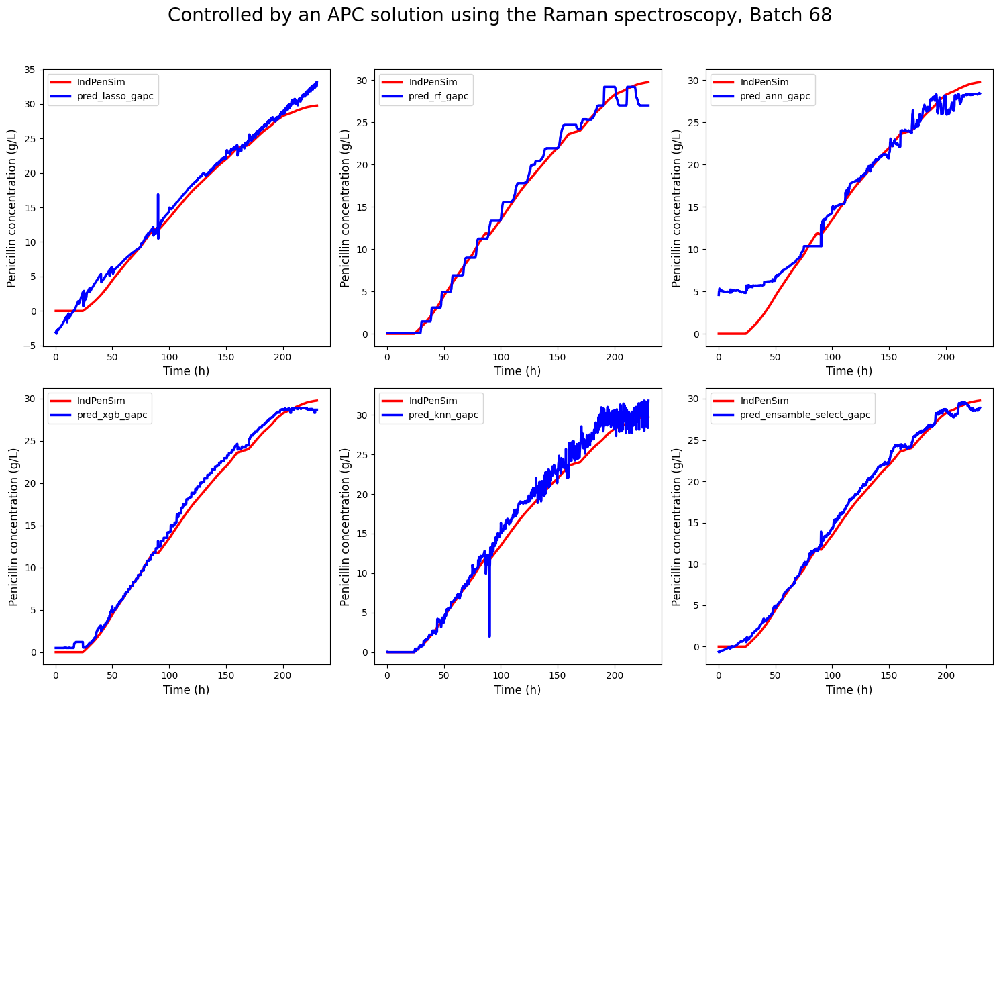

In [85]:
# Predicciones
pred_columns = [
    'pred_lasso_gapc', 'pred_rf_gapc', 'pred_ann_gapc',
    'pred_xgb_gapc', 'pred_knn_gapc', 'pred_ensamble_select_gapc'
]

# Series de pandas a arrays de NumPy
x = batch_68_select['Time (h)'].to_numpy()
y1 = batch_68_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Titulo
fig.suptitle("Controlled by an APC solution using the Raman spectroscopy, Batch 68", fontsize=20)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_68_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=pred_columns[i], linewidth=2.5)
        #ax.set_title(pred_columns[i], fontsize=15)
        ax.set_xlabel("Time (h)", fontsize=12)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=12)
        ax.tick_params(axis='both', which='major', labelsize=10)
        ax.legend(fontsize=10)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
plt.show()

#### Graficamos los modelos seleccionados y el ensamble

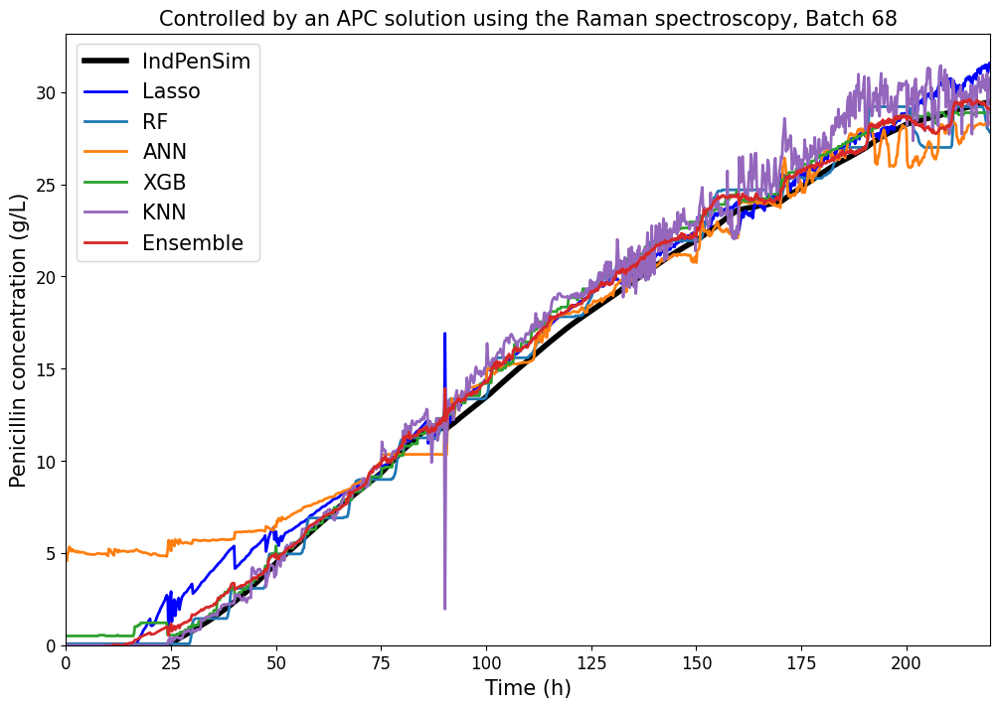

In [91]:
# Predicciones
pred_columns = ['pred_lasso_gapc',
    'pred_rf_gapc', 'pred_ann_gapc',
    'pred_xgb_gapc', 'pred_knn_gapc', 'pred_ensamble_select_gapc'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_gapc': 'blue',
    'pred_rf_gapc': '#1f77b4',
    'pred_ann_gapc': '#ff7f0e',
    'pred_xgb_gapc': '#2ca02c',
    'pred_knn_gapc': '#9467bd',
    'pred_ensamble_select_gapc': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_gapc': 'Lasso',
    'pred_rf_gapc': 'RF',
    'pred_ann_gapc': 'ANN',
    'pred_xgb_gapc': 'XGB',
    'pred_knn_gapc': 'KNN',
    'pred_ensamble_select_gapc': 'Ensemble'
}

# Series de pandas a arrays de NumPy
x = batch_68_select['Time (h)'].to_numpy()
y1 = batch_68_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_68_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_68_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 68", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

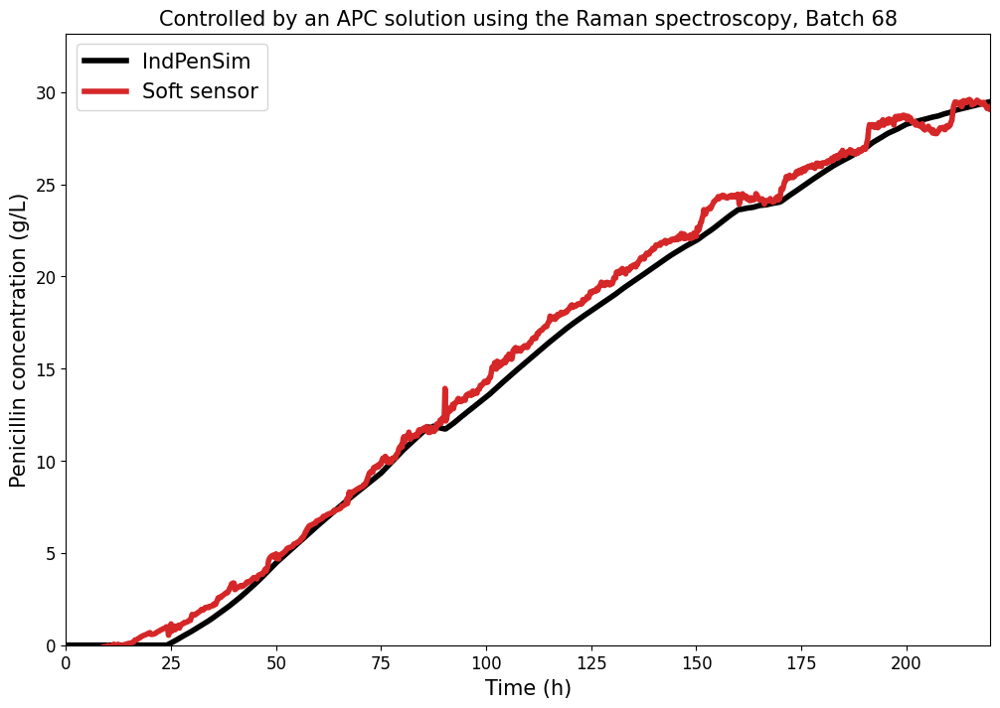

In [92]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_gapc': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_68_select['Time (h)'].to_numpy()
y1 = batch_68_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_68_select['pred_ensamble_select_gapc'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_gapc'])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_68_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 68", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

### Comparación de modelos en el batch 86

In [408]:
# Cargar las predicciones
load_pred_lasso_gapc = pd.read_csv(r'y_pred_lasso_gapc.csv')
load_pred_rf_gapc = pd.read_csv(r'y_pred_rf_gapc.csv')
load_pred_ann_gapc = pd.read_csv(r'y_pred_ann_gapc.csv')
load_pred_xgb_gapc = pd.read_csv(r'y_pred_xgb_gapc.csv')
load_pred_knn_gapc = pd.read_csv(r'y_pred_knn_gapc.csv')
load_pred_ensamble_select_gapc = pd.read_csv(r'y_pred_ensamble_gapc_select.csv')

In [409]:
# se hace un reset a los índices de gapc_test para poder concatenar 
gapc_test_reset = gapc_test.reset_index(drop=True)
# concatenar 
data_select_pred_gapc = pd.concat([gapc_test_reset, load_pred_lasso_gapc, load_pred_rf_gapc, load_pred_ann_gapc,
                                     load_pred_xgb_gapc, load_pred_knn_gapc, load_pred_ensamble_select_gapc], axis=1).reset_index(drop=True)

In [410]:
# Batch 86
batch_86_select = data_select_pred_gapc[data_select_pred_gapc['Batch'] == 86]

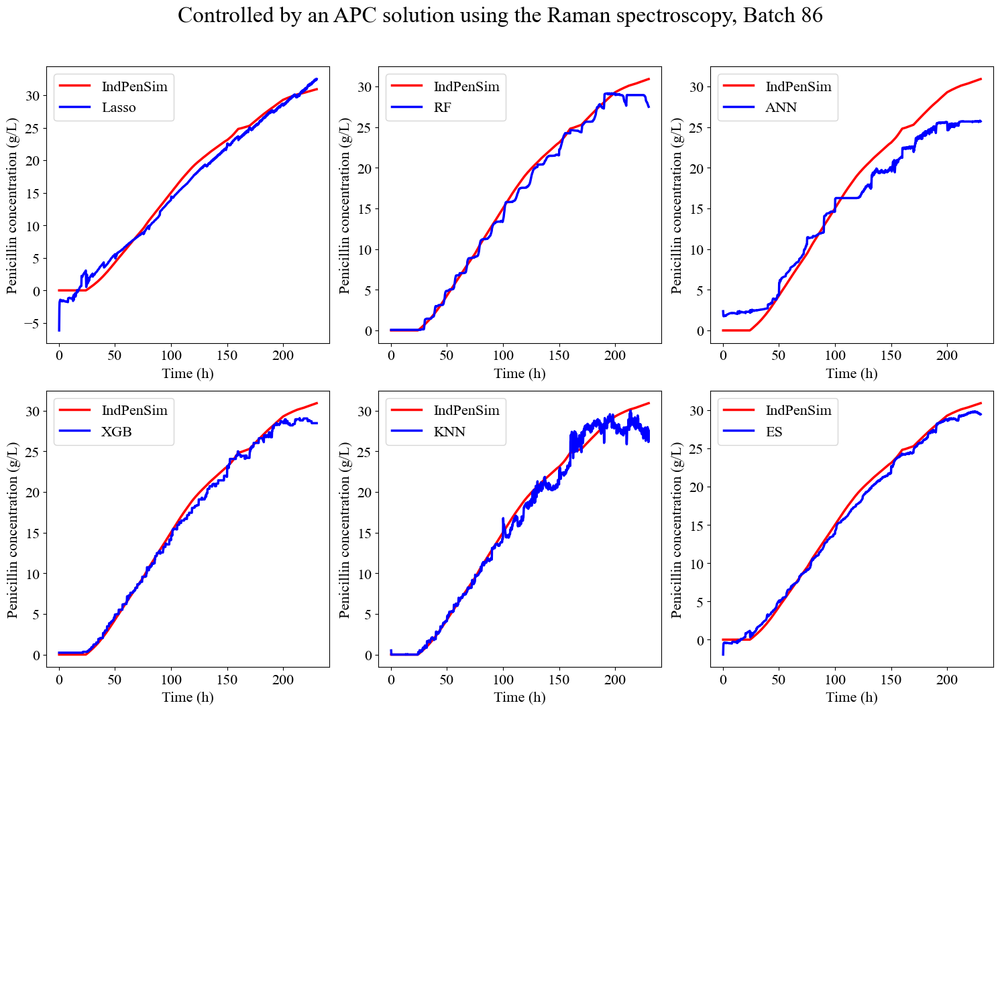

In [440]:
# Configurar matplotlib para usar Times New Roman
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = ['Times New Roman']

# Predicciones
pred_columns = [
    'pred_lasso_gapc', 'pred_rf_gapc', 'pred_ann_gapc',
    'pred_xgb_gapc', 'pred_knn_gapc', 'pred_ensamble_select_gapc'
]

# Nuevos nombres para las columnas
column_names = {
    'pred_lasso_gapc': 'Lasso',
    'pred_rf_gapc': 'RF',
    'pred_ann_gapc': 'ANN',
    'pred_xgb_gapc': 'XGB',
    'pred_knn_gapc': 'KNN',
    'pred_ensamble_select_gapc': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_86_select['Time (h)'].to_numpy()
y1 = batch_86_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Título
fig.suptitle("Controlled by an APC solution using the Raman spectroscopy, Batch 86", fontsize=24)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_86_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=column_names[pred_columns[i]], linewidth=2.5)
        #ax.set_title(column_names[pred_columns[i]], fontsize=18)
        ax.set_xlabel("Time (h)", fontsize=16)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=16)
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.legend(fontsize=16)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
fig.subplots_adjust(bottom=0.0001, top=0.92)  # Ajustar el espacio en la parte inferior y superior

# Guardar la figura completa en un archivo
plt.savefig('model_performance_gapc_batch_86.png', dpi=300, bbox_inches='tight')

plt.show()


#### Graficamos los modelos seleccionados y el ensamble

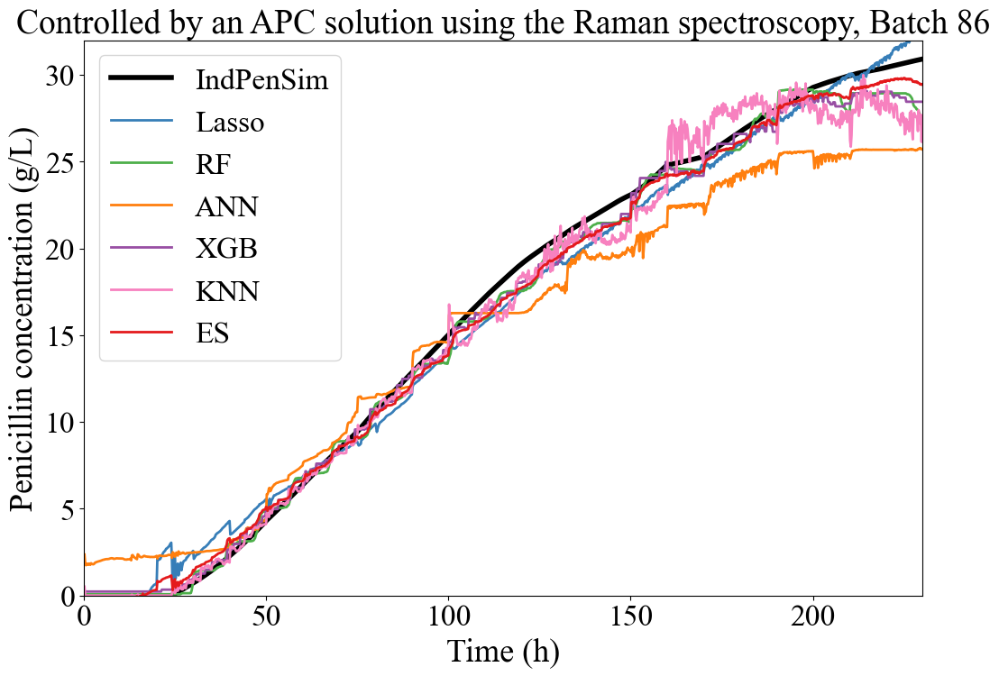

In [444]:
# Predicciones
pred_columns = ['pred_lasso_gapc',
    'pred_rf_gapc', 'pred_ann_gapc',
    'pred_xgb_gapc', 'pred_knn_gapc', 'pred_ensamble_select_gapc'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_gapc': '#377eb8',  # Ajustado a un azul más contrastante
    'pred_rf_gapc': '#4daf4a',     # Ajustado a un verde más claro
    'pred_ann_gapc': '#ff7f0e',    # Naranja
    'pred_xgb_gapc': '#984ea3',    # Púrpura más oscuro
    'pred_knn_gapc': '#f781bf',    # Rojo más brillante
    'pred_ensamble_select_gapc': '#e41a1c' # Rosa más claro e41a1c
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_gapc': 'Lasso',
    'pred_rf_gapc': 'RF',
    'pred_ann_gapc': 'ANN',
    'pred_xgb_gapc': 'XGB',
    'pred_knn_gapc': 'KNN',
    'pred_ensamble_select_gapc': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_86_select['Time (h)'].to_numpy()
y1 = batch_86_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_86_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 32)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 86", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('model_performance_gapc_batch_86_join.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

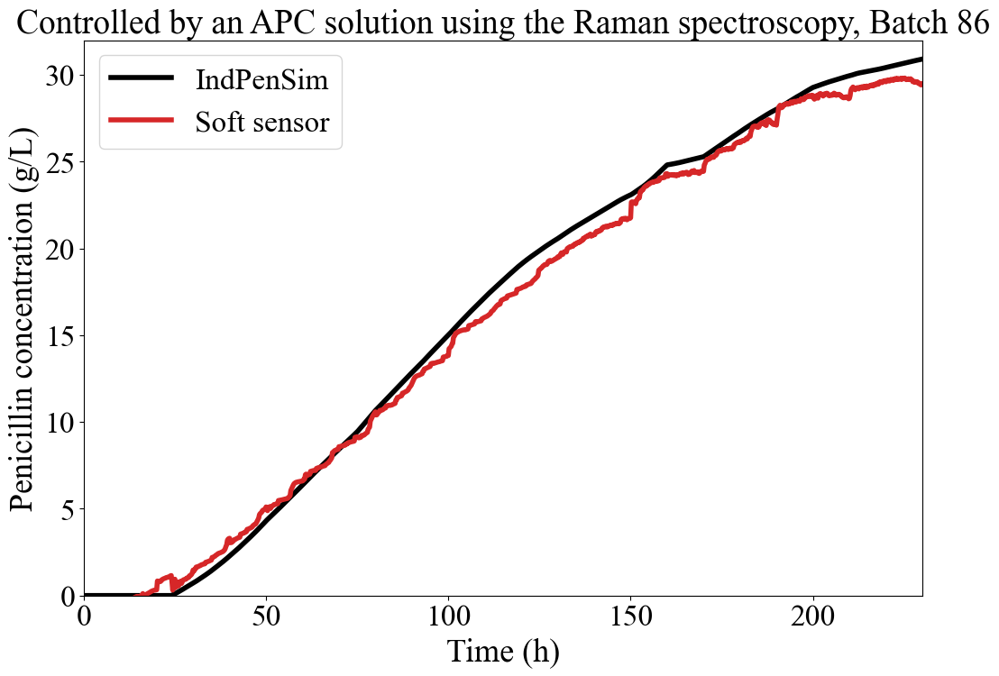

In [443]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_gapc': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_86_select['Time (h)'].to_numpy()
y1 = batch_86_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_86_select['pred_ensamble_select_gapc'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_gapc'])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 32)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 86", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('soft_sensor_batch_86_gapc.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

#### Graficamos los modelos seleccionados y el ensamble

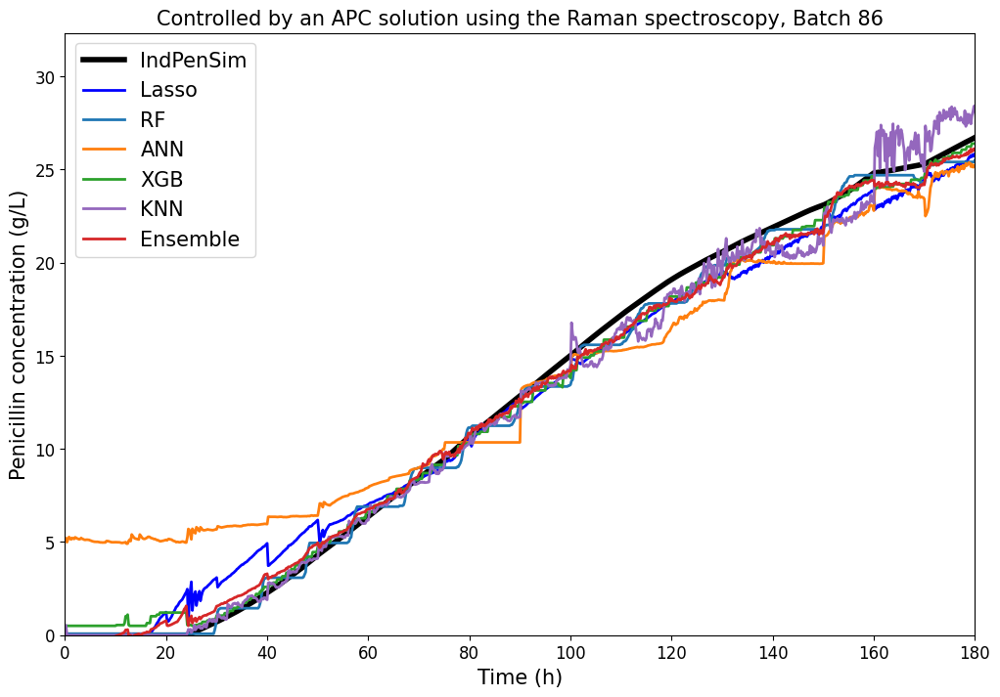

In [101]:
# Predicciones
pred_columns = ['pred_lasso_gapc',
    'pred_rf_gapc', 'pred_ann_gapc',
    'pred_xgb_gapc', 'pred_knn_gapc', 'pred_ensamble_select_gapc'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_gapc': 'blue',
    'pred_rf_gapc': '#1f77b4',
    'pred_ann_gapc': '#ff7f0e',
    'pred_xgb_gapc': '#2ca02c',
    'pred_knn_gapc': '#9467bd',
    'pred_ensamble_select_gapc': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_gapc': 'Lasso',
    'pred_rf_gapc': 'RF',
    'pred_ann_gapc': 'ANN',
    'pred_xgb_gapc': 'XGB',
    'pred_knn_gapc': 'KNN',
    'pred_ensamble_select_gapc': 'Ensemble'
}

# Series de pandas a arrays de NumPy
x = batch_86_select['Time (h)'].to_numpy()
y1 = batch_86_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_86_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 180)
plt.ylim(0, max(y1.max(), *[batch_86_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 86", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

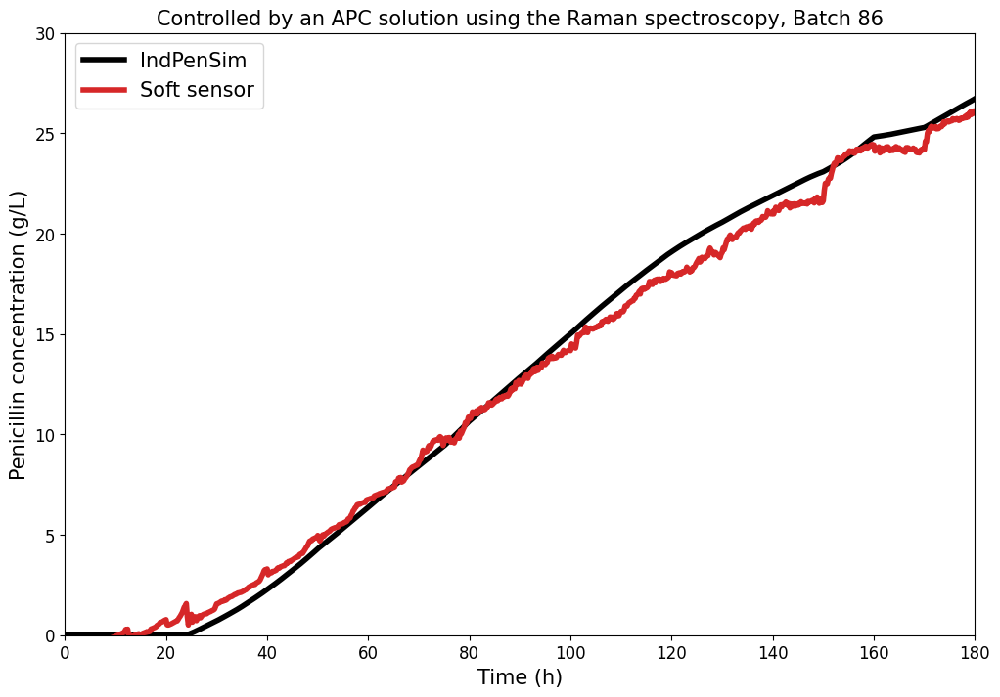

In [102]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_gapc': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_86_select['Time (h)'].to_numpy()
y1 = batch_86_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_86_select['pred_ensamble_select_gapc'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_gapc'])

# Límites del eje x e y
plt.xlim(0, 180)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Controlled by an APC solution using the Raman spectroscopy, Batch 86", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

# **Faults resulting in process deviations**

In [103]:
# Se realiza el particionamiento en train y en test con la estratégia de control: Contienen fallos que provocan
# desviaciones del proceso.

id_gfaults_train = [92, 96, 97, 94, 98, 93, 95, 99]
id_gfaults_test = [91, 100]

# Utilizar una comprensión de lista para obtener los grupos
faults_train = [data_select.groupby('Batch').get_group(id) for id in id_gfaults_train]
faults_test = [data_select.groupby('Batch').get_group(id) for id in id_gfaults_test]

# Combinar los grupos
gfaults_train = pd.concat(faults_train)
gfaults_test = pd.concat(faults_test)

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train_gfaults = gfaults_train.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_train_gfaults = gfaults_train["Penicillin concentration(P:g/L)"]
X_test_gfaults = gfaults_test.drop(['Batch','Penicillin concentration(P:g/L)'], axis=1)
y_test_gfaults = gfaults_test["Penicillin concentration(P:g/L)"]

### Desarrollo y ajuste de un modelo **Lasso** en Gfaults

In [163]:
# Función para entrenar y evaluar un modelo Lasso con más hiperparámetros
def lasso_cv(alpha, max_iter, tol, fit_intercept, normalize):
    fit_intercept = bool(round(fit_intercept))
    normalize = bool(round(normalize))
    
    model = Pipeline([
        ('scaler', StandardScaler(with_mean=normalize)),
        ('lasso', Lasso(alpha=alpha, max_iter=int(max_iter), tol=tol, fit_intercept=fit_intercept))
    ])
    model.fit(X_train_gfaults, y_train_gfaults)
    y_pred = model.predict(X_test_gfaults)
    return -mean_squared_error(y_test_gfaults, y_pred)

# Espacio de búsqueda para la optimización bayesiana
pbounds = {
    'alpha': (0.001, 1),
    'max_iter': (100, 1000),
    'tol': (1e-5, 1e-1),
    'fit_intercept': (0, 1),  
    'normalize': (0, 1)       
}

# Optimización bayesiana para Lasso
lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds=pbounds, random_state=42, allow_duplicate_points=True)
lasso_optimizer.maximize(init_points=10, n_iter=30)

# Obtener el mejor conjunto de hiperparámetros para Lasso
best_params = lasso_optimizer.max['params']
best_alpha = best_params['alpha']
best_max_iter = int(best_params['max_iter'])
best_tol = best_params['tol']
best_fit_intercept = bool(round(best_params['fit_intercept']))
best_normalize = bool(round(best_params['normalize']))

# Entrenar el modelo Lasso con los mejores hiperparámetros
lasso_model_gfaults = Pipeline([
    ('scaler', StandardScaler(with_mean=best_normalize)),
    ('lasso', Lasso(alpha=best_alpha, max_iter=best_max_iter, tol=best_tol, fit_intercept=best_fit_intercept))
])
lasso_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   |   alpha   | fit_in... | max_iter  | normalize |    tol    |
-------------------------------------------------------------------------------------
| 1         | -49.78    | 0.3752    | 0.9507    | 758.8     | 0.5987    | 0.01561   |
| 2         | -54.47    | 0.1568    | 0.05808   | 879.6     | 0.6011    | 0.07081   |
| 3         | -53.59    | 0.02156   | 0.9699    | 849.2     | 0.2123    | 0.01819   |
| 4         | -51.71    | 0.1842    | 0.3042    | 572.3     | 0.4319    | 0.02913   |
| 5         | -49.02    | 0.6122    | 0.1395    | 362.9     | 0.3664    | 0.04561   |
| 6         | -48.96    | 0.7854    | 0.1997    | 562.8     | 0.5924    | 0.004655  |
| 7         | -51.32    | 0.6079    | 0.1705    | 158.5     | 0.9489    | 0.09656   |
| 8         | -48.79    | 0.8086    | 0.3046    | 187.9     | 0.6842    | 0.04402   |
| 9         | -54.49    | 0.1229    | 0.4952    | 130.9     | 0.9093    | 0.02589   |
| 10        | -50.32    | 0.6629    | 0.3117    | 568.

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso', Lasso(fit_intercept=False, max_iter=209, tol=1e-05))])

In [164]:
print(f"Best alpha: {best_alpha}")
print(f"Best max_iter: {best_max_iter}")
print(f"Best tol: {best_tol}")
print(f"Best fit_intercept: {best_fit_intercept}")
print(f"Best normalize: {best_normalize}")

Best alpha: 1.0
Best max_iter: 209
Best tol: 1e-05
Best fit_intercept: False
Best normalize: False


In [104]:
# # Definir una función para entrenar y evaluar un modelo Lasso
# def lasso_cv(alpha):
#     model = Lasso(alpha=alpha)
#     model.fit(X_train_gfaults, y_train_gfaults)
#     y_pred = model.predict(X_test_gfaults)
#     return -mean_squared_error(y_test_gfaults, y_pred)

# # Optimización bayesiana para Lasso
# lasso_optimizer = BayesianOptimization(f=lasso_cv, pbounds={'alpha': (0.001, 1)}, random_state=42, allow_duplicate_points=True)
# lasso_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener el mejor valor de alpha para Lasso
# best_alpha = lasso_optimizer.max['params']['alpha']

# # Entrenar el modelo Lasso con el mejor valor de alpha
# lasso_model_gfaults = Lasso(alpha=best_alpha)
# lasso_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   |   alpha   |
-------------------------------------
| 1         | -53.53    | 0.3752    |
| 2         | -53.12    | 0.9508    |
| 3         | -53.23    | 0.7323    |
| 4         | -53.32    | 0.5991    |
| 5         | -53.81    | 0.1569    |
| 6         | -53.81    | 0.1568    |
| 7         | -53.75    | 0.05903   |
| 8         | -53.16    | 0.8663    |
| 9         | -53.32    | 0.6015    |
| 10        | -53.24    | 0.7084    |
| 11        | -53.11    | 1.0       |
Data point [1.] is not unique. 1 duplicates registered. Continuing ...
| 12        | -53.11    | 1.0       |
Data point [1.] is not unique. 2 duplicates registered. Continuing ...
| 13        | -53.11    | 1.0       |
Data point [1.] is not unique. 3 duplicates registered. Continuing ...
| 14        | -53.11    | 1.0       |
Data point [1.] is not unique. 4 duplicates registered. Continuing ...
| 15        | -53.11    | 1.0       |
Data point [1.] is not unique. 5 duplicates registered. Continuing ...

Lasso()

In [165]:
# Guardar el modelo entrenado
joblib.dump(lasso_model_gfaults, 'lasso_model_gfaults.pkl')

# Cargar el modelo entrenado
loaded_model_lasso_gfaults = joblib.load('lasso_model_gfaults.pkl')
loaded_model_lasso_gfaults

Pipeline(steps=[('scaler', StandardScaler(with_mean=False)),
                ('lasso', Lasso(fit_intercept=False, max_iter=209, tol=1e-05))])

In [166]:
# Predecir con el modelo entrenado
y_pred_lasso_gfaults = loaded_model_lasso_gfaults.predict(X_test_gfaults)

# Calcular las métricas
mse_lasso_gfaults = mean_squared_error(y_test_gfaults, y_pred_lasso_gfaults)
rmse_lasso_gfaults = np.sqrt(mse_lasso_gfaults)
mae_lasso_gfaults = mean_absolute_error(y_test_gfaults, y_pred_lasso_gfaults)
r2_lasso_gfaults = r2_score(y_test_gfaults, y_pred_lasso_gfaults)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_lasso_gfaults:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_lasso_gfaults:.5f}")
print(f"Mean Absolute Error (MAE): {mae_lasso_gfaults:.5f}")
print(f"R-squared (R^2): {r2_lasso_gfaults:.5f}")

Mean Squared Error (MSE): 47.82110
Root Mean Squared Error (RMSE): 6.91528
Mean Absolute Error (MAE): 6.09323
R-squared (R^2): -3.52384


In [167]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_lasso_gfaults = pd.DataFrame(y_pred_lasso_gfaults, columns=['pred_lasso_gfaults'])

# Guardar el DataFrame como un archivo CSV
pred_lasso_gfaults.to_csv('y_pred_lasso_gfaults.csv', index=False)

### Desarrollo y ajuste de un modelo **Random Forest** en Gfaults

In [175]:
# Definir una función para entrenar y evaluar un modelo Random Forest
def rf_cv(n_estimators, max_depth, max_features, min_samples_split, min_samples_leaf, bootstrap):
    model = RandomForestRegressor(
        n_estimators=int(n_estimators),
        max_depth=int(max_depth),
        max_features=max_features,
        min_samples_split=int(min_samples_split),
        min_samples_leaf=int(min_samples_leaf),
        bootstrap=bootstrap > 0.5  # Convierte a booleano
    )
    model.fit(X_train_gfaults, y_train_gfaults)
    y_pred = model.predict(X_test_gfaults)
    return -mean_squared_error(y_test_gfaults, y_pred)

# Optimización bayesiana para Random Forest
pbounds = {
    'n_estimators': (10, 200),
    'max_depth': (1, 20),
    'max_features': (0.1, 1.0),  # Se asume un valor flotante entre 0.1 y 1.0
    'min_samples_split': (2, 20),
    'min_samples_leaf': (1, 20),
    'bootstrap': (0, 1)  # Se usará 0 para False y 1 para True
}

rf_optimizer = BayesianOptimization(f=rf_cv, pbounds=pbounds, random_state=42)
rf_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para Random Forest
best_params = rf_optimizer.max['params']
best_n_estimators = int(best_params['n_estimators'])
best_max_depth = int(best_params['max_depth'])
best_max_features = best_params['max_features']
best_min_samples_split = int(best_params['min_samples_split'])
best_min_samples_leaf = int(best_params['min_samples_leaf'])
best_bootstrap = best_params['bootstrap'] > 0.5

# Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
rf_model_gfaults = RandomForestRegressor(
    n_estimators=best_n_estimators,
    max_depth=best_max_depth,
    max_features=best_max_features,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    bootstrap=best_bootstrap
)
rf_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   | bootstrap | max_depth | max_fe... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------------------
| 1         | -27.31    | 0.3745    | 19.06     | 0.7588    | 12.37     | 4.808     | 39.64     |
| 2         | -25.51    | 0.05808   | 17.46     | 0.641     | 14.45     | 2.371     | 194.3     |
| 3         | -29.59    | 0.8324    | 5.034     | 0.2636    | 4.485     | 7.476     | 109.7     |
| 4         | -29.1     | 0.4319    | 6.533     | 0.6507    | 3.65      | 7.259     | 79.61     |
| 5         | -29.67    | 0.4561    | 15.92     | 0.2797    | 10.77     | 12.66     | 18.83     |
| 6         | -28.51    | 0.6075    | 4.24      | 0.1585    | 19.03     | 19.38     | 163.6     |
| 7         | -40.47    | 0.3046    | 2.856     | 0.7158    | 9.363     | 4.197     | 104.1     |
| 8         | -25.33    | 0.03439   | 18.28     | 0.3329    | 13.59     | 7.611     | 108.8     |
| 9         | -35.66

RandomForestRegressor(max_depth=20, max_features=0.1, min_samples_leaf=5,
                      n_estimators=74)

In [176]:
#print(f"Best params: {best_params}")
print(f"Best n estimators: {best_n_estimators}")
print(f"Best max depth: {best_max_depth}")
print(f"Best max features: {best_max_features}")
print(f"Best min samples split: {best_min_samples_split}")
print(f"Best min samples leaf: {best_min_samples_leaf}")
print(f"Best best_bootstrap: {best_bootstrap}")

Best n estimators: 74
Best max depth: 20
Best max features: 0.1
Best min samples split: 2
Best min samples leaf: 5
Best best_bootstrap: True


In [108]:
# # Definir una función para entrenar y evaluar un modelo Random Forest
# def rf_cv(n_estimators, max_depth):
#     model = RandomForestRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth))
#     model.fit(X_train_gfaults, y_train_gfaults)
#     y_pred = model.predict(X_test_gfaults)
#     return -mean_squared_error(y_test_gfaults, y_pred)

# # Optimización bayesiana para Random Forest
# rf_optimizer = BayesianOptimization(f=rf_cv, pbounds={'n_estimators': (10, 200), 'max_depth': (1, 20)}, random_state=42)
# rf_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para Random Forest
# best_n_estimators = int(rf_optimizer.max['params']['n_estimators'])
# best_max_depth = int(rf_optimizer.max['params']['max_depth'])

# # Entrenar el modelo Random Forest con los mejores valores de hiperparámetros
# rf_model_gfaults = RandomForestRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth)
# rf_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   | max_depth | n_esti... |
-------------------------------------------------
| 1         | -28.02    | 8.116     | 190.6     |
| 2         | -29.88    | 14.91     | 123.7     |
| 3         | -36.86    | 3.964     | 39.64     |
| 4         | -45.78    | 2.104     | 174.6     |
| 5         | -29.79    | 12.42     | 144.5     |
| 6         | -51.78    | 1.391     | 194.3     |
| 7         | -30.13    | 16.82     | 50.34     |
| 8         | -37.13    | 4.455     | 44.85     |
| 9         | -28.47    | 6.781     | 109.7     |
| 10        | -27.18    | 9.207     | 65.33     |
| 11        | -29.9     | 10.07     | 63.67     |
| 12        | -29.91    | 11.55     | 69.33     |
| 13        | -30.49    | 13.06     | 189.0     |
| 14        | -37.89    | 4.215     | 68.21     |
| 15        | -28.1     | 8.4       | 186.0     |
| 16        | -28.76    | 9.799     | 114.9     |
| 17        | -37.27    | 3.529     | 114.9     |
| 18        | -30.16    | 12.09     | 109.9     |


RandomForestRegressor(max_depth=9, n_estimators=65)

In [177]:
# Guardar el modelo entrenado
joblib.dump(rf_model_gfaults, 'rf_model_gfaults.pkl')

# Cargar el modelo entrenado
loaded_model_rf_gfaults = joblib.load('rf_model_gfaults.pkl')
loaded_model_rf_gfaults

RandomForestRegressor(max_depth=20, max_features=0.1, min_samples_leaf=5,
                      n_estimators=74)

In [178]:
# Predecir con el modelo entrenado
y_pred_rf_gfaults = loaded_model_rf_gfaults.predict(X_test_gfaults)

# Calcular las métricas
mse_rf_gfaults = mean_squared_error(y_test_gfaults, y_pred_rf_gfaults)
rmse_rf_gfaults = np.sqrt(mse_rf_gfaults)
mae_rf_gfaults = mean_absolute_error(y_test_gfaults, y_pred_rf_gfaults)
r2_rf_gfaults = r2_score(y_test_gfaults, y_pred_rf_gfaults)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_rf_gfaults:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_rf_gfaults:.5f}")
print(f"Mean Absolute Error (MAE): {mae_rf_gfaults:.5f}")
print(f"R-squared (R^2): {r2_rf_gfaults:.5f}")

Mean Squared Error (MSE): 23.98771
Root Mean Squared Error (RMSE): 4.89773
Mean Absolute Error (MAE): 3.40011
R-squared (R^2): -1.26922


In [179]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_rf_gfaults = pd.DataFrame(y_pred_rf_gfaults, columns=['pred_rf_gfaults'])

# Guardar el DataFrame como un archivo CSV
pred_rf_gfaults.to_csv('y_pred_rf_gfaults.csv', index=False)

### Desarrollo y ajuste de un modelo **ANN** en Gfaults

|   iter    |  target   | activa... | batch_... | dropou... |  epochs   | hidden... | hidden... | hidden... |
-------------------------------------------------------------------------------------------------------------
Epoch 1/33, RMSE: 0.5772
Epoch 2/33, RMSE: 0.4040
Epoch 3/33, RMSE: 0.3305
Epoch 4/33, RMSE: 0.2824
Epoch 5/33, RMSE: 0.2447
Epoch 6/33, RMSE: 0.3700
Epoch 7/33, RMSE: 0.2441
Epoch 8/33, RMSE: 0.3008
Epoch 9/33, RMSE: 0.2395
Epoch 10/33, RMSE: 0.3103
Epoch 11/33, RMSE: 0.2752
Epoch 12/33, RMSE: 0.2807
Epoch 13/33, RMSE: 0.2905
Epoch 14/33, RMSE: 0.3141
Epoch 15/33, RMSE: 0.3197
Epoch 16/33, RMSE: 0.3052
Epoch 17/33, RMSE: 0.3800
Epoch 18/33, RMSE: 0.3699
Epoch 19/33, RMSE: 0.3248
Early stopping at epoch 19


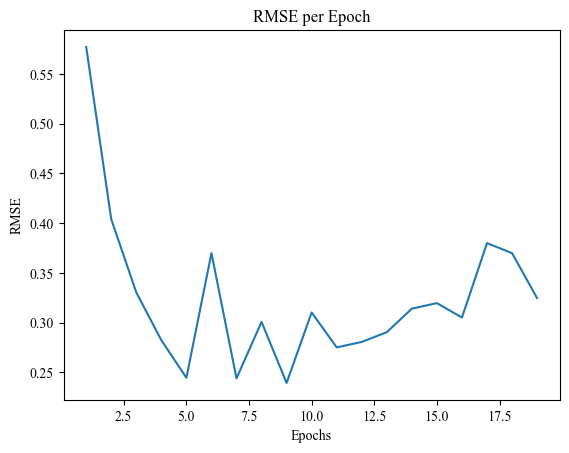

| 1         | -6.146    | 0.7491    | 48.03     | 0.3928    | 33.95     | 93.96     | 93.95     | 37.58     |
Epoch 1/10, RMSE: 0.7197
Epoch 2/10, RMSE: 0.6461
Epoch 3/10, RMSE: 0.5031
Epoch 4/10, RMSE: 0.4800
Epoch 5/10, RMSE: 0.5120
Epoch 6/10, RMSE: 0.4081
Epoch 7/10, RMSE: 0.3545
Epoch 8/10, RMSE: 0.4472
Epoch 9/10, RMSE: 0.2910
Epoch 10/10, RMSE: 0.3493


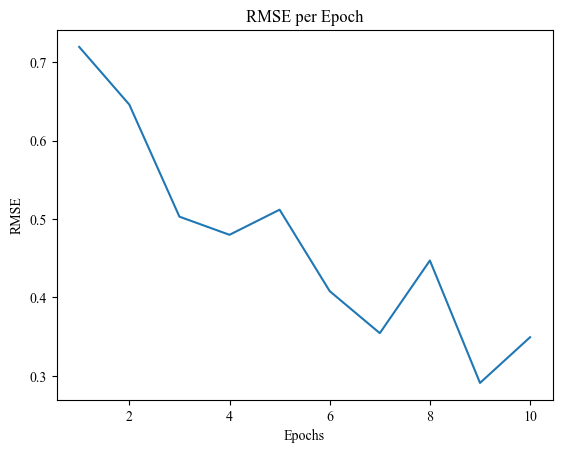

| 2         | -5.063    | 1.732     | 34.04     | 0.3832    | 10.82     | 250.2     | 223.8     | 52.38     |
Epoch 1/30, RMSE: 0.8508
Epoch 2/30, RMSE: 0.6475
Epoch 3/30, RMSE: 0.5906
Epoch 4/30, RMSE: 0.4545
Epoch 5/30, RMSE: 0.3501
Epoch 6/30, RMSE: 0.3416
Epoch 7/30, RMSE: 0.5137
Epoch 8/30, RMSE: 0.5095
Epoch 9/30, RMSE: 0.6608
Epoch 10/30, RMSE: 0.6178
Epoch 11/30, RMSE: 0.4948
Epoch 12/30, RMSE: 0.4337
Epoch 13/30, RMSE: 0.4226
Epoch 14/30, RMSE: 0.3823
Epoch 15/30, RMSE: 0.3366
Epoch 16/30, RMSE: 0.4056
Epoch 17/30, RMSE: 0.3994
Epoch 18/30, RMSE: 0.3757
Epoch 19/30, RMSE: 0.3793
Epoch 20/30, RMSE: 0.3598
Epoch 21/30, RMSE: 0.3449
Epoch 22/30, RMSE: 0.3441
Epoch 23/30, RMSE: 0.3427
Epoch 24/30, RMSE: 0.3405
Epoch 25/30, RMSE: 0.4019
Early stopping at epoch 25


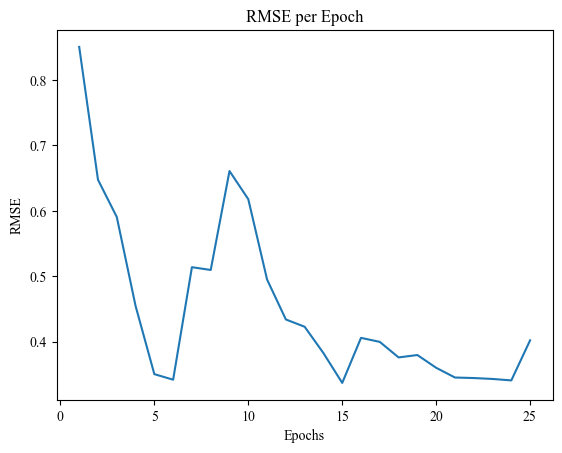

| 3         | -6.186    | 0.3636    | 17.34     | 0.2217    | 30.99     | 146.9     | 119.9     | 90.74     |
Epoch 1/28, RMSE: 0.8061
Epoch 2/28, RMSE: 0.6530
Epoch 3/28, RMSE: 0.5819
Epoch 4/28, RMSE: 0.4450
Epoch 5/28, RMSE: 0.3271
Epoch 6/28, RMSE: 0.3387
Epoch 7/28, RMSE: 0.2986
Epoch 8/28, RMSE: 0.3366
Epoch 9/28, RMSE: 0.3164
Epoch 10/28, RMSE: 0.2731
Epoch 11/28, RMSE: 0.4196
Epoch 12/28, RMSE: 0.4064
Epoch 13/28, RMSE: 0.4035
Epoch 14/28, RMSE: 0.3413
Epoch 15/28, RMSE: 0.3957
Epoch 16/28, RMSE: 0.3608
Epoch 17/28, RMSE: 0.3500
Epoch 18/28, RMSE: 0.3692
Epoch 19/28, RMSE: 0.3853
Epoch 20/28, RMSE: 0.3990
Early stopping at epoch 20


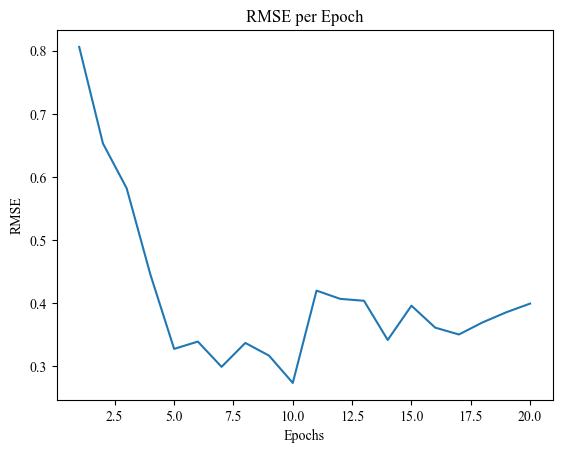

| 4         | -6.559    | 0.279     | 21.69     | 0.2465    | 28.24     | 214.8     | 102.3     | 81.37     |
Epoch 1/16, RMSE: 0.6660
Epoch 2/16, RMSE: 0.6654
Epoch 3/16, RMSE: 0.7160
Epoch 4/16, RMSE: 0.7596
Epoch 5/16, RMSE: 0.7876
Epoch 6/16, RMSE: 0.4650
Epoch 7/16, RMSE: 0.5039
Epoch 8/16, RMSE: 0.4199
Epoch 9/16, RMSE: 0.5632
Epoch 10/16, RMSE: 0.5023
Epoch 11/16, RMSE: 0.5407
Epoch 12/16, RMSE: 0.5465
Epoch 13/16, RMSE: 0.5349
Epoch 14/16, RMSE: 0.4990
Epoch 15/16, RMSE: 0.5426
Epoch 16/16, RMSE: 0.5338


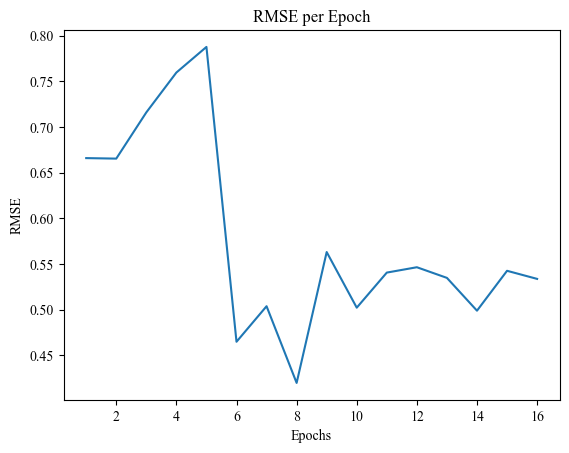

| 5         | -9.204    | 1.185     | 11.86     | 0.343     | 16.82     | 76.49     | 246.2     | 124.7     |
Epoch 1/37, RMSE: 0.8020
Epoch 2/37, RMSE: 0.5186
Epoch 3/37, RMSE: 0.5195
Epoch 4/37, RMSE: 0.3584
Epoch 5/37, RMSE: 0.2985
Epoch 6/37, RMSE: 0.2640
Epoch 7/37, RMSE: 0.2835
Epoch 8/37, RMSE: 0.2698
Epoch 9/37, RMSE: 0.2607
Epoch 10/37, RMSE: 0.2727
Epoch 11/37, RMSE: 0.3596
Epoch 12/37, RMSE: 0.4015
Epoch 13/37, RMSE: 0.2913
Epoch 14/37, RMSE: 0.2843
Epoch 15/37, RMSE: 0.2919
Epoch 16/37, RMSE: 0.3896
Epoch 17/37, RMSE: 0.3694
Epoch 18/37, RMSE: 0.3965
Epoch 19/37, RMSE: 0.3819
Early stopping at epoch 19


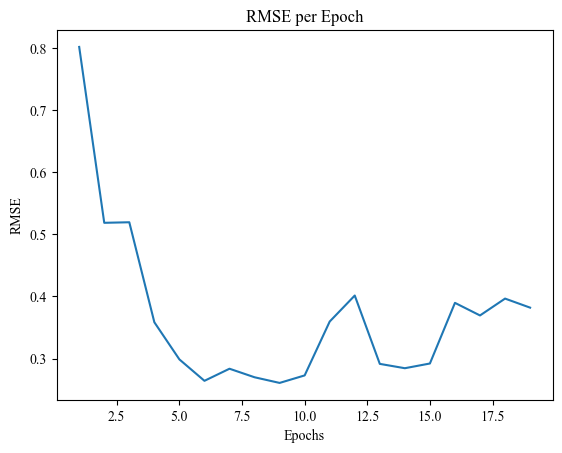

| 6         | -5.123    | 1.617     | 22.18     | 0.1391    | 37.37     | 148.5     | 87.43     | 79.54     |
Epoch 1/36, RMSE: 0.7725
Epoch 2/36, RMSE: 0.4315
Epoch 3/36, RMSE: 0.3057
Epoch 4/36, RMSE: 0.3049
Epoch 5/36, RMSE: 0.2386
Epoch 6/36, RMSE: 0.2428
Epoch 7/36, RMSE: 0.2362
Epoch 8/36, RMSE: 0.2494
Epoch 9/36, RMSE: 0.2311
Epoch 10/36, RMSE: 0.2907
Epoch 11/36, RMSE: 0.3111
Epoch 12/36, RMSE: 0.3317
Epoch 13/36, RMSE: 0.3623
Epoch 14/36, RMSE: 0.3395
Epoch 15/36, RMSE: 0.3947
Epoch 16/36, RMSE: 0.4183
Epoch 17/36, RMSE: 0.4719
Epoch 18/36, RMSE: 0.4439
Epoch 19/36, RMSE: 0.4547
Early stopping at epoch 19


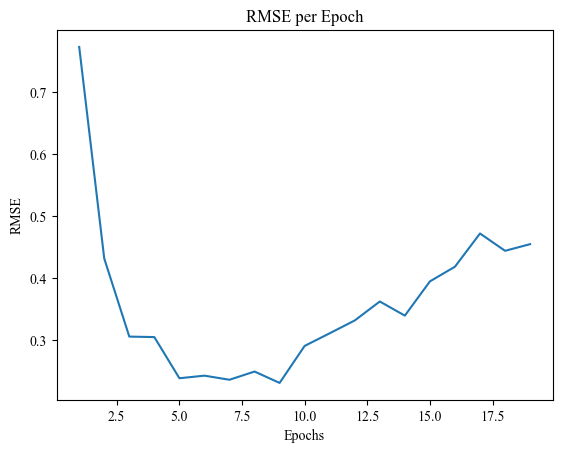

| 7         | -6.589    | 0.06878   | 46.37     | 0.2035    | 36.5      | 123.8     | 163.9     | 84.48     |
Epoch 1/47, RMSE: 0.8391
Epoch 2/47, RMSE: 0.4967
Epoch 3/47, RMSE: 0.3553
Epoch 4/47, RMSE: 0.3727
Epoch 5/47, RMSE: 0.4096
Epoch 6/47, RMSE: 0.2799
Epoch 7/47, RMSE: 0.3034
Epoch 8/47, RMSE: 0.2747
Epoch 9/47, RMSE: 0.3051
Epoch 10/47, RMSE: 0.3415
Epoch 11/47, RMSE: 0.2978
Epoch 12/47, RMSE: 0.2850
Epoch 13/47, RMSE: 0.3482
Epoch 14/47, RMSE: 0.3815
Epoch 15/47, RMSE: 0.4707
Epoch 16/47, RMSE: 0.3987
Epoch 17/47, RMSE: 0.5232
Epoch 18/47, RMSE: 0.5370
Early stopping at epoch 18


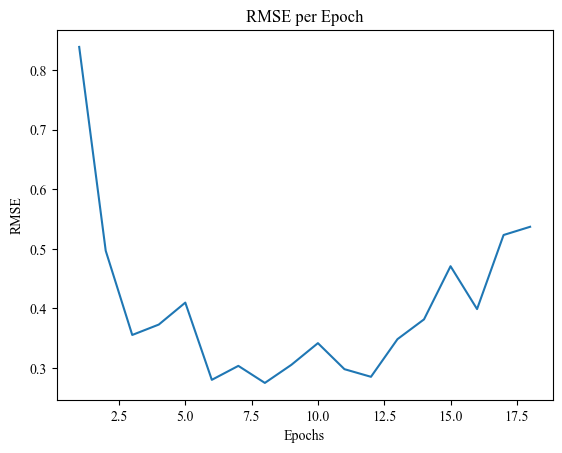

| 8         | -6.578    | 0.3697    | 48.78     | 0.4101    | 47.58     | 235.8     | 178.8     | 120.5     |
Epoch 1/23, RMSE: 0.9231
Epoch 2/23, RMSE: 0.7382
Epoch 3/23, RMSE: 0.6389
Epoch 4/23, RMSE: 0.7169
Epoch 5/23, RMSE: 0.5635
Epoch 6/23, RMSE: 0.5235
Epoch 7/23, RMSE: 0.5010
Epoch 8/23, RMSE: 0.3941
Epoch 9/23, RMSE: 0.3178
Epoch 10/23, RMSE: 0.3744
Epoch 11/23, RMSE: 0.3495
Epoch 12/23, RMSE: 0.4083
Epoch 13/23, RMSE: 0.3894
Epoch 14/23, RMSE: 0.4414
Epoch 15/23, RMSE: 0.5174
Epoch 16/23, RMSE: 0.4898
Epoch 17/23, RMSE: 0.3747
Epoch 18/23, RMSE: 0.3688
Epoch 19/23, RMSE: 0.3458
Early stopping at epoch 19


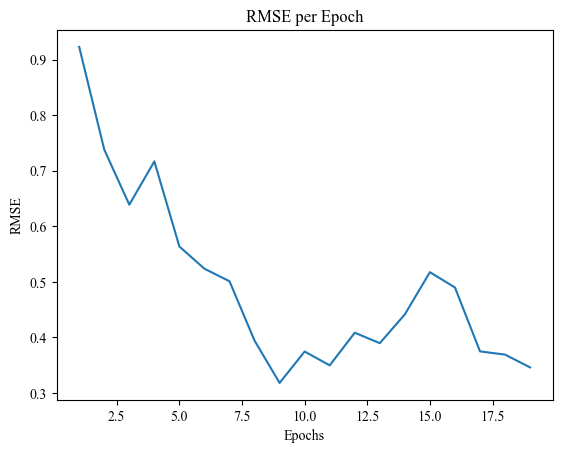

| 9         | -3.851    | 0.177     | 17.84     | 0.1181    | 23.01     | 138.6     | 116.1     | 111.6     |
Epoch 1/15, RMSE: 0.7678
Epoch 2/15, RMSE: 0.6057
Epoch 3/15, RMSE: 0.7480
Epoch 4/15, RMSE: 0.4931
Epoch 5/15, RMSE: 0.4715
Epoch 6/15, RMSE: 0.3381
Epoch 7/15, RMSE: 0.3065
Epoch 8/15, RMSE: 0.3433
Epoch 9/15, RMSE: 0.4142
Epoch 10/15, RMSE: 0.4825
Epoch 11/15, RMSE: 0.4403
Epoch 12/15, RMSE: 0.3195
Epoch 13/15, RMSE: 0.3245
Epoch 14/15, RMSE: 0.3100
Epoch 15/15, RMSE: 0.4096


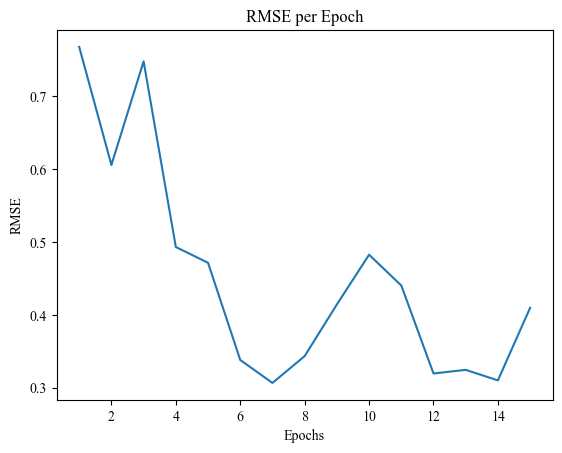

| 10        | -6.548    | 0.7135    | 21.24     | 0.3171    | 15.64     | 218.0     | 78.31     | 126.7     |
Epoch 1/15, RMSE: 0.8772
Epoch 2/15, RMSE: 0.6114
Epoch 3/15, RMSE: 0.5394
Epoch 4/15, RMSE: 0.3403
Epoch 5/15, RMSE: 0.3533
Epoch 6/15, RMSE: 0.3960
Epoch 7/15, RMSE: 0.3366
Epoch 8/15, RMSE: 0.2832
Epoch 9/15, RMSE: 0.3039
Epoch 10/15, RMSE: 0.2691
Epoch 11/15, RMSE: 0.3362
Epoch 12/15, RMSE: 0.3290
Epoch 13/15, RMSE: 0.3148
Epoch 14/15, RMSE: 0.3180
Epoch 15/15, RMSE: 0.3228


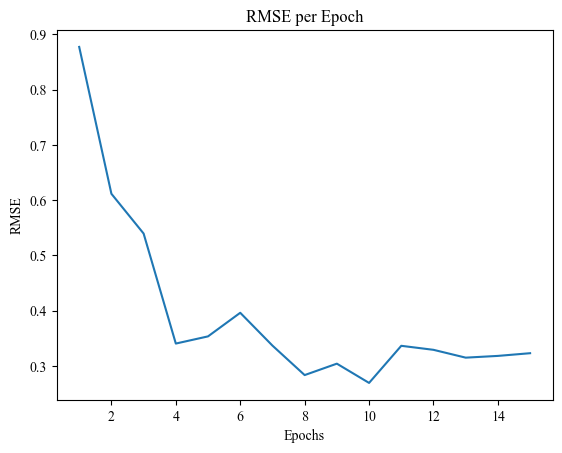

| 11        | -5.527    | 0.9247    | 38.56     | 0.3944    | 15.53     | 249.5     | 221.6     | 51.63     |
Epoch 1/21, RMSE: 0.7809
Epoch 2/21, RMSE: 0.6224
Epoch 3/21, RMSE: 0.6495
Epoch 4/21, RMSE: 0.4690
Epoch 5/21, RMSE: 0.4886
Epoch 6/21, RMSE: 0.4385
Epoch 7/21, RMSE: 0.5110
Epoch 8/21, RMSE: 0.5538
Epoch 9/21, RMSE: 0.4672
Epoch 10/21, RMSE: 0.4798
Epoch 11/21, RMSE: 0.4238
Epoch 12/21, RMSE: 0.4239
Epoch 13/21, RMSE: 0.5206
Epoch 14/21, RMSE: 0.4683
Epoch 15/21, RMSE: 0.4411
Epoch 16/21, RMSE: 0.4815
Epoch 17/21, RMSE: 0.4939
Epoch 18/21, RMSE: 0.4023
Epoch 19/21, RMSE: 0.5286
Epoch 20/21, RMSE: 0.4764
Epoch 21/21, RMSE: 0.4611


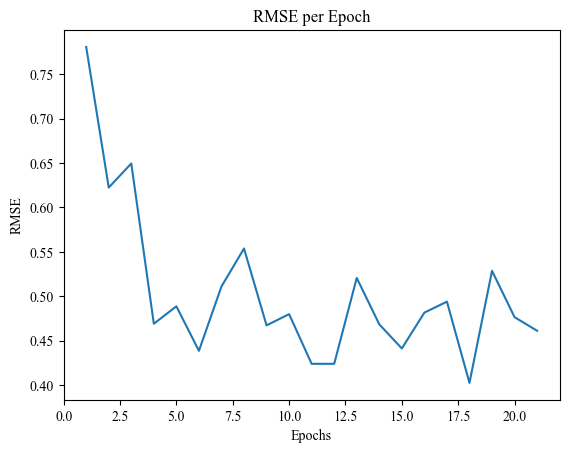

| 12        | -8.199    | 1.519     | 13.68     | 0.4327    | 21.31     | 137.3     | 117.1     | 111.4     |
Epoch 1/28, RMSE: 0.7556
Epoch 2/28, RMSE: 0.7643
Epoch 3/28, RMSE: 0.4811
Epoch 4/28, RMSE: 0.4865
Epoch 5/28, RMSE: 0.3465
Epoch 6/28, RMSE: 0.3338
Epoch 7/28, RMSE: 0.4010
Epoch 8/28, RMSE: 0.4493
Epoch 9/28, RMSE: 0.4825
Epoch 10/28, RMSE: 0.5027
Epoch 11/28, RMSE: 0.3517
Epoch 12/28, RMSE: 0.4130
Epoch 13/28, RMSE: 0.3674
Epoch 14/28, RMSE: 0.3316
Epoch 15/28, RMSE: 0.3628
Epoch 16/28, RMSE: 0.3669
Epoch 17/28, RMSE: 0.3926
Epoch 18/28, RMSE: 0.4528
Epoch 19/28, RMSE: 0.4052
Epoch 20/28, RMSE: 0.3979
Epoch 21/28, RMSE: 0.3735
Epoch 22/28, RMSE: 0.4006
Epoch 23/28, RMSE: 0.4203
Epoch 24/28, RMSE: 0.3996
Early stopping at epoch 24


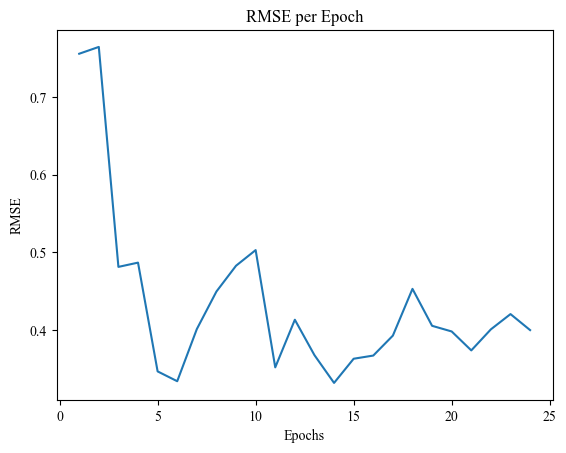

| 13        | -6.799    | 0.8514    | 23.63     | 0.462     | 28.9      | 245.0     | 121.1     | 97.32     |
Epoch 1/39, RMSE: 0.8845
Epoch 2/39, RMSE: 0.7118
Epoch 3/39, RMSE: 0.7148
Epoch 4/39, RMSE: 0.6301
Epoch 5/39, RMSE: 0.7937
Epoch 6/39, RMSE: 0.6236
Epoch 7/39, RMSE: 0.4840
Epoch 8/39, RMSE: 0.3587
Epoch 9/39, RMSE: 0.5388
Epoch 10/39, RMSE: 0.4224
Epoch 11/39, RMSE: 0.5401
Epoch 12/39, RMSE: 0.5149
Epoch 13/39, RMSE: 0.3999
Epoch 14/39, RMSE: 0.5276
Epoch 15/39, RMSE: 0.4320
Epoch 16/39, RMSE: 0.4743
Epoch 17/39, RMSE: 0.5341
Epoch 18/39, RMSE: 0.4883
Early stopping at epoch 18


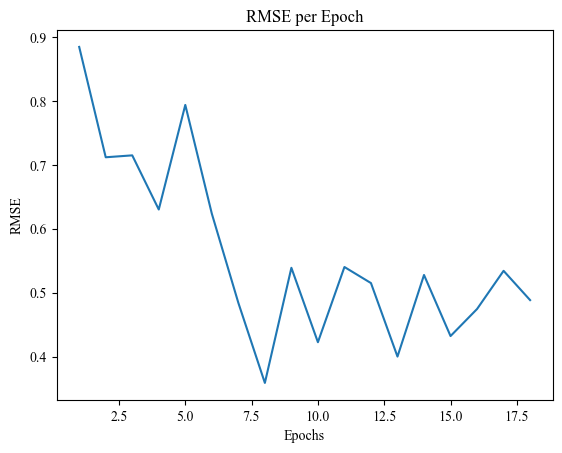

| 14        | -8.524    | 1.997     | 12.05     | 0.413     | 39.69     | 216.1     | 131.1     | 76.58     |
Epoch 1/19, RMSE: 0.6220
Epoch 2/19, RMSE: 0.6444
Epoch 3/19, RMSE: 0.5043
Epoch 4/19, RMSE: 0.4157
Epoch 5/19, RMSE: 0.2971
Epoch 6/19, RMSE: 0.2855
Epoch 7/19, RMSE: 0.2339
Epoch 8/19, RMSE: 0.2175
Epoch 9/19, RMSE: 0.3073
Epoch 10/19, RMSE: 0.2650
Epoch 11/19, RMSE: 0.2801
Epoch 12/19, RMSE: 0.3306
Epoch 13/19, RMSE: 0.2614
Epoch 14/19, RMSE: 0.3255
Epoch 15/19, RMSE: 0.3451
Epoch 16/19, RMSE: 0.3609
Epoch 17/19, RMSE: 0.4634
Epoch 18/19, RMSE: 0.4180
Early stopping at epoch 18


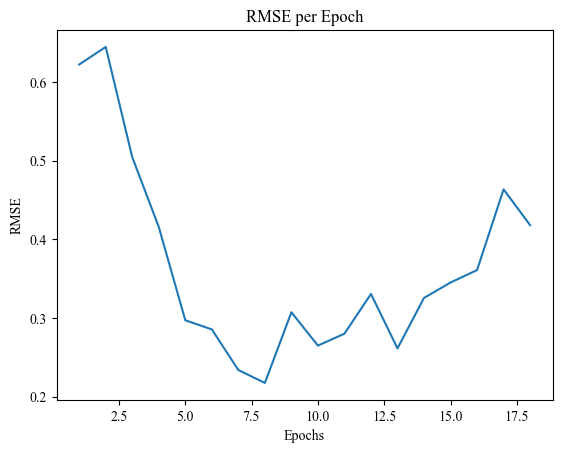

| 15        | -6.318    | 1.112     | 46.15     | 0.3647    | 19.22     | 249.5     | 140.1     | 34.66     |
Epoch 1/36, RMSE: 0.7585
Epoch 2/36, RMSE: 0.6129
Epoch 3/36, RMSE: 0.5317
Epoch 4/36, RMSE: 0.4123
Epoch 5/36, RMSE: 0.4239
Epoch 6/36, RMSE: 0.4095
Epoch 7/36, RMSE: 0.4489
Epoch 8/36, RMSE: 0.4125
Epoch 9/36, RMSE: 0.3414
Epoch 10/36, RMSE: 0.3156
Epoch 11/36, RMSE: 0.3979
Epoch 12/36, RMSE: 0.4390
Epoch 13/36, RMSE: 0.4097
Epoch 14/36, RMSE: 0.3872
Epoch 15/36, RMSE: 0.3809
Epoch 16/36, RMSE: 0.4480
Epoch 17/36, RMSE: 0.4131
Epoch 18/36, RMSE: 0.4228
Epoch 19/36, RMSE: 0.3799
Epoch 20/36, RMSE: 0.4437
Early stopping at epoch 20


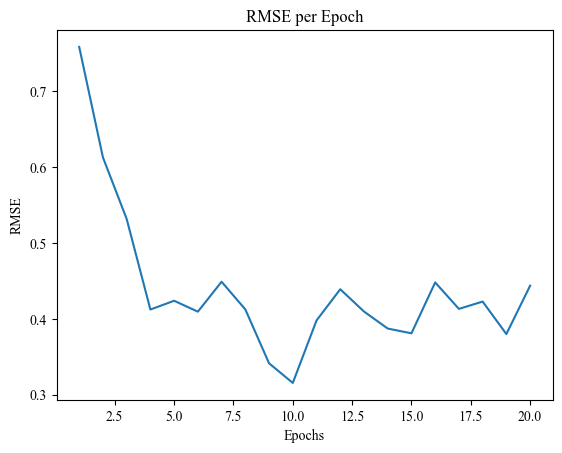

| 16        | -7.607    | 1.618     | 17.71     | 0.4403    | 36.04     | 191.3     | 73.83     | 72.2      |
Epoch 1/36, RMSE: 0.5816
Epoch 2/36, RMSE: 0.5092
Epoch 3/36, RMSE: 0.5087
Epoch 4/36, RMSE: 0.4598
Epoch 5/36, RMSE: 0.4375
Epoch 6/36, RMSE: 0.3760
Epoch 7/36, RMSE: 0.3781
Epoch 8/36, RMSE: 0.3975
Epoch 9/36, RMSE: 0.4139
Epoch 10/36, RMSE: 0.4027
Epoch 11/36, RMSE: 0.4006
Epoch 12/36, RMSE: 0.3408
Epoch 13/36, RMSE: 0.4136
Epoch 14/36, RMSE: 0.3951
Epoch 15/36, RMSE: 0.4377
Epoch 16/36, RMSE: 0.4164
Epoch 17/36, RMSE: 0.4484
Epoch 18/36, RMSE: 0.4348
Epoch 19/36, RMSE: 0.4616
Epoch 20/36, RMSE: 0.4523
Epoch 21/36, RMSE: 0.4520
Epoch 22/36, RMSE: 0.4309
Early stopping at epoch 22


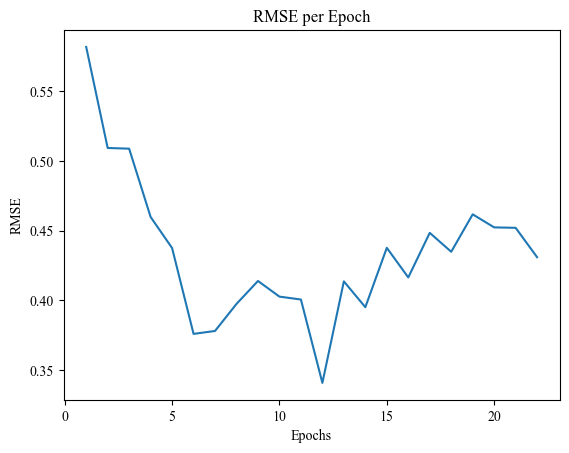

| 17        | -7.01     | 1.419     | 35.26     | 0.4207    | 36.96     | 226.2     | 105.4     | 124.2     |
Epoch 1/48, RMSE: 0.7395
Epoch 2/48, RMSE: 0.5034
Epoch 3/48, RMSE: 0.5641
Epoch 4/48, RMSE: 0.3748
Epoch 5/48, RMSE: 0.3083
Epoch 6/48, RMSE: 0.2791
Epoch 7/48, RMSE: 0.3051
Epoch 8/48, RMSE: 0.2272
Epoch 9/48, RMSE: 0.2634
Epoch 10/48, RMSE: 0.3941
Epoch 11/48, RMSE: 0.2279
Epoch 12/48, RMSE: 0.3247
Epoch 13/48, RMSE: 0.4107
Epoch 14/48, RMSE: 0.3878
Epoch 15/48, RMSE: 0.4088
Epoch 16/48, RMSE: 0.4973
Epoch 17/48, RMSE: 0.4837
Epoch 18/48, RMSE: 0.3456
Early stopping at epoch 18


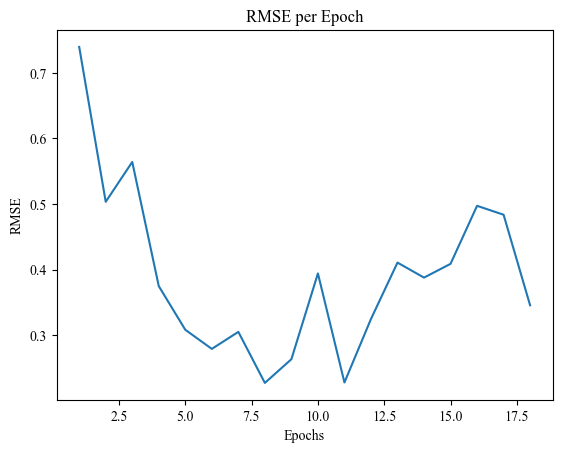

| 18        | -6.855    | 0.2382    | 48.01     | 0.4874    | 48.13     | 241.6     | 109.4     | 72.46     |
Epoch 1/27, RMSE: 0.7881
Epoch 2/27, RMSE: 0.5643
Epoch 3/27, RMSE: 0.5036
Epoch 4/27, RMSE: 0.4551
Epoch 5/27, RMSE: 0.3986
Epoch 6/27, RMSE: 0.3130
Epoch 7/27, RMSE: 0.3547
Epoch 8/27, RMSE: 0.2537
Epoch 9/27, RMSE: 0.2503
Epoch 10/27, RMSE: 0.3728
Epoch 11/27, RMSE: 0.2613
Epoch 12/27, RMSE: 0.3569
Epoch 13/27, RMSE: 0.3713
Epoch 14/27, RMSE: 0.3217
Epoch 15/27, RMSE: 0.3312
Epoch 16/27, RMSE: 0.3560
Epoch 17/27, RMSE: 0.3866
Epoch 18/27, RMSE: 0.3656
Epoch 19/27, RMSE: 0.4435
Early stopping at epoch 19


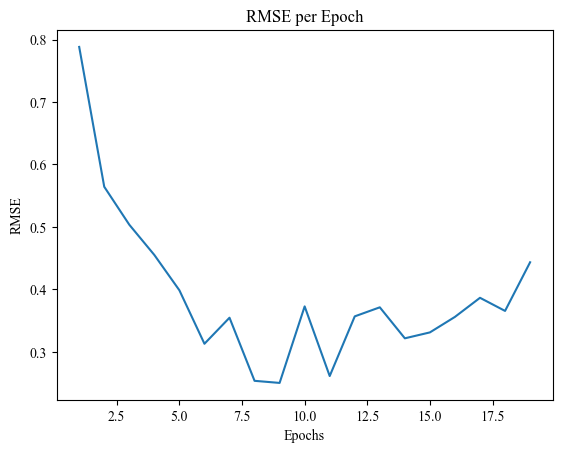

| 19        | -6.689    | 1.953     | 38.0      | 0.4612    | 27.79     | 142.3     | 110.2     | 49.19     |
Epoch 1/49, RMSE: 0.5500
Epoch 2/49, RMSE: 0.4579
Epoch 3/49, RMSE: 0.4920
Epoch 4/49, RMSE: 0.3700
Epoch 5/49, RMSE: 0.3522
Epoch 6/49, RMSE: 0.3146
Epoch 7/49, RMSE: 0.3163
Epoch 8/49, RMSE: 0.3654
Epoch 9/49, RMSE: 0.3099
Epoch 10/49, RMSE: 0.3126
Epoch 11/49, RMSE: 0.2897
Epoch 12/49, RMSE: 0.2877
Epoch 13/49, RMSE: 0.2989
Epoch 14/49, RMSE: 0.3446
Epoch 15/49, RMSE: 0.3796
Epoch 16/49, RMSE: 0.3664
Epoch 17/49, RMSE: 0.2833
Epoch 18/49, RMSE: 0.3612
Epoch 19/49, RMSE: 0.3447
Epoch 20/49, RMSE: 0.4142
Epoch 21/49, RMSE: 0.3610
Epoch 22/49, RMSE: 0.3767
Epoch 23/49, RMSE: 0.3988
Epoch 24/49, RMSE: 0.3433
Epoch 25/49, RMSE: 0.3689
Epoch 26/49, RMSE: 0.3800
Epoch 27/49, RMSE: 0.3583
Early stopping at epoch 27


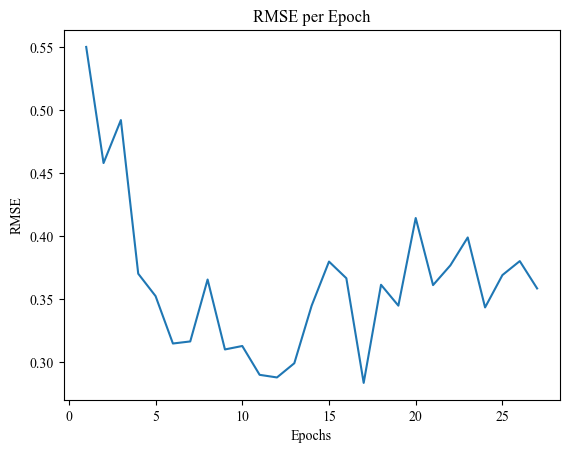

| 20        | -7.095    | 0.8566    | 23.09     | 0.307     | 49.26     | 67.23     | 235.0     | 81.87     |
Epoch 1/33, RMSE: 0.5197
Epoch 2/33, RMSE: 0.5494
Epoch 3/33, RMSE: 0.5250
Epoch 4/33, RMSE: 0.4410
Epoch 5/33, RMSE: 0.4208
Epoch 6/33, RMSE: 0.3684
Epoch 7/33, RMSE: 0.3680
Epoch 8/33, RMSE: 0.3162
Epoch 9/33, RMSE: 0.3060
Epoch 10/33, RMSE: 0.3227
Epoch 11/33, RMSE: 0.3181
Epoch 12/33, RMSE: 0.3872
Epoch 13/33, RMSE: 0.3646
Epoch 14/33, RMSE: 0.3401
Epoch 15/33, RMSE: 0.4025
Epoch 16/33, RMSE: 0.5550
Epoch 17/33, RMSE: 0.4572
Epoch 18/33, RMSE: 0.4781
Epoch 19/33, RMSE: 0.4370
Early stopping at epoch 19


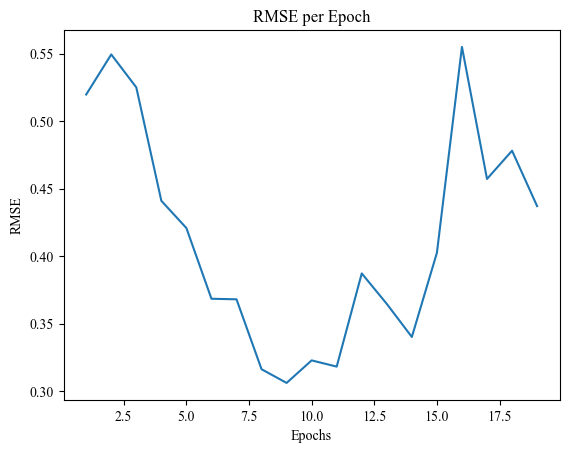

| 21        | -6.106    | 0.01295   | 29.32     | 0.2163    | 33.45     | 162.1     | 94.66     | 124.8     |
Epoch 1/11, RMSE: 0.7631
Epoch 2/11, RMSE: 0.4587
Epoch 3/11, RMSE: 0.3261
Epoch 4/11, RMSE: 0.3383
Epoch 5/11, RMSE: 0.3995
Epoch 6/11, RMSE: 0.3383
Epoch 7/11, RMSE: 0.2898
Epoch 8/11, RMSE: 0.2978
Epoch 9/11, RMSE: 0.3204
Epoch 10/11, RMSE: 0.2624
Epoch 11/11, RMSE: 0.2948


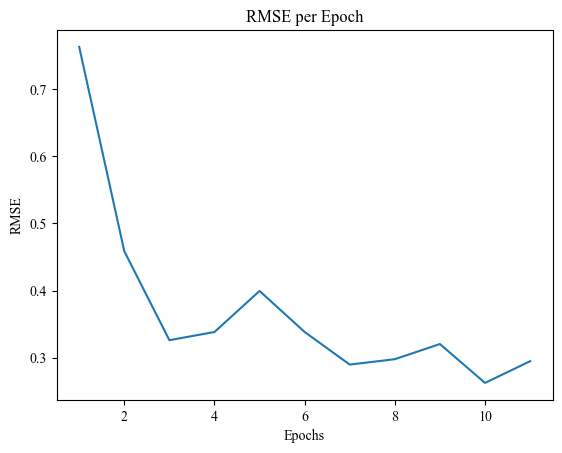

| 22        | -5.78     | 1.555     | 38.57     | 0.3394    | 11.04     | 148.9     | 173.3     | 96.87     |
Epoch 1/28, RMSE: 0.7949
Epoch 2/28, RMSE: 0.5815
Epoch 3/28, RMSE: 0.4310
Epoch 4/28, RMSE: 0.3109
Epoch 5/28, RMSE: 0.3179
Epoch 6/28, RMSE: 0.2241
Epoch 7/28, RMSE: 0.2536
Epoch 8/28, RMSE: 0.2508
Epoch 9/28, RMSE: 0.2822
Epoch 10/28, RMSE: 0.2655
Epoch 11/28, RMSE: 0.3435
Epoch 12/28, RMSE: 0.3238
Epoch 13/28, RMSE: 0.3449
Epoch 14/28, RMSE: 0.3431
Epoch 15/28, RMSE: 0.3854
Epoch 16/28, RMSE: 0.3864
Early stopping at epoch 16


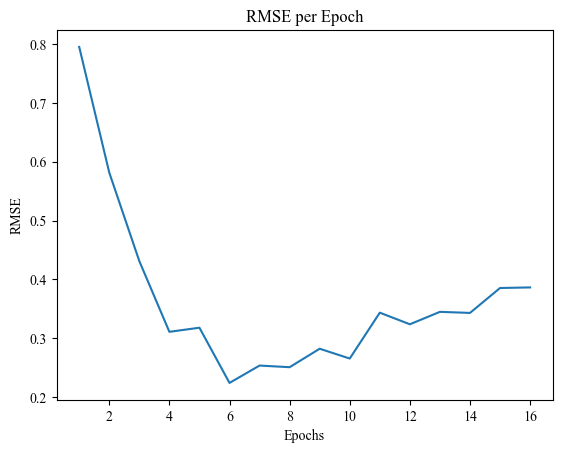

| 23        | -6.091    | 0.6746    | 48.63     | 0.1378    | 28.86     | 250.8     | 175.9     | 107.1     |
Epoch 1/48, RMSE: 0.9140
Epoch 2/48, RMSE: 0.6518
Epoch 3/48, RMSE: 0.5169
Epoch 4/48, RMSE: 0.3883
Epoch 5/48, RMSE: 0.3282
Epoch 6/48, RMSE: 0.3524
Epoch 7/48, RMSE: 0.2715
Epoch 8/48, RMSE: 0.2780
Epoch 9/48, RMSE: 0.3269
Epoch 10/48, RMSE: 0.2676
Epoch 11/48, RMSE: 0.2804
Epoch 12/48, RMSE: 0.2895
Epoch 13/48, RMSE: 0.3333
Epoch 14/48, RMSE: 0.4237
Epoch 15/48, RMSE: 0.4137
Epoch 16/48, RMSE: 0.3364
Epoch 17/48, RMSE: 0.4841
Epoch 18/48, RMSE: 0.4927
Epoch 19/48, RMSE: 0.5530
Epoch 20/48, RMSE: 0.5777
Early stopping at epoch 20


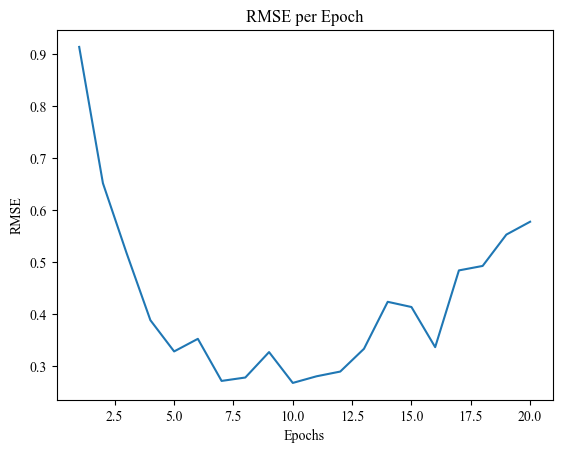

| 24        | -6.962    | 0.9884    | 42.29     | 0.3201    | 48.11     | 154.5     | 244.6     | 62.21     |
Epoch 1/36, RMSE: 0.7379
Epoch 2/36, RMSE: 0.4961
Epoch 3/36, RMSE: 0.4505
Epoch 4/36, RMSE: 0.4305
Epoch 5/36, RMSE: 0.3443
Epoch 6/36, RMSE: 0.3553
Epoch 7/36, RMSE: 0.3237
Epoch 8/36, RMSE: 0.3303
Epoch 9/36, RMSE: 0.3405
Epoch 10/36, RMSE: 0.3296
Epoch 11/36, RMSE: 0.3137
Epoch 12/36, RMSE: 0.3509
Epoch 13/36, RMSE: 0.4056
Epoch 14/36, RMSE: 0.3343
Epoch 15/36, RMSE: 0.3764
Epoch 16/36, RMSE: 0.3437
Epoch 17/36, RMSE: 0.3781
Epoch 18/36, RMSE: 0.4068
Epoch 19/36, RMSE: 0.3702
Epoch 20/36, RMSE: 0.3978
Epoch 21/36, RMSE: 0.4035
Early stopping at epoch 21


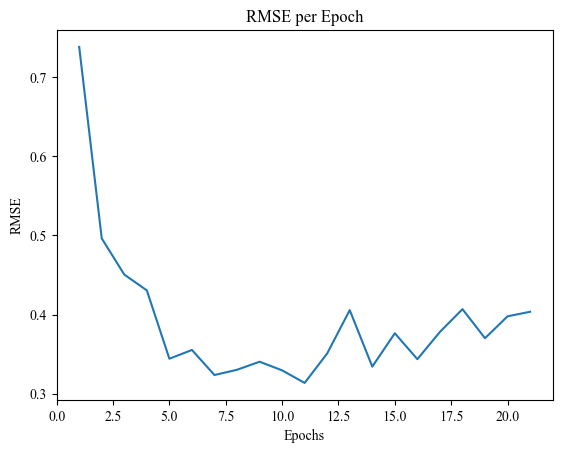

| 25        | -5.737    | 1.493     | 23.54     | 0.2813    | 36.24     | 184.2     | 103.4     | 103.8     |
Epoch 1/37, RMSE: 0.8384
Epoch 2/37, RMSE: 0.4995
Epoch 3/37, RMSE: 0.4401
Epoch 4/37, RMSE: 0.3078
Epoch 5/37, RMSE: 0.3452
Epoch 6/37, RMSE: 0.2485
Epoch 7/37, RMSE: 0.3045
Epoch 8/37, RMSE: 0.2367
Epoch 9/37, RMSE: 0.3115
Epoch 10/37, RMSE: 0.2466
Epoch 11/37, RMSE: 0.3347
Epoch 12/37, RMSE: 0.2980
Epoch 13/37, RMSE: 0.3986
Epoch 14/37, RMSE: 0.4022
Epoch 15/37, RMSE: 0.3844
Epoch 16/37, RMSE: 0.4092
Epoch 17/37, RMSE: 0.4479
Epoch 18/37, RMSE: 0.4458
Early stopping at epoch 18


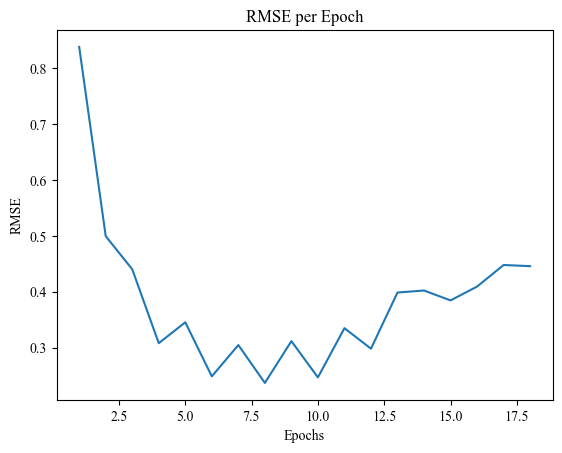

| 26        | -6.295    | 1.877     | 41.63     | 0.2017    | 37.8      | 106.4     | 188.5     | 102.7     |
Epoch 1/20, RMSE: 0.4327
Epoch 2/20, RMSE: 0.5459
Epoch 3/20, RMSE: 0.4490
Epoch 4/20, RMSE: 0.3652
Epoch 5/20, RMSE: 0.3945
Epoch 6/20, RMSE: 0.3244
Epoch 7/20, RMSE: 0.3761
Epoch 8/20, RMSE: 0.3168
Epoch 9/20, RMSE: 0.3494
Epoch 10/20, RMSE: 0.4529
Epoch 11/20, RMSE: 0.4767
Epoch 12/20, RMSE: 0.4293
Epoch 13/20, RMSE: 0.3748
Epoch 14/20, RMSE: 0.4236
Epoch 15/20, RMSE: 0.3180
Epoch 16/20, RMSE: 0.3265
Epoch 17/20, RMSE: 0.4232
Epoch 18/20, RMSE: 0.3780
Early stopping at epoch 18


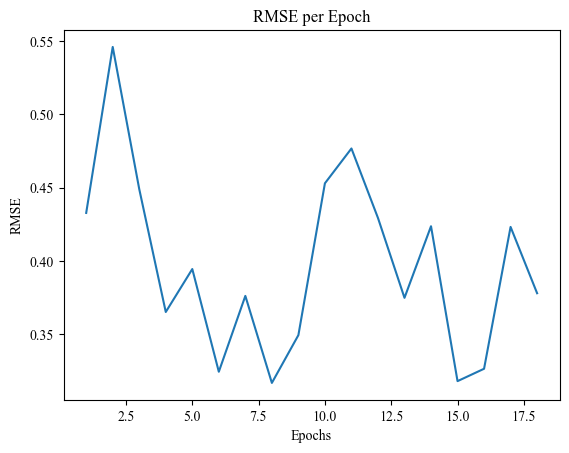

| 27        | -5.671    | 1.346     | 29.87     | 0.3214    | 20.78     | 144.8     | 111.0     | 127.2     |
Epoch 1/28, RMSE: 0.7496
Epoch 2/28, RMSE: 0.5410
Epoch 3/28, RMSE: 0.3900
Epoch 4/28, RMSE: 0.2776
Epoch 5/28, RMSE: 0.2955
Epoch 6/28, RMSE: 0.2522
Epoch 7/28, RMSE: 0.2552
Epoch 8/28, RMSE: 0.2847
Epoch 9/28, RMSE: 0.2617
Epoch 10/28, RMSE: 0.2727
Epoch 11/28, RMSE: 0.2709
Epoch 12/28, RMSE: 0.3191
Epoch 13/28, RMSE: 0.2775
Epoch 14/28, RMSE: 0.3612
Epoch 15/28, RMSE: 0.3268
Epoch 16/28, RMSE: 0.4274
Early stopping at epoch 16


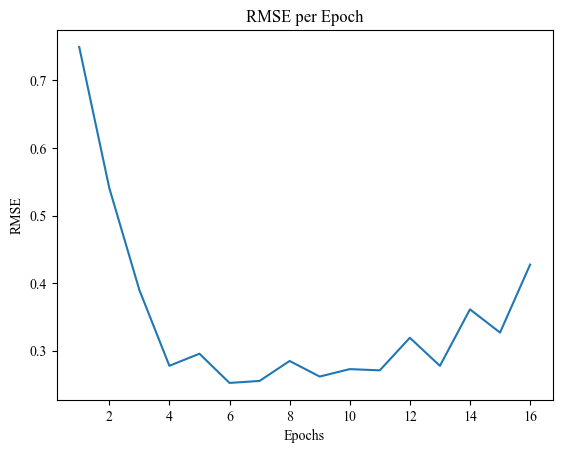

| 28        | -6.615    | 1.064     | 39.84     | 0.3058    | 28.08     | 172.5     | 142.1     | 33.04     |
Epoch 1/21, RMSE: 0.5524
Epoch 2/21, RMSE: 0.5900
Epoch 3/21, RMSE: 0.5246
Epoch 4/21, RMSE: 0.4999
Epoch 5/21, RMSE: 0.4070
Epoch 6/21, RMSE: 0.4276
Epoch 7/21, RMSE: 0.3212
Epoch 8/21, RMSE: 0.3103
Epoch 9/21, RMSE: 0.3483
Epoch 10/21, RMSE: 0.3328
Epoch 11/21, RMSE: 0.3293
Epoch 12/21, RMSE: 0.3520
Epoch 13/21, RMSE: 0.4017
Epoch 14/21, RMSE: 0.4360
Epoch 15/21, RMSE: 0.4361
Epoch 16/21, RMSE: 0.4379
Epoch 17/21, RMSE: 0.5236
Epoch 18/21, RMSE: 0.4142
Early stopping at epoch 18


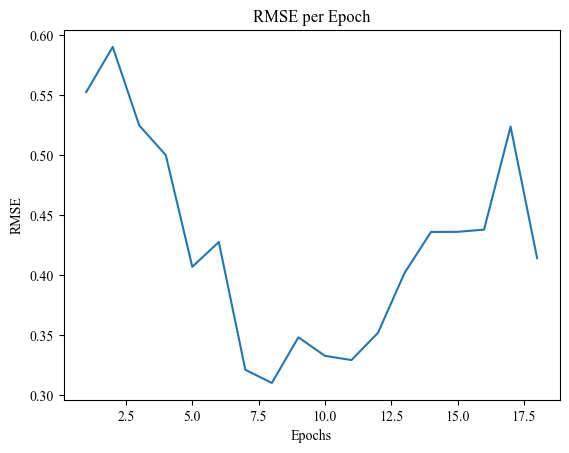

| 29        | -4.942    | 1.676     | 33.71     | 0.2496    | 21.14     | 253.3     | 144.2     | 104.4     |
Epoch 1/34, RMSE: 0.8181
Epoch 2/34, RMSE: 0.5586
Epoch 3/34, RMSE: 0.4986
Epoch 4/34, RMSE: 0.3844
Epoch 5/34, RMSE: 0.3522
Epoch 6/34, RMSE: 0.3214
Epoch 7/34, RMSE: 0.3052
Epoch 8/34, RMSE: 0.3032
Epoch 9/34, RMSE: 0.2826
Epoch 10/34, RMSE: 0.3228
Epoch 11/34, RMSE: 0.3226
Epoch 12/34, RMSE: 0.3595
Epoch 13/34, RMSE: 0.3345
Epoch 14/34, RMSE: 0.3687
Epoch 15/34, RMSE: 0.4339
Epoch 16/34, RMSE: 0.4018
Epoch 17/34, RMSE: 0.4031
Epoch 18/34, RMSE: 0.4086
Epoch 19/34, RMSE: 0.4592
Early stopping at epoch 19


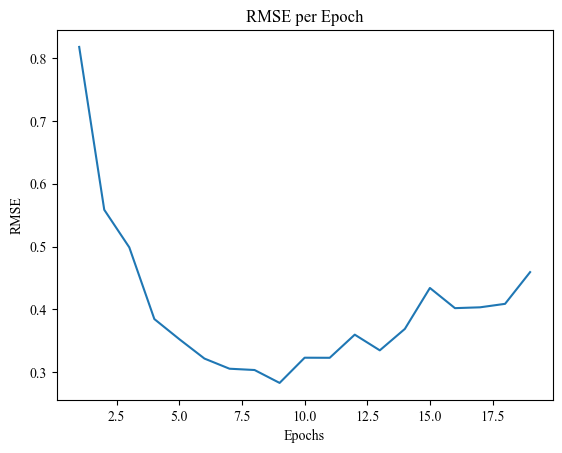

| 30        | -6.681    | 0.6581    | 38.94     | 0.2372    | 34.37     | 206.5     | 68.4      | 50.93     |
Epoch 1/31, RMSE: 0.7896
Epoch 2/31, RMSE: 0.5673
Epoch 3/31, RMSE: 0.5118
Epoch 4/31, RMSE: 0.4188
Epoch 5/31, RMSE: 0.3606
Epoch 6/31, RMSE: 0.3102
Epoch 7/31, RMSE: 0.3294
Epoch 8/31, RMSE: 0.2712
Epoch 9/31, RMSE: 0.2733
Epoch 10/31, RMSE: 0.2636
Epoch 11/31, RMSE: 0.2891
Epoch 12/31, RMSE: 0.2890
Epoch 13/31, RMSE: 0.4247
Epoch 14/31, RMSE: 0.2777
Epoch 15/31, RMSE: 0.3049
Epoch 16/31, RMSE: 0.4098
Epoch 17/31, RMSE: 0.2683
Epoch 18/31, RMSE: 0.3204
Epoch 19/31, RMSE: 0.3205
Epoch 20/31, RMSE: 0.3220
Early stopping at epoch 20


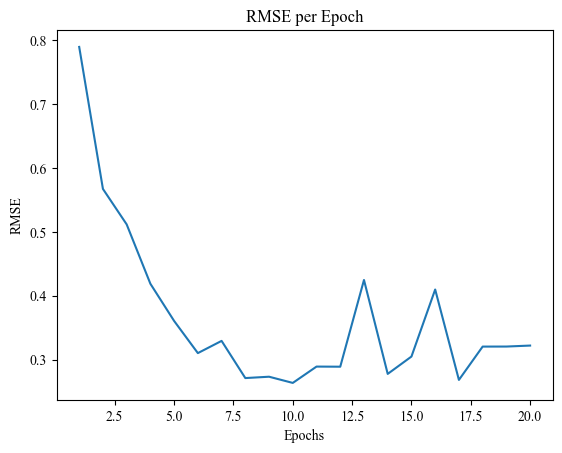

| 31        | -6.378    | 0.8071    | 36.67     | 0.4988    | 31.79     | 102.8     | 215.0     | 62.49     |
Epoch 1/24, RMSE: 0.9951
Epoch 2/24, RMSE: 0.6600
Epoch 3/24, RMSE: 0.6958
Epoch 4/24, RMSE: 0.6140
Epoch 5/24, RMSE: 0.4727
Epoch 6/24, RMSE: 0.5042
Epoch 7/24, RMSE: 0.3611
Epoch 8/24, RMSE: 0.2671
Epoch 9/24, RMSE: 0.3268
Epoch 10/24, RMSE: 0.3458
Epoch 11/24, RMSE: 0.3717
Epoch 12/24, RMSE: 0.3539
Epoch 13/24, RMSE: 0.5837
Epoch 14/24, RMSE: 0.5137
Epoch 15/24, RMSE: 0.5542
Epoch 16/24, RMSE: 0.5019
Epoch 17/24, RMSE: 0.3275
Epoch 18/24, RMSE: 0.4025
Early stopping at epoch 18


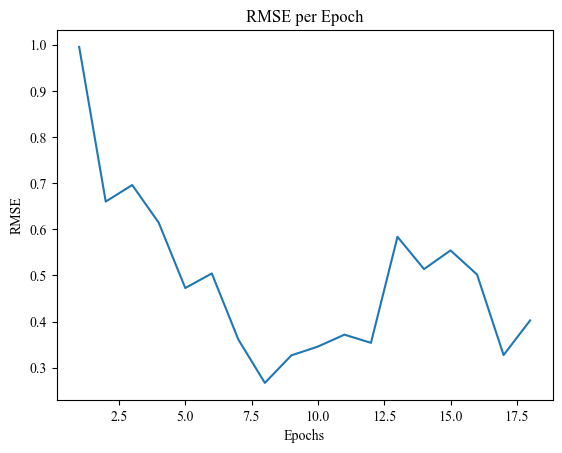

| 32        | -5.248    | 1.185     | 18.74     | 0.2365    | 24.72     | 149.4     | 255.2     | 87.54     |
Epoch 1/12, RMSE: 0.9035
Epoch 2/12, RMSE: 0.3648
Epoch 3/12, RMSE: 0.4379
Epoch 4/12, RMSE: 0.4733
Epoch 5/12, RMSE: 0.3599
Epoch 6/12, RMSE: 0.2596
Epoch 7/12, RMSE: 0.3538
Epoch 8/12, RMSE: 0.2711
Epoch 9/12, RMSE: 0.4829
Epoch 10/12, RMSE: 0.2889
Epoch 11/12, RMSE: 0.3928
Epoch 12/12, RMSE: 0.3410


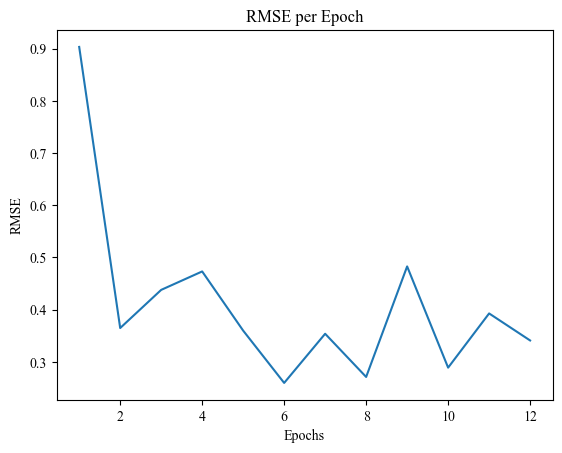

| 33        | -5.742    | 0.1255    | 49.38     | 0.1923    | 12.93     | 254.3     | 232.5     | 117.0     |
Epoch 1/10, RMSE: 0.5599
Epoch 2/10, RMSE: 0.6217
Epoch 3/10, RMSE: 0.5014
Epoch 4/10, RMSE: 0.4984
Epoch 5/10, RMSE: 0.5708
Epoch 6/10, RMSE: 0.3265
Epoch 7/10, RMSE: 0.2886
Epoch 8/10, RMSE: 0.3129
Epoch 9/10, RMSE: 0.3388
Epoch 10/10, RMSE: 0.3017


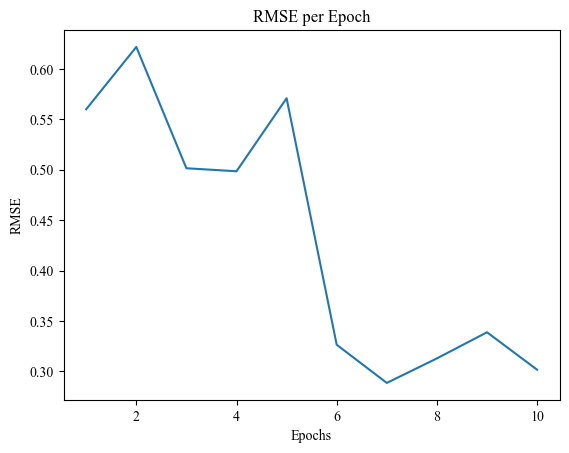

| 34        | -4.885    | 1.152     | 31.05     | 0.2923    | 10.46     | 157.0     | 160.7     | 34.85     |
Epoch 1/16, RMSE: 0.8339
Epoch 2/16, RMSE: 0.3407
Epoch 3/16, RMSE: 0.2804
Epoch 4/16, RMSE: 0.2478
Epoch 5/16, RMSE: 0.2337
Epoch 6/16, RMSE: 0.2267
Epoch 7/16, RMSE: 0.2342
Epoch 8/16, RMSE: 0.2352
Epoch 9/16, RMSE: 0.2731
Epoch 10/16, RMSE: 0.2611
Epoch 11/16, RMSE: 0.2877
Epoch 12/16, RMSE: 0.3181
Epoch 13/16, RMSE: 0.3571
Epoch 14/16, RMSE: 0.3680
Epoch 15/16, RMSE: 0.3761
Epoch 16/16, RMSE: 0.4543
Early stopping at epoch 16


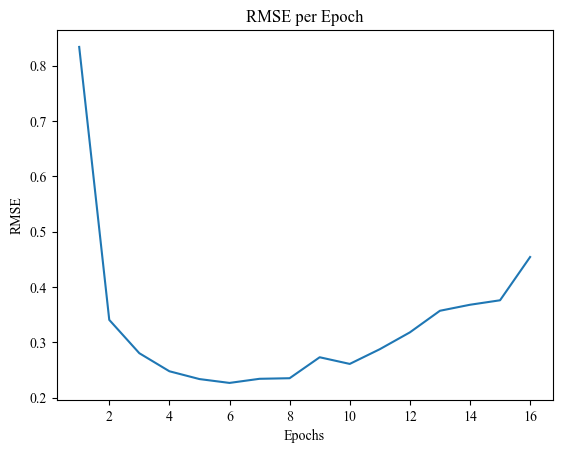

| 35        | -7.538    | 1.611     | 49.58     | 0.1759    | 16.23     | 123.9     | 142.3     | 70.46     |
Epoch 1/44, RMSE: 0.6337
Epoch 2/44, RMSE: 0.4992
Epoch 3/44, RMSE: 0.3755
Epoch 4/44, RMSE: 0.3403
Epoch 5/44, RMSE: 0.3364
Epoch 6/44, RMSE: 0.2947
Epoch 7/44, RMSE: 0.2863
Epoch 8/44, RMSE: 0.3169
Epoch 9/44, RMSE: 0.3670
Epoch 10/44, RMSE: 0.3254
Epoch 11/44, RMSE: 0.3170
Epoch 12/44, RMSE: 0.3977
Epoch 13/44, RMSE: 0.3640
Epoch 14/44, RMSE: 0.3297
Epoch 15/44, RMSE: 0.3439
Epoch 16/44, RMSE: 0.2929
Epoch 17/44, RMSE: 0.3429
Early stopping at epoch 17


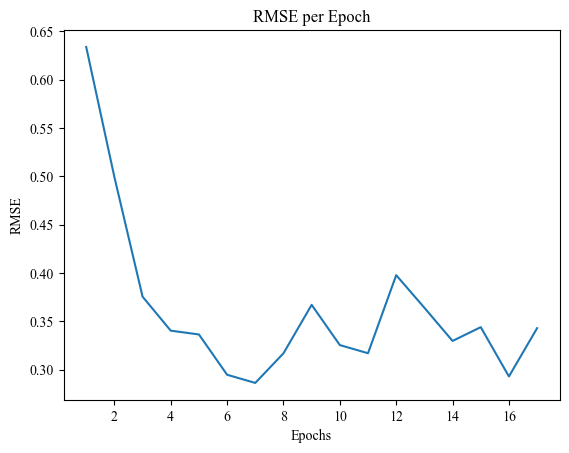

| 36        | -6.953    | 1.868     | 37.54     | 0.3662    | 44.25     | 126.8     | 64.34     | 94.14     |
Epoch 1/28, RMSE: 0.6519
Epoch 2/28, RMSE: 0.5755
Epoch 3/28, RMSE: 0.4708
Epoch 4/28, RMSE: 0.3699
Epoch 5/28, RMSE: 0.4231
Epoch 6/28, RMSE: 0.3157
Epoch 7/28, RMSE: 0.3179
Epoch 8/28, RMSE: 0.3896
Epoch 9/28, RMSE: 0.3191
Epoch 10/28, RMSE: 0.3470
Epoch 11/28, RMSE: 0.3382
Epoch 12/28, RMSE: 0.3906
Epoch 13/28, RMSE: 0.3645
Epoch 14/28, RMSE: 0.3471
Epoch 15/28, RMSE: 0.3921
Epoch 16/28, RMSE: 0.4173
Early stopping at epoch 16


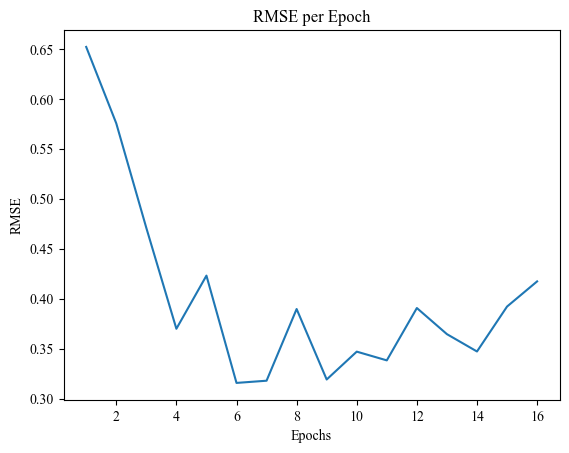

| 37        | -6.816    | 0.4472    | 26.64     | 0.3744    | 28.88     | 167.4     | 100.3     | 107.6     |
Epoch 1/20, RMSE: 0.8062
Epoch 2/20, RMSE: 0.4966
Epoch 3/20, RMSE: 0.4341
Epoch 4/20, RMSE: 0.4020
Epoch 5/20, RMSE: 0.3358
Epoch 6/20, RMSE: 0.3544
Epoch 7/20, RMSE: 0.3061
Epoch 8/20, RMSE: 0.3304
Epoch 9/20, RMSE: 0.3299
Epoch 10/20, RMSE: 0.3282
Epoch 11/20, RMSE: 0.3830
Epoch 12/20, RMSE: 0.2734
Epoch 13/20, RMSE: 0.3268
Epoch 14/20, RMSE: 0.3707
Epoch 15/20, RMSE: 0.4296
Epoch 16/20, RMSE: 0.4569
Epoch 17/20, RMSE: 0.4132
Epoch 18/20, RMSE: 0.4655
Epoch 19/20, RMSE: 0.3997
Epoch 20/20, RMSE: 0.4394


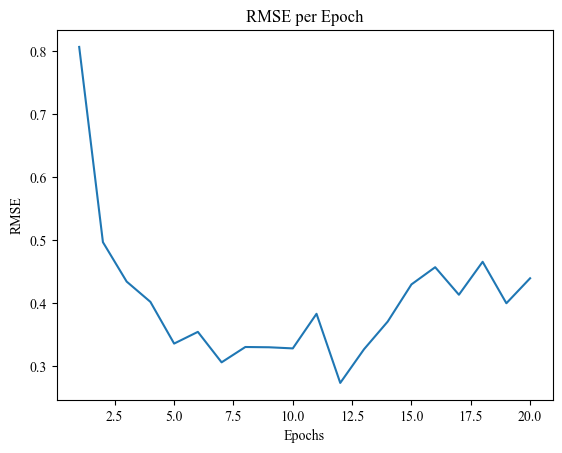

| 38        | -6.848    | 1.056     | 42.5      | 0.4639    | 20.03     | 209.8     | 235.3     | 48.04     |
Epoch 1/39, RMSE: 0.8381
Epoch 2/39, RMSE: 0.4179
Epoch 3/39, RMSE: 0.3646
Epoch 4/39, RMSE: 0.2373
Epoch 5/39, RMSE: 0.2856
Epoch 6/39, RMSE: 0.2719
Epoch 7/39, RMSE: 0.3538
Epoch 8/39, RMSE: 0.3521
Epoch 9/39, RMSE: 0.2573
Epoch 10/39, RMSE: 0.3494
Epoch 11/39, RMSE: 0.3021
Epoch 12/39, RMSE: 0.3365
Epoch 13/39, RMSE: 0.2873
Epoch 14/39, RMSE: 0.4223
Early stopping at epoch 14


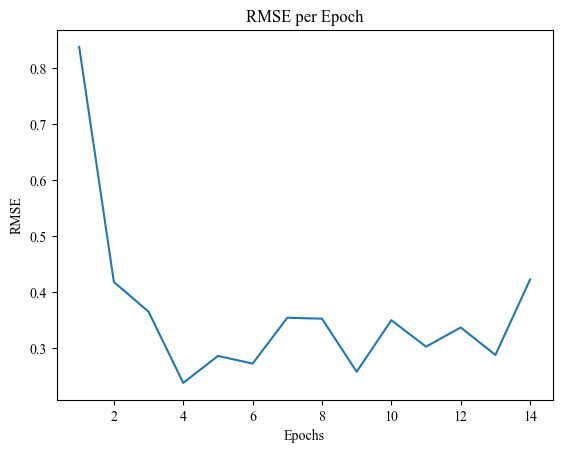

| 39        | -6.77     | 0.9641    | 49.18     | 0.3962    | 39.56     | 243.1     | 155.8     | 112.6     |
Epoch 1/28, RMSE: 0.7603
Epoch 2/28, RMSE: 0.6296
Epoch 3/28, RMSE: 0.4659
Epoch 4/28, RMSE: 0.3338
Epoch 5/28, RMSE: 0.3051
Epoch 6/28, RMSE: 0.2976
Epoch 7/28, RMSE: 0.3780
Epoch 8/28, RMSE: 0.2986
Epoch 9/28, RMSE: 0.2982
Epoch 10/28, RMSE: 0.3472
Epoch 11/28, RMSE: 0.4046
Epoch 12/28, RMSE: 0.3417
Epoch 13/28, RMSE: 0.4058
Epoch 14/28, RMSE: 0.3585
Epoch 15/28, RMSE: 0.3729
Epoch 16/28, RMSE: 0.5057
Early stopping at epoch 16


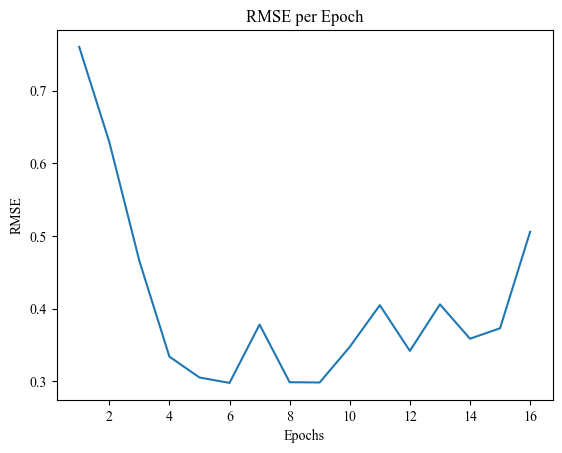

| 40        | -8.181    | 1.326     | 35.72     | 0.4697    | 28.14     | 190.1     | 144.5     | 113.3     |
Mejores hiperparámetros: Epochs=23, Batch size=17, Dropout=0.11809091556421523, Hidden Dims=[138, 116, 111], Activation=ReLU()
Epoch 1/23, RMSE: 0.9885
Epoch 2/23, RMSE: 0.6445
Epoch 3/23, RMSE: 0.6464
Epoch 4/23, RMSE: 0.7237
Epoch 5/23, RMSE: 0.4922
Epoch 6/23, RMSE: 0.4659
Epoch 7/23, RMSE: 0.4123
Epoch 8/23, RMSE: 0.4338
Epoch 9/23, RMSE: 0.3478
Epoch 10/23, RMSE: 0.3519
Epoch 11/23, RMSE: 0.2940
Epoch 12/23, RMSE: 0.4551
Epoch 13/23, RMSE: 0.4037
Epoch 14/23, RMSE: 0.5642
Epoch 15/23, RMSE: 0.4758
Epoch 16/23, RMSE: 0.5086
Epoch 17/23, RMSE: 0.4341
Epoch 18/23, RMSE: 0.5135
Epoch 19/23, RMSE: 0.3928
Epoch 20/23, RMSE: 0.3744
Epoch 21/23, RMSE: 0.4215
Early stopping at epoch 21


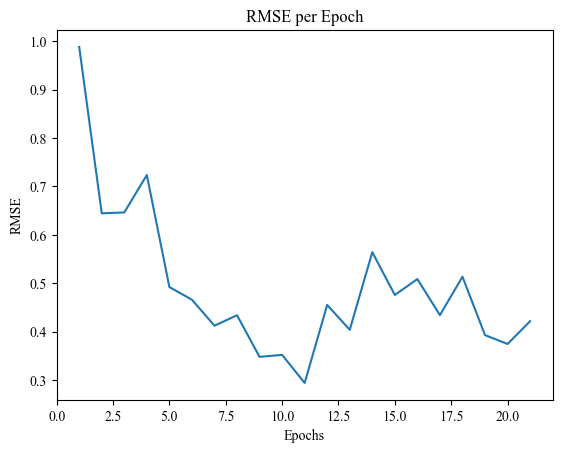

In [414]:
# Definir la clase del modelo ANN con más capas y Dropout
class ANNModel(nn.Module):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU()):
        super(ANNModel, self).__init__()
        self.hidden_layers = nn.ModuleList()
        self.dropout = nn.Dropout(dropout_prob)
        self.activation_fn = activation_fn
        
        # Primera capa
        self.hidden_layers.append(nn.Linear(input_dim, hidden_dims[0]))
        
        # Capas ocultas intermedias
        for i in range(1, len(hidden_dims)):
            self.hidden_layers.append(nn.Linear(hidden_dims[i-1], hidden_dims[i]))
        
        # Capa de salida
        self.output_layer = nn.Linear(hidden_dims[-1], 1)

    def forward(self, x):
        for layer in self.hidden_layers:
            x = self.activation_fn(layer(x))
            x = self.dropout(x)
        x = self.output_layer(x)
        return x

# Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
class SklearnWrapper(BaseEstimator, RegressorMixin):
    def __init__(self, input_dim, hidden_dims=[128, 64, 32], dropout_prob=0.5, activation_fn=nn.ReLU(), 
                 epochs=100, batch_size=32, learning_rate=0.001):
        self.input_dim = input_dim
        self.hidden_dims = hidden_dims
        self.dropout_prob = dropout_prob
        self.activation_fn = activation_fn
        self.epochs = epochs
        self.batch_size = batch_size
        self.learning_rate = learning_rate
        self.model = ANNModel(input_dim, hidden_dims, dropout_prob, activation_fn)
        self.criterion = nn.MSELoss()
        self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
        self.scheduler = optim.lr_scheduler.StepLR(self.optimizer, step_size=50, gamma=0.1)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.scaler_X = StandardScaler()
        self.scaler_y = StandardScaler()

    def fit(self, X, y):
        # Estandarizar los datos
        X = self.scaler_X.fit_transform(X)
        if isinstance(y, pd.Series):
            y = y.to_numpy()  # Convertir a numpy array si es necesario
        y = y.reshape(-1, 1)  # Asegurarse de que 'y' tenga la forma correcta
        y = self.scaler_y.fit_transform(y).flatten()

        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
        self.model.train()
        rmse_list = []
        best_rmse = float('inf')
        patience = 10
        patience_counter = 0

        for epoch in range(self.epochs):
            for i in range(0, len(X_tensor), self.batch_size):
                X_batch = X_tensor[i:i + self.batch_size]
                y_batch = y_tensor[i:i + self.batch_size]

                self.optimizer.zero_grad()
                outputs = self.model(X_batch).squeeze()
                loss = self.criterion(outputs, y_batch)
                loss.backward()
                self.optimizer.step()

            self.scheduler.step()

            # Evaluar el modelo después de cada epoch
            self.model.eval()
            with torch.no_grad():
                y_pred = self.model(X_tensor).squeeze().cpu().numpy()
                rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
                rmse_list.append(rmse)
                print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
                
                # Early stopping
                if rmse < best_rmse:
                    best_rmse = rmse
                    patience_counter = 0
                else:
                    patience_counter += 1
                    if patience_counter >= patience:
                        print(f'Early stopping at epoch {epoch+1}')
                        break

            self.model.train()
        
        # Graficar el RMSE por epoch
        plt.plot(range(1, len(rmse_list) + 1), rmse_list)
        plt.xlabel('Epochs')
        plt.ylabel('RMSE')
        plt.title('RMSE per Epoch')
        plt.show()
        
        return self

    def predict(self, X):
        X = self.scaler_X.transform(X)
        
        X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
        self.model.eval()
        with torch.no_grad():
            y_pred = self.model(X_tensor).squeeze().cpu().numpy()
        y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
        return y_pred

# Función auxiliar para decodificar la función de activación
def get_activation_function(name):
    if name == 0:
        return nn.ReLU()
    elif name == 1:
        return nn.Tanh()
    elif name == 2:
        return nn.LeakyReLU()
    else:
        return nn.ReLU()  # Default

# Guardar el modelo entrenado
def save_model(model, filename):
    joblib.dump(model, filename)

# Cargar el modelo entrenado
def load_model(filename):
    return joblib.load(filename)

# Definir la función de optimización
def train_evaluate_ANN(epochs, batch_size, dropout_prob, hidden_dim1, hidden_dim2, hidden_dim3, activation_fn):
    input_dim = X_train_gfaults.shape[1]
    hidden_dims = [int(hidden_dim1), int(hidden_dim2), int(hidden_dim3)]
    activation = get_activation_function(activation_fn)

    ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=hidden_dims, dropout_prob=dropout_prob, 
                                 activation_fn=activation, epochs=int(epochs), batch_size=int(batch_size))
    ann_wrapper.fit(X_train_gfaults, y_train_gfaults)
    
    y_pred = ann_wrapper.predict(X_test_gfaults)
    mse = mean_squared_error(y_test_gfaults, y_pred)
    rmse = np.sqrt(mse)
    return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# Rango de hiperparámetros para la optimización bayesiana
pbounds = {
    'epochs': (10, 50),
    'batch_size': (10, 50),
    'dropout_prob': (0.1, 0.5),
    'hidden_dim1': (64, 256),
    'hidden_dim2': (64, 256),
    'hidden_dim3': (32, 128),
    'activation_fn': (0, 2)  # 0: ReLU, 1: Tanh, 2: LeakyReLU
}

# Realizar la optimización bayesiana
optimizer = BayesianOptimization(
    f=train_evaluate_ANN,
    pbounds=pbounds,
    random_state=42
)

optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}, Dropout={best_dropout_prob}, Hidden Dims={best_hidden_dims}, Activation={best_activation}')

input_dim = X_train_gfaults.shape[1]

# Entrenar y evaluar el modelo final con los mejores hiperparámetros
ann_wrapper = SklearnWrapper(input_dim=input_dim, hidden_dims=best_hidden_dims, dropout_prob=best_dropout_prob, 
                             activation_fn=best_activation, epochs=best_epochs, batch_size=best_batch_size)
ann_wrapper.fit(X_train_gfaults, y_train_gfaults)

# Guardar el modelo entrenado
save_model(ann_wrapper, 'ann_model_gfaults1.pkl')

In [415]:
# Cargar el modelo entrenado
loaded_model_ann_gfaults = load_model('ann_model_gfaults1.pkl')

y_pred_ann_gfaults = loaded_model_ann_gfaults.predict(X_test_gfaults)
    
# Calcular las métricas
mse_ann_gfaults = mean_squared_error(y_test_gfaults, y_pred_ann_gfaults)
rmse_ann_gfaults = np.sqrt(mse_ann_gfaults)
mae_ann_gfaults = mean_absolute_error(y_test_gfaults, y_pred_ann_gfaults)
r2_ann_gfaults = r2_score(y_test_gfaults, y_pred_ann_gfaults)
    
# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_ann_gfaults:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_ann_gfaults:.5f}")
print(f"Mean Absolute Error (MAE): {mae_ann_gfaults:.5f}")
print(f"R-squared (R^2): {r2_ann_gfaults:.5f}")

Mean Squared Error (MSE): 23.60330
Root Mean Squared Error (RMSE): 4.85832
Mean Absolute Error (MAE): 3.18673
R-squared (R^2): -1.23285


In [416]:
# Obtener los mejores hiperparámetros
best_params = optimizer.max['params']
best_epochs = int(best_params['epochs'])
best_batch_size = int(best_params['batch_size'])
best_dropout_prob = best_params['dropout_prob']
best_hidden_dims = [int(best_params['hidden_dim1']), int(best_params['hidden_dim2']), int(best_params['hidden_dim3'])]
best_activation = get_activation_function(best_params['activation_fn'])

# Imprimir los mejores hiperparámetros
print(f'Mejores hiperparámetros:')
print(f'  Epochs: {best_epochs}')
print(f'  Batch size: {best_batch_size}')
print(f'  Dropout probability: {best_dropout_prob}')
print(f'  Hidden layer sizes: {best_hidden_dims}')
print(f'  Activation function: {best_activation}')

Mejores hiperparámetros:
  Epochs: 23
  Batch size: 17
  Dropout probability: 0.11809091556421523
  Hidden layer sizes: [138, 116, 111]
  Activation function: ReLU()


In [417]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ann_gfaults = pd.DataFrame(y_pred_ann_gfaults, columns=['pred_ann_gfaults'])

# Guardar el DataFrame como un archivo CSV
pred_ann_gfaults.to_csv('y_pred_ann_gfaults.csv', index=False)

|   iter    |  target   | batch_... |  epochs   |
-------------------------------------------------
Epoch 1/48, RMSE: 0.6178
Epoch 2/48, RMSE: 0.5392
Epoch 3/48, RMSE: 0.5253
Epoch 4/48, RMSE: 0.4710
Epoch 5/48, RMSE: 0.4016
Epoch 6/48, RMSE: 0.3738
Epoch 7/48, RMSE: 0.3406
Epoch 8/48, RMSE: 0.3395
Epoch 9/48, RMSE: 0.3284
Epoch 10/48, RMSE: 0.3359
Epoch 11/48, RMSE: 0.3688
Epoch 12/48, RMSE: 0.3555
Epoch 13/48, RMSE: 0.3800
Epoch 14/48, RMSE: 0.3612
Epoch 15/48, RMSE: 0.4134
Epoch 16/48, RMSE: 0.3971
Epoch 17/48, RMSE: 0.4156
Epoch 18/48, RMSE: 0.3965
Epoch 19/48, RMSE: 0.3973
Epoch 20/48, RMSE: 0.4023
Epoch 21/48, RMSE: 0.3690
Epoch 22/48, RMSE: 0.3776
Epoch 23/48, RMSE: 0.3816
Epoch 24/48, RMSE: 0.3746
Epoch 25/48, RMSE: 0.3557
Epoch 26/48, RMSE: 0.3465
Epoch 27/48, RMSE: 0.3786
Epoch 28/48, RMSE: 0.3697
Epoch 29/48, RMSE: 0.3837
Epoch 30/48, RMSE: 0.3655
Epoch 31/48, RMSE: 0.3634
Epoch 32/48, RMSE: 0.4145
Epoch 33/48, RMSE: 0.3968
Epoch 34/48, RMSE: 0.3673
Epoch 35/48, RMSE: 0.3597

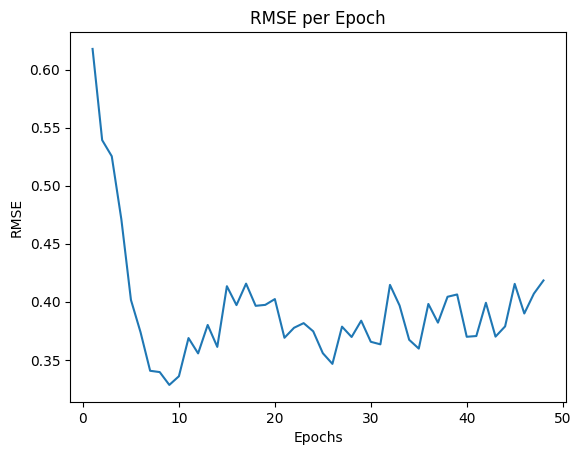

| 1         | -6.471    | 24.98     | 48.03     |
Epoch 1/33, RMSE: 0.5287
Epoch 2/33, RMSE: 0.3458
Epoch 3/33, RMSE: 0.3062
Epoch 4/33, RMSE: 0.2899
Epoch 5/33, RMSE: 0.2934
Epoch 6/33, RMSE: 0.2486
Epoch 7/33, RMSE: 0.2861
Epoch 8/33, RMSE: 0.2332
Epoch 9/33, RMSE: 0.2599
Epoch 10/33, RMSE: 0.3085
Epoch 11/33, RMSE: 0.2502
Epoch 12/33, RMSE: 0.3058
Epoch 13/33, RMSE: 0.3115
Epoch 14/33, RMSE: 0.3317
Epoch 15/33, RMSE: 0.3604
Epoch 16/33, RMSE: 0.4121
Epoch 17/33, RMSE: 0.4002
Epoch 18/33, RMSE: 0.3920
Epoch 19/33, RMSE: 0.4174
Epoch 20/33, RMSE: 0.4286
Epoch 21/33, RMSE: 0.4194
Epoch 22/33, RMSE: 0.4200
Epoch 23/33, RMSE: 0.4317
Epoch 24/33, RMSE: 0.4138
Epoch 25/33, RMSE: 0.4406
Epoch 26/33, RMSE: 0.4278
Epoch 27/33, RMSE: 0.4241
Epoch 28/33, RMSE: 0.4212
Epoch 29/33, RMSE: 0.4411
Epoch 30/33, RMSE: 0.4068
Epoch 31/33, RMSE: 0.4294
Epoch 32/33, RMSE: 0.3986
Epoch 33/33, RMSE: 0.4107


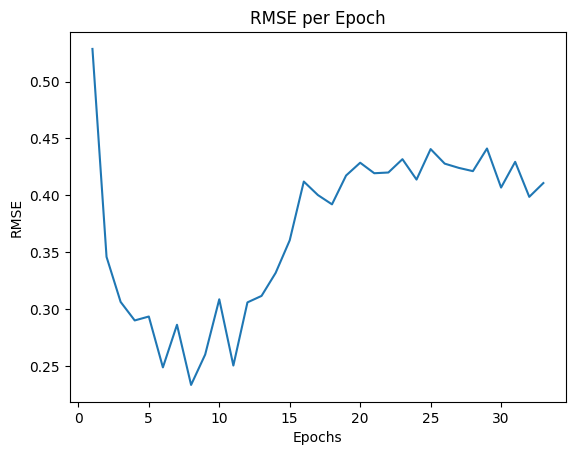

| 2         | -7.506    | 39.28     | 33.95     |
Epoch 1/16, RMSE: 0.6736
Epoch 2/16, RMSE: 0.4550
Epoch 3/16, RMSE: 0.3792
Epoch 4/16, RMSE: 0.3316
Epoch 5/16, RMSE: 0.3248
Epoch 6/16, RMSE: 0.3221
Epoch 7/16, RMSE: 0.3021
Epoch 8/16, RMSE: 0.3390
Epoch 9/16, RMSE: 0.3294
Epoch 10/16, RMSE: 0.2925
Epoch 11/16, RMSE: 0.3001
Epoch 12/16, RMSE: 0.3049
Epoch 13/16, RMSE: 0.2972
Epoch 14/16, RMSE: 0.3115
Epoch 15/16, RMSE: 0.3264
Epoch 16/16, RMSE: 0.3166


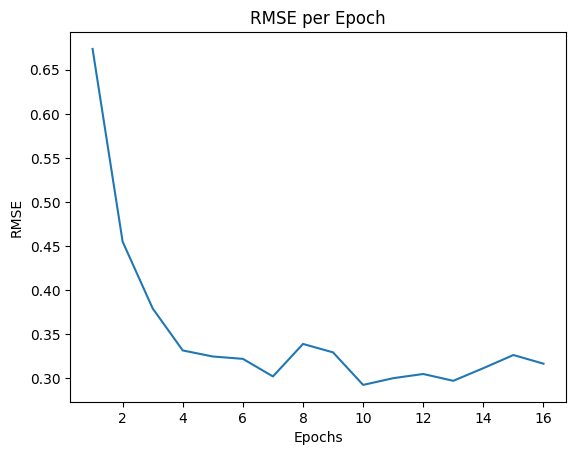

| 3         | -7.37     | 16.24     | 16.24     |
Epoch 1/44, RMSE: 0.7554
Epoch 2/44, RMSE: 0.6340
Epoch 3/44, RMSE: 0.6050
Epoch 4/44, RMSE: 0.6098
Epoch 5/44, RMSE: 0.5960
Epoch 6/44, RMSE: 0.4410
Epoch 7/44, RMSE: 0.3550
Epoch 8/44, RMSE: 0.3358
Epoch 9/44, RMSE: 0.3825
Epoch 10/44, RMSE: 0.3719
Epoch 11/44, RMSE: 0.3393
Epoch 12/44, RMSE: 0.3749
Epoch 13/44, RMSE: 0.3292
Epoch 14/44, RMSE: 0.3629
Epoch 15/44, RMSE: 0.3442
Epoch 16/44, RMSE: 0.3406
Epoch 17/44, RMSE: 0.3198
Epoch 18/44, RMSE: 0.3633
Epoch 19/44, RMSE: 0.3441
Epoch 20/44, RMSE: 0.3640
Epoch 21/44, RMSE: 0.3799
Epoch 22/44, RMSE: 0.3492
Epoch 23/44, RMSE: 0.3694
Epoch 24/44, RMSE: 0.3821
Epoch 25/44, RMSE: 0.3763
Epoch 26/44, RMSE: 0.3728
Epoch 27/44, RMSE: 0.3789
Epoch 28/44, RMSE: 0.3670
Epoch 29/44, RMSE: 0.3812
Epoch 30/44, RMSE: 0.3781
Epoch 31/44, RMSE: 0.3729
Epoch 32/44, RMSE: 0.3750
Epoch 33/44, RMSE: 0.3726
Epoch 34/44, RMSE: 0.3852
Epoch 35/44, RMSE: 0.3712
Epoch 36/44, RMSE: 0.3584
Epoch 37/44, RMSE: 0.38

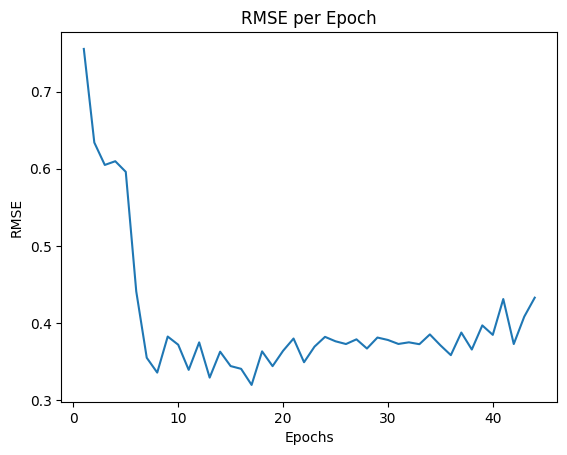

| 4         | -5.959    | 12.32     | 44.65     |
Epoch 1/38, RMSE: 0.5801
Epoch 2/38, RMSE: 0.4279
Epoch 3/38, RMSE: 0.4415
Epoch 4/38, RMSE: 0.3547
Epoch 5/38, RMSE: 0.3550
Epoch 6/38, RMSE: 0.3533
Epoch 7/38, RMSE: 0.3165
Epoch 8/38, RMSE: 0.2938
Epoch 9/38, RMSE: 0.2708
Epoch 10/38, RMSE: 0.2788
Epoch 11/38, RMSE: 0.2937
Epoch 12/38, RMSE: 0.3139
Epoch 13/38, RMSE: 0.3402
Epoch 14/38, RMSE: 0.3706
Epoch 15/38, RMSE: 0.3424
Epoch 16/38, RMSE: 0.3969
Epoch 17/38, RMSE: 0.3988
Epoch 18/38, RMSE: 0.3999
Epoch 19/38, RMSE: 0.3986
Epoch 20/38, RMSE: 0.3896
Epoch 21/38, RMSE: 0.4287
Epoch 22/38, RMSE: 0.4048
Epoch 23/38, RMSE: 0.4140
Epoch 24/38, RMSE: 0.3887
Epoch 25/38, RMSE: 0.4179
Epoch 26/38, RMSE: 0.4078
Epoch 27/38, RMSE: 0.3994
Epoch 28/38, RMSE: 0.3835
Epoch 29/38, RMSE: 0.3869
Epoch 30/38, RMSE: 0.3907
Epoch 31/38, RMSE: 0.3830
Epoch 32/38, RMSE: 0.4023
Epoch 33/38, RMSE: 0.4003
Epoch 34/38, RMSE: 0.3719
Epoch 35/38, RMSE: 0.3898
Epoch 36/38, RMSE: 0.3829
Epoch 37/38, RMSE: 0.38

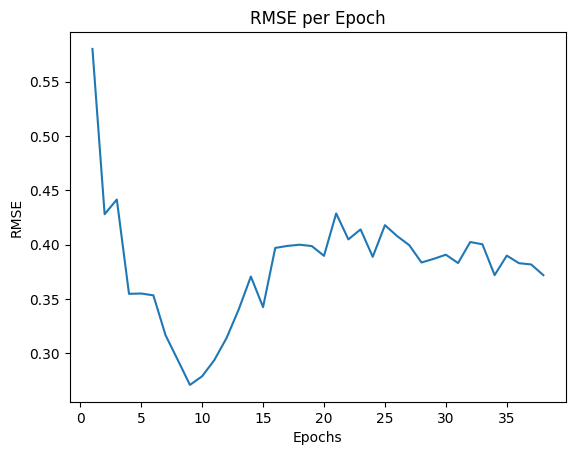

| 5         | -6.715    | 34.04     | 38.32     |
Epoch 1/48, RMSE: 0.7456
Epoch 2/48, RMSE: 0.7967
Epoch 3/48, RMSE: 0.5826
Epoch 4/48, RMSE: 0.5272
Epoch 5/48, RMSE: 0.4347
Epoch 6/48, RMSE: 0.3940
Epoch 7/48, RMSE: 0.4344
Epoch 8/48, RMSE: 0.4034
Epoch 9/48, RMSE: 0.4405
Epoch 10/48, RMSE: 0.4340
Epoch 11/48, RMSE: 0.4158
Epoch 12/48, RMSE: 0.4160
Epoch 13/48, RMSE: 0.3997
Epoch 14/48, RMSE: 0.4096
Epoch 15/48, RMSE: 0.4351
Epoch 16/48, RMSE: 0.4317
Epoch 17/48, RMSE: 0.4276
Epoch 18/48, RMSE: 0.4135
Epoch 19/48, RMSE: 0.4537
Epoch 20/48, RMSE: 0.4459
Epoch 21/48, RMSE: 0.3974
Epoch 22/48, RMSE: 0.4253
Epoch 23/48, RMSE: 0.4239
Epoch 24/48, RMSE: 0.3799
Epoch 25/48, RMSE: 0.4080
Epoch 26/48, RMSE: 0.4020
Epoch 27/48, RMSE: 0.3664
Epoch 28/48, RMSE: 0.4082
Epoch 29/48, RMSE: 0.4256
Epoch 30/48, RMSE: 0.4006
Epoch 31/48, RMSE: 0.4142
Epoch 32/48, RMSE: 0.4092
Epoch 33/48, RMSE: 0.3803
Epoch 34/48, RMSE: 0.3760
Epoch 35/48, RMSE: 0.4041
Epoch 36/48, RMSE: 0.3851
Epoch 37/48, RMSE: 0.38

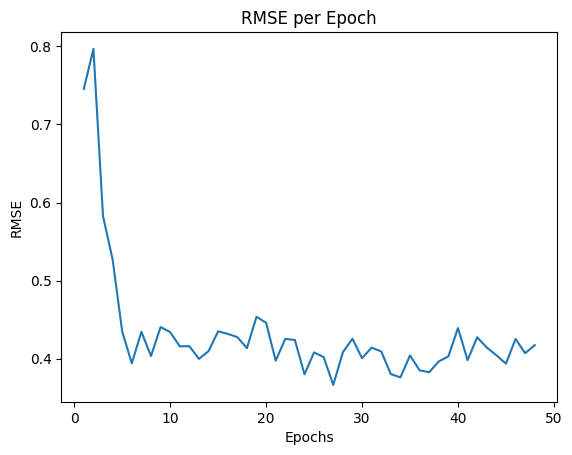

| 6         | -7.052    | 10.82     | 48.8      |
Epoch 1/18, RMSE: 0.5531
Epoch 2/18, RMSE: 0.4389
Epoch 3/18, RMSE: 0.3766
Epoch 4/18, RMSE: 0.3204
Epoch 5/18, RMSE: 0.2733
Epoch 6/18, RMSE: 0.2703
Epoch 7/18, RMSE: 0.2492
Epoch 8/18, RMSE: 0.2400
Epoch 9/18, RMSE: 0.2961
Epoch 10/18, RMSE: 0.2502
Epoch 11/18, RMSE: 0.2634
Epoch 12/18, RMSE: 0.2942
Epoch 13/18, RMSE: 0.2885
Epoch 14/18, RMSE: 0.3244
Epoch 15/18, RMSE: 0.3579
Epoch 16/18, RMSE: 0.3964
Epoch 17/18, RMSE: 0.3971
Epoch 18/18, RMSE: 0.4067


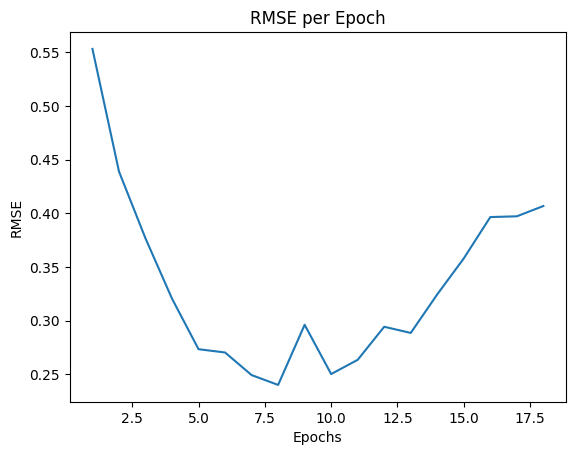

| 7         | -6.459    | 43.3      | 18.49     |
Epoch 1/17, RMSE: 0.6408
Epoch 2/17, RMSE: 0.5165
Epoch 3/17, RMSE: 0.3924
Epoch 4/17, RMSE: 0.3383
Epoch 5/17, RMSE: 0.3486
Epoch 6/17, RMSE: 0.2927
Epoch 7/17, RMSE: 0.3041
Epoch 8/17, RMSE: 0.3424
Epoch 9/17, RMSE: 0.3078
Epoch 10/17, RMSE: 0.3400
Epoch 11/17, RMSE: 0.3629
Epoch 12/17, RMSE: 0.3791
Epoch 13/17, RMSE: 0.3791
Epoch 14/17, RMSE: 0.3407
Epoch 15/17, RMSE: 0.3623
Epoch 16/17, RMSE: 0.3427
Epoch 17/17, RMSE: 0.3452


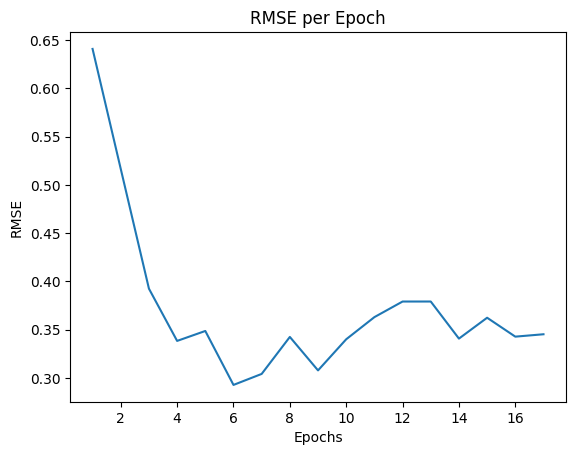

| 8         | -7.523    | 17.27     | 17.34     |
Epoch 1/30, RMSE: 0.6352
Epoch 2/30, RMSE: 0.4766
Epoch 3/30, RMSE: 0.3595
Epoch 4/30, RMSE: 0.3412
Epoch 5/30, RMSE: 0.2905
Epoch 6/30, RMSE: 0.2706
Epoch 7/30, RMSE: 0.2672
Epoch 8/30, RMSE: 0.2595
Epoch 9/30, RMSE: 0.2800
Epoch 10/30, RMSE: 0.2801
Epoch 11/30, RMSE: 0.3410
Epoch 12/30, RMSE: 0.3312
Epoch 13/30, RMSE: 0.3231
Epoch 14/30, RMSE: 0.2983
Epoch 15/30, RMSE: 0.3347
Epoch 16/30, RMSE: 0.3382
Epoch 17/30, RMSE: 0.3419
Epoch 18/30, RMSE: 0.3471
Epoch 19/30, RMSE: 0.3603
Epoch 20/30, RMSE: 0.3589
Epoch 21/30, RMSE: 0.3686
Epoch 22/30, RMSE: 0.3951
Epoch 23/30, RMSE: 0.4015
Epoch 24/30, RMSE: 0.3487
Epoch 25/30, RMSE: 0.4046
Epoch 26/30, RMSE: 0.3891
Epoch 27/30, RMSE: 0.3988
Epoch 28/30, RMSE: 0.3793
Epoch 29/30, RMSE: 0.3807
Epoch 30/30, RMSE: 0.3916


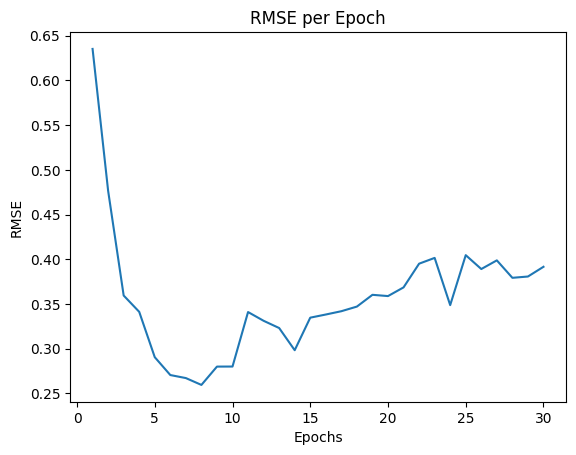

| 9         | -7.641    | 22.17     | 30.99     |
Epoch 1/21, RMSE: 0.6618
Epoch 2/21, RMSE: 0.5200
Epoch 3/21, RMSE: 0.4777
Epoch 4/21, RMSE: 0.4216
Epoch 5/21, RMSE: 0.3349
Epoch 6/21, RMSE: 0.3226
Epoch 7/21, RMSE: 0.2776
Epoch 8/21, RMSE: 0.2592
Epoch 9/21, RMSE: 0.2982
Epoch 10/21, RMSE: 0.3073
Epoch 11/21, RMSE: 0.3137
Epoch 12/21, RMSE: 0.3053
Epoch 13/21, RMSE: 0.3128
Epoch 14/21, RMSE: 0.3435
Epoch 15/21, RMSE: 0.3624
Epoch 16/21, RMSE: 0.3630
Epoch 17/21, RMSE: 0.3517
Epoch 18/21, RMSE: 0.3295
Epoch 19/21, RMSE: 0.3410
Epoch 20/21, RMSE: 0.3130
Epoch 21/21, RMSE: 0.3807


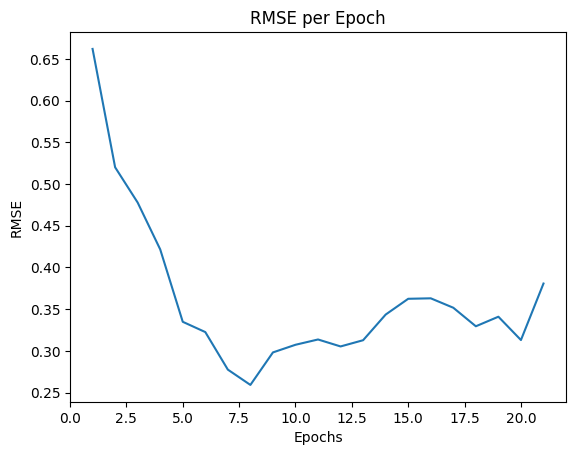

| 10        | -7.621    | 27.28     | 21.65     |
Epoch 1/42, RMSE: 0.8020
Epoch 2/42, RMSE: 0.6398
Epoch 3/42, RMSE: 0.5223
Epoch 4/42, RMSE: 0.4505
Epoch 5/42, RMSE: 0.4427
Epoch 6/42, RMSE: 0.3615
Epoch 7/42, RMSE: 0.3446
Epoch 8/42, RMSE: 0.3585
Epoch 9/42, RMSE: 0.3169
Epoch 10/42, RMSE: 0.3496
Epoch 11/42, RMSE: 0.3684
Epoch 12/42, RMSE: 0.2911
Epoch 13/42, RMSE: 0.3228
Epoch 14/42, RMSE: 0.3248
Epoch 15/42, RMSE: 0.3224
Epoch 16/42, RMSE: 0.3396
Epoch 17/42, RMSE: 0.3422
Epoch 18/42, RMSE: 0.3524
Epoch 19/42, RMSE: 0.3308
Epoch 20/42, RMSE: 0.3476
Epoch 21/42, RMSE: 0.3268
Epoch 22/42, RMSE: 0.3311
Epoch 23/42, RMSE: 0.3452
Epoch 24/42, RMSE: 0.3890
Epoch 25/42, RMSE: 0.3815
Epoch 26/42, RMSE: 0.3639
Epoch 27/42, RMSE: 0.3799
Epoch 28/42, RMSE: 0.3835
Epoch 29/42, RMSE: 0.3511
Epoch 30/42, RMSE: 0.3358
Epoch 31/42, RMSE: 0.3729
Epoch 32/42, RMSE: 0.3449
Epoch 33/42, RMSE: 0.3621
Epoch 34/42, RMSE: 0.3638
Epoch 35/42, RMSE: 0.3750
Epoch 36/42, RMSE: 0.3739
Epoch 37/42, RMSE: 0.35

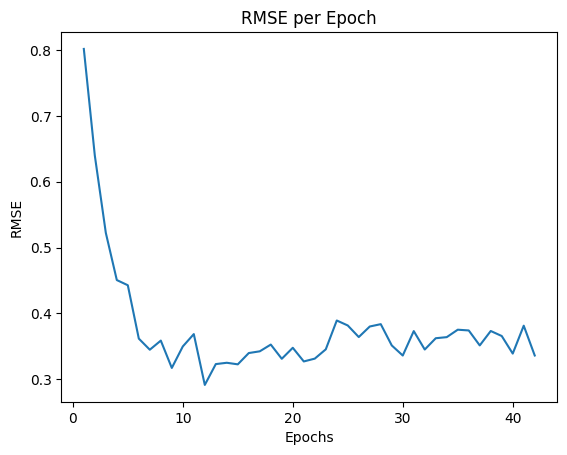

| 11        | -6.177    | 13.89     | 42.42     |
Epoch 1/41, RMSE: 0.8280
Epoch 2/41, RMSE: 0.7363
Epoch 3/41, RMSE: 0.6255
Epoch 4/41, RMSE: 0.6526
Epoch 5/41, RMSE: 0.4927
Epoch 6/41, RMSE: 0.4056
Epoch 7/41, RMSE: 0.3497
Epoch 8/41, RMSE: 0.4371
Epoch 9/41, RMSE: 0.4249
Epoch 10/41, RMSE: 0.3592
Epoch 11/41, RMSE: 0.3566
Epoch 12/41, RMSE: 0.3618
Epoch 13/41, RMSE: 0.3644
Epoch 14/41, RMSE: 0.3237
Epoch 15/41, RMSE: 0.3514
Epoch 16/41, RMSE: 0.3231
Epoch 17/41, RMSE: 0.3362
Epoch 18/41, RMSE: 0.3639
Epoch 19/41, RMSE: 0.3644
Epoch 20/41, RMSE: 0.3657
Epoch 21/41, RMSE: 0.3207
Epoch 22/41, RMSE: 0.3460
Epoch 23/41, RMSE: 0.3444
Epoch 24/41, RMSE: 0.3679
Epoch 25/41, RMSE: 0.3578
Epoch 26/41, RMSE: 0.3261
Epoch 27/41, RMSE: 0.3420
Epoch 28/41, RMSE: 0.3534
Epoch 29/41, RMSE: 0.3516
Epoch 30/41, RMSE: 0.3575
Epoch 31/41, RMSE: 0.3395
Epoch 32/41, RMSE: 0.3249
Epoch 33/41, RMSE: 0.3535
Epoch 34/41, RMSE: 0.3791
Epoch 35/41, RMSE: 0.3782
Epoch 36/41, RMSE: 0.3768
Epoch 37/41, RMSE: 0.34

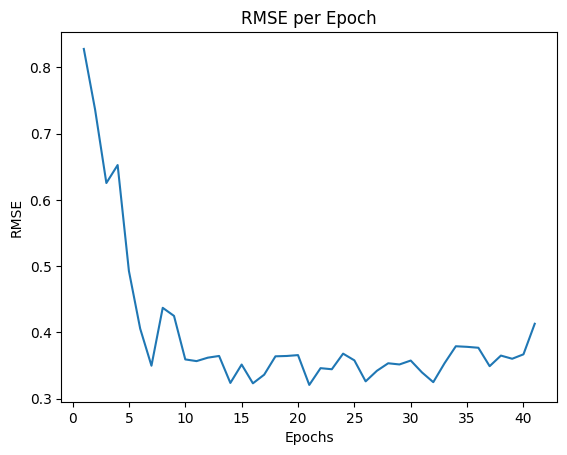

| 12        | -7.815    | 10.0      | 41.94     |
Epoch 1/44, RMSE: 0.8119
Epoch 2/44, RMSE: 0.5438
Epoch 3/44, RMSE: 0.4850
Epoch 4/44, RMSE: 0.4674
Epoch 5/44, RMSE: 0.4445
Epoch 6/44, RMSE: 0.4558
Epoch 7/44, RMSE: 0.3013
Epoch 8/44, RMSE: 0.3193
Epoch 9/44, RMSE: 0.3192
Epoch 10/44, RMSE: 0.3172
Epoch 11/44, RMSE: 0.3500
Epoch 12/44, RMSE: 0.3356
Epoch 13/44, RMSE: 0.3565
Epoch 14/44, RMSE: 0.3509
Epoch 15/44, RMSE: 0.3629
Epoch 16/44, RMSE: 0.3519
Epoch 17/44, RMSE: 0.3793
Epoch 18/44, RMSE: 0.3637
Epoch 19/44, RMSE: 0.4003
Epoch 20/44, RMSE: 0.4063
Epoch 21/44, RMSE: 0.3649
Epoch 22/44, RMSE: 0.3453
Epoch 23/44, RMSE: 0.3801
Epoch 24/44, RMSE: 0.3521
Epoch 25/44, RMSE: 0.3786
Epoch 26/44, RMSE: 0.3753
Epoch 27/44, RMSE: 0.3685
Epoch 28/44, RMSE: 0.3952
Epoch 29/44, RMSE: 0.3845
Epoch 30/44, RMSE: 0.3663
Epoch 31/44, RMSE: 0.3397
Epoch 32/44, RMSE: 0.3653
Epoch 33/44, RMSE: 0.3480
Epoch 34/44, RMSE: 0.3663
Epoch 35/44, RMSE: 0.3910
Epoch 36/44, RMSE: 0.3675
Epoch 37/44, RMSE: 0.37

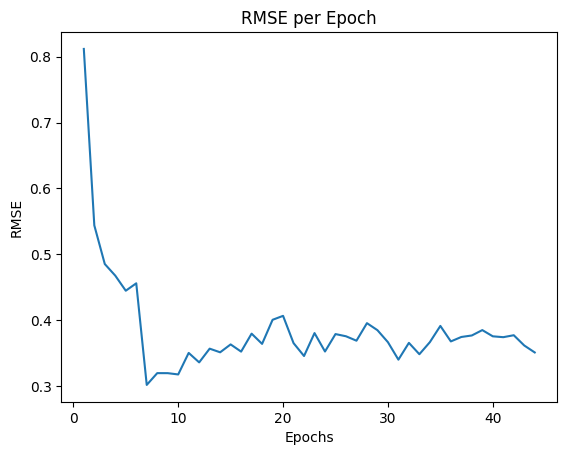

| 13        | -7.163    | 14.07     | 44.55     |
Epoch 1/43, RMSE: 0.7791
Epoch 2/43, RMSE: 0.4984
Epoch 3/43, RMSE: 0.5333
Epoch 4/43, RMSE: 0.4142
Epoch 5/43, RMSE: 0.3686
Epoch 6/43, RMSE: 0.3344
Epoch 7/43, RMSE: 0.4106
Epoch 8/43, RMSE: 0.3625
Epoch 9/43, RMSE: 0.4241
Epoch 10/43, RMSE: 0.3595
Epoch 11/43, RMSE: 0.3671
Epoch 12/43, RMSE: 0.3867
Epoch 13/43, RMSE: 0.3752
Epoch 14/43, RMSE: 0.3659
Epoch 15/43, RMSE: 0.3746
Epoch 16/43, RMSE: 0.3668
Epoch 17/43, RMSE: 0.3626
Epoch 18/43, RMSE: 0.3645
Epoch 19/43, RMSE: 0.3830
Epoch 20/43, RMSE: 0.3925
Epoch 21/43, RMSE: 0.3818
Epoch 22/43, RMSE: 0.3703
Epoch 23/43, RMSE: 0.4025
Epoch 24/43, RMSE: 0.3780
Epoch 25/43, RMSE: 0.3739
Epoch 26/43, RMSE: 0.3783
Epoch 27/43, RMSE: 0.4174
Epoch 28/43, RMSE: 0.3615
Epoch 29/43, RMSE: 0.3983
Epoch 30/43, RMSE: 0.3846
Epoch 31/43, RMSE: 0.3914
Epoch 32/43, RMSE: 0.3774
Epoch 33/43, RMSE: 0.3763
Epoch 34/43, RMSE: 0.3858
Epoch 35/43, RMSE: 0.4156
Epoch 36/43, RMSE: 0.4191
Epoch 37/43, RMSE: 0.40

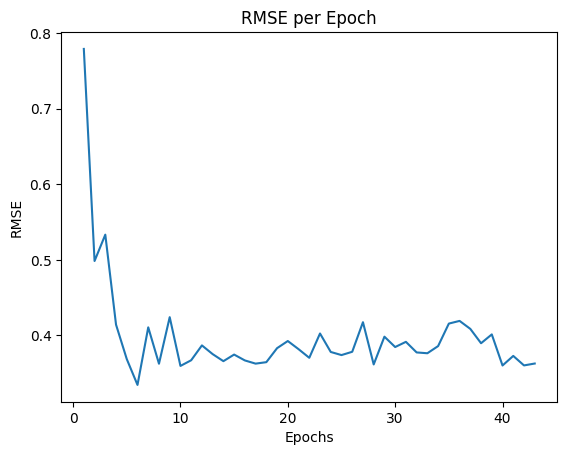

| 14        | -6.602    | 12.39     | 43.91     |
Epoch 1/44, RMSE: 0.7497
Epoch 2/44, RMSE: 0.6785
Epoch 3/44, RMSE: 0.5808
Epoch 4/44, RMSE: 0.5305
Epoch 5/44, RMSE: 0.4319
Epoch 6/44, RMSE: 0.3381
Epoch 7/44, RMSE: 0.3382
Epoch 8/44, RMSE: 0.4152
Epoch 9/44, RMSE: 0.3849
Epoch 10/44, RMSE: 0.3875
Epoch 11/44, RMSE: 0.3793
Epoch 12/44, RMSE: 0.3771
Epoch 13/44, RMSE: 0.3603
Epoch 14/44, RMSE: 0.3707
Epoch 15/44, RMSE: 0.3403
Epoch 16/44, RMSE: 0.3671
Epoch 17/44, RMSE: 0.3777
Epoch 18/44, RMSE: 0.3370
Epoch 19/44, RMSE: 0.3659
Epoch 20/44, RMSE: 0.3707
Epoch 21/44, RMSE: 0.3629
Epoch 22/44, RMSE: 0.3657
Epoch 23/44, RMSE: 0.3472
Epoch 24/44, RMSE: 0.3496
Epoch 25/44, RMSE: 0.3636
Epoch 26/44, RMSE: 0.3289
Epoch 27/44, RMSE: 0.3242
Epoch 28/44, RMSE: 0.3085
Epoch 29/44, RMSE: 0.3341
Epoch 30/44, RMSE: 0.3297
Epoch 31/44, RMSE: 0.3484
Epoch 32/44, RMSE: 0.3088
Epoch 33/44, RMSE: 0.3228
Epoch 34/44, RMSE: 0.3131
Epoch 35/44, RMSE: 0.3181
Epoch 36/44, RMSE: 0.3293
Epoch 37/44, RMSE: 0.31

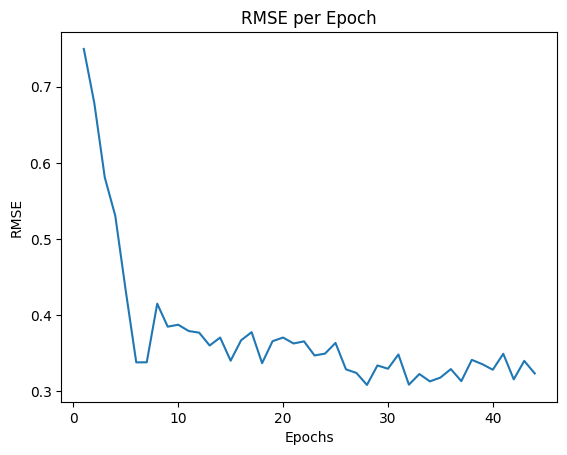

| 15        | -7.245    | 11.75     | 44.89     |
Epoch 1/18, RMSE: 0.7605
Epoch 2/18, RMSE: 0.6453
Epoch 3/18, RMSE: 0.5551
Epoch 4/18, RMSE: 0.4846
Epoch 5/18, RMSE: 0.4338
Epoch 6/18, RMSE: 0.3599
Epoch 7/18, RMSE: 0.3372
Epoch 8/18, RMSE: 0.3311
Epoch 9/18, RMSE: 0.3480
Epoch 10/18, RMSE: 0.3275
Epoch 11/18, RMSE: 0.3561
Epoch 12/18, RMSE: 0.3293
Epoch 13/18, RMSE: 0.3516
Epoch 14/18, RMSE: 0.3478
Epoch 15/18, RMSE: 0.3531
Epoch 16/18, RMSE: 0.3359
Epoch 17/18, RMSE: 0.3552
Epoch 18/18, RMSE: 0.3456


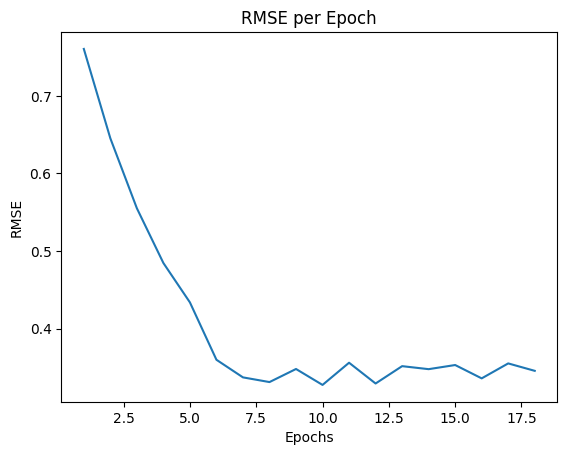

| 16        | -6.367    | 11.3      | 18.61     |
Epoch 1/42, RMSE: 0.5735
Epoch 2/42, RMSE: 0.5340
Epoch 3/42, RMSE: 0.4669
Epoch 4/42, RMSE: 0.3705
Epoch 5/42, RMSE: 0.3384
Epoch 6/42, RMSE: 0.3285
Epoch 7/42, RMSE: 0.3175
Epoch 8/42, RMSE: 0.2890
Epoch 9/42, RMSE: 0.3118
Epoch 10/42, RMSE: 0.3303
Epoch 11/42, RMSE: 0.3342
Epoch 12/42, RMSE: 0.3568
Epoch 13/42, RMSE: 0.3615
Epoch 14/42, RMSE: 0.3783
Epoch 15/42, RMSE: 0.3972
Epoch 16/42, RMSE: 0.3798
Epoch 17/42, RMSE: 0.3830
Epoch 18/42, RMSE: 0.3866
Epoch 19/42, RMSE: 0.4163
Epoch 20/42, RMSE: 0.4042
Epoch 21/42, RMSE: 0.4044
Epoch 22/42, RMSE: 0.4087
Epoch 23/42, RMSE: 0.4147
Epoch 24/42, RMSE: 0.4031
Epoch 25/42, RMSE: 0.3867
Epoch 26/42, RMSE: 0.3850
Epoch 27/42, RMSE: 0.3914
Epoch 28/42, RMSE: 0.3884
Epoch 29/42, RMSE: 0.4183
Epoch 30/42, RMSE: 0.3965
Epoch 31/42, RMSE: 0.4152
Epoch 32/42, RMSE: 0.3991
Epoch 33/42, RMSE: 0.3986
Epoch 34/42, RMSE: 0.4046
Epoch 35/42, RMSE: 0.4043
Epoch 36/42, RMSE: 0.4097
Epoch 37/42, RMSE: 0.41

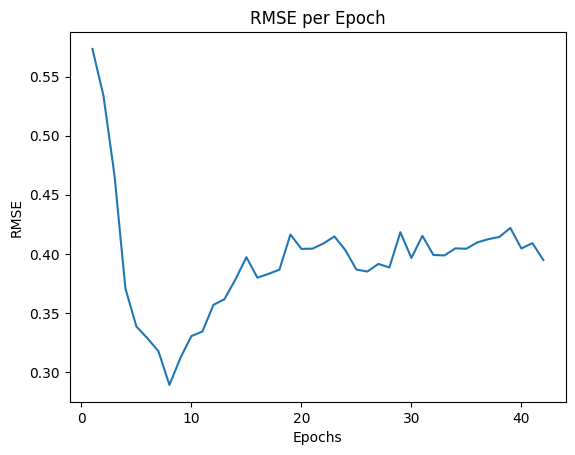

| 17        | -6.934    | 27.67     | 42.97     |
Epoch 1/27, RMSE: 0.7050
Epoch 2/27, RMSE: 0.6845
Epoch 3/27, RMSE: 0.6312
Epoch 4/27, RMSE: 0.5939
Epoch 5/27, RMSE: 0.5318
Epoch 6/27, RMSE: 0.4306
Epoch 7/27, RMSE: 0.3590
Epoch 8/27, RMSE: 0.3618
Epoch 9/27, RMSE: 0.3862
Epoch 10/27, RMSE: 0.3679
Epoch 11/27, RMSE: 0.3863
Epoch 12/27, RMSE: 0.3899
Epoch 13/27, RMSE: 0.3663
Epoch 14/27, RMSE: 0.4453
Epoch 15/27, RMSE: 0.3671
Epoch 16/27, RMSE: 0.3631
Epoch 17/27, RMSE: 0.3616
Epoch 18/27, RMSE: 0.3454
Epoch 19/27, RMSE: 0.3559
Epoch 20/27, RMSE: 0.3523
Epoch 21/27, RMSE: 0.3718
Epoch 22/27, RMSE: 0.3705
Epoch 23/27, RMSE: 0.3325
Epoch 24/27, RMSE: 0.3512
Epoch 25/27, RMSE: 0.3369
Epoch 26/27, RMSE: 0.3927
Epoch 27/27, RMSE: 0.3597


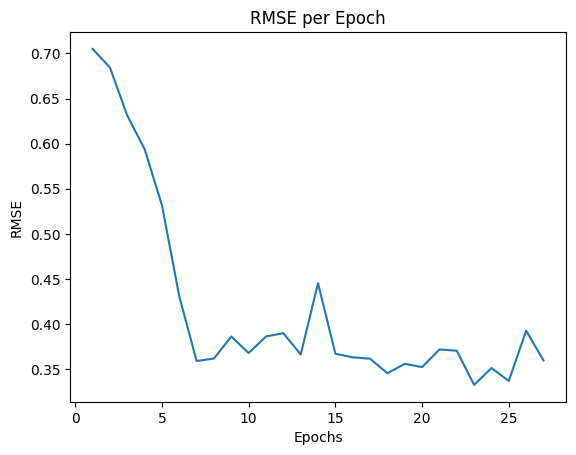

| 18        | -5.64     | 10.74     | 27.53     |
Epoch 1/29, RMSE: 0.6692
Epoch 2/29, RMSE: 0.5385
Epoch 3/29, RMSE: 0.4653
Epoch 4/29, RMSE: 0.4066
Epoch 5/29, RMSE: 0.3722
Epoch 6/29, RMSE: 0.3614
Epoch 7/29, RMSE: 0.3311
Epoch 8/29, RMSE: 0.2713
Epoch 9/29, RMSE: 0.2855
Epoch 10/29, RMSE: 0.2932
Epoch 11/29, RMSE: 0.2896
Epoch 12/29, RMSE: 0.3122
Epoch 13/29, RMSE: 0.3469
Epoch 14/29, RMSE: 0.3388
Epoch 15/29, RMSE: 0.3334
Epoch 16/29, RMSE: 0.3058
Epoch 17/29, RMSE: 0.3352
Epoch 18/29, RMSE: 0.3284
Epoch 19/29, RMSE: 0.3530
Epoch 20/29, RMSE: 0.3325
Epoch 21/29, RMSE: 0.3258
Epoch 22/29, RMSE: 0.3361
Epoch 23/29, RMSE: 0.3580
Epoch 24/29, RMSE: 0.3620
Epoch 25/29, RMSE: 0.3433
Epoch 26/29, RMSE: 0.3389
Epoch 27/29, RMSE: 0.3619
Epoch 28/29, RMSE: 0.3623
Epoch 29/29, RMSE: 0.3810


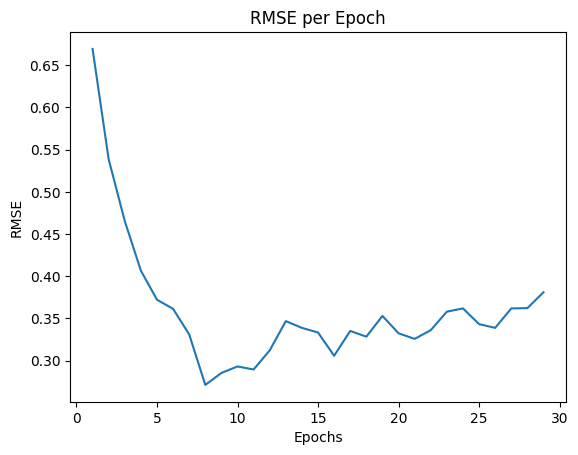

| 19        | -7.332    | 25.81     | 29.49     |
Epoch 1/14, RMSE: 0.5730
Epoch 2/14, RMSE: 0.4361
Epoch 3/14, RMSE: 0.3751
Epoch 4/14, RMSE: 0.3373
Epoch 5/14, RMSE: 0.3241
Epoch 6/14, RMSE: 0.3053
Epoch 7/14, RMSE: 0.3130
Epoch 8/14, RMSE: 0.2827
Epoch 9/14, RMSE: 0.3187
Epoch 10/14, RMSE: 0.3273
Epoch 11/14, RMSE: 0.3288
Epoch 12/14, RMSE: 0.3523
Epoch 13/14, RMSE: 0.3695
Epoch 14/14, RMSE: 0.4033


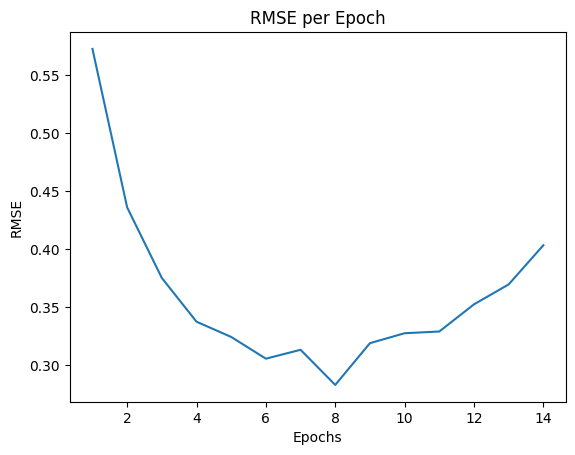

| 20        | -6.724    | 37.61     | 14.9      |
Epoch 1/16, RMSE: 0.6272
Epoch 2/16, RMSE: 0.5537
Epoch 3/16, RMSE: 0.3679
Epoch 4/16, RMSE: 0.3195
Epoch 5/16, RMSE: 0.2950
Epoch 6/16, RMSE: 0.2872
Epoch 7/16, RMSE: 0.2880
Epoch 8/16, RMSE: 0.2563
Epoch 9/16, RMSE: 0.2738
Epoch 10/16, RMSE: 0.2862
Epoch 11/16, RMSE: 0.2823
Epoch 12/16, RMSE: 0.3341
Epoch 13/16, RMSE: 0.3623
Epoch 14/16, RMSE: 0.3747
Epoch 15/16, RMSE: 0.3915
Epoch 16/16, RMSE: 0.3904


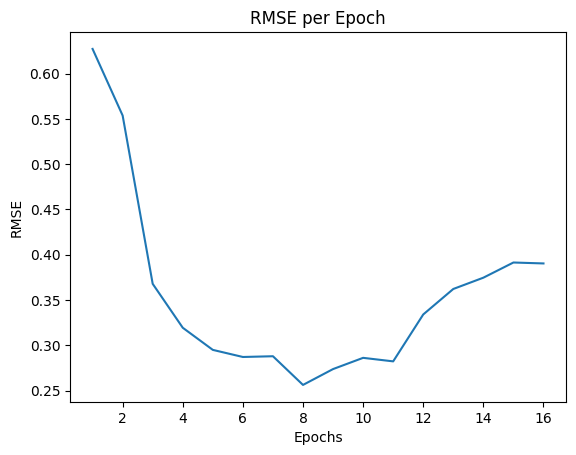

| 21        | -6.713    | 34.16     | 16.07     |
Epoch 1/45, RMSE: 0.6122
Epoch 2/45, RMSE: 0.3677
Epoch 3/45, RMSE: 0.2888
Epoch 4/45, RMSE: 0.3040
Epoch 5/45, RMSE: 0.2836
Epoch 6/45, RMSE: 0.2468
Epoch 7/45, RMSE: 0.2665
Epoch 8/45, RMSE: 0.2696
Epoch 9/45, RMSE: 0.2566
Epoch 10/45, RMSE: 0.2755
Epoch 11/45, RMSE: 0.2918
Epoch 12/45, RMSE: 0.2933
Epoch 13/45, RMSE: 0.3490
Epoch 14/45, RMSE: 0.3386
Epoch 15/45, RMSE: 0.3565
Epoch 16/45, RMSE: 0.3809
Epoch 17/45, RMSE: 0.3841
Epoch 18/45, RMSE: 0.3893
Epoch 19/45, RMSE: 0.3632
Epoch 20/45, RMSE: 0.3925
Epoch 21/45, RMSE: 0.3834
Epoch 22/45, RMSE: 0.4354
Epoch 23/45, RMSE: 0.3901
Epoch 24/45, RMSE: 0.4140
Epoch 25/45, RMSE: 0.4057
Epoch 26/45, RMSE: 0.4020
Epoch 27/45, RMSE: 0.3934
Epoch 28/45, RMSE: 0.4087
Epoch 29/45, RMSE: 0.3961
Epoch 30/45, RMSE: 0.3714
Epoch 31/45, RMSE: 0.4073
Epoch 32/45, RMSE: 0.3901
Epoch 33/45, RMSE: 0.3979
Epoch 34/45, RMSE: 0.3949
Epoch 35/45, RMSE: 0.3915
Epoch 36/45, RMSE: 0.4148
Epoch 37/45, RMSE: 0.40

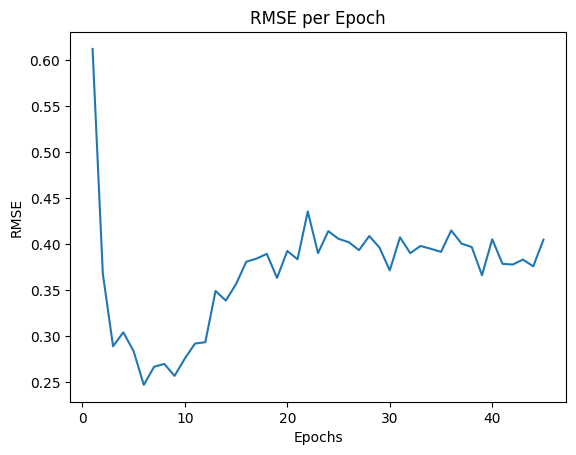

| 22        | -7.238    | 41.71     | 45.36     |
Epoch 1/16, RMSE: 0.5854
Epoch 2/16, RMSE: 0.5109
Epoch 3/16, RMSE: 0.4507
Epoch 4/16, RMSE: 0.4443
Epoch 5/16, RMSE: 0.3795
Epoch 6/16, RMSE: 0.3233
Epoch 7/16, RMSE: 0.3093
Epoch 8/16, RMSE: 0.2579
Epoch 9/16, RMSE: 0.2476
Epoch 10/16, RMSE: 0.2620
Epoch 11/16, RMSE: 0.2565
Epoch 12/16, RMSE: 0.2769
Epoch 13/16, RMSE: 0.3062
Epoch 14/16, RMSE: 0.3206
Epoch 15/16, RMSE: 0.3327
Epoch 16/16, RMSE: 0.3086


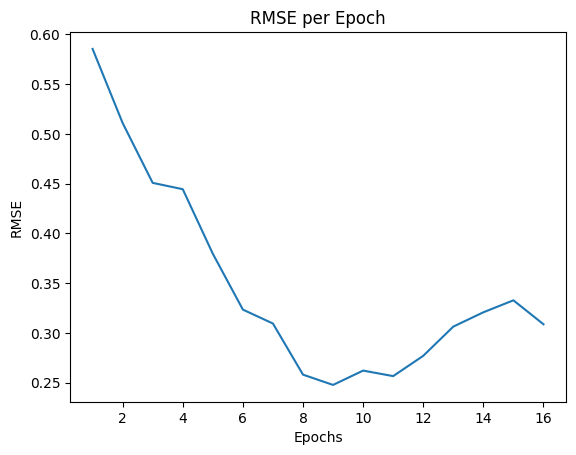

| 23        | -6.974    | 26.78     | 16.62     |
Epoch 1/17, RMSE: 0.6069
Epoch 2/17, RMSE: 0.6469
Epoch 3/17, RMSE: 0.5037
Epoch 4/17, RMSE: 0.4562
Epoch 5/17, RMSE: 0.4005
Epoch 6/17, RMSE: 0.3888
Epoch 7/17, RMSE: 0.3194
Epoch 8/17, RMSE: 0.3348
Epoch 9/17, RMSE: 0.3428
Epoch 10/17, RMSE: 0.3418
Epoch 11/17, RMSE: 0.3641
Epoch 12/17, RMSE: 0.3599
Epoch 13/17, RMSE: 0.3642
Epoch 14/17, RMSE: 0.3763
Epoch 15/17, RMSE: 0.4050
Epoch 16/17, RMSE: 0.3900
Epoch 17/17, RMSE: 0.4228


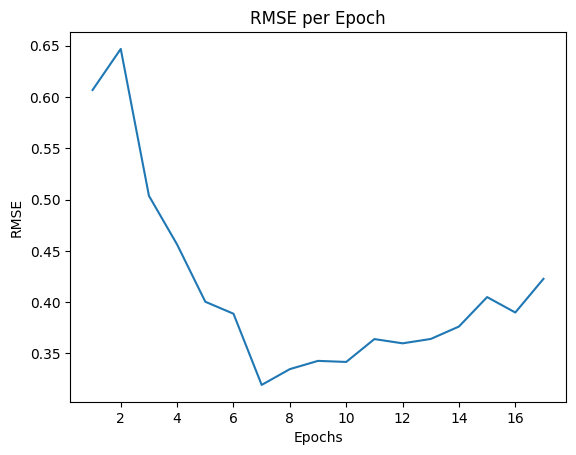

| 24        | -7.341    | 14.6      | 17.94     |
Epoch 1/20, RMSE: 0.5441
Epoch 2/20, RMSE: 0.3474
Epoch 3/20, RMSE: 0.2847
Epoch 4/20, RMSE: 0.3494
Epoch 5/20, RMSE: 0.2624
Epoch 6/20, RMSE: 0.2477
Epoch 7/20, RMSE: 0.2794
Epoch 8/20, RMSE: 0.2316
Epoch 9/20, RMSE: 0.2833
Epoch 10/20, RMSE: 0.2287
Epoch 11/20, RMSE: 0.2788
Epoch 12/20, RMSE: 0.2622
Epoch 13/20, RMSE: 0.2952
Epoch 14/20, RMSE: 0.2753
Epoch 15/20, RMSE: 0.2959
Epoch 16/20, RMSE: 0.2878
Epoch 17/20, RMSE: 0.2977
Epoch 18/20, RMSE: 0.3241
Epoch 19/20, RMSE: 0.3196
Epoch 20/20, RMSE: 0.3604


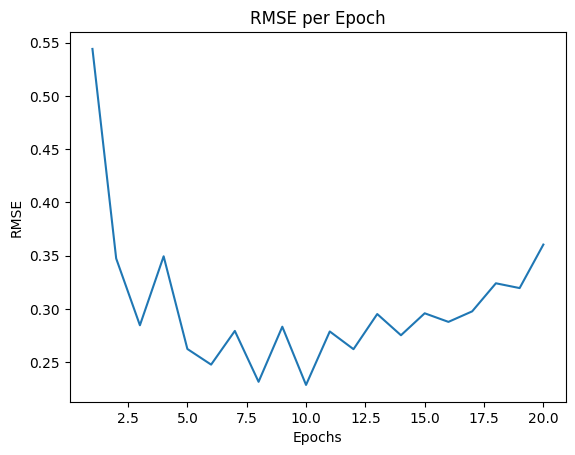

| 25        | -6.855    | 48.22     | 20.46     |
Epoch 1/42, RMSE: 0.4654
Epoch 2/42, RMSE: 0.4838
Epoch 3/42, RMSE: 0.3682
Epoch 4/42, RMSE: 0.3327
Epoch 5/42, RMSE: 0.3312
Epoch 6/42, RMSE: 0.3183
Epoch 7/42, RMSE: 0.3074
Epoch 8/42, RMSE: 0.3354
Epoch 9/42, RMSE: 0.3221
Epoch 10/42, RMSE: 0.3332
Epoch 11/42, RMSE: 0.3351
Epoch 12/42, RMSE: 0.3638
Epoch 13/42, RMSE: 0.3623
Epoch 14/42, RMSE: 0.3811
Epoch 15/42, RMSE: 0.4222
Epoch 16/42, RMSE: 0.4329
Epoch 17/42, RMSE: 0.4079
Epoch 18/42, RMSE: 0.4197
Epoch 19/42, RMSE: 0.4653
Epoch 20/42, RMSE: 0.4434
Epoch 21/42, RMSE: 0.4493
Epoch 22/42, RMSE: 0.4488
Epoch 23/42, RMSE: 0.4295
Epoch 24/42, RMSE: 0.4502
Epoch 25/42, RMSE: 0.4310
Epoch 26/42, RMSE: 0.4224
Epoch 27/42, RMSE: 0.4414
Epoch 28/42, RMSE: 0.4309
Epoch 29/42, RMSE: 0.4553
Epoch 30/42, RMSE: 0.4756
Epoch 31/42, RMSE: 0.4344
Epoch 32/42, RMSE: 0.4165
Epoch 33/42, RMSE: 0.4272
Epoch 34/42, RMSE: 0.4210
Epoch 35/42, RMSE: 0.4258
Epoch 36/42, RMSE: 0.4334
Epoch 37/42, RMSE: 0.41

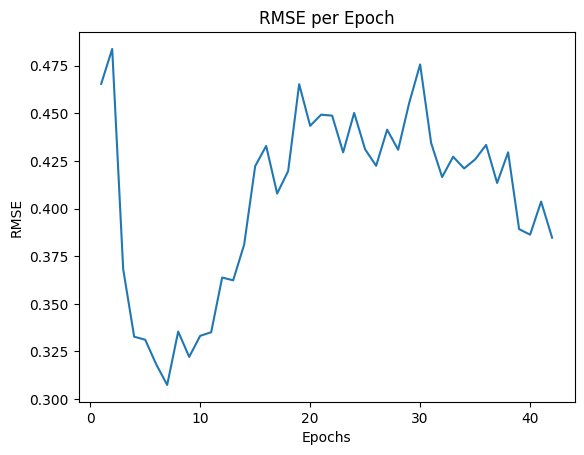

| 26        | -6.417    | 42.54     | 42.09     |
Epoch 1/41, RMSE: 0.6158
Epoch 2/41, RMSE: 0.5789
Epoch 3/41, RMSE: 0.5219
Epoch 4/41, RMSE: 0.4876
Epoch 5/41, RMSE: 0.3920
Epoch 6/41, RMSE: 0.4192
Epoch 7/41, RMSE: 0.3242
Epoch 8/41, RMSE: 0.3594
Epoch 9/41, RMSE: 0.3338
Epoch 10/41, RMSE: 0.3362
Epoch 11/41, RMSE: 0.3948
Epoch 12/41, RMSE: 0.3679
Epoch 13/41, RMSE: 0.3820
Epoch 14/41, RMSE: 0.3432
Epoch 15/41, RMSE: 0.3950
Epoch 16/41, RMSE: 0.3713
Epoch 17/41, RMSE: 0.3632
Epoch 18/41, RMSE: 0.3635
Epoch 19/41, RMSE: 0.3966
Epoch 20/41, RMSE: 0.4232
Epoch 21/41, RMSE: 0.4076
Epoch 22/41, RMSE: 0.4275
Epoch 23/41, RMSE: 0.4208
Epoch 24/41, RMSE: 0.4021
Epoch 25/41, RMSE: 0.3920
Epoch 26/41, RMSE: 0.4102
Epoch 27/41, RMSE: 0.4171
Epoch 28/41, RMSE: 0.4172
Epoch 29/41, RMSE: 0.4349
Epoch 30/41, RMSE: 0.4620
Epoch 31/41, RMSE: 0.4128
Epoch 32/41, RMSE: 0.4611
Epoch 33/41, RMSE: 0.4424
Epoch 34/41, RMSE: 0.4147
Epoch 35/41, RMSE: 0.4289
Epoch 36/41, RMSE: 0.4529
Epoch 37/41, RMSE: 0.41

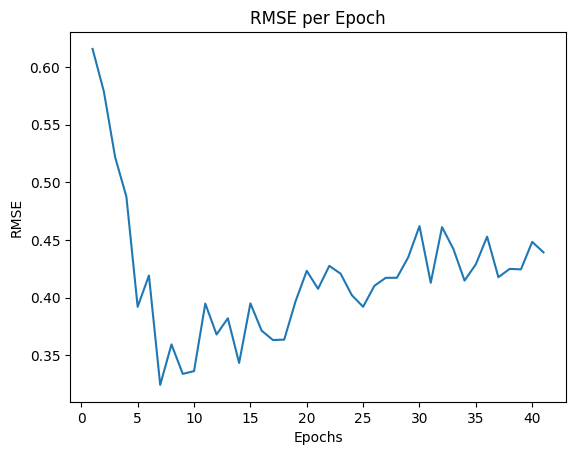

| 27        | -6.915    | 18.33     | 41.0      |
Epoch 1/37, RMSE: 0.5475
Epoch 2/37, RMSE: 0.3467
Epoch 3/37, RMSE: 0.2948
Epoch 4/37, RMSE: 0.3079
Epoch 5/37, RMSE: 0.2557
Epoch 6/37, RMSE: 0.2432
Epoch 7/37, RMSE: 0.2297
Epoch 8/37, RMSE: 0.2291
Epoch 9/37, RMSE: 0.2400
Epoch 10/37, RMSE: 0.2910
Epoch 11/37, RMSE: 0.2184
Epoch 12/37, RMSE: 0.3155
Epoch 13/37, RMSE: 0.3228
Epoch 14/37, RMSE: 0.3416
Epoch 15/37, RMSE: 0.3074
Epoch 16/37, RMSE: 0.3688
Epoch 17/37, RMSE: 0.3313
Epoch 18/37, RMSE: 0.3499
Epoch 19/37, RMSE: 0.3629
Epoch 20/37, RMSE: 0.3606
Epoch 21/37, RMSE: 0.3963
Epoch 22/37, RMSE: 0.3135
Epoch 23/37, RMSE: 0.3480
Epoch 24/37, RMSE: 0.3544
Epoch 25/37, RMSE: 0.3735
Epoch 26/37, RMSE: 0.3929
Epoch 27/37, RMSE: 0.3581
Epoch 28/37, RMSE: 0.3580
Epoch 29/37, RMSE: 0.3561
Epoch 30/37, RMSE: 0.3676
Epoch 31/37, RMSE: 0.3640
Epoch 32/37, RMSE: 0.3648
Epoch 33/37, RMSE: 0.3736
Epoch 34/37, RMSE: 0.3709
Epoch 35/37, RMSE: 0.3661
Epoch 36/37, RMSE: 0.3719
Epoch 37/37, RMSE: 0.36

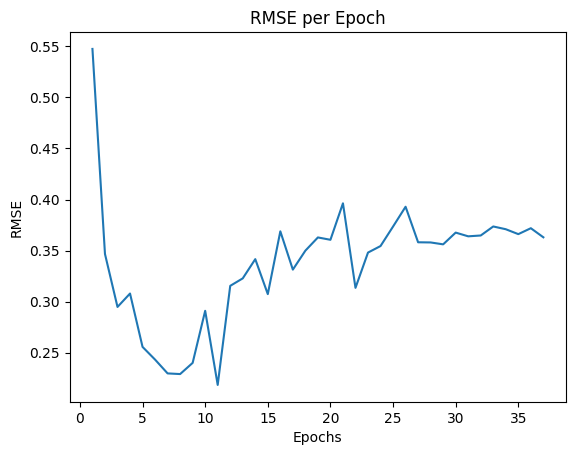

| 28        | -6.508    | 42.77     | 37.23     |
Epoch 1/36, RMSE: 0.6769
Epoch 2/36, RMSE: 0.5017
Epoch 3/36, RMSE: 0.4738
Epoch 4/36, RMSE: 0.4455
Epoch 5/36, RMSE: 0.3780
Epoch 6/36, RMSE: 0.3512
Epoch 7/36, RMSE: 0.3520
Epoch 8/36, RMSE: 0.3236
Epoch 9/36, RMSE: 0.2998
Epoch 10/36, RMSE: 0.3117
Epoch 11/36, RMSE: 0.2939
Epoch 12/36, RMSE: 0.2900
Epoch 13/36, RMSE: 0.3220
Epoch 14/36, RMSE: 0.3223
Epoch 15/36, RMSE: 0.3467
Epoch 16/36, RMSE: 0.3887
Epoch 17/36, RMSE: 0.3732
Epoch 18/36, RMSE: 0.4269
Epoch 19/36, RMSE: 0.3917
Epoch 20/36, RMSE: 0.3916
Epoch 21/36, RMSE: 0.3862
Epoch 22/36, RMSE: 0.3946
Epoch 23/36, RMSE: 0.4054
Epoch 24/36, RMSE: 0.3887
Epoch 25/36, RMSE: 0.3923
Epoch 26/36, RMSE: 0.4070
Epoch 27/36, RMSE: 0.3856
Epoch 28/36, RMSE: 0.4029
Epoch 29/36, RMSE: 0.3990
Epoch 30/36, RMSE: 0.3826
Epoch 31/36, RMSE: 0.3879
Epoch 32/36, RMSE: 0.3892
Epoch 33/36, RMSE: 0.3964
Epoch 34/36, RMSE: 0.4345
Epoch 35/36, RMSE: 0.4240
Epoch 36/36, RMSE: 0.4188


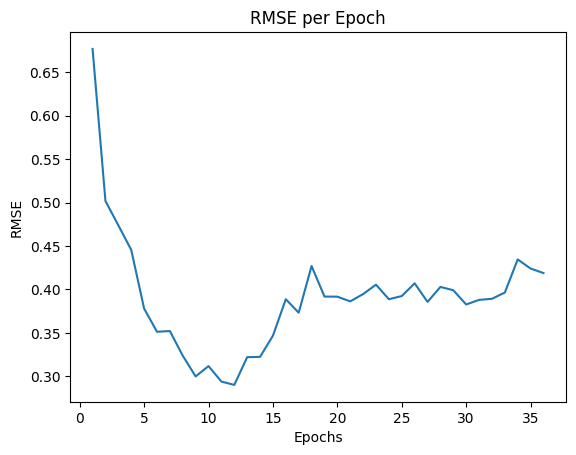

| 29        | -7.502    | 30.08     | 36.88     |
Epoch 1/40, RMSE: 0.5819
Epoch 2/40, RMSE: 0.4372
Epoch 3/40, RMSE: 0.3618
Epoch 4/40, RMSE: 0.3188
Epoch 5/40, RMSE: 0.2966
Epoch 6/40, RMSE: 0.2790
Epoch 7/40, RMSE: 0.2468
Epoch 8/40, RMSE: 0.2473
Epoch 9/40, RMSE: 0.2614
Epoch 10/40, RMSE: 0.2658
Epoch 11/40, RMSE: 0.2305
Epoch 12/40, RMSE: 0.2661
Epoch 13/40, RMSE: 0.2341
Epoch 14/40, RMSE: 0.2686
Epoch 15/40, RMSE: 0.2735
Epoch 16/40, RMSE: 0.2833
Epoch 17/40, RMSE: 0.2970
Epoch 18/40, RMSE: 0.3456
Epoch 19/40, RMSE: 0.3134
Epoch 20/40, RMSE: 0.3032
Epoch 21/40, RMSE: 0.3592
Epoch 22/40, RMSE: 0.3277
Epoch 23/40, RMSE: 0.3373
Epoch 24/40, RMSE: 0.3137
Epoch 25/40, RMSE: 0.3492
Epoch 26/40, RMSE: 0.3348
Epoch 27/40, RMSE: 0.3324
Epoch 28/40, RMSE: 0.3295
Epoch 29/40, RMSE: 0.3376
Epoch 30/40, RMSE: 0.3567
Epoch 31/40, RMSE: 0.3606
Epoch 32/40, RMSE: 0.3567
Epoch 33/40, RMSE: 0.3524
Epoch 34/40, RMSE: 0.3778
Epoch 35/40, RMSE: 0.3656
Epoch 36/40, RMSE: 0.3515
Epoch 37/40, RMSE: 0.36

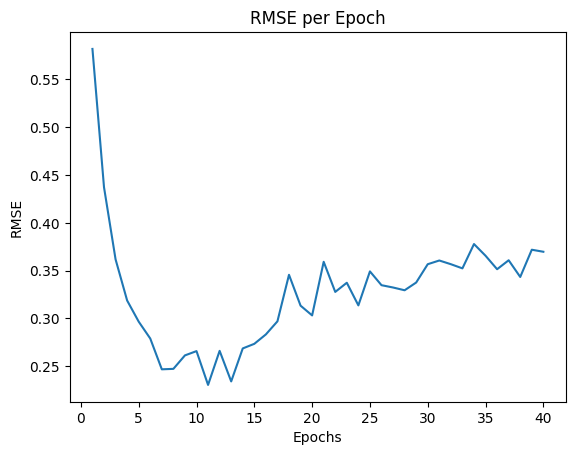

| 30        | -7.01     | 35.39     | 40.61     |
Epoch 1/42, RMSE: 0.5959
Epoch 2/42, RMSE: 0.5507
Epoch 3/42, RMSE: 0.4438
Epoch 4/42, RMSE: 0.4181
Epoch 5/42, RMSE: 0.3819
Epoch 6/42, RMSE: 0.3615
Epoch 7/42, RMSE: 0.3530
Epoch 8/42, RMSE: 0.3164
Epoch 9/42, RMSE: 0.3154
Epoch 10/42, RMSE: 0.2775
Epoch 11/42, RMSE: 0.3167
Epoch 12/42, RMSE: 0.2818
Epoch 13/42, RMSE: 0.2963
Epoch 14/42, RMSE: 0.2980
Epoch 15/42, RMSE: 0.2997
Epoch 16/42, RMSE: 0.3391
Epoch 17/42, RMSE: 0.3342
Epoch 18/42, RMSE: 0.3467
Epoch 19/42, RMSE: 0.3328
Epoch 20/42, RMSE: 0.3939
Epoch 21/42, RMSE: 0.3573
Epoch 22/42, RMSE: 0.3816
Epoch 23/42, RMSE: 0.3829
Epoch 24/42, RMSE: 0.3985
Epoch 25/42, RMSE: 0.3637
Epoch 26/42, RMSE: 0.3742
Epoch 27/42, RMSE: 0.3479
Epoch 28/42, RMSE: 0.3651
Epoch 29/42, RMSE: 0.3403
Epoch 30/42, RMSE: 0.3595
Epoch 31/42, RMSE: 0.3805
Epoch 32/42, RMSE: 0.3721
Epoch 33/42, RMSE: 0.3319
Epoch 34/42, RMSE: 0.3802
Epoch 35/42, RMSE: 0.3504
Epoch 36/42, RMSE: 0.3528
Epoch 37/42, RMSE: 0.38

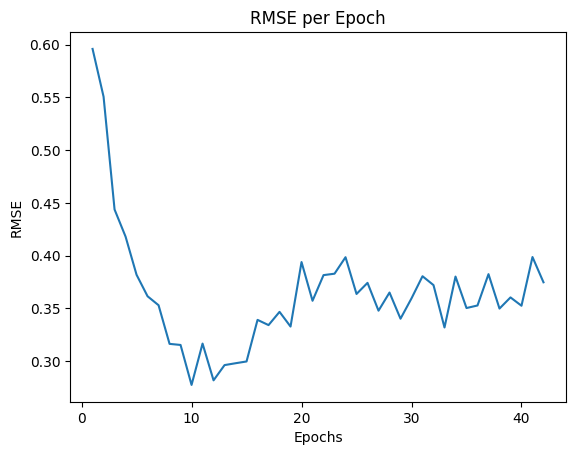

| 31        | -6.935    | 26.38     | 42.06     |
Epoch 1/26, RMSE: 0.7281
Epoch 2/26, RMSE: 0.5645
Epoch 3/26, RMSE: 0.6468
Epoch 4/26, RMSE: 0.4231
Epoch 5/26, RMSE: 0.4422
Epoch 6/26, RMSE: 0.4373
Epoch 7/26, RMSE: 0.3909
Epoch 8/26, RMSE: 0.4118
Epoch 9/26, RMSE: 0.3759
Epoch 10/26, RMSE: 0.3348
Epoch 11/26, RMSE: 0.3232
Epoch 12/26, RMSE: 0.3803
Epoch 13/26, RMSE: 0.3986
Epoch 14/26, RMSE: 0.3602
Epoch 15/26, RMSE: 0.3728
Epoch 16/26, RMSE: 0.3574
Epoch 17/26, RMSE: 0.3756
Epoch 18/26, RMSE: 0.3924
Epoch 19/26, RMSE: 0.3765
Epoch 20/26, RMSE: 0.3552
Epoch 21/26, RMSE: 0.3892
Epoch 22/26, RMSE: 0.3858
Epoch 23/26, RMSE: 0.3404
Epoch 24/26, RMSE: 0.3579
Epoch 25/26, RMSE: 0.3870
Epoch 26/26, RMSE: 0.3666


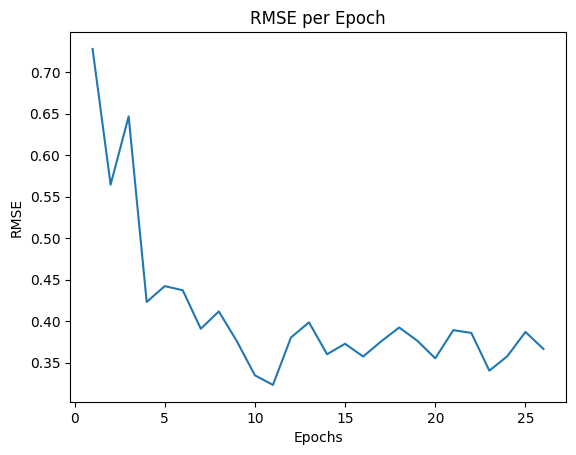

| 32        | -4.992    | 12.72     | 26.45     |
Epoch 1/45, RMSE: 0.7418
Epoch 2/45, RMSE: 0.6973
Epoch 3/45, RMSE: 0.5830
Epoch 4/45, RMSE: 0.5125
Epoch 5/45, RMSE: 0.4864
Epoch 6/45, RMSE: 0.3980
Epoch 7/45, RMSE: 0.4003
Epoch 8/45, RMSE: 0.4000
Epoch 9/45, RMSE: 0.3933
Epoch 10/45, RMSE: 0.3865
Epoch 11/45, RMSE: 0.3857
Epoch 12/45, RMSE: 0.4016
Epoch 13/45, RMSE: 0.4156
Epoch 14/45, RMSE: 0.3924
Epoch 15/45, RMSE: 0.3869
Epoch 16/45, RMSE: 0.3191
Epoch 17/45, RMSE: 0.3391
Epoch 18/45, RMSE: 0.3130
Epoch 19/45, RMSE: 0.3488
Epoch 20/45, RMSE: 0.3600
Epoch 21/45, RMSE: 0.3630
Epoch 22/45, RMSE: 0.3671
Epoch 23/45, RMSE: 0.3527
Epoch 24/45, RMSE: 0.4054
Epoch 25/45, RMSE: 0.3310
Epoch 26/45, RMSE: 0.3438
Epoch 27/45, RMSE: 0.3502
Epoch 28/45, RMSE: 0.3302
Epoch 29/45, RMSE: 0.3675
Epoch 30/45, RMSE: 0.3730
Epoch 31/45, RMSE: 0.3715
Epoch 32/45, RMSE: 0.3890
Epoch 33/45, RMSE: 0.3883
Epoch 34/45, RMSE: 0.4041
Epoch 35/45, RMSE: 0.3405
Epoch 36/45, RMSE: 0.3761
Epoch 37/45, RMSE: 0.38

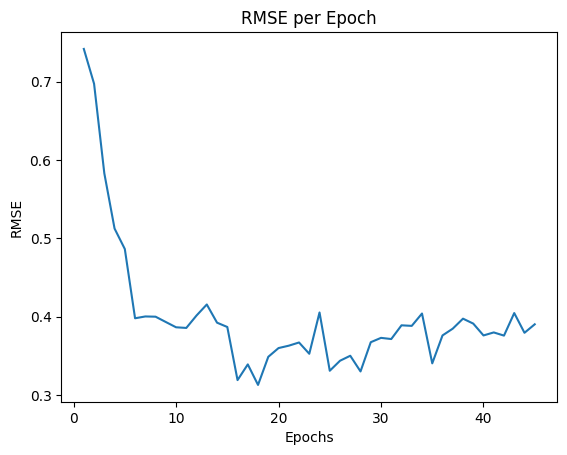

| 33        | -6.685    | 11.06     | 46.0      |
Epoch 1/14, RMSE: 0.5773
Epoch 2/14, RMSE: 0.4810
Epoch 3/14, RMSE: 0.3616
Epoch 4/14, RMSE: 0.3399
Epoch 5/14, RMSE: 0.2817
Epoch 6/14, RMSE: 0.3276
Epoch 7/14, RMSE: 0.3019
Epoch 8/14, RMSE: 0.2860
Epoch 9/14, RMSE: 0.2640
Epoch 10/14, RMSE: 0.2815
Epoch 11/14, RMSE: 0.3144
Epoch 12/14, RMSE: 0.3276
Epoch 13/14, RMSE: 0.3868
Epoch 14/14, RMSE: 0.3734


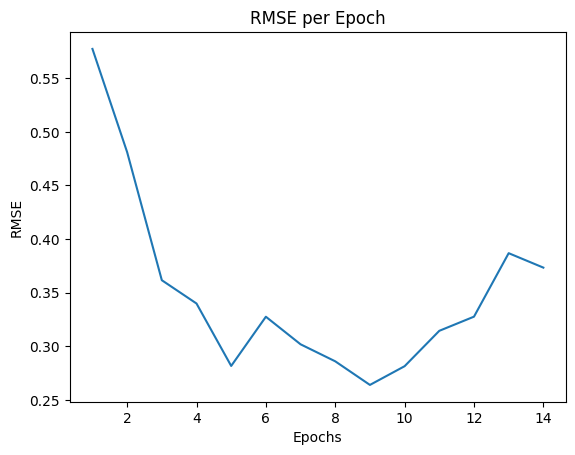

| 34        | -7.131    | 35.92     | 14.69     |
Epoch 1/24, RMSE: 0.6676
Epoch 2/24, RMSE: 0.5051
Epoch 3/24, RMSE: 0.4742
Epoch 4/24, RMSE: 0.4105
Epoch 5/24, RMSE: 0.3668
Epoch 6/24, RMSE: 0.3573
Epoch 7/24, RMSE: 0.3115
Epoch 8/24, RMSE: 0.2662
Epoch 9/24, RMSE: 0.2853
Epoch 10/24, RMSE: 0.2707
Epoch 11/24, RMSE: 0.2690
Epoch 12/24, RMSE: 0.2691
Epoch 13/24, RMSE: 0.3323
Epoch 14/24, RMSE: 0.3225
Epoch 15/24, RMSE: 0.3047
Epoch 16/24, RMSE: 0.3628
Epoch 17/24, RMSE: 0.3513
Epoch 18/24, RMSE: 0.3469
Epoch 19/24, RMSE: 0.3456
Epoch 20/24, RMSE: 0.3689
Epoch 21/24, RMSE: 0.3599
Epoch 22/24, RMSE: 0.3510
Epoch 23/24, RMSE: 0.3783
Epoch 24/24, RMSE: 0.3568


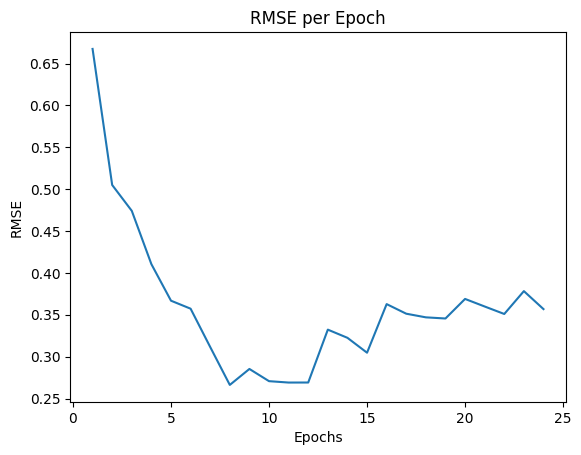

| 35        | -6.352    | 28.54     | 24.52     |
Epoch 1/41, RMSE: 0.5336
Epoch 2/41, RMSE: 0.4982
Epoch 3/41, RMSE: 0.5025
Epoch 4/41, RMSE: 0.3910
Epoch 5/41, RMSE: 0.3329
Epoch 6/41, RMSE: 0.3441
Epoch 7/41, RMSE: 0.2653
Epoch 8/41, RMSE: 0.2683
Epoch 9/41, RMSE: 0.2724
Epoch 10/41, RMSE: 0.2880
Epoch 11/41, RMSE: 0.3133
Epoch 12/41, RMSE: 0.3249
Epoch 13/41, RMSE: 0.3413
Epoch 14/41, RMSE: 0.3976
Epoch 15/41, RMSE: 0.4179
Epoch 16/41, RMSE: 0.4210
Epoch 17/41, RMSE: 0.4219
Epoch 18/41, RMSE: 0.4257
Epoch 19/41, RMSE: 0.4199
Epoch 20/41, RMSE: 0.4156
Epoch 21/41, RMSE: 0.4273
Epoch 22/41, RMSE: 0.4305
Epoch 23/41, RMSE: 0.4355
Epoch 24/41, RMSE: 0.4470
Epoch 25/41, RMSE: 0.4389
Epoch 26/41, RMSE: 0.4088
Epoch 27/41, RMSE: 0.4216
Epoch 28/41, RMSE: 0.4174
Epoch 29/41, RMSE: 0.4080
Epoch 30/41, RMSE: 0.4464
Epoch 31/41, RMSE: 0.4161
Epoch 32/41, RMSE: 0.4484
Epoch 33/41, RMSE: 0.4218
Epoch 34/41, RMSE: 0.4905
Epoch 35/41, RMSE: 0.4195
Epoch 36/41, RMSE: 0.4049
Epoch 37/41, RMSE: 0.43

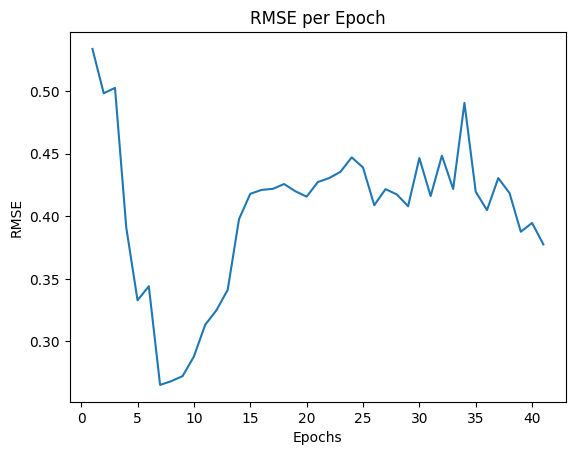

| 36        | -7.091    | 28.61     | 41.03     |
Epoch 1/12, RMSE: 0.5422
Epoch 2/12, RMSE: 0.4345
Epoch 3/12, RMSE: 0.4605
Epoch 4/12, RMSE: 0.3676
Epoch 5/12, RMSE: 0.3041
Epoch 6/12, RMSE: 0.2842
Epoch 7/12, RMSE: 0.2850
Epoch 8/12, RMSE: 0.2914
Epoch 9/12, RMSE: 0.2931
Epoch 10/12, RMSE: 0.3446
Epoch 11/12, RMSE: 0.3337
Epoch 12/12, RMSE: 0.3240


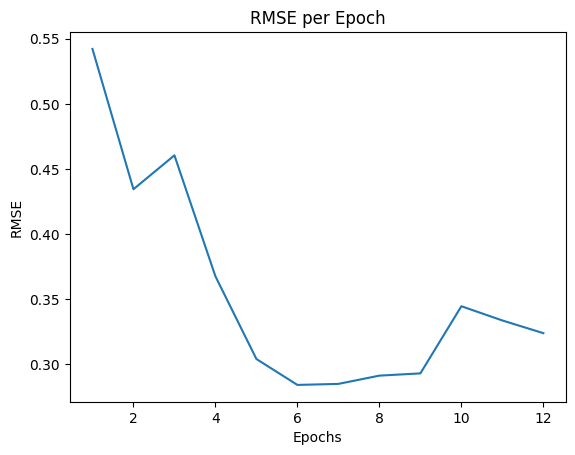

| 37        | -6.656    | 24.52     | 12.63     |
Epoch 1/18, RMSE: 0.6128
Epoch 2/18, RMSE: 0.4068
Epoch 3/18, RMSE: 0.3458
Epoch 4/18, RMSE: 0.3207
Epoch 5/18, RMSE: 0.3140
Epoch 6/18, RMSE: 0.2493
Epoch 7/18, RMSE: 0.3145
Epoch 8/18, RMSE: 0.2660
Epoch 9/18, RMSE: 0.3395
Epoch 10/18, RMSE: 0.3302
Epoch 11/18, RMSE: 0.3611
Epoch 12/18, RMSE: 0.3364
Epoch 13/18, RMSE: 0.3926
Epoch 14/18, RMSE: 0.3594
Epoch 15/18, RMSE: 0.3764
Epoch 16/18, RMSE: 0.3895
Epoch 17/18, RMSE: 0.4134
Epoch 18/18, RMSE: 0.4214


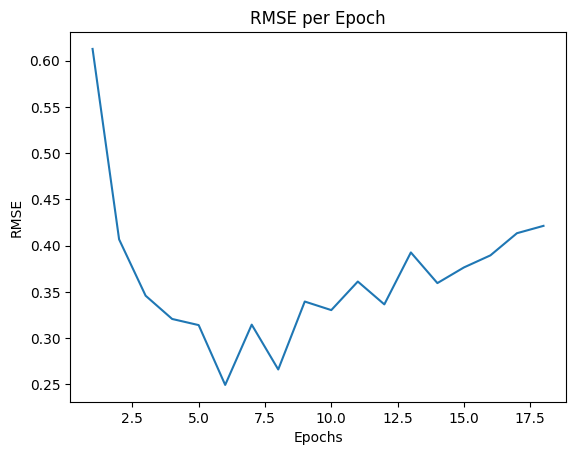

| 38        | -7.201    | 42.71     | 18.63     |
Epoch 1/41, RMSE: 0.5026
Epoch 2/41, RMSE: 0.4249
Epoch 3/41, RMSE: 0.3244
Epoch 4/41, RMSE: 0.2734
Epoch 5/41, RMSE: 0.2829
Epoch 6/41, RMSE: 0.2751
Epoch 7/41, RMSE: 0.2590
Epoch 8/41, RMSE: 0.2965
Epoch 9/41, RMSE: 0.2555
Epoch 10/41, RMSE: 0.2971
Epoch 11/41, RMSE: 0.2941
Epoch 12/41, RMSE: 0.3187
Epoch 13/41, RMSE: 0.3093
Epoch 14/41, RMSE: 0.3475
Epoch 15/41, RMSE: 0.3522
Epoch 16/41, RMSE: 0.4044
Epoch 17/41, RMSE: 0.4192
Epoch 18/41, RMSE: 0.4186
Epoch 19/41, RMSE: 0.4169
Epoch 20/41, RMSE: 0.4507
Epoch 21/41, RMSE: 0.4490
Epoch 22/41, RMSE: 0.4596
Epoch 23/41, RMSE: 0.4496
Epoch 24/41, RMSE: 0.4280
Epoch 25/41, RMSE: 0.4346
Epoch 26/41, RMSE: 0.4402
Epoch 27/41, RMSE: 0.4321
Epoch 28/41, RMSE: 0.4151
Epoch 29/41, RMSE: 0.3965
Epoch 30/41, RMSE: 0.4154
Epoch 31/41, RMSE: 0.4139
Epoch 32/41, RMSE: 0.3931
Epoch 33/41, RMSE: 0.3853
Epoch 34/41, RMSE: 0.4125
Epoch 35/41, RMSE: 0.3873
Epoch 36/41, RMSE: 0.3929
Epoch 37/41, RMSE: 0.41

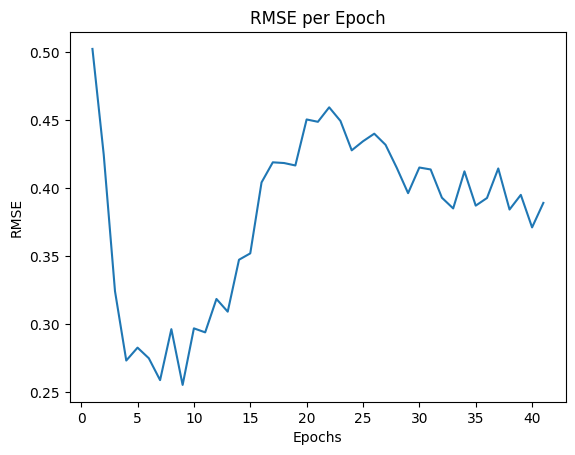

| 39        | -6.818    | 46.8      | 41.97     |
Epoch 1/12, RMSE: 0.4906
Epoch 2/12, RMSE: 0.4312
Epoch 3/12, RMSE: 0.3964
Epoch 4/12, RMSE: 0.3400
Epoch 5/12, RMSE: 0.2833
Epoch 6/12, RMSE: 0.2358
Epoch 7/12, RMSE: 0.2515
Epoch 8/12, RMSE: 0.2702
Epoch 9/12, RMSE: 0.2353
Epoch 10/12, RMSE: 0.2744
Epoch 11/12, RMSE: 0.2536
Epoch 12/12, RMSE: 0.2973


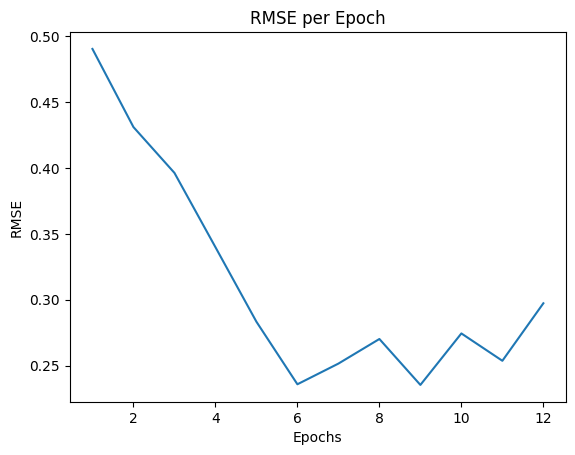

| 40        | -6.141    | 41.6      | 12.98     |
Mejores hiperparámetros: Epochs=26, Batch size=12
Epoch 1/26, RMSE: 0.7312
Epoch 2/26, RMSE: 0.6720
Epoch 3/26, RMSE: 0.5677
Epoch 4/26, RMSE: 0.5480
Epoch 5/26, RMSE: 0.3959
Epoch 6/26, RMSE: 0.3549
Epoch 7/26, RMSE: 0.3327
Epoch 8/26, RMSE: 0.3303
Epoch 9/26, RMSE: 0.3528
Epoch 10/26, RMSE: 0.3300
Epoch 11/26, RMSE: 0.3285
Epoch 12/26, RMSE: 0.3298
Epoch 13/26, RMSE: 0.3253
Epoch 14/26, RMSE: 0.3505
Epoch 15/26, RMSE: 0.2863
Epoch 16/26, RMSE: 0.3561
Epoch 17/26, RMSE: 0.3238
Epoch 18/26, RMSE: 0.3462
Epoch 19/26, RMSE: 0.3171
Epoch 20/26, RMSE: 0.3723
Epoch 21/26, RMSE: 0.3207
Epoch 22/26, RMSE: 0.3852
Epoch 23/26, RMSE: 0.3494
Epoch 24/26, RMSE: 0.3427
Epoch 25/26, RMSE: 0.3321
Epoch 26/26, RMSE: 0.3431


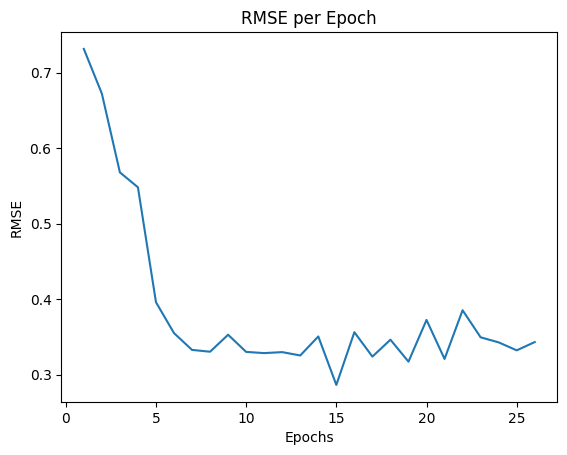

SklearnWrapper(batch_size=12, epochs=26, input_dim=9)

In [112]:
# import numpy as np
# import torch
# import torch.nn as nn
# import torch.optim as optim
# from sklearn.base import BaseEstimator, RegressorMixin
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import mean_squared_error
# import matplotlib.pyplot as plt
# from bayes_opt import BayesianOptimization

# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.values.reshape(-1, 1)  # Convertir y a un array de NumPy y redimensionar
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# def train_evaluate_ANN(epochs, batch_size):
#     input_dim = X_train_gfaults.shape[1]
#     ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=int(epochs), batch_size=int(batch_size))
#     ann_wrapper.fit(X_train_gfaults, y_train_gfaults)
    
#     y_pred = ann_wrapper.predict(X_test_gfaults)
#     mse = mean_squared_error(y_test_gfaults, y_pred)
#     rmse = np.sqrt(mse)
#     return -rmse  # Negamos el RMSE porque BayesianOptimization maximiza la función objetivo

# pbounds = {
#     'epochs': (10, 50),
#     'batch_size': (10, 50)
# }

# optimizer = BayesianOptimization(
#     f=train_evaluate_ANN,
#     pbounds=pbounds,
#     random_state=42
# )

# optimizer.maximize(init_points=10, n_iter=30)

# best_params = optimizer.max['params']
# best_epochs = int(best_params['epochs'])
# best_batch_size = int(best_params['batch_size'])

# print(f'Mejores hiperparámetros: Epochs={best_epochs}, Batch size={best_batch_size}')

# input_dim = X_train_gfaults.shape[1]

# ann_wrapper = SklearnWrapper(input_dim=input_dim, epochs=best_epochs, batch_size=best_batch_size)
# ann_wrapper.fit(X_train_gfaults, y_train_gfaults)

In [113]:
# # Guardar el modelo entrenado
# joblib.dump(ann_wrapper, 'ann_model_gfaults.pkl')

# # Cargar el modelo entrenado
# class ANNModel(nn.Module):
#     def __init__(self, input_dim):
#         super(ANNModel, self).__init__()
#         self.fc1 = nn.Linear(input_dim, 128)
#         self.fc2 = nn.Linear(128, 64)
#         self.fc3 = nn.Linear(64, 32)
#         self.fc4 = nn.Linear(32, 1)
#         self.dropout = nn.Dropout(0.5)

#     def forward(self, x):
#         x = torch.relu(self.fc1(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc2(x))
#         x = self.dropout(x)
#         x = torch.relu(self.fc3(x))
#         x = self.fc4(x)
#         return x

# # Definir una clase para convertir ANNModel a un estimador compatible con scikit-learn
# class SklearnWrapper(BaseEstimator, RegressorMixin):
#     def __init__(self, input_dim, epochs=100, batch_size=32, learning_rate=0.001):
#         self.input_dim = input_dim
#         self.epochs = epochs
#         self.batch_size = batch_size
#         self.learning_rate = learning_rate
#         self.model = ANNModel(input_dim)
#         self.criterion = nn.MSELoss()
#         self.optimizer = optim.Adam(self.model.parameters(), lr=self.learning_rate)
#         self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
#         self.model.to(self.device)
#         self.scaler_X = StandardScaler()
#         self.scaler_y = StandardScaler()

#     def fit(self, X, y):
#         # Estandarizar los datos
#         X = self.scaler_X.fit_transform(X)
#         y = y.reshape(-1, 1)
#         y = self.scaler_y.fit_transform(y).flatten()

#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         y_tensor = torch.tensor(y, dtype=torch.float32).to(self.device)
        
#         self.model.train()
#         rmse_list = []
#         for epoch in range(self.epochs):
#             for i in range(0, len(X_tensor), self.batch_size):
#                 X_batch = X_tensor[i:i + self.batch_size]
#                 y_batch = y_tensor[i:i + self.batch_size]

#                 self.optimizer.zero_grad()
#                 outputs = self.model(X_batch).squeeze()
#                 loss = self.criterion(outputs, y_batch)
#                 loss.backward()
#                 self.optimizer.step()

#             # Evaluar el modelo después de cada epoch
#             self.model.eval()
#             with torch.no_grad():
#                 y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#                 rmse = np.sqrt(mean_squared_error(y_tensor.cpu().numpy(), y_pred))
#                 rmse_list.append(rmse)
#                 print(f'Epoch {epoch+1}/{self.epochs}, RMSE: {rmse:.4f}')
#             self.model.train()
        
#         # Graficar el RMSE por epoch
#         plt.plot(range(1, self.epochs + 1), rmse_list)
#         plt.xlabel('Epochs')
#         plt.ylabel('RMSE')
#         plt.title('RMSE per Epoch')
#         plt.show()
        
#         return self

#     def predict(self, X):
#         X = self.scaler_X.transform(X)
        
#         X_tensor = torch.tensor(X, dtype=torch.float32).to(self.device)
#         self.model.eval()
#         with torch.no_grad():
#             y_pred = self.model(X_tensor).squeeze().cpu().numpy()
#         y_pred = self.scaler_y.inverse_transform(y_pred.reshape(-1, 1)).flatten()
#         return y_pred

# if __name__ == "__main__":
#     # Cargar el modelo entrenado
#     loaded_model_ann_gfaults = joblib.load('ann_model_gfaults.pkl')

#     # Predecir con el modelo entrenado
#     y_pred_ann_gfaults = loaded_model_ann_gfaults.predict(X_test_gfaults)
    
#     # Calcular las métricas
#     mse_ann_gfaults = mean_squared_error(y_test_gfaults, y_pred_ann_gfaults)
#     rmse_ann_gfaults = np.sqrt(mse_ann_gfaults)
#     mae_ann_gfaults = mean_absolute_error(y_test_gfaults, y_pred_ann_gfaults)
#     r2_ann_gfaults = r2_score(y_test_gfaults, y_pred_ann_gfaults)
    
#     # Imprimier las métricas
#     print(f"Mean Squared Error (MSE): {mse_ann_gfaults:.5f}")
#     print(f"Root Mean Squared Error (RMSE): {rmse_ann_gfaults:.5f}")
#     print(f"Mean Absolute Error (MAE): {mae_ann_gfaults:.5f}")
#     print(f"R-squared (R^2): {r2_ann_gfaults:.5f}")

Mean Squared Error (MSE): 57.59610
Root Mean Squared Error (RMSE): 7.58921
Mean Absolute Error (MAE): 4.61213
R-squared (R^2): -4.44854


### Desarrollo y ajuste de un modelo **XGBoost** en Gfaults

In [205]:
# Definición de la función de validación cruzada
def xgb_cv(n_estimators, max_depth, learning_rate, subsample, colsample_bytree, gamma, min_child_weight):
    model = XGBRegressor(
        n_estimators=int(n_estimators), 
        max_depth=int(max_depth), 
        learning_rate=learning_rate, 
        subsample=subsample, 
        colsample_bytree=colsample_bytree, 
        gamma=gamma, 
        min_child_weight=min_child_weight, 
        objective='reg:squarederror',
        n_jobs=-1
    )
    model.fit(X_train_gfaults, y_train_gfaults)
    y_pred = model.predict(X_test_gfaults)
    return -mean_squared_error(y_test_gfaults, y_pred)

# Optimización bayesiana para XGBoost
xgb_optimizer = BayesianOptimization(
    f=xgb_cv,
    pbounds={
        'n_estimators': (10, 200),
        'max_depth': (1, 20),
        'learning_rate': (0.01, 0.3),
        'subsample': (0.5, 1.0),
        'colsample_bytree': (0.5, 1.0),
        'gamma': (0, 5),
        'min_child_weight': (1, 10)
    },
    random_state=42
)

xgb_optimizer.maximize(init_points=10, n_iter=30)

# Obtener los mejores valores de hiperparámetros para XGBoost
best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
best_learning_rate = xgb_optimizer.max['params']['learning_rate']
best_subsample = xgb_optimizer.max['params']['subsample']
best_colsample_bytree = xgb_optimizer.max['params']['colsample_bytree']
best_gamma = xgb_optimizer.max['params']['gamma']
best_min_child_weight = xgb_optimizer.max['params']['min_child_weight']

# Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
xgb_model_gfaults = XGBRegressor(
    n_estimators=best_n_estimators, 
    max_depth=best_max_depth, 
    learning_rate=best_learning_rate, 
    subsample=best_subsample, 
    colsample_bytree=best_colsample_bytree, 
    gamma=best_gamma, 
    min_child_weight=best_min_child_weight, 
    objective='reg:squarederror',
    n_jobs=-1
)
xgb_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   | colsam... |   gamma   | learni... | max_depth | min_ch... | n_esti... | subsample |
-------------------------------------------------------------------------------------------------------------
| 1         | -26.93    | 0.6873    | 4.754     | 0.2223    | 12.37     | 2.404     | 39.64     | 0.529     |
| 2         | -33.61    | 0.9331    | 3.006     | 0.2153    | 1.391     | 9.729     | 168.2     | 0.6062    |
| 3         | -28.44    | 0.5909    | 0.917     | 0.09823   | 10.97     | 4.888     | 65.33     | 0.8059    |
| 4         | -27.27    | 0.5697    | 1.461     | 0.1162    | 9.665     | 8.067     | 47.94     | 0.7571    |
| 5         | -26.3     | 0.7962    | 0.2323    | 0.1862    | 4.24      | 1.585     | 190.3     | 0.9828    |
| 6         | -24.05    | 0.9042    | 1.523     | 0.03832   | 14.0      | 4.961     | 33.19     | 0.7476    |
| 7         | -29.71    | 0.5172    | 4.547     | 0.08505   | 13.59     | 3.805     | 108.8     | 0.7734    |
| 8       

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8701186974362317, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=1.9624633453189555,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.06315827818435783,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=13, max_leaves=None,
             min_child_weight=4.529448909921145, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=34,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [206]:
print(f"n_estimators: {best_n_estimators}")
print(f"max_depth: {best_max_depth}")
print(f"learning_rate: {best_learning_rate}")
print(f"subsample: {best_subsample}")
print(f"colsample_bytree: {best_colsample_bytree}")
print(f"gamma: {best_gamma}")
print(f"min_child_weight: {best_min_child_weight}")

n_estimators: 34
max_depth: 13
learning_rate: 0.06315827818435783
subsample: 0.739508385406084
colsample_bytree: 0.8701186974362317
gamma: 1.9624633453189555
min_child_weight: 4.529448909921145


In [114]:
# def xgb_cv(n_estimators, max_depth, learning_rate):
#     model = XGBRegressor(n_estimators=int(n_estimators), max_depth=int(max_depth), learning_rate=learning_rate, objective='reg:squarederror')
#     model.fit(X_train_gfaults, y_train_gfaults)
#     y_pred = model.predict(X_test_gfaults)
#     return -mean_squared_error(y_test_gfaults, y_pred)

# # Optimización bayesiana para XGBoost
# xgb_optimizer = BayesianOptimization(
#     f=xgb_cv,
#     pbounds={
#         'n_estimators': (10, 200),
#         'max_depth': (1, 20),
#         'learning_rate': (0.01, 0.3)
#     },
#     random_state=42
# )

# xgb_optimizer.maximize(init_points=10, n_iter=30)

# # Obtener los mejores valores de hiperparámetros para XGBoost
# best_n_estimators = int(xgb_optimizer.max['params']['n_estimators'])
# best_max_depth = int(xgb_optimizer.max['params']['max_depth'])
# best_learning_rate = xgb_optimizer.max['params']['learning_rate']

# # Entrenar el modelo XGBoost con los mejores valores de hiperparámetros
# xgb_model_gfaults = XGBRegressor(n_estimators=best_n_estimators, max_depth=best_max_depth, learning_rate=best_learning_rate, objective='reg:squarederror')
# xgb_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

|   iter    |  target   | learni... | max_depth | n_esti... |
-------------------------------------------------------------
| 1         | -28.35    | 0.1186    | 19.06     | 149.1     |
| 2         | -31.56    | 0.1836    | 3.964     | 39.64     |
| 3         | -26.62    | 0.02684   | 17.46     | 124.2     |
| 4         | -33.75    | 0.2153    | 1.391     | 194.3     |
| 5         | -31.18    | 0.2514    | 5.034     | 44.55     |
| 6         | -31.17    | 0.06319   | 6.781     | 109.7     |
| 7         | -31.3     | 0.1353    | 6.533     | 126.3     |
| 8         | -30.44    | 0.05045   | 6.551     | 79.61     |
| 9         | -28.1     | 0.1423    | 15.92     | 47.94     |
| 10        | -26.63    | 0.1591    | 12.26     | 18.83     |
| 11        | -28.37    | 0.2496    | 19.97     | 119.9     |
| 12        | -28.65    | 0.1832    | 19.76     | 129.3     |
| 13        | -24.25    | 0.1421    | 14.63     | 13.65     |
| 14        | -27.11    | 0.2443    | 19.97     | 14.41     |
| 15    

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=14, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=159, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [207]:
# Guardar el modelo entrenado
joblib.dump(xgb_model_gfaults, 'xgb_model_gfaults.pkl')

# Cargar el modelo entrenado
loaded_model_xgb_gfaults = joblib.load('xgb_model_gfaults.pkl')
loaded_model_xgb_gfaults

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8701186974362317, device=None,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, feature_types=None, gamma=1.9624633453189555,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.06315827818435783,
             max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=13, max_leaves=None,
             min_child_weight=4.529448909921145, missing=nan,
             monotone_constraints=None, multi_strategy=None, n_estimators=34,
             n_jobs=-1, num_parallel_tree=None, random_state=None, ...)

In [208]:
# Evaluar el modelo
y_pred_xgb_gfaults = loaded_model_xgb_gfaults.predict(X_test_gfaults)
xgb_mse_gfaults = mean_squared_error(y_test_gfaults, y_pred_xgb_gfaults)

# Calcular las métricas
mse_xgb_gfaults = mean_squared_error(y_test_gfaults, y_pred_xgb_gfaults)
rmse_xgb_gfaults = np.sqrt(mse_xgb_gfaults)
mae_xgb_gfaults = mean_absolute_error(y_test_gfaults, y_pred_xgb_gfaults)
r2_xgb_gfaults = r2_score(y_test_gfaults, y_pred_xgb_gfaults)

# Imprimier las métricas
print(f"Mean Squared Error (MSE): {mse_xgb_gfaults:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_xgb_gfaults:.5f}")
print(f"Mean Absolute Error (MAE): {mae_xgb_gfaults:.5f}")
print(f"R-squared (R^2): {r2_xgb_gfaults:.5f}")

Mean Squared Error (MSE): 22.60994
Root Mean Squared Error (RMSE): 4.75499
Mean Absolute Error (MAE): 3.59708
R-squared (R^2): -1.13888


In [209]:
# Guardamos las predicciones que se necesitarán más adelante
# Convertir las predicciones a un DataFrame de pandas
y_pred_xgb_gfaults = pd.DataFrame(y_pred_xgb_gfaults, columns=['pred_xgb_gfaults'])

# Guardar el DataFrame como un archivo CSV
y_pred_xgb_gfaults.to_csv('y_pred_xgb_gfaults.csv', index=False)

### Desarrollo y ajuste de un modelo **KNN** en Gfaults

In [225]:
# Normalizar los datos
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_gfaults)
X_test_scaled = scaler.transform(X_test_gfaults)

# Reducir dimensionalidad con PCA
pca = PCA(n_components=0.95)  # Retener 95% de la varianza
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Definir el modelo KNN
knn = KNeighborsRegressor()

# Definir los hiperparámetros a optimizar
param_grid = {
    'n_neighbors': (1, 30),
    'leaf_size': (10, 50),
    'p': (1, 2),  # 1 para Manhattan, 2 para Euclídea
    'weights': ['uniform', 'distance'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    'metric': ['euclidean', 'manhattan', 'chebyshev', 'minkowski']
}

# Configurar la búsqueda bayesiana
opt = BayesSearchCV(
    knn,
    param_grid,
    n_iter=50,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=1
)

# Ejecutar la búsqueda bayesiana
opt.fit(X_train_pca, y_train_gfaults)

# Imprimir los mejores hiperparámetros encontrados
print("Best Hyperparameters: ", opt.best_params_)

# Entrenar el modelo con los mejores hiperparámetros
best_knn_gfaults = opt.best_estimator_
best_knn_gfaults.fit(X_train_pca, y_train_gfaults)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=50, metric='manhattan', n_neighbors=30, p=1)

In [226]:
# Imprimir los mejores hiperparámetros encontrados uno por uno
best_params = opt.best_params_
print("Best Hyperparameters:")
for param, value in best_params.items():
    print(f"{param}: {value}")

Best Hyperparameters:
algorithm: auto
leaf_size: 50
metric: manhattan
n_neighbors: 30
p: 1
weights: uniform


In [118]:
# # Normalizar los datos
# scaler = StandardScaler()
# X_train_scaled = scaler.fit_transform(X_train_gfaults)
# X_test_scaled = scaler.transform(X_test_gfaults)

# # Reducir dimensionalidad con PCA
# pca = PCA(n_components=0.95)  # Retener 95% de la varianza
# X_train_pca = pca.fit_transform(X_train_scaled)
# X_test_pca = pca.transform(X_test_scaled)

# # Definir el modelo KNN
# knn = KNeighborsRegressor()

# # Definir los hiperparámetros a optimizar
# param_grid = {
#     'n_neighbors': (1, 30),
#     'leaf_size': (10, 50),
#     'p': (1, 2)  # 1 para Manhattan, 2 para Euclídea
# }

# # Configurar la búsqueda bayesiana
# opt = BayesSearchCV(
#     knn,
#     param_grid,
#     n_iter=50,
#     cv=5,
#     scoring='neg_mean_squared_error',
#     n_jobs=-1,
#     verbose=1
# )

# # Ejecutar la búsqueda bayesiana
# opt.fit(X_train_pca, y_train_gfaults)

# # Imprimir los mejores hiperparámetros encontrados
# print("Best Hyperparameters: ", opt.best_params_)

# # Entrenar el modelo con los mejores hiperparámetros
# best_knn_gfaults = opt.best_estimator_
# best_knn_gfaults.fit(X_train_pca, y_train_gfaults)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fi

KNeighborsRegressor(leaf_size=50, n_neighbors=30, p=1)

In [227]:
# Guardar el modelo entrenado
joblib.dump(best_knn_gfaults, 'knn_model_gfaults.pkl')

# Cargar el modelo entrenado
loaded_model_knn_gfaults = joblib.load('knn_model_gfaults.pkl')
loaded_model_knn_gfaults

KNeighborsRegressor(leaf_size=50, metric='manhattan', n_neighbors=30, p=1)

In [228]:
# Predecir y evaluar el modelo
y_pred_knn_gfaults = loaded_model_knn_gfaults.predict(X_test_pca)

# Calcular las métricas
mae_knn_gfaults = mean_absolute_error(y_test_gfaults, y_pred_knn_gfaults)
mse_knn_gfaults = mean_squared_error(y_test_gfaults, y_pred_knn_gfaults)
rmse_knn_gfaults = np.sqrt(mse_knn_gfaults)
r2_knn_gfaults = r2_score(y_test_gfaults, y_pred_knn_gfaults)

# Imprimir las métricas
print(f"Mean Squared Error (MSE): {mse_knn_gfaults:.5f}")
print(f"Root Mean Squared Error (RMSE): {rmse_knn_gfaults:.5f}")
print(f"Mean Absolute Error (MAE): {mae_knn_gfaults:.5f}")
print(f"R-squared (R^2): {r2_knn_gfaults:.5f}")

Mean Squared Error (MSE): 39.36759
Root Mean Squared Error (RMSE): 6.27436
Mean Absolute Error (MAE): 4.10177
R-squared (R^2): -2.72414


In [229]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_knn_gfaults = pd.DataFrame(y_pred_knn_gfaults, columns=['pred_knn_gfaults'])

# Guardar el DataFrame como un archivo CSV
pred_knn_gfaults.to_csv('y_pred_knn_gfaults.csv', index=False)

### Modelos y métricas

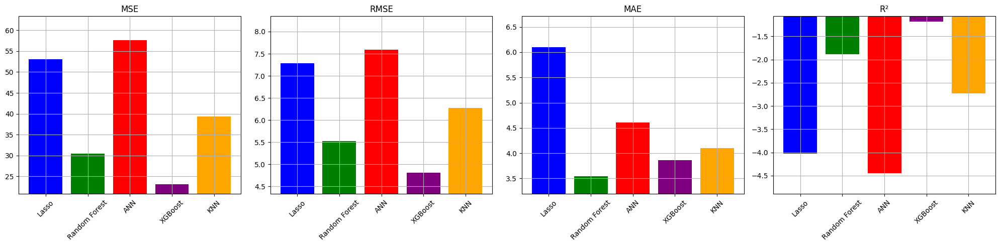

In [123]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'Random Forest', 'ANN', 'XGBoost', 'KNN']
scores = {
    'Lasso': [mse_lasso_gfaults, rmse_lasso_gfaults, mae_lasso_gfaults, r2_lasso_gfaults],
    'Random Forest': [mse_rf_gfaults, rmse_rf_gfaults, mae_rf_gfaults, r2_rf_gfaults],
    'ANN': [mse_ann_gfaults, rmse_ann_gfaults, mae_ann_gfaults, r2_ann_gfaults],
    'XGBoost': [mse_xgb_gfaults, rmse_xgb_gfaults, mae_xgb_gfaults, r2_xgb_gfaults],
    'KNN': [mse_knn_gfaults, rmse_knn_gfaults, mae_knn_gfaults, r2_knn_gfaults]
}

# Subplots
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs[i]
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'red', 'purple', 'orange'])
    ax.set_title(f'{metric}')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=45)
    ax.grid(True)

plt.tight_layout()
plt.show()
plt.show()
plt.show()

El modelo con más bajo rendimiento fue el ANN. 

### **Ensamble Heterogéneo** con todos los modelos

Epoch 1/23, RMSE: 1.1991
Epoch 2/23, RMSE: 0.8059
Epoch 3/23, RMSE: 0.6993
Epoch 4/23, RMSE: 0.5716
Epoch 5/23, RMSE: 0.4192
Epoch 6/23, RMSE: 0.4698
Epoch 7/23, RMSE: 0.3645
Epoch 8/23, RMSE: 0.3957
Epoch 9/23, RMSE: 0.4784
Epoch 10/23, RMSE: 0.5641
Epoch 11/23, RMSE: 0.5798
Epoch 12/23, RMSE: 0.4832
Epoch 13/23, RMSE: 0.4049
Epoch 14/23, RMSE: 0.3676
Epoch 15/23, RMSE: 0.4418
Epoch 16/23, RMSE: 0.3529
Epoch 17/23, RMSE: 0.3951
Epoch 18/23, RMSE: 0.4069
Epoch 19/23, RMSE: 0.4068
Epoch 20/23, RMSE: 0.3038
Epoch 21/23, RMSE: 0.3832
Epoch 22/23, RMSE: 0.3630
Epoch 23/23, RMSE: 0.3910


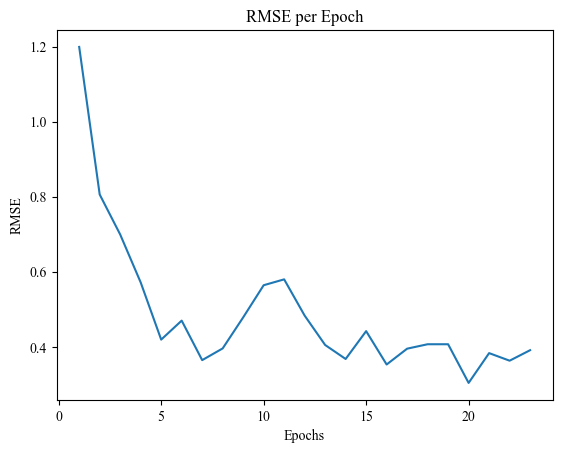

VotingRegressor(estimators=[('lasso',
                             Pipeline(steps=[('scaler',
                                              StandardScaler(with_mean=False)),
                                             ('lasso',
                                              Lasso(fit_intercept=False,
                                                    max_iter=209,
                                                    tol=1e-05))])),
                            ('rf',
                             RandomForestRegressor(max_depth=20,
                                                   max_features=0.1,
                                                   min_samples_leaf=5,
                                                   n_estimators=74)),
                            ('ann',
                             SklearnWrapper(batch_size=17,
                                            dropout_prob=0.11809091556421523,
                                            epochs=23,
                                            hidden_dims=[138,...
                                          max_bin=None, max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=13,
                                          max_leaves=None,
                                          min_child_weight=4.529448909921145,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=34,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...)),
                            ('knn',
                             KNeighborsRegressor(leaf_size=50,
                                                 metric='manhattan',
                                                 n_neighbors=30, p=1))])

In [418]:
ensemble_model_gfaults = VotingRegressor(estimators=[
    ('lasso', loaded_model_lasso_gfaults),
    ('rf', loaded_model_rf_gfaults),
    ('ann', loaded_model_ann_gfaults),
    ('xgb', loaded_model_xgb_gfaults),
    ('knn', loaded_model_knn_gfaults)
])

# Entrenar el modelo ensemble
ensemble_model_gfaults.fit(X_train_gfaults, y_train_gfaults)

In [419]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_gfaults, 'ensemble_model_gfaults.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_gfaults = joblib.load('ensemble_model_gfaults.pkl')

In [420]:
# Evaluar el modelo ensemble
y_pred_ensamble_gfaults = loaded_model_esemble_gfaults.predict(X_test_gfaults)

In [421]:
# Méttricas
mae_ensamble_gfaults = mean_absolute_error(y_test_gfaults, y_pred_ensamble_gfaults) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_gfaults = mean_squared_error(y_test_gfaults, y_pred_ensamble_gfaults) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_gfaults = np.sqrt(mse_ensamble_gfaults) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_gfaults = r2_score(y_test_gfaults, y_pred_ensamble_gfaults) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Medio Absoluto (MAE): {mae_ensamble_gfaults:.5f}")
print(f"Error Cuadrático Medio (MSE): {mse_ensamble_gfaults:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_gfaults:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_gfaults:.5f}")

Error Medio Absoluto (MAE): 4.37907
Error Cuadrático Medio (MSE): 29.53315
Raíz del Error Cuadrático Medio (RMSE): 5.43444
Coeficiente de Determinación (R^2): -1.79381


### **Ensamble Heterogéneo** con los modelos seleccionados

In [427]:
ensemble_model_gfaults_select = VotingRegressor(estimators=[
    #('lasso', loaded_model_lasso_gfaults),
    ('rf', loaded_model_rf_gfaults),
    #('ann', loaded_model_ann_gfaults),
    ('xgb', loaded_model_xgb_gfaults),
    #('knn', loaded_model_knn_gfaults)
])

# Entrenar el modelo ensemble
ensemble_model_gfaults_select.fit(X_train_gfaults, y_train_gfaults)

VotingRegressor(estimators=[('rf',
                             RandomForestRegressor(max_depth=20,
                                                   max_features=0.1,
                                                   min_samples_leaf=5,
                                                   n_estimators=74)),
                            ('xgb',
                             XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=0.8701186974362317,
                                          device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, f...
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=0.06315827818435783,
                                          max_bin=None, max_cat_threshold=None,
                                          max_cat_to_onehot=None,
                                          max_delta_step=None, max_depth=13,
                                          max_leaves=None,
                                          min_child_weight=4.529448909921145,
                                          missing=nan,
                                          monotone_constraints=None,
                                          multi_strategy=None, n_estimators=34,
                                          n_jobs=-1, num_parallel_tree=None,
                                          random_state=None, ...))])

In [428]:
# Guardar el modelo entrenado
joblib.dump(ensemble_model_gfaults_select, 'ensemble_model_gfaults_select.pkl')

# Cargar el modelo entrenado
loaded_model_esemble_gfaults = joblib.load('ensemble_model_gfaults_select.pkl')

In [429]:
# Evaluar el modelo ensemble
y_pred_ensamble_gfaults_select = loaded_model_esemble_gfaults.predict(X_test_gfaults)

In [430]:
# Méttricas
mae_ensamble_gfaults_select = mean_absolute_error(y_test_gfaults, y_pred_ensamble_gfaults_select) # Calcular el Error Medio Absoluto (MAE)
mse_ensamble_gfaults_select = mean_squared_error(y_test_gfaults, y_pred_ensamble_gfaults_select) # Calcular el Error Cuadrático Medio (MSE)
rmse_ensamble_gfaults_select = np.sqrt(mse_ensamble_gfaults_select) # Calcular la Raíz del Error Cuadrático Medio (RMSE)
r2_ensamble_gfaults_select = r2_score(y_test_gfaults, y_pred_ensamble_gfaults_select) # Calcular el Coeficiente de Determinación (R^2)

print(f"Error Medio Absoluto (MAE): {mae_ensamble_gfaults_select:.5f}")
print(f"Error Cuadrático Medio (MSE): {mse_ensamble_gfaults_select:.5f}")
print(f"Raíz del Error Cuadrático Medio (RMSE): {rmse_ensamble_gfaults_select:.5f}")
print(f"Coeficiente de Determinación (R^2): {r2_ensamble_gfaults_select:.5f}")

Error Medio Absoluto (MAE): 3.48358
Error Cuadrático Medio (MSE): 23.23514
Raíz del Error Cuadrático Medio (RMSE): 4.82028
Coeficiente de Determinación (R^2): -1.19802


In [432]:
# Guardar las predicciones 
# Convertir las predicciones a un DataFrame de pandas
pred_ensamble_select_gfaults = pd.DataFrame(y_pred_ensamble_gfaults_select, columns=['pred_ensamble_select_gfaults'])

# Guardar el DataFrame como un archivo CSV
pred_ensamble_select_gfaults.to_csv('y_pred_ensamble_gfaults_select.csv', index=False)

### Modelos y métricas con el ensamble

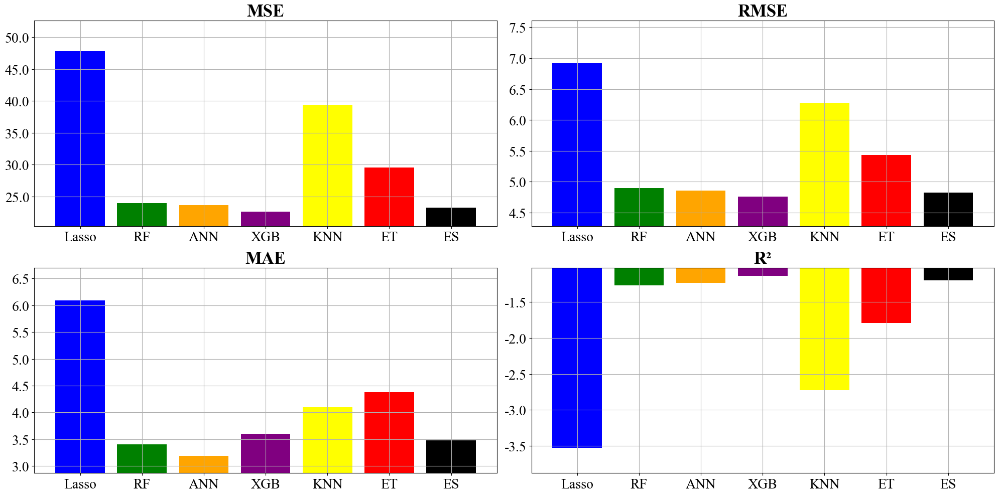

In [439]:
metrics = ['MSE', 'RMSE', 'MAE', 'R²']
models = ['Lasso', 'RF', 'ANN', 'XGB', 'KNN', 'ET', 'ES']
scores = {
    'Lasso': [mse_lasso_gfaults, rmse_lasso_gfaults, mae_lasso_gfaults, r2_lasso_gfaults],
    'RF': [mse_rf_gfaults, rmse_rf_gfaults, mae_rf_gfaults, r2_rf_gfaults],
    'ANN': [mse_ann_gfaults, rmse_ann_gfaults, mae_ann_gfaults, r2_ann_gfaults],
    'XGB': [mse_xgb_gfaults, rmse_xgb_gfaults, mae_xgb_gfaults, r2_xgb_gfaults],
    'KNN': [mse_knn_gfaults, rmse_knn_gfaults, mae_knn_gfaults, r2_knn_gfaults], 
    'ET': [mse_ensamble_gfaults, rmse_ensamble_gfaults, mae_ensamble_gfaults, r2_ensamble_gfaults],
    'ES': [mse_ensamble_gfaults_select, rmse_ensamble_gfaults_select, mae_ensamble_gfaults_select, r2_ensamble_gfaults_select]
}

# Subplots
fig, axs = plt.subplots(2, 2, figsize=(20, 10))  # Ajustar tamaño para una mejor visualización

# Configuración del gráfico para cada métrica
for i, metric in enumerate(metrics):
    ax = axs.flat[i]  # Acceder correctamente a cada subtrama
    values = [scores[model][i] for model in models]
    ax.bar(models, values, color=['blue', 'green', 'orange', 'purple', 'yellow', 'red', 'black'])
    ax.set_title(f'{metric}', fontsize=25, fontweight='bold')
    ax.set_ylim(min(values) - 0.1 * abs(min(values)), max(values) + 0.1 * abs(max(values)))  # Ajustar según los valores
    ax.set_xticklabels(models, rotation=0, fontsize=20)
    y_ticks = ax.get_yticks()
    ax.set_yticklabels([f'{y_tick:.1f}' for y_tick in y_ticks], fontsize=20)
    ax.grid(True)

plt.tight_layout()

# Guardar la figura completa en un archivo
plt.savefig('model_performance_metrics_gfaults.png', dpi=300)

plt.show()


### Comparación de modelos en el batch 91

In [433]:
# Cargar las predicciones
load_pred_lasso_gfaults = pd.read_csv(r'y_pred_lasso_gfaults.csv')
load_pred_rf_gfaults = pd.read_csv(r'y_pred_rf_gfaults.csv')
load_pred_ann_gfaults = pd.read_csv(r'y_pred_ann_gfaults.csv')
load_pred_xgb_gfaults = pd.read_csv(r'y_pred_xgb_gfaults.csv')
load_pred_knn_gfaults = pd.read_csv(r'y_pred_knn_gfaults.csv')
load_pred_ensamble_select_gfaults = pd.read_csv(r'y_pred_ensamble_gfaults_select.csv')

In [434]:
# se hace un reset a los índices de gfaults_test para poder concatenar 
gfaults_test_reset = gfaults_test.reset_index(drop=True)
# concatenar 
data_select_pred_gfaults = pd.concat([gfaults_test_reset, load_pred_lasso_gfaults, load_pred_rf_gfaults, load_pred_ann_gfaults,
                                     load_pred_xgb_gfaults, load_pred_knn_gfaults, load_pred_ensamble_select_gfaults], axis=1).reset_index(drop=True)

In [435]:
# Batch 91
batch_91_select = data_select_pred_gfaults[data_select_pred_gfaults['Batch'] == 91]

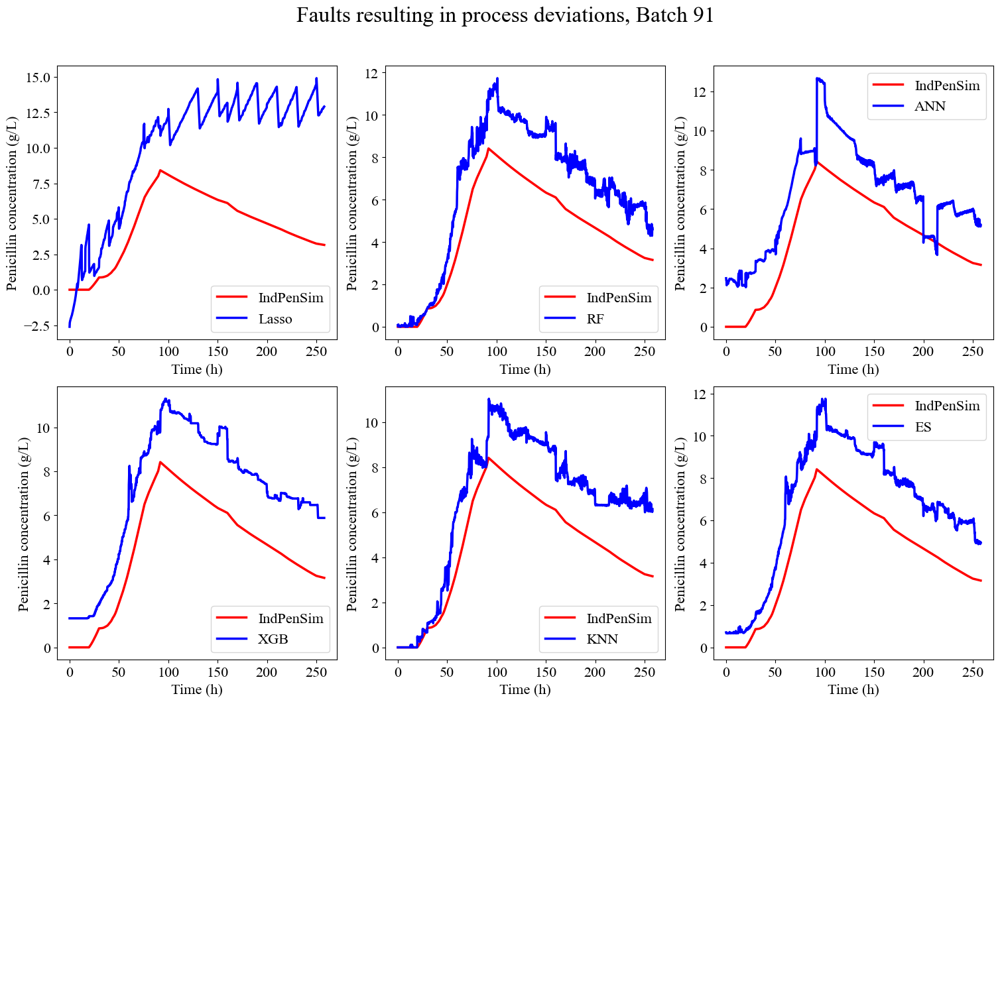

In [436]:
# Configurar matplotlib para usar Times New Roman
mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['font.serif'] = ['Times New Roman']

# Predicciones
pred_columns = [
    'pred_lasso_gfaults', 'pred_rf_gfaults', 'pred_ann_gfaults',
    'pred_xgb_gfaults', 'pred_knn_gfaults', 'pred_ensamble_select_gfaults'
]

# Nuevos nombres para las columnas
column_names = {
    'pred_lasso_gfaults': 'Lasso',
    'pred_rf_gfaults': 'RF',
    'pred_ann_gfaults': 'ANN',
    'pred_xgb_gfaults': 'XGB',
    'pred_knn_gfaults': 'KNN',
    'pred_ensamble_select_gfaults': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Título
fig.suptitle("Faults resulting in process deviations, Batch 91", fontsize=24)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_91_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=column_names[pred_columns[i]], linewidth=2.5)
        #ax.set_title(column_names[pred_columns[i]], fontsize=18)
        ax.set_xlabel("Time (h)", fontsize=16)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=16)
        ax.tick_params(axis='both', which='major', labelsize=16)
        ax.legend(fontsize=16)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
fig.subplots_adjust(bottom=0.0001, top=0.92)  # Ajustar el espacio en la parte inferior y superior

# Guardar la figura completa en un archivo
plt.savefig('model_performance_gfaults_batch_91.png', dpi=300, bbox_inches='tight')

plt.show()


#### Graficamos los modelos seleccionados y el ensamble

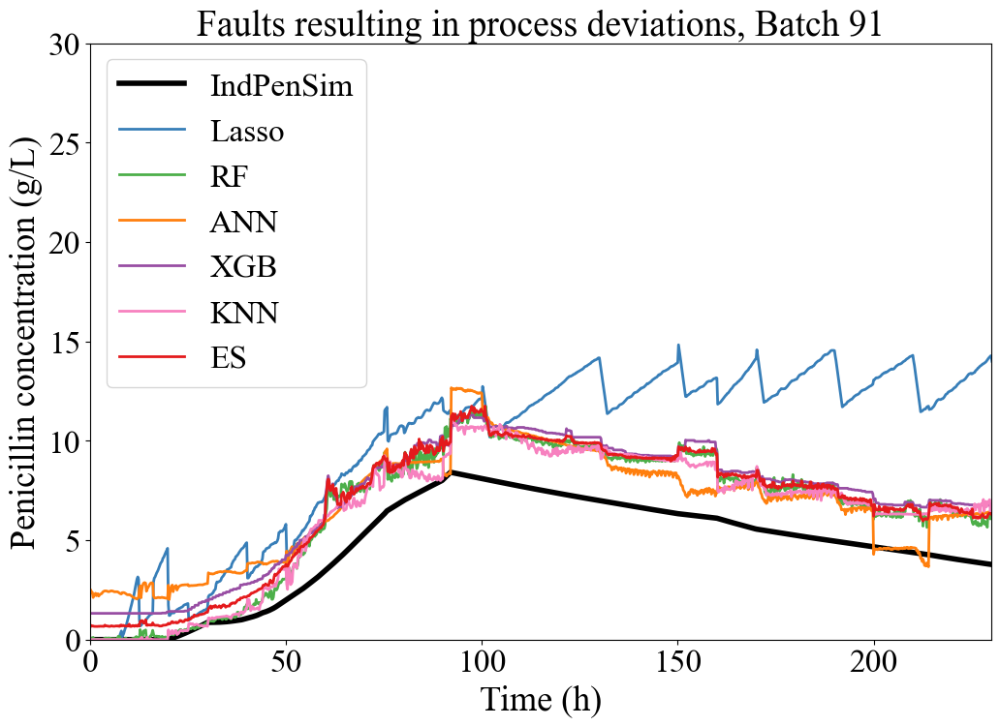

In [437]:
# Predicciones
pred_columns = ['pred_lasso_gfaults',
    'pred_rf_gfaults', 'pred_ann_gfaults',
    'pred_xgb_gfaults', 'pred_knn_gfaults', 'pred_ensamble_select_gfaults'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_gfaults': '#377eb8',  # Ajustado a un azul más contrastante
    'pred_rf_gfaults': '#4daf4a',     # Ajustado a un verde más claro
    'pred_ann_gfaults': '#ff7f0e',    # Naranja
    'pred_xgb_gfaults': '#984ea3',    # Púrpura más oscuro
    'pred_knn_gfaults': '#f781bf',    # Rojo más brillante
    'pred_ensamble_select_gfaults': '#e41a1c' # Rosa más claro e41a1c
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_gfaults': 'Lasso',
    'pred_rf_gfaults': 'RF',
    'pred_ann_gfaults': 'ANN',
    'pred_xgb_gfaults': 'XGB',
    'pred_knn_gfaults': 'KNN',
    'pred_ensamble_select_gfaults': 'ES'
}

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_91_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Faults resulting in process deviations, Batch 91", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('model_performance_gfaults_batch_91_join.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

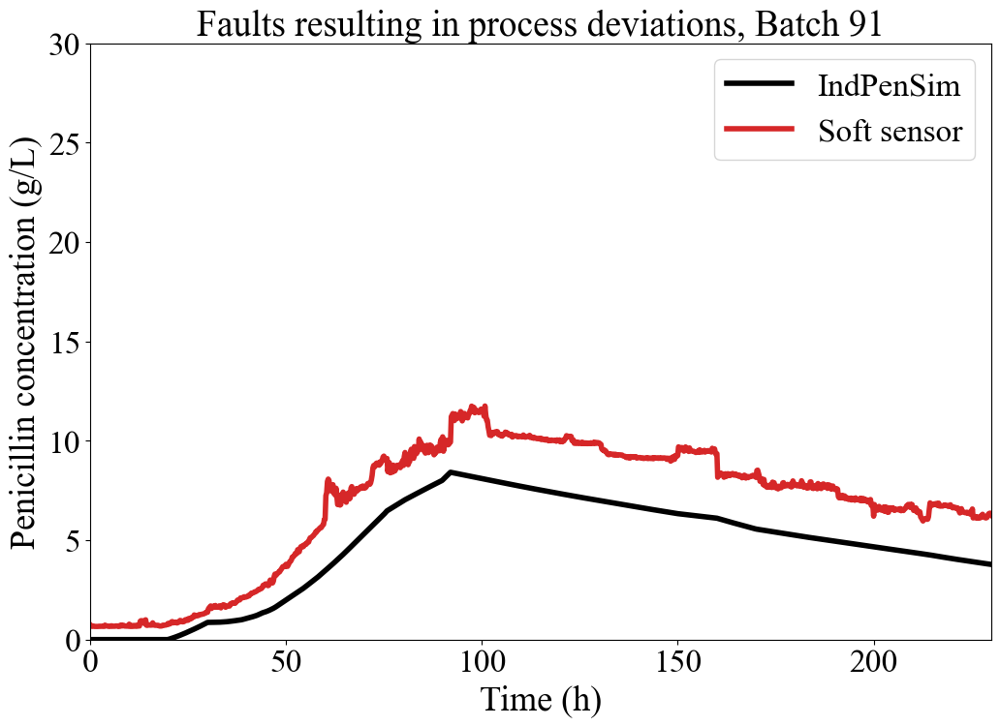

In [438]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_gfaults': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_91_select['pred_ensamble_select_gfaults'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_gfaults'])

# Límites del eje x e y
plt.xlim(0, 230)
plt.ylim(0, 30)

# Leyenda
plt.legend(fontsize=24)

# Título y etiquetas de los ejes
plt.title("Faults resulting in process deviations, Batch 91", fontsize=27)
plt.xlabel("Time (h)", fontsize=26)
plt.ylabel('Penicillin concentration (g/L)', fontsize=26)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=24)

# Guardar la figura completa en un archivo
plt.savefig('soft_sensor_batch_91_gfaults.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

In [133]:
# Cargar las predicciones
load_pred_lasso_gfaults = pd.read_csv(r'y_pred_lasso_gfaults.csv')
load_pred_rf_gfaults = pd.read_csv(r'y_pred_rf_gfaults.csv')
load_pred_ann_gfaults = pd.read_csv(r'y_pred_ann_gfaults.csv')
load_pred_xgb_gfaults = pd.read_csv(r'y_pred_xgb_gfaults.csv')
load_pred_knn_gfaults = pd.read_csv(r'y_pred_knn_gfaults.csv')
load_pred_ensamble_select_gfaults = pd.read_csv(r'y_pred_ensamble_gfaults_select.csv')

In [134]:
# se hace un reset a los índices de gfaults_test para poder concatenar 
gfaults_test_reset = gfaults_test.reset_index(drop=True)
# concatenar 
data_select_pred_gfaults = pd.concat([gfaults_test_reset, load_pred_lasso_gfaults, load_pred_rf_gfaults, load_pred_ann_gfaults,
                                     load_pred_xgb_gfaults, load_pred_knn_gfaults, load_pred_ensamble_select_gfaults], axis=1).reset_index(drop=True)

In [135]:
# Batch 91
batch_91_select = data_select_pred_gfaults[data_select_pred_gfaults['Batch'] == 91]

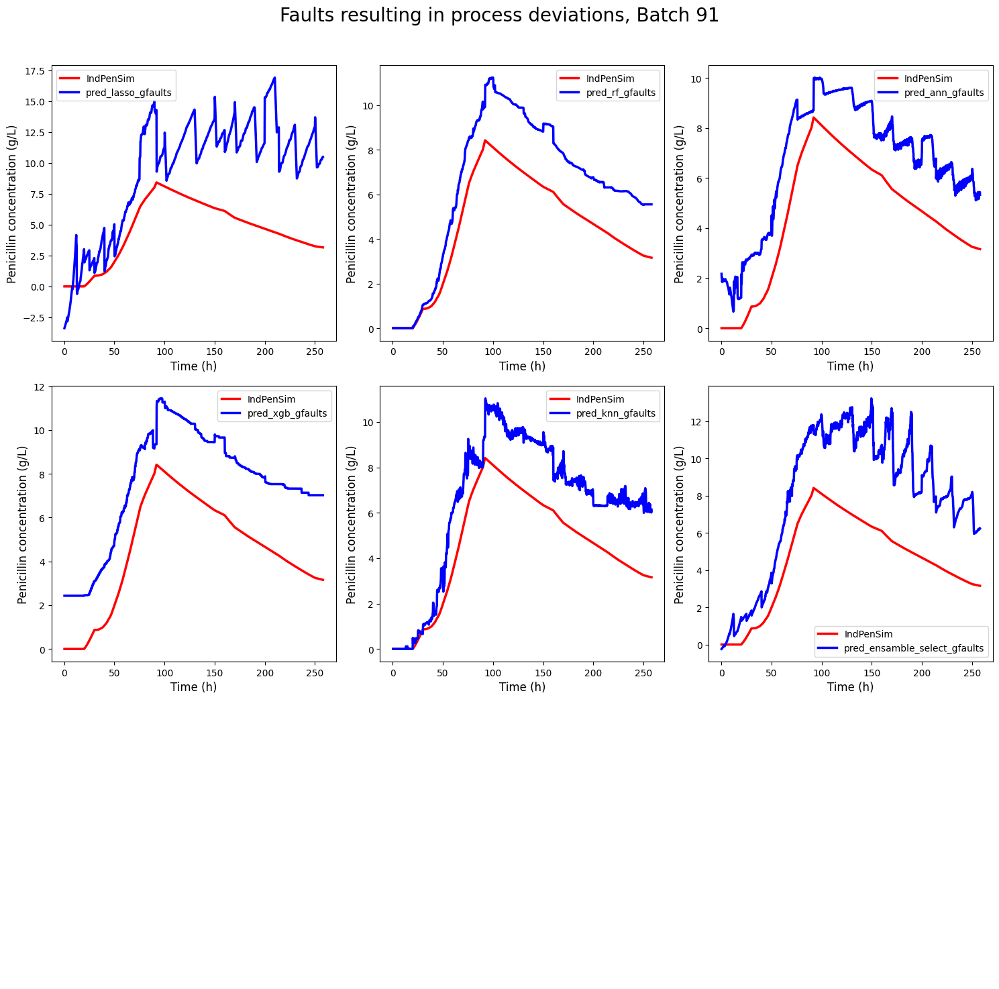

In [137]:
# Predicciones
pred_columns = [
    'pred_lasso_gfaults', 'pred_rf_gfaults', 'pred_ann_gfaults',
    'pred_xgb_gfaults', 'pred_knn_gfaults', 'pred_ensamble_select_gfaults'
]

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()

# Subplots 3x3
fig, axs = plt.subplots(3, 3, figsize=(15, 15))

# Titulo
fig.suptitle("Faults resulting in process deviations, Batch 91", fontsize=20)

# Predicciones y las posiciones de los subplots
for i, ax in enumerate(axs.flatten()):
    if i < len(pred_columns):
        y2 = batch_91_select[pred_columns[i]].to_numpy()
        ax.plot(x, y1, 'r', label='IndPenSim', linewidth=2.5)
        ax.plot(x, y2, 'b', label=pred_columns[i], linewidth=2.5)
        #ax.set_title(pred_columns[i], fontsize=15)
        ax.set_xlabel("Time (h)", fontsize=12)
        ax.set_ylabel('Penicillin concentration (g/L)', fontsize=12)
        ax.tick_params(axis='both', which='major', labelsize=10)
        ax.legend(fontsize=10)
    else:
        # Si hay más subplots que columnas, ocultar los subplots adicionales
        ax.axis('off')

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el espaciado y dejar espacio para el título principal
plt.show()

#### Graficamos los modelos seleccionados y el ensamble

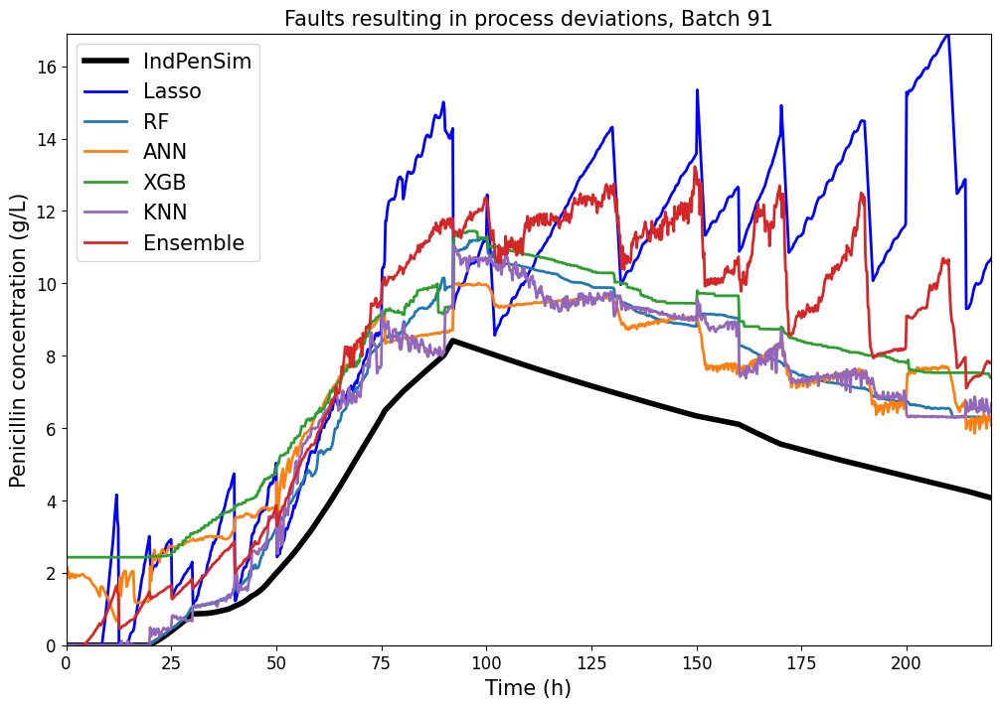

In [139]:
# Predicciones
pred_columns = ['pred_lasso_gfaults',
    'pred_rf_gfaults', 'pred_ann_gfaults',
    'pred_xgb_gfaults', 'pred_knn_gfaults', 'pred_ensamble_select_gfaults'
]

# Colores
colors = {
    'IndPenSim': 'black',
    'pred_lasso_gfaults': 'blue',
    'pred_rf_gfaults': '#1f77b4',
    'pred_ann_gfaults': '#ff7f0e',
    'pred_xgb_gfaults': '#2ca02c',
    'pred_knn_gfaults': '#9467bd',
    'pred_ensamble_select_gfaults': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'pred_lasso_gfaults': 'Lasso',
    'pred_rf_gfaults': 'RF',
    'pred_ann_gfaults': 'ANN',
    'pred_xgb_gfaults': 'XGB',
    'pred_knn_gfaults': 'KNN',
    'pred_ensamble_select_gfaults': 'Ensemble'
}

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])

# Iterar a través de las columnas de predicciones y graficarlas con diferentes colores y nombres
for pred_col in pred_columns:
    y2 = batch_91_select[pred_col].to_numpy()
    plt.plot(x, y2, label=labels[pred_col], linewidth=2, color=colors[pred_col])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_91_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Faults resulting in process deviations, Batch 91", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()

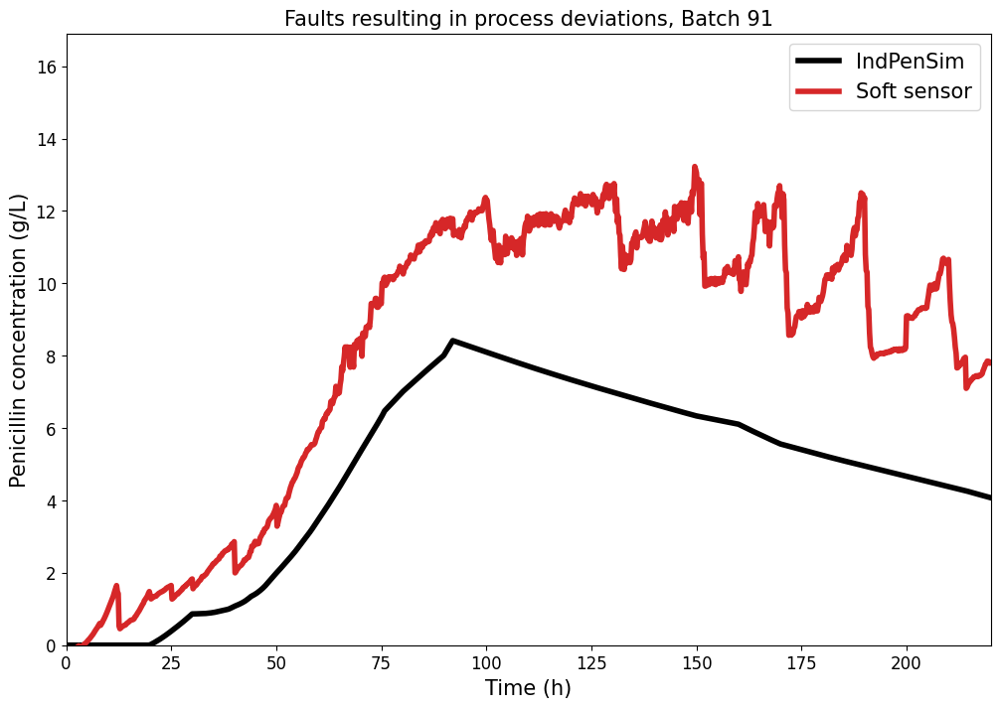

In [140]:
# Colores
colors = {
    'IndPenSim': 'black',
    'pred_ensamble_select_gfaults': '#d62728'
}

# Labels
labels = {
    'IndPenSim': 'IndPenSim',
    'Soft sensor': 'Soft sensor'
}

# Series de pandas a arrays de NumPy
x = batch_91_select['Time (h)'].to_numpy()
y1 = batch_91_select['Penicillin concentration(P:g/L)'].to_numpy()
y2 = batch_91_select['pred_ensamble_select_gfaults'].to_numpy()

# Figura
plt.figure(figsize=(12, 8))

# Graficar IndPenSim
plt.plot(x, y1, label=labels['IndPenSim'], linewidth=4, color=colors['IndPenSim'])
plt.plot(x, y2, label=labels['Soft sensor'], linewidth=4, color=colors['pred_ensamble_select_gfaults'])

# Límites del eje x e y
plt.xlim(0, 220)
plt.ylim(0, max(y1.max(), *[batch_91_select[col].max() for col in pred_columns]))

# Leyenda
plt.legend(fontsize=15)

# Título y etiquetas de los ejes
plt.title("Faults resulting in process deviations, Batch 91", fontsize=15)
plt.xlabel("Time (h)", fontsize=15)
plt.ylabel('Penicillin concentration (g/L)', fontsize=15)

# Ticks de los ejes
plt.tick_params(axis='both', which='major', labelsize=12)

# Mostrar la gráfica
plt.show()